In [1]:
import pandas as pd
import numpy as np
import csv
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib
import re
from nltk.probability import FreqDist
import matplotlib.cm as cm

from sklearn.cluster import MiniBatchKMeans
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

In [3]:
df1=pd.read_csv("../../bugfix-commits-subject-ch.csv")
df1

,commit,bug_id,subject,churn
0,4bf96c30121ed23f8025e0a2ee6c68831fd0786f,778047,Assign policies to preloaded HSTS entries,80050
1,825da604d1333757aaf6988200909104ab9d0c25,877148,Use the 8.0 filter list in perf tests.,61814
2,0737c281d4a556c1c3a257e2392dea88cd4cca8e,1095874,Update the tf native cc/h,31150
3,defd7e6d6055bfcf3f29ea626dbf92cfa7c8cef8,1095874,"Revert ""Update the tf native cc/h""",31150
4,062c11b0a8ead71685311fbabbe7098cd79bb3b8,923083,Add expires_after for all obsolete histograms.,10358
...,...,...,...,...
211766,d875e0004e6ad9ff20c43ca02d95268987deaf81,1066495,[iOS CBCM] Add support for CloudPolicyOverride...,1
211767,6e2b1b13d3eb502f3da1d91ccb45fa345a7f0cb4,568674,Address leaks in Linux accessibility tree tests,1
211768,54f84e49d02df28da50987ecf5f1a7230ef3063d,958997,[Dark] Add flag enabled by default for Q+,1
211769,146fc8cfb7e37f1b8a0dd07e06e10fc9ecf0841c,939943,Removed unused |render_frame_id| from mojom::P...,1


In [4]:
import pandas as pd
import re

# Assuming you have a DataFrame 'df1' with a 'subject' column

# Define a function to remove non-text characters
def remove_non_text(text):
    # Use a regular expression to remove anything that's not a letter or a space
    cleaned_text = re.sub(r'[^a-zA-Z\s]', '', text)
    return cleaned_text

# Apply the function to the 'subject' column
df1['subject'] = df1['subject'].apply(remove_non_text)

df1


,commit,bug_id,subject,churn
0,4bf96c30121ed23f8025e0a2ee6c68831fd0786f,778047,Assign policies to preloaded HSTS entries,80050
1,825da604d1333757aaf6988200909104ab9d0c25,877148,Use the filter list in perf tests,61814
2,0737c281d4a556c1c3a257e2392dea88cd4cca8e,1095874,Update the tf native cch,31150
3,defd7e6d6055bfcf3f29ea626dbf92cfa7c8cef8,1095874,Revert Update the tf native cch,31150
4,062c11b0a8ead71685311fbabbe7098cd79bb3b8,923083,Add expiresafter for all obsolete histograms,10358
...,...,...,...,...
211766,d875e0004e6ad9ff20c43ca02d95268987deaf81,1066495,iOS CBCM Add support for CloudPolicyOverridesP...,1
211767,6e2b1b13d3eb502f3da1d91ccb45fa345a7f0cb4,568674,Address leaks in Linux accessibility tree tests,1
211768,54f84e49d02df28da50987ecf5f1a7230ef3063d,958997,Dark Add flag enabled by default for Q,1
211769,146fc8cfb7e37f1b8a0dd07e06e10fc9ecf0841c,939943,Removed unused renderframeid from mojomPushMes...,1


In [5]:
#removing punctuations from the summary

import string

def remove_punctuation(txt):
    if isinstance(txt, str):
        txt_nopunt = "".join([c for c in txt if c not in string.punctuation])
        return txt_nopunt
    else:
        return txt
df1['msg_clean'] = df1['subject'].apply(lambda x: remove_punctuation(x))


In [6]:
import re

def tokenize(text):
    tokens=re.split('\W+',text)
    return tokens

#df3['summary_tokenized']=df3['msg_clean'].apply(lambda x: tokenize(x.lower()))
df1['summary_tokenized'] = df1['msg_clean'].apply(lambda x: tokenize(x.lower()) if isinstance(x, str) else [])

df1

,commit,bug_id,subject,churn,msg_clean,summary_tokenized
0,4bf96c30121ed23f8025e0a2ee6c68831fd0786f,778047,Assign policies to preloaded HSTS entries,80050,Assign policies to preloaded HSTS entries,"[assign, policies, to, preloaded, hsts, entries]"
1,825da604d1333757aaf6988200909104ab9d0c25,877148,Use the filter list in perf tests,61814,Use the filter list in perf tests,"[use, the, filter, list, in, perf, tests]"
2,0737c281d4a556c1c3a257e2392dea88cd4cca8e,1095874,Update the tf native cch,31150,Update the tf native cch,"[update, the, tf, native, cch]"
3,defd7e6d6055bfcf3f29ea626dbf92cfa7c8cef8,1095874,Revert Update the tf native cch,31150,Revert Update the tf native cch,"[revert, update, the, tf, native, cch]"
4,062c11b0a8ead71685311fbabbe7098cd79bb3b8,923083,Add expiresafter for all obsolete histograms,10358,Add expiresafter for all obsolete histograms,"[add, expiresafter, for, all, obsolete, histog..."
...,...,...,...,...,...,...
211766,d875e0004e6ad9ff20c43ca02d95268987deaf81,1066495,iOS CBCM Add support for CloudPolicyOverridesP...,1,iOS CBCM Add support for CloudPolicyOverridesP...,"[ios, cbcm, add, support, for, cloudpolicyover..."
211767,6e2b1b13d3eb502f3da1d91ccb45fa345a7f0cb4,568674,Address leaks in Linux accessibility tree tests,1,Address leaks in Linux accessibility tree tests,"[address, leaks, in, linux, accessibility, tre..."
211768,54f84e49d02df28da50987ecf5f1a7230ef3063d,958997,Dark Add flag enabled by default for Q,1,Dark Add flag enabled by default for Q,"[dark, add, flag, enabled, by, default, for, q]"
211769,146fc8cfb7e37f1b8a0dd07e06e10fc9ecf0841c,939943,Removed unused renderframeid from mojomPushMes...,1,Removed unused renderframeid from mojomPushMes...,"[removed, unused, renderframeid, from, mojompu..."


In [7]:
#importing nltk to remove stopwords from the summary_tokenized

import nltk
nltk.download('stopwords')
stopwords=nltk.corpus.stopwords.words('english')

def remove_stopwords(txt_tokenized):
    txt_clean=[word for word in txt_tokenized if word not in stopwords]
    return txt_clean


df1['no_swds']=df1['summary_tokenized'].apply(lambda x: remove_stopwords(x))
df1

[nltk_data] Downloading package stopwords to /home/taj/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


,commit,bug_id,subject,churn,msg_clean,summary_tokenized,no_swds
0,4bf96c30121ed23f8025e0a2ee6c68831fd0786f,778047,Assign policies to preloaded HSTS entries,80050,Assign policies to preloaded HSTS entries,"[assign, policies, to, preloaded, hsts, entries]","[assign, policies, preloaded, hsts, entries]"
1,825da604d1333757aaf6988200909104ab9d0c25,877148,Use the filter list in perf tests,61814,Use the filter list in perf tests,"[use, the, filter, list, in, perf, tests]","[use, filter, list, perf, tests]"
2,0737c281d4a556c1c3a257e2392dea88cd4cca8e,1095874,Update the tf native cch,31150,Update the tf native cch,"[update, the, tf, native, cch]","[update, tf, native, cch]"
3,defd7e6d6055bfcf3f29ea626dbf92cfa7c8cef8,1095874,Revert Update the tf native cch,31150,Revert Update the tf native cch,"[revert, update, the, tf, native, cch]","[revert, update, tf, native, cch]"
4,062c11b0a8ead71685311fbabbe7098cd79bb3b8,923083,Add expiresafter for all obsolete histograms,10358,Add expiresafter for all obsolete histograms,"[add, expiresafter, for, all, obsolete, histog...","[add, expiresafter, obsolete, histograms]"
...,...,...,...,...,...,...,...
211766,d875e0004e6ad9ff20c43ca02d95268987deaf81,1066495,iOS CBCM Add support for CloudPolicyOverridesP...,1,iOS CBCM Add support for CloudPolicyOverridesP...,"[ios, cbcm, add, support, for, cloudpolicyover...","[ios, cbcm, add, support, cloudpolicyoverrides..."
211767,6e2b1b13d3eb502f3da1d91ccb45fa345a7f0cb4,568674,Address leaks in Linux accessibility tree tests,1,Address leaks in Linux accessibility tree tests,"[address, leaks, in, linux, accessibility, tre...","[address, leaks, linux, accessibility, tree, t..."
211768,54f84e49d02df28da50987ecf5f1a7230ef3063d,958997,Dark Add flag enabled by default for Q,1,Dark Add flag enabled by default for Q,"[dark, add, flag, enabled, by, default, for, q]","[dark, add, flag, enabled, default, q]"
211769,146fc8cfb7e37f1b8a0dd07e06e10fc9ecf0841c,939943,Removed unused renderframeid from mojomPushMes...,1,Removed unused renderframeid from mojomPushMes...,"[removed, unused, renderframeid, from, mojompu...","[removed, unused, renderframeid, mojompushmess..."


In [8]:
import nltk
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer

nltk.download('stopwords')
nltk.download('wordnet')

stopwords = nltk.corpus.stopwords.words('english')
wnl = WordNetLemmatizer()

def remove_stopwords(txt_tokenized):
    txt_clean = [word for word in txt_tokenized if word not in stopwords]
    return txt_clean

def lemmatize_words(txt_tokenized):
    txt_lemmatized = [wnl.lemmatize(word) for word in txt_tokenized]
    return txt_lemmatized

# Remove stopwords
df1['no_swds'] = df1['summary_tokenized'].apply(lambda x: remove_stopwords(x))



# Display the DataFrame
df1

[nltk_data] Downloading package stopwords to /home/taj/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /home/taj/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


,commit,bug_id,subject,churn,msg_clean,summary_tokenized,no_swds
0,4bf96c30121ed23f8025e0a2ee6c68831fd0786f,778047,Assign policies to preloaded HSTS entries,80050,Assign policies to preloaded HSTS entries,"[assign, policies, to, preloaded, hsts, entries]","[assign, policies, preloaded, hsts, entries]"
1,825da604d1333757aaf6988200909104ab9d0c25,877148,Use the filter list in perf tests,61814,Use the filter list in perf tests,"[use, the, filter, list, in, perf, tests]","[use, filter, list, perf, tests]"
2,0737c281d4a556c1c3a257e2392dea88cd4cca8e,1095874,Update the tf native cch,31150,Update the tf native cch,"[update, the, tf, native, cch]","[update, tf, native, cch]"
3,defd7e6d6055bfcf3f29ea626dbf92cfa7c8cef8,1095874,Revert Update the tf native cch,31150,Revert Update the tf native cch,"[revert, update, the, tf, native, cch]","[revert, update, tf, native, cch]"
4,062c11b0a8ead71685311fbabbe7098cd79bb3b8,923083,Add expiresafter for all obsolete histograms,10358,Add expiresafter for all obsolete histograms,"[add, expiresafter, for, all, obsolete, histog...","[add, expiresafter, obsolete, histograms]"
...,...,...,...,...,...,...,...
211766,d875e0004e6ad9ff20c43ca02d95268987deaf81,1066495,iOS CBCM Add support for CloudPolicyOverridesP...,1,iOS CBCM Add support for CloudPolicyOverridesP...,"[ios, cbcm, add, support, for, cloudpolicyover...","[ios, cbcm, add, support, cloudpolicyoverrides..."
211767,6e2b1b13d3eb502f3da1d91ccb45fa345a7f0cb4,568674,Address leaks in Linux accessibility tree tests,1,Address leaks in Linux accessibility tree tests,"[address, leaks, in, linux, accessibility, tre...","[address, leaks, linux, accessibility, tree, t..."
211768,54f84e49d02df28da50987ecf5f1a7230ef3063d,958997,Dark Add flag enabled by default for Q,1,Dark Add flag enabled by default for Q,"[dark, add, flag, enabled, by, default, for, q]","[dark, add, flag, enabled, default, q]"
211769,146fc8cfb7e37f1b8a0dd07e06e10fc9ecf0841c,939943,Removed unused renderframeid from mojomPushMes...,1,Removed unused renderframeid from mojomPushMes...,"[removed, unused, renderframeid, from, mojompu...","[removed, unused, renderframeid, mojompushmess..."


In [9]:
from nltk.corpus import wordnet
import nltk
import re

nltk.download('wordnet')
nltk.download('omw-1.4')
wn = nltk.WordNetLemmatizer()

# Define a function to check if a word has a dictionary meaning. Input: word
def word_has_dictionary_meaning(word):
    synsets = wordnet.synsets(word)
    return len(synsets) > 0

# Input: array of words as token
def clean_numbers(token_txt):
    number_pattern = r'^-?\d+$'
    text = [word for word in token_txt if not re.match(number_pattern, word)]
    return text

# Define a function to lemmatize words. Input: array of words as token
def lemmatization(token_txt):
    text = [wn.lemmatize(word) for word in token_txt]
    return text

# Apply the lemmatization function to the 'no_swds' column
df1['filtered_no_swds'] = df1['no_swds'].apply(lambda words: [word for word in words if word_has_dictionary_meaning(word)])

df1['lemmatized_no_swds'] = df1['filtered_no_swds'].apply(lambda x: lemmatization(x))

df1['clean_lemma']=df1['lemmatized_no_swds'].apply(lambda words: clean_numbers(words))

df1

[nltk_data] Downloading package wordnet to /home/taj/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/taj/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


,commit,bug_id,subject,churn,msg_clean,summary_tokenized,no_swds,filtered_no_swds,lemmatized_no_swds,clean_lemma
0,4bf96c30121ed23f8025e0a2ee6c68831fd0786f,778047,Assign policies to preloaded HSTS entries,80050,Assign policies to preloaded HSTS entries,"[assign, policies, to, preloaded, hsts, entries]","[assign, policies, preloaded, hsts, entries]","[assign, policies, entries]","[assign, policy, entry]","[assign, policy, entry]"
1,825da604d1333757aaf6988200909104ab9d0c25,877148,Use the filter list in perf tests,61814,Use the filter list in perf tests,"[use, the, filter, list, in, perf, tests]","[use, filter, list, perf, tests]","[use, filter, list, tests]","[use, filter, list, test]","[use, filter, list, test]"
2,0737c281d4a556c1c3a257e2392dea88cd4cca8e,1095874,Update the tf native cch,31150,Update the tf native cch,"[update, the, tf, native, cch]","[update, tf, native, cch]","[update, native]","[update, native]","[update, native]"
3,defd7e6d6055bfcf3f29ea626dbf92cfa7c8cef8,1095874,Revert Update the tf native cch,31150,Revert Update the tf native cch,"[revert, update, the, tf, native, cch]","[revert, update, tf, native, cch]","[revert, update, native]","[revert, update, native]","[revert, update, native]"
4,062c11b0a8ead71685311fbabbe7098cd79bb3b8,923083,Add expiresafter for all obsolete histograms,10358,Add expiresafter for all obsolete histograms,"[add, expiresafter, for, all, obsolete, histog...","[add, expiresafter, obsolete, histograms]","[add, obsolete, histograms]","[add, obsolete, histogram]","[add, obsolete, histogram]"
...,...,...,...,...,...,...,...,...,...,...
211766,d875e0004e6ad9ff20c43ca02d95268987deaf81,1066495,iOS CBCM Add support for CloudPolicyOverridesP...,1,iOS CBCM Add support for CloudPolicyOverridesP...,"[ios, cbcm, add, support, for, cloudpolicyover...","[ios, cbcm, add, support, cloudpolicyoverrides...","[ios, add, support]","[io, add, support]","[io, add, support]"
211767,6e2b1b13d3eb502f3da1d91ccb45fa345a7f0cb4,568674,Address leaks in Linux accessibility tree tests,1,Address leaks in Linux accessibility tree tests,"[address, leaks, in, linux, accessibility, tre...","[address, leaks, linux, accessibility, tree, t...","[address, leaks, linux, accessibility, tree, t...","[address, leak, linux, accessibility, tree, test]","[address, leak, linux, accessibility, tree, test]"
211768,54f84e49d02df28da50987ecf5f1a7230ef3063d,958997,Dark Add flag enabled by default for Q,1,Dark Add flag enabled by default for Q,"[dark, add, flag, enabled, by, default, for, q]","[dark, add, flag, enabled, default, q]","[dark, add, flag, enabled, default, q]","[dark, add, flag, enabled, default, q]","[dark, add, flag, enabled, default, q]"
211769,146fc8cfb7e37f1b8a0dd07e06e10fc9ecf0841c,939943,Removed unused renderframeid from mojomPushMes...,1,Removed unused renderframeid from mojomPushMes...,"[removed, unused, renderframeid, from, mojompu...","[removed, unused, renderframeid, mojompushmess...","[removed, unused]","[removed, unused]","[removed, unused]"


In [10]:
df1['meaningful_lemm_str'] = df1['clean_lemma'].apply(lambda x: ' '.join(x))


In [11]:
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import TfidfVectorizer

# Define stop words to remove them from TFIDF matrix
stop = list(stopwords.words('english'))
stop.extend(['10','13','30','60','firefox','doesnt','using','user','use','new','zoomoutcur','x','xx','xxx','xxxx', 
             'xyz','äöü','类型','更新10101之后','没有找到支持的视频格式和','类','型','1st','2d','2nd','3d','3rd','aa','dd'])

# Update the word_to_drop list with the extended stopwords
word_to_drop = stop

# Create an instance of TfidfVectorizer with stop words
vectorizer = TfidfVectorizer(stop_words=word_to_drop, min_df=25, max_features=100000)

# Fit and transform your text data using the vectorizer
tfidf_matrix = vectorizer.fit_transform(df1['meaningful_lemm_str'])

# Apply threshold on TF-IDF values
min_threshold = 0.05  # example value
max_threshold = 0.8  # example value

# Set values below min_threshold to 0 and values above max_threshold to max_threshold
tfidf_matrix = tfidf_matrix.todense()  # Convert sparse matrix to dense
tfidf_matrix[tfidf_matrix < min_threshold] = 0
tfidf_matrix[tfidf_matrix > max_threshold] = max_threshold

# Get the feature names (i.e., words) from the vectorizer
feature_names = vectorizer.get_feature_names_out()

# Iterate over feature names and their corresponding TF-IDF scores for each document
for i in range(len(df1)):
    print(f"Document {i+1}:")
    for j, word in enumerate(feature_names):
        tfidf_score = tfidf_matrix[i, j]
        if tfidf_score > 0.3:
            print(f"{word}: {tfidf_score:.4f}")



Document 1:
assign: 0.7315
entry: 0.5170
policy: 0.4445
Document 2:
filter: 0.7009
list: 0.6068
test: 0.3749
Document 3:
native: 0.8000
update: 0.5580
Document 4:
native: 0.7364
revert: 0.4610
update: 0.4952
Document 5:
add: 0.3214
histogram: 0.5682
obsolete: 0.7575
Document 6:
file: 0.5562
remove: 0.4251
unused: 0.7141
Document 7:
apply: 0.5682
builder: 0.4999
export: 0.6536
Document 8:
result: 0.5586
test: 0.3107
timing: 0.6762
update: 0.3663
Document 9:
change: 0.4364
format: 0.6497
group: 0.6224
Document 10:
add: 0.3405
matching: 0.8000
Document 11:
data: 0.6625
split: 0.7490
Document 12:
convert: 0.4769
format: 0.6491
input: 0.5927
Document 13:
indicator: 0.3604
policy: 0.5482
testing: 0.6823
Document 14:
histogram: 0.3813
reported: 0.7098
set: 0.3976
unused: 0.4390
Document 15:
bot: 0.4295
conformance: 0.6218
run: 0.4244
time: 0.4067
Document 16:
conformance: 0.8000
update: 0.4212
Document 17:
histogram: 0.4411
one: 0.5726
tag: 0.6444
Document 18:
add: 0.3660
map: 0.8000
Document

three: 0.6793
unit: 0.4948
Document 237:
change: 0.4848
ref: 0.8000
Document 238:
method: 0.8000
rename: 0.4522
Document 239:
polymer: 0.5816
remaining: 0.6254
setting: 0.4150
test: 0.3139
Document 240:
document: 0.8000
remove: 0.4460
Document 241:
break: 0.7734
dependency: 0.6340
Document 242:
test: 0.4914
unit: 0.8000
Document 243:
binding: 0.4599
compilation: 0.5557
lite: 0.5562
mojo: 0.3510
Document 244:
accessibility: 0.5925
dump: 0.7279
test: 0.3451
Document 245:
context: 0.6646
reset: 0.7472
Document 246:
builder: 0.3438
chromium: 0.4092
closer: 0.5394
closing: 0.4138
tree: 0.3958
Document 247:
modification: 0.7445
used: 0.5505
Document 248:
fix: 0.3926
flake: 0.8000
Document 249:
builder: 0.4182
chromium: 0.4977
ci: 0.5499
enable: 0.3212
experiment: 0.4146
Document 250:
class: 0.7771
file: 0.6294
Document 251:
builder: 0.3647
chromium: 0.4341
ci: 0.4795
experiment: 0.3616
fully: 0.4893
Document 252:
file: 0.6889
fix: 0.4861
test: 0.5377
Document 253:
cleanup: 0.8000
test: 0.534

Document 508:
android: 0.3622
generate: 0.6072
lint: 0.7072
Document 509:
Document 510:
split: 0.8000
test: 0.4958
Document 511:
android: 0.3727
hp: 0.8000
test: 0.3076
Document 512:
cocoa: 0.7868
mac: 0.5145
remove: 0.3409
Document 513:
test: 0.8000
Document 514:
return: 0.4850
service: 0.3835
true: 0.6349
worker: 0.4632
Document 515:
browser: 0.3388
core: 0.4894
reference: 0.4095
service: 0.3118
thread: 0.3745
worker: 0.3767
Document 516:
closing: 0.3458
look: 0.4095
match: 0.3052
step: 0.3736
tree: 0.3308
whole: 0.4464
word: 0.4140
Document 517:
bunch: 0.8000
switch: 0.4979
test: 0.3108
Document 518:
certificate: 0.5047
client: 0.4080
http: 0.4408
proxy: 0.4565
request: 0.3631
Document 519:
certificate: 0.5047
client: 0.4080
http: 0.4408
proxy: 0.4565
request: 0.3631
Document 520:
certificate: 0.4781
client: 0.3866
http: 0.4176
merge: 0.3201
proxy: 0.4325
request: 0.3440
Document 521:
simplified: 0.8000
window: 0.4905
Document 522:
longer: 0.5075
model: 0.4608
permission: 0.4150
tab

Document 743:
quota: 0.8000
rename: 0.5819
Document 744:
expiry: 0.5551
owner: 0.5760
uma: 0.4813
update: 0.3584
Document 745:
class: 0.7771
file: 0.6294
Document 746:
control: 0.3332
global: 0.8000
linux: 0.3195
Document 747:
blink: 0.5332
color: 0.4538
histogram: 0.4103
move: 0.3595
profile: 0.4606
Document 748:
control: 0.3332
global: 0.8000
linux: 0.3195
Document 749:
browser: 0.5240
revert: 0.3810
setting: 0.4590
split: 0.6080
Document 750:
revert: 0.3417
simplify: 0.5898
static: 0.6622
test: 0.3113
Document 751:
method: 0.8000
Document 752:
moving: 0.8000
test: 0.4296
Document 753:
remove: 0.8000
Document 754:
migrate: 0.6318
test: 0.4296
view: 0.6452
Document 755:
pas: 0.8000
Document 756:
group: 0.7391
id: 0.3396
pointer: 0.3878
stop: 0.3406
Document 757:
bubble: 0.3907
card: 0.3881
chip: 0.4805
clean: 0.3672
save: 0.4200
status: 0.3932
Document 758:
first: 0.6381
integration: 0.6361
test: 0.3373
Document 759:
base: 0.5843
range: 0.7613
Document 760:
code: 0.4923
convert: 0.502

method: 0.5652
simple: 0.8000
Document 984:
behind: 0.7099
take: 0.7043
Document 985:
cleanup: 0.3781
code: 0.3343
delete: 0.4102
supervised: 0.5446
sync: 0.3552
unused: 0.3928
Document 986:
bubble: 0.6265
clipboard: 0.7239
Document 987:
blink: 0.5581
replace: 0.4640
role: 0.6879
Document 988:
migrate: 0.8000
test: 0.5623
Document 989:
active: 0.3652
around: 0.3796
drag: 0.3618
gesture: 0.3599
overview: 0.3454
shelf: 0.3220
swipe: 0.4169
Document 990:
occlusion: 0.4946
pass: 0.5629
perform: 0.5054
render: 0.4278
Document 991:
gesture: 0.3375
launch: 0.3449
lock: 0.3264
note: 0.4009
swipe: 0.3910
taking: 0.4318
Document 992:
capture: 0.3251
fallback: 0.3483
format: 0.3479
offer: 0.4018
video: 0.6227
win: 0.3206
Document 993:
gesture: 0.3375
launch: 0.3449
lock: 0.3264
note: 0.4009
swipe: 0.3910
taking: 0.4318
Document 994:
capture: 0.3251
fallback: 0.3483
format: 0.3479
offer: 0.4018
video: 0.6227
win: 0.3206
Document 995:
chain: 0.4516
cleanup: 0.3143
decode: 0.4469
path: 0.3547
presen

fuchsia: 0.4694
handle: 0.4844
update: 0.3606
Document 1219:
browser: 0.3309
request: 0.3419
signing: 0.5220
token: 0.4097
trust: 0.5038
Document 1220:
callback: 0.4897
commit: 0.6058
implement: 0.4236
navigation: 0.4624
Document 1221:
marketing: 0.6102
merge: 0.3321
screen: 0.3609
temporarily: 0.4844
Document 1222:
dm: 0.6093
policy: 0.3627
response: 0.4560
validate: 0.5378
Document 1223:
implementing: 0.7218
linux: 0.4786
version: 0.5001
Document 1224:
android: 0.4943
move: 0.5108
target: 0.7033
Document 1225:
removed: 0.8000
Document 1226:
builder: 0.5598
remaining: 0.6458
switch: 0.5192
Document 1227:
attribute: 0.4142
ia: 0.5583
implementation: 0.3744
share: 0.4210
text: 0.3355
Document 1228:
window: 0.8000
Document 1229:
blacklist: 0.6206
policy: 0.4332
split: 0.4928
url: 0.4294
Document 1230:
add: 0.8000
Document 1231:
default: 0.3446
isolated: 0.5439
property: 0.4745
server: 0.4729
set: 0.3696
Document 1232:
code: 0.4522
formatting: 0.7950
move: 0.4043
Document 1233:
file: 0.64

logic: 0.4944
simplify: 0.5670
Document 1460:
delete: 0.7164
sheriff: 0.6977
Document 1461:
feed: 0.6138
implement: 0.4872
storage: 0.6213
Document 1462:
layout: 0.8000
Document 1463:
remove: 0.4336
test: 0.4428
unit: 0.7848
Document 1464:
ozone: 0.6045
rework: 0.7341
test: 0.3093
Document 1465:
entity: 0.4745
processor: 0.4916
sync: 0.3037
tracker: 0.4910
unit: 0.3619
Document 1466:
find: 0.5382
missing: 0.4281
parser: 0.5313
try: 0.4947
Document 1467:
improve: 0.8000
test: 0.4930
Document 1468:
class: 0.7771
file: 0.6294
Document 1469:
cleanup: 0.6318
feature: 0.5667
flag: 0.5288
Document 1470:
coverage: 0.7018
directory: 0.3321
generating: 0.4446
Document 1471:
ozone: 0.5724
revert: 0.3215
rework: 0.6952
Document 1472:
context: 0.5876
extension: 0.4953
menu: 0.5330
test: 0.3540
Document 1473:
experimental: 0.7622
implementation: 0.6474
Document 1474:
crash: 0.3385
instrumentation: 0.5337
service: 0.3426
timer: 0.5586
worker: 0.4138
Document 1475:
deep: 0.6952
scan: 0.6754
Document 1

implement: 0.3910
selection: 0.4981
table: 0.5680
Document 1681:
base: 0.6991
delete: 0.7150
Document 1682:
migrate: 0.8000
Document 1683:
fuchsia: 0.5016
input: 0.5801
keyboard: 0.5848
Document 1684:
captive: 0.4859
failure: 0.3373
network: 0.3031
portal: 0.4103
secure: 0.4240
trigger: 0.3784
Document 1685:
customize: 0.8000
element: 0.3034
theme: 0.3217
Document 1686:
convert: 0.6260
module: 0.7798
Document 1687:
part: 0.6255
unify: 0.7802
Document 1688:
delete: 0.8000
Document 1689:
fix: 0.8000
Document 1690:
click: 0.4969
handle: 0.4014
notification: 0.3917
success: 0.6010
Document 1691:
rewrite: 0.7918
start: 0.6108
Document 1692:
access: 0.4116
auditing: 0.6181
context: 0.3890
database: 0.5113
Document 1693:
remove: 0.8000
Document 1694:
query: 0.5594
splitting: 0.7948
Document 1695:
click: 0.5173
handle: 0.4179
notification: 0.4078
success: 0.6257
Document 1696:
line: 0.4706
policy: 0.3648
privacy: 0.4892
secure: 0.5209
setting: 0.3133
Document 1697:
android: 0.3614
build: 0.453

test: 0.5523
Document 1899:
event: 0.4483
route: 0.6977
touch: 0.5588
Document 1900:
content: 0.3435
desktop: 0.4007
mixed: 0.5096
port: 0.4359
various: 0.4724
Document 1901:
apple: 0.8000
split: 0.5542
Document 1902:
style: 0.5639
union: 0.8000
Document 1903:
capture: 0.5161
mode: 0.4156
region: 0.6538
Document 1904:
content: 0.3339
desktop: 0.3895
mixed: 0.4954
port: 0.4237
various: 0.4591
Document 1905:
apple: 0.7863
revert: 0.3281
split: 0.5235
Document 1906:
breakdown: 0.7055
event: 0.4055
trace: 0.5386
Document 1907:
file: 0.3791
method: 0.4561
revert: 0.3248
single: 0.6033
update: 0.3488
Document 1908:
pool: 0.4088
socket: 0.3965
tagging: 0.5014
test: 0.3648
transport: 0.4296
Document 1909:
experiment: 0.3829
field: 0.3775
phase: 0.5464
testing: 0.4284
trial: 0.4429
Document 1910:
navigation: 0.5762
security: 0.7335
test: 0.3605
Document 1911:
interaction: 0.6784
tag: 0.6626
test: 0.3174
Document 1912:
annotation: 0.6856
lock: 0.6682
Document 1913:
sync: 0.8000
Document 1914:
ac

implement: 0.4324
storage: 0.5515
Document 2114:
logic: 0.4970
sequence: 0.6544
simplify: 0.5700
Document 2115:
conversion: 0.6486
finish: 0.7611
Document 2116:
check: 0.4813
member: 0.7678
update: 0.4228
Document 2117:
command: 0.7025
control: 0.6456
Document 2118:
extension: 0.5542
permission: 0.6891
update: 0.4669
Document 2119:
migrate: 0.8000
Document 2120:
add: 0.4522
text: 0.8000
Document 2121:
ip: 0.4072
loaded: 0.3676
sampler: 0.4358
sanity: 0.4406
stack: 0.3448
Document 2122:
bring: 0.5398
chrome: 0.3245
fork: 0.5711
translate: 0.4504
Document 2123:
logic: 0.4719
revert: 0.3135
sequence: 0.6214
simplify: 0.5412
Document 2124:
allocator: 0.5896
clean: 0.3897
initialization: 0.4643
unify: 0.5337
Document 2125:
bring: 0.5398
chrome: 0.3245
fork: 0.5711
translate: 0.4504
Document 2126:
bubble: 0.3997
enabled: 0.3882
overflow: 0.4881
run: 0.3950
shelf: 0.3944
Document 2127:
auditing: 0.6821
report: 0.4553
valid: 0.5722
Document 2128:
connector: 0.6141
function: 0.4094
helper: 0.46

setup: 0.5489
tutorial: 0.6683
video: 0.5020
Document 2331:
android: 0.4093
rewriting: 0.8000
Document 2332:
adjust: 0.5309
function: 0.4606
shape: 0.7113
Document 2333:
bot: 0.5574
documentation: 0.6692
test: 0.3179
update: 0.3747
Document 2334:
move: 0.6231
network: 0.7821
Document 2335:
page: 0.4286
store: 0.5657
upgrade: 0.6597
Document 2336:
check: 0.3787
child: 0.5335
safety: 0.5693
status: 0.4979
Document 2337:
add: 0.3464
functionality: 0.8000
Document 2338:
clipboard: 0.4859
nested: 0.5504
ozone: 0.4688
request: 0.3742
support: 0.3181
Document 2339:
callback: 0.7563
implement: 0.6543
Document 2340:
file: 0.3603
integration: 0.5303
legacy: 0.5432
support: 0.3728
Document 2341:
based: 0.3048
duration: 0.3427
pending: 0.3195
side: 0.3138
tree: 0.6231
Document 2342:
implementation: 0.4353
mirroring: 0.5723
service: 0.3401
stream: 0.5060
Document 2343:
browser: 0.3923
clean: 0.4282
consent: 0.5269
screen: 0.4100
sync: 0.3866
Document 2344:
cleanup: 0.7139
medium: 0.7003
Document 23

touch: 0.4834
Document 2550:
add: 0.3691
test: 0.4567
unit: 0.8000
Document 2551:
extension: 0.4443
listener: 0.7172
revert: 0.3485
test: 0.3176
Document 2552:
scan: 0.4485
scanning: 0.4052
set: 0.3013
setting: 0.5348
sticky: 0.5077
Document 2553:
benchmark: 0.4516
experimental: 0.4778
moving: 0.4796
start: 0.3869
startup: 0.4337
Document 2554:
data: 0.3776
get: 0.4410
strip: 0.4788
tab: 0.6585
Document 2555:
move: 0.8000
Document 2556:
cherry: 0.5432
pick: 0.5244
space: 0.4163
switching: 0.4661
Document 2557:
dispatching: 0.6746
event: 0.3878
flag: 0.3424
touch: 0.4834
Document 2558:
add: 0.3467
behavior: 0.8000
test: 0.4290
Document 2559:
add: 0.3526
interface: 0.7355
support: 0.5785
Document 2560:
multiple: 0.7606
switch: 0.6492
Document 2561:
depend: 0.4468
function: 0.3232
module: 0.3416
private: 0.4134
self: 0.4956
Document 2562:
custom: 0.5282
request: 0.4503
scheme: 0.6169
Document 2563:
algorithm: 0.5463
ranking: 0.5249
suggested: 0.5168
Document 2564:
custom: 0.5036
request: 

move: 0.3432
revert: 0.3009
Document 2780:
around: 0.5864
fragment: 0.6663
move: 0.3599
Document 2781:
conversion: 0.7731
message: 0.6343
Document 2782:
frame: 0.8000
Document 2783:
annotation: 0.3837
auditor: 0.4902
checker: 0.4916
traffic: 0.4198
updating: 0.4104
Document 2784:
functionality: 0.5168
lock: 0.4414
smart: 0.5127
turn: 0.4709
Document 2785:
resolve: 0.4606
review: 0.4899
time: 0.3370
zone: 0.5398
Document 2786:
assignment: 0.5488
clean: 0.3793
deprecated: 0.4249
filter: 0.4304
source: 0.4350
Document 2787:
identity: 0.8000
move: 0.4672
test: 0.3732
Document 2788:
android: 0.3422
split: 0.4947
target: 0.4868
telemetry: 0.5909
Document 2789:
clean: 0.8000
update: 0.5818
Document 2790:
frame: 0.8000
Document 2791:
link: 0.7920
support: 0.6106
Document 2792:
extension: 0.5040
service: 0.5006
test: 0.3603
worker: 0.6047
Document 2793:
android: 0.3168
bundle: 0.5585
lint: 0.6185
run: 0.4530
Document 2794:
delete: 0.4623
related: 0.4931
stuff: 0.7370
Document 2795:
move: 0.7519

simplify: 0.8000
Document 3001:
management: 0.5796
overview: 0.5583
section: 0.5936
Document 3002:
box: 0.5789
cro: 0.3455
focus: 0.4612
search: 0.4383
window: 0.3750
Document 3003:
action: 0.4410
background: 0.4174
browser: 0.3878
creation: 0.4828
service: 0.3570
tab: 0.3470
Document 3004:
histogram: 0.4835
marked: 0.8000
Document 3005:
implementation: 0.8000
support: 0.5977
Document 3006:
consistency: 0.4591
page: 0.5420
persistent: 0.4404
task: 0.3298
Document 3007:
ability: 0.5121
access: 0.4078
expose: 0.4468
fetch: 0.4283
token: 0.4340
Document 3008:
context: 0.4542
downgrade: 0.7001
Document 3009:
add: 0.3138
printer: 0.7987
setting: 0.5134
Document 3010:
aware: 0.5413
request: 0.3156
script: 0.3648
worker: 0.3396
Document 3011:
extension: 0.4587
parsing: 0.6813
permission: 0.5705
Document 3012:
remove: 0.6996
test: 0.7145
Document 3013:
send: 0.7989
service: 0.6015
Document 3014:
child: 0.7980
convert: 0.6027
Document 3015:
basic: 0.5546
handling: 0.4676
library: 0.5476
support

Document 3226:
initial: 0.4405
instant: 0.5072
start: 0.3943
state: 0.3676
verify: 0.5081
Document 3227:
option: 0.4595
storage: 0.4817
switching: 0.5473
sync: 0.3837
Document 3228:
container: 0.5851
implement: 0.4272
list: 0.4722
revert: 0.3202
support: 0.3868
Document 3229:
shorten: 0.8000
Document 3230:
check: 0.5336
modify: 0.8000
Document 3231:
logic: 0.5065
move: 0.3838
object: 0.6018
screen: 0.4838
Document 3232:
error: 0.4329
handling: 0.4941
page: 0.3976
unify: 0.6406
Document 3233:
bulk: 0.8000
code: 0.4381
remove: 0.3064
Document 3234:
basic: 0.7112
implementation: 0.6127
test: 0.3445
Document 3235:
based: 0.4161
client: 0.3751
fire: 0.4821
host: 0.3958
notification: 0.3306
state: 0.3383
Document 3236:
direct: 0.6274
socket: 0.6346
update: 0.3442
Document 3237:
clean: 0.5073
code: 0.4311
compatibility: 0.7462
Document 3238:
build: 0.3713
class: 0.3860
speed: 0.5705
step: 0.5481
Document 3239:
implement: 0.5800
printer: 0.8000
Document 3240:
file: 0.4439
teach: 0.8000
Documen

medium: 0.3531
parallel: 0.5481
provisioning: 0.5738
Document 3443:
function: 0.5103
helper: 0.5764
parameter: 0.5649
Document 3444:
description: 0.4589
display: 0.3974
incognito: 0.4074
learn: 0.5404
option: 0.4165
Document 3445:
buffer: 0.5702
callback: 0.4883
frame: 0.4722
switch: 0.4621
Document 3446:
adaptive: 0.3984
brightness: 0.8000
Document 3447:
move: 0.5305
test: 0.8000
Document 3448:
flex: 0.8000
layout: 0.5438
Document 3449:
added: 0.4642
annotation: 0.5350
image: 0.4539
metric: 0.3770
service: 0.3875
Document 3450:
add: 0.8000
Document 3451:
add: 0.8000
Document 3452:
rewriting: 0.8000
text: 0.4883
Document 3453:
pattern: 0.8000
remove: 0.3866
Document 3454:
change: 0.3144
handler: 0.4406
header: 0.3977
status: 0.4249
unload: 0.6068
Document 3455:
cro: 0.3493
launcher: 0.5305
screen: 0.4355
small: 0.5871
Document 3456:
argument: 0.5647
clean: 0.4448
input: 0.4790
main: 0.5038
Document 3457:
animation: 0.4650
content: 0.4290
transition: 0.5678
unused: 0.4526
Document 3458:

extension: 0.3619
force: 0.5181
installed: 0.5687
unit: 0.4585
Document 3700:
migrate: 0.5871
pm: 0.8000
Document 3701:
fuchsia: 0.3425
limit: 0.4225
load: 0.4026
lower: 0.5258
specify: 0.4645
Document 3702:
android: 0.7167
update: 0.6974
Document 3703:
frame: 0.4205
introduce: 0.4281
opener: 0.6739
worker: 0.4311
Document 3704:
certificate: 0.5208
id: 0.4108
instead: 0.3892
manager: 0.4061
map: 0.4935
Document 3705:
Document 3706:
function: 0.5805
helper: 0.6557
remove: 0.3378
test: 0.3450
Document 3707:
audio: 0.4866
local: 0.4678
mirroring: 0.6019
service: 0.3577
Document 3708:
Document 3709:
cache: 0.4143
extension: 0.3356
id: 0.4104
mismatch: 0.5700
version: 0.4187
Document 3710:
buffer: 0.4699
correct: 0.4310
ensure: 0.4144
synchronization: 0.5008
video: 0.4134
Document 3711:
base: 0.4862
chrome: 0.4175
measuring: 0.7677
Document 3712:
code: 0.4384
color: 0.4948
expected: 0.7503
Document 3713:
class: 0.7842
move: 0.6205
Document 3714:
generalize: 0.7025
move: 0.3464
step: 0.6217


Document 3933:
base: 0.6705
move: 0.4997
window: 0.5483
Document 3934:
introduce: 0.6492
process: 0.6533
test: 0.3895
Document 3935:
accept: 0.4720
argument: 0.4419
item: 0.3612
number: 0.4003
received: 0.5048
Document 3936:
cache: 0.4007
extension: 0.3246
id: 0.3969
mismatch: 0.5512
version: 0.4049
Document 3937:
code: 0.3602
coverage: 0.4998
error: 0.3923
make: 0.3345
merge: 0.3735
script: 0.4639
Document 3938:
fixture: 0.8000
test: 0.3295
Document 3939:
group: 0.4312
implement: 0.3392
native: 0.4061
notification: 0.3580
tag: 0.4835
win: 0.4149
Document 3940:
input: 0.7250
interface: 0.6887
Document 3941:
mojo: 0.8000
Document 3942:
file: 0.4217
remove: 0.3223
revert: 0.3613
thread: 0.5492
usage: 0.5350
Document 3943:
adapter: 0.4513
adaptive: 0.4028
brightness: 0.4227
decision: 0.4505
function: 0.3020
one: 0.3328
Document 3944:
cs: 0.5078
file: 0.3083
non: 0.5359
selector: 0.5517
Document 3945:
fuchsia: 0.7234
implement: 0.6904
Document 3946:
guide: 0.4583
hint: 0.4036
loading: 0.36

throttling: 0.5195
Document 4174:
child: 0.4052
deadlock: 0.5508
due: 0.4297
throttling: 0.5049
Document 4175:
base: 0.5429
implementation: 0.5748
simplify: 0.6123
Document 4176:
entry: 0.5339
feature: 0.4235
handling: 0.5192
type: 0.4397
Document 4177:
adding: 0.4605
checker: 0.6648
sequence: 0.5883
Document 4178:
allow: 0.4122
building: 0.6156
target: 0.4702
window: 0.3747
Document 4179:
medium: 0.7048
rename: 0.7094
Document 4180:
animation: 0.3218
effect: 0.4412
group: 0.3544
logic: 0.3145
serve: 0.5064
unify: 0.4297
Document 4181:
file: 0.6051
interface: 0.7962
Document 4182:
move: 0.4051
origin: 0.5742
secure: 0.7114
Document 4183:
command: 0.5017
info: 0.4710
page: 0.3707
various: 0.5674
Document 4184:
asset: 0.6137
full: 0.5519
header: 0.4436
make: 0.3493
Document 4185:
id: 0.4004
routing: 0.6013
shared: 0.4281
switch: 0.3749
worker: 0.3928
Document 4186:
blocking: 0.3741
cookie: 0.3621
hat: 0.4608
launching: 0.4138
process: 0.3068
survey: 0.4372
Document 4187:
blocking: 0.3741

implement: 0.8000
Document 4405:
adjust: 0.6282
cro: 0.4099
tether: 0.6613
Document 4406:
compatible: 0.6166
make: 0.3393
trusted: 0.5972
type: 0.3847
Document 4407:
android: 0.3417
cache: 0.4872
output: 0.5601
revert: 0.3096
target: 0.4861
Document 4408:
add: 0.6285
test: 0.7778
Document 4409:
activation: 0.8000
fix: 0.3972
Document 4410:
array: 0.5698
implement: 0.3504
mojo: 0.3499
parameter: 0.4456
tracing: 0.4812
Document 4411:
handler: 0.6621
message: 0.5875
test: 0.3619
Document 4412:
bug: 0.4978
filter: 0.5697
revert: 0.3344
service: 0.4234
Document 4413:
added: 0.4008
bubble: 0.4222
reveal: 0.6370
search: 0.3867
tab: 0.3253
Document 4414:
creating: 0.5336
cro: 0.3234
event: 0.3834
session: 0.4520
trace: 0.5093
Document 4415:
Document 4416:
chrome: 0.8000
remove: 0.5617
Document 4417:
broken: 0.6619
software: 0.6969
Document 4418:
flag: 0.4612
run: 0.6029
state: 0.5502
test: 0.3480
Document 4419:
minimum: 0.4235
position: 0.3764
size: 0.3109
smaller: 0.4675
snapped: 0.4660
Docum

subscription: 0.5819
Document 4645:
check: 0.5244
service: 0.5430
worker: 0.6559
Document 4646:
background: 0.3959
descriptive: 0.6626
error: 0.3716
show: 0.3670
sync: 0.3625
Document 4647:
add: 0.3921
command: 0.8000
Document 4648:
automatically: 0.3164
casting: 0.6584
local: 0.4732
medium: 0.4044
Document 4649:
audio: 0.4219
format: 0.4337
input: 0.3960
match: 0.4094
used: 0.4180
window: 0.3066
Document 4650:
binding: 0.4373
extension: 0.6387
schema: 0.5562
support: 0.3026
Document 4651:
make: 0.6448
method: 0.7644
Document 4652:
blink: 0.4478
level: 0.5032
source: 0.4558
validation: 0.5316
Document 4653:
leak: 0.4211
mode: 0.3138
permission: 0.3734
profile: 0.3441
regular: 0.5282
split: 0.3758
Document 4654:
around: 0.5330
sensor: 0.6068
synchronization: 0.5506
Document 4655:
split: 0.8000
Document 4656:
change: 0.5224
created: 0.8000
Document 4657:
final: 0.7515
remove: 0.3202
status: 0.5768
Document 4658:
delete: 0.8000
test: 0.5031
Document 4659:
histogram: 0.3360
large: 0.5275
m

top: 0.3654
Document 4879:
add: 0.6285
test: 0.7778
Document 4880:
font: 0.4824
matched: 0.6766
protocol: 0.5196
Document 4881:
rename: 0.8000
Document 4882:
bar: 0.6007
chrome: 0.4802
header: 0.5498
remove: 0.3261
Document 4883:
http: 0.3917
load: 0.3730
preview: 0.6736
record: 0.3473
status: 0.3648
Document 4884:
io: 0.3675
roll: 0.6049
waterfall: 0.7064
Document 4885:
banner: 0.4900
check: 0.3030
hidden: 0.4768
password: 0.6639
Document 4886:
adding: 0.4433
candidate: 0.6399
remote: 0.5310
Document 4887:
cro: 0.4093
dragging: 0.6679
launcher: 0.6216
Document 4888:
affiliation: 0.7489
info: 0.4983
request: 0.4367
Document 4889:
eviction: 0.7678
service: 0.4086
worker: 0.4936
Document 4890:
add: 0.3530
http: 0.8000
test: 0.4368
Document 4891:
access: 0.4157
iteration: 0.6393
random: 0.6180
Document 4892:
google: 0.3626
moving: 0.3952
section: 0.3710
sync: 0.5594
Document 4893:
code: 0.5914
removing: 0.8000
Document 4894:
device: 0.4115
implement: 0.3778
output: 0.5124
switching: 0.547

error: 0.3776
handling: 0.4311
issue: 0.4055
logic: 0.4090
socket: 0.5383
Document 5112:
fix: 0.4832
issue: 0.8000
Document 5113:
custom: 0.4418
margin: 0.5296
migrate: 0.3550
preview: 0.3932
print: 0.4306
Document 5114:
access: 0.8000
fix: 0.4576
Document 5115:
change: 0.3609
ct: 0.6738
list: 0.4476
log: 0.4641
Document 5116:
connector: 0.4936
deep: 0.4464
directly: 0.4118
download: 0.3243
policy: 0.3010
scanning: 0.3918
Document 5117:
always: 0.3840
translate: 0.8000
Document 5118:
checking: 0.7058
fix: 0.3106
request: 0.5360
test: 0.3436
Document 5119:
remove: 0.8000
Document 5120:
affect: 0.6871
record: 0.4363
translation: 0.5810
Document 5121:
add: 0.3626
mojo: 0.6564
type: 0.6616
Document 5122:
code: 0.3012
coverage: 0.4180
expanded: 0.5540
fuzz: 0.5706
Document 5123:
dark: 0.3789
lite: 0.4554
picture: 0.4198
replaced: 0.4916
theme: 0.3854
Document 5124:
logging: 0.6404
quick: 0.3948
setting: 0.4758
Document 5125:
browser: 0.3552
cache: 0.4065
hour: 0.5951
service: 0.3270
worker:

extension: 0.4947
io: 0.4178
log: 0.5935
metric: 0.4780
Document 5347:
according: 0.5654
flow: 0.4213
setup: 0.4313
spec: 0.4788
Document 5348:
device: 0.3945
life: 0.6680
report: 0.4355
time: 0.4107
Document 5349:
component: 0.6271
printing: 0.7204
Document 5350:
account: 0.3498
arc: 0.3925
ignore: 0.3989
present: 0.4529
refresh: 0.3882
token: 0.3864
Document 5351:
also: 0.6834
make: 0.3990
take: 0.6113
Document 5352:
migrate: 0.5871
pm: 0.8000
Document 5353:
cache: 0.4967
purge: 0.7232
thread: 0.4798
Document 5354:
dependency: 0.8000
remove: 0.4772
Document 5355:
encryption: 0.6353
move: 0.3299
refresh: 0.4949
token: 0.4926
Document 5356:
common: 0.6202
replaced: 0.7305
Document 5357:
adapter: 0.7415
removed: 0.5535
Document 5358:
iteration: 0.8000
logic: 0.5017
Document 5359:
avoid: 0.7023
task: 0.7119
Document 5360:
confirmation: 0.4038
enrollment: 0.4107
payment: 0.3221
secure: 0.4112
strict: 0.4748
validation: 0.4123
Document 5361:
class: 0.7771
file: 0.6294
Document 5362:
add: 0

test: 0.8000
Document 5574:
cache: 0.3089
insecure: 0.4576
lookup: 0.4023
secure: 0.3931
separately: 0.4557
treat: 0.4137
Document 5575:
lack: 0.5477
metadata: 0.3902
subclass: 0.4752
various: 0.4441
view: 0.3110
Document 5576:
event: 0.4409
obsolete: 0.5595
service: 0.4082
worker: 0.4931
Document 5577:
Document 5578:
convert: 0.3999
extension: 0.3919
run: 0.4852
service: 0.3892
worker: 0.4701
Document 5579:
android: 0.4457
default: 0.5111
file: 0.4714
remove: 0.3603
update: 0.4337
Document 5580:
dynamic: 0.5837
policy: 0.4200
refresh: 0.5123
support: 0.3617
Document 5581:
animation: 0.3761
chrome: 0.3209
gaia: 0.4628
screen: 0.3511
smooth: 0.5782
Document 5582:
fuchsia: 0.8000
Document 5583:
arm: 0.5050
sampling: 0.4863
support: 0.3129
tracing: 0.4747
Document 5584:
dialog: 0.4241
doodle: 0.6709
share: 0.5640
Document 5585:
aura: 0.5744
handle: 0.3837
merge: 0.3518
occlusion: 0.5731
Document 5586:
dynamic: 0.6117
policy: 0.4401
refresh: 0.5370
support: 0.3791
Document 5587:
layout: 0.

Document 5803:
extension: 0.4171
fallback: 0.5800
icon: 0.4479
web: 0.4806
Document 5804:
extension: 0.3459
external: 0.5130
info: 0.4401
separate: 0.4633
store: 0.4571
Document 5805:
every: 0.4989
executing: 0.5818
frame: 0.3560
sampling: 0.4480
Document 5806:
description: 0.4792
part: 0.4418
policy: 0.3759
security: 0.4968
setting: 0.3228
Document 5807:
closure: 0.5393
compile: 0.5247
file: 0.3292
remaining: 0.5120
Document 5808:
remove: 0.8000
Document 5809:
click: 0.6099
highlighted: 0.4062
phone: 0.3519
right: 0.3388
Document 5810:
better: 0.7910
image: 0.6118
Document 5811:
anonymous: 0.5368
header: 0.3248
inside: 0.4374
private: 0.4234
static: 0.4185
Document 5812:
obsolete: 0.8000
remove: 0.4572
Document 5813:
assistant: 0.6511
test: 0.3730
unit: 0.6611
Document 5814:
bot: 0.3625
lock: 0.3864
run: 0.3581
win: 0.7405
Document 5815:
every: 0.4153
interaction: 0.7736
reveal: 0.4787
Document 5816:
add: 0.3388
browser: 0.6328
support: 0.5559
test: 0.4192
Document 5817:
cleaner: 0.59

remove: 0.5115
unused: 0.8000
Document 6033:
demo: 0.5164
education: 0.6382
tip: 0.5391
Document 6034:
access: 0.6850
allow: 0.5895
revert: 0.4281
Document 6035:
certificate: 0.6159
dialog: 0.4271
revert: 0.3117
viewer: 0.5841
Document 6036:
add: 0.8000
Document 6037:
cache: 0.6390
recent: 0.7692
Document 6038:
beta: 0.4877
bot: 0.3607
branch: 0.4337
testing: 0.3942
upstream: 0.4791
Document 6039:
calculate: 0.4827
desktop: 0.3533
occlusion: 0.4595
region: 0.4469
root: 0.4003
Document 6040:
method: 0.8000
Document 6041:
build: 0.3070
generating: 0.4966
html: 0.4330
official: 0.4319
report: 0.3552
script: 0.3638
Document 6042:
drag: 0.4265
offset: 0.4775
pointer: 0.4287
thumb: 0.5559
Document 6043:
logic: 0.4469
stack: 0.5632
support: 0.3587
two: 0.5027
update: 0.3189
Document 6044:
page: 0.3747
print: 0.4771
printing: 0.5258
set: 0.3985
size: 0.4435
Document 6045:
associated: 0.7674
logic: 0.5515
remove: 0.3269
Document 6046:
dragging: 0.7343
support: 0.4714
window: 0.4884
Document 604

experiment: 0.7600
implement: 0.6499
Document 6254:
finding: 0.7344
make: 0.3535
primary: 0.5793
Document 6255:
force: 0.5000
gesture: 0.4827
touch: 0.4670
unit: 0.4425
Document 6256:
path: 0.5976
setting: 0.4422
shared: 0.6118
Document 6257:
address: 0.5076
contact: 0.5881
form: 0.5028
implement: 0.3792
Document 6258:
make: 0.5885
work: 0.8000
Document 6259:
faster: 0.6154
iteration: 0.6213
time: 0.3819
Document 6260:
class: 0.3857
create: 0.3786
memory: 0.4270
pressure: 0.5917
system: 0.4189
Document 6261:
pac: 0.5008
parent: 0.3853
skip: 0.3543
valid: 0.4103
validation: 0.4087
Document 6262:
animation: 0.4162
cro: 0.3117
mode: 0.3601
scaling: 0.5787
toggle: 0.4749
Document 6263:
cro: 0.3549
movement: 0.7322
selection: 0.5231
Document 6264:
leak: 0.3656
many: 0.4360
password: 0.5476
quota: 0.4069
Document 6265:
clean: 0.4360
creation: 0.4973
snippet: 0.7018
Document 6266:
ad: 0.4692
bring: 0.5249
intervention: 0.5101
mobile: 0.4942
Document 6267:
add: 0.3691
test: 0.4567
unit: 0.8000

remove: 0.8000
Document 6487:
code: 0.4479
file: 0.4098
layout: 0.5636
split: 0.5603
Document 6488:
native: 0.3644
operation: 0.4510
permission: 0.3616
sure: 0.4287
system: 0.3571
Document 6489:
control: 0.6227
layout: 0.3149
medium: 0.5551
modification: 0.4527
Document 6490:
aura: 0.5806
implement: 0.3586
shell: 0.5286
version: 0.4274
Document 6491:
info: 0.4380
legacy: 0.4753
metric: 0.3326
page: 0.3447
tl: 0.5597
Document 6492:
clear: 0.7552
navigation: 0.6555
Document 6493:
device: 0.5600
failing: 0.6431
fix: 0.3173
io: 0.4149
Document 6494:
agent: 0.5966
allow: 0.3824
binding: 0.4848
runner: 0.5127
Document 6495:
clean: 0.5183
insertion: 0.8000
Document 6496:
migrate: 0.8000
Document 6497:
blob: 0.5740
extending: 0.7343
metric: 0.3625
Document 6498:
coverage: 0.4054
doc: 0.4192
generate: 0.4237
java: 0.4102
report: 0.3674
script: 0.3762
Document 6499:
benchmark: 0.3649
improve: 0.3254
incorrect: 0.3873
messaging: 0.4444
scheduled: 0.4995
Document 6500:
client: 0.3731
creator: 0.58

status: 0.3682
time: 0.3466
Document 6712:
ee: 0.5897
group: 0.4205
naming: 0.5459
tab: 0.3051
Document 6713:
animation: 0.4648
foreground: 0.6246
io: 0.3250
updated: 0.5368
Document 6714:
make: 0.4349
readable: 0.8000
Document 6715:
extra: 0.4483
freezing: 0.5648
space: 0.4166
width: 0.4671
Document 6716:
close: 0.3779
cycle: 0.5147
preview: 0.3405
start: 0.3546
wallpaper: 0.4450
Document 6717:
generation: 0.4854
move: 0.3037
representation: 0.6318
texture: 0.5225
Document 6718:
android: 0.4714
bug: 0.3179
connectivity: 0.5175
detection: 0.3794
logic: 0.3214
two: 0.3615
Document 6719:
assistant: 0.5197
cleanup: 0.4713
mock: 0.6475
Document 6720:
grit: 0.6912
page: 0.4283
target: 0.5270
Document 6721:
Document 6722:
fix: 0.3840
lifetime: 0.8000
Document 6723:
make: 0.4580
pm: 0.7144
view: 0.5291
Document 6724:
endpoint: 0.4848
field: 0.3440
priority: 0.4267
reporting: 0.3874
weight: 0.5361
Document 6725:
improve: 0.4827
stability: 0.6942
updated: 0.5339
Document 6726:
android: 0.6007
f

clean: 0.4385
helper: 0.5058
observer: 0.5106
pm: 0.5396
Document 6952:
access: 0.5920
color: 0.5326
fixed: 0.6048
Document 6953:
adaptive: 0.4412
arc: 0.3732
icon: 0.5906
modify: 0.4181
Document 6954:
access: 0.6847
token: 0.7288
Document 6955:
add: 0.3179
extension: 0.5505
key: 0.6642
test: 0.3934
Document 6956:
migrate: 0.5871
pm: 0.8000
Document 6957:
default: 0.3930
disabled: 0.4951
handle: 0.4481
name: 0.4564
update: 0.3336
Document 6958:
color: 0.5062
matrix: 0.8000
Document 6959:
backing: 0.6153
field: 0.4108
memory: 0.4262
trial: 0.4820
Document 6960:
added: 0.3724
check: 0.3003
page: 0.3135
pas: 0.3952
safety: 0.4514
status: 0.3948
Document 6961:
dispatch: 0.4829
persisted: 0.5339
true: 0.4681
unload: 0.5126
Document 6962:
list: 0.4063
reason: 0.5511
send: 0.4632
server: 0.4786
Document 6963:
behavior: 0.7321
part: 0.6812
Document 6964:
allow: 0.3135
doh: 0.5091
manager: 0.3508
multiple: 0.3893
probe: 0.5130
request: 0.3236
Document 6965:
delay: 0.5972
service: 0.4210
window:

local: 0.4215
static: 0.4934
variable: 0.4791
Document 7185:
bar: 0.3783
control: 0.3653
load: 0.3781
mac: 0.3099
touch: 0.3922
update: 0.4943
Document 7186:
color: 0.6101
dark: 0.3722
set: 0.5753
Document 7187:
detect: 0.6374
font: 0.5676
resource: 0.5211
Document 7188:
Document 7189:
callback: 0.3415
captured: 0.5029
paint: 0.3960
post: 0.4455
preview: 0.3285
task: 0.3439
Document 7190:
away: 0.5205
convert: 0.3589
method: 0.7748
Document 7191:
available: 0.4383
font: 0.4347
get: 0.4013
list: 0.3590
synchronously: 0.5736
Document 7192:
bookmark: 0.4331
code: 0.3487
deletion: 0.5178
extend: 0.4200
support: 0.3302
sync: 0.3705
Document 7193:
ct: 0.4996
endpoint: 0.4877
le: 0.4877
log: 0.3441
Document 7194:
cache: 0.5715
counter: 0.6933
enable: 0.4390
Document 7195:
action: 0.7632
attribute: 0.4374
extension: 0.3110
list: 0.3598
Document 7196:
base: 0.5148
make: 0.3985
module: 0.5451
target: 0.5283
Document 7197:
file: 0.6889
fix: 0.4861
test: 0.5377
Document 7198:
broker: 0.4744
child:

process: 0.5031
Document 7419:
ci: 0.4934
pool: 0.4869
switch: 0.3480
target: 0.3745
tester: 0.5080
Document 7420:
element: 0.7967
outside: 0.4808
Document 7421:
animation: 0.4177
base: 0.4151
duration: 0.5405
gesture: 0.4778
type: 0.3643
Document 7422:
action: 0.3569
improvement: 0.4623
introducing: 0.5428
recorder: 0.5288
Document 7423:
android: 0.3577
another: 0.6407
preview: 0.4809
tab: 0.3988
Document 7424:
accessibility: 0.5362
implement: 0.4574
revert: 0.3428
tree: 0.6211
Document 7425:
event: 0.5579
gesture: 0.3594
handling: 0.3236
multiple: 0.3489
order: 0.3777
preserve: 0.4364
Document 7426:
attribute: 0.3353
reported: 0.4533
rich: 0.4361
text: 0.5433
within: 0.3837
Document 7427:
command: 0.5149
node: 0.5443
part: 0.4913
Document 7428:
disabled: 0.6133
populate: 0.7899
Document 7429:
pm: 0.7920
rename: 0.6105
Document 7430:
convert: 0.8000
Document 7431:
io: 0.7080
update: 0.7062
Document 7432:
add: 0.3111
navigation: 0.6153
test: 0.3850
text: 0.6135
Document 7433:
content: 

sync: 0.3317
url: 0.3403
Document 7657:
mount: 0.8000
Document 7658:
extension: 0.4099
migrating: 0.7367
policy: 0.4510
Document 7659:
input: 0.7176
payment: 0.6964
Document 7660:
make: 0.3721
ready: 0.6506
throttle: 0.6621
Document 7661:
enable: 0.4163
histogram: 0.4484
remove: 0.3073
sensor: 0.7288
Document 7662:
access: 0.3929
committed: 0.5107
container: 0.4487
early: 0.4635
policy: 0.3444
Document 7663:
generated: 0.6128
revert: 0.3139
verify: 0.6251
Document 7664:
remove: 0.8000
Document 7665:
builder: 0.4730
synchronization: 0.5769
table: 0.5824
update: 0.3228
Document 7666:
adding: 0.3001
hex: 0.4777
outside: 0.3936
prevent: 0.3072
snowflake: 0.4730
value: 0.3061
Document 7667:
apis: 0.7203
history: 0.6937
Document 7668:
hermetic: 0.6393
mac: 0.3563
path: 0.4308
search: 0.3870
set: 0.3591
Document 7669:
apply: 0.3735
format: 0.3697
image: 0.3096
orientation: 0.4381
preview: 0.3099
raw: 0.4236
thumbnail: 0.4007
Document 7670:
access: 0.5739
clean: 0.5384
switch: 0.5234
test: 0.3

shift: 0.4772
Document 7896:
move: 0.5048
ownership: 0.8000
Document 7897:
encoding: 0.7362
layer: 0.6039
test: 0.3054
Document 7898:
member: 0.8000
uma: 0.5946
Document 7899:
empty: 0.3826
even: 0.4708
placeholder: 0.4563
screen: 0.3443
show: 0.3286
text: 0.3478
Document 7900:
navigation: 0.3318
select: 0.4373
sentence: 0.5706
speak: 0.5475
Document 7901:
friendly: 0.6756
make: 0.3348
paint: 0.5055
preview: 0.4194
Document 7902:
part: 0.8000
test: 0.4837
Document 7903:
measurement: 0.7893
startup: 0.6140
Document 7904:
correct: 0.4774
event: 0.3950
input: 0.4671
right: 0.5732
Document 7905:
issue: 0.3378
translation: 0.8000
Document 7906:
method: 0.3159
request: 0.3197
reuse: 0.4286
session: 0.7251
Document 7907:
branch: 0.3847
doc: 0.7333
initial: 0.3458
sheriff: 0.3053
version: 0.3185
Document 7908:
builder: 0.4296
infra: 0.5109
script: 0.4484
simple: 0.5595
Document 7909:
cro: 0.5798
migrate: 0.6737
test: 0.4581
Document 7910:
history: 0.3689
interactive: 0.4697
separate: 0.3647
sp

count: 0.7338
reference: 0.6794
Document 8130:
cookie: 0.5664
failure: 0.5004
store: 0.5291
Document 8131:
convert: 0.8000
Document 8132:
bookmark: 0.4178
conflict: 0.5764
resolution: 0.5440
sync: 0.3574
Document 8133:
event: 0.6691
introduce: 0.7432
Document 8134:
assistant: 0.5248
negative: 0.7521
support: 0.3986
Document 8135:
color: 0.3199
light: 0.5015
native: 0.3550
override: 0.3911
remaining: 0.4035
Document 8136:
batch: 0.8000
revert: 0.4450
Document 8137:
code: 0.4054
convert: 0.4134
node: 0.5803
scrolling: 0.5727
Document 8138:
backdrop: 0.6290
damage: 0.6168
filter: 0.4733
Document 8139:
batch: 0.8000
Document 8140:
back: 0.5217
refresh: 0.5432
tag: 0.6037
Document 8141:
creation: 0.7043
simplify: 0.7099
Document 8142:
remove: 0.5161
usage: 0.8000
Document 8143:
adding: 0.3654
keyboard: 0.3839
menu: 0.6462
sub: 0.5491
Document 8144:
length: 0.6597
limit: 0.5427
url: 0.4376
Document 8145:
extension: 0.6430
introduce: 0.7659
Document 8146:
builder: 0.5253
try: 0.6180
version: 

distance: 0.4664
domain: 0.3612
edit: 0.3671
generate: 0.3519
matching: 0.3867
Document 8356:
clean: 0.7621
code: 0.6475
Document 8357:
apis: 0.8000
remove: 0.4453
Document 8358:
blacklisted: 0.6248
one: 0.4381
optimization: 0.5193
preview: 0.3847
Document 8359:
description: 0.7114
policy: 0.5580
update: 0.4273
Document 8360:
implement: 0.8000
Document 8361:
revert: 0.7392
test: 0.6735
Document 8362:
strip: 0.4085
tab: 0.5618
thumbnail: 0.4379
track: 0.3870
visible: 0.4195
Document 8363:
clip: 0.4305
corner: 0.3802
magnifier: 0.4239
partial: 0.3929
rounded: 0.3952
us: 0.3026
Document 8364:
alignment: 0.6203
handling: 0.4835
improvement: 0.6176
Document 8365:
bookmark: 0.7756
icon: 0.3351
language: 0.4197
Document 8366:
branch: 0.6865
compile: 0.6649
Document 8367:
apis: 0.4402
binding: 0.4285
exception: 0.4703
fuchsia: 0.3431
port: 0.4425
Document 8368:
enable: 0.4312
extension: 0.4548
service: 0.4516
test: 0.3250
worker: 0.5456
Document 8369:
creation: 0.6087
medium: 0.5030
simplify: 

Document 8584:
delete: 0.5992
file: 0.4469
obsolete: 0.6643
Document 8585:
fix: 0.3591
fuchsia: 0.6096
implementation: 0.7067
Document 8586:
action: 0.3966
command: 0.4381
enable: 0.3065
execution: 0.5478
extension: 0.3233
key: 0.3901
Document 8587:
lock: 0.4671
match: 0.4584
origin: 0.4434
present: 0.5476
Document 8588:
apis: 0.6003
clipboard: 0.6176
introduce: 0.5082
Document 8589:
chrome: 0.3011
create: 0.3242
helper: 0.3968
method: 0.3218
replacing: 0.5522
used: 0.3911
Document 8590:
migrate: 0.8000
Document 8591:
bot: 0.4317
detail: 0.5047
doc: 0.4946
provider: 0.4797
Document 8592:
fix: 0.3958
network: 0.6880
service: 0.6083
Document 8593:
chrome: 0.6687
profile: 0.7436
Document 8594:
add: 0.4807
type: 0.8000
Document 8595:
always: 0.4054
item: 0.3876
navigation: 0.3623
notify: 0.4691
title: 0.4182
Document 8596:
diagnostics: 0.8000
Document 8597:
lock: 0.4857
match: 0.4767
origin: 0.4611
present: 0.5694
Document 8598:
apply: 0.4146
queue: 0.4713
rectangle: 0.5806
visible: 0.4260

waterfall: 0.5344
Document 8810:
record: 0.4006
restoration: 0.5999
session: 0.4219
shutdown: 0.4714
Document 8811:
allow: 0.4392
desktop: 0.5286
icon: 0.4366
name: 0.4688
update: 0.3426
Document 8812:
error: 0.7975
file: 0.3350
handling: 0.4552
Document 8813:
added: 0.3374
item: 0.3468
menu: 0.3053
record: 0.3405
selected: 0.4190
similar: 0.5533
Document 8814:
enable: 0.6804
histogram: 0.7328
Document 8815:
build: 0.4946
disable: 0.3722
flaky: 0.4642
sheriff: 0.5438
test: 0.3251
Document 8816:
coverage: 0.6955
method: 0.5518
test: 0.3580
Document 8817:
blank: 0.5053
end: 0.4270
line: 0.4203
position: 0.4248
start: 0.3590
Document 8818:
disabled: 0.4927
enabled: 0.4795
metric: 0.3807
tether: 0.5750
Document 8819:
closure: 0.4464
stack: 0.4427
switcher: 0.4376
undo: 0.5059
Document 8820:
add: 0.5204
support: 0.8000
Document 8821:
android: 0.8000
Document 8822:
build: 0.3836
clang: 0.4792
linux: 0.4211
mac: 0.3726
optimization: 0.5541
Document 8823:
different: 0.5953
migrate: 0.4094
suit

small: 0.8000
Document 9044:
integration: 0.6637
printing: 0.6918
Document 9045:
improve: 0.5725
support: 0.4300
swap: 0.6981
Document 9046:
adding: 0.3612
delayed: 0.4960
input: 0.3764
method: 0.3270
monitor: 0.4955
start: 0.3598
Document 9047:
candidate: 0.7271
issue: 0.4845
window: 0.4063
Document 9048:
cleanup: 0.6837
fix: 0.3903
flaky: 0.6166
Document 9049:
conversion: 0.6420
sample: 0.7667
Document 9050:
parameter: 0.5002
redundant: 0.5746
validation: 0.5919
Document 9051:
add: 0.3667
detail: 0.8000
Document 9052:
create: 0.3463
log: 0.3744
message: 0.3621
object: 0.4377
post: 0.4926
used: 0.4178
Document 9053:
io: 0.3156
load: 0.4816
multiple: 0.5012
removed: 0.5013
url: 0.4075
Document 9054:
animation: 0.7120
code: 0.5899
fix: 0.3808
Document 9055:
clang: 0.3934
gc: 0.5305
report: 0.3643
script: 0.3731
upload: 0.4281
Document 9056:
data: 0.5838
empty: 0.6608
move: 0.4717
Document 9057:
Document 9058:
flaky: 0.4481
mitigate: 0.8000
test: 0.3138
Document 9059:
call: 0.3637
check:

state: 0.6038
sync: 0.5681
Document 9278:
invoke: 0.7210
password: 0.4286
storage: 0.5445
Document 9279:
clean: 0.8000
Document 9280:
animation: 0.6463
code: 0.5354
fix: 0.3457
revert: 0.4197
Document 9281:
dedicated: 0.6830
file: 0.3765
move: 0.3678
target: 0.5065
Document 9282:
exposing: 0.6993
pm: 0.5457
stop: 0.4617
Document 9283:
add: 0.3176
block: 0.7922
support: 0.5211
Document 9284:
extension: 0.3607
installation: 0.5760
packaging: 0.7034
Document 9285:
expose: 0.6953
preference: 0.7187
Document 9286:
fuchsia: 0.5852
implement: 0.5585
method: 0.5879
Document 9287:
default: 0.3603
ensures: 0.7029
font: 0.5085
setting: 0.3430
Document 9288:
io: 0.3654
pas: 0.5461
render: 0.6326
support: 0.4100
Document 9289:
cleanup: 0.5971
small: 0.8000
Document 9290:
closure: 0.5043
compilation: 0.5563
generate: 0.4879
polymer: 0.4452
Document 9291:
child: 0.3931
function: 0.3500
get: 0.3763
improves: 0.5457
node: 0.4168
text: 0.3315
Document 9292:
migrate: 0.8000
Document 9293:
fork: 0.8000
Do

Document 9518:
creating: 0.3909
dynamic: 0.4005
loading: 0.3467
module: 0.6659
separate: 0.3508
Document 9519:
external: 0.5466
handle: 0.4171
protocol: 0.5560
url: 0.4019
Document 9520:
chip: 0.4470
grid: 0.4113
search: 0.3329
switcher: 0.4266
term: 0.4814
Document 9521:
lambda: 0.6093
name: 0.3673
normalize: 0.5960
Document 9522:
extension: 0.5890
header: 0.6951
remove: 0.4122
Document 9523:
browser: 0.4077
enable: 0.3583
file: 0.3460
provider: 0.5263
search: 0.4337
Document 9524:
branded: 0.4942
first: 0.3483
linux: 0.3076
master: 0.4731
run: 0.3190
Document 9525:
custom: 0.3717
hosted: 0.4731
menu: 0.6117
model: 0.3925
Document 9526:
update: 0.3804
value: 0.5602
zucchini: 0.7359
Document 9527:
android: 0.3380
bundle: 0.5960
construct: 0.7284
Document 9528:
Document 9529:
conditional: 0.8000
remove: 0.3411
revert: 0.3823
Document 9530:
disk: 0.4975
installation: 0.4971
space: 0.4215
track: 0.4139
uma: 0.3522
Document 9531:
add: 0.3789
bottom: 0.8000
Document 9532:
download: 0.5120
f

Document 9754:
behavior: 0.5141
control: 0.4606
fixing: 0.5282
touch: 0.4945
Document 9755:
allow: 0.4425
parallel: 0.7059
read: 0.5532
Document 9756:
client: 0.8000
Document 9757:
ash: 0.3309
exported: 0.4884
fast: 0.4305
ink: 0.4130
leak: 0.3500
texture: 0.3841
Document 9758:
make: 0.5538
safe: 0.8000
Document 9759:
bookmark: 0.3601
copy: 0.4098
edit: 0.4388
implement: 0.3033
node: 0.4151
single: 0.4222
Document 9760:
error: 0.8000
fix: 0.5099
Document 9761:
archive: 0.6206
binding: 0.4879
mojo: 0.3725
testing: 0.4879
Document 9762:
cleanup: 0.5520
instant: 0.7607
remove: 0.3414
Document 9763:
browser: 0.3690
file: 0.3132
http: 0.4630
redirects: 0.5599
url: 0.3730
Document 9764:
base: 0.4797
code: 0.3999
duplication: 0.7292
Document 9765:
cleanup: 0.3008
provider: 0.3702
safety: 0.3832
separate: 0.3560
string: 0.5901
Document 9766:
ash: 0.3457
control: 0.3247
key: 0.3146
keyboard: 0.3334
mash: 0.3764
sticky: 0.4678
virtual: 0.3873
Document 9767:
console: 0.3724
goma: 0.3710
infra: 0.

menu: 0.5159
tool: 0.7057
Document 9989:
constraint: 0.4989
relax: 0.5291
scroll: 0.3941
snapping: 0.5619
Document 9990:
description: 0.6345
extension: 0.4523
policy: 0.4976
update: 0.3811
Document 9991:
handle: 0.3058
suggestion: 0.6696
tail: 0.5269
zero: 0.4248
Document 9992:
blink: 0.8000
move: 0.5590
Document 9993:
replace: 0.8000
Document 9994:
indicator: 0.4598
memory: 0.3979
needed: 0.4744
optimize: 0.5374
view: 0.3412
Document 9995:
ct: 0.6820
list: 0.4531
log: 0.4698
update: 0.3299
Document 9996:
certificate: 0.3037
managed: 0.5945
session: 0.4954
Document 9997:
add: 0.3116
flag: 0.5109
parsing: 0.8000
Document 9998:
add: 0.3891
property: 0.8000
Document 9999:
change: 0.3176
child: 0.4600
report: 0.4284
status: 0.4293
time: 0.4040
usage: 0.3955
Document 10000:
completion: 0.6417
partial: 0.6207
support: 0.3624
Document 10001:
extension: 0.8000
Document 10002:
clarify: 0.5913
page: 0.3661
rectangle: 0.7186
Document 10003:
page: 0.5778
port: 0.8000
Document 10004:
apis: 0.3794
i

forwarding: 0.7838
port: 0.6210
Document 10229:
handling: 0.6500
test: 0.3734
unit: 0.6618
Document 10230:
creation: 0.3944
data: 0.3251
disabled: 0.3671
get: 0.3796
link: 0.3609
profile: 0.3365
sync: 0.3121
Document 10231:
call: 0.4234
le: 0.6359
slow: 0.6453
Document 10232:
connectivity: 0.6447
probing: 0.6639
rename: 0.3789
Document 10233:
cleanup: 0.5878
service: 0.5159
worker: 0.6232
Document 10234:
enabled: 0.4879
make: 0.3725
network: 0.4502
service: 0.3981
work: 0.5118
Document 10235:
subclass: 0.8000
Document 10236:
remove: 0.8000
Document 10237:
eliminate: 0.7081
global: 0.7061
Document 10238:
accessibility: 0.6972
improve: 0.7169
Document 10239:
tcp: 0.8000
test: 0.3436
Document 10240:
add: 0.4251
flag: 0.6971
revert: 0.5774
Document 10241:
collapse: 0.8000
Document 10242:
command: 0.5517
implement: 0.4261
record: 0.4886
script: 0.5247
Document 10243:
load: 0.5040
main: 0.5216
script: 0.5039
worker: 0.4691
Document 10244:
remove: 0.8000
Document 10245:
client: 0.5345
hint: 0

Document 10468:
base: 0.8000
Document 10469:
move: 0.4770
setting: 0.5038
source: 0.7201
Document 10470:
demographic: 0.7390
metric: 0.3723
uma: 0.4359
Document 10471:
delete: 0.8000
Document 10472:
float: 0.5921
header: 0.3697
replace: 0.3456
structured: 0.5332
type: 0.3301
Document 10473:
content: 0.7127
io: 0.5401
remove: 0.4476
Document 10474:
field: 0.5280
search: 0.5021
test: 0.3128
unit: 0.5544
Document 10475:
action: 0.4674
auto: 0.5978
set: 0.4057
touch: 0.5094
Document 10476:
detection: 0.4504
dialog: 0.3474
help: 0.4872
icon: 0.3471
leak: 0.4534
Document 10477:
layout: 0.4677
move: 0.3323
page: 0.3719
rectangle: 0.7298
Document 10478:
build: 0.4618
io: 0.3587
run: 0.5258
test: 0.3035
unit: 0.5380
Document 10479:
remove: 0.4743
unnecessary: 0.8000
Document 10480:
browser: 0.4575
singleton: 0.7450
switch: 0.4855
Document 10481:
active: 0.4857
bit: 0.5073
machine: 0.5992
support: 0.3282
Document 10482:
parsing: 0.4796
password: 0.3392
requirement: 0.5407
shard: 0.5725
Document 

literal: 0.5545
logic: 0.3500
parameter: 0.3946
string: 0.3291
Document 10708:
extension: 0.3155
hook: 0.4581
information: 0.4673
running: 0.4579
sw: 0.5125
Document 10709:
access: 0.3962
auditing: 0.5951
context: 0.3745
shutdown: 0.4459
stop: 0.3871
Document 10710:
animation: 0.5452
smooth: 0.8000
Document 10711:
continue: 0.5101
device: 0.3274
marking: 0.5274
reporting: 0.3903
unit: 0.3639
Document 10712:
descriptive: 0.6190
error: 0.3472
install: 0.4468
message: 0.3696
request: 0.3552
Document 10713:
merge: 0.8000
Document 10714:
construction: 0.7690
initialize: 0.6393
Document 10715:
fix: 0.4183
object: 0.8000
Document 10716:
isolated: 0.7415
merge: 0.4910
metric: 0.4572
Document 10717:
flaky: 0.3966
mark: 0.4946
simulator: 0.7217
Document 10718:
invalidation: 0.8000
remove: 0.4060
Document 10719:
infinite: 0.4714
item: 0.3339
list: 0.6321
search: 0.3135
Document 10720:
case: 0.3636
cleanup: 0.3154
corner: 0.4379
mitigation: 0.5283
plus: 0.5455
Document 10721:
framework: 0.4638
lit

Document 10947:
chrome: 0.3703
cleanup: 0.8000
string: 0.3987
Document 10948:
medium: 0.4384
pipeline: 0.7026
stop: 0.4843
Document 10949:
incognito: 0.3664
loss: 0.5414
phone: 0.4756
tablet: 0.4097
Document 10950:
chrome: 0.4918
migrate: 0.5015
related: 0.6248
test: 0.3410
Document 10951:
fix: 0.3901
handler: 0.7896
revert: 0.4737
Document 10952:
method: 0.8000
Document 10953:
add: 0.8000
Document 10954:
drag: 0.6098
icon: 0.4713
order: 0.6373
Document 10955:
call: 0.5620
wrap: 0.8000
Document 10956:
mac: 0.4271
merge: 0.4195
revert: 0.3171
slow: 0.6975
Document 10957:
cast: 0.8000
part: 0.4196
Document 10958:
able: 0.5173
incremental: 0.5243
install: 0.3951
list: 0.3259
test: 0.4026
Document 10959:
change: 0.3271
cookie: 0.4960
cooky: 0.5098
sw: 0.5695
Document 10960:
required: 0.8000
Document 10961:
added: 0.3102
count: 0.3673
demo: 0.4130
launched: 0.4535
unique: 0.4097
Document 10962:
handler: 0.6486
rather: 0.7611
Document 10963:
convert: 0.6611
instead: 0.7503
Document 10964:
re

success: 0.5656
token: 0.4460
trust: 0.5484
Document 11173:
device: 0.3694
partition: 0.5541
show: 0.3487
single: 0.4721
tree: 0.4605
Document 11174:
design: 0.6285
icon: 0.3864
managed: 0.5460
replace: 0.3970
Document 11175:
avatar: 0.5208
highlight: 0.4703
last: 0.4593
record: 0.3873
time: 0.3829
Document 11176:
create: 0.3581
python: 0.4858
rather: 0.4950
tool: 0.4748
Document 11177:
move: 0.8000
Document 11178:
aware: 0.5124
messaging: 0.4618
port: 0.3790
shutdown: 0.3785
worker: 0.3215
Document 11179:
completion: 0.7335
conversion: 0.6182
Document 11180:
mojo: 0.4601
notify: 0.6511
observer: 0.6036
Document 11181:
serve: 0.8000
Document 11182:
revert: 0.8000
Document 11183:
code: 0.4999
move: 0.4469
parsing: 0.7419
Document 11184:
command: 0.4141
context: 0.3626
exclude: 0.4871
frame: 0.3576
main: 0.4077
menu: 0.3289
Document 11185:
accessibility: 0.3796
tree: 0.8000
Document 11186:
error: 0.3594
id: 0.4031
let: 0.5092
retry: 0.5047
touch: 0.4408
Document 11187:
create: 0.7958
io:

revert: 0.3428
work: 0.5579
Document 11398:
id: 0.4640
instead: 0.4395
map: 0.5574
pointer: 0.5299
Document 11399:
across: 0.3793
boundary: 0.4069
navigate: 0.4046
select: 0.3513
sentence: 0.4583
speak: 0.4398
Document 11400:
bump: 0.7654
reference: 0.6436
Document 11401:
return: 0.8000
Document 11402:
accessibility: 0.4334
chrome: 0.3641
password: 0.3711
section: 0.4982
setting: 0.3338
Document 11403:
assignment: 0.4930
constructor: 0.4237
operator: 0.4972
overload: 0.5279
Document 11404:
account: 0.4822
class: 0.4507
create: 0.4425
primary: 0.6071
Document 11405:
algorithm: 0.6036
detect: 0.5302
supported: 0.5191
Document 11406:
argument: 0.5843
data: 0.4327
installing: 0.6865
Document 11407:
replace: 0.8000
Document 11408:
send: 0.8000
Document 11409:
file: 0.8000
Document 11410:
title: 0.8000
Document 11411:
disabled: 0.4622
interceptor: 0.7047
path: 0.4721
Document 11412:
base: 0.3174
committing: 0.5175
correctly: 0.3659
url: 0.5767
Document 11413:
cert: 0.4967
device: 0.3604
prov

Document 11626:
architecture: 0.8000
part: 0.5774
Document 11627:
model: 0.4415
paint: 0.4486
player: 0.5029
preview: 0.3721
visibility: 0.4609
Document 11628:
histogram: 0.5981
remove: 0.4099
unused: 0.6886
Document 11629:
handler: 0.4650
log: 0.4267
payment: 0.4378
response: 0.4920
web: 0.4098
Document 11630:
medium: 0.8000
Document 11631:
remove: 0.8000
Document 11632:
allow: 0.6501
pas: 0.7598
Document 11633:
copy: 0.5455
histogram: 0.3938
image: 0.4486
io: 0.3257
uma: 0.4364
Document 11634:
clean: 0.5743
fuchsia: 0.5348
implementation: 0.6199
Document 11635:
fix: 0.8000
Document 11636:
allow: 0.3297
device: 0.3480
tracing: 0.8000
Document 11637:
array: 0.5393
constant: 0.4768
extra: 0.4618
metadata: 0.4265
Document 11638:
process: 0.4717
returned: 0.6923
revert: 0.3087
switch: 0.4505
Document 11639:
delete: 0.8000
Document 11640:
handle: 0.3232
id: 0.3492
index: 0.4434
instead: 0.3308
map: 0.4195
process: 0.3423
render: 0.4176
Document 11641:
enable: 0.3903
partial: 0.6683
swap: 0

Document 11865:
preview: 0.4073
print: 0.4461
separate: 0.4687
string: 0.3884
viewer: 0.5144
Document 11866:
remove: 0.5261
uma: 0.8000
Document 11867:
fix: 0.3171
matching: 0.7828
url: 0.5353
Document 11868:
io: 0.5642
method: 0.3680
old: 0.4464
saving: 0.5275
Document 11869:
allow: 0.4353
open: 0.5221
shell: 0.6218
tab: 0.3891
Document 11870:
fuchsia: 0.7234
implement: 0.6904
Document 11871:
caption: 0.5290
display: 0.4304
mode: 0.3703
setting: 0.3348
split: 0.4435
Document 11872:
page: 0.6157
privacy: 0.4537
sandbox: 0.4206
skeleton: 0.4880
Document 11873:
global: 0.8000
move: 0.5036
Document 11874:
browser: 0.3069
correct: 0.3687
existing: 0.4368
implementation: 0.3616
script: 0.3666
sure: 0.4193
Document 11875:
feature: 0.3774
initialize: 0.5348
map: 0.5462
top: 0.5228
Document 11876:
blocking: 0.4806
merge: 0.3412
pool: 0.5268
scheduler: 0.4631
task: 0.4007
Document 11877:
need: 0.6874
remove: 0.3072
search: 0.5036
tab: 0.4237
Document 11878:
cleanup: 0.8000
Document 11879:
modul

preview: 0.5272
skeleton: 0.7188
Document 12100:
anchor: 0.5737
chrome: 0.3686
possible: 0.5566
screen: 0.4033
Document 12101:
base: 0.8000
Document 12102:
bar: 0.5653
custom: 0.5734
support: 0.4154
tab: 0.4232
Document 12103:
id: 0.5985
store: 0.6469
tab: 0.4726
Document 12104:
chrome: 0.8000
fix: 0.5311
Document 12105:
aggregate: 0.8000
Document 12106:
code: 0.4493
reduce: 0.6253
revert: 0.3522
size: 0.5321
Document 12107:
constraint: 0.6322
loading: 0.5012
pm: 0.5488
Document 12108:
blob: 0.8000
remove: 0.4160
Document 12109:
code: 0.4346
controller: 0.5962
form: 0.6027
remove: 0.3040
Document 12110:
configure: 0.4475
insecure: 0.4840
part: 0.3423
secure: 0.4158
separately: 0.4820
Document 12111:
avoid: 0.3407
condition: 0.4174
race: 0.4091
record: 0.3402
sm: 0.4756
wait: 0.4084
Document 12112:
cleanup: 0.5764
mash: 0.7353
remove: 0.3565
Document 12113:
conditionally: 0.5013
google: 0.3738
link: 0.3334
manager: 0.3278
password: 0.5698
Document 12114:
remove: 0.8000
Document 12115:
d

Document 12339:
clip: 0.5395
content: 0.3380
prevent: 0.3778
scroll: 0.3999
smaller: 0.5404
Document 12340:
clip: 0.5395
content: 0.3380
prevent: 0.3778
scroll: 0.3999
smaller: 0.5404
Document 12341:
replace: 0.8000
revert: 0.5795
Document 12342:
data: 0.4581
race: 0.5971
unit: 0.5241
Document 12343:
let: 0.5931
take: 0.5467
texture: 0.5911
Document 12344:
behind: 0.4871
candidate: 0.5963
leaf: 0.6382
Document 12345:
local: 0.5825
test: 0.3205
voice: 0.7006
Document 12346:
cleared: 0.5149
every: 0.4762
metadata: 0.3910
restart: 0.4741
sync: 0.3087
Document 12347:
benchmark: 0.4632
health: 0.4732
study: 0.5541
upgrade: 0.5045
Document 12348:
connect: 0.4467
generation: 0.4060
highlight: 0.4139
selector: 0.4652
shared: 0.3712
Document 12349:
alive: 0.7472
keep: 0.5821
revert: 0.3205
Document 12350:
confirmation: 0.4626
payment: 0.3690
prompt: 0.4224
secure: 0.4711
system: 0.3682
Document 12351:
client: 0.5990
id: 0.5845
switch: 0.5473
Document 12352:
ask: 0.6291
mac: 0.3486
shill: 0.6204

fuchsia: 0.3859
handle: 0.3982
overlay: 0.4777
transforms: 0.6814
Document 12574:
file: 0.3720
management: 0.5594
paint: 0.5701
preview: 0.4729
Document 12575:
return: 0.8000
Document 12576:
deep: 0.6212
display: 0.4626
scanning: 0.5452
update: 0.3208
Document 12577:
cro: 0.3865
disabled: 0.5343
property: 0.5842
setting: 0.4037
Document 12578:
bookmark: 0.3499
guard: 0.4421
permanent: 0.5384
unexpected: 0.4962
Document 12579:
account: 0.5538
fuchsia: 0.5021
local: 0.5947
Document 12580:
blocking: 0.6528
dispatch: 0.7576
Document 12581:
added: 0.4779
animation: 0.4853
cro: 0.3634
launcher: 0.5520
revert: 0.3152
Document 12582:
context: 0.3840
menu: 0.3483
native: 0.4056
option: 0.4121
panel: 0.4913
view: 0.3474
Document 12583:
change: 0.4091
chrome: 0.4520
cleanup: 0.4962
state: 0.4955
update: 0.3695
Document 12584:
case: 0.4143
cellular: 0.4480
flow: 0.4216
selection: 0.4234
skip: 0.4337
Document 12585:
code: 0.5149
device: 0.5866
remove: 0.3601
service: 0.5110
Document 12586:
base: 0.

switching: 0.4972
tab: 0.3165
thumbnail: 0.4935
Document 12808:
context: 0.3311
menu: 0.3003
proper: 0.4610
shadow: 0.4321
touchable: 0.5195
Document 12809:
fuchsia: 0.3375
get: 0.3980
interface: 0.7416
network: 0.3456
Document 12810:
disable: 0.7532
test: 0.6578
Document 12811:
enough: 0.5926
location: 0.4108
show: 0.3258
space: 0.4100
suggestion: 0.3752
Document 12812:
base: 0.7321
rename: 0.6812
Document 12813:
base: 0.5378
implement: 0.4689
range: 0.7007
Document 12814:
condition: 0.5871
fixing: 0.5694
race: 0.5755
Document 12815:
cleanup: 0.6762
feature: 0.6065
remove: 0.4182
Document 12816:
basic: 0.3894
card: 0.6569
requested: 0.4457
Document 12817:
password: 0.5701
storage: 0.7243
test: 0.3878
Document 12818:
cart: 0.6266
heuristic: 0.5923
site: 0.4521
Document 12819:
algorithm: 0.4825
capture: 0.3497
mirroring: 0.4502
resolution: 0.4359
selection: 0.3592
Document 12820:
extension: 0.5207
instead: 0.6031
message: 0.6042
Document 12821:
binding: 0.4969
blank: 0.6191
extension: 0

make: 0.3473
mime: 0.6252
string: 0.4148
Document 13043:
dialog: 0.5299
handle: 0.5580
open: 0.6386
Document 13044:
cro: 0.3531
persist: 0.6407
retrieve: 0.6818
Document 13045:
activity: 0.6971
reporting: 0.6598
Document 13046:
independent: 0.8000
make: 0.4523
Document 13047:
doc: 0.6594
documentation: 0.6908
Document 13048:
convert: 0.5231
depend: 0.8000
Document 13049:
android: 0.4558
configure: 0.8000
Document 13050:
column: 0.6607
header: 0.4425
row: 0.5586
Document 13051:
cooky: 0.5545
coverage: 0.5295
expand: 0.5812
Document 13052:
implement: 0.8000
Document 13053:
allowed: 0.7198
indicator: 0.3189
sensor: 0.3658
Document 13054:
deprecate: 0.7924
uma: 0.6099
Document 13055:
class: 0.7771
file: 0.6294
Document 13056:
generate: 0.6230
io: 0.3625
runner: 0.6216
test: 0.3068
Document 13057:
sheriff: 0.6213
test: 0.3714
two: 0.6900
Document 13058:
test: 0.8000
Document 13059:
increase: 0.6292
io: 0.3929
visibility: 0.6706
Document 13060:
integrate: 0.7958
worker: 0.6056
Document 13061

running: 0.4747
Document 13282:
callback: 0.5146
cleanup: 0.4813
part: 0.5501
type: 0.4482
Document 13283:
better: 0.4501
counting: 0.5585
expected: 0.5125
notification: 0.3306
Document 13284:
android: 0.3159
info: 0.4643
message: 0.4234
notification: 0.4030
setting: 0.3448
usage: 0.4239
Document 13285:
accept: 0.4472
experiment: 0.3427
explicit: 0.4179
language: 0.3766
prompt: 0.3945
save: 0.3771
Document 13286:
delete: 0.3977
entry: 0.4145
frozen: 0.6317
navigation: 0.3701
state: 0.3661
Document 13287:
feature: 0.6364
revert: 0.4919
support: 0.5942
Document 13288:
clean: 0.5039
code: 0.4282
cro: 0.3871
password: 0.4495
view: 0.4592
Document 13289:
animation: 0.3497
lock: 0.3868
scale: 0.4315
scaling: 0.4863
smart: 0.4493
Document 13290:
feed: 0.6971
remove: 0.3700
usage: 0.6141
Document 13291:
Document 13292:
dump: 0.3713
heap: 0.4077
hp: 0.4804
testing: 0.3373
unify: 0.3973
upload: 0.3643
Document 13293:
context: 0.3772
guard: 0.4993
loss: 0.5852
resolve: 0.5157
Document 13294:
dele

request: 0.4454
resource: 0.5137
revert: 0.3133
Document 13527:
group: 0.6916
move: 0.4650
sync: 0.5526
Document 13528:
detailed: 0.5620
dump: 0.4807
memory: 0.3992
provider: 0.4441
Document 13529:
earlier: 0.6981
request: 0.4690
resource: 0.5410
Document 13530:
expired: 0.5532
metric: 0.3373
unused: 0.4104
watchdog: 0.5935
Document 13531:
bound: 0.5762
code: 0.4141
ozone: 0.5780
revert: 0.3246
Document 13532:
download: 0.5298
icon: 0.4800
update: 0.3766
Document 13533:
replace: 0.8000
Document 13534:
ability: 0.4044
drop: 0.3513
external: 0.3805
place: 0.4138
strip: 0.3602
tab: 0.4953
Document 13535:
accessing: 0.6470
io: 0.3195
startup: 0.5139
stop: 0.4639
Document 13536:
layer: 0.4815
quad: 0.5917
support: 0.3229
texture: 0.5244
Document 13537:
add: 0.3887
bug: 0.7858
test: 0.4810
Document 13538:
annotation: 0.5111
decoder: 0.5762
static: 0.5668
Document 13539:
arc: 0.3518
failure: 0.3240
kiosk: 0.7869
startup: 0.3521
Document 13540:
keep: 0.4229
reporting: 0.4034
statistic: 0.5567


Document 13772:
behavior: 0.5103
fixed: 0.4709
keyboard: 0.4695
virtual: 0.5454
Document 13773:
order: 0.6806
put: 0.7327
Document 13774:
building: 0.5431
clang: 0.4576
io: 0.5688
target: 0.4148
Document 13775:
image: 0.4358
selected: 0.5533
state: 0.4234
tile: 0.5270
Document 13776:
histogram: 0.3080
initialization: 0.4233
internal: 0.4487
multiple: 0.4047
protect: 0.5284
Document 13777:
code: 0.3576
country: 0.6471
fixed: 0.4583
override: 0.4934
Document 13778:
bar: 0.5730
data: 0.4921
location: 0.6031
Document 13779:
add: 0.8000
Document 13780:
ownership: 0.7180
remove: 0.3285
shared: 0.6136
Document 13781:
handling: 0.8000
revert: 0.5333
Document 13782:
add: 0.4923
histogram: 0.8000
Document 13783:
counter: 0.4496
dynamic: 0.4592
loading: 0.3974
module: 0.3817
separate: 0.4022
usage: 0.3488
Document 13784:
always: 0.3869
focus: 0.3655
focused: 0.4714
refresh: 0.4063
ring: 0.4725
show: 0.3258
Document 13785:
format: 0.6191
parsing: 0.6620
support: 0.4224
Document 13786:
convert: 0.8

synchronous: 0.8000
Document 14012:
file: 0.4104
metric: 0.4331
suggested: 0.7596
Document 14013:
case: 0.5316
edge: 0.6665
fixed: 0.5226
Document 14014:
add: 0.3160
preference: 0.7778
service: 0.5433
Document 14015:
google: 0.3980
issue: 0.3380
mitigate: 0.5504
performance: 0.4415
tt: 0.4791
Document 14016:
based: 0.5558
feature: 0.4058
query: 0.5489
time: 0.4745
Document 14017:
away: 0.6237
move: 0.3771
sn: 0.6847
Document 14018:
base: 0.8000
move: 0.5976
Document 14019:
name: 0.4614
output: 0.5680
symbol: 0.6411
Document 14020:
character: 0.4803
elision: 0.5149
line: 0.4161
render: 0.4286
text: 0.3339
Document 14021:
close: 0.3200
engine: 0.3872
input: 0.3142
template: 0.3907
validate: 0.4041
Document 14022:
avoid: 0.3595
duplicate: 0.4426
generated: 0.4580
name: 0.3448
schema: 0.5208
Document 14023:
arc: 0.6274
provider: 0.6438
support: 0.4381
Document 14024:
category: 0.6622
setting: 0.3855
site: 0.5220
Document 14025:
simplify: 0.8000
Document 14026:
load: 0.3695
loading: 0.3794


modernize: 0.8000
test: 0.3959
Document 14257:
remove: 0.8000
Document 14258:
cache: 0.3679
preview: 0.3470
print: 0.3800
ready: 0.4842
sticky: 0.5348
Document 14259:
animate: 0.6170
cro: 0.3514
failing: 0.5087
icon: 0.4172
Document 14260:
bad: 0.3966
cached: 0.4001
caused: 0.3804
invalid: 0.3438
mitigate: 0.4631
traffic: 0.3644
Document 14261:
allowing: 0.4564
area: 0.3722
moved: 0.3872
outside: 0.3931
snapped: 0.4374
work: 0.3144
Document 14262:
name: 0.3313
origin: 0.3644
portal: 0.4369
trial: 0.4068
triggered: 0.4946
Document 14263:
cause: 0.3818
grouping: 0.4244
le: 0.3876
movement: 0.4254
pinning: 0.4401
Document 14264:
add: 0.4807
type: 0.8000
Document 14265:
clear: 0.4906
data: 0.4128
us: 0.4660
wallet: 0.6097
Document 14266:
clear: 0.4906
data: 0.4128
us: 0.4660
wallet: 0.6097
Document 14267:
explicitly: 0.4332
frame: 0.3417
sad: 0.5696
two: 0.3878
wait: 0.4208
Document 14268:
fuchsia: 0.7050
replace: 0.7092
Document 14269:
always: 0.3314
factory: 0.3913
initiator: 0.4703
opaq

Document 14495:
anchor: 0.5362
boundary: 0.5829
cross: 0.5710
Document 14496:
control: 0.4930
related: 0.5186
select: 0.5963
Document 14497:
add: 0.3575
point: 0.8000
Document 14498:
clean: 0.7277
medium: 0.6859
Document 14499:
blob: 0.7511
test: 0.3509
text: 0.5592
Document 14500:
applied: 0.3818
catch: 0.3542
gc: 0.7553
Document 14501:
ar: 0.5313
crash: 0.3045
null: 0.3917
pointer: 0.4332
processing: 0.4937
Document 14502:
add: 0.8000
Document 14503:
always: 0.6010
check: 0.4509
enabled: 0.5721
remove: 0.3290
Document 14504:
automation: 0.5029
overriding: 0.5336
property: 0.4030
stop: 0.3614
Document 14505:
add: 0.8000
Document 14506:
context: 0.3423
handler: 0.3773
message: 0.6696
receive: 0.5142
Document 14507:
landing: 0.5436
memory: 0.7027
part: 0.3630
Document 14508:
migrate: 0.5779
mojo: 0.5748
type: 0.5793
Document 14509:
content: 0.6436
make: 0.5366
setting: 0.5457
Document 14510:
remove: 0.8000
Document 14511:
caused: 0.7096
downloads: 0.6410
Document 14512:
behavior: 0.5757

histogram: 0.6368
update: 0.5255
Document 14735:
class: 0.4969
convert: 0.4485
syntax: 0.7430
Document 14736:
allow: 0.4793
bypass: 0.7572
extension: 0.4438
Document 14737:
check: 0.3120
due: 0.4659
flake: 0.4923
histogram: 0.3321
parse: 0.5302
Document 14738:
migrate: 0.8000
Document 14739:
code: 0.5985
separate: 0.8000
Document 14740:
battery: 0.5673
rate: 0.5719
sample: 0.5926
Document 14741:
android: 0.4322
notification: 0.5513
test: 0.7136
Document 14742:
cro: 0.4054
destruction: 0.6875
test: 0.3203
window: 0.4399
Document 14743:
remove: 0.8000
Document 14744:
avoid: 0.3510
device: 0.3329
fully: 0.4837
renaming: 0.5025
synced: 0.5287
Document 14745:
migrate: 0.6187
storage: 0.7856
Document 14746:
break: 0.8000
Document 14747:
action: 0.4403
commander: 0.6450
move: 0.3211
tab: 0.3464
window: 0.3523
Document 14748:
around: 0.4736
item: 0.3971
multiple: 0.4358
removing: 0.4433
selection: 0.4332
Document 14749:
button: 0.5971
record: 0.3538
uma: 0.3335
visible: 0.4249
Document 14750:


installing: 0.5963
registration: 0.5090
service: 0.3371
worker: 0.4072
Document 14969:
adjust: 0.4166
avoid: 0.3613
display: 0.3651
menu: 0.3234
position: 0.4311
power: 0.4653
Document 14970:
add: 0.3380
clank: 0.8000
Document 14971:
background: 0.3581
based: 0.4287
beginning: 0.5845
page: 0.3087
sw: 0.5010
Document 14972:
content: 0.3375
header: 0.3574
parsing: 0.4498
unit: 0.3837
verified: 0.5757
Document 14973:
dialog: 0.3771
header: 0.4140
image: 0.4081
leak: 0.4921
migrate: 0.3688
view: 0.3765
Document 14974:
manifest: 0.6175
test: 0.3111
tt: 0.7224
Document 14975:
away: 0.7020
convert: 0.4840
method: 0.5225
Document 14976:
cleanup: 0.4643
small: 0.6238
various: 0.6288
Document 14977:
directory: 0.3222
temporary: 0.7564
unit: 0.3105
write: 0.3829
Document 14978:
remove: 0.8000
Document 14979:
seek: 0.8000
support: 0.4223
Document 14980:
destination: 0.4877
preview: 0.3580
print: 0.3921
select: 0.4631
status: 0.3877
Document 14981:
remove: 0.8000
Document 14982:
event: 0.3281
handl

Document 15203:
convert: 0.8000
Document 15204:
code: 0.3956
drawing: 0.7376
mac: 0.4176
move: 0.3537
Document 15205:
copying: 0.5540
instead: 0.3509
run: 0.3751
server: 0.4128
template: 0.4778
Document 15206:
captured: 0.6392
profile: 0.4112
set: 0.3820
site: 0.4590
Document 15207:
blob: 0.5116
guest: 0.4904
loading: 0.4426
mode: 0.3495
url: 0.3647
Document 15208:
code: 0.3284
native: 0.4112
provider: 0.4570
suggestion: 0.4066
voice: 0.5126
Document 15209:
make: 0.8000
Document 15210:
based: 0.3277
engine: 0.3685
rule: 0.6995
transform: 0.3852
Document 15211:
expiration: 0.5645
histogram: 0.4166
ownership: 0.6242
update: 0.3437
Document 15212:
feed: 0.3776
history: 0.3880
search: 0.3286
url: 0.3123
visited: 0.5053
Document 15213:
frame: 0.5469
submit: 0.8000
Document 15214:
add: 0.8000
Document 15215:
cleanup: 0.5226
expired: 0.7319
flag: 0.4374
Document 15216:
check: 0.3685
content: 0.4282
generated: 0.5885
thumbnail: 0.5784
Document 15217:
action: 0.3795
animation: 0.3736
button: 0.

default: 0.4626
io: 0.3936
prevent: 0.5804
preview: 0.5424
Document 15437:
fix: 0.8000
Document 15438:
fixed: 0.7987
metric: 0.6018
Document 15439:
error: 0.3744
format: 0.4771
message: 0.3985
prefix: 0.4942
string: 0.3813
Document 15440:
comparison: 0.5727
operator: 0.5620
overload: 0.5967
Document 15441:
crash: 0.7349
info: 0.4764
load: 0.4826
Document 15442:
implement: 0.3982
selector: 0.6233
tool: 0.5599
window: 0.3735
Document 15443:
access: 0.3923
convert: 0.3189
event: 0.6704
handler: 0.4086
switch: 0.3578
Document 15444:
change: 0.4263
container: 0.6549
io: 0.3859
view: 0.4904
Document 15445:
detect: 0.6776
string: 0.4781
usage: 0.5004
Document 15446:
drag: 0.4496
holding: 0.4902
image: 0.3764
render: 0.4732
space: 0.4382
Document 15447:
action: 0.4639
compositor: 0.5752
flag: 0.3581
touch: 0.5056
Document 15448:
cleanup: 0.5878
service: 0.5159
worker: 0.6232
Document 15449:
break: 0.6705
extension: 0.4265
last: 0.6071
Document 15450:
avatar: 0.7319
icon: 0.4869
migrate: 0.4766

rather: 0.5395
specify: 0.5229
target: 0.4332
Document 15676:
device: 0.3723
disconnect: 0.5614
permission: 0.4062
revoke: 0.6174
Document 15677:
check: 0.4398
introduce: 0.5462
sequence: 0.7129
Document 15678:
allow: 0.3661
file: 0.3104
rather: 0.5200
specify: 0.5041
target: 0.4176
Document 15679:
group: 0.6634
link: 0.3064
second: 0.3971
tab: 0.4814
Document 15680:
allow: 0.4909
injection: 0.8000
test: 0.3248
Document 15681:
layout: 0.4026
notification: 0.3531
reply: 0.6077
ripple: 0.5488
Document 15682:
exiting: 0.5668
implicit: 0.5888
removal: 0.5145
Document 15683:
account: 0.5512
cache: 0.5626
first: 0.6162
Document 15684:
header: 0.3405
information: 0.4274
item: 0.3527
parsed: 0.5551
structured: 0.4911
Document 15685:
delete: 0.5477
page: 0.4466
set: 0.4750
unused: 0.5244
Document 15686:
make: 0.5885
work: 0.8000
Document 15687:
allow: 0.3798
file: 0.3220
rather: 0.5395
specify: 0.5229
target: 0.4332
Document 15688:
replace: 0.5139
security: 0.6774
state: 0.5264
Document 15689:


view: 0.3927
Document 15915:
reporting: 0.8000
Document 15916:
test: 0.8000
Document 15917:
cause: 0.3929
grouping: 0.4368
le: 0.3989
movement: 0.4378
pinning: 0.4529
Document 15918:
bookmark: 0.3459
context: 0.3302
different: 0.4254
differentiate: 0.5469
place: 0.4489
Document 15919:
clean: 0.6689
extension: 0.5679
io: 0.4797
Document 15920:
allow: 0.4151
default: 0.3816
fuchsia: 0.4215
override: 0.5307
revert: 0.3015
setting: 0.3632
Document 15921:
background: 0.8000
update: 0.5873
Document 15922:
call: 0.4796
click: 0.5935
integration: 0.5710
test: 0.3028
Document 15923:
allowed: 0.5782
feature: 0.3594
fetch: 0.4668
package: 0.5261
Document 15924:
file: 0.3801
integration: 0.5595
migrate: 0.4363
test: 0.5934
Document 15925:
fix: 0.4061
flakiness: 0.8000
Document 15926:
bookmark: 0.4850
dragging: 0.5762
page: 0.3908
web: 0.4497
Document 15927:
call: 0.4495
cro: 0.3592
device: 0.4527
metadata: 0.5346
sync: 0.4222
Document 15928:
implement: 0.8000
Document 15929:
field: 0.5103
improve:

overlay: 0.5562
Document 16149:
remove: 0.8000
Document 16150:
cache: 0.3404
correctly: 0.3816
creating: 0.4116
disk: 0.4408
error: 0.3006
full: 0.4049
report: 0.3470
Document 16151:
fix: 0.5633
support: 0.8000
Document 16152:
context: 0.4253
file: 0.3283
focus: 0.4329
menu: 0.3858
received: 0.6124
Document 16153:
io: 0.4929
move: 0.5222
thread: 0.6960
Document 16154:
hint: 0.5523
loading: 0.5057
preview: 0.4448
resource: 0.4914
Document 16155:
focused: 0.5515
icon: 0.3803
launch: 0.5000
start: 0.4293
tab: 0.3419
Document 16156:
address: 0.4582
billing: 0.5878
id: 0.3999
integration: 0.4408
Document 16157:
clean: 0.8000
Document 16158:
committed: 0.4770
lite: 0.4843
origin: 0.3708
preview: 0.3403
redirect: 0.4461
Document 16159:
invalidate: 0.6204
move: 0.3261
pot: 0.7133
Document 16160:
implement: 0.5422
stub: 0.8000
Document 16161:
change: 0.4068
complete: 0.7202
load: 0.5620
Document 16162:
avoid: 0.5024
crashing: 0.6879
empty: 0.5238
Document 16163:
background: 0.5231
sync: 0.4789


bug: 0.8000
fix: 0.4841
Document 16389:
activation: 0.4294
display: 0.3495
error: 0.3136
install: 0.4035
scan: 0.4559
Document 16390:
content: 0.6160
turn: 0.7877
Document 16391:
bot: 0.4155
building: 0.5347
enable: 0.3143
monochrome: 0.6002
Document 16392:
create: 0.8000
test: 0.5414
Document 16393:
behavior: 0.8000
fix: 0.4215
Document 16394:
address: 0.4663
editor: 0.5561
merge: 0.3454
pr: 0.5950
Document 16395:
break: 0.5597
cooky: 0.5177
ensure: 0.4435
loading: 0.4712
Document 16396:
port: 0.6566
sn: 0.7542
Document 16397:
assert: 0.5241
available: 0.4545
entering: 0.5330
thumbnail: 0.4844
Document 16398:
action: 0.4568
change: 0.3474
disable: 0.3047
playback: 0.6331
state: 0.4208
Document 16399:
activation: 0.4033
bit: 0.3958
clear: 0.3557
document: 0.3795
frame: 0.3162
installed: 0.4246
main: 0.3605
Document 16400:
block: 0.4977
disabled: 0.4320
hide: 0.4325
incognito: 0.4302
option: 0.4399
Document 16401:
dictionary: 0.6410
member: 0.5631
support: 0.3488
type: 0.3878
Document 1

pending: 0.4427
read: 0.4102
Document 16623:
header: 0.4824
retrieve: 0.7140
value: 0.5073
Document 16624:
couple: 0.6075
java: 0.4886
native: 0.4358
part: 0.4498
Document 16625:
add: 0.3252
promise: 0.8000
Document 16626:
extension: 0.4238
request: 0.4726
service: 0.4209
support: 0.4016
worker: 0.5084
Document 16627:
field: 0.4292
hardware: 0.5994
integration: 0.4794
uma: 0.4025
Document 16628:
dragging: 0.4716
event: 0.3426
key: 0.3855
modify: 0.4857
tab: 0.3084
track: 0.4249
Document 16629:
basic: 0.4789
field: 0.3916
owner: 0.4395
policy: 0.3571
validation: 0.5113
Document 16630:
asset: 0.5571
channel: 0.4962
check: 0.3272
expectation: 0.4991
Document 16631:
content: 0.3649
get: 0.4234
header: 0.3863
origin: 0.4152
request: 0.3650
script: 0.4219
Document 16632:
convert: 0.7443
file: 0.6678
Document 16633:
extension: 0.5591
implement: 0.5852
password: 0.5874
Document 16634:
border: 0.5047
debug: 0.4325
multiple: 0.4271
overlay: 0.4324
support: 0.3018
window: 0.3126
Document 16635:
m

fix: 0.4178
printing: 0.8000
Document 16858:
metric: 0.3973
reporter: 0.7504
search: 0.4718
Document 16859:
icon: 0.3469
launcher: 0.4439
result: 0.4151
search: 0.3707
setting: 0.6106
Document 16860:
expose: 0.8000
feature: 0.5937
Document 16861:
avoid: 0.3708
creating: 0.4604
local: 0.4006
lookup: 0.4960
symbol: 0.4941
Document 16862:
collection: 0.8000
enable: 0.5209
Document 16863:
move: 0.3307
ownership: 0.5656
sensor: 0.6135
thread: 0.4408
Document 16864:
adding: 0.5269
histogram: 0.4421
io: 0.3657
sharing: 0.6270
Document 16865:
elf: 0.5847
reference: 0.3975
width: 0.4630
zucchini: 0.4969
Document 16866:
fix: 0.3977
name: 0.7096
setting: 0.5816
Document 16867:
around: 0.5655
ordering: 0.6596
work: 0.4952
Document 16868:
around: 0.5655
ordering: 0.6596
work: 0.4952
Document 16869:
change: 0.5085
platform: 0.7284
update: 0.4592
Document 16870:
base: 0.5694
mojo: 0.4959
move: 0.4244
type: 0.4998
Document 16871:
address: 0.4249
card: 0.3775
credit: 0.4720
fallback: 0.4217
manual: 0.4

Document 17097:
container: 0.5154
optimize: 0.6079
promise: 0.6040
Document 17098:
mac: 0.7261
remove: 0.4810
test: 0.4912
Document 17099:
display: 0.4566
privacy: 0.5546
security: 0.5466
setting: 0.3552
Document 17100:
polymer: 0.6144
port: 0.6561
setting: 0.4384
Document 17101:
domain: 0.5101
metric: 0.3308
search: 0.3929
tab: 0.6610
Document 17102:
implement: 0.8000
Document 17103:
apply: 0.4799
fuchsia: 0.3750
overlay: 0.4643
scenic: 0.6430
Document 17104:
allow: 0.5010
layout: 0.5840
us: 0.5799
Document 17105:
clean: 0.5632
code: 0.4786
disabling: 0.6736
Document 17106:
arm: 0.6702
building: 0.3535
doc: 0.3147
mac: 0.4631
Document 17107:
extract: 0.8000
Document 17108:
address: 0.4256
eliding: 0.5904
email: 0.4969
invalid: 0.4299
Document 17109:
android: 0.3873
entry: 0.5724
point: 0.6750
Document 17110:
activity: 0.4755
coordinator: 0.5390
ensure: 0.4127
instantiate: 0.5594
Document 17111:
determine: 0.7632
running: 0.6461
Document 17112:
button: 0.8000
Document 17113:
file: 0.35

update: 0.3208
Document 17337:
decision: 0.5578
incognito: 0.3872
interstitial: 0.4824
shared: 0.4065
Document 17338:
change: 0.4126
revert: 0.3469
support: 0.4191
volume: 0.7306
Document 17339:
cancel: 0.6568
dialog: 0.4865
remove: 0.3168
sync: 0.4813
Document 17340:
data: 0.4251
proxy: 0.5381
reduction: 0.6764
Document 17341:
allow: 0.3512
client: 0.4074
hint: 0.4700
origin: 0.4123
three: 0.5655
Document 17342:
alternative: 0.8000
metric: 0.4374
Document 17343:
allowing: 0.6756
snap: 0.6292
type: 0.3842
Document 17344:
unify: 0.7833
win: 0.6216
Document 17345:
close: 0.3679
detailed: 0.5018
item: 0.3481
menu: 0.3064
selected: 0.4206
tray: 0.4135
Document 17346:
filter: 0.4116
handling: 0.3832
host: 0.4073
ignore: 0.4248
intent: 0.4406
link: 0.3786
Document 17347:
dice: 0.8000
handle: 0.5949
Document 17348:
potential: 0.7104
race: 0.6424
Document 17349:
dragging: 0.5972
issue: 0.4735
revert: 0.3173
shelf: 0.5001
Document 17350:
circle: 0.4890
detect: 0.4047
icon: 0.5525
smaller: 0.458

window: 0.3801
Document 17577:
prioritize: 0.8000
Document 17578:
event: 0.3326
non: 0.4935
part: 0.4010
process: 0.3717
shelf: 0.3834
visible: 0.4471
Document 17579:
called: 0.5125
cooky: 0.4797
delay: 0.4648
flush: 0.5396
Document 17580:
anonymous: 0.4361
cl: 0.3409
java: 0.6283
lambda: 0.4276
Document 17581:
action: 0.6739
implement: 0.5749
io: 0.4640
Document 17582:
coverage: 0.4959
debug: 0.4851
diagnostics: 0.5194
info: 0.4544
Document 17583:
forced: 0.4702
report: 0.3411
statistic: 0.5084
status: 0.3418
uma: 0.3067
Document 17584:
added: 0.4106
child: 0.4664
method: 0.3803
root: 0.5085
track: 0.4591
Document 17585:
remove: 0.3691
shift: 0.8000
Document 17586:
decouple: 0.8000
Document 17587:
add: 0.3217
check: 0.5343
focus: 0.6727
test: 0.3981
Document 17588:
fix: 0.8000
Document 17589:
cancel: 0.4539
dialog: 0.3362
logic: 0.3693
show: 0.3367
sync: 0.3326
tweak: 0.4829
Document 17590:
annotation: 0.4462
image: 0.3786
manager: 0.3934
service: 0.6465
Document 17591:
expiry: 0.7020

password: 0.5616
row: 0.3982
shown: 0.3881
start: 0.3240
Document 17817:
bundle: 0.3692
installed: 0.3800
loader: 0.3946
script: 0.3117
worker: 0.5803
Document 17818:
border: 0.4022
chip: 0.3911
focus: 0.3064
ring: 0.3962
standard: 0.4561
suggestion: 0.3145
us: 0.3173
Document 17819:
overview: 0.7312
scrolling: 0.3897
tablet: 0.3838
Document 17820:
payment: 0.4327
query: 0.4826
quota: 0.5488
web: 0.4050
Document 17821:
master: 0.5878
preference: 0.4551
variation: 0.4849
Document 17822:
cc: 0.8000
move: 0.5684
Document 17823:
making: 0.8000
show: 0.5487
Document 17824:
another: 0.4639
arrow: 0.4678
choose: 0.5366
icon: 0.3212
option: 0.3808
Document 17825:
crash: 0.3346
handler: 0.4457
nested: 0.5591
unload: 0.6139
Document 17826:
convert: 0.8000
Document 17827:
file: 0.3514
function: 0.4615
helper: 0.5213
integration: 0.5172
Document 17828:
client: 0.6225
invalidation: 0.7826
Document 17829:
branch: 0.3333
created: 0.3368
like: 0.3935
look: 0.3892
reuse: 0.3306
Document 17830:
browsing

time: 0.4883
Document 18056:
prefix: 0.5014
report: 0.4386
shown: 0.5060
zero: 0.5479
Document 18057:
blink: 0.5150
content: 0.4325
migrate: 0.4079
processing: 0.6176
Document 18058:
chrome: 0.4306
content: 0.4655
default: 0.4147
verify: 0.6526
Document 18059:
accessing: 0.5442
activated: 0.5923
avoid: 0.3825
share: 0.4548
Document 18060:
account: 0.3917
google: 0.4464
manage: 0.5081
menu: 0.3485
row: 0.4824
Document 18061:
component: 0.6442
hook: 0.7648
Document 18062:
fuchsia: 0.6288
remove: 0.4013
usage: 0.6660
Document 18063:
ignore: 0.4826
mac: 0.3697
replacement: 0.6425
selection: 0.4665
Document 18064:
dispatch: 0.8000
event: 0.5344
Document 18065:
allocation: 0.4941
buffer: 0.4287
client: 0.3802
fuchsia: 0.3327
input: 0.3848
simplify: 0.4108
Document 18066:
change: 0.8000
Document 18067:
browser: 0.5131
showing: 0.6512
unused: 0.5592
Document 18068:
eliminate: 0.7762
us: 0.6305
Document 18069:
increase: 0.4422
layout: 0.4116
precision: 0.6310
tracking: 0.4866
Document 18070:
ch

Document 18296:
display: 0.3723
error: 0.3340
extension: 0.3065
fails: 0.4657
registration: 0.4595
service: 0.3044
worker: 0.3676
Document 18297:
loading: 0.5663
pm: 0.6201
state: 0.4835
Document 18298:
migrate: 0.4349
module: 0.5259
mojo: 0.4325
remaining: 0.5892
Document 18299:
detached: 0.5996
frame: 0.4045
replacing: 0.6535
Document 18300:
cache: 0.3119
calculating: 0.4789
entry: 0.3233
include: 0.3250
required: 0.4094
space: 0.3422
Document 18301:
attribution: 0.5666
feature: 0.6340
merge: 0.3241
Document 18302:
builder: 0.8000
linux: 0.4259
Document 18303:
drop: 0.5503
possible: 0.6254
tab: 0.3879
window: 0.3945
Document 18304:
branch: 0.3798
handling: 0.3136
hover: 0.3782
opacity: 0.4208
tab: 0.4867
Document 18305:
added: 0.4722
browser: 0.4283
consent: 0.5753
dialog: 0.4267
Document 18306:
added: 0.3654
highlight: 0.4477
item: 0.3755
menu: 0.6611
Document 18307:
access: 0.3152
dice: 0.3840
drop: 0.3439
refresh: 0.3370
token: 0.6709
Document 18308:
animation: 0.3933
cl: 0.4963
i

update: 0.3925
Document 18536:
node: 0.6150
remove: 0.3005
weak: 0.7291
Document 18537:
accessibility: 0.5719
cro: 0.4217
fix: 0.3011
removing: 0.6360
Document 18538:
cooky: 0.5189
deleting: 0.5963
setting: 0.3372
site: 0.4565
Document 18539:
code: 0.4627
remove: 0.3236
test: 0.3305
unneeded: 0.7563
Document 18540:
cache: 0.3855
fallback: 0.4342
fixing: 0.4459
font: 0.4375
issue: 0.3655
linux: 0.3728
Document 18541:
key: 0.4789
method: 0.4372
query: 0.5448
separate: 0.5316
Document 18542:
filtering: 0.6670
scanning: 0.5889
support: 0.3897
Document 18543:
client: 0.4412
custom: 0.4606
integration: 0.4746
single: 0.5131
Document 18544:
move: 0.3720
public: 0.5955
structure: 0.7121
Document 18545:
accelerator: 0.6743
make: 0.3818
private: 0.6321
Document 18546:
first: 0.4156
handling: 0.3824
intent: 0.4397
load: 0.3962
native: 0.3852
notification: 0.3395
Document 18547:
create: 0.3044
failure: 0.3428
job: 0.4277
reason: 0.4304
scan: 0.4347
scanning: 0.3928
Document 18548:
entry: 0.5887
ty

Document 18770:
address: 0.4229
billing: 0.5425
card: 0.3756
payment: 0.3715
server: 0.4113
Document 18771:
enabled: 0.5977
fix: 0.3173
network: 0.5515
service: 0.4877
Document 18772:
action: 0.4131
extension: 0.3367
mv: 0.5719
simple: 0.5414
Document 18773:
immediate: 0.7310
release: 0.5432
support: 0.3526
Document 18774:
allow: 0.3402
check: 0.3021
merge: 0.3269
position: 0.4519
select: 0.4744
within: 0.5069
Document 18775:
avatar: 0.5661
icon: 0.3766
modern: 0.5788
profile: 0.4020
Document 18776:
browser: 0.7459
fix: 0.4467
test: 0.4941
Document 18777:
set: 0.8000
Document 18778:
callback: 0.6664
replace: 0.6077
revert: 0.4321
Document 18779:
changed: 0.5045
default: 0.3478
http: 0.4742
provider: 0.4879
search: 0.4020
Document 18780:
polymer: 0.6144
port: 0.6561
setting: 0.4384
Document 18781:
code: 0.4492
hint: 0.6489
remove: 0.3142
unused: 0.5277
Document 18782:
replace: 0.8000
test: 0.5437
Document 18783:
command: 0.5043
mac: 0.3932
scroll: 0.4908
support: 0.3527
text: 0.4239
Doc

thread: 0.4073
Document 19004:
split: 0.6387
test: 0.3647
two: 0.6775
Document 19005:
android: 0.3391
compression: 0.7039
library: 0.5706
Document 19006:
Document 19007:
access: 0.3486
cookie: 0.3929
failing: 0.3637
hanging: 0.5265
network: 0.3119
process: 0.3329
Document 19008:
check: 0.3678
extension: 0.3835
partition: 0.6560
request: 0.4276
update: 0.3231
Document 19009:
flaky: 0.8000
test: 0.5736
Document 19010:
cro: 0.4210
placeholder: 0.6955
string: 0.5165
Document 19011:
base: 0.7908
make: 0.6121
Document 19012:
based: 0.6269
boolean: 0.7791
Document 19013:
capture: 0.4433
desktop: 0.4440
exclusive: 0.6637
thread: 0.4073
Document 19014:
decoder: 0.5322
retry: 0.5271
validating: 0.6625
Document 19015:
collection: 0.5391
implementation: 0.4411
info: 0.4415
software: 0.5656
Document 19016:
medium: 0.8000
Document 19017:
Document 19018:
image: 0.4564
local: 0.5097
pixel: 0.5612
support: 0.3719
Document 19019:
capturing: 0.4770
counter: 0.4150
declarative: 0.5268
link: 0.3407
web: 0.

profile: 0.4629
record: 0.4847
stale: 0.6313
Document 19249:
added: 0.5421
assistant: 0.5686
overlay: 0.6188
Document 19250:
byte: 0.6278
frame: 0.4359
main: 0.4969
Document 19251:
cast: 0.4108
dialog: 0.6312
harmony: 0.4999
show: 0.3160
Document 19252:
dark: 0.8000
mode: 0.3202
theme: 0.4295
Document 19253:
bar: 0.3509
fingerprint: 0.4606
progress: 0.4047
receive: 0.4849
scan: 0.4313
Document 19254:
color: 0.4645
combine: 0.7237
value: 0.5104
Document 19255:
cellular: 0.3792
flow: 0.3569
open: 0.3482
toast: 0.4326
wifi: 0.4378
Document 19256:
device: 0.3067
power: 0.4165
setting: 0.5085
string: 0.5973
Document 19257:
fix: 0.3958
network: 0.6880
service: 0.6083
Document 19258:
add: 0.8000
Document 19259:
navigation: 0.5162
source: 0.6103
track: 0.6009
Document 19260:
close: 0.5324
open: 0.5338
pending: 0.6007
Document 19261:
avoid: 0.3893
browser: 0.3494
chrome: 0.3339
flow: 0.4300
process: 0.3882
starting: 0.5284
Document 19262:
input: 0.7379
method: 0.3205
notify: 0.4303
type: 0.3065

support: 0.6396
window: 0.6626
Document 19489:
host: 0.7674
test: 0.4148
update: 0.4889
Document 19490:
fetch: 0.5160
make: 0.3637
token: 0.5229
work: 0.4997
Document 19491:
certificate: 0.5915
policy: 0.4199
provisioning: 0.6884
Document 19492:
keyboard: 0.3760
navigate: 0.5100
recent: 0.4369
show: 0.3165
virtual: 0.4367
Document 19493:
attribute: 0.4725
button: 0.3404
menu: 0.3616
panel: 0.5101
position: 0.4820
Document 19494:
capturer: 0.6345
component: 0.3949
fuchsia: 0.3541
multiple: 0.4331
support: 0.3060
Document 19495:
add: 0.3258
cellular: 0.7958
cro: 0.5104
Document 19496:
basic: 0.5039
md: 0.4651
move: 0.3056
page: 0.3419
setting: 0.3227
startup: 0.4640
Document 19497:
command: 0.3942
commander: 0.5228
grab: 0.5694
simple: 0.4678
Document 19498:
detail: 0.5373
expiry: 0.4785
histogram: 0.3745
owner: 0.4966
update: 0.3090
Document 19499:
fix: 0.6076
io: 0.7943
Document 19500:
every: 0.5234
record: 0.3831
state: 0.3607
tether: 0.4658
time: 0.3788
Document 19501:
code: 0.4553
p

show: 0.3818
toggle: 0.4889
Document 19728:
benchmark: 0.4502
keep: 0.4533
schedule: 0.5423
track: 0.4232
Document 19729:
creation: 0.4480
format: 0.4633
stream: 0.4928
uma: 0.3774
used: 0.4465
Document 19730:
editing: 0.6806
serialize: 0.7326
Document 19731:
basic: 0.6116
fuchsia: 0.4545
implement: 0.4338
message: 0.4809
Document 19732:
convert: 0.3383
part: 0.4287
remaining: 0.4721
usage: 0.3851
var: 0.5750
Document 19733:
bar: 0.4403
bookmark: 0.4243
hidden: 0.5152
issue: 0.3997
navigation: 0.3901
Document 19734:
cro: 0.3471
standard: 0.6896
wrapper: 0.5957
Document 19735:
blink: 0.4466
default: 0.3341
link: 0.4137
policy: 0.3703
set: 0.3584
tag: 0.5021
Document 19736:
background: 0.3150
chain: 0.4411
completion: 0.4552
fetch: 0.3576
header: 0.3201
propagate: 0.4256
Document 19737:
android: 0.3477
check: 0.3851
disabled: 0.5021
rather: 0.6160
revert: 0.3150
Document 19738:
add: 0.8000
Document 19739:
android: 0.8000
Document 19740:
accessible: 0.5314
histogram: 0.3509
image: 0.3997


uma: 0.7811
Document 19967:
move: 0.8000
Document 19968:
create: 0.3692
file: 0.3046
storage: 0.4440
temporary: 0.5132
zip: 0.5571
Document 19969:
description: 0.4589
key: 0.3947
schema: 0.5697
translation: 0.5229
Document 19970:
legacy: 0.6069
metric: 0.4247
remove: 0.3077
startup: 0.5972
Document 19971:
test: 0.8000
Document 19972:
add: 0.3691
channel: 0.8000
Document 19973:
generator: 0.8000
replace: 0.5473
Document 19974:
eliding: 0.6981
text: 0.4092
trigger: 0.5037
update: 0.3026
Document 19975:
download: 0.4270
home: 0.4825
refresh: 0.4835
style: 0.4797
tab: 0.3478
Document 19976:
capture: 0.5688
desktop: 0.5697
replace: 0.4835
revert: 0.3438
Document 19977:
bug: 0.5395
strip: 0.6487
tab: 0.4461
Document 19978:
add: 0.3389
metric: 0.5670
site: 0.7508
Document 19979:
android: 0.3346
java: 0.5429
library: 0.5630
target: 0.4760
Document 19980:
fix: 0.8000
Document 19981:
according: 0.6477
change: 0.3391
flag: 0.3442
required: 0.5891
Document 19982:
rename: 0.8000
Document 19983:
bac

error: 0.3242
handler: 0.3890
proxy: 0.4170
request: 0.3317
web: 0.3428
Document 20206:
android: 0.4291
fix: 0.3202
ignored: 0.8000
Document 20207:
around: 0.3698
base: 0.3045
copy: 0.3588
fatal: 0.4700
log: 0.3043
marker: 0.4584
Document 20208:
move: 0.3099
redirects: 0.5671
response: 0.4792
started: 0.5939
Document 20209:
accessible: 0.5623
action: 0.4462
content: 0.4053
implement: 0.3806
web: 0.4190
Document 20210:
ability: 0.3903
bottom: 0.3493
menu: 0.5329
overflow: 0.3788
row: 0.3689
Document 20211:
field: 0.5201
specifying: 0.8000
Document 20212:
display: 0.4072
flow: 0.4450
notification: 0.3702
scheduler: 0.4721
wire: 0.5256
Document 20213:
changing: 0.5340
month: 0.6464
selection: 0.4607
Document 20214:
access: 0.3458
auditing: 0.5193
context: 0.3268
deletion: 0.4093
history: 0.3733
respect: 0.4440
Document 20215:
alt: 0.6640
ending: 0.3341
split: 0.4334
view: 0.3716
Document 20216:
bot: 0.3835
checking: 0.4493
existence: 0.5657
waterfall: 0.4968
Document 20217:
available: 0.4

desktop: 0.5803
port: 0.6314
web: 0.5144
Document 20440:
class: 0.5483
documentation: 0.7296
update: 0.4086
Document 20441:
keep: 0.5050
open: 0.4592
pip: 0.5793
window: 0.3480
Document 20442:
builder: 0.4901
goma: 0.6063
infra: 0.5828
Document 20443:
migrate: 0.8000
revert: 0.5981
Document 20444:
color: 0.4206
convert: 0.3800
space: 0.5044
unsupported: 0.6514
Document 20445:
access: 0.4055
button: 0.3272
parent: 0.4797
submit: 0.5785
view: 0.3467
Document 20446:
page: 0.3747
part: 0.4840
payment: 0.4606
setting: 0.3537
split: 0.4685
Document 20447:
download: 0.5552
implement: 0.4903
later: 0.6718
Document 20448:
away: 0.6075
migrate: 0.4315
sn: 0.6669
Document 20449:
file: 0.4007
opaque: 0.7291
origin: 0.5549
Document 20450:
camera: 0.4346
capture: 0.3641
resolution: 0.4539
specified: 0.4991
still: 0.4727
Document 20451:
base: 0.5889
experiment: 0.6003
replace: 0.5411
Document 20452:
convert: 0.8000
Document 20453:
away: 0.5783
migrate: 0.4107
revert: 0.3065
sn: 0.6348
Document 20454:

test: 0.4319
Document 20679:
remove: 0.5161
usage: 0.8000
Document 20680:
move: 0.8000
Document 20681:
build: 0.5427
implementation: 0.6343
replace: 0.5505
Document 20682:
requested: 0.3226
schedule: 0.3255
seed: 0.6958
Document 20683:
audio: 0.4402
element: 0.4309
module: 0.4142
player: 0.5126
polymer: 0.4315
Document 20684:
help: 0.4525
hide: 0.3758
second: 0.4781
trigger: 0.4210
tt: 0.4982
Document 20685:
detect: 0.7878
revert: 0.3928
support: 0.4745
Document 20686:
presentation: 0.8000
support: 0.5253
Document 20687:
Document 20688:
amp: 0.7927
handle: 0.4566
page: 0.4039
Document 20689:
replace: 0.8000
Document 20690:
fix: 0.4531
surface: 0.8000
Document 20691:
fix: 0.8000
Document 20692:
case: 0.6400
input: 0.6222
test: 0.3506
Document 20693:
page: 0.4839
splash: 0.8000
Document 20694:
faster: 0.7412
lock: 0.5179
method: 0.4270
Document 20695:
field: 0.7865
support: 0.6176
Document 20696:
convert: 0.8000
Document 20697:
desktop: 0.4487
page: 0.3456
suffix: 0.5572
year: 0.6073
Doc

unused: 0.5891
Document 20913:
animation: 0.5316
io: 0.3717
secondary: 0.7060
Document 20914:
clearing: 0.4717
data: 0.3201
engagement: 0.4798
medium: 0.3209
record: 0.3470
related: 0.3786
Document 20915:
float: 0.6798
offset: 0.5594
scroll: 0.4742
Document 20916:
exposed: 0.5630
ignored: 0.5116
node: 0.4300
parent: 0.4458
Document 20917:
group: 0.7388
tab: 0.5360
Document 20918:
converter: 0.5790
extract: 0.4222
mojo: 0.3126
nearby: 0.4410
proto: 0.4408
Document 20919:
function: 0.5408
named: 0.8000
Document 20920:
history: 0.4605
many: 0.5685
removal: 0.5283
url: 0.3707
Document 20921:
disable: 0.4018
filter: 0.6561
fuchsia: 0.5385
remove: 0.3436
Document 20922:
fuchsia: 0.8000
remove: 0.5380
Document 20923:
make: 0.8000
Document 20924:
enable: 0.8000
Document 20925:
histogram: 0.4543
record: 0.5340
telemetry: 0.6652
Document 20926:
introduce: 0.5900
zucchini: 0.8000
Document 20927:
add: 0.4076
browser: 0.7613
test: 0.5043
Document 20928:
collision: 0.5330
id: 0.3408
redirect: 0.4253

region: 0.7957
Document 21147:
configuration: 0.4244
dimension: 0.4778
orientation: 0.4700
rather: 0.4382
screen: 0.3221
Document 21148:
fix: 0.3584
fuchsia: 0.6084
work: 0.7081
Document 21149:
failure: 0.5023
notify: 0.5946
write: 0.6278
Document 21150:
improve: 0.7892
window: 0.6142
Document 21151:
dark: 0.6987
mode: 0.5300
support: 0.4805
Document 21152:
clean: 0.5079
mojo: 0.4508
old: 0.5764
type: 0.4544
Document 21153:
ending: 0.7108
gesture: 0.5089
scroll: 0.4856
Document 21154:
amd: 0.6205
blacklist: 0.5608
chip: 0.5482
Document 21155:
double: 0.8000
fix: 0.3294
window: 0.5006
Document 21156:
test: 0.3164
touch: 0.5918
zero: 0.6959
Document 21157:
hide: 0.4102
hierarchy: 0.5956
removing: 0.4471
surface: 0.4166
window: 0.3217
Document 21158:
cro: 0.3506
debug: 0.5264
skipping: 0.7233
Document 21159:
rewrite: 0.8000
Document 21160:
case: 0.4001
credential: 0.4436
exist: 0.5438
password: 0.3222
store: 0.4053
Document 21161:
callback: 0.5875
change: 0.4531
override: 0.6705
Document 

type: 0.4216
Document 21386:
destination: 0.6522
preview: 0.4787
print: 0.5243
Document 21387:
file: 0.4008
method: 0.4822
single: 0.6378
update: 0.3688
Document 21388:
button: 0.4763
dismiss: 0.7190
show: 0.5061
Document 21389:
metric: 0.4246
shill: 0.8000
update: 0.3702
Document 21390:
enable: 0.3752
ozone: 0.5528
scenic: 0.7441
Document 21391:
ignore: 0.5391
method: 0.4306
speech: 0.6677
Document 21392:
array: 0.6916
lite: 0.6729
Document 21393:
arrow: 0.5530
footer: 0.5985
key: 0.4266
support: 0.3351
Document 21394:
color: 0.3866
function: 0.4117
initialization: 0.4804
mode: 0.3578
pipe: 0.5676
Document 21395:
classic: 0.5592
launcher: 0.4266
partially: 0.5715
restore: 0.4227
Document 21396:
cro: 0.7909
remove: 0.6119
Document 21397:
database: 0.5256
improvement: 0.5357
manager: 0.4074
minor: 0.5203
Document 21398:
builder: 0.3966
explore: 0.5420
render: 0.4698
site: 0.4111
Document 21399:
blocking: 0.6705
download: 0.5437
policy: 0.5047
Document 21400:
adjust: 0.3753
bound: 0.3771

request: 0.3544
Document 21620:
make: 0.8000
Document 21621:
fix: 0.3020
handling: 0.5816
print: 0.5959
service: 0.4642
Document 21622:
corrupt: 0.5900
data: 0.3350
received: 0.5168
session: 0.3825
Document 21623:
bit: 0.4778
browser: 0.3520
memory: 0.4083
reduce: 0.4543
string: 0.3621
usage: 0.3790
Document 21624:
add: 0.4141
io: 0.6056
support: 0.6795
Document 21625:
add: 0.8000
Document 21626:
cast: 0.3701
consolidate: 0.4331
origin: 0.3355
router: 0.3975
streaming: 0.4595
Document 21627:
removed: 0.8000
revert: 0.5047
Document 21628:
area: 0.4738
button: 0.3176
test: 0.4482
tutorial: 0.5189
visibility: 0.4521
Document 21629:
context: 0.3854
delegate: 0.4745
extract: 0.4587
menu: 0.3496
method: 0.3579
native: 0.4071
Document 21630:
rename: 0.8000
Document 21631:
cleanup: 0.6566
desktop: 0.7543
Document 21632:
inject: 0.4911
query: 0.3820
tile: 0.7829
Document 21633:
first: 0.5121
run: 0.4689
support: 0.3589
variation: 0.5738
Document 21634:
class: 0.5909
tweak: 0.8000
Document 21635

documentation: 0.5070
tagging: 0.6621
Document 21860:
behind: 0.5673
cro: 0.3576
flag: 0.3744
implement: 0.4138
shelf: 0.4887
Document 21861:
error: 0.3485
general: 0.5779
render: 0.4676
retry: 0.4895
Document 21862:
cache: 0.4918
control: 0.4960
site: 0.5097
status: 0.5023
Document 21863:
medium: 0.6571
test: 0.4231
type: 0.6238
Document 21864:
origin: 0.6672
trial: 0.7449
Document 21865:
implement: 0.8000
Document 21866:
button: 0.6468
dice: 0.4882
drop: 0.4373
menu: 0.3436
Document 21867:
create: 0.5774
manage: 0.8000
Document 21868:
dispatching: 0.5836
event: 0.3354
eviction: 0.5836
hook: 0.4541
Document 21869:
adapt: 0.4166
chip: 0.3872
engine: 0.3928
search: 0.5767
Document 21870:
flag: 0.3089
lookup: 0.5244
mb: 0.5052
quiet: 0.5821
Document 21871:
builder: 0.5081
enable: 0.3902
profile: 0.4717
sampling: 0.6059
Document 21872:
delay: 0.4447
handler: 0.4127
sent: 0.5171
unload: 0.5683
Document 21873:
ash: 0.5715
switch: 0.4935
wallpaper: 0.6556
Document 21874:
add: 0.8000
Document

setting: 0.4714
speed: 0.8000
Document 22094:
crash: 0.6782
fix: 0.4465
io: 0.5837
Document 22095:
bound: 0.4774
display: 0.4165
restore: 0.4666
stored: 0.6172
Document 22096:
ensure: 0.4520
inside: 0.5766
passed: 0.6183
Document 22097:
dialog: 0.3592
fails: 0.5079
folder: 0.4710
retry: 0.5116
show: 0.3597
Document 22098:
item: 0.4403
menu: 0.3876
overflow: 0.5511
shell: 0.5557
Document 22099:
called: 0.6259
ignore: 0.5556
reporting: 0.5474
Document 22100:
inside: 0.7830
pas: 0.6220
Document 22101:
compare: 0.6205
default: 0.3317
save: 0.4500
shutdown: 0.4720
Document 22102:
certificate: 0.5783
description: 0.5234
policy: 0.4105
setting: 0.3526
update: 0.3144
Document 22103:
ip: 0.6259
printer: 0.5237
resolve: 0.5779
Document 22104:
allow: 0.6675
interface: 0.7446
Document 22105:
access: 0.4963
directly: 0.5951
interface: 0.4763
revert: 0.3101
Document 22106:
aria: 0.5217
output: 0.4487
slider: 0.5345
value: 0.3923
Document 22107:
eliding: 0.8000
text: 0.4898
Document 22108:
error: 0.6

focus: 0.4866
transition: 0.5943
tray: 0.5851
Document 22334:
core: 0.5384
download: 0.4095
implement: 0.3616
later: 0.4954
logic: 0.4079
Document 22335:
metric: 0.4747
old: 0.6567
thread: 0.5859
Document 22336:
creating: 0.5905
extension: 0.3956
format: 0.5495
support: 0.3749
Document 22337:
converter: 0.8000
Document 22338:
access: 0.4945
around: 0.5742
wrapper: 0.6116
Document 22339:
check: 0.3333
implement: 0.3637
parsing: 0.5161
size: 0.4118
zucchini: 0.5664
Document 22340:
drive: 0.6771
invalidation: 0.7359
Document 22341:
close: 0.4276
hide: 0.4144
switcher: 0.4868
tab: 0.6391
Document 22342:
calling: 0.8000
support: 0.5274
Document 22343:
added: 0.6304
constructor: 0.7763
Document 22344:
browser: 0.5163
detection: 0.6668
network: 0.5374
Document 22345:
failure: 0.5700
mac: 0.4818
mark: 0.5803
test: 0.3259
Document 22346:
check: 0.4850
credential: 0.7314
enable: 0.4794
Document 22347:
image: 0.5561
time: 0.5673
uma: 0.5409
Document 22348:
capturer: 0.7486
display: 0.4629
prevent

mock: 0.3295
reuse: 0.3168
sm: 0.7113
Document 22568:
drag: 0.4181
dragged: 0.5220
gesture: 0.4159
overview: 0.3992
start: 0.3648
Document 22569:
sheriff: 0.8000
Document 22570:
compression: 0.5490
coverage: 0.4241
http: 0.4135
image: 0.3553
record: 0.3666
Document 22571:
downloads: 0.4041
holding: 0.4327
persist: 0.4688
persistence: 0.5292
space: 0.3868
Document 22572:
disable: 0.8000
Document 22573:
file: 0.5953
fix: 0.4200
type: 0.6850
Document 22574:
distance: 0.5279
edit: 0.4155
heuristic: 0.4599
prevent: 0.3418
Document 22575:
code: 0.6895
remove: 0.4822
revert: 0.5405
Document 22576:
card: 0.3185
feedback: 0.3696
indicator: 0.3702
loading: 0.3387
local: 0.3324
migration: 0.3478
upstream: 0.4259
Document 22577:
add: 0.3619
metric: 0.6054
uma: 0.7089
Document 22578:
remove: 0.8000
Document 22579:
adapt: 0.6869
block: 0.5969
code: 0.4146
Document 22580:
mac: 0.5136
suppression: 0.7539
update: 0.4096
Document 22581:
accessibility: 0.4764
focus: 0.4689
ring: 0.6062
support: 0.3680
Do

Document 22802:
extension: 0.3286
folder: 0.4630
metadata: 0.4424
mode: 0.3434
permit: 0.6033
Document 22803:
adjust: 0.4728
drag: 0.4739
max: 0.5428
progress: 0.5072
Document 22804:
desktop: 0.6033
implement: 0.4858
setting: 0.4386
window: 0.4557
Document 22805:
broadcast: 0.6834
browser: 0.3879
channel: 0.5228
Document 22806:
enter: 0.3419
received: 0.3491
Document 22807:
creation: 0.4906
encryption: 0.6293
key: 0.4407
metric: 0.3529
Document 22808:
paint: 0.6353
uma: 0.5123
work: 0.5780
Document 22809:
audio: 0.5119
check: 0.3634
parameter: 0.5043
unit: 0.4800
Document 22810:
handle: 0.5005
language: 0.5948
setting: 0.4179
sync: 0.4702
Document 22811:
apis: 0.3502
authenticator: 0.4353
key: 0.3003
trusted: 0.4071
vault: 0.4542
Document 22812:
controller: 0.5834
grid: 0.6026
view: 0.4561
Document 22813:
cleanup: 0.8000
Document 22814:
enrollment: 0.8000
Document 22815:
support: 0.4232
sync: 0.4748
wifi: 0.7273
Document 22816:
build: 0.3815
explicitly: 0.5203
mac: 0.3706
make: 0.3260


Document 23041:
explicitly: 0.4104
layer: 0.3911
painting: 0.5163
reason: 0.4342
track: 0.3680
Document 23042:
functionality: 0.7543
restore: 0.6565
Document 23043:
comment: 0.4237
local: 0.4113
permission: 0.3938
state: 0.3578
string: 0.3515
voice: 0.4946
Document 23044:
data: 0.3839
handling: 0.4314
lock: 0.4632
old: 0.4634
version: 0.4325
Document 23045:
better: 0.4245
real: 0.4465
suite: 0.4586
test: 0.4035
virtual: 0.4192
Document 23046:
cro: 0.4461
open: 0.6388
surface: 0.6269
Document 23047:
documentation: 0.6956
native: 0.5793
test: 0.3305
Document 23048:
drive: 0.4878
multiple: 0.4515
name: 0.3880
support: 0.3190
team: 0.5178
Document 23049:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 23050:
add: 0.3404
header: 0.6956
view: 0.6327
Document 23051:
copy: 0.4745
deep: 0.5474
info: 0.4269
make: 0.3118
send: 0.4425
Document 23052:
allow: 0.4769
camera: 0.6839
disabled: 0.5521
Document 23053:
deleted: 0.4895
hide: 0.3781
icon: 0.3244
storage: 0.4032
trash: 0.5913
Document 23

Document 23280:
model: 0.6165
search: 0.5122
separate: 0.5979
Document 23281:
builder: 0.7332
switch: 0.6800
Document 23282:
Document 23283:
device: 0.3723
disconnect: 0.5614
permission: 0.4062
revoke: 0.6174
Document 23284:
know: 0.5341
leak: 0.7763
Document 23285:
switch: 0.8000
Document 23286:
pas: 0.8000
Document 23287:
Document 23288:
field: 0.4717
initial: 0.5295
preference: 0.5558
support: 0.3705
Document 23289:
change: 0.7413
io: 0.6711
Document 23290:
error: 0.4079
file: 0.3426
initialization: 0.5251
volume: 0.6181
Document 23291:
networking: 0.6825
service: 0.3555
working: 0.5953
Document 23292:
adaptive: 0.4582
brightness: 0.4808
daily: 0.5343
logging: 0.3633
Document 23293:
channel: 0.3578
collection: 0.3822
compositor: 0.3742
eagerly: 0.4765
pipe: 0.4079
Document 23294:
context: 0.3414
menu: 0.6192
opening: 0.4211
selection: 0.3836
touch: 0.3847
Document 23295:
consistency: 0.6112
display: 0.4378
foreground: 0.5849
io: 0.3043
Document 23296:
document: 0.6879
support: 0.464

notification: 0.4306
pas: 0.4922
scheduler: 0.5491
storage: 0.5204
Document 23520:
another: 0.3742
fire: 0.3886
px: 0.8000
Document 23521:
creation: 0.3671
destruction: 0.4192
flashing: 0.5180
grey: 0.4869
Document 23522:
agent: 0.7182
allowed: 0.6959
Document 23523:
header: 0.3660
recent: 0.4608
session: 0.3921
subtitle: 0.5564
Document 23524:
filter: 0.5294
optional: 0.6240
parameter: 0.5273
Document 23525:
printer: 0.7309
query: 0.6825
Document 23526:
animation: 0.3169
ensure: 0.3269
get: 0.3393
minimized: 0.4779
pip: 0.4288
reset: 0.3500
Document 23527:
ash: 0.3491
consent: 0.3816
first: 0.3560
inherit: 0.4749
run: 0.3260
skip: 0.3595
Document 23528:
context: 0.4811
fuchsia: 0.4447
integrate: 0.6392
service: 0.4027
Document 23529:
detail: 0.4322
device: 0.3363
enforce: 0.4623
save: 0.3973
status: 0.3719
upload: 0.4362
Document 23530:
exit: 0.6469
test: 0.3024
tutorial: 0.7001
Document 23531:
configure: 0.6473
network: 0.4300
related: 0.5014
service: 0.3802
Document 23532:
add: 0.33

remaining: 0.6818
remove: 0.3351
Document 23793:
encrypted: 0.5972
id: 0.3932
implement: 0.3366
medium: 0.3570
storage: 0.4293
Document 23794:
dark: 0.5522
mode: 0.4188
styling: 0.6369
update: 0.3376
Document 23795:
cache: 0.4844
handle: 0.4441
properly: 0.5603
result: 0.5042
Document 23796:
enable: 0.4824
launcher: 0.6990
merge: 0.5280
Document 23797:
content: 0.8000
remove: 0.5318
Document 23798:
encapsulate: 0.4834
interception: 0.4715
interceptor: 0.5109
logic: 0.3164
navigation: 0.3061
Document 23799:
base: 0.5946
convert: 0.5054
null: 0.6253
Document 23800:
card: 0.4380
current: 0.5184
show: 0.3787
tab: 0.3397
thumbnail: 0.5297
Document 23801:
content: 0.4928
pending: 0.6446
store: 0.5844
Document 23802:
call: 0.6930
clean: 0.7210
Document 23803:
format: 0.5730
fuchsia: 0.4524
fully: 0.6834
Document 23804:
migrate: 0.5779
mojo: 0.5748
type: 0.5793
Document 23805:
accessibility: 0.4109
bookmark: 0.4162
incorrect: 0.5029
issue: 0.3920
type: 0.3529
Document 23806:
network: 0.4095
re

support: 0.3248
survey: 0.5855
Document 24033:
associated: 0.4711
group: 0.3815
header: 0.3384
id: 0.3506
strip: 0.4026
suggestion: 0.3554
text: 0.3266
Document 24034:
assistant: 0.4976
build: 0.8000
Document 24035:
experiment: 0.5056
flag: 0.3913
group: 0.5497
move: 0.3696
setting: 0.3904
Document 24036:
remove: 0.4743
unnecessary: 0.8000
Document 24037:
horizontal: 0.5041
switcher: 0.4488
theming: 0.5973
Document 24038:
avatar: 0.5959
button: 0.3740
generic: 0.5964
implement: 0.3864
Document 24039:
fix: 0.8000
Document 24040:
bot: 0.4011
manually: 0.5405
pixel: 0.4577
triggered: 0.5508
Document 24041:
assistant: 0.5453
disable: 0.3577
necessary: 0.7581
Document 24042:
created: 0.5080
data: 0.3694
separate: 0.4469
structure: 0.5713
Document 24043:
updating: 0.8000
Document 24044:
add: 0.4741
event: 0.8000
Document 24045:
improves: 0.7341
log: 0.4696
native: 0.4905
Document 24046:
animation: 0.4586
removed: 0.5094
slide: 0.7282
Document 24047:
card: 0.6839
flow: 0.7296
Document 24048:


needed: 0.8000
Document 24279:
crash: 0.8000
fix: 0.5499
Document 24280:
arrow: 0.5325
button: 0.3448
focus: 0.4111
key: 0.4108
switch: 0.3897
tab: 0.3286
Document 24281:
connection: 0.3884
failure: 0.3550
host: 0.3756
instant: 0.4429
tethering: 0.5326
Document 24282:
content: 0.5200
one: 0.6185
pas: 0.5890
Document 24283:
browser: 0.3400
context: 0.3739
cooky: 0.4583
headless: 0.4945
lock: 0.4211
set: 0.3356
Document 24284:
first: 0.6065
member: 0.6863
move: 0.4014
Document 24285:
able: 0.4777
arbitrary: 0.5092
buffer: 0.3675
ip: 0.4570
work: 0.3321
Document 24286:
detail: 0.5978
record: 0.4897
timing: 0.6347
Document 24287:
adapt: 0.5629
decoding: 0.5657
suite: 0.5516
Document 24288:
added: 0.4302
client: 0.4532
integration: 0.4874
interaction: 0.5524
Document 24289:
consent: 0.4489
introduce: 0.3689
service: 0.3076
unified: 0.4943
unity: 0.5687
Document 24290:
fixed: 0.5065
positioning: 0.6993
text: 0.4499
Document 24291:
introduce: 0.5822
service: 0.4853
storage: 0.6523
Document 24

Document 24518:
drag: 0.3518
group: 0.3369
id: 0.3096
invalid: 0.3583
prevent: 0.3154
strip: 0.3555
tab: 0.4889
Document 24519:
capture: 0.5419
filtering: 0.6772
tab: 0.4031
Document 24520:
add: 0.3287
bitmap: 0.8000
Document 24521:
coordinate: 0.7003
pull: 0.7138
Document 24522:
fix: 0.8000
Document 24523:
clipped: 0.7715
root: 0.5827
Document 24524:
update: 0.8000
Document 24525:
implementation: 0.5909
internal: 0.6913
move: 0.4159
Document 24526:
add: 0.3103
info: 0.6834
page: 0.5378
test: 0.3839
Document 24527:
entry: 0.6148
fix: 0.3104
point: 0.7250
Document 24528:
error: 0.4813
information: 0.6541
store: 0.5835
Document 24529:
fix: 0.8000
Document 24530:
file: 0.7152
move: 0.6989
Document 24531:
add: 0.3352
extra: 0.8000
test: 0.4148
Document 24532:
mojo: 0.7999
revert: 0.6002
Document 24533:
add: 0.8000
Document 24534:
add: 0.3414
path: 0.7549
support: 0.5601
Document 24535:
code: 0.3185
handling: 0.3960
improve: 0.4015
potentially: 0.6049
prepare: 0.4633
Document 24536:
convert

Document 24758:
badge: 0.6177
identity: 0.6003
image: 0.4549
Document 24759:
consistency: 0.4103
last: 0.3443
limit: 0.3272
loader: 0.3946
one: 0.3206
recreate: 0.4317
Document 24760:
contrast: 0.5358
control: 0.3914
high: 0.5099
refresh: 0.4220
Document 24761:
compute: 0.5606
function: 0.4066
profile: 0.3875
validity: 0.5762
Document 24762:
key: 0.8000
move: 0.5956
Document 24763:
clipboard: 0.7274
nudge: 0.4341
used: 0.3364
Document 24764:
remove: 0.5161
usage: 0.8000
Document 24765:
capture: 0.3611
content: 0.3100
maximum: 0.4902
screen: 0.3137
size: 0.6594
Document 24766:
compositor: 0.5715
defer: 0.6260
shutdown: 0.5307
Document 24767:
behind: 0.5878
hide: 0.5128
interaction: 0.6257
Document 24768:
split: 0.5686
target: 0.5595
two: 0.6031
Document 24769:
clear: 0.8000
data: 0.3598
search: 0.3728
Document 24770:
associated: 0.4502
bot: 0.3435
builder: 0.3384
device: 0.3124
id: 0.3351
swarming: 0.4953
Document 24771:
child: 0.3279
easier: 0.4684
level: 0.3619
resize: 0.3825
top: 0.3

study: 0.8000
Document 24998:
background: 0.4090
fetch: 0.4644
functionality: 0.5510
improvement: 0.5598
Document 24999:
bubble: 0.3487
point: 0.4199
scroll: 0.7340
shown: 0.4041
Document 25000:
http: 0.3278
preview: 0.5637
redirect: 0.3694
server: 0.3299
triggering: 0.3974
Document 25001:
io: 0.5032
logic: 0.7034
update: 0.5020
Document 25002:
binding: 0.7141
mojo: 0.5451
update: 0.4393
Document 25003:
connection: 0.4686
dispatch: 0.5812
message: 0.3975
service: 0.3402
worker: 0.4110
Document 25004:
adjust: 0.3079
gm: 0.4125
select: 0.3345
styling: 0.3530
tile: 0.3124
Document 25005:
fix: 0.4506
win: 0.8000
Document 25006:
Document 25007:
fledge: 0.5534
function: 0.3662
implement: 0.3187
privacy: 0.4493
sandbox: 0.4165
Document 25008:
sheet: 0.6049
unwind: 0.7963
Document 25009:
header: 0.5256
view: 0.4781
visibility: 0.6422
Document 25010:
fuchsia: 0.4099
image: 0.4348
overlay: 0.5075
synchronization: 0.5629
Document 25011:
create: 0.5316
logic: 0.5655
move: 0.4286
tab: 0.4625
Docume

part: 0.4303
runner: 0.4819
test: 0.4757
unit: 0.4216
Document 25237:
migrate: 0.6373
module: 0.7707
Document 25238:
dynamic: 0.6453
generation: 0.6035
support: 0.3999
Document 25239:
multiple: 0.3982
necessary: 0.5149
request: 0.6620
split: 0.3716
Document 25240:
key: 0.3575
preference: 0.4212
prefix: 0.4262
replace: 0.3269
shared: 0.3874
survey: 0.5061
Document 25241:
compositor: 0.5826
event: 0.4108
latency: 0.6227
update: 0.3227
Document 25242:
avoid: 0.4359
destruction: 0.5563
duplicate: 0.5367
surface: 0.4610
Document 25243:
dump: 0.6083
memory: 0.5051
object: 0.5661
Document 25244:
chrome: 0.3749
cleanup: 0.8000
histogram: 0.3714
Document 25245:
number: 0.8000
test: 0.4666
Document 25246:
capturer: 0.6155
component: 0.3832
fuchsia: 0.3436
multiple: 0.4202
service: 0.3111
Document 25247:
actual: 0.5792
binder: 0.6555
class: 0.3800
move: 0.3007
Document 25248:
cleanup: 0.4156
minor: 0.5669
mostly: 0.7113
Document 25249:
experiment: 0.4924
match: 0.5275
parameter: 0.5355
url: 0.438

signed: 0.5629
verification: 0.5629
Document 25477:
device: 0.3830
generate: 0.4877
name: 0.3874
unavailable: 0.6170
Document 25478:
email: 0.5708
signed: 0.5629
verification: 0.5629
Document 25479:
dynamic: 0.4315
fill: 0.4423
form: 0.3916
option: 0.3593
select: 0.4250
Document 25480:
data: 0.4223
migrate: 0.4009
missed: 0.6855
profile: 0.4371
Document 25481:
changing: 0.5978
scheduler: 0.5448
static: 0.5881
Document 25482:
ash: 0.5416
dependency: 0.5265
mash: 0.5896
Document 25483:
convert: 0.5389
interface: 0.6363
mojo: 0.5520
Document 25484:
mode: 0.4740
sw: 0.7368
sync: 0.4822
Document 25485:
chrome: 0.3191
desktop: 0.4024
implement: 0.3240
injection: 0.5507
remote: 0.4512
text: 0.3526
Document 25486:
free: 0.6892
make: 0.3717
model: 0.5524
Document 25487:
android: 0.4213
exclude: 0.7755
metric: 0.4702
Document 25488:
already: 0.5385
exists: 0.5842
handle: 0.3884
shortcut: 0.4668
Document 25489:
remove: 0.3023
test: 0.3087
typo: 0.6604
unit: 0.5471
Document 25490:
bit: 0.5024
pass

stop: 0.8000
Document 25712:
add: 0.3080
crash: 0.5233
handler: 0.6972
test: 0.3811
Document 25713:
child: 0.5041
handle: 0.4223
position: 0.5352
tree: 0.5303
Document 25714:
asynchronous: 0.4602
close: 0.3186
one: 0.3269
synchronous: 0.4380
waiting: 0.4283
widget: 0.3558
Document 25715:
dynamic: 0.4513
fill: 0.4625
form: 0.4096
option: 0.3758
select: 0.4445
Document 25716:
creation: 0.6022
sensor: 0.7440
Document 25717:
add: 0.8000
Document 25718:
homepage: 0.3848
leaving: 0.3969
start: 0.5090
surface: 0.5339
Document 25719:
disabled: 0.5949
fixed: 0.6100
policy: 0.5234
Document 25720:
implement: 0.8000
Document 25721:
debug: 0.4502
info: 0.4217
script: 0.4272
smoke: 0.5868
Document 25722:
due: 0.5102
implicit: 0.6336
preview: 0.4146
switch: 0.4078
Document 25723:
argument: 0.3759
coverage: 0.6981
specify: 0.3738
tool: 0.3700
Document 25724:
apis: 0.5397
io: 0.3240
minimize: 0.7271
Document 25725:
align: 0.4680
bubble: 0.3615
mac: 0.3048
password: 0.3031
save: 0.3886
vertically: 0.560

removing: 0.4296
Document 25952:
cert: 0.5512
certificate: 0.5438
provisioning: 0.6329
Document 25953:
bring: 0.8000
Document 25954:
accessibility: 0.5564
apis: 0.6382
histogram: 0.4631
Document 25955:
count: 0.5551
interface: 0.4749
network: 0.4427
send: 0.5199
Document 25956:
cleanup: 0.3567
default: 0.3129
enabled: 0.3837
experiment: 0.3858
mode: 0.3295
night: 0.6085
Document 25957:
scroll: 0.5080
scrolling: 0.5447
wheel: 0.6673
Document 25958:
call: 0.4398
make: 0.3610
mojo: 0.4062
proxy: 0.5446
thread: 0.4633
Document 25959:
data: 0.3182
encrypted: 0.5336
even: 0.4430
sync: 0.3055
try: 0.4174
type: 0.3028
Document 25960:
clean: 0.8000
Document 25961:
error: 0.3753
management: 0.4741
print: 0.4390
printer: 0.5061
string: 0.3822
Document 25962:
cro: 0.4760
remove: 0.3683
search: 0.6039
service: 0.5226
Document 25963:
Document 25964:
blink: 0.4935
error: 0.4054
extra: 0.5421
plumb: 0.5461
Document 25965:
check: 0.4429
medium: 0.5126
play: 0.7355
Document 25966:
add: 0.3592
deprecated

logging: 0.6302
metric: 0.4788
Document 26198:
install: 0.5988
promote: 0.7620
Document 26199:
base: 0.4265
contains: 0.6309
net: 0.5162
replace: 0.3919
Document 26200:
hit: 0.6058
mock: 0.5970
testing: 0.5259
Document 26201:
context: 0.3880
default: 0.3247
enable: 0.3101
menu: 0.3519
touchable: 0.6088
Document 26202:
change: 0.3175
managed: 0.5164
preference: 0.4839
way: 0.5581
Document 26203:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 26204:
clean: 0.7166
profile: 0.6975
Document 26205:
create: 0.4937
separate: 0.5958
target: 0.5480
test: 0.3179
Document 26206:
fix: 0.8000
Document 26207:
bug: 0.3287
child: 0.3804
context: 0.3340
hiding: 0.4663
menu: 0.3029
submenu: 0.4946
Document 26208:
allow: 0.6295
selection: 0.7770
Document 26209:
batch: 0.5584
capability: 0.5659
export: 0.5711
Document 26210:
device: 0.5968
interface: 0.6307
support: 0.4961
Document 26211:
control: 0.3997
description: 0.4502
extension: 0.6419
md: 0.4371
Document 26212:
cancellation: 0.6479
implement: 0

state: 0.3372
telemetry: 0.4462
Document 26438:
activity: 0.7738
crash: 0.5290
fix: 0.3483
Document 26439:
alpha: 0.7268
android: 0.3514
channel: 0.5902
Document 26440:
custom: 0.4614
link: 0.4336
short: 0.6187
title: 0.4651
Document 26441:
callback: 0.5875
change: 0.4531
override: 0.6705
Document 26442:
character: 0.5585
extra: 0.4968
hidden: 0.5143
password: 0.3581
Document 26443:
add: 0.3581
synchronization: 0.8000
Document 26444:
available: 0.4415
language: 0.4204
parameter: 0.4161
query: 0.4291
voice: 0.4883
Document 26445:
clipped: 0.7715
root: 0.5827
Document 26446:
cast: 0.6686
fix: 0.3088
invalid: 0.6764
Document 26447:
content: 0.3448
control: 0.3852
guard: 0.4857
policy: 0.3404
serial: 0.5134
Document 26448:
extension: 0.3119
section: 0.4399
title: 0.8000
Document 26449:
demo: 0.8000
mode: 0.5508
Document 26450:
Document 26451:
automation: 0.5449
fire: 0.5143
focus: 0.3856
needed: 0.4766
Document 26452:
integrate: 0.8000
Document 26453:
check: 0.4136
creation: 0.5792
medium:

leak: 0.4357
password: 0.3263
site: 0.3975
string: 0.3448
toggle: 0.4282
Document 26679:
exposed: 0.5790
get: 0.3993
plumbing: 0.5016
validate: 0.5037
Document 26680:
add: 0.6285
test: 0.7778
Document 26681:
chrome: 0.3143
chromium: 0.4480
create: 0.3384
entry: 0.3901
registry: 0.5167
separate: 0.4084
Document 26682:
base: 0.4235
change: 0.3291
ensure: 0.4395
priority: 0.5279
thread: 0.4206
Document 26683:
linux: 0.8000
Document 26684:
blur: 0.4403
bug: 0.3101
causing: 0.4651
overview: 0.3522
rotation: 0.4208
wallpaper: 0.4039
Document 26685:
call: 0.7845
move: 0.6201
Document 26686:
ar: 0.4297
exit: 0.3837
instruction: 0.4395
toast: 0.4038
true: 0.4126
Document 26687:
pm: 0.5214
sequence: 0.5592
violation: 0.6012
Document 26688:
fix: 0.5076
fuchsia: 0.8000
Document 26689:
body: 0.6086
custom: 0.4904
moving: 0.5633
Document 26690:
enumeration: 0.7086
function: 0.4858
screen: 0.4555
Document 26691:
bad: 0.8000
fix: 0.3168
merge: 0.5088
Document 26692:
filling: 0.5436
first: 0.4337
form:

add: 0.8000
Document 26919:
accessibility: 0.7350
handle: 0.6780
Document 26920:
allow: 0.5697
observe: 0.8000
Document 26921:
fix: 0.8000
Document 26922:
android: 0.5880
introduce: 0.8000
Document 26923:
implementation: 0.5554
revert: 0.3427
share: 0.6246
window: 0.4289
Document 26924:
convert: 0.6957
type: 0.7183
Document 26925:
accessibility: 0.4061
change: 0.3088
layout: 0.4168
reload: 0.5265
tree: 0.4705
Document 26926:
id: 0.4847
instance: 0.5707
move: 0.3547
shutdown: 0.5599
Document 26927:
client: 0.8000
move: 0.5811
Document 26928:
annotation: 0.5730
network: 0.4694
traffic: 0.6270
Document 26929:
introduce: 0.4786
option: 0.5116
synchronous: 0.7136
Document 26930:
android: 0.3900
background: 0.5230
lifetime: 0.6998
Document 26931:
reference: 0.8000
remove: 0.4729
Document 26932:
suggestion: 0.4549
tab: 0.3544
track: 0.4882
visit: 0.6551
Document 26933:
bit: 0.4263
instead: 0.3372
little: 0.5698
mac: 0.3075
response: 0.4027
Document 26934:
instance: 0.5838
message: 0.4705
vali

preview: 0.4847
Document 27164:
allow: 0.5697
observe: 0.8000
Document 27165:
clean: 0.6022
quota: 0.7983
Document 27166:
bookmark: 0.4208
client: 0.4244
enable: 0.3211
integration: 0.4564
two: 0.4497
Document 27167:
android: 0.5123
generate: 0.8000
Document 27168:
allow: 0.4464
created: 0.6293
texture: 0.6362
Document 27169:
ability: 0.5188
compatibility: 0.5701
context: 0.3905
implement: 0.3445
request: 0.3670
Document 27170:
cs: 0.8000
rule: 0.4016
tree: 0.3846
Document 27171:
Document 27172:
cycle: 0.7490
exists: 0.3623
Document 27173:
cr: 0.7926
reference: 0.5372
Document 27174:
prediction: 0.5672
processing: 0.5579
server: 0.4777
Document 27175:
crash: 0.8000
fix: 0.5499
Document 27176:
fails: 0.5073
incognito: 0.4158
issue: 0.3908
open: 0.4325
tab: 0.3223
Document 27177:
integration: 0.6045
tag: 0.6692
test: 0.3206
Document 27178:
fix: 0.3792
resize: 0.8000
Document 27179:
asserts: 0.6170
ensure: 0.4033
working: 0.5382
Document 27180:
alternative: 0.6174
area: 0.4908
private: 0.

Document 27404:
cache: 0.5647
connector: 0.8000
Document 27405:
make: 0.3338
owned: 0.6411
watcher: 0.6911
Document 27406:
bit: 0.6444
cleanup: 0.4979
deprecated: 0.5804
Document 27407:
make: 0.3338
owned: 0.6411
watcher: 0.6911
Document 27408:
debug: 0.5877
recording: 0.6356
Document 27409:
angle: 0.3713
draw: 0.3639
offset: 0.6940
texture: 0.3434
Document 27410:
broken: 0.6974
experiment: 0.5514
revert: 0.3534
Document 27411:
benchmark: 0.6434
memory: 0.5692
metric: 0.4394
Document 27412:
code: 0.3415
cooky: 0.4963
gaia: 0.5073
sending: 0.5245
support: 0.3234
Document 27413:
callback: 0.4741
presentation: 0.6016
revert: 0.3074
wait: 0.5646
Document 27414:
add: 0.3272
query: 0.7777
support: 0.5368
Document 27415:
better: 0.5672
cleanup: 0.4268
registry: 0.6392
Document 27416:
ignore: 0.4560
library: 0.4818
preference: 0.4701
rule: 0.4906
support: 0.3133
Document 27417:
button: 0.3179
group: 0.4176
one: 0.4160
place: 0.5062
setup: 0.4265
view: 0.3368
Document 27418:
buffer: 0.4836
data

take: 0.8000
Document 27645:
code: 0.3892
collection: 0.6042
diagnostic: 0.6953
Document 27646:
enable: 0.3522
io: 0.3138
range: 0.5811
selection: 0.4954
time: 0.4409
Document 27647:
code: 0.4625
crash: 0.4536
debugging: 0.7135
Document 27648:
filling: 0.6528
generated: 0.5900
password: 0.4047
Document 27649:
color: 0.3807
dark: 0.4645
mode: 0.3523
selection: 0.4494
text: 0.3840
Document 27650:
account: 0.5287
extension: 0.4371
hosted: 0.7276
Document 27651:
across: 0.6096
language: 0.5042
validate: 0.6117
Document 27652:
consistently: 0.6249
prevent: 0.4382
replacement: 0.6461
Document 27653:
blink: 0.5848
computation: 0.7502
remove: 0.3084
Document 27654:
demo: 0.5415
import: 0.5161
mode: 0.3573
photo: 0.5592
Document 27655:
android: 0.3459
camera: 0.6189
permission: 0.4968
view: 0.4288
Document 27656:
adding: 0.4904
instance: 0.5801
unit: 0.5105
Document 27657:
price: 0.6707
record: 0.4374
tab: 0.3519
track: 0.4847
Document 27658:
ability: 0.5020
close: 0.4114
picker: 0.4317
richer:

remove: 0.8000
Document 27885:
page: 0.8000
Document 27886:
consent: 0.5525
disable: 0.3120
disabled: 0.4767
unified: 0.6084
Document 27887:
data: 0.3463
issue: 0.3661
language: 0.4206
pedal: 0.5318
several: 0.4954
Document 27888:
interaction: 0.5510
scroll: 0.4757
strip: 0.5065
tab: 0.3482
update: 0.3039
Document 27889:
clean: 0.5885
code: 0.5001
module: 0.6353
Document 27890:
running: 0.5585
thread: 0.4589
watchdog: 0.6543
Document 27891:
pm: 0.6795
test: 0.3351
unit: 0.5939
Document 27892:
command: 0.4353
commander: 0.5774
composite: 0.6201
support: 0.3044
Document 27893:
allow: 0.3616
downloads: 0.4736
resize: 0.5277
width: 0.5084
window: 0.3287
Document 27894:
display: 0.4172
full: 0.5042
instead: 0.3977
origin: 0.4355
url: 0.3745
Document 27895:
access: 0.7383
mark: 0.3742
site: 0.3763
Document 27896:
remove: 0.5161
usage: 0.8000
Document 27897:
disable: 0.8000
Document 27898:
date: 0.5181
expiry: 0.4866
histogram: 0.3808
set: 0.3971
unused: 0.4384
Document 27899:
extend: 0.3693


implement: 0.6490
Document 28117:
animation: 0.5557
ash: 0.3050
reuse: 0.3438
slide: 0.4412
transform: 0.3759
tray: 0.3340
Document 28118:
cleanup: 0.4068
handling: 0.4473
mv: 0.6105
suggestion: 0.4455
Document 28119:
device: 0.3480
feature: 0.3098
last: 0.4346
modified: 0.5458
time: 0.3623
track: 0.4060
Document 28120:
add: 0.3794
count: 0.8000
Document 28121:
allocation: 0.4093
thumbnail: 0.7566
video: 0.3124
Document 28122:
hold: 0.7126
payment: 0.5122
web: 0.4795
Document 28123:
medium: 0.5594
supported: 0.7761
Document 28124:
remove: 0.8000
Document 28125:
better: 0.4326
callback: 0.3481
engagement: 0.4775
handling: 0.3579
history: 0.3898
medium: 0.3193
Document 28126:
accessibility: 0.5373
check: 0.4200
safety: 0.6314
update: 0.3690
Document 28127:
availability: 0.6141
end: 0.5196
record: 0.4325
state: 0.4072
Document 28128:
add: 0.3584
documentation: 0.8000
Document 28129:
decouple: 0.3114
master: 0.6859
sync: 0.5956
Document 28130:
define: 0.7868
run: 0.6172
Document 28131:
add

Document 28347:
even: 0.4172
frame: 0.3166
frozen: 0.5277
gone: 0.5144
work: 0.3454
Document 28348:
add: 0.5204
support: 0.8000
Document 28349:
improvement: 0.7206
performance: 0.6934
Document 28350:
add: 0.3921
command: 0.8000
Document 28351:
animation: 0.4754
cancellation: 0.7001
simplify: 0.5329
Document 28352:
add: 0.5549
android: 0.8000
Document 28353:
change: 0.4785
scale: 0.7644
update: 0.4321
Document 28354:
choose: 0.6326
content: 0.3930
ozone: 0.4925
path: 0.4504
Document 28355:
ability: 0.5063
device: 0.3662
model: 0.4436
network: 0.3607
service: 0.3190
Document 28356:
frame: 0.4856
histogram: 0.4238
merge: 0.4307
scheduler: 0.5845
Document 28357:
callback: 0.4328
correctly: 0.4950
handle: 0.4049
synchronous: 0.6353
Document 28358:
easier: 0.6936
implementation: 0.4568
platform: 0.4803
Document 28359:
chrome: 0.4688
enable: 0.4312
flag: 0.4307
top: 0.6393
Document 28360:
clean: 0.4989
expectation: 0.6197
pixel: 0.6058
Document 28361:
enable: 0.7705
revert: 0.6375
Document 28

Document 28581:
condition: 0.4832
custom: 0.4293
icon: 0.3524
loading: 0.4344
race: 0.4737
Document 28582:
introduce: 0.5558
native: 0.5846
unit: 0.5910
Document 28583:
add: 0.3312
additional: 0.8000
test: 0.4099
Document 28584:
connection: 0.4377
destruction: 0.4910
discovery: 0.5354
pending: 0.4665
Document 28585:
cleanup: 0.8000
Document 28586:
pa: 0.7581
split: 0.5200
support: 0.3936
Document 28587:
crash: 0.3701
empty: 0.4726
related: 0.4938
swap: 0.5801
Document 28588:
callback: 0.3833
clipboard: 0.4587
data: 0.3508
offer: 0.5083
unify: 0.5111
Document 28589:
avatar: 0.5468
chrome: 0.3491
frame: 0.3963
icon: 0.3637
improvement: 0.5383
Document 28590:
behavior: 0.5133
make: 0.3432
match: 0.4843
rule: 0.5480
Document 28591:
dialog: 0.7151
password: 0.6990
Document 28592:
disabled: 0.4606
element: 0.4871
mac: 0.3891
make: 0.3423
visible: 0.5311
Document 28593:
extend: 0.4214
metric: 0.3378
photo: 0.5719
picker: 0.4740
uma: 0.3956
Document 28594:
helper: 0.5367
outside: 0.6305
stop: 

closure: 0.6419
hook: 0.6213
password: 0.4495
Document 28821:
metric: 0.8000
remove: 0.5866
Document 28822:
block: 0.4772
full: 0.4864
hook: 0.4810
support: 0.3139
testing: 0.4536
Document 28823:
io: 0.7700
remove: 0.6380
Document 28824:
android: 0.3692
change: 0.3978
cookie: 0.6032
default: 0.4233
setting: 0.4029
Document 28825:
background: 0.3869
base: 0.4000
behind: 0.4781
feature: 0.3381
mode: 0.3482
thread: 0.3973
Document 28826:
replace: 0.8000
Document 28827:
bad: 0.6742
behavior: 0.5739
metric: 0.3990
Document 28828:
creation: 0.4489
external: 0.4956
flow: 0.4436
link: 0.4107
open: 0.4329
Document 28829:
clipped: 0.5113
position: 0.3761
selection: 0.6991
Document 28830:
compromised: 0.4443
credential: 0.3701
ensure: 0.3187
known: 0.4487
loaded: 0.4057
running: 0.3713
Document 28831:
call: 0.8000
Document 28832:
channel: 0.4305
clearing: 0.4830
id: 0.3620
network: 0.3325
notification: 0.3270
Document 28833:
construction: 0.6916
separate: 0.5355
start: 0.4846
Document 28834:
alwa

Document 29048:
dimension: 0.6113
label: 0.4886
make: 0.3396
properly: 0.5218
Document 29049:
parser: 0.6820
revert: 0.3429
shortcut: 0.5946
Document 29050:
Document 29051:
delay: 0.3538
host: 0.3320
scan: 0.3979
slightly: 0.4787
tether: 0.3664
unlock: 0.4373
Document 29052:
account: 0.4104
action: 0.4163
button: 0.3437
implement: 0.3552
press: 0.5416
Document 29053:
animation: 0.3049
auto: 0.3960
canceled: 0.4645
hidden: 0.3808
shelf: 0.6240
Document 29054:
height: 0.8000
Document 29055:
add: 0.4807
type: 0.8000
Document 29056:
color: 0.3541
description: 0.4399
snowflake: 0.6014
Document 29057:
display: 0.5439
revert: 0.3512
signing: 0.7621
Document 29058:
finished: 0.4202
hiding: 0.3757
homepage: 0.4156
making: 0.3719
overview: 0.3008
showing: 0.3105
wait: 0.3267
Document 29059:
background: 0.3383
fetch: 0.3841
pending: 0.4247
persistent: 0.4741
request: 0.3248
storage: 0.3889
Document 29060:
code: 0.3999
mac: 0.4222
option: 0.5088
sign: 0.6347
Document 29061:
add: 0.3702
fuchsia: 0.

thread: 0.4279
Document 29321:
compile: 0.5224
histogram: 0.3655
streaming: 0.6218
uma: 0.4051
Document 29322:
action: 0.4358
click: 0.4976
dialog: 0.3818
handler: 0.4644
pas: 0.4484
Document 29323:
disconnection: 0.7417
mojo: 0.4004
printing: 0.5381
Document 29324:
case: 0.5385
disable: 0.3378
smoothness: 0.7343
Document 29325:
fuchsia: 0.3546
implement: 0.3384
minimal: 0.5832
mojo: 0.3380
platform: 0.4322
set: 0.3443
Document 29326:
address: 0.4452
give: 0.5109
label: 0.4248
name: 0.3663
priority: 0.4756
Document 29327:
handle: 0.4680
properly: 0.5904
reload: 0.6576
Document 29328:
write: 0.8000
Document 29329:
desktop: 0.3486
translate: 0.7672
Document 29330:
implement: 0.8000
Document 29331:
send: 0.6017
service: 0.4531
visibility: 0.6578
Document 29332:
button: 0.3884
click: 0.5372
group: 0.5102
handler: 0.5013
Document 29333:
android: 0.4183
intercept: 0.8000
Document 29334:
flag: 0.5725
remove: 0.4231
usage: 0.7023
Document 29335:
callback: 0.6500
conversion: 0.7599
Document 293

member: 0.5625
reorder: 0.6237
variable: 0.5427
Document 29561:
boundary: 0.4494
consider: 0.4396
format: 0.3579
heading: 0.4912
role: 0.4214
Document 29562:
background: 0.6122
fetch: 0.6951
test: 0.3768
Document 29563:
base: 0.8000
Document 29564:
change: 0.5537
initialization: 0.8000
Document 29565:
add: 0.3236
control: 0.3489
dialog: 0.3011
parental: 0.5357
string: 0.3110
supervision: 0.4786
Document 29566:
add: 0.8000
Document 29567:
check: 0.4010
needed: 0.6240
skip: 0.5708
update: 0.3522
Document 29568:
event: 0.5357
introduce: 0.5950
log: 0.5992
Document 29569:
account: 0.3521
consistency: 0.4938
local: 0.3781
mirror: 0.4991
Document 29570:
blur: 0.5157
foreground: 0.5049
lock: 0.4156
merge: 0.3228
screen: 0.3508
Document 29571:
description: 0.4950
gesture: 0.4876
learn: 0.5828
mode: 0.3688
Document 29572:
switch: 0.8000
Document 29573:
buffer: 0.4878
shared: 0.4514
sync: 0.3671
token: 0.4613
usage: 0.4011
Document 29574:
reset: 0.8000
window: 0.5928
Document 29575:
migrate: 0.8

paint: 0.7696
preview: 0.6385
Document 29801:
anchor: 0.4922
clicked: 0.5307
element: 0.4057
property: 0.4195
record: 0.3682
Document 29802:
camera: 0.8000
support: 0.5219
Document 29803:
configuration: 0.4732
issue: 0.3728
network: 0.7154
Document 29804:
bookmark: 0.7263
disable: 0.4783
io: 0.4937
Document 29805:
cooky: 0.5688
isolated: 0.6129
trigger: 0.5485
Document 29806:
check: 0.3640
exchange: 0.6356
signed: 0.6122
Document 29807:
image: 0.3429
management: 0.4059
native: 0.3694
notification: 0.3256
upgrade: 0.4543
win: 0.3774
Document 29808:
incognito: 0.4858
preference: 0.5547
several: 0.6179
Document 29809:
component: 0.5412
view: 0.4750
wire: 0.6939
Document 29810:
builder: 0.5916
label: 0.6406
update: 0.4037
Document 29811:
entering: 0.7065
fixing: 0.6091
io: 0.3603
Document 29812:
android: 0.3556
editing: 0.6608
icon: 0.4410
password: 0.4314
Document 29813:
check: 0.3453
path: 0.4599
starting: 0.5874
valid: 0.5694
Document 29814:
Document 29815:
adding: 0.3406
agent: 0.4717


Document 30035:
fix: 0.8000
Document 30036:
ask: 0.5564
explicit: 0.4356
language: 0.3925
list: 0.3377
shadow: 0.4518
Document 30037:
make: 0.3450
password: 0.3901
request: 0.4140
show: 0.3996
spinner: 0.6306
Document 30038:
add: 0.3691
test: 0.4567
unit: 0.8000
Document 30039:
adding: 0.3772
article: 0.5445
model: 0.4281
page: 0.3103
result: 0.3983
uma: 0.3507
Document 30040:
broker: 0.5308
call: 0.3123
error: 0.3007
proxy: 0.3868
return: 0.3465
right: 0.4294
Document 30041:
folder: 0.5424
preferred: 0.6792
search: 0.4416
Document 30042:
animation: 0.3567
menu: 0.3177
merge: 0.3064
mode: 0.3086
partial: 0.4793
shown: 0.4288
tablet: 0.4112
Document 30043:
remove: 0.8000
Document 30044:
attempt: 0.5259
consistent: 0.5714
ensure: 0.4444
split: 0.4465
Document 30045:
allowed: 0.5385
enable: 0.3127
setup: 0.4482
sync: 0.3506
wifi: 0.5371
Document 30046:
android: 0.4535
remove: 0.3666
suppression: 0.8000
Document 30047:
incoming: 0.5960
invalidation: 0.4967
message: 0.3659
parse: 0.5140
Doc

extract: 0.4014
tracing: 0.8000
unit: 0.3601
Document 30270:
body: 0.5546
image: 0.3974
notification: 0.3773
present: 0.5350
Document 30271:
improve: 0.5193
lifetime: 0.6396
management: 0.5668
Document 30272:
create: 0.7102
policy: 0.7040
Document 30273:
android: 0.3981
entry: 0.5883
obsolete: 0.6259
remove: 0.3218
Document 30274:
clipping: 0.5339
controller: 0.4113
create: 0.3325
drag: 0.4163
set: 0.3191
Document 30275:
implement: 0.8000
Document 30276:
domain: 0.7176
show: 0.5184
tab: 0.4650
Document 30277:
callback: 0.6428
end: 0.7660
Document 30278:
allows: 0.4489
client: 0.6292
inject: 0.4431
model: 0.3468
Document 30279:
additional: 0.6142
browser: 0.4471
logging: 0.5271
Document 30280:
builder: 0.3842
goma: 0.4754
infra: 0.4569
migrate: 0.3271
week: 0.5574
Document 30281:
test: 0.8000
Document 30282:
adding: 0.4103
blacklisted: 0.6374
duplicate: 0.4990
prevent: 0.4200
Document 30283:
accurate: 0.6300
computation: 0.5518
event: 0.3477
merge: 0.3364
Document 30284:
code: 0.4857
ge

Document 30504:
dialog: 0.3056
install: 0.3988
line: 0.4035
long: 0.4331
one: 0.3769
title: 0.3749
Document 30505:
default: 0.4332
dice: 0.6672
enable: 0.4137
feature: 0.4428
Document 30506:
fix: 0.4764
thread: 0.8000
Document 30507:
Document 30508:
handling: 0.4762
mb: 0.5929
rework: 0.6493
Document 30509:
introduce: 0.6614
source: 0.7500
Document 30510:
performance: 0.5959
startup: 0.5294
tracing: 0.5603
Document 30511:
asset: 0.3884
component: 0.5819
ready: 0.3865
registering: 0.4473
Document 30512:
create: 0.3411
document: 0.4317
safe: 0.4295
time: 0.3648
wait: 0.4429
web: 0.3542
Document 30513:
migrate: 0.8000
Document 30514:
battery: 0.5564
filter: 0.4599
stylus: 0.5961
Document 30515:
collection: 0.4083
impact: 0.5144
measure: 0.4171
number: 0.3560
phone: 0.4249
Document 30516:
introduce: 0.8000
Document 30517:
key: 0.3309
pin: 0.4033
security: 0.3988
updating: 0.4021
valid: 0.4337
Document 30518:
around: 0.4430
call: 0.3441
preference: 0.4321
revise: 0.5700
sync: 0.3231
Documen

Document 30744:
feature: 0.4501
flag: 0.4200
revert: 0.3479
support: 0.4202
switch: 0.5077
Document 30745:
correct: 0.4882
isolation: 0.6134
key: 0.4545
network: 0.4230
Document 30746:
animation: 0.3417
cancel: 0.4104
menu: 0.3044
partial: 0.4592
shown: 0.4107
tablet: 0.3939
Document 30747:
description: 0.5164
header: 0.4344
move: 0.3293
subtitle: 0.6605
Document 30748:
access: 0.3362
experience: 0.5243
improve: 0.3379
navigating: 0.4610
switch: 0.3067
system: 0.3290
Document 30749:
fix: 0.8000
Document 30750:
cursor: 0.4390
feedback: 0.4229
magnifier: 0.5129
swipe: 0.4687
Document 30751:
remove: 0.3818
success: 0.8000
Document 30752:
bookmark: 0.3322
client: 0.3350
protocol: 0.4033
server: 0.3642
sync: 0.5684
tag: 0.3988
Document 30753:
delayed: 0.5217
observer: 0.4281
page: 0.3125
record: 0.3747
time: 0.3705
Document 30754:
closed: 0.7910
remove: 0.3591
tab: 0.4953
Document 30755:
exception: 0.5263
redesign: 0.6081
section: 0.4937
setting: 0.3309
Document 30756:
count: 0.3882
current

guard: 0.8000
remove: 0.4071
Document 30984:
directly: 0.3780
file: 0.4599
given: 0.4506
temp: 0.4602
trace: 0.3578
work: 0.3206
Document 30985:
case: 0.8000
check: 0.5923
Document 30986:
add: 0.5159
check: 0.8000
Document 30987:
available: 0.3880
fetching: 0.4360
host: 0.3633
model: 0.3794
provider: 0.3826
top: 0.3862
Document 30988:
cookie: 0.4680
incognito: 0.4120
network: 0.3715
profile: 0.3792
service: 0.3285
setting: 0.3126
sync: 0.3517
Document 30989:
primary: 0.4866
rename: 0.3570
start: 0.3873
url: 0.6970
Document 30990:
audio: 0.4918
control: 0.4532
type: 0.3835
volume: 0.6012
Document 30991:
cache: 0.4409
form: 0.4956
hit: 0.5633
ignore: 0.4926
Document 30992:
data: 0.4301
preview: 0.4521
request: 0.4331
saver: 0.6504
Document 30993:
instead: 0.4855
linux: 0.5004
partition: 0.7169
Document 30994:
default: 0.3360
implementation: 0.4302
match: 0.4438
pas: 0.4272
preserve: 0.5679
Document 30995:
error: 0.3184
generation: 0.4177
graph: 0.5008
lorenz: 0.5492
output: 0.4146
Docume

device: 0.4624
emulator: 0.6954
usage: 0.4712
Document 31224:
cro: 0.3801
page: 0.4206
reference: 0.5479
resource: 0.5403
Document 31225:
metric: 0.4059
record: 0.5043
stability: 0.7622
Document 31226:
activation: 0.5572
handling: 0.4645
nested: 0.6122
update: 0.3145
Document 31227:
fit: 0.5377
option: 0.3854
preview: 0.3524
print: 0.3860
scaling: 0.5085
Document 31228:
enable: 0.5866
fuchsia: 0.6785
test: 0.4422
Document 31229:
button: 0.4413
close: 0.5628
remove: 0.3049
tab: 0.4206
view: 0.4676
Document 31230:
bot: 0.4398
mb: 0.5435
passing: 0.5710
stop: 0.4303
Document 31231:
empty: 0.4808
optimize: 0.6485
swap: 0.5901
Document 31232:
fingerprint: 0.5486
public: 0.4641
session: 0.4098
setup: 0.4405
show: 0.3488
Document 31233:
active: 0.3282
scroll: 0.3087
scrolling: 0.3309
selecting: 0.4060
tab: 0.6779
Document 31234:
combine: 0.5022
consistent: 0.4572
mismatch: 0.4847
reporting: 0.3878
Document 31235:
download: 0.8000
Document 31236:
lock: 0.5862
medium: 0.4870
remove: 0.3071
unne

margin: 0.4998
view: 0.3421
Document 31464:
dump: 0.4070
identify: 0.4948
mismatch: 0.4586
result: 0.3470
site: 0.3455
Document 31465:
Document 31466:
cleanup: 0.4201
instant: 0.5789
part: 0.4801
unused: 0.4364
Document 31467:
changing: 0.8000
Document 31468:
bug: 0.3749
changed: 0.4623
close: 0.4147
method: 0.3537
state: 0.3628
Document 31469:
language: 0.5542
turned: 0.7671
Document 31470:
consecutive: 0.6916
merge: 0.3666
metric: 0.3414
number: 0.4786
Document 31471:
behind: 0.3871
chain: 0.4386
cooky: 0.3923
hide: 0.3377
redirect: 0.4117
Document 31472:
callback: 0.5256
cleanup: 0.4916
disk: 0.6944
Document 31473:
compositor: 0.4704
protocol: 0.4666
version: 0.3858
wayland: 0.5425
Document 31474:
calculate: 0.4621
depending: 0.4768
image: 0.3026
ratio: 0.4489
scaling: 0.4370
Document 31475:
event: 0.7187
merge: 0.6954
Document 31476:
pending: 0.6957
thumbnail: 0.7184
Document 31477:
allow: 0.3689
guest: 0.5008
profile: 0.7830
Document 31478:
back: 0.4266
bump: 0.5131
button: 0.3351

window: 0.3494
Document 31691:
away: 0.8000
convert: 0.5677
Document 31692:
header: 0.4064
host: 0.4554
origin: 0.4367
request: 0.3840
verify: 0.5379
Document 31693:
call: 0.4637
repeated: 0.7856
Document 31694:
code: 0.5077
proto: 0.7480
update: 0.4275
Document 31695:
data: 0.3390
directory: 0.4024
external: 0.4541
handler: 0.4003
policy: 0.3369
separate: 0.4101
Document 31696:
error: 0.4505
parsing: 0.6139
wire: 0.6482
Document 31697:
allow: 0.7519
flag: 0.6593
Document 31698:
base: 0.3453
go: 0.4581
module: 0.7313
Document 31699:
isolate: 0.5069
map: 0.4164
mb: 0.4391
multiple: 0.3803
take: 0.4036
Document 31700:
grouping: 0.5628
list: 0.3498
model: 0.4175
navigation: 0.3454
partition: 0.5171
Document 31701:
Document 31702:
cache: 0.5840
save: 0.6371
sync: 0.5030
Document 31703:
id: 0.5471
migrated: 0.8000
Document 31704:
catalog: 0.5251
country: 0.5155
eos: 0.4994
request: 0.3175
Document 31705:
conversion: 0.7380
part: 0.6748
Document 31706:
based: 0.3539
clamp: 0.4727
downstream:

post: 0.3737
separate: 0.3171
task: 0.5770
trait: 0.3889
Document 31930:
adding: 0.6625
class: 0.6155
revert: 0.4270
Document 31931:
event: 0.4880
message: 0.5279
port: 0.6435
Document 31932:
doh: 0.6600
list: 0.4353
provider: 0.5239
update: 0.3170
Document 31933:
Document 31934:
computation: 0.5866
pane: 0.6630
size: 0.4084
Document 31935:
bot: 0.4631
look: 0.6502
software: 0.6023
Document 31936:
rather: 0.8000
Document 31937:
prototype: 0.7059
revert: 0.3034
tutorial: 0.6401
Document 31938:
bubble: 0.4505
content: 0.4008
like: 0.6397
make: 0.3342
setting: 0.3398
Document 31939:
flag: 0.6693
remove: 0.4946
revert: 0.5544
Document 31940:
flag: 0.6693
remove: 0.4946
revert: 0.5544
Document 31941:
back: 0.4405
data: 0.3784
expose: 0.4700
fuchsia: 0.3747
navigation: 0.3904
state: 0.3861
Document 31942:
add: 0.3224
binding: 0.7645
extension: 0.5582
Document 31943:
add: 0.8000
Document 31944:
find: 0.4292
link: 0.3338
loaded: 0.4307
open: 0.3518
search: 0.3116
sure: 0.4004
Document 31945:
a

implementation: 0.6844
simplify: 0.7291
Document 32174:
exception: 0.7021
expand: 0.7121
Document 32175:
report: 0.4621
service: 0.3647
violation: 0.6136
worker: 0.4405
Document 32176:
cooky: 0.7637
extension: 0.5252
test: 0.3754
Document 32177:
card: 0.5780
confirmation: 0.3582
local: 0.3016
save: 0.3127
saved: 0.3711
Document 32178:
completed: 0.6821
focus: 0.4436
tap: 0.5813
Document 32179:
changing: 0.4509
output: 0.4141
queue: 0.4653
resolution: 0.4721
stream: 0.4311
Document 32180:
fix: 0.3589
input: 0.7047
method: 0.6120
Document 32181:
accessibility: 0.4538
menu: 0.3980
status: 0.4663
tray: 0.5370
Document 32182:
localized: 0.6517
picker: 0.4735
profile: 0.4003
string: 0.3876
Document 32183:
dump: 0.4070
identify: 0.4948
mismatch: 0.4586
result: 0.3470
site: 0.3455
Document 32184:
replace: 0.8000
Document 32185:
debugging: 0.7493
removing: 0.6623
Document 32186:
dispatch: 0.4531
ect: 0.5049
logic: 0.3153
queued: 0.5156
Document 32187:
connect: 0.5461
delegate: 0.5070
header: 0.

cro: 0.3855
icon: 0.4576
part: 0.5511
shelf: 0.5269
Document 32413:
log: 0.4314
migration: 0.4888
net: 0.5226
port: 0.5086
Document 32414:
context: 0.4043
java: 0.4788
menu: 0.3667
move: 0.3049
native: 0.4270
reference: 0.4444
Document 32415:
button: 0.3199
correctly: 0.4370
home: 0.4230
mode: 0.3301
record: 0.3791
tablet: 0.4398
Document 32416:
initialization: 0.4645
instant: 0.5162
stage: 0.5972
start: 0.4013
Document 32417:
ad: 0.5356
file: 0.3200
histogram: 0.3569
metric: 0.3377
suffix: 0.5642
Document 32418:
add: 0.3341
fuchsia: 0.6344
interface: 0.6970
Document 32419:
due: 0.3412
first: 0.3220
height: 0.3516
hidden: 0.3593
paint: 0.3342
short: 0.4178
startup: 0.3235
Document 32420:
cro: 0.3867
polymer: 0.5661
setting: 0.4039
target: 0.5266
Document 32421:
fling: 0.7414
target: 0.5539
update: 0.3789
Document 32422:
android: 0.3420
code: 0.3952
intent: 0.5650
launching: 0.6385
Document 32423:
architecture: 0.4521
consistent: 0.3960
fallback: 0.3438
filling: 0.4189
manual: 0.3741
sa

sheriff: 0.4844
win: 0.5185
Document 32645:
export: 0.4460
import: 0.4171
min: 0.4877
sharing: 0.4002
Document 32646:
class: 0.5173
migrated: 0.8000
Document 32647:
animate: 0.4805
pod: 0.5400
profile: 0.3468
unlock: 0.5269
Document 32648:
allocation: 0.8000
introduce: 0.5903
Document 32649:
context: 0.3210
cursor: 0.4057
marked: 0.5002
range: 0.4232
selected: 0.3996
Document 32650:
around: 0.3697
committed: 0.4138
existing: 0.3895
interstitial: 0.3936
keep: 0.3613
supervised: 0.4134
Document 32651:
accessible: 0.4043
modal: 0.3904
title: 0.6896
Document 32652:
browsing: 0.4180
logic: 0.3594
safe: 0.4253
triggering: 0.4996
Document 32653:
default: 0.3583
extension: 0.3609
install: 0.5062
priority: 0.5401
task: 0.4398
Document 32654:
download: 0.5302
histogram: 0.4568
tracking: 0.6659
Document 32655:
method: 0.6271
remove: 0.3984
unused: 0.6693
Document 32656:
checking: 0.5235
search: 0.4092
suppress: 0.4957
tab: 0.3443
type: 0.3757
Document 32657:
add: 0.3541
integration: 0.8000
test: 

send: 0.6718
Document 32883:
access: 0.4410
fetch: 0.4632
make: 0.3264
token: 0.4694
work: 0.4485
Document 32884:
block: 0.3698
bundle: 0.3919
launching: 0.4150
scheme: 0.3921
url: 0.5600
Document 32885:
document: 0.3692
drive: 0.3810
icon: 0.5646
line: 0.3732
suggest: 0.4481
Document 32886:
fix: 0.3404
throughput: 0.8000
Document 32887:
cleanup: 0.8000
Document 32888:
away: 0.7586
migrate: 0.5388
test: 0.3664
Document 32889:
free: 0.8000
list: 0.5574
Document 32890:
disk: 0.5584
query: 0.4795
space: 0.4731
stop: 0.4283
Document 32891:
Document 32892:
ax: 0.4050
keep: 0.3483
map: 0.3591
memory: 0.3060
relationship: 0.4720
reverse: 0.4342
Document 32893:
arc: 0.3566
body: 0.4265
document: 0.3690
launcher: 0.3610
note: 0.4313
plumb: 0.3858
Document 32894:
password: 0.6851
rename: 0.7285
Document 32895:
deletion: 0.5766
history: 0.5258
respect: 0.6254
Document 32896:
experiment: 0.8000
test: 0.5043
Document 32897:
callback: 0.6624
remove: 0.3832
unused: 0.6437
Document 32898:
desktop: 0.4

Document 33118:
polymer: 0.5126
port: 0.5474
remaining: 0.5512
setting: 0.3657
Document 33119:
fallback: 0.3811
network: 0.3078
streaming: 0.4760
upload: 0.4052
work: 0.3498
worker: 0.3287
Document 33120:
audio: 0.4596
cleanup: 0.3849
expiration: 0.4707
ownership: 0.5205
uma: 0.3849
Document 33121:
id: 0.4554
node: 0.5336
session: 0.4709
sync: 0.3960
tab: 0.3596
Document 33122:
make: 0.4349
revert: 0.3671
typed: 0.8000
Document 33123:
access: 0.3874
auditing: 0.5818
context: 0.3662
origin: 0.3914
rather: 0.4735
Document 33124:
compositor: 0.5017
correct: 0.4275
pixel: 0.4717
set: 0.3512
size: 0.3909
Document 33125:
class: 0.6426
remove: 0.3978
web: 0.6549
Document 33126:
cs: 0.4849
pas: 0.4058
pixel: 0.4598
scale: 0.4792
value: 0.3990
Document 33127:
io: 0.3468
legacy: 0.5668
metric: 0.3967
translate: 0.5873
Document 33128:
id: 0.5386
index: 0.6839
rename: 0.4921
Document 33129:
cleanup: 0.8000
Document 33130:
migrate: 0.8000
Document 33131:
extension: 0.8000
Document 33132:
delayed: 0

string: 0.6657
Document 33359:
change: 0.3201
gallery: 0.6201
medium: 0.3809
repeating: 0.6065
Document 33360:
control: 0.4103
enterprise: 0.4699
placeholder: 0.4925
policy: 0.3626
reporting: 0.4478
Document 33361:
client: 0.4228
context: 0.4003
create: 0.3745
quota: 0.5268
thread: 0.4024
Document 33362:
bookmark: 0.3808
commit: 0.4587
id: 0.3747
server: 0.4176
sync: 0.3258
temporary: 0.4728
Document 33363:
according: 0.4892
determine: 0.4707
download: 0.3254
mime: 0.4593
Document 33364:
match: 0.4691
message: 0.4151
password: 0.7517
Document 33365:
clipping: 0.5577
io: 0.5287
long: 0.4768
url: 0.3414
Document 33366:
deletion: 0.5766
history: 0.5258
respect: 0.6254
Document 33367:
button: 0.3320
request: 0.7311
start: 0.3974
stop: 0.4020
Document 33368:
delete: 0.6759
used: 0.7370
Document 33369:
agent: 0.6593
android: 0.3388
failure: 0.4890
window: 0.3841
Document 33370:
bookmark: 0.4195
inconsistent: 0.6364
metadata: 0.4545
skip: 0.4609
Document 33371:
enable: 0.7985
test: 0.6020
Doc

two: 0.3154
Document 33597:
create: 0.3466
day: 0.5723
online: 0.5538
skeleton: 0.4956
Document 33598:
ensure: 0.5262
event: 0.4529
passed: 0.7197
Document 33599:
anymore: 0.4599
shelf: 0.5891
swipe: 0.3814
tablet: 0.3318
Document 33600:
minor: 0.5651
notification: 0.4043
scheduler: 0.5156
testing: 0.5013
Document 33601:
io: 0.3416
message: 0.4693
overlay: 0.5492
testing: 0.5539
Document 33602:
load: 0.5317
needed: 0.6157
resource: 0.5305
Document 33603:
date: 0.4787
expiry: 0.4496
histogram: 0.3518
medium: 0.3824
set: 0.3669
unused: 0.4051
Document 33604:
array: 0.4844
build: 0.3095
chain: 0.4627
redirect: 0.4342
redirects: 0.4659
Document 33605:
Document 33606:
buffer: 0.5976
check: 0.4056
command: 0.5731
file: 0.3872
Document 33607:
fix: 0.4556
pas: 0.8000
Document 33608:
agent: 0.6593
android: 0.3388
failure: 0.4890
window: 0.3841
Document 33609:
bubble: 0.4230
dismissal: 0.5803
education: 0.6609
Document 33610:
fix: 0.8000
Document 33611:
determine: 0.5090
language: 0.3992
manuall

earlier: 0.5025
handle: 0.3427
mojo: 0.3165
release: 0.4420
sent: 0.4961
Document 33840:
embedded: 0.7333
regression: 0.6098
test: 0.3005
Document 33841:
downloading: 0.5566
record: 0.3668
spent: 0.5982
time: 0.3627
Document 33842:
adding: 0.8000
Document 33843:
caching: 0.5713
disk: 0.5424
generated: 0.5198
Document 33844:
audio: 0.4578
code: 0.3391
old: 0.4530
playback: 0.5762
Document 33845:
bookmark: 0.3961
check: 0.3058
invariant: 0.5854
us: 0.3986
verify: 0.4980
Document 33846:
callback: 0.5875
change: 0.4531
override: 0.6705
Document 33847:
correct: 0.5130
navigation: 0.4521
request: 0.4413
revert: 0.3105
value: 0.4912
Document 33848:
implement: 0.5700
spec: 0.8000
Document 33849:
benchmark: 0.7795
experimental: 0.4123
startup: 0.3743
Document 33850:
also: 0.5087
helper: 0.4342
root: 0.4708
shadow: 0.4948
Document 33851:
data: 0.3334
dispatcher: 0.5578
import: 0.4545
parser: 0.4697
script: 0.3880
Document 33852:
cro: 0.3893
nearby: 0.6348
operation: 0.6674
Document 33853:
androi

paint: 0.5048
preview: 0.4188
Document 34079:
browser: 0.5863
disable: 0.4447
flaky: 0.5546
test: 0.3884
Document 34080:
available: 0.3185
cached: 0.3714
estimate: 0.4239
estimator: 0.4286
observation: 0.4052
quality: 0.3795
Document 34081:
desk: 0.4164
enough: 0.5201
quick: 0.4166
requested: 0.4487
updating: 0.3896
Document 34082:
dropped: 0.6096
frame: 0.3841
override: 0.4533
specific: 0.4893
Document 34083:
pip: 0.7484
set: 0.4877
window: 0.4496
Document 34084:
builder: 0.3540
client: 0.3593
goma: 0.4380
infra: 0.4210
latest: 0.4274
migration: 0.3897
Document 34085:
cro: 0.4827
function: 0.6417
rename: 0.5960
Document 34086:
dummy: 0.4628
expansion: 0.5253
owner: 0.3660
verified: 0.5138
Document 34087:
break: 0.5280
dependency: 0.4328
extension: 0.3358
file: 0.3075
split: 0.4204
web: 0.3870
Document 34088:
backing: 0.5664
generate: 0.4549
instead: 0.3630
representation: 0.5834
Document 34089:
going: 0.4805
online: 0.4620
reporting: 0.3540
status: 0.3285
trigger: 0.3654
Document 3409

Document 34320:
audit: 0.7482
profile: 0.4660
usage: 0.4723
Document 34321:
implement: 0.8000
Document 34322:
android: 0.3353
context: 0.4594
hide: 0.4847
label: 0.5177
menu: 0.4167
Document 34323:
changed: 0.4397
dismiss: 0.4668
message: 0.7084
Document 34324:
move: 0.8000
Document 34325:
closing: 0.3344
collapse: 0.3789
enter: 0.3765
group: 0.5989
tab: 0.4346
Document 34326:
cellular: 0.5043
cro: 0.3234
ip: 0.6280
network: 0.4015
Document 34327:
called: 0.5318
correctly: 0.4737
destroy: 0.5575
ensure: 0.4265
Document 34328:
disk: 0.4752
idle: 0.4994
observation: 0.5344
time: 0.3528
Document 34329:
fix: 0.8000
Document 34330:
history: 0.6305
query: 0.6388
support: 0.4409
Document 34331:
default: 0.3754
dice: 0.5783
enable: 0.3586
flag: 0.3582
unused: 0.4446
Document 34332:
mac: 0.8000
Document 34333:
add: 0.3044
checking: 0.7739
type: 0.5554
Document 34334:
audio: 0.3879
error: 0.3129
handler: 0.3754
posted: 0.5599
set: 0.3057
task: 0.3499
Document 34335:
cookie: 0.3659
log: 0.3102
sc

Document 34561:
check: 0.6049
null: 0.7963
Document 34562:
add: 0.3648
color: 0.7132
support: 0.5985
Document 34563:
handler: 0.4952
network: 0.4254
redirects: 0.6200
service: 0.3761
Document 34564:
compare: 0.5917
correctly: 0.4409
fixing: 0.4550
range: 0.4984
Document 34565:
comment: 0.5447
trim: 0.7653
update: 0.3429
Document 34566:
load: 0.8000
Document 34567:
file: 0.3348
html: 0.5609
polymer: 0.4842
rule: 0.5425
Document 34568:
configuration: 0.5456
encapsulate: 0.6624
option: 0.4675
Document 34569:
code: 0.4487
focusing: 0.8000
remove: 0.3138
Document 34570:
drive: 0.6617
medium: 0.5068
sync: 0.4855
Document 34571:
Document 34572:
android: 0.4891
disable: 0.4623
failing: 0.7397
Document 34573:
improve: 0.4422
logging: 0.4458
logic: 0.4139
tighten: 0.6591
Document 34574:
fix: 0.3726
toast: 0.8000
Document 34575:
computation: 0.6696
metric: 0.3801
stub: 0.6381
Document 34576:
md: 0.6443
migrate: 0.4973
revert: 0.3711
setting: 0.4471
Document 34577:
bug: 0.3939
crash: 0.3311
introd

write: 0.6016
Document 34802:
animation: 0.4627
merge: 0.3975
overview: 0.5081
regression: 0.5555
Document 34803:
implement: 0.8000
Document 34804:
hide: 0.6830
used: 0.7304
Document 34805:
code: 0.3611
count: 0.5083
extraction: 0.6586
feature: 0.3662
Document 34806:
follow: 0.5114
gap: 0.5597
list: 0.3526
px: 0.5120
Document 34807:
sync: 0.8000
Document 34808:
code: 0.3484
port: 0.4924
status: 0.4390
visibility: 0.5020
window: 0.3418
Document 34809:
remove: 0.3313
sequence: 0.7359
version: 0.5905
Document 34810:
animate: 0.4507
back: 0.3659
shelf: 0.7017
Document 34811:
memory: 0.7461
rename: 0.6659
Document 34812:
remove: 0.5941
support: 0.8000
Document 34813:
contextual: 0.6412
migrate: 0.3969
search: 0.4332
shared: 0.4936
Document 34814:
bot: 0.6188
fix: 0.3190
flakiness: 0.7178
Document 34815:
crash: 0.7733
key: 0.4754
set: 0.4195
Document 34816:
code: 0.3103
core: 0.4833
extension: 0.3101
prepare: 0.4515
service: 0.3080
thread: 0.3698
worker: 0.3720
Document 34817:
basic: 0.6392


expand: 0.5760
reporting: 0.5135
transport: 0.6361
Document 35044:
cleanup: 0.8000
Document 35045:
file: 0.8000
Document 35046:
mark: 0.3167
must: 0.4532
stable: 0.7909
Document 35047:
follow: 0.4876
gap: 0.5336
list: 0.3362
merge: 0.3016
px: 0.4881
Document 35048:
adding: 0.4063
behavior: 0.4640
browser: 0.3602
preview: 0.3886
reload: 0.5310
Document 35049:
cooky: 0.6756
skeleton: 0.7373
Document 35050:
animation: 0.3778
delay: 0.4406
install: 0.4387
next: 0.4874
scope: 0.4828
Document 35051:
calculation: 0.8000
fix: 0.3811
Document 35052:
memory: 0.4781
merge: 0.3964
query: 0.5244
shared: 0.4995
Document 35053:
medium: 0.4997
message: 0.5223
register: 0.6910
Document 35054:
corner: 0.5564
image: 0.4119
rounded: 0.5783
view: 0.3801
Document 35055:
remove: 0.8000
Document 35056:
explore: 0.6383
site: 0.4841
Document 35057:
bridge: 0.3529
ignore: 0.3071
wallet: 0.7285
Document 35058:
migrate: 0.8000
Document 35059:
compromised: 0.6968
credential: 0.5803
password: 0.4215
Document 35060:


Document 35279:
inform: 0.5177
le: 0.4575
observer: 0.3690
often: 0.4863
Document 35280:
handle: 0.3987
partial: 0.5718
writes: 0.6799
Document 35281:
cro: 0.4064
initial: 0.6084
search: 0.5155
service: 0.4461
Document 35282:
cleanup: 0.5797
setting: 0.4841
site: 0.6555
Document 35283:
extension: 0.3305
overridden: 0.6182
prompt: 0.4656
reset: 0.4408
setting: 0.3123
Document 35284:
fix: 0.5349
flaky: 0.8000
Document 35285:
access: 0.4607
cro: 0.3320
dialog: 0.3945
implement: 0.3842
medium: 0.4074
permission: 0.4564
Document 35286:
assumption: 0.5608
clarify: 0.4797
loading: 0.3927
navigation: 0.3389
unit: 0.3759
Document 35287:
delta: 0.6470
spurious: 0.6762
Document 35288:
affinity: 0.4727
always: 0.3672
posting: 0.4686
specify: 0.4271
task: 0.3500
thread: 0.3425
Document 35289:
creation: 0.5254
failed: 0.6070
handle: 0.4427
histogram: 0.3994
Document 35290:
browser: 0.3990
sanity: 0.7030
test: 0.5287
Document 35291:
core: 0.4201
dump: 0.4064
length: 0.4433
queue: 0.4300
threshold: 0.

Document 35509:
accessible: 0.4479
allow: 0.3129
id: 0.3542
inspect: 0.5179
object: 0.4063
reference: 0.3777
Document 35510:
android: 0.4849
read: 0.7562
revert: 0.4393
Document 35511:
address: 0.3926
ip: 0.4923
session: 0.3543
turning: 0.5255
Document 35512:
extend: 0.5851
fix: 0.3137
histogram: 0.4958
name: 0.5598
Document 35513:
file: 0.3829
size: 0.4955
writing: 0.7313
Document 35514:
merge: 0.4370
page: 0.4216
rendering: 0.6559
set: 0.4484
Document 35515:
footprint: 0.7206
io: 0.3109
memory: 0.4608
metric: 0.3557
Document 35516:
crash: 0.8000
fix: 0.5499
Document 35517:
color: 0.4046
incorrect: 0.5379
indicator: 0.5182
loading: 0.4742
Document 35518:
contrast: 0.5394
improve: 0.3993
mode: 0.3308
reader: 0.4932
theme: 0.4437
Document 35519:
background: 0.3861
extension: 0.3325
implement: 0.3480
inactive: 0.5722
sw: 0.5402
Document 35520:
lifetime: 0.5908
manage: 0.5967
properly: 0.5430
Document 35521:
case: 0.6049
close: 0.5990
handle: 0.5247
Document 35522:
add: 0.8000
Document 35

cover: 0.4910
line: 0.3898
node: 0.3934
object: 0.3852
text: 0.3128
treat: 0.4540
Document 35745:
remove: 0.8000
Document 35746:
case: 0.3722
quick: 0.4474
sentence: 0.5606
string: 0.3167
view: 0.3062
Document 35747:
buffer: 0.4553
many: 0.5390
report: 0.4055
startup: 0.4377
time: 0.3824
Document 35748:
better: 0.4881
code: 0.3248
related: 0.4251
splitting: 0.6330
Document 35749:
enough: 0.5930
even: 0.4672
merge: 0.3144
show: 0.3261
space: 0.4104
Document 35750:
error: 0.4946
handler: 0.5933
move: 0.4060
show: 0.4884
Document 35751:
bound: 0.5890
setter: 0.7703
Document 35752:
collection: 0.6053
disable: 0.3188
launcher: 0.5352
logging: 0.4955
Document 35753:
element: 0.5474
icon: 0.4445
vector: 0.6676
Document 35754:
class: 0.7423
convert: 0.6700
Document 35755:
audio: 0.5247
implementation: 0.4937
io: 0.3280
player: 0.6110
Document 35756:
clear: 0.4705
destruction: 0.5484
remote: 0.5210
surface: 0.4544
Document 35757:
chromium: 0.5700
merged: 0.7538
update: 0.3268
Document 35758:
im

reading: 0.4143
sensor: 0.4693
sent: 0.4633
zero: 0.4445
Document 35980:
bot: 0.4907
chromium: 0.5753
debug: 0.5318
revert: 0.3071
Document 35981:
Document 35982:
implementation: 0.4896
legacy: 0.5318
session: 0.4869
sync: 0.4095
Document 35983:
change: 0.4190
logic: 0.5302
triggering: 0.7371
Document 35984:
try: 0.8000
Document 35985:
grid: 0.5526
io: 0.3291
rotation: 0.6176
tab: 0.3762
Document 35986:
ash: 0.3822
classic: 0.5190
dragging: 0.4255
gesture: 0.3983
mode: 0.3013
restore: 0.3924
Document 35987:
adjust: 0.4501
color: 0.3667
common: 0.4929
theme: 0.4552
tree: 0.4615
Document 35988:
extension: 0.3234
filter: 0.4322
notification: 0.3572
pending: 0.4714
request: 0.3606
upload: 0.4782
Document 35989:
code: 0.8000
remove: 0.5731
Document 35990:
deprecate: 0.4315
load: 0.3783
script: 0.3783
timing: 0.4565
uma: 0.3321
worker: 0.3521
Document 35991:
camera: 0.3620
id: 0.5715
internal: 0.3475
map: 0.3432
pinned: 0.3983
Document 35992:
call: 0.3980
failure: 0.4394
intent: 0.5029
merge

happens: 0.6183
module: 0.4242
restore: 0.4542
visibility: 0.4811
Document 36215:
test: 0.4914
unit: 0.8000
Document 36216:
eviction: 0.7629
race: 0.5901
Document 36217:
browser: 0.4427
check: 0.3936
default: 0.4074
finch: 0.6025
io: 0.3466
Document 36218:
color: 0.3666
ensure: 0.4045
eye: 0.6287
pick: 0.5539
Document 36219:
disable: 0.5588
test: 0.4881
window: 0.6704
Document 36220:
assistant: 0.3797
creates: 0.4890
detail: 0.4459
pr: 0.5442
profile: 0.3489
Document 36221:
android: 0.4144
cache: 0.5908
disable: 0.3917
thread: 0.5708
Document 36222:
convert: 0.4855
directly: 0.7162
type: 0.5013
Document 36223:
capture: 0.5536
input: 0.5410
mouse: 0.6332
Document 36224:
record: 0.5114
section: 0.6009
visible: 0.6143
Document 36225:
message: 0.5482
migrate: 0.4967
remaining: 0.6729
Document 36226:
configured: 0.5529
everywhere: 0.5368
policy: 0.3268
printer: 0.4366
Document 36227:
authentication: 0.5866
fill: 0.5419
form: 0.4799
password: 0.3633
Document 36228:
flakiness: 0.8000
test: 0.

option: 0.5002
password: 0.4128
query: 0.5393
suggestion: 0.4869
Document 36451:
global: 0.6424
id: 0.5117
request: 0.4666
revert: 0.3283
Document 36452:
button: 0.4031
focused: 0.6197
toggle: 0.5485
window: 0.3907
Document 36453:
allow: 0.4925
cro: 0.4125
extension: 0.4560
profile: 0.5226
test: 0.3259
Document 36454:
remove: 0.8000
Document 36455:
browser: 0.4129
reloads: 0.7275
side: 0.5479
Document 36456:
attempt: 0.8000
Document 36457:
handle: 0.4270
resolution: 0.6105
return: 0.4739
sync: 0.4011
Document 36458:
cleanup: 0.8000
Document 36459:
accessory: 0.4409
content: 0.3140
ensure: 0.3510
pass: 0.5420
valid: 0.4456
view: 0.3024
Document 36460:
revert: 0.3859
revise: 0.8000
Document 36461:
committed: 0.5926
interstitial: 0.5637
io: 0.3068
navigation: 0.4150
Document 36462:
convert: 0.8000
Document 36463:
header: 0.4847
null: 0.5186
reject: 0.7043
Document 36464:
collection: 0.5929
enable: 0.3618
payload: 0.7194
Document 36465:
activity: 0.5832
crash: 0.3987
extension: 0.4063
logg

Document 36692:
color: 0.8000
Document 36693:
avoid: 0.3278
hint: 0.3942
last: 0.3882
object: 0.3825
processing: 0.4340
runner: 0.3949
Document 36694:
Document 36695:
fix: 0.3285
issue: 0.5952
mac: 0.5372
window: 0.4992
Document 36696:
browser: 0.3235
launcher: 0.4119
record: 0.3599
result: 0.3853
search: 0.3441
status: 0.3780
type: 0.3159
Document 36697:
keyboard: 0.4203
open: 0.4258
search: 0.3772
shortcut: 0.4471
voice: 0.5135
Document 36698:
builder: 0.3650
experimental: 0.4424
goma: 0.4516
mark: 0.3762
staging: 0.5706
Document 36699:
implement: 0.8000
Document 36700:
expiry: 0.8000
update: 0.5425
Document 36701:
condition: 0.6815
race: 0.6680
Document 36702:
collect: 0.6184
enterprise: 0.5324
mac: 0.3944
uma: 0.4224
Document 36703:
enable: 0.4991
logging: 0.6695
mode: 0.5502
Document 36704:
add: 0.4104
io: 0.6002
metric: 0.6866
Document 36705:
instrumentation: 0.4628
notification: 0.3304
pressure: 0.5189
quota: 0.4670
storage: 0.3993
Document 36706:
animation: 0.3042
effect: 0.417

dialog: 0.4302
miscellaneous: 0.7778
setting: 0.3782
Document 36934:
data: 0.4937
fetch: 0.5878
image: 0.5186
io: 0.3766
Document 36935:
handler: 0.3539
interceptor: 0.5160
main: 0.3610
resource: 0.3481
simplify: 0.3665
worker: 0.3247
Document 36936:
check: 0.4693
extension: 0.4893
permission: 0.6085
update: 0.4123
Document 36937:
replace: 0.8000
Document 36938:
convert: 0.4874
identity: 0.7331
service: 0.4743
Document 36939:
call: 0.5205
take: 0.6546
thread: 0.5483
Document 36940:
scrolling: 0.7100
trigger: 0.7042
Document 36941:
cache: 0.3750
download: 0.3600
home: 0.4069
increase: 0.4109
size: 0.3600
thumbnail: 0.4572
Document 36942:
call: 0.4575
right: 0.6290
timing: 0.6286
Document 36943:
configured: 0.5921
predictor: 0.5118
proxy: 0.4459
skip: 0.4343
Document 36944:
annotation: 0.4380
cast: 0.4469
channel: 0.4646
network: 0.3588
traffic: 0.4793
Document 36945:
bug: 0.4900
button: 0.4251
radio: 0.7111
Document 36946:
purge: 0.6986
thread: 0.4635
trigger: 0.5451
Document 36947:
ano

Document 37169:
implement: 0.8000
Document 37170:
add: 0.3235
metric: 0.5412
navigation: 0.6399
revert: 0.4394
Document 37171:
cellular: 0.8000
locked: 0.4955
Document 37172:
compress: 0.5392
kb: 0.5778
resource: 0.3837
save: 0.4018
Document 37173:
Document 37174:
bot: 0.4813
builder: 0.4741
platform: 0.5133
update: 0.3236
url: 0.4188
Document 37175:
host: 0.4749
include: 0.4620
option: 0.4572
shadow: 0.5559
Document 37176:
experiment: 0.5252
fragment: 0.7108
url: 0.4680
Document 37177:
browser: 0.4564
capture: 0.5490
handle: 0.4787
revert: 0.3318
test: 0.3023
Document 37178:
broken: 0.3190
feedback: 0.8000
Document 37179:
cleanup: 0.8000
Document 37180:
add: 0.5204
support: 0.8000
Document 37181:
event: 0.3729
fetch: 0.4584
header: 0.4103
hide: 0.4352
service: 0.3453
worker: 0.4171
Document 37182:
blink: 0.4839
convert: 0.3721
event: 0.3911
function: 0.4386
touch: 0.4875
Document 37183:
grid: 0.6190
improve: 0.5507
io: 0.3687
tab: 0.4214
Document 37184:
move: 0.3689
network: 0.4631
se

preview: 0.3502
scan: 0.4768
sharing: 0.4357
Document 37411:
component: 0.3905
extraction: 0.5827
owner: 0.4323
verify: 0.4988
Document 37412:
remove: 0.8000
Document 37413:
click: 0.8000
support: 0.5603
Document 37414:
android: 0.3049
glue: 0.6525
later: 0.5050
read: 0.4756
Document 37415:
file: 0.8000
Document 37416:
benchmark: 0.8000
remove: 0.4434
Document 37417:
capability: 0.4237
dynamic: 0.4051
library: 0.3860
package: 0.3936
shell: 0.4087
Document 37418:
fix: 0.8000
Document 37419:
remove: 0.8000
Document 37420:
animate: 0.4482
last: 0.4018
strip: 0.3962
tab: 0.5449
width: 0.4286
Document 37421:
device: 0.3230
end: 0.4085
life: 0.5468
md: 0.3858
message: 0.3287
Document 37422:
mode: 0.3585
overlay: 0.4658
temporarily: 0.5192
verification: 0.5533
Document 37423:
factor: 0.6121
platform: 0.5315
sampling: 0.5855
Document 37424:
add: 0.5204
support: 0.8000
Document 37425:
collect: 0.4342
heuristic: 0.4394
safety: 0.3779
tip: 0.4334
triggered: 0.4511
Document 37426:
builder: 0.4712


runner: 0.4566
upgrade: 0.4859
Document 37652:
check: 0.3857
creating: 0.6003
event: 0.4313
query: 0.5521
Document 37653:
migrate: 0.8000
Document 37654:
check: 0.5548
fix: 0.3737
result: 0.7433
Document 37655:
dependency: 0.4815
load: 0.4816
skew: 0.6818
Document 37656:
platform: 0.6103
window: 0.4482
work: 0.5828
Document 37657:
cleanup: 0.5646
error: 0.5439
handling: 0.6208
Document 37658:
cro: 0.4450
pin: 0.7234
view: 0.5279
Document 37659:
animation: 0.3994
card: 0.4116
complete: 0.5462
hover: 0.4961
show: 0.3559
Document 37660:
call: 0.5347
main: 0.6300
thread: 0.5632
Document 37661:
av: 0.6920
enable: 0.3516
playback: 0.6305
Document 37662:
entry: 0.6604
mac: 0.5453
remove: 0.3612
test: 0.3689
Document 37663:
command: 0.4627
exclusion: 0.6420
execution: 0.5786
Document 37664:
account: 0.4632
child: 0.5174
chrome: 0.3948
force: 0.5483
Document 37665:
doc: 0.4855
function: 0.4066
unused: 0.3975
zucchini: 0.5511
Document 37666:
delete: 0.4511
main: 0.4901
thread: 0.4382
trait: 0.60

Document 37893:
migrate: 0.6276
reference: 0.7786
Document 37894:
initialization: 0.4429
merge: 0.3276
regression: 0.4578
repeat: 0.5967
Document 37895:
class: 0.4093
migrate: 0.3806
post: 0.5715
tt: 0.6009
Document 37896:
callback: 0.8000
remove: 0.5007
Document 37897:
selection: 0.6607
variation: 0.7507
Document 37898:
closure: 0.5986
handle: 0.4516
pipe: 0.6616
Document 37899:
code: 0.3907
support: 0.3700
upstream: 0.6499
version: 0.4871
Document 37900:
document: 0.5969
field: 0.5128
order: 0.6171
Document 37901:
registration: 0.6062
single: 0.5891
store: 0.5343
Document 37902:
event: 0.3583
hovering: 0.6449
id: 0.4085
touch: 0.4467
Document 37903:
aggregate: 0.6798
info: 0.4588
metric: 0.3484
report: 0.4538
Document 37904:
convert: 0.8000
Document 37905:
confirmation: 0.6598
dialog: 0.4596
suppress: 0.5945
Document 37906:
account: 0.6887
addition: 0.4734
manager: 0.3441
Document 37907:
capability: 0.4332
dynamic: 0.4141
library: 0.3946
package: 0.4024
shell: 0.4178
Document 37908:


conversion: 0.8000
Document 38135:
avoid: 0.3355
constructed: 0.5463
count: 0.3931
fully: 0.4623
ref: 0.4698
Document 38136:
chain: 0.5519
expiring: 0.6079
metric: 0.3280
size: 0.4023
Document 38137:
chromium: 0.5378
unused: 0.4303
wake: 0.6782
Document 38138:
camera: 0.4577
intent: 0.4227
recording: 0.4340
supporting: 0.5371
video: 0.3673
Document 38139:
content: 0.5807
log: 0.6251
page: 0.5217
Document 38140:
movement: 0.8000
support: 0.4528
Document 38141:
cleanup: 0.5307
general: 0.8000
Document 38142:
configuration: 0.5825
create: 0.4351
feed: 0.5170
web: 0.4517
Document 38143:
access: 0.4433
get: 0.4567
method: 0.3891
record: 0.4239
storage: 0.4714
Document 38144:
change: 0.8000
Document 38145:
accessibility: 0.3101
automation: 0.4313
fragment: 0.4187
requested: 0.4269
root: 0.3724
Document 38146:
bubble: 0.5801
ignore: 0.3193
save: 0.3118
sticky: 0.4153
Document 38147:
back: 0.4983
fall: 0.7286
make: 0.3591
revert: 0.3032
Document 38148:
delay: 0.4284
failure: 0.3800
function: 0

Document 38376:
bar: 0.5744
issue: 0.5214
status: 0.5616
Document 38377:
animation: 0.3516
bound: 0.4054
occurs: 0.5697
overview: 0.3861
shadow: 0.4506
Document 38378:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 38379:
class: 0.3887
filtering: 0.5576
logic: 0.4059
make: 0.3194
variation: 0.5208
Document 38380:
background: 0.3236
color: 0.6295
compute: 0.4621
custom: 0.3645
theme: 0.3907
Document 38381:
build: 0.3315
decouple: 0.5084
preview: 0.3549
print: 0.3887
resource: 0.3921
viewer: 0.4481
Document 38382:
crashing: 0.5630
entry: 0.4377
handle: 0.3872
transient: 0.5844
Document 38383:
bucket: 0.6468
device: 0.4239
histogram: 0.3797
skip: 0.5078
Document 38384:
clean: 0.5693
experiment: 0.5917
logic: 0.5708
Document 38385:
background: 0.3236
color: 0.6295
compute: 0.4621
custom: 0.3645
theme: 0.3907
Document 38386:
enable: 0.6947
window: 0.7193
Document 38387:
computation: 0.4746
consolidate: 0.4564
path: 0.3561
place: 0.4497
single: 0.4062
Document 38388:
bionic: 0.7209
renam

file: 0.4627
move: 0.4521
protocol: 0.7625
Document 38618:
avatar: 0.5450
chrome: 0.3480
image: 0.3927
process: 0.4047
setting: 0.3190
thread: 0.4026
Document 38619:
fuchsia: 0.7906
tracking: 0.5366
Document 38620:
histogram: 0.6656
switch: 0.7463
Document 38621:
background: 0.4147
checking: 0.5244
enable: 0.3386
foreground: 0.5798
move: 0.3196
Document 38622:
port: 0.5285
regression: 0.5420
sn: 0.6071
Document 38623:
client: 0.5083
conversion: 0.5737
hint: 0.5864
Document 38624:
arrow: 0.4438
bound: 0.3952
expand: 0.4325
tap: 0.4491
target: 0.3495
Document 38625:
disable: 0.3112
flaky: 0.3881
interactive: 0.6562
related: 0.4981
Document 38626:
entry: 0.3246
flow: 0.3368
nd: 0.4745
page: 0.5079
setup: 0.3448
Document 38627:
check: 0.3046
inspect: 0.5679
navigate: 0.5509
session: 0.4015
url: 0.3464
Document 38628:
handled: 0.8000
io: 0.4171
Document 38629:
cookie: 0.4744
headless: 0.5262
persistent: 0.5457
storage: 0.4476
Document 38630:
distinguish: 0.4986
preference: 0.3799
priority: 

menu: 0.4280
obsolete: 0.5415
profile: 0.4559
Document 38859:
agent: 0.5771
end: 0.4937
rename: 0.3826
result: 0.4400
Document 38860:
add: 0.3702
pm: 0.8000
Document 38861:
cro: 0.6200
fix: 0.4428
setting: 0.6477
Document 38862:
error: 0.4672
log: 0.5142
unknown: 0.7193
Document 38863:
hash: 0.5656
password: 0.3639
prefix: 0.4983
saving: 0.5471
Document 38864:
fix: 0.3447
formatting: 0.8000
Document 38865:
check: 0.4153
password: 0.8000
Document 38866:
error: 0.4242
legacy: 0.5374
make: 0.3617
tl: 0.6328
Document 38867:
always: 0.5373
reference: 0.5481
surface: 0.5343
update: 0.3541
Document 38868:
allow: 0.3974
increase: 0.4977
longer: 0.5597
wait: 0.5301
Document 38869:
move: 0.8000
Document 38870:
max: 0.5286
min: 0.5862
teach: 0.6140
Document 38871:
io: 0.7700
remove: 0.6380
Document 38872:
extension: 0.6908
implement: 0.7230
Document 38873:
binding: 0.5059
chrome: 0.3808
implement: 0.3866
screen: 0.4166
setting: 0.3491
sync: 0.3927
Document 38874:
border: 0.5753
horizontal: 0.5996

part: 0.3566
screen: 0.6220
Document 39100:
add: 0.8000
Document 39101:
registration: 0.5997
retry: 0.6122
script: 0.5154
Document 39102:
closed: 0.4194
group: 0.3619
id: 0.3326
regenerate: 0.5250
restoring: 0.4854
Document 39103:
dump: 0.5901
logging: 0.4979
part: 0.5062
window: 0.3843
Document 39104:
breakdown: 0.5189
data: 0.3079
rotation: 0.4407
saver: 0.4656
screen: 0.3136
site: 0.3558
Document 39105:
allow: 0.6574
run: 0.7536
Document 39106:
calling: 0.5641
cro: 0.3343
thread: 0.4406
wrong: 0.5647
Document 39107:
browser: 0.4261
controller: 0.5421
revert: 0.3098
shortcut: 0.5372
support: 0.3742
Document 39108:
already: 0.5132
animation: 0.3951
content: 0.3645
frame: 0.3827
running: 0.4747
Document 39109:
finch: 0.5457
floc: 0.6529
make: 0.3454
set: 0.3958
Document 39110:
choose: 0.6266
chrome: 0.3600
ozone: 0.4879
path: 0.4461
Document 39111:
dependency: 0.6179
external: 0.7111
remove: 0.3355
Document 39112:
channel: 0.5657
id: 0.4757
null: 0.4912
service: 0.3863
Document 39113:


Document 39335:
delay: 0.4890
search: 0.3983
startup: 0.4715
voice: 0.5422
Document 39336:
allow: 0.4167
detect: 0.6069
list: 0.4463
scroll: 0.5087
Document 39337:
clear: 0.8000
test: 0.4772
Document 39338:
converted: 0.6117
separate: 0.4186
store: 0.4130
trace: 0.4452
Document 39339:
additional: 0.5780
documentation: 0.5868
security: 0.5672
Document 39340:
browser: 0.7512
enable: 0.6601
Document 39341:
android: 0.3033
card: 0.4359
description: 0.4913
error: 0.3818
string: 0.3888
sync: 0.3724
Document 39342:
Document 39343:
bar: 0.5744
issue: 0.5214
status: 0.5616
Document 39344:
default: 0.4014
desktop: 0.5255
enable: 0.3833
matching: 0.6448
Document 39345:
policy: 0.5484
validation: 0.7851
Document 39346:
add: 0.5335
file: 0.8000
Document 39347:
migrate: 0.6373
module: 0.7707
Document 39348:
chrome: 0.3412
cpu: 0.5396
notice: 0.5939
obsolete: 0.4506
Document 39349:
account: 0.5157
migrate: 0.4481
primary: 0.6492
revert: 0.3344
Document 39350:
replace: 0.8000
Document 39351:
account: 

convert: 0.5279
medium: 0.5742
Document 39577:
failed: 0.6095
increment: 0.7511
Document 39578:
clipboard: 0.7204
immediately: 0.4062
read: 0.3360
suggestion: 0.3083
Document 39579:
breakdown: 0.5189
data: 0.3079
rotation: 0.4407
saver: 0.4656
screen: 0.3136
site: 0.3558
Document 39580:
base: 0.4764
based: 0.5516
tl: 0.6452
Document 39581:
fix: 0.3250
leak: 0.7056
memory: 0.6296
Document 39582:
current: 0.5239
data: 0.3938
item: 0.4347
version: 0.4437
Document 39583:
hook: 0.4851
installation: 0.5336
script: 0.4305
sw: 0.5428
Document 39584:
code: 0.3715
health: 0.5366
net: 0.5395
us: 0.4642
Document 39585:
capture: 0.3260
dangerous: 0.4761
format: 0.3489
pixel: 0.3592
video: 0.6245
Document 39586:
add: 0.3619
metric: 0.6054
uma: 0.7089
Document 39587:
build: 0.3197
clang: 0.3995
lld: 0.5157
packaging: 0.5733
script: 0.3789
Document 39588:
checked: 0.5438
password: 0.3201
remember: 0.5844
zip: 0.5102
Document 39589:
extension: 0.4174
make: 0.3878
network: 0.4687
service: 0.4145
work: 0

helper: 0.6266
request: 0.5143
Document 39818:
background: 0.3549
image: 0.3555
logic: 0.3609
old: 0.4086
placement: 0.5267
restore: 0.4161
Document 39819:
instant: 0.6145
tethering: 0.7391
Document 39820:
child: 0.5637
histogram: 0.4261
log: 0.5005
process: 0.5002
Document 39821:
number: 0.4626
profile: 0.3914
specific: 0.5089
sync: 0.3630
wait: 0.4919
Document 39822:
disables: 0.5612
dynamic: 0.5042
io: 0.5569
type: 0.3474
Document 39823:
drop: 0.4708
extension: 0.3438
legacy: 0.4747
mojo: 0.3594
serialization: 0.5528
Document 39824:
automatic: 0.5150
canvas: 0.4661
context: 0.3467
flush: 0.4780
merge: 0.3033
Document 39825:
based: 0.4800
flaky: 0.3524
result: 0.4437
throttling: 0.5813
Document 39826:
bound: 0.4291
launcher: 0.4233
modify: 0.4684
shelf: 0.3809
side: 0.4411
Document 39827:
badge: 0.5960
io: 0.3187
message: 0.4378
polish: 0.5929
Document 39828:
add: 0.3709
missing: 0.8000
test: 0.4590
Document 39829:
adopt: 0.8000
revert: 0.3697
Document 39830:
replace: 0.8000
Document

trace: 0.6029
Document 40058:
rename: 0.8000
Document 40059:
button: 0.4802
creation: 0.3184
flow: 0.3147
like: 0.4217
local: 0.3079
look: 0.4171
Document 40060:
active: 0.3826
item: 0.3335
later: 0.3912
list: 0.3156
open: 0.3534
read: 0.3684
reading: 0.3997
Document 40061:
better: 0.4074
command: 0.3671
grit: 0.4376
handle: 0.3066
invalid: 0.3834
line: 0.3845
option: 0.3449
Document 40062:
remove: 0.8000
Document 40063:
close: 0.3133
desk: 0.7601
spec: 0.3659
virtual: 0.3602
Document 40064:
assistant: 0.5632
definition: 0.7120
make: 0.4194
Document 40065:
channel: 0.6847
setup: 0.3200
switching: 0.3570
Document 40066:
contained: 0.4235
kiosk: 0.3437
next: 0.3528
shell: 0.6985
Document 40067:
navigation: 0.6722
report: 0.7404
Document 40068:
add: 0.3728
tracing: 0.8000
Document 40069:
enter: 0.6826
submit: 0.7308
Document 40070:
loading: 0.8000
Document 40071:
default: 0.3007
factory: 0.4572
logic: 0.3576
network: 0.3401
shared: 0.3960
simplify: 0.4101
worker: 0.3633
Document 40072:
co

Document 40305:
automation: 0.5417
end: 0.4578
ensure: 0.3956
event: 0.3405
target: 0.3911
Document 40306:
fetched: 0.7179
ignore: 0.5178
suggestion: 0.4653
Document 40307:
page: 0.4604
readability: 0.8000
Document 40308:
auto: 0.4110
bound: 0.3648
grid: 0.3714
hidden: 0.3952
overview: 0.3475
respect: 0.4222
shelf: 0.3238
Document 40309:
browser: 0.4251
disable: 0.3224
flaky: 0.4021
mac: 0.4163
provider: 0.5487
Document 40310:
construction: 0.7733
null: 0.5644
Document 40311:
drop: 0.4557
open: 0.4311
price: 0.6124
show: 0.3581
tab: 0.3213
Document 40312:
observe: 0.8000
Document 40313:
battery: 0.5170
card: 0.3980
data: 0.3541
diagnostics: 0.4650
point: 0.4825
Document 40314:
migrate: 0.8000
Document 40315:
download: 0.4755
fixed: 0.5144
home: 0.5373
issue: 0.4696
Document 40316:
android: 0.4456
disabling: 0.7249
flaky: 0.5253
Document 40317:
move: 0.4862
serialization: 0.8000
Document 40318:
give: 0.8000
Document 40319:
move: 0.8000
Document 40320:
android: 0.3392
cert: 0.6155
client

test: 0.7418
Document 40547:
fill: 0.4770
security: 0.4426
string: 0.3378
suggested: 0.5157
url: 0.3319
Document 40548:
activity: 0.4626
data: 0.3568
reporting: 0.4379
respect: 0.5193
toggle: 0.4442
Document 40549:
alert: 0.6364
get: 0.5130
shown: 0.5760
Document 40550:
based: 0.4069
find: 0.4626
improve: 0.3692
path: 0.3738
symbol: 0.4689
Document 40551:
crash: 0.3063
engagement: 0.5180
merge: 0.3239
navigation: 0.3566
site: 0.3994
url: 0.3404
Document 40552:
adding: 0.3143
binding: 0.3537
initial: 0.3498
target: 0.3182
test: 0.3692
unit: 0.3272
version: 0.3222
wayland: 0.4531
Document 40553:
better: 0.5335
change: 0.3310
detection: 0.4944
success: 0.6012
Document 40554:
payment: 0.5234
request: 0.4741
string: 0.4720
value: 0.5277
Document 40555:
conversion: 0.5284
logic: 0.4411
memory: 0.4676
mojo: 0.3906
type: 0.3937
Document 40556:
behavior: 0.3801
consistent: 0.4381
desk: 0.4286
grid: 0.3878
overview: 0.3628
Document 40557:
instead: 0.8000
Document 40558:
button: 0.4104
close: 0.5

site: 0.6155
target: 0.5926
Document 40789:
class: 0.3858
code: 0.3415
dm: 0.6308
migrate: 0.3587
token: 0.4559
Document 40790:
content: 0.4924
list: 0.5111
setting: 0.4175
string: 0.4904
Document 40791:
default: 0.3880
enable: 0.3706
encryption: 0.6735
merge: 0.4056
revert: 0.3066
Document 40792:
local: 0.5215
page: 0.4020
presentation: 0.6163
show: 0.4321
Document 40793:
matching: 0.8000
Document 40794:
gesture: 0.3325
marketing: 0.4587
opt: 0.4091
put: 0.3761
screen: 0.5427
Document 40795:
animate: 0.4341
animating: 0.5076
container: 0.3918
shelf: 0.3379
stuff: 0.5350
Document 40796:
bound: 0.3268
ignore: 0.3236
overview: 0.3113
transform: 0.3835
transition: 0.3461
window: 0.4608
Document 40797:
detection: 0.5795
experiment: 0.5089
form: 0.5771
Document 40798:
active: 0.4068
background: 0.3369
fetch: 0.7650
uma: 0.3283
Document 40799:
cro: 0.3112
hidden: 0.5190
reset: 0.4588
shelf: 0.4252
side: 0.4924
Document 40800:
access: 0.3042
auditing: 0.4568
deletion: 0.3600
history: 0.3283
r

worker: 0.3998
Document 41030:
action: 0.3418
changed: 0.4012
fallback: 0.3874
manual: 0.4216
order: 0.4045
Document 41031:
default: 0.4285
enabled: 0.5253
feature: 0.4380
remove: 0.3021
unused: 0.5074
Document 41032:
deep: 0.6951
link: 0.5237
page: 0.4266
Document 41033:
cc: 0.4343
clipping: 0.5975
custom: 0.4386
layer: 0.4739
Document 41034:
apply: 0.4976
possible: 0.5520
process: 0.4251
single: 0.5167
Document 41035:
method: 0.6271
remove: 0.3984
unused: 0.6693
Document 41036:
rename: 0.8000
Document 41037:
limit: 0.6172
string: 0.5065
time: 0.5414
Document 41038:
Document 41039:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 41040:
demo: 0.4557
different: 0.4398
frame: 0.3367
load: 0.3709
rate: 0.4691
video: 0.3577
Document 41041:
cro: 0.4066
fingerprint: 0.7607
metric: 0.4343
Document 41042:
condition: 0.4469
destruction: 0.4657
race: 0.4381
structured: 0.5167
Document 41043:
incognito: 0.4838
manager: 0.4695
password: 0.4081
preference: 0.5523
Document 41044:
clicked: 0.5347

mac: 0.3438
text: 0.3707
Document 41277:
change: 0.4679
conditional: 0.8000
Document 41278:
active: 0.3846
appearing: 0.5048
chooser: 0.4475
content: 0.3057
ensure: 0.3417
web: 0.3160
Document 41279:
migrate: 0.4786
mojo: 0.4760
payment: 0.5604
type: 0.4798
Document 41280:
attach: 0.6896
page: 0.4046
state: 0.4567
tab: 0.3902
Document 41281:
activity: 0.4972
merge: 0.3594
metric: 0.3347
record: 0.4157
sheet: 0.5031
Document 41282:
add: 0.8000
Document 41283:
collect: 0.5024
lcd: 0.5874
reason: 0.4759
text: 0.3455
Document 41284:
Document 41285:
clean: 0.7077
unused: 0.7065
Document 41286:
io: 0.3001
priority: 0.5318
raise: 0.6630
task: 0.4330
Document 41287:
count: 0.5316
histogram: 0.3854
password: 0.3966
saved: 0.6033
Document 41288:
begin: 0.7987
migration: 0.6018
Document 41289:
flash: 0.5341
issue: 0.3857
preview: 0.3836
print: 0.4202
save: 0.4438
Document 41290:
record: 0.5103
result: 0.5463
write: 0.6642
Document 41291:
bit: 0.6397
device: 0.4979
enable: 0.4141
support: 0.4139
D

fuchsia: 0.5360
reuse: 0.7305
Document 41518:
implement: 0.8000
Document 41519:
add: 0.3107
dependency: 0.6933
manager: 0.6502
Document 41520:
needed: 0.4304
notification: 0.3185
required: 0.4673
setup: 0.3919
show: 0.3103
tether: 0.4208
Document 41521:
instead: 0.6060
static: 0.7955
Document 41522:
cover: 0.5803
strip: 0.4557
thumb: 0.5877
Document 41523:
avatar: 0.4753
dp: 0.5521
icon: 0.3162
increase: 0.3983
size: 0.3489
Document 41524:
ash: 0.3797
graph: 0.4910
hud: 0.5282
latest: 0.4268
value: 0.3554
Document 41525:
make: 0.3063
optimized: 0.6385
option: 0.4197
page: 0.3301
work: 0.4209
Document 41526:
batch: 0.8000
Document 41527:
isolated: 0.7344
origin: 0.5943
remove: 0.3280
Document 41528:
builder: 0.3818
console: 0.4742
mac: 0.3267
official: 0.4731
view: 0.3319
win: 0.3958
Document 41529:
password: 0.6130
simplify: 0.7901
Document 41530:
io: 0.4331
log: 0.6151
result: 0.6588
Document 41531:
buffer: 0.5753
http: 0.5512
replace: 0.4492
service: 0.4043
Document 41532:
frame: 0.5

Document 41759:
additional: 0.7493
fix: 0.3267
text: 0.5760
Document 41760:
delegate: 0.4504
extract: 0.4354
separate: 0.4131
target: 0.3799
wayland: 0.5409
Document 41761:
lock: 0.6153
remove: 0.3223
write: 0.7194
Document 41762:
report: 0.8000
Document 41763:
failure: 0.5207
gracefully: 0.7117
handle: 0.4715
Document 41764:
get: 0.6100
rid: 0.7924
Document 41765:
android: 0.8000
Document 41766:
clarify: 0.7861
implementation: 0.6181
Document 41767:
access: 0.4658
happen: 0.6844
make: 0.3448
thread: 0.4425
Document 41768:
back: 0.3216
close: 0.3223
group: 0.3320
homepage: 0.4572
start: 0.3024
tapping: 0.4339
Document 41769:
bubble: 0.7326
menu: 0.3146
padding: 0.4243
scroll: 0.3855
Document 41770:
set: 0.8000
Document 41771:
add: 0.3541
integration: 0.8000
test: 0.4382
Document 41772:
make: 0.5517
printing: 0.8000
Document 41773:
logging: 0.4850
plumb: 0.5599
sandbox: 0.5217
string: 0.4233
Document 41774:
concept: 0.6777
introduce: 0.4574
network: 0.4313
service: 0.3814
Document 41775

implement: 0.6860
medium: 0.7276
Document 42001:
change: 0.3694
configuration: 0.5882
dismiss: 0.6054
window: 0.3887
Document 42002:
base: 0.5436
favor: 0.7772
remove: 0.3169
Document 42003:
accessory: 0.4697
bar: 0.3870
shadow: 0.4646
sheet: 0.4360
Document 42004:
access: 0.4946
setting: 0.3723
switch: 0.4511
validate: 0.6428
Document 42005:
guide: 0.4477
hint: 0.3943
loading: 0.3610
optimization: 0.4286
predictor: 0.4389
Document 42006:
allowing: 0.6973
first: 0.5088
multiple: 0.5048
Document 42007:
behaviour: 0.5336
default: 0.3046
handling: 0.3817
restore: 0.4176
signal: 0.4945
Document 42008:
hack: 0.5358
incorrect: 0.4460
outdated: 0.5389
test: 0.4246
Document 42009:
block: 0.5736
take: 0.5668
virtual: 0.5913
Document 42010:
hidden: 0.5928
invalidate: 0.6687
navigation: 0.4488
Document 42011:
binary: 0.4724
mapping: 0.4800
multiple: 0.4025
size: 0.3556
take: 0.4272
Document 42012:
remove: 0.8000
Document 42013:
cache: 0.5269
long: 0.6502
set: 0.4545
test: 0.3050
Document 42014:
i

Document 42242:
observing: 0.8000
stop: 0.5735
Document 42243:
external: 0.5261
label: 0.4742
medium: 0.3937
volume: 0.5859
Document 42244:
color: 0.4211
controller: 0.5119
mode: 0.3897
sign: 0.5922
Document 42245:
remove: 0.5161
usage: 0.8000
Document 42246:
affinity: 0.4173
always: 0.3241
gin: 0.4698
posting: 0.4136
specify: 0.3771
task: 0.3090
thread: 0.3024
Document 42247:
component: 0.5843
resource: 0.6144
support: 0.4527
Document 42248:
default: 0.3458
infrastructure: 0.6307
interface: 0.4197
navigation: 0.3979
Document 42249:
crash: 0.3306
investigate: 0.6022
padding: 0.4889
stack: 0.5012
Document 42250:
base: 0.4980
contains: 0.7366
replace: 0.4576
Document 42251:
download: 0.6666
later: 0.4032
notification: 0.3106
scheduled: 0.5446
Document 42252:
browser: 0.3564
dialog: 0.3551
doc: 0.4744
hosted: 0.5499
open: 0.4279
Document 42253:
issue: 0.4222
listener: 0.5822
redirects: 0.5904
Document 42254:
event: 0.5301
fix: 0.3193
styling: 0.7855
Document 42255:
changed: 0.4494
icon: 0

system: 0.3892
terminal: 0.5575
web: 0.3651
Document 42483:
click: 0.5318
jump: 0.7459
mac: 0.4011
Document 42484:
allocate: 0.5069
allow: 0.3000
debugging: 0.4288
dynamically: 0.4712
fuchsia: 0.3046
port: 0.3928
Document 42485:
enable: 0.6512
test: 0.4909
update: 0.5787
Document 42486:
finch: 0.5326
synthetic: 0.6020
way: 0.5949
Document 42487:
decision: 0.4593
incorrect: 0.3844
leading: 0.4866
process: 0.3069
race: 0.3695
reuse: 0.3826
Document 42488:
bubble: 0.5074
caption: 0.6048
component: 0.4954
move: 0.3624
Document 42489:
based: 0.3060
break: 0.3461
latching: 0.4309
modifier: 0.3824
timer: 0.3565
wheel: 0.3813
Document 42490:
Document 42491:
ignore: 0.8000
Document 42492:
io: 0.3229
post: 0.6035
task: 0.4659
updating: 0.5607
Document 42493:
gaia: 0.8000
introduce: 0.3521
url: 0.3224
Document 42494:
flaky: 0.4220
later: 0.5929
read: 0.5583
Document 42495:
checking: 0.6117
type: 0.4390
viewer: 0.6125
Document 42496:
google: 0.6129
scrolling: 0.6287
show: 0.4786
Document 42497:
co

Document 42724:
credential: 0.4544
exception: 0.4722
heap: 0.5199
manager: 0.3797
mojo: 0.3284
Document 42725:
chrome: 0.4666
gaia: 0.6729
origin: 0.5740
Document 42726:
supported: 0.6337
warn: 0.7736
Document 42727:
builder: 0.5215
configuration: 0.6277
unused: 0.4966
Document 42728:
based: 0.4278
damage: 0.5359
pas: 0.3884
render: 0.4499
skip: 0.4202
Document 42729:
code: 0.3833
duplication: 0.6990
extract: 0.5409
Document 42730:
content: 0.3709
delay: 0.4689
offset: 0.5177
set: 0.3544
suggestion: 0.4124
Document 42731:
chrome: 0.3258
input: 0.4008
mu: 0.5569
stylus: 0.5474
Document 42732:
default: 0.4306
local: 0.5634
name: 0.5000
profile: 0.4971
Document 42733:
method: 0.5568
private: 0.7776
Document 42734:
browser: 0.4179
process: 0.4643
state: 0.4377
update: 0.3263
visibility: 0.5584
Document 42735:
file: 0.3744
space: 0.5538
white: 0.6952
Document 42736:
area: 0.3862
preview: 0.5950
print: 0.3258
refresh: 0.3430
system: 0.3139
Document 42737:
chrome: 0.3527
content: 0.3814
shrin

child: 0.5513
helper: 0.5543
process: 0.4891
support: 0.3867
Document 42966:
accessed: 0.5866
checking: 0.4447
key: 0.3655
map: 0.4449
Document 42967:
dialog: 0.3128
password: 0.6115
saved: 0.4651
Document 42968:
fix: 0.3250
leak: 0.7056
memory: 0.6296
Document 42969:
fetch: 0.3943
limit: 0.4045
number: 0.4051
request: 0.3334
set: 0.6369
Document 42970:
make: 0.3208
reset: 0.4605
running: 0.5011
setting: 0.3263
telemetry: 0.5163
Document 42971:
code: 0.4753
health: 0.6866
instead: 0.5502
Document 42972:
shared: 0.8000
Document 42973:
dependency: 0.6578
remove: 0.3572
unnecessary: 0.6631
Document 42974:
remove: 0.5161
usage: 0.8000
Document 42975:
android: 0.4038
include: 0.6000
make: 0.4334
name: 0.5377
Document 42976:
accidental: 0.5331
ignore: 0.3809
power: 0.4276
press: 0.4408
Document 42977:
arc: 0.4695
report: 0.4354
status: 0.4362
uma: 0.3915
usage: 0.4019
Document 42978:
cleanup: 0.5256
single: 0.6767
string: 0.5156
Document 42979:
instead: 0.3959
isolate: 0.6110
server: 0.4657


Document 43212:
directly: 0.5564
opening: 0.5409
rule: 0.5485
update: 0.3114
Document 43213:
scroll: 0.4746
track: 0.4787
uma: 0.4072
vertical: 0.6163
Document 43214:
animate: 0.5119
metric: 0.3114
missing: 0.4052
ratio: 0.5561
uma: 0.3647
Document 43215:
filter: 0.5650
keep: 0.6023
reset: 0.5639
Document 43216:
removing: 0.8000
Document 43217:
bypass: 0.7422
metric: 0.4203
record: 0.5221
Document 43218:
aura: 0.4604
gesture: 0.3755
locking: 0.5058
pinch: 0.5046
target: 0.3347
Document 43219:
activity: 0.5328
io: 0.3135
metric: 0.3586
record: 0.4455
sheet: 0.5392
Document 43220:
finch: 0.7264
notification: 0.5464
update: 0.4169
Document 43221:
fix: 0.4001
speculative: 0.8000
Document 43222:
control: 0.3875
legacy: 0.4297
lookup: 0.5005
site: 0.3982
tl: 0.5061
Document 43223:
host: 0.4589
win: 0.8000
Document 43224:
disable: 0.8000
Document 43225:
fix: 0.8000
Document 43226:
factor: 0.4162
format: 0.3756
modify: 0.4111
scale: 0.4030
string: 0.3001
zoom: 0.4186
Document 43227:
fallback: 

Document 43454:
deadlock: 0.8000
issue: 0.5153
Document 43455:
continue: 0.6318
one: 0.4715
reading: 0.5212
Document 43456:
bookmark: 0.4125
bug: 0.3876
focus: 0.4008
md: 0.4521
ring: 0.5182
Document 43457:
label: 0.5928
navigation: 0.5066
remove: 0.3103
stop: 0.5437
Document 43458:
fix: 0.3585
medium: 0.6159
session: 0.7015
Document 43459:
convert: 0.8000
Document 43460:
runner: 0.7651
task: 0.6439
Document 43461:
convert: 0.4750
invocation: 0.8000
Document 43462:
dice: 0.6523
first: 0.5767
name: 0.4918
Document 43463:
freezing: 0.5881
host: 0.4235
restart: 0.5229
video: 0.3981
Document 43464:
class: 0.7726
make: 0.6349
Document 43465:
migrate: 0.5686
mojo: 0.5655
notification: 0.5974
Document 43466:
dynamic: 0.4882
handle: 0.3613
holding: 0.4836
image: 0.3713
space: 0.4324
Document 43467:
chain: 0.4260
decode: 0.4216
measure: 0.4158
swap: 0.4031
used: 0.3508
Document 43468:
bug: 0.3796
enhanced: 0.5639
profile: 0.3726
propagation: 0.5958
Document 43469:
introduce: 0.7766
metric: 0.63

crash: 0.4197
snapped: 0.7596
tab: 0.4129
Document 43696:
file: 0.3682
python: 0.6055
setup: 0.5465
support: 0.3810
Document 43697:
start: 0.6563
string: 0.6010
update: 0.4562
Document 43698:
add: 0.3584
documentation: 0.8000
Document 43699:
improvement: 0.8000
Document 43700:
chain: 0.5370
signature: 0.5635
verified: 0.6278
Document 43701:
implementation: 0.5746
io: 0.3818
manager: 0.5463
password: 0.4749
Document 43702:
inside: 0.7951
start: 0.6064
Document 43703:
button: 0.3488
magnifier: 0.6031
projector: 0.6646
Document 43704:
cro: 0.6200
fix: 0.4428
setting: 0.6477
Document 43705:
fix: 0.8000
Document 43706:
anchor: 0.4664
document: 0.4083
element: 0.3845
include: 0.3741
one: 0.3854
url: 0.3171
Document 43707:
implement: 0.4130
picker: 0.5349
showing: 0.5402
surface: 0.5015
Document 43708:
accessibility: 0.3735
element: 0.4026
jump: 0.5982
last: 0.4334
Document 43709:
bug: 0.3643
lock: 0.4168
metric: 0.3015
reintroduce: 0.6042
verify: 0.4874
Document 43710:
add: 0.4660
fuchsia: 0

bug: 0.3831
delay: 0.4623
disabled: 0.4103
highlight: 0.4783
initial: 0.4444
Document 43937:
native: 0.4966
notification: 0.4377
pas: 0.5003
scheduler: 0.5582
Document 43938:
fix: 0.3043
format: 0.6542
result: 0.6051
test: 0.3366
Document 43939:
cro: 0.7318
update: 0.6816
Document 43940:
created: 0.6844
resolve: 0.7291
Document 43941:
clang: 0.6990
roll: 0.7151
Document 43942:
key: 0.3143
refresh: 0.3497
retrieval: 0.4938
trusted: 0.4261
vault: 0.4754
Document 43943:
active: 0.5647
crash: 0.3952
directory: 0.5292
mode: 0.4209
Document 43944:
deletion: 0.4753
manager: 0.3866
pending: 0.4663
task: 0.3898
work: 0.4084
Document 43945:
correct: 0.5774
name: 0.5136
trace: 0.6347
Document 43946:
based: 0.4158
damage: 0.5209
pas: 0.3776
render: 0.4374
skip: 0.4084
Document 43947:
action: 0.5300
added: 0.5138
extension: 0.4320
log: 0.5182
Document 43948:
add: 0.3459
name: 0.6903
revert: 0.4697
test: 0.4280
Document 43949:
component: 0.4850
merge: 0.4115
string: 0.4402
translation: 0.6338
Docume

hash: 0.4286
key: 0.6334
map: 0.3855
site: 0.3358
Document 44172:
crash: 0.3586
mode: 0.3819
selecting: 0.6338
service: 0.3629
worker: 0.4383
Document 44173:
branch: 0.8000
revert: 0.4618
Document 44174:
applied: 0.4752
ensure: 0.3196
header: 0.3027
modification: 0.4644
redirects: 0.4199
Document 44175:
event: 0.5367
password: 0.5257
send: 0.6600
Document 44176:
callback: 0.6623
change: 0.5108
page: 0.5481
Document 44177:
error: 0.4504
metric: 0.3993
transaction: 0.7526
Document 44178:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 44179:
headless: 0.4716
jumbo: 0.4776
network: 0.3375
recent: 0.4465
work: 0.3836
Document 44180:
address: 0.3483
full: 0.3650
info: 0.3163
personal: 0.4768
suggest: 0.4237
suggester: 0.4885
Document 44181:
blocking: 0.6184
page: 0.4235
title: 0.5579
update: 0.3564
Document 44182:
favor: 0.4978
observing: 0.5079
preferred: 0.5117
size: 0.3436
Document 44183:
collapsed: 0.4017
group: 0.5858
ignore: 0.3036
navigating: 0.3788
tab: 0.4250
Document 44184:
dra

metric: 0.8000
Document 44413:
increase: 0.5853
padding: 0.6280
size: 0.5128
Document 44414:
disable: 0.7532
test: 0.6578
Document 44415:
cro: 0.3665
disables: 0.6897
skip: 0.5533
Document 44416:
arrow: 0.5923
change: 0.3533
color: 0.4276
theme: 0.5308
Document 44417:
case: 0.4988
common: 0.5804
lower: 0.6436
Document 44418:
call: 0.3177
callback: 0.3396
client: 0.3517
draw: 0.4579
resource: 0.3610
return: 0.3525
surface: 0.3568
Document 44419:
field: 0.5119
trial: 0.6005
two: 0.5633
Document 44420:
add: 0.3680
compile: 0.8000
Document 44421:
around: 0.4620
code: 0.3171
default: 0.3146
factory: 0.4784
shared: 0.4144
worker: 0.3802
Document 44422:
cc: 0.4703
one: 0.4813
registering: 0.6827
Document 44423:
aspect: 0.6044
ratio: 0.5547
specified: 0.5719
Document 44424:
bot: 0.4129
package: 0.4896
ship: 0.5955
tool: 0.4850
Document 44425:
fix: 0.4832
issue: 0.8000
Document 44426:
added: 0.3958
additional: 0.4931
certificate: 0.5157
event: 0.3569
property: 0.4549
Document 44427:
anchor: 0.4

Document 44654:
device: 0.4839
disable: 0.3473
metric: 0.4101
persistent: 0.6907
Document 44655:
base: 0.4859
prepare: 0.5893
string: 0.4493
switch: 0.4634
Document 44656:
data: 0.3790
initialization: 0.4803
object: 0.4801
ownership: 0.5237
Document 44657:
color: 0.5223
linux: 0.5522
printing: 0.6498
Document 44658:
chart: 0.5374
cpu: 0.4608
diagnostics: 0.4111
issue: 0.3309
overflow: 0.4325
Document 44659:
add: 0.3003
cl: 0.7925
histogram: 0.5309
Document 44660:
builder: 0.6540
name: 0.6107
update: 0.4463
Document 44661:
client: 0.4464
placeholder: 0.5325
shown: 0.5173
trigger: 0.4996
Document 44662:
area: 0.3551
based: 0.3267
score: 0.4147
send: 0.3099
top: 0.3303
url: 0.5126
Document 44663:
aware: 0.5003
dip: 0.4946
making: 0.4291
touch: 0.3498
Document 44664:
bug: 0.3874
going: 0.6119
reverse: 0.5892
Document 44665:
Document 44666:
empty: 0.7422
handle: 0.6702
Document 44667:
command: 0.4089
line: 0.4283
open: 0.3909
possible: 0.4697
web: 0.3477
Document 44668:
added: 0.5239
descri

name: 0.3776
section: 0.4619
toggle: 0.4515
Document 44896:
connection: 0.5536
initialization: 0.5679
migration: 0.5501
Document 44897:
editing: 0.4157
entering: 0.4279
exit: 0.3950
group: 0.3437
selection: 0.3444
title: 0.3407
Document 44898:
doc: 0.4080
documentation: 0.4275
harness: 0.5467
medium: 0.3154
speed: 0.4748
Document 44899:
downloads: 0.5647
handler: 0.5218
replace: 0.4403
usage: 0.4636
Document 44900:
android: 0.3312
java: 0.5374
move: 0.3422
separate: 0.5123
target: 0.4712
Document 44901:
animated: 0.4833
apis: 0.3742
download: 0.3152
issue: 0.3113
older: 0.4962
vector: 0.4289
Document 44902:
crash: 0.5019
duration: 0.7994
fix: 0.3304
Document 44903:
change: 0.3908
icon: 0.4498
io: 0.3538
search: 0.4807
switch: 0.4796
Document 44904:
command: 0.6539
remote: 0.7034
Document 44905:
attached: 0.4619
display: 0.3056
external: 0.3730
invisible: 0.4312
lock: 0.3360
shelf: 0.3109
Document 44906:
change: 0.4208
origin: 0.5719
quota: 0.7041
Document 44907:
candidate: 0.6283
give:

Document 45137:
animation: 0.3670
duet: 0.5321
switcher: 0.4468
tab: 0.5866
Document 45138:
ozone: 0.5795
restriction: 0.6885
revert: 0.3254
Document 45139:
artifact: 0.6378
parallel: 0.5845
upload: 0.5016
Document 45140:
replace: 0.6671
target: 0.7449
Document 45141:
count: 0.4407
feed: 0.4126
missing: 0.3933
open: 0.4053
suggestion: 0.3878
uma: 0.3540
Document 45142:
language: 0.4684
list: 0.4029
removed: 0.4673
reset: 0.4646
target: 0.4290
Document 45143:
move: 0.8000
Document 45144:
edge: 0.4090
picture: 0.7635
resizing: 0.4355
Document 45145:
anchor: 0.4796
bug: 0.3491
scroll: 0.3943
serialization: 0.4807
several: 0.4735
Document 45146:
create: 0.5270
notification: 0.5244
scheduler: 0.6688
Document 45147:
client: 0.6889
fetch: 0.7248
Document 45148:
address: 0.3680
db: 0.4220
metadata: 0.3537
server: 0.7158
Document 45149:
crash: 0.5238
cro: 0.4829
fix: 0.3449
switch: 0.6111
Document 45150:
internet: 0.8000
setting: 0.4813
Document 45151:
able: 0.6161
check: 0.3218
chrome: 0.3458


remove: 0.8000
Document 45378:
account: 0.4407
bottom: 0.5140
device: 0.4154
sheet: 0.5293
Document 45379:
clank: 0.6335
code: 0.3942
instead: 0.4563
payment: 0.4849
Document 45380:
filter: 0.4921
lorenz: 0.6924
node: 0.5276
Document 45381:
show: 0.6557
suggestion: 0.7550
Document 45382:
entering: 0.4931
notify: 0.4403
observer: 0.4082
paused: 0.5322
state: 0.3364
Document 45383:
enable: 0.7985
test: 0.6020
Document 45384:
move: 0.6025
size: 0.7981
Document 45385:
extension: 0.3483
handler: 0.4554
make: 0.3237
manifest: 0.4941
parse: 0.5678
Document 45386:
discovery: 0.4347
nearby: 0.7665
share: 0.3714
Document 45387:
macro: 0.7598
remove: 0.3355
usage: 0.5569
Document 45388:
method: 0.5254
removed: 0.6399
unused: 0.5607
Document 45389:
argument: 0.5634
correctly: 0.5214
device: 0.4295
pas: 0.4756
Document 45390:
remove: 0.8000
Document 45391:
agent: 0.6105
based: 0.5036
make: 0.3366
scheduler: 0.5102
Document 45392:
fix: 0.3286
revert: 0.3990
suggestion: 0.6303
text: 0.5793
Document 4

symbol: 0.6969
threshold: 0.7172
Document 45619:
chain: 0.4360
creation: 0.3602
protected: 0.4559
swap: 0.4125
uma: 0.3034
video: 0.3333
Document 45620:
create: 0.5047
custom: 0.5949
test: 0.3251
window: 0.4465
Document 45621:
old: 0.6345
remove: 0.3322
viewer: 0.6978
Document 45622:
hide: 0.4625
make: 0.3433
overview: 0.4900
sure: 0.5446
window: 0.3627
Document 45623:
bundle: 0.6103
measuring: 0.7578
Document 45624:
introduce: 0.8000
Document 45625:
change: 0.4798
signature: 0.8000
Document 45626:
display: 0.6776
title: 0.7355
Document 45627:
comment: 0.6742
update: 0.4245
worker: 0.6044
Document 45628:
available: 0.4860
chrome: 0.3547
menu: 0.3703
mode: 0.3596
reader: 0.5362
Document 45629:
file: 0.3351
ranking: 0.6299
statement: 0.6522
Document 45630:
action: 0.4242
browser: 0.3730
container: 0.4957
mac: 0.3653
padding: 0.5019
Document 45631:
interface: 0.3998
lazy: 0.5856
network: 0.3727
serialization: 0.5335
Document 45632:
context: 0.3919
crash: 0.3242
failure: 0.4129
lookup: 0.5

password: 0.4818
tag: 0.3421
Document 45860:
infra: 0.6681
set: 0.4846
value: 0.5647
Document 45861:
entry: 0.3893
hub: 0.5361
image: 0.3539
point: 0.4591
sharing: 0.4406
Document 45862:
label: 0.5193
null: 0.4904
payment: 0.4780
request: 0.4331
Document 45863:
allow: 0.3072
captive: 0.5121
portal: 0.4324
probe: 0.5027
version: 0.3548
Document 45864:
audio: 0.4595
core: 0.5300
experimental: 0.5090
load: 0.4384
Document 45865:
file: 0.4111
share: 0.6419
split: 0.5621
test: 0.3209
Document 45866:
create: 0.4077
installation: 0.5868
key: 0.4433
root: 0.5412
Document 45867:
background: 0.4222
block: 0.5239
merge: 0.3773
payment: 0.4476
tab: 0.3511
Document 45868:
checking: 0.6106
part: 0.5378
type: 0.4382
Document 45869:
layout: 0.4910
loading: 0.5161
part: 0.5042
split: 0.4881
Document 45870:
bound: 0.6577
interface: 0.5690
mojo: 0.4937
Document 45871:
merge: 0.4982
payment: 0.5909
store: 0.6345
Document 45872:
handle: 0.4694
mac: 0.4381
teach: 0.7666
Document 45873:
implement: 0.8000
Doc

fuchsia: 0.6121
remove: 0.3906
target: 0.6876
Document 46101:
background: 0.4173
failing: 0.4705
load: 0.4632
loading: 0.4756
metric: 0.3472
Document 46102:
contains: 0.5360
input: 0.3828
missing: 0.3794
result: 0.3878
symbol: 0.4835
Document 46103:
rename: 0.8000
Document 46104:
adding: 0.5229
job: 0.6700
stop: 0.5269
Document 46105:
id: 0.3759
resource: 0.7908
rewrite: 0.4830
Document 46106:
Document 46107:
add: 0.3442
validation: 0.8000
Document 46108:
avoid: 0.3513
blob: 0.4471
null: 0.3689
origin: 0.3706
process: 0.3503
sharing: 0.4232
url: 0.3187
Document 46109:
check: 0.3975
existence: 0.7661
view: 0.4448
Document 46110:
drop: 0.4010
event: 0.3140
gesture: 0.4046
pinch: 0.5438
target: 0.3607
Document 46111:
feature: 0.3309
performance: 0.4986
toggle: 0.4495
tune: 0.6359
Document 46112:
fix: 0.3251
medium: 0.5586
switching: 0.7631
Document 46113:
code: 0.3901
correct: 0.5053
ensure: 0.4857
generated: 0.5971
Document 46114:
default: 0.4909
disable: 0.4046
parser: 0.7715
Document 4

caused: 0.8000
fix: 0.3814
Document 46342:
fix: 0.4519
mac: 0.7389
test: 0.4999
Document 46343:
method: 0.5267
remove: 0.3346
transform: 0.7814
Document 46344:
fix: 0.8000
Document 46345:
implement: 0.8000
Document 46346:
fail: 0.4579
first: 0.4066
instant: 0.4689
load: 0.3876
start: 0.3645
Document 46347:
bundle: 0.5661
language: 0.4987
split: 0.4642
string: 0.4116
Document 46348:
allow: 0.4003
button: 0.3754
local: 0.4814
tab: 0.3578
tile: 0.5213
Document 46349:
session: 0.5106
stopping: 0.7699
support: 0.3827
Document 46350:
make: 0.8000
Document 46351:
update: 0.8000
Document 46352:
drag: 0.3441
finger: 0.4750
freeze: 0.4610
home: 0.3317
launcher: 0.3402
two: 0.3288
Document 46353:
fix: 0.5349
flaky: 0.8000
Document 46354:
entering: 0.5806
setting: 0.3312
sync: 0.3727
unity: 0.6437
Document 46355:
fuchsia: 0.8000
switch: 0.4627
Document 46356:
add: 0.3931
audio: 0.8000
Document 46357:
ash: 0.8000
change: 0.5755
Document 46358:
replace: 0.6886
usage: 0.7251
Document 46359:
Document 

modal: 0.4734
permission: 0.3943
prompt: 0.4467
show: 0.3412
tab: 0.3061
Document 46573:
check: 0.3513
coordinate: 0.6361
io: 0.3093
location: 0.4970
window: 0.3596
Document 46574:
adaptive: 0.5420
assistant: 0.4215
narrow: 0.6191
screen: 0.3810
Document 46575:
arc: 0.6933
mu: 0.4501
playback: 0.4343
video: 0.3175
Document 46576:
add: 0.8000
Document 46577:
history: 0.7618
web: 0.6478
Document 46578:
display: 0.4171
shadow: 0.5315
side: 0.4915
swipe: 0.5496
Document 46579:
cro: 0.3371
flow: 0.4948
layout: 0.4693
resizing: 0.6491
Document 46580:
Document 46581:
io: 0.7700
remove: 0.6380
Document 46582:
background: 0.3692
blank: 0.5425
content: 0.3543
show: 0.3422
switching: 0.4822
tab: 0.3070
Document 46583:
printing: 0.7865
replace: 0.6176
Document 46584:
area: 0.5362
custom: 0.4642
mac: 0.3749
tracking: 0.5282
Document 46585:
account: 0.4716
cro: 0.3527
manager: 0.4713
setting: 0.3685
string: 0.4328
update: 0.3285
Document 46586:
destroying: 0.5956
frame: 0.3924
navigation: 0.3831
old

status: 0.8000
test: 0.4931
Document 46820:
fix: 0.8000
Document 46821:
interceptor: 0.7485
skeleton: 0.6231
Document 46822:
move: 0.6001
thread: 0.7999
Document 46823:
block: 0.6312
relax: 0.7756
Document 46824:
argument: 0.5843
data: 0.4327
installing: 0.6865
Document 46825:
navigate: 0.4955
portal: 0.8000
Document 46826:
active: 0.4342
associate: 0.5723
currently: 0.5939
frame: 0.3623
Document 46827:
found: 0.4746
installation: 0.4504
reset: 0.3761
shortcut: 0.3835
valid: 0.4460
Document 46828:
convert: 0.6600
usage: 0.7513
Document 46829:
disabled: 0.4132
md: 0.4500
people: 0.6006
policy: 0.3635
setting: 0.3122
Document 46830:
simplify: 0.5663
surface: 0.5316
synchronization: 0.6298
Document 46831:
default: 0.3440
desktop: 0.4504
legacy: 0.4784
migrate: 0.3642
name: 0.3995
profile: 0.3971
Document 46832:
bot: 0.5253
clang: 0.5696
switch: 0.4799
window: 0.4115
Document 46833:
metric: 0.4947
observer: 0.7021
remove: 0.3583
test: 0.3659
Document 46834:
icon: 0.4236
row: 0.5877
status:

unnecessary: 0.6896
Document 47061:
check: 0.3356
pas: 0.4417
removing: 0.4774
render: 0.5117
resource: 0.4500
Document 47062:
death: 0.5725
expect: 0.5593
rather: 0.4487
Document 47063:
build: 0.4179
extension: 0.3843
file: 0.3519
optimized: 0.7442
Document 47064:
crash: 0.3154
debugging: 0.4961
hang: 0.5252
key: 0.3878
used: 0.4303
Document 47065:
already: 0.5697
sign: 0.5766
signed: 0.5856
Document 47066:
default: 0.7232
enable: 0.6907
Document 47067:
cellular: 0.7521
cro: 0.4823
update: 0.4492
Document 47068:
convert: 0.6985
mojo: 0.7156
Document 47069:
committed: 0.7360
enable: 0.4277
image: 0.5248
Document 47070:
seed: 0.6126
store: 0.4445
unsigned: 0.6536
Document 47071:
attempt: 0.4749
flaky: 0.3287
hint: 0.4656
loading: 0.4263
resource: 0.4143
Document 47072:
feed: 0.5433
metric: 0.3981
spinner: 0.6998
Document 47073:
process: 0.3143
proper: 0.4331
score: 0.4627
utility: 0.4088
zygote: 0.5045
Document 47074:
chrome: 0.5797
copy: 0.3977
correctly: 0.3891
handle: 0.3183
running:

view: 0.4112
widget: 0.5528
Document 47301:
add: 0.5131
metric: 0.8000
Document 47302:
fix: 0.3894
wrong: 0.8000
Document 47303:
bar: 0.3598
bookmark: 0.3468
created: 0.4249
location: 0.3787
longer: 0.4245
show: 0.3003
Document 47304:
decoding: 0.5624
let: 0.5214
optionally: 0.6417
Document 47305:
bound: 0.4904
event: 0.3777
location: 0.4779
root: 0.5187
window: 0.3457
Document 47306:
accessibility: 0.5071
enabled: 0.5030
icon: 0.4438
text: 0.4708
Document 47307:
allow: 0.4577
application: 0.6846
used: 0.5673
Document 47308:
explicit: 0.7689
value: 0.6393
Document 47309:
configuration: 0.5997
enable: 0.3827
generation: 0.5772
service: 0.4008
Document 47310:
correct: 0.8000
Document 47311:
management: 0.5450
moved: 0.6223
output: 0.5618
Document 47312:
duration: 0.4482
emit: 0.4801
feed: 0.3781
fetch: 0.3780
include: 0.3689
token: 0.3831
Document 47313:
accessibility: 0.5323
issue: 0.5078
tree: 0.6166
Document 47314:
debugging: 0.6726
instrumentation: 0.6742
remove: 0.3050
Document 4731

value: 0.4789
Document 47541:
control: 0.3181
parental: 0.4884
setting: 0.4828
string: 0.5671
Document 47542:
file: 0.3647
proto: 0.5872
transfer: 0.6400
update: 0.3356
Document 47543:
better: 0.6828
within: 0.7306
Document 47544:
midi: 0.8000
notification: 0.4896
Document 47545:
assignment: 0.5224
clean: 0.3610
deprecated: 0.4044
extension: 0.3065
filter: 0.4096
source: 0.4140
Document 47546:
method: 0.5183
name: 0.5424
remove: 0.3293
task: 0.5733
Document 47547:
earlier: 0.5260
library: 0.4618
load: 0.4085
native: 0.3972
startup: 0.4306
Document 47548:
always: 0.6710
available: 0.7414
Document 47549:
comment: 0.8000
fix: 0.4348
Document 47550:
code: 0.4352
proper: 0.7184
version: 0.5426
Document 47551:
fixture: 0.8000
io: 0.3949
Document 47552:
event: 0.4733
log: 0.5294
progress: 0.6563
Document 47553:
missing: 0.5157
result: 0.5271
return: 0.5152
set: 0.4368
Document 47554:
applied: 0.5560
limit: 0.4059
lock: 0.4009
old: 0.4011
time: 0.3561
Document 47555:
behaviour: 0.7197
preserve

cleanup: 0.3952
flow: 0.4637
old: 0.4669
reorder: 0.5925
Document 47783:
frame: 0.4455
navigation: 0.4350
nested: 0.6245
run: 0.4715
Document 47784:
update: 0.8000
Document 47785:
enable: 0.5200
service: 0.5447
worker: 0.6580
Document 47786:
change: 0.3270
crash: 0.3439
device: 0.3995
factor: 0.5395
scale: 0.5224
Document 47787:
item: 0.4591
menu: 0.4042
radio: 0.6364
string: 0.4169
Document 47788:
add: 0.3657
viewer: 0.8000
Document 47789:
access: 0.3137
cant: 0.4438
card: 0.3110
location: 0.3391
sd: 0.4910
Document 47790:
command: 0.4496
execute: 0.6093
global: 0.5093
target: 0.4088
Document 47791:
encryption: 0.6588
pending: 0.5573
store: 0.5053
Document 47792:
component: 0.4308
infinite: 0.6077
list: 0.4075
search: 0.4042
tab: 0.3401
Document 47793:
clank: 0.8000
instead: 0.5845
Document 47794:
accessing: 0.4418
bundle: 0.3944
monochrome: 0.4677
official: 0.3952
resource: 0.3322
Document 47795:
avoid: 0.3865
bookmark: 0.3995
network: 0.3611
spurious: 0.6270
Document 47796:
resizing

determine: 0.4872
device: 0.3239
doc: 0.4080
explain: 0.5583
level: 0.4237
Document 48024:
fix: 0.3125
guard: 0.7594
header: 0.5707
Document 48025:
run: 0.6437
tool: 0.7652
Document 48026:
fix: 0.4078
indicator: 0.8000
Document 48027:
privacy: 0.6764
sandbox: 0.6271
update: 0.3862
Document 48028:
passing: 0.8000
switch: 0.5754
Document 48029:
event: 0.3532
forwarding: 0.5878
frame: 0.3853
result: 0.4232
skip: 0.4497
Document 48030:
crash: 0.4312
cro: 0.3974
extension: 0.4394
screen: 0.4955
update: 0.3702
Document 48031:
credential: 0.5310
metadata: 0.4942
truncate: 0.6884
Document 48032:
fix: 0.3121
order: 0.7014
overview: 0.6408
Document 48033:
fix: 0.3567
network: 0.6201
revert: 0.4331
service: 0.5483
Document 48034:
message: 0.4613
port: 0.5623
preview: 0.4628
print: 0.5069
Document 48035:
crash: 0.3108
document: 0.4449
limit: 0.4285
pa: 0.5780
sandbox: 0.4333
Document 48036:
blob: 0.4466
disk: 0.4665
fixed: 0.3743
incognito: 0.3635
mode: 0.3051
saved: 0.4665
Document 48037:
android

Document 48264:
create: 0.4016
io: 0.3056
service: 0.3593
startup: 0.4915
thread: 0.4315
worker: 0.4341
Document 48265:
decode: 0.5621
icon: 0.3751
instrument: 0.5988
payment: 0.4299
Document 48266:
allows: 0.3979
deleting: 0.3719
landing: 0.4310
memory: 0.5571
visit: 0.3972
Document 48267:
add: 0.6285
test: 0.7778
Document 48268:
change: 0.4445
legacy: 0.6577
work: 0.6081
Document 48269:
background: 0.4623
scheduler: 0.5608
startup: 0.5409
sync: 0.4233
Document 48270:
animation: 0.7120
introduce: 0.7022
Document 48271:
cpu: 0.5649
high: 0.5621
screen: 0.3908
usage: 0.4026
Document 48272:
remove: 0.8000
Document 48273:
attempt: 0.4508
nd: 0.5719
photo: 0.5001
picker: 0.4145
Document 48274:
activity: 0.5538
extension: 0.3858
log: 0.4628
page: 0.3862
replace: 0.4256
Document 48275:
move: 0.8000
Document 48276:
cleanup: 0.4868
code: 0.4304
cro: 0.3891
panel: 0.6530
Document 48277:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 48278:
consistently: 0.5277
count: 0.4185
data: 0.3290
rec

support: 0.4187
Document 48506:
added: 0.8000
Document 48507:
concept: 0.4470
language: 0.3407
moved: 0.3982
server: 0.3452
side: 0.3626
tutorial: 0.4192
video: 0.3149
Document 48508:
fix: 0.3958
network: 0.6880
service: 0.6083
Document 48509:
coverage: 0.4453
merge: 0.3328
mode: 0.3352
output: 0.4552
verbose: 0.5806
Document 48510:
add: 0.8000
Document 48511:
add: 0.5131
metric: 0.8000
Document 48512:
allow: 0.3269
ect: 0.5721
field: 0.3652
threshold: 0.4990
trial: 0.4284
Document 48513:
replace: 0.8000
Document 48514:
rename: 0.8000
Document 48515:
browser: 0.3963
later: 0.5268
pointer: 0.5129
read: 0.4960
Document 48516:
headless: 0.5940
name: 0.4365
product: 0.6757
Document 48517:
failure: 0.6586
fixing: 0.7525
Document 48518:
metric: 0.5880
remove: 0.4259
state: 0.6877
Document 48519:
discovery: 0.6241
medium: 0.4141
router: 0.5604
support: 0.3535
Document 48520:
caused: 0.5902
crash: 0.3698
method: 0.4151
shutdown: 0.5323
Document 48521:
build: 0.4023
fuchsia: 0.8000
profile: 0.4

hold: 0.6537
operation: 0.5921
Document 48754:
uma: 0.8000
Document 48755:
disable: 0.3762
failing: 0.6019
various: 0.7044
Document 48756:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 48757:
callback: 0.7019
delete: 0.7123
Document 48758:
commit: 0.5185
early: 0.5130
skipping: 0.6465
Document 48759:
create: 0.4077
installation: 0.5868
key: 0.4433
root: 0.5412
Document 48760:
char: 0.7982
version: 0.5467
Document 48761:
cooky: 0.6469
remove: 0.3113
text: 0.5067
view: 0.4774
Document 48762:
archive: 0.4353
bot: 0.3133
level: 0.3727
reduce: 0.3481
release: 0.3649
symbol: 0.4004
Document 48763:
avoid: 0.3540
invalidation: 0.4639
lcd: 0.5703
text: 0.3354
unnecessary: 0.3826
Document 48764:
audio: 0.5205
chrome: 0.3971
core: 0.6003
thread: 0.4594
Document 48765:
histogram: 0.5227
replace: 0.5648
version: 0.6386
Document 48766:
argument: 0.5520
avoid: 0.4438
default: 0.3665
sync: 0.3925
value: 0.4581
Document 48767:
check: 0.3894
password: 0.4266
show: 0.4370
weak: 0.6895
Document 48768

drag: 0.4126
failed: 0.4609
prevent: 0.3699
state: 0.3356
Document 48996:
guest: 0.8000
Document 48997:
launcher: 0.6666
result: 0.6234
update: 0.4088
Document 48998:
disable: 0.3163
fail: 0.5886
fetch: 0.5097
proxy: 0.5419
Document 48999:
blink: 0.6448
connect: 0.7644
Document 49000:
enabled: 0.4679
io: 0.3247
observing: 0.6734
stop: 0.4714
Document 49001:
audio: 0.5774
clean: 0.5033
service: 0.4244
state: 0.4829
Document 49002:
downloading: 0.5181
instead: 0.3295
loading: 0.3765
remote: 0.4146
server: 0.3876
trigger: 0.3989
Document 49003:
add: 0.3934
switch: 0.7799
test: 0.4868
Document 49004:
add: 0.4643
method: 0.8000
Document 49005:
prevent: 0.8000
update: 0.5603
Document 49006:
key: 0.3223
mark: 0.3399
never: 0.4239
startup: 0.7257
Document 49007:
cl: 0.4586
count: 0.4237
due: 0.4309
layout: 0.3788
shift: 0.5301
Document 49008:
deprecated: 0.7109
method: 0.5936
remove: 0.3771
Document 49009:
implicit: 0.4694
index: 0.4097
instead: 0.3056
making: 0.4327
map: 0.3875
vector: 0.4256

Document 49237:
device: 0.3660
duplicate: 0.4751
metric: 0.3102
name: 0.3701
setup: 0.4363
track: 0.4270
Document 49238:
better: 0.5029
buffer: 0.4725
cleanup: 0.3785
place: 0.5394
Document 49239:
factory: 0.6094
method: 0.4447
static: 0.6137
Document 49240:
histogram: 0.3762
latency: 0.5990
log: 0.4419
switch: 0.4218
tab: 0.3557
Document 49241:
password: 0.8000
Document 49242:
data: 0.4196
outside: 0.6049
profile: 0.4344
testing: 0.5190
Document 49243:
away: 0.3462
cert: 0.3675
closing: 0.3475
db: 0.3758
going: 0.4314
Document 49244:
base: 0.3266
encoding: 0.4688
google: 0.3750
local: 0.3534
query: 0.3735
voice: 0.4250
Document 49245:
across: 0.6639
event: 0.4379
platform: 0.5458
Document 49246:
chrome: 0.3394
method: 0.3627
removed: 0.4417
screen: 0.3713
unused: 0.3871
welcome: 0.5200
Document 49247:
add: 0.3216
endpoint: 0.8000
Document 49248:
remove: 0.8000
Document 49249:
port: 0.8000
Document 49250:
action: 0.4780
chrome: 0.4016
cleaner: 0.6465
metric: 0.3764
Document 49251:
fact

scrolling: 0.4645
Document 49484:
logic: 0.4269
notification: 0.3994
permission: 0.4497
removed: 0.4851
unnecessary: 0.4698
Document 49485:
bold: 0.5045
collection: 0.4019
fallback: 0.3597
font: 0.3624
pt: 0.4977
Document 49486:
field: 0.4944
minimum: 0.6614
size: 0.4856
Document 49487:
consider: 0.5716
identifier: 0.5903
invalid: 0.4741
setting: 0.3165
Document 49488:
migrate: 0.8000
Document 49489:
feature: 0.4883
io: 0.4064
switch: 0.5509
tab: 0.4645
Document 49490:
function: 0.5978
net: 0.7223
remove: 0.3479
Document 49491:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 49492:
add: 0.4997
page: 0.8000
Document 49493:
base: 0.6002
tag: 0.7459
Document 49494:
default: 0.3626
display: 0.4437
scale: 0.5444
zoom: 0.5654
Document 49495:
move: 0.5048
ownership: 0.8000
Document 49496:
replace: 0.8000
Document 49497:
node: 0.6217
scroll: 0.5723
target: 0.5347
Document 49498:
color: 0.3614
creation: 0.4298
local: 0.4157
match: 0.4196
profile: 0.3668
theme: 0.4486
Document 49499:
cert: 0.

opened: 0.4643
show: 0.3066
suggestion: 0.3530
toast: 0.4584
Document 49725:
add: 0.8000
Document 49726:
proxy: 0.5355
record: 0.4585
server: 0.5206
status: 0.4817
Document 49727:
crash: 0.8000
fix: 0.5499
Document 49728:
create: 0.4339
exist: 0.6932
tool: 0.5754
Document 49729:
basic: 0.4829
flag: 0.3100
prototype: 0.5973
scrolling: 0.4627
tab: 0.3160
Document 49730:
network: 0.4915
revert: 0.3433
test: 0.3128
throttling: 0.7367
Document 49731:
call: 0.4635
lock: 0.5471
smart: 0.6354
Document 49732:
dependency: 0.6233
extra: 0.7050
remove: 0.3385
Document 49733:
proxy: 0.7147
shared: 0.3333
visibility: 0.3675
Document 49734:
implementation: 0.8000
Document 49735:
fix: 0.8000
Document 49736:
hermetic: 0.7241
replace: 0.4214
test: 0.5460
Document 49737:
convert: 0.8000
Document 49738:
cache: 0.4461
camera: 0.5597
list: 0.4180
zoom: 0.5594
Document 49739:
affected: 0.5007
field: 0.3075
generated: 0.3904
header: 0.3007
really: 0.4989
system: 0.3130
Document 49740:
fix: 0.3728
serializatio

hang: 0.4136
kill: 0.4221
process: 0.3034
thread: 0.3018
Document 49967:
eos: 0.6941
part: 0.5117
site: 0.5063
Document 49968:
container: 0.5911
create: 0.4577
io: 0.3483
observer: 0.5655
Document 49969:
key: 0.8000
move: 0.5956
Document 49970:
histogram: 0.3741
measure: 0.5815
unsafe: 0.6907
Document 49971:
collect: 0.4973
log: 0.3601
option: 0.3822
runner: 0.4347
test: 0.4291
Document 49972:
crash: 0.3770
debug: 0.5218
failure: 0.4802
key: 0.4636
revert: 0.3014
Document 49973:
attribute: 0.5510
class: 0.4430
format: 0.5442
name: 0.4517
Document 49974:
android: 0.4345
enable: 0.4758
flag: 0.4753
linux: 0.5991
Document 49975:
heap: 0.3827
profiling: 0.7969
two: 0.3071
Document 49976:
hide: 0.3335
listener: 0.4301
pause: 0.4640
resume: 0.4640
scroll: 0.3513
shown: 0.3869
Document 49977:
behavior: 0.4504
default: 0.3217
pod: 0.5785
stylus: 0.5614
Document 49978:
migrate: 0.8000
Document 49979:
remove: 0.8000
Document 49980:
creates: 0.8000
io: 0.4653
Document 49981:
move: 0.4773
rule: 0.

return: 0.4556
root: 0.5343
Document 50208:
file: 0.4217
image: 0.5357
open: 0.5966
test: 0.3292
Document 50209:
fixing: 0.6076
interaction: 0.6499
view: 0.4566
Document 50210:
delayed: 0.7712
task: 0.5624
Document 50211:
callback: 0.5830
destruction: 0.7392
remove: 0.3372
Document 50212:
Document 50213:
activity: 0.4449
event: 0.3324
removed: 0.4158
report: 0.3900
stylus: 0.5368
Document 50214:
beta: 0.7731
roll: 0.6343
Document 50215:
android: 0.4833
debug: 0.7581
revert: 0.4379
Document 50216:
Document 50217:
android: 0.7268
disable: 0.6869
Document 50218:
disable: 0.4769
test: 0.4166
two: 0.7740
Document 50219:
activate: 0.5416
correct: 0.4258
exit: 0.5023
split: 0.4112
window: 0.3225
Document 50220:
disable: 0.8000
Document 50221:
longer: 0.7095
remove: 0.3265
used: 0.6245
Document 50222:
added: 0.3559
download: 0.3547
empty: 0.3750
home: 0.4008
supply: 0.5857
view: 0.3212
Document 50223:
implementation: 0.6305
revert: 0.3891
simplify: 0.6716
Document 50224:
disabling: 0.4648
mani

divider: 0.5705
modify: 0.4900
split: 0.4035
view: 0.3459
Document 50450:
adding: 0.3408
draw: 0.4569
event: 0.3004
interval: 0.4935
long: 0.4267
trace: 0.3990
Document 50451:
number: 0.5106
reduce: 0.5249
reset: 0.5028
task: 0.4593
Document 50452:
single: 0.7863
switch: 0.6178
Document 50453:
accessibility: 0.5045
expiration: 0.5690
extend: 0.4955
histogram: 0.4198
Document 50454:
class: 0.4366
interceptor: 0.7361
separate: 0.5172
Document 50455:
certificate: 0.4264
correctly: 0.3807
field: 0.3320
parse: 0.4484
parser: 0.4292
various: 0.4216
Document 50456:
header: 0.4278
instrument: 0.6215
modification: 0.6563
Document 50457:
large: 0.4116
larger: 0.4780
progress: 0.3819
stroke: 0.4973
width: 0.3900
Document 50458:
rename: 0.8000
Document 50459:
file: 0.3784
metric: 0.3993
state: 0.4670
zero: 0.6498
Document 50460:
drop: 0.5019
null: 0.4628
parser: 0.5719
value: 0.4548
Document 50461:
fallback: 0.5750
font: 0.5794
logging: 0.5259
Document 50462:
contain: 0.5049
height: 0.3932
profile

Document 50685:
Document 50686:
content: 0.7107
replace: 0.7035
Document 50687:
file: 0.8000
Document 50688:
remove: 0.8000
Document 50689:
fix: 0.3049
several: 0.7475
us: 0.5901
Document 50690:
java: 0.6947
test: 0.3534
unit: 0.6264
Document 50691:
child: 0.3576
process: 0.3173
startup: 0.3596
tracing: 0.7610
Document 50692:
base: 0.4833
device: 0.4589
prepare: 0.5861
switch: 0.4609
Document 50693:
align: 0.4885
center: 0.4665
child: 0.4069
coordinate: 0.5231
view: 0.3233
Document 50694:
io: 0.4394
return: 0.6534
size: 0.6165
Document 50695:
cro: 0.3329
hiding: 0.6096
shelf: 0.4550
showing: 0.5039
Document 50696:
engagement: 0.4268
incognito: 0.3203
override: 0.3551
properly: 0.3673
regular: 0.4525
Document 50697:
allow: 0.3519
connection: 0.4455
content: 0.3630
max: 0.5184
removing: 0.4445
Document 50698:
frame: 0.3126
handle: 0.3024
need: 0.4185
object: 0.3748
remote: 0.3895
serialization: 0.4297
tag: 0.3986
Document 50699:
account: 0.4246
also: 0.5586
metric: 0.3392
record: 0.4213


refresh: 0.4455
screen: 0.3743
theme: 0.4653
updated: 0.4630
Document 50927:
android: 0.3289
conditionally: 0.7021
depend: 0.6316
Document 50928:
key: 0.6799
keyboard: 0.3602
layout: 0.3547
work: 0.3596
Document 50929:
Document 50930:
cro: 0.3872
medium: 0.4751
multiple: 0.5742
support: 0.4056
update: 0.3607
Document 50931:
additional: 0.7240
cleanup: 0.5528
io: 0.4126
Document 50932:
identity: 0.5028
password: 0.3441
reuse: 0.4896
section: 0.4619
site: 0.4191
Document 50933:
bot: 0.4664
console: 0.5706
debug: 0.5054
window: 0.3654
Document 50934:
make: 0.3806
package: 0.6085
protected: 0.6963
Document 50935:
fix: 0.4832
issue: 0.8000
Document 50936:
helper: 0.6578
shared: 0.6331
update: 0.4080
Document 50937:
connector: 0.8000
policy: 0.5207
Document 50938:
add: 0.4547
uma: 0.8000
Document 50939:
metric: 0.3956
subscription: 0.7569
uma: 0.4633
Document 50940:
required: 0.5236
screen: 0.7286
show: 0.3477
Document 50941:
remove: 0.4885
us: 0.8000
Document 50942:
cleaner: 0.4254
friendly

load: 0.4678
logic: 0.4284
original: 0.6102
Document 51169:
implementation: 0.5675
move: 0.3994
place: 0.7200
Document 51170:
issue: 0.4539
remaining: 0.5522
survey: 0.6624
Document 51171:
across: 0.4828
different: 0.4538
shared: 0.3882
source: 0.4011
target: 0.3658
Document 51172:
adding: 0.3586
allow: 0.3183
allowed: 0.4812
behind: 0.4229
exception: 0.4429
Document 51173:
bot: 0.5875
io: 0.3960
update: 0.3950
version: 0.5848
Document 51174:
based: 0.5133
telemetry: 0.5521
tool: 0.5434
Document 51175:
downloads: 0.5008
ensure: 0.4411
initiator: 0.6422
set: 0.3770
Document 51176:
apis: 0.5228
atomic: 0.6883
replace: 0.4099
Document 51177:
anchor: 0.7001
function: 0.5248
support: 0.4135
Document 51178:
position: 0.4395
rotating: 0.5933
scroll: 0.4040
top: 0.4307
Document 51179:
audit: 0.5500
related: 0.3914
review: 0.5156
search: 0.3429
Document 51180:
click: 0.3844
downloads: 0.3881
instead: 0.3178
native: 0.3438
synthetic: 0.4553
tap: 0.4342
Document 51181:
cell: 0.7847
io: 0.4131
set

renaming: 0.8000
Document 51411:
behavior: 0.5786
histogram: 0.4251
revert: 0.6532
Document 51412:
fix: 0.8000
Document 51413:
error: 0.3869
handling: 0.4417
preview: 0.4132
print: 0.4526
refresh: 0.4765
Document 51414:
move: 0.8000
Document 51415:
better: 0.3815
orientation: 0.4176
photo: 0.4150
picker: 0.3440
player: 0.3992
video: 0.3154
Document 51416:
convert: 0.8000
Document 51417:
convert: 0.6985
mojo: 0.7156
Document 51418:
conversion: 0.8000
fix: 0.4155
Document 51419:
mojo: 0.5841
option: 0.7113
remove: 0.3910
Document 51420:
ablation: 0.6262
memory: 0.3989
payload: 0.6008
Document 51421:
available: 0.4317
delay: 0.4306
network: 0.3433
revocation: 0.5862
token: 0.4083
Document 51422:
chrome: 0.4282
clean: 0.4893
inclusion: 0.7597
Document 51423:
expectation: 0.3649
fit: 0.4430
format: 0.3464
modify: 0.3792
omaha: 0.4423
version: 0.3111
Document 51424:
remove: 0.5161
usage: 0.8000
Document 51425:
crash: 0.8000
fix: 0.5499
Document 51426:
handling: 0.4905
polish: 0.6194
sequence

hidden: 0.3472
next: 0.3585
separator: 0.7263
Document 51653:
atomic: 0.5379
group: 0.3863
ignored: 0.4948
policy: 0.3194
uma: 0.3285
Document 51654:
protect: 0.8000
worker: 0.5651
Document 51655:
ash: 0.4592
chrome: 0.3570
cro: 0.3133
fingerprint: 0.5862
simplify: 0.4690
Document 51656:
cs: 0.4781
improve: 0.3999
main: 0.4229
picker: 0.4298
profile: 0.3634
view: 0.3403
Document 51657:
disable: 0.8000
Document 51658:
event: 0.3903
information: 0.5391
location: 0.4939
trace: 0.5185
Document 51659:
observer: 0.5372
scanning: 0.5610
simple: 0.6299
Document 51660:
fix: 0.5349
flaky: 0.8000
Document 51661:
engagement: 0.6107
gate: 0.6366
site: 0.4709
Document 51662:
protect: 0.8000
Document 51663:
add: 0.3461
notification: 0.6617
string: 0.6651
Document 51664:
extension: 0.4670
test: 0.3338
try: 0.6784
window: 0.4585
Document 51665:
fingerprint: 0.5394
primary: 0.4853
unlock: 0.5550
work: 0.4068
Document 51666:
crash: 0.4434
destroyed: 0.7059
merge: 0.4689
Document 51667:
store: 0.8000
Docu

save: 0.5531
thread: 0.4898
tile: 0.5777
Document 51894:
blocking: 0.5501
dialog: 0.4045
io: 0.3178
reset: 0.5020
state: 0.4253
Document 51895:
action: 0.4242
browser: 0.3730
container: 0.4957
mac: 0.3653
padding: 0.5019
Document 51896:
performance: 0.6799
record: 0.5336
uma: 0.5030
Document 51897:
every: 0.6437
recreate: 0.7006
revert: 0.3079
Document 51898:
asynchronous: 0.4591
decision: 0.4414
guide: 0.4038
hint: 0.3556
opt: 0.4183
Document 51899:
even: 0.6458
layer: 0.5920
revert: 0.3286
update: 0.3529
Document 51900:
credential: 0.4673
dialog: 0.3472
error: 0.3521
reporting: 0.4390
share: 0.4618
Document 51901:
Document 51902:
remove: 0.8000
Document 51903:
remove: 0.8000
Document 51904:
remove: 0.8000
Document 51905:
binary: 0.5750
linux: 0.4360
produce: 0.6923
Document 51906:
adjust: 0.7930
set: 0.6092
Document 51907:
account: 0.4321
destroy: 0.5819
observer: 0.4899
picker: 0.4844
Document 51908:
bookmark: 0.8000
file: 0.5932
Document 51909:
consistent: 0.8000
make: 0.5018
Docum

Document 52130:
cleanup: 0.6978
usage: 0.7163
Document 52131:
light: 0.6220
mode: 0.3672
page: 0.3517
switcher: 0.5167
Document 52132:
move: 0.7813
test: 0.6242
Document 52133:
cleanup: 0.3356
cooky: 0.4313
experiment: 0.3630
gaia: 0.4408
reference: 0.3867
restore: 0.4037
Document 52134:
definition: 0.4885
fuchsia: 0.3396
initial: 0.4194
interface: 0.3731
library: 0.4512
web: 0.3568
Document 52135:
expiration: 0.5738
extend: 0.4997
metric: 0.4007
payment: 0.5104
Document 52136:
descriptor: 0.8000
support: 0.4702
Document 52137:
move: 0.8000
Document 52138:
android: 0.4064
fix: 0.3032
unity: 0.8000
Document 52139:
accessibility: 0.4918
crash: 0.3934
error: 0.4369
logging: 0.5098
revert: 0.3145
Document 52140:
Document 52141:
check: 0.3454
cro: 0.3258
initial: 0.4878
showing: 0.4931
type: 0.3795
view: 0.3866
Document 52142:
remove: 0.8000
Document 52143:
data: 0.4731
merge: 0.4433
mode: 0.4465
race: 0.6166
Document 52144:
grant: 0.4921
native: 0.3430
notify: 0.4050
permission: 0.3405
sta

feature: 0.3464
gate: 0.5905
policy: 0.3756
usage: 0.3965
Document 52372:
browser: 0.3634
pixel: 0.4816
run: 0.4170
test: 0.4815
trace: 0.4798
Document 52373:
conflict: 0.7222
fuchsia: 0.4619
merge: 0.4371
Document 52374:
enable: 0.4242
experiment: 0.5477
signal: 0.7212
Document 52375:
add: 0.3126
browser: 0.5840
download: 0.6415
test: 0.3869
Document 52376:
fix: 0.5076
fuchsia: 0.8000
Document 52377:
migrate: 0.8000
Document 52378:
handling: 0.4843
move: 0.3482
number: 0.5273
sequence: 0.6051
Document 52379:
capture: 0.4897
field: 0.4552
metric: 0.3645
resolution: 0.6104
Document 52380:
enable: 0.3832
origin: 0.5126
potentially: 0.7684
Document 52381:
event: 0.3263
handler: 0.3978
inside: 0.4835
portal: 0.4625
work: 0.3884
Document 52382:
issue: 0.4363
mojo: 0.3897
watcher: 0.7172
Document 52383:
authentication: 0.5333
password: 0.3303
successful: 0.5682
view: 0.3374
Document 52384:
support: 0.8000
Document 52385:
fix: 0.3246
null: 0.6344
pointer: 0.7016
Document 52386:
cache: 0.6967


callback: 0.6500
change: 0.5012
sync: 0.5712
Document 52607:
extension: 0.3477
metric: 0.6720
trim: 0.6538
Document 52608:
collapsed: 0.5795
crash: 0.3116
group: 0.4225
moved: 0.4992
window: 0.3118
Document 52609:
intersection: 0.7831
pm: 0.5777
Document 52610:
disable: 0.3102
explicitly: 0.5623
feature: 0.3847
unsupported: 0.6630
Document 52611:
audio: 0.5337
chrome: 0.4072
service: 0.3923
unit: 0.5005
Document 52612:
exchange: 0.4803
fragment: 0.4751
preserve: 0.4813
signed: 0.4626
url: 0.3128
Document 52613:
clean: 0.3137
completed: 0.4947
ensure: 0.3319
observe: 0.4151
starting: 0.4346
task: 0.3246
Document 52614:
remove: 0.6657
revert: 0.7462
Document 52615:
io: 0.5055
split: 0.7493
test: 0.4278
Document 52616:
policy: 0.6721
start: 0.7405
Document 52617:
extend: 0.6177
key: 0.6185
support: 0.4857
Document 52618:
convert: 0.8000
Document 52619:
bucket: 0.4668
faster: 0.5132
linear: 0.5073
lookup: 0.4316
Document 52620:
context: 0.4351
crash: 0.3599
medium: 0.4071
menu: 0.3946
rout

play: 0.4678
result: 0.3774
search: 0.3371
store: 0.3882
title: 0.3874
Document 52847:
argument: 0.8000
convert: 0.5637
Document 52848:
ad: 0.5653
blocking: 0.5392
setting: 0.3486
site: 0.4720
Document 52849:
creation: 0.6748
profile: 0.5758
test: 0.3591
Document 52850:
migrate: 0.6373
module: 0.7707
Document 52851:
bypass: 0.6059
change: 0.3313
info: 0.4518
response: 0.4913
Document 52852:
hook: 0.4800
native: 0.4142
occlusion: 0.5589
result: 0.4247
window: 0.3245
Document 52853:
active: 0.5662
content: 0.4500
session: 0.5104
web: 0.4652
Document 52854:
intent: 0.4809
launching: 0.5436
logic: 0.3969
share: 0.4806
Document 52855:
instead: 0.3687
manager: 0.3848
permission: 0.3959
relying: 0.6087
removing: 0.4344
Document 52856:
client: 0.5691
detach: 0.8000
Document 52857:
event: 0.4530
service: 0.4195
trace: 0.6017
worker: 0.5067
Document 52858:
enforce: 0.5069
found: 0.5445
policy: 0.3559
stale: 0.5056
Document 52859:
fuchsia: 0.6230
handle: 0.6429
revert: 0.4456
Document 52860:
test

nearby: 0.5192
request: 0.3925
Document 53088:
add: 0.5207
flag: 0.8000
Document 53089:
detection: 0.4372
documentation: 0.4720
leak: 0.4401
password: 0.3296
proto: 0.4625
Document 53090:
disable: 0.3625
io: 0.3742
menu: 0.4767
share: 0.6333
test: 0.3166
Document 53091:
accessibility: 0.3271
cant: 0.4735
component: 0.3261
handle: 0.3017
name: 0.3074
parsed: 0.5130
Document 53092:
child: 0.3940
collect: 0.4831
memory: 0.3650
process: 0.3496
report: 0.3670
win: 0.3733
Document 53093:
performance: 0.6602
problem: 0.6974
Document 53094:
fuzz: 0.5230
patch: 0.4884
reading: 0.4042
zucchini: 0.4497
Document 53095:
annotate: 0.6277
background: 0.3834
load: 0.4256
potential: 0.5271
Document 53096:
cro: 0.4171
hide: 0.5772
primary: 0.7021
Document 53097:
introduce: 0.7346
policy: 0.6785
Document 53098:
crash: 0.8000
fix: 0.5499
Document 53099:
histogram: 0.5981
remove: 0.4099
unused: 0.6886
Document 53100:
create: 0.4311
file: 0.3556
script: 0.5006
signing: 0.6612
Document 53101:
correct: 0.3808

Document 53329:
desktop: 0.3353
handler: 0.3373
payment: 0.6350
platform: 0.3448
present: 0.4040
Document 53330:
remove: 0.8000
Document 53331:
fuchsia: 0.5085
implementation: 0.5894
simplify: 0.6278
Document 53332:
android: 0.3099
builder: 0.4419
compilation: 0.5923
speed: 0.5982
Document 53333:
show: 0.5559
toast: 0.8000
Document 53334:
client: 0.3989
custom: 0.4164
data: 0.3525
notification: 0.3516
plumb: 0.4674
scheduler: 0.4484
Document 53335:
change: 0.4900
term: 0.8000
Document 53336:
build: 0.5739
flag: 0.4998
link: 0.6487
Document 53337:
discover: 0.4708
feed: 0.3688
maintain: 0.5381
position: 0.4012
scroll: 0.3688
Document 53338:
change: 0.3258
multiple: 0.4684
name: 0.4026
observer: 0.4789
support: 0.3309
thread: 0.4165
Document 53339:
control: 0.5218
setting: 0.3960
speech: 0.7158
Document 53340:
auto: 0.4051
position: 0.3704
scroll: 0.3405
selected: 0.3813
strip: 0.3625
tab: 0.4985
Document 53341:
every: 0.6437
recreate: 0.7006
revert: 0.3079
Document 53342:
histogram: 0.3

support: 0.8000
Document 53572:
avoid: 0.3913
controller: 0.4469
identity: 0.4997
transforms: 0.6305
Document 53573:
introduce: 0.8000
Document 53574:
add: 0.5549
android: 0.8000
Document 53575:
initial: 0.4844
name: 0.4124
network: 0.4017
provide: 0.5402
type: 0.3769
Document 53576:
cro: 0.5391
migrate: 0.6264
setting: 0.5631
Document 53577:
proxy: 0.4602
simulator: 0.6097
starting: 0.5356
Document 53578:
feature: 0.4690
obsolete: 0.6290
removed: 0.6200
Document 53579:
dependency: 0.7464
generating: 0.5095
process: 0.3471
Document 53580:
freezing: 0.7038
page: 0.3837
pm: 0.5554
Document 53581:
remove: 0.8000
Document 53582:
condition: 0.5306
race: 0.5201
resume: 0.6276
Document 53583:
android: 0.4064
change: 0.4379
setting: 0.4435
take: 0.6682
Document 53584:
pass: 0.7380
terminal: 0.6748
Document 53585:
cancel: 0.5236
installation: 0.5764
way: 0.5918
Document 53586:
duet: 0.5927
static: 0.5144
switch: 0.3874
test: 0.4837
Document 53587:
delete: 0.8000
Document 53588:
support: 0.4889


Document 53814:
caption: 0.5223
chrome: 0.3606
live: 0.5170
move: 0.3130
page: 0.3502
setting: 0.3305
Document 53815:
data: 0.5044
mode: 0.4761
race: 0.6575
Document 53816:
correct: 0.3793
rectangle: 0.5750
return: 0.3676
viewer: 0.4302
zoom: 0.4531
Document 53817:
task: 0.8000
update: 0.5687
Document 53818:
allow: 0.3689
highlight: 0.4979
move: 0.3056
one: 0.4527
overview: 0.4530
window: 0.3353
Document 53819:
client: 0.7754
convert: 0.6315
Document 53820:
bookmark: 0.4049
browser: 0.3515
context: 0.3865
md: 0.4437
menu: 0.3506
showing: 0.4461
Document 53821:
button: 0.3656
present: 0.5653
suggestion: 0.4473
switch: 0.4133
tab: 0.3485
Document 53822:
cursor: 0.6583
default: 0.4358
option: 0.5589
Document 53823:
enable: 0.5093
ozone: 0.7503
revert: 0.4214
Document 53824:
based: 0.4661
finch: 0.4923
flag: 0.3176
request: 0.3739
restart: 0.5475
Document 53825:
dim: 0.3658
ml: 0.6857
power: 0.3035
smart: 0.3042
Document 53826:
classic: 0.5467
color: 0.3429
folder: 0.4279
list: 0.3513
rest

java: 0.6104
paint: 0.6096
preview: 0.5057
Document 54056:
preference: 0.6285
remove: 0.3094
suffix: 0.7136
Document 54057:
center: 0.4706
sure: 0.4479
thumbnail: 0.4573
wallpaper: 0.4621
Document 54058:
remove: 0.8000
Document 54059:
adding: 0.7726
extension: 0.6349
Document 54060:
corner: 0.5929
launcher: 0.5185
rounded: 0.6162
Document 54061:
drop: 0.5132
overview: 0.4971
paint: 0.5258
target: 0.4616
Document 54062:
date: 0.4063
fallback: 0.4067
handling: 0.3639
logic: 0.3453
proto: 0.4312
variation: 0.4430
Document 54063:
add: 0.8000
Document 54064:
eye: 0.6956
icon: 0.3857
pointer: 0.5015
support: 0.3404
Document 54065:
bot: 0.5053
debug: 0.5476
linux: 0.4814
switch: 0.4616
Document 54066:
retire: 0.8000
Document 54067:
channel: 0.5791
control: 0.4958
host: 0.5266
setting: 0.3763
Document 54068:
initiator: 0.5389
local: 0.3859
null: 0.3751
serialize: 0.5146
Document 54069:
cleanup: 0.6227
preference: 0.7824
Document 54070:
disconnected: 0.5323
display: 0.3382
manager: 0.3364
secon

Document 54297:
discovery: 0.4826
exclude: 0.4598
incremental: 0.5371
test: 0.4124
Document 54298:
builder: 0.4113
fuchsia: 0.7307
official: 0.5097
Document 54299:
instrumentation: 0.6272
shell: 0.6254
switch: 0.4641
Document 54300:
code: 0.5943
simplify: 0.8000
Document 54301:
access: 0.6185
queue: 0.7858
Document 54302:
common: 0.4249
constant: 0.4213
key: 0.3377
mash: 0.4040
modifier: 0.4861
Document 54303:
histogram: 0.5524
retire: 0.8000
Document 54304:
auto: 0.4386
context: 0.3316
disabled: 0.3495
group: 0.3719
item: 0.3417
menu: 0.3008
open: 0.3621
Document 54305:
remove: 0.8000
Document 54306:
adding: 0.4368
id: 0.4389
instead: 0.4158
item: 0.4388
pointer: 0.5012
Document 54307:
cro: 0.3889
hide: 0.5382
launched: 0.7477
Document 54308:
printing: 0.6299
serialize: 0.7767
Document 54309:
motion: 0.5512
reverse: 0.5104
sensor: 0.4769
sign: 0.4564
Document 54310:
restore: 0.8000
Document 54311:
banner: 0.4223
called: 0.4231
early: 0.4032
experimental: 0.4075
prompt: 0.3836
Document

sync: 0.3414
track: 0.4270
Document 54539:
code: 0.3416
expired: 0.5410
related: 0.4470
study: 0.5777
Document 54540:
layout: 0.8000
update: 0.5561
Document 54541:
added: 0.5396
interaction: 0.6930
type: 0.4780
Document 54542:
file: 0.3682
python: 0.6055
setup: 0.5465
support: 0.3810
Document 54543:
always: 0.4321
setting: 0.6389
show: 0.3638
site: 0.4325
Document 54544:
expire: 0.8000
histogram: 0.5153
Document 54545:
mac: 0.8000
revert: 0.5961
Document 54546:
active: 0.8000
Document 54547:
disable: 0.3913
sheriff: 0.5717
test: 0.3418
two: 0.6350
Document 54548:
download: 0.3530
issue: 0.3486
lock: 0.3979
network: 0.3345
wake: 0.5518
Document 54549:
apply: 0.8000
Document 54550:
background: 0.5367
create: 0.5130
revert: 0.3626
task: 0.5633
Document 54551:
bot: 0.6779
fix: 0.3495
sheriff: 0.6468
Document 54552:
paint: 0.5139
preview: 0.4263
serialize: 0.6344
sync: 0.3894
Document 54553:
cro: 0.3827
search: 0.4855
setting: 0.3998
tag: 0.6311
Document 54554:
callback: 0.3948
printing: 0.

Document 54780:
account: 0.3734
effect: 0.5113
sheet: 0.4484
visual: 0.5076
window: 0.3031
Document 54781:
create: 0.8000
Document 54782:
brand: 0.6766
code: 0.3746
map: 0.5499
update: 0.3154
Document 54783:
chrome: 0.3135
disabled: 0.3804
icon: 0.3266
opening: 0.4452
show: 0.3274
tab: 0.5873
Document 54784:
default: 0.3678
enabled: 0.4509
feature: 0.3760
flip: 0.6102
merge: 0.3844
Document 54785:
add: 0.4224
suggestion: 0.8000
Document 54786:
remove: 0.8000
Document 54787:
implementation: 0.8000
Document 54788:
corruption: 0.7591
error: 0.4515
handle: 0.4689
Document 54789:
announce: 0.5606
bug: 0.3867
live: 0.4895
region: 0.5446
Document 54790:
assistant: 0.4380
error: 0.3826
request: 0.3914
retry: 0.5373
token: 0.4690
Document 54791:
cocoa: 0.5509
mac: 0.3603
modernize: 0.5654
remote: 0.4971
Document 54792:
android: 0.3211
consistent: 0.5940
detection: 0.5167
output: 0.5263
Document 54793:
audio: 0.4251
device: 0.3587
output: 0.4466
overload: 0.5742
work: 0.4017
Document 54794:
chro

Document 55021:
pagination: 0.5825
screen: 0.3425
size: 0.3599
system: 0.3730
tray: 0.4410
Document 55022:
activating: 0.5027
cellular: 0.3720
detail: 0.3864
unavailable: 0.4842
Document 55023:
ephemeral: 0.5914
guest: 0.5250
profile: 0.4104
support: 0.3393
update: 0.3017
Document 55024:
adjustment: 0.6599
content: 0.4199
filter: 0.5035
Document 55025:
ax: 0.5894
box: 0.5393
optimize: 0.6015
Document 55026:
cc: 0.3496
control: 0.3361
expand: 0.4114
required: 0.4374
sometimes: 0.5102
top: 0.3794
Document 55027:
calculation: 0.5953
presentation: 0.5831
time: 0.4508
update: 0.3201
Document 55028:
case: 0.7064
change: 0.5052
file: 0.4958
Document 55029:
debugging: 0.6218
outdated: 0.7307
Document 55030:
ignore: 0.3925
isolated: 0.4460
matching: 0.4539
number: 0.3856
origin: 0.3609
port: 0.4025
Document 55031:
custom: 0.6295
implement: 0.5037
link: 0.5916
Document 55032:
embed: 0.8000
Document 55033:
current: 0.6487
get: 0.5695
profile: 0.5048
Document 55034:
processing: 0.6302
relax: 0.701

introduce: 0.8000
Document 55263:
compile: 0.4245
gm: 0.5402
hermetic: 0.5514
roll: 0.4044
Document 55264:
code: 0.3857
legacy: 0.5322
navigation: 0.4403
remaining: 0.5489
Document 55265:
check: 0.3204
data: 0.3699
feed: 0.4405
parsing: 0.4961
success: 0.5660
Document 55266:
chrome: 0.3790
desktop: 0.4780
enable: 0.3486
view: 0.3947
widget: 0.5305
Document 55267:
host: 0.5174
linux: 0.4672
started: 0.6709
Document 55268:
dispatching: 0.7346
logic: 0.4648
request: 0.4390
Document 55269:
factory: 0.5072
id: 0.4108
instance: 0.4837
profile: 0.3851
service: 0.3336
Document 55270:
candidate: 0.5686
information: 0.4795
invalid: 0.4581
text: 0.3687
window: 0.3178
Document 55271:
abort: 0.7244
account: 0.5142
allow: 0.4592
Document 55272:
credential: 0.6455
dialog: 0.4796
style: 0.5943
Document 55273:
error: 0.4887
lint: 0.7580
test: 0.3204
Document 55274:
migrate: 0.8000
Document 55275:
content: 0.5888
list: 0.6112
page: 0.5289
Document 55276:
click: 0.7066
fix: 0.3259
incognito: 0.6281
Docum

load: 0.3901
page: 0.3030
testing: 0.4145
thread: 0.3609
time: 0.3592
video: 0.3762
Document 55505:
build: 0.3919
condition: 0.5306
id: 0.4406
message: 0.4181
mojo: 0.3767
Document 55506:
cancellation: 0.4674
error: 0.5728
generate: 0.3814
logging: 0.3342
report: 0.3306
Document 55507:
beginning: 0.4642
emulator: 0.4199
end: 0.3531
session: 0.3096
statistic: 0.4593
system: 0.3008
Document 55508:
object: 0.3337
sampler: 0.8000
Document 55509:
browser: 0.5312
layer: 0.6959
window: 0.4834
Document 55510:
content: 0.5098
fuchsia: 0.5017
scheme: 0.6988
Document 55511:
implementation: 0.6844
simplify: 0.7291
Document 55512:
accelerator: 0.4970
forwarding: 0.5404
reset: 0.4039
screen: 0.3415
show: 0.3259
Document 55513:
enabled: 0.7098
fix: 0.3768
flaky: 0.5952
Document 55514:
background: 0.4709
color: 0.4580
custom: 0.5304
store: 0.5359
Document 55515:
cooky: 0.6089
document: 0.5881
implementation: 0.5323
Document 55516:
crash: 0.3366
incognito: 0.4271
mode: 0.3584
query: 0.4708
tile: 0.4824

Document 55745:
implement: 0.8000
Document 55746:
frame: 0.4065
going: 0.6408
interception: 0.6113
Document 55747:
drop: 0.4089
first: 0.4037
list: 0.3455
md: 0.4067
unnecessary: 0.3880
work: 0.3812
Document 55748:
detailed: 0.4835
heap: 0.4541
marking: 0.5039
time: 0.3256
uma: 0.3105
Document 55749:
focus: 0.3187
return: 0.3315
scroll: 0.3480
stop: 0.3236
tree: 0.7502
Document 55750:
policy: 0.4218
reset: 0.5114
screen: 0.4323
set: 0.4082
time: 0.4550
Document 55751:
io: 0.8000
Document 55752:
make: 0.5708
platform: 0.8000
Document 55753:
share: 0.8000
Document 55754:
instruction: 0.7259
pixel: 0.5926
update: 0.3492
Document 55755:
isolated: 0.7258
parsing: 0.6879
Document 55756:
body: 0.6628
instantiate: 0.6896
Document 55757:
Document 55758:
owner: 0.6989
policy: 0.5679
update: 0.4349
Document 55759:
active: 0.4378
avoid: 0.3753
capture: 0.4052
process: 0.3742
stream: 0.4612
video: 0.3881
Document 55760:
changed: 0.6478
file: 0.4119
keep: 0.6408
Document 55761:
add: 0.8000
Document 

mash: 0.4606
miscellaneous: 0.6202
related: 0.4179
window: 0.3133
Document 56020:
dependency: 0.8000
io: 0.5482
Document 56021:
change: 0.3535
machine: 0.6554
support: 0.3590
virtual: 0.5627
Document 56022:
checking: 0.4360
pointer: 0.4147
returned: 0.5225
string: 0.3297
validity: 0.5061
Document 56023:
batch: 0.6672
deletion: 0.6280
support: 0.4006
Document 56024:
form: 0.6103
signature: 0.7503
Document 56025:
flag: 0.6694
migrate: 0.7429
Document 56026:
key: 0.6031
press: 0.7977
Document 56027:
check: 0.3637
platform: 0.5069
showing: 0.5192
supported: 0.5841
Document 56028:
ash: 0.4298
current: 0.4775
id: 0.3964
rather: 0.4973
send: 0.4276
Document 56029:
cocoa: 0.5242
color: 0.3664
default: 0.3221
draw: 0.5294
theme: 0.4549
Document 56030:
animation: 0.4670
independent: 0.7085
unused: 0.4546
Document 56031:
choose: 0.6026
chrome: 0.3462
code: 0.3361
ozone: 0.4691
path: 0.4290
Document 56032:
arrow: 0.4655
based: 0.4137
bubble: 0.3728
direction: 0.5320
state: 0.3363
Document 56033:
c

chrome: 0.4334
revert: 0.3298
smoke: 0.7444
test: 0.3005
Document 56262:
modify: 0.4965
padding: 0.4740
subtitle: 0.5859
title: 0.4307
Document 56263:
console: 0.6998
test: 0.3262
unit: 0.5782
Document 56264:
deprecated: 0.5292
drive: 0.5813
upgrade: 0.6181
Document 56265:
disable: 0.4165
flaky: 0.5194
test: 0.3638
win: 0.6515
Document 56266:
make: 0.3512
observer: 0.5183
sure: 0.5573
widget: 0.5454
Document 56267:
decoding: 0.6000
image: 0.4189
runner: 0.5215
task: 0.4388
Document 56268:
extending: 0.8000
uma: 0.5005
Document 56269:
field: 0.4589
offer: 0.6102
proto: 0.5607
update: 0.3204
Document 56270:
drag: 0.7097
ignore: 0.7045
Document 56271:
interface: 0.7553
mojo: 0.6553
Document 56272:
dispatch: 0.4804
self: 0.5223
switch: 0.3242
weak: 0.4809
Document 56273:
count: 0.5403
number: 0.5197
page: 0.3841
printing: 0.5390
Document 56274:
download: 0.3847
limit: 0.4390
manifest: 0.4604
payment: 0.3995
size: 0.3846
web: 0.3740
Document 56275:
disable: 0.3608
pin: 0.6484
static: 0.6703

Document 56502:
reduce: 0.8000
Document 56503:
create: 0.7751
cro: 0.6318
Document 56504:
deprecated: 0.8000
remove: 0.4686
Document 56505:
animate: 0.6416
container: 0.5791
control: 0.5030
Document 56506:
block: 0.7825
profile: 0.6226
Document 56507:
audio: 0.6049
basic: 0.6606
service: 0.4446
Document 56508:
store: 0.8000
Document 56509:
add: 0.4643
method: 0.8000
Document 56510:
configuration: 0.4831
internet: 0.5595
property: 0.4446
setting: 0.3072
type: 0.3426
Document 56511:
loading: 0.4001
populate: 0.4868
predictor: 0.4865
request: 0.3371
resource: 0.3888
type: 0.3185
Document 56512:
install: 0.5496
port: 0.5541
unified: 0.6253
Document 56513:
implement: 0.3839
message: 0.4256
mojo: 0.3835
related: 0.4804
stream: 0.5419
Document 56514:
android: 0.3653
blank: 0.7198
screen: 0.4757
Document 56515:
free: 0.7125
headless: 0.6488
Document 56516:
convert: 0.8000
Document 56517:
disable: 0.4422
flaky: 0.5515
fuchsia: 0.5926
test: 0.3862
Document 56518:
always: 0.5273
show: 0.4439
star

Document 56744:
cast: 0.5015
float: 0.6777
scroll: 0.4728
Document 56745:
aware: 0.8000
make: 0.4371
Document 56746:
bookmark: 0.4530
make: 0.3387
metric: 0.3522
recording: 0.5354
take: 0.5190
Document 56747:
fix: 0.3137
listener: 0.7837
notification: 0.5362
Document 56748:
added: 0.3543
permission: 0.3704
prompt: 0.4196
related: 0.3900
revocation: 0.5712
Document 56749:
overlay: 0.5337
pas: 0.4961
render: 0.5747
support: 0.3725
Document 56750:
add: 0.4923
histogram: 0.8000
Document 56751:
capability: 0.4028
console: 0.3861
developer: 0.4635
fails: 0.3827
Document 56752:
io: 0.3585
offset: 0.6603
scrolling: 0.6002
Document 56753:
make: 0.4510
render: 0.7097
request: 0.5412
Document 56754:
move: 0.8000
Document 56755:
Document 56756:
error: 0.4122
header: 0.4463
histogram: 0.3862
logging: 0.4810
network: 0.4247
Document 56757:
android: 0.6470
convert: 0.7625
Document 56758:
home: 0.3776
launcher: 0.3873
shelf: 0.6970
visibility: 0.4064
Document 56759:
check: 0.4407
improve: 0.5796
tag: 

Document 56986:
dependency: 0.8000
remove: 0.4772
Document 56987:
extension: 0.5700
split: 0.7135
test: 0.4074
Document 56988:
context: 0.3092
entire: 0.4864
limit: 0.3526
native: 0.3266
secure: 0.4095
surface: 0.3313
system: 0.3201
Document 56989:
cro: 0.4677
remove: 0.3618
setting: 0.4886
value: 0.6416
Document 56990:
commit: 0.6154
document: 0.5775
frame: 0.4811
Document 56991:
build: 0.3114
fuchsia: 0.3140
package: 0.4255
produce: 0.5428
signed: 0.4619
time: 0.3398
Document 56992:
metadata: 0.5103
page: 0.3794
store: 0.5009
tracing: 0.5448
Document 56993:
audio: 0.4987
process: 0.4425
switch: 0.4227
utility: 0.5756
Document 56994:
context: 0.4588
file: 0.3541
hold: 0.6622
system: 0.4749
Document 56995:
allow: 0.3513
button: 0.3294
command: 0.4407
menu: 0.3500
rename: 0.3633
selected: 0.4803
Document 56996:
adapt: 0.4944
arc: 0.4046
chrome: 0.3073
md: 0.4061
term: 0.4948
Document 56997:
remove: 0.5161
usage: 0.8000
Document 56998:
contextual: 0.6719
initialization: 0.5551
suggestion

ml: 0.4773
power: 0.4225
smart: 0.4235
Document 57228:
ash: 0.4663
clean: 0.4142
dialog: 0.3780
function: 0.4230
redundant: 0.5378
Document 57229:
constant: 0.5919
file: 0.3601
function: 0.4729
mac: 0.4154
move: 0.3518
Document 57230:
archive: 0.4328
completed: 0.4614
import: 0.3751
pipeline: 0.4420
processing: 0.3954
Document 57231:
class: 0.4224
forwarding: 0.6669
trait: 0.6138
Document 57232:
badge: 0.6593
convert: 0.4260
mojo: 0.4364
type: 0.4398
Document 57233:
chrome: 0.3452
model: 0.4625
search: 0.3842
stuff: 0.6554
Document 57234:
attach: 0.5866
header: 0.4057
navigation: 0.3928
origin: 0.4360
request: 0.3834
Document 57235:
cro: 0.5270
logging: 0.7409
test: 0.4164
Document 57236:
accelerator: 0.3885
close: 0.3058
kiosk: 0.7186
Document 57237:
device: 0.3122
hour: 0.4950
last: 0.3899
log: 0.3286
number: 0.3710
target: 0.3374
updated: 0.3821
Document 57238:
check: 0.3495
checking: 0.5350
install: 0.5112
policy: 0.4009
state: 0.4118
Document 57239:
command: 0.6147
remote: 0.6613


retries: 0.4201
suite: 0.3657
Document 57469:
conflict: 0.7007
resolve: 0.6628
Document 57470:
survey: 0.8000
Document 57471:
helper: 0.4587
load: 0.4352
page: 0.3381
successfully: 0.6539
Document 57472:
remove: 0.8000
Document 57473:
attestation: 0.6597
authentication: 0.5888
device: 0.3957
Document 57474:
another: 0.4948
bug: 0.3725
local: 0.4144
removal: 0.4959
suggestion: 0.3953
Document 57475:
away: 0.6870
deprecated: 0.6124
update: 0.3911
Document 57476:
trace: 0.8000
Document 57477:
display: 0.3109
shift: 0.4509
switching: 0.3881
tab: 0.7412
Document 57478:
legacy: 0.5173
manager: 0.4528
pas: 0.4730
pin: 0.5510
Document 57479:
bit: 0.7385
fix: 0.3258
issue: 0.5903
Document 57480:
destroyed: 0.4591
incognito: 0.3660
last: 0.4184
presenting: 0.5471
Document 57481:
benchmark: 0.4356
prolong: 0.5852
rendering: 0.4795
scrolling: 0.4353
Document 57482:
apis: 0.5307
migrate: 0.3965
service: 0.7491
Document 57483:
building: 0.6292
extra: 0.5686
helper: 0.5299
Document 57484:
call: 0.800

search: 0.4749
Document 57710:
create: 0.4091
even: 0.5684
guest: 0.5406
session: 0.4661
Document 57711:
convert: 0.8000
Document 57712:
cs: 0.4700
lazy: 0.5499
metric: 0.3011
parsing: 0.4628
uma: 0.3526
Document 57713:
card: 0.3758
feature: 0.3064
feed: 0.3982
locally: 0.5594
notice: 0.5417
Document 57714:
calculation: 0.4532
caused: 0.4529
cc: 0.3745
error: 0.3152
throttling: 0.4868
Document 57715:
enable: 0.8000
Document 57716:
move: 0.8000
Document 57717:
attempting: 0.4876
browsing: 0.3522
safe: 0.3584
stop: 0.3146
unsupported: 0.4487
Document 57718:
cleanup: 0.5027
mash: 0.6412
method: 0.4894
remove: 0.3109
Document 57719:
compromised: 0.5799
credential: 0.4830
retrieving: 0.6560
Document 57720:
gallery: 0.7846
properly: 0.6200
Document 57721:
account: 0.4587
enabled: 0.4616
password: 0.3984
show: 0.4082
store: 0.5012
Document 57722:
cro: 0.5101
disable: 0.4614
flaky: 0.5755
revert: 0.4423
Document 57723:
around: 0.7753
check: 0.5102
remove: 0.3723
Document 57724:
arc: 0.3837
cha

size: 0.4215
Document 57951:
accessibility: 0.3706
batch: 0.4768
event: 0.3240
load: 0.3894
page: 0.3024
processing: 0.4808
Document 57952:
event: 0.4716
forward: 0.7044
key: 0.5306
Document 57953:
address: 0.3723
cc: 0.3441
form: 0.3688
parsed: 0.5113
record: 0.3189
Document 57954:
allow: 0.5594
mode: 0.5413
start: 0.6278
Document 57955:
detection: 0.4823
file: 0.3169
lld: 0.6071
map: 0.5084
Document 57956:
appropriate: 0.7567
setup: 0.5905
Document 57957:
acceleration: 0.5209
bad: 0.4500
driver: 0.4619
gm: 0.5118
Document 57958:
metric: 0.5769
remove: 0.4178
unused: 0.7019
Document 57959:
log: 0.3829
made: 0.5487
metric: 0.3084
number: 0.4324
request: 0.3559
time: 0.3788
Document 57960:
flush: 0.7425
remove: 0.3177
unnecessary: 0.5897
Document 57961:
check: 0.4122
crash: 0.4218
investigate: 0.7685
Document 57962:
integrate: 0.8000
Document 57963:
closed: 0.4645
retrieval: 0.5710
retry: 0.4611
target: 0.3711
url: 0.3285
Document 57964:
available: 0.5162
console: 0.5604
error: 0.3983
s

id: 0.4529
remote: 0.5399
valid: 0.5859
Document 58193:
navigation: 0.5648
update: 0.4166
wait: 0.7123
Document 58194:
account: 0.3826
email: 0.5173
image: 0.3679
name: 0.3647
sync: 0.3363
Document 58195:
basic: 0.6035
integration: 0.5512
result: 0.5255
Document 58196:
layer: 0.4647
number: 0.4454
promotion: 0.6412
uma: 0.3720
Document 58197:
large: 0.7666
move: 0.4279
page: 0.4788
Document 58198:
focused: 0.5326
frame: 0.4002
request: 0.3814
require: 0.5459
window: 0.3358
Document 58199:
move: 0.8000
Document 58200:
automatically: 0.5762
installed: 0.5212
printer: 0.4877
record: 0.3982
Document 58201:
next: 0.3912
sample: 0.4240
sampling: 0.3697
start: 0.3043
time: 0.5959
Document 58202:
chrome: 0.4538
crash: 0.4321
function: 0.5295
image: 0.5121
Document 58203:
inject: 0.8000
sync: 0.5160
Document 58204:
remove: 0.8000
Document 58205:
anonymous: 0.8000
move: 0.4170
Document 58206:
ambient: 0.8000
behind: 0.3143
put: 0.3424
Document 58207:
alignment: 0.7507
document: 0.6606
Document 5

fuchsia: 0.7253
Document 58433:
abstract: 0.5787
behind: 0.4612
closure: 0.4821
compile: 0.4690
Document 58434:
add: 0.4643
method: 0.8000
Document 58435:
buffer: 0.4907
metric: 0.3356
ready: 0.5642
record: 0.4169
uma: 0.3930
Document 58436:
background: 0.3259
frame: 0.3284
like: 0.4992
refresh: 0.3767
tint: 0.4938
Document 58437:
blink: 0.4025
directly: 0.4565
ensure: 0.3779
offset: 0.4718
scroll: 0.3999
set: 0.3230
Document 58438:
center: 0.5373
message: 0.4025
system: 0.4260
tray: 0.5037
Document 58439:
bottom: 0.4666
issue: 0.3872
scrim: 0.5966
sheet: 0.4804
Document 58440:
action: 0.3168
critical: 0.5054
task: 0.6293
Document 58441:
answer: 0.5567
layout: 0.4240
rich: 0.6157
show: 0.3624
Document 58442:
extension: 0.7228
md: 0.4922
mode: 0.3777
update: 0.3045
Document 58443:
cro: 0.5391
migrate: 0.6264
setting: 0.5631
Document 58444:
android: 0.4118
chrome: 0.4902
implement: 0.4978
revert: 0.3731
support: 0.4507
Document 58445:
extend: 0.4408
histogram: 0.3735
persistence: 0.6778


keyboard: 0.4372
password: 0.3592
show: 0.3680
Document 58674:
detection: 0.5226
error: 0.4088
helper: 0.5095
io: 0.3168
page: 0.3755
Document 58675:
container: 0.5385
opacity: 0.6271
suggestion: 0.4655
update: 0.3165
Document 58676:
agent: 0.4457
destroyed: 0.4132
host: 0.3497
notify: 0.3912
properly: 0.3777
worker: 0.3173
Document 58677:
auto: 0.4389
clamshell: 0.4914
rotation: 0.4433
screen: 0.3154
supported: 0.4308
Document 58678:
animation: 0.4275
language: 0.4759
scroll: 0.4667
tab: 0.3417
translate: 0.5062
Document 58679:
fetch: 0.4131
merchant: 0.6029
partner: 0.5907
url: 0.3418
Document 58680:
card: 0.4263
latency: 0.5570
logging: 0.4357
metric: 0.3310
selection: 0.4567
Document 58681:
cant: 0.4705
display: 0.3219
dragged: 0.4595
gesture: 0.3661
overview: 0.3514
top: 0.3724
Document 58682:
binding: 0.5034
dismissal: 0.6318
introduce: 0.4379
view: 0.3945
Document 58683:
consistent: 0.5048
handling: 0.3921
java: 0.4427
native: 0.3949
tab: 0.3042
Document 58684:
dot: 0.5522
enter

page: 0.5934
set: 0.6312
update: 0.4994
Document 58915:
language: 0.4742
option: 0.4489
reordering: 0.6489
setting: 0.3332
Document 58916:
background: 0.5194
disable: 0.3661
feature: 0.4540
module: 0.5686
Document 58917:
browser: 0.4250
inherit: 0.7106
payment: 0.4849
Document 58918:
override: 0.7106
suggestion: 0.6378
Document 58919:
color: 0.4399
download: 0.4617
shelf: 0.4815
theme: 0.5460
Document 58920:
Document 58921:
append: 0.6676
extension: 0.3806
report: 0.4789
request: 0.4244
Document 58922:
added: 0.8000
Document 58923:
trim: 0.8000
Document 58924:
icon: 0.4041
loading: 0.4981
sandbox: 0.5149
service: 0.3738
window: 0.3695
Document 58925:
class: 0.4978
helper: 0.5982
introduce: 0.5245
revert: 0.3454
Document 58926:
holding: 0.4660
item: 0.3760
selected: 0.4543
space: 0.4166
state: 0.3476
view: 0.3302
Document 58927:
chrome: 0.5408
group: 0.6980
move: 0.4694
Document 58928:
downloading: 0.7017
issue: 0.4510
path: 0.4921
Document 58929:
local: 0.4429
test: 0.4874
utility: 0.5

dispatch: 0.8000
Document 59156:
convert: 0.8000
Document 59157:
caching: 0.4820
prioritize: 0.5527
swiping: 0.5258
thumbnail: 0.4310
Document 59158:
harness: 0.5320
integration: 0.3727
module: 0.3515
player: 0.4350
prepare: 0.4026
Document 59159:
based: 0.3714
conditionally: 0.4938
constant: 0.4021
define: 0.4217
various: 0.4094
version: 0.3333
Document 59160:
allow: 0.4068
device: 0.4293
directory: 0.4949
run: 0.4663
update: 0.3173
Document 59161:
begin: 0.6237
button: 0.3502
input: 0.4386
search: 0.3968
show: 0.3721
Document 59162:
remove: 0.8000
Document 59163:
content: 0.5661
disable: 0.4156
remove: 0.3555
test: 0.3630
window: 0.4987
Document 59164:
merge: 0.4571
process: 0.5280
ready: 0.7157
Document 59165:
build: 0.3325
data: 0.3386
directory: 0.4019
mac: 0.3231
var: 0.5304
Document 59166:
interface: 0.7111
introduce: 0.7031
Document 59167:
account: 0.4057
dialog: 0.3605
fallback: 0.4664
focus: 0.4050
set: 0.3572
sync: 0.3566
Document 59168:
remove: 0.8000
Document 59169:
featur

profile: 0.7200
test: 0.4489
update: 0.5292
Document 59397:
cc: 0.3439
defer: 0.4424
frame: 0.3107
invalidation: 0.4183
main: 0.3542
scheduling: 0.4576
Document 59398:
extra: 0.5731
logging: 0.5001
telemetry: 0.5879
Document 59399:
change: 0.3014
fence: 0.5861
status: 0.4074
time: 0.3834
timing: 0.5026
Document 59400:
assistant: 0.3931
ax: 0.5219
check: 0.3022
property: 0.4308
tree: 0.4478
window: 0.3093
Document 59401:
add: 0.8000
Document 59402:
chrome: 0.4037
find: 0.6191
trace: 0.5580
Document 59403:
fix: 0.8000
Document 59404:
cc: 0.6382
make: 0.4579
return: 0.6189
Document 59405:
avoid: 0.4268
crash: 0.3485
earlier: 0.5893
initialization: 0.4982
move: 0.3177
Document 59406:
interface: 0.6917
mojo: 0.6001
remove: 0.4018
Document 59407:
interface: 0.8000
remove: 0.5023
Document 59408:
crash: 0.3903
cro: 0.3597
shutdown: 0.5617
tether: 0.5803
Document 59409:
coverage: 0.6380
extension: 0.4595
test: 0.3284
window: 0.4511
Document 59410:
button: 0.3250
capture: 0.4164
drop: 0.4393
ink

Document 59638:
expose: 0.5767
info: 0.5335
metric: 0.4052
request: 0.4676
Document 59639:
change: 0.3176
event: 0.3651
function: 0.4094
scanning: 0.4875
select: 0.5126
Document 59640:
experience: 0.5360
first: 0.3702
hover: 0.4108
pointer: 0.3823
run: 0.3390
Document 59641:
cro: 0.7318
update: 0.6816
Document 59642:
depend: 0.4056
play: 0.3885
specific: 0.3636
target: 0.6010
Document 59643:
build: 0.3974
enable: 0.3465
release: 0.5335
static: 0.5556
window: 0.3588
Document 59644:
called: 0.4781
cancel: 0.4465
handler: 0.4024
payment: 0.3788
sm: 0.5164
Document 59645:
switch: 0.8000
Document 59646:
across: 0.7362
reuse: 0.6767
Document 59647:
grid: 0.4608
layer: 0.4593
reduce: 0.4526
texture: 0.5002
view: 0.3488
Document 59648:
disabled: 0.3359
expectation: 0.3929
name: 0.3097
story: 0.3848
telemetry: 0.4016
validating: 0.5168
Document 59649:
added: 0.5725
download: 0.5705
service: 0.4780
test: 0.3440
Document 59650:
extension: 0.5599
reference: 0.7301
remove: 0.3918
Document 59651:
an

expiring: 0.7500
extend: 0.5046
histogram: 0.4276
Document 59880:
adding: 0.3828
form: 0.4365
parsing: 0.4671
password: 0.3304
saving: 0.4968
Document 59881:
crash: 0.3640
form: 0.5147
getting: 0.5693
origin: 0.4703
Document 59882:
ci: 0.7246
disable: 0.3653
failing: 0.5844
Document 59883:
disable: 0.4874
test: 0.4257
win: 0.7624
Document 59884:
arc: 0.3468
bridge: 0.4050
get: 0.3305
id: 0.3125
kiosk: 0.3879
next: 0.3982
Document 59885:
log: 0.8000
Document 59886:
migrate: 0.8000
Document 59887:
icon: 0.4680
suggestion: 0.5401
switch: 0.4990
tab: 0.4207
Document 59888:
clean: 0.8000
Document 59889:
bug: 0.3721
input: 0.4042
merge: 0.3307
shortcut: 0.4335
toggle: 0.4393
work: 0.4068
Document 59890:
fix: 0.5349
flaky: 0.8000
Document 59891:
builder: 0.3940
ci: 0.5180
code: 0.3193
coverage: 0.4431
experimental: 0.4776
Document 59892:
layout: 0.5029
reduce: 0.5562
reuse: 0.5969
Document 59893:
driver: 0.6018
source: 0.4849
support: 0.3402
version: 0.4479
Document 59894:
content: 0.7016
han

Document 60121:
align: 0.6113
expiration: 0.5215
extend: 0.4542
histogram: 0.3848
Document 60122:
instance: 0.4578
single: 0.4633
slot: 0.5554
tl: 0.5170
Document 60123:
delay: 0.6641
loaded: 0.7476
Document 60124:
switch: 0.8000
Document 60125:
change: 0.3783
instead: 0.4696
remote: 0.5910
store: 0.5358
Document 60126:
drag: 0.4126
drop: 0.4067
find: 0.4694
target: 0.3658
targeting: 0.5569
Document 60127:
android: 0.3811
annotation: 0.6034
processing: 0.7005
Document 60128:
convert: 0.8000
Document 60129:
fork: 0.7500
linux: 0.4936
set: 0.4403
Document 60130:
approved: 0.5089
branch: 0.4234
cherry: 0.4967
pick: 0.4795
Document 60131:
dark: 0.5278
medium: 0.4251
mode: 0.4003
query: 0.5257
update: 0.3227
Document 60132:
revert: 0.8000
Document 60133:
avoid: 0.3985
condition: 0.4881
context: 0.3933
race: 0.4785
shutdown: 0.4683
Document 60134:
java: 0.6507
remove: 0.3241
test: 0.3310
unnecessary: 0.6017
Document 60135:
bookmark: 0.3480
creation: 0.3761
encryption: 0.4825
failed: 0.4345
i

Document 60363:
download: 0.3790
downloads: 0.4523
interception: 0.5625
network: 0.3591
service: 0.3175
Document 60364:
log: 0.4724
payment: 0.4847
tool: 0.5796
web: 0.4538
Document 60365:
fetch: 0.3708
handler: 0.3677
initiator: 0.5102
manifest: 0.3989
payment: 0.3462
request: 0.3136
Document 60366:
calling: 0.4679
caused: 0.4800
crash: 0.3008
method: 0.3376
reporting: 0.4165
thread: 0.3655
Document 60367:
controller: 0.6979
prompt: 0.7162
Document 60368:
amd: 0.5022
block: 0.4148
decode: 0.4633
driver: 0.4827
video: 0.3579
Document 60369:
canonical: 0.4975
directory: 0.3341
downloads: 0.3596
initial: 0.3443
location: 0.3450
selector: 0.4165
version: 0.3171
Document 60370:
bad: 0.7755
fix: 0.3069
usage: 0.5517
Document 60371:
bug: 0.3283
large: 0.4507
launch: 0.3970
post: 0.4438
slow: 0.4851
Document 60372:
enable: 0.6947
window: 0.7193
Document 60373:
element: 0.5091
improve: 0.4857
local: 0.5001
match: 0.5048
Document 60374:
change: 0.3757
client: 0.5046
regenerate: 0.7773
Document 

drag: 0.4019
drop: 0.3961
find: 0.4571
target: 0.3563
targeting: 0.5424
Document 60605:
base: 0.8000
test: 0.5116
Document 60606:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 60607:
form: 0.6189
hide: 0.5582
suggestion: 0.5526
Document 60608:
android: 0.3149
increase: 0.4920
number: 0.4927
shard: 0.6449
Document 60609:
android: 0.3114
clear: 0.4734
data: 0.3983
dialog: 0.3866
text: 0.4097
view: 0.3860
Document 60610:
method: 0.4832
net: 0.6374
remove: 0.3070
unused: 0.5157
Document 60611:
crash: 0.4108
fledge: 0.7609
log: 0.5022
Document 60612:
mac: 0.8000
Document 60613:
behind: 0.3464
history: 0.6543
medium: 0.5359
Document 60614:
remove: 0.8000
Document 60615:
chrome: 0.4789
home: 0.6223
tab: 0.4485
test: 0.3321
Document 60616:
force: 0.5341
nv: 0.6768
overlay: 0.5066
Document 60617:
launcher: 0.4839
removal: 0.5475
search: 0.4042
voice: 0.5502
Document 60618:
better: 0.5079
metric: 0.3264
size: 0.4003
understand: 0.6612
Document 60619:
code: 0.4212
conversion: 0.5953
disable:

enhanced: 0.4452
expand: 0.3912
parameter: 0.3417
protection: 0.4051
section: 0.3619
Document 60846:
expired: 0.6002
histogram: 0.3867
marked: 0.7001
Document 60847:
automatic: 0.7460
creation: 0.5687
disable: 0.3465
Document 60848:
enabled: 0.4833
flag: 0.3761
focus: 0.4795
tap: 0.6285
Document 60849:
add: 0.8000
Document 60850:
browser: 0.3146
field: 0.3519
list: 0.3374
minimal: 0.5260
missing: 0.3666
trial: 0.4128
Document 60851:
add: 0.3118
revert: 0.4235
validation: 0.8000
Document 60852:
convert: 0.5231
depend: 0.8000
Document 60853:
added: 0.4274
download: 0.4259
home: 0.4813
image: 0.4180
selection: 0.4791
Document 60854:
allow: 0.3451
focus: 0.3858
row: 0.4760
us: 0.3994
within: 0.5141
Document 60855:
fetching: 0.5644
suggestion: 0.4408
url: 0.3879
validate: 0.5802
Document 60856:
correctly: 0.7166
save: 0.6975
Document 60857:
class: 0.3697
receive: 0.5827
request: 0.3647
response: 0.4524
send: 0.4313
Document 60858:
accessibility: 0.3853
description: 0.4405
image: 0.3653
part

enabled: 0.3751
label: 0.4121
reader: 0.4803
screen: 0.3476
show: 0.3317
Document 61087:
create: 0.7958
io: 0.6056
Document 61088:
binding: 0.5179
bug: 0.4416
fuchsia: 0.4148
tracking: 0.5630
Document 61089:
checking: 0.6927
setting: 0.4458
type: 0.4971
Document 61090:
feature: 0.4191
flip: 0.6803
prepare: 0.6013
Document 61091:
call: 0.5034
number: 0.6025
reduce: 0.6193
Document 61092:
prevent: 0.8000
update: 0.5603
Document 61093:
animation: 0.3404
invalidate: 0.4797
link: 0.3464
size: 0.3340
view: 0.6049
Document 61094:
action: 0.5337
dice: 0.6652
record: 0.5221
Document 61095:
experiment: 0.4720
merge: 0.4002
search: 0.4425
suggestion: 0.4779
text: 0.4393
Document 61096:
animation: 0.3728
delete: 0.3789
grid: 0.4376
item: 0.3772
tweak: 0.4764
Document 61097:
multiple: 0.6860
profile: 0.5862
update: 0.4309
Document 61098:
add: 0.3586
event: 0.6659
type: 0.6542
Document 61099:
gracefully: 0.5793
handle: 0.3838
invalid: 0.4799
navigation: 0.3874
url: 0.3698
Document 61100:
action: 0.3

manager: 0.3038
password: 0.7923
print: 0.3205
requirement: 0.4210
Document 61328:
end: 0.5773
initialization: 0.5619
notify: 0.5924
Document 61329:
allow: 0.6099
animation: 0.6820
test: 0.4036
Document 61330:
fix: 0.8000
Document 61331:
device: 0.8000
disable: 0.5831
Document 61332:
cause: 0.4974
content: 0.3310
metadata: 0.4000
provider: 0.4137
shorten: 0.5585
Document 61333:
remove: 0.8000
Document 61334:
cleanup: 0.3343
component: 0.3614
data: 0.3272
minor: 0.4561
proxy: 0.4142
reduction: 0.5206
Document 61335:
check: 0.3258
host: 0.4492
process: 0.4071
sanity: 0.6457
Document 61336:
add: 0.3758
target: 0.8000
test: 0.4651
Document 61337:
function: 0.4992
io: 0.3506
parameter: 0.5526
unused: 0.4880
Document 61338:
cache: 0.3458
frame: 0.3278
isolation: 0.4562
key: 0.3380
navigation: 0.3200
network: 0.3146
origin: 0.3552
split: 0.3507
Document 61339:
deadlock: 0.8000
image: 0.5129
Document 61340:
bar: 0.4553
design: 0.6167
implement: 0.3696
progress: 0.5251
Document 61341:
highlight

remove: 0.3832
Document 61569:
entering: 0.3822
flashing: 0.4374
overview: 0.6122
top: 0.3244
Document 61570:
animation: 0.3652
feature: 0.3068
gate: 0.5230
thumbnail: 0.4551
video: 0.3758
Document 61571:
allocator: 0.7714
deprecate: 0.6364
Document 61572:
file: 0.8000
Document 61573:
crash: 0.5341
fix: 0.3516
shutdown: 0.7688
Document 61574:
cookie: 0.3938
logic: 0.3286
privacy: 0.4107
sandbox: 0.3808
showing: 0.3811
updated: 0.3883
Document 61575:
annotation: 0.4325
bar: 0.4068
element: 0.4172
separate: 0.4226
viewer: 0.4638
Document 61576:
cache: 0.5698
disk: 0.7378
revert: 0.3621
Document 61577:
change: 0.3581
network: 0.4310
observing: 0.6722
status: 0.4839
Document 61578:
hook: 0.4679
navigation: 0.3681
screen: 0.7268
sync: 0.3426
Document 61579:
crash: 0.3255
estimator: 0.6305
network: 0.3725
quality: 0.5584
Document 61580:
button: 0.3193
close: 0.4073
mark: 0.4012
option: 0.4014
translate: 0.4510
visible: 0.4546
Document 61581:
early: 0.6866
initialization: 0.6506
remove: 0.324

key: 0.4826
Document 61808:
clear: 0.4825
data: 0.4059
token: 0.4897
trust: 0.6022
Document 61809:
fuchsia: 0.7234
implement: 0.6904
Document 61810:
build: 0.6793
crash: 0.6130
fix: 0.4035
Document 61811:
diagnostics: 0.5438
localize: 0.7293
string: 0.4151
Document 61812:
add: 0.8000
Document 61813:
expand: 0.6515
sw: 0.6944
test: 0.3055
Document 61814:
audit: 0.5357
create: 0.3230
filter: 0.3890
option: 0.3706
violation: 0.4864
Document 61815:
chrome: 0.5159
fix: 0.3234
macro: 0.7932
Document 61816:
expiry: 0.6790
uma: 0.5888
update: 0.4385
Document 61817:
cro: 0.4484
package: 0.7365
update: 0.4177
Document 61818:
creation: 0.5797
frame: 0.5049
main: 0.5756
Document 61819:
explicitly: 0.6289
instantiate: 0.7160
test: 0.3030
Document 61820:
audio: 0.5456
single: 0.5884
stream: 0.5967
Document 61821:
array: 0.8000
replace: 0.5439
Document 61822:
account: 0.3839
cache: 0.3918
core: 0.4946
information: 0.4701
primary: 0.4833
Document 61823:
basic: 0.5644
extension: 0.3825
service: 0.3799


layout: 0.8000
rename: 0.4055
Document 62049:
flow: 0.7218
remove: 0.3805
sync: 0.5781
Document 62050:
available: 0.5852
grab: 0.8000
Document 62051:
access: 0.3986
assistant: 0.3962
cleanup: 0.3593
pointer: 0.4434
unsafe: 0.5986
Document 62052:
account: 0.4592
event: 0.4071
password: 0.3988
record: 0.4556
storage: 0.5067
Document 62053:
basic: 0.4895
completes: 0.6254
implementation: 0.4217
scroll: 0.4375
Document 62054:
available: 0.4831
scanner: 0.6255
scanning: 0.4898
show: 0.3681
Document 62055:
management: 0.8000
skeleton: 0.4913
Document 62056:
data: 0.4298
load: 0.5003
metric: 0.3750
page: 0.3886
revert: 0.3044
update: 0.3270
Document 62057:
device: 0.8000
disable: 0.5831
Document 62058:
cleanup: 0.4196
code: 0.7421
experiment: 0.4538
Document 62059:
feed: 0.4135
info: 0.3989
isolation: 0.5107
request: 0.3496
transient: 0.5356
Document 62060:
bot: 0.4732
clang: 0.5131
make: 0.3509
tot: 0.6243
Document 62061:
search: 0.8000
Document 62062:
allows: 0.6365
clank: 0.5724
shown: 0.5

progress: 0.4798
replace: 0.3560
Document 62290:
download: 0.3376
history: 0.3859
holding: 0.4315
model: 0.3933
retrieve: 0.4974
space: 0.3857
Document 62291:
disable: 0.3675
kiosk: 0.6816
mode: 0.4693
setting: 0.4243
Document 62292:
cache: 0.5659
increase: 0.6201
size: 0.5433
Document 62293:
allocation: 0.5528
fill: 0.5319
fps: 0.6415
Document 62294:
enable: 0.5631
linux: 0.7090
test: 0.4245
Document 62295:
contextual: 0.6074
delete: 0.4391
icon: 0.3840
mac: 0.3778
menu: 0.3848
Document 62296:
argument: 0.4810
binary: 0.5064
fuchsia: 0.3527
passed: 0.5482
Document 62297:
remove: 0.8000
Document 62298:
blob: 0.4766
default: 0.3092
gin: 0.5771
snapshot: 0.5103
Document 62299:
animation: 0.4006
blank: 0.5658
properly: 0.4736
thumbnail: 0.4992
Document 62300:
entry: 0.4174
field: 0.3936
indicator: 0.4718
testing: 0.4467
trial: 0.4618
Document 62301:
always: 0.3121
light: 0.4322
night: 0.4712
schedule: 0.4160
select: 0.3676
Document 62302:
add: 0.3573
import: 0.8000
Document 62303:
compila

web: 0.3100
Document 62531:
prepare: 0.8000
Document 62532:
available: 0.3895
fingerprint: 0.4668
lock: 0.3684
screen: 0.3110
unlock: 0.4803
Document 62533:
complete: 0.4948
feedback: 0.4327
process: 0.3591
report: 0.3769
sending: 0.4603
Document 62534:
free: 0.6100
inside: 0.5626
loop: 0.5580
Document 62535:
network: 0.3298
run: 0.7272
separate: 0.3933
thread: 0.3502
Document 62536:
make: 0.8000
Document 62537:
prefer: 0.8000
Document 62538:
parallel: 0.7967
range: 0.3616
send: 0.3049
Document 62539:
component: 0.6502
content: 0.5925
move: 0.4756
Document 62540:
animation: 0.7403
io: 0.5177
remove: 0.4289
Document 62541:
make: 0.5170
private: 0.8000
Document 62542:
performance: 0.5675
raster: 0.5902
top: 0.5217
Document 62543:
component: 0.7678
convert: 0.6407
Document 62544:
card: 0.4361
dialog: 0.3766
string: 0.3889
unmask: 0.6554
Document 62545:
reduce: 0.8000
setting: 0.5615
Document 62546:
allowed: 0.4916
filter: 0.4024
go: 0.4795
manually: 0.5085
url: 0.3284
Document 62547:
avoi

Document 62773:
data: 0.3672
navigation: 0.7576
passing: 0.5396
Document 62774:
android: 0.4803
default: 0.5507
enable: 0.5260
revert: 0.4352
Document 62775:
bubble: 0.3624
card: 0.3600
clicking: 0.4756
logging: 0.3679
message: 0.3356
save: 0.3896
Document 62776:
entry: 0.6012
mapping: 0.7516
Document 62777:
button: 0.3845
glitch: 0.7304
home: 0.5085
Document 62778:
create: 0.6718
feature: 0.3071
search: 0.3473
separate: 0.4054
shortcut: 0.4117
Document 62779:
goma: 0.5176
mac: 0.3580
run: 0.4196
staging: 0.6541
Document 62780:
console: 0.5619
error: 0.3995
medium: 0.4068
router: 0.5506
Document 62781:
conditional: 0.5210
damage: 0.5150
force: 0.4233
full: 0.4341
implement: 0.3095
Document 62782:
color: 0.4210
native: 0.4671
window: 0.3660
yet: 0.6860
Document 62783:
disabled: 0.8000
Document 62784:
extension: 0.8000
test: 0.5815
Document 62785:
add: 0.3127
binding: 0.7414
fuchsia: 0.5937
Document 62786:
category: 0.6602
crash: 0.3991
trace: 0.5794
Document 62787:
expose: 0.4924
failur

several: 0.8000
test: 0.4113
Document 63009:
correct: 0.4333
password: 0.7025
store: 0.4418
Document 63010:
fix: 0.3372
threading: 0.8000
Document 63011:
instance: 0.6429
medium: 0.4957
shared: 0.5839
Document 63012:
conditional: 0.8000
introduce: 0.5601
Document 63013:
add: 0.3324
incognito: 0.7168
set: 0.6129
Document 63014:
change: 0.8000
Document 63015:
disable: 0.4282
flaky: 0.5341
sheriff: 0.6257
test: 0.3740
Document 63016:
add: 0.8000
Document 63017:
adding: 0.4869
python: 0.6026
run: 0.4954
window: 0.3928
Document 63018:
flag: 0.4142
mac: 0.4621
page: 0.4379
specify: 0.6505
Document 63019:
alias: 0.8000
remove: 0.3886
Document 63020:
histogram: 0.5981
remove: 0.4099
unused: 0.6886
Document 63021:
move: 0.8000
Document 63022:
based: 0.5846
implementation: 0.5345
migrate: 0.4420
page: 0.4210
Document 63023:
custom: 0.3675
define: 0.4434
element: 0.3715
guest: 0.4120
synchronously: 0.5193
view: 0.3015
Document 63024:
cache: 0.6055
code: 0.4908
path: 0.6265
Document 63025:
histogr

cleanup: 0.5456
part: 0.6235
usage: 0.5601
Document 63245:
background: 0.3176
color: 0.6177
compute: 0.4534
correct: 0.3545
separator: 0.4317
Document 63246:
activate: 0.4234
item: 0.3139
minimize: 0.4868
mu: 0.4526
panel: 0.3899
shelf: 0.3175
Document 63247:
code: 0.4257
extract: 0.6007
setting: 0.4020
site: 0.5443
Document 63248:
build: 0.4335
old: 0.5328
report: 0.5016
send: 0.5258
Document 63249:
hiding: 0.5712
history: 0.4673
logic: 0.4071
navigation: 0.3939
Document 63250:
android: 0.4562
instantiate: 0.8000
Document 63251:
attribute: 0.4383
event: 0.3343
extension: 0.3117
modify: 0.4739
omaha: 0.5527
Document 63252:
activation: 0.6687
change: 0.4180
check: 0.4297
crash: 0.4397
Document 63253:
create: 0.7958
io: 0.6056
Document 63254:
content: 0.3485
earlier: 0.5190
populate: 0.5036
slightly: 0.5962
Document 63255:
apply: 0.7598
base: 0.6501
Document 63256:
add: 0.4648
policy: 0.8000
Document 63257:
button: 0.3562
entry: 0.4500
experiment: 0.4304
point: 0.5306
show: 0.3785
Docume

move: 0.5923
Document 63486:
accessibility: 0.4035
added: 0.3911
dialog: 0.3534
event: 0.3527
opened: 0.5360
Document 63487:
capture: 0.4621
default: 0.3535
enable: 0.3376
platform: 0.4760
service: 0.3536
video: 0.4426
Document 63488:
across: 0.6001
display: 0.4484
moving: 0.5545
window: 0.3624
Document 63489:
link: 0.4456
mac: 0.3830
preserve: 0.6083
tool: 0.5336
Document 63490:
expectation: 0.6905
update: 0.3977
win: 0.6042
Document 63491:
bug: 0.3029
cant: 0.4607
due: 0.3716
language: 0.3489
target: 0.3196
translate: 0.3711
valid: 0.4103
Document 63492:
bubble: 0.4550
content: 0.4048
setting: 0.3432
view: 0.3898
width: 0.5516
Document 63493:
added: 0.4820
component: 0.4956
event: 0.4346
trace: 0.5773
Document 63494:
break: 0.4929
output: 0.4450
serial: 0.5204
signal: 0.5053
Document 63495:
create: 0.6775
interface: 0.7355
Document 63496:
search: 0.5730
show: 0.5374
suggestion: 0.6188
Document 63497:
content: 0.4407
extension: 0.3954
layer: 0.5589
plumb: 0.5806
Document 63498:
loggin

testing: 0.5429
Document 63721:
browser: 0.4945
change: 0.4276
content: 0.5108
event: 0.4916
Document 63722:
based: 0.4346
duration: 0.4887
metric: 0.3021
performance: 0.4781
search: 0.3588
tab: 0.3018
Document 63723:
allow: 0.4169
name: 0.4450
passing: 0.6282
split: 0.4832
Document 63724:
crash: 0.4741
fix: 0.3121
icon: 0.5187
loading: 0.6394
Document 63725:
accessibility: 0.3527
control: 0.3579
disabled: 0.3594
marked: 0.5313
must: 0.5235
Document 63726:
implementation: 0.5160
io: 0.3428
move: 0.3632
next: 0.6326
Document 63727:
key: 0.5627
plumb: 0.6847
service: 0.4631
Document 63728:
add: 0.3065
entry: 0.6790
missing: 0.6671
Document 63729:
proxy: 0.5130
record: 0.4392
server: 0.4986
status: 0.4614
Document 63730:
action: 0.3892
bug: 0.3704
extension: 0.3172
recorder: 0.5766
various: 0.4861
Document 63731:
activate: 0.6738
button: 0.4140
switch: 0.4679
tab: 0.3946
Document 63732:
completion: 0.5359
duration: 0.4992
payment: 0.3931
record: 0.3833
status: 0.4027
Document 63733:
addit

check: 0.3217
crash: 0.3292
investigate: 0.5998
mojo: 0.3507
temporary: 0.5175
Document 63957:
android: 0.5577
dependency: 0.8000
Document 63958:
badging: 0.7205
dependency: 0.5035
extension: 0.3907
Document 63959:
replace: 0.5618
sn: 0.8000
Document 63960:
cc: 0.7313
fix: 0.3648
flaky: 0.5763
Document 63961:
color: 0.3141
dark: 0.3833
light: 0.4924
load: 0.3585
scheme: 0.4248
system: 0.3416
Document 63962:
avoid: 0.5589
hang: 0.7598
test: 0.3323
Document 63963:
allow: 0.8000
Document 63964:
remove: 0.8000
Document 63965:
attempt: 0.4102
configuration: 0.4134
feed: 0.3669
gc: 0.5099
maximum: 0.4903
Document 63966:
collection: 0.4147
logic: 0.3151
metric: 0.5158
structured: 0.4543
upload: 0.3947
Document 63967:
account: 0.4000
alignment: 0.5278
icon: 0.3551
manager: 0.3996
policy: 0.3638
setting: 0.3125
Document 63968:
context: 0.3926
crash: 0.3247
log: 0.3970
menu: 0.3561
understand: 0.6477
Document 63969:
move: 0.8000
Document 63970:
migrate: 0.5871
pm: 0.8000
Document 63971:
concept:

zip: 0.5731
Document 64186:
modify: 0.6023
optional: 0.6241
return: 0.4977
Document 64187:
cellular: 0.4809
feature: 0.3460
flag: 0.3228
sending: 0.5238
uma: 0.3857
Document 64188:
button: 0.3172
clear: 0.4121
display: 0.3804
flex: 0.6085
search: 0.3593
Document 64189:
client: 0.5626
device: 0.5118
migrate: 0.4719
service: 0.4459
Document 64190:
amp: 0.5894
layout: 0.3778
record: 0.3601
stability: 0.5442
Document 64191:
closure: 0.5210
introduce: 0.4137
message: 0.4029
mojo: 0.3631
stream: 0.5131
Document 64192:
assumption: 0.7599
clarify: 0.6500
Document 64193:
metric: 0.5844
removed: 0.8000
Document 64194:
link: 0.4456
mac: 0.3830
preserve: 0.6083
tool: 0.5336
Document 64195:
make: 0.5947
return: 0.8000
Document 64196:
file: 0.5067
leading: 0.5260
path: 0.3534
separator: 0.4367
strip: 0.3885
Document 64197:
clean: 0.5683
code: 0.4829
legacy: 0.6662
Document 64198:
background: 0.3716
chrome: 0.3299
sync: 0.3403
time: 0.3798
wake: 0.5930
window: 0.3142
Document 64199:
bad: 0.3575
doubl

dragging: 0.6138
enable: 0.3942
launcher: 0.5713
Document 64433:
file: 0.3613
strip: 0.5540
thumb: 0.7145
Document 64434:
fix: 0.8000
Document 64435:
allow: 0.3070
field: 0.3430
idle: 0.4774
set: 0.3027
socket: 0.4416
trial: 0.4024
unused: 0.3342
Document 64436:
browser: 0.4227
io: 0.3309
mode: 0.4095
select: 0.5900
state: 0.4427
Document 64437:
cache: 0.3237
different: 0.4008
named: 0.4905
sure: 0.3866
traffic: 0.3934
Document 64438:
android: 0.4349
gesture: 0.6940
navigation: 0.5738
Document 64439:
extension: 0.4555
overload: 0.8000
remove: 0.3188
Document 64440:
crash: 0.5407
fix: 0.3560
response: 0.7622
Document 64441:
error: 0.4395
missing: 0.5069
notification: 0.4453
revert: 0.3163
sync: 0.4287
Document 64442:
introduce: 0.7490
type: 0.6626
Document 64443:
benchmark: 0.4657
expectation: 0.4815
story: 0.4715
telemetry: 0.4922
Document 64444:
context: 0.4034
info: 0.4326
management: 0.4681
menu: 0.3659
open: 0.4404
setting: 0.3213
Document 64445:
around: 0.4262
avoid: 0.3515
branch

freeze: 0.7303
pm: 0.5686
tab: 0.3787
Document 64674:
inside: 0.8000
move: 0.4906
Document 64675:
Document 64676:
basic: 0.4726
cs: 0.4831
management: 0.4410
print: 0.4084
style: 0.4266
Document 64677:
click: 0.4853
left: 0.5812
reset: 0.4620
selection: 0.4618
Document 64678:
batch: 0.8000
test: 0.4125
Document 64679:
proxy: 0.7826
request: 0.6225
Document 64680:
crash: 0.5452
cro: 0.5025
fix: 0.3589
flaky: 0.5670
Document 64681:
error: 0.4154
flow: 0.5060
improve: 0.4808
retry: 0.5834
Document 64682:
remove: 0.8000
Document 64683:
behavior: 0.4992
button: 0.3639
explicitly: 0.5328
focus: 0.4338
set: 0.3825
Document 64684:
group: 0.7392
header: 0.3278
layout: 0.3498
paint: 0.3898
Document 64685:
bug: 0.5743
destruction: 0.7545
fix: 0.3177
Document 64686:
applied: 0.4575
dot: 0.4586
engine: 0.3860
visibility: 0.3560
Document 64687:
arm: 0.4867
binding: 0.4359
flush: 0.5206
mac: 0.3363
skip: 0.4346
Document 64688:
launcher: 0.6648
tweak: 0.7470
Document 64689:
accessible: 0.5602
badging:

list: 0.5042
name: 0.5024
respect: 0.7024
Document 64915:
background: 0.5460
share: 0.6722
sync: 0.5000
Document 64916:
recent: 0.7799
thread: 0.6259
Document 64917:
link: 0.6437
linux: 0.6252
update: 0.4412
Document 64918:
height: 0.4716
large: 0.5122
mode: 0.3339
screen: 0.3603
selector: 0.5234
Document 64919:
added: 0.4962
merge: 0.4329
policy: 0.4590
revert: 0.3272
sheriff: 0.4988
Document 64920:
build: 0.3800
dependency: 0.4503
optimize: 0.5908
template: 0.5512
Document 64921:
crash: 0.8000
fix: 0.5499
Document 64922:
remove: 0.8000
Document 64923:
allow: 0.3859
product: 0.6377
skipping: 0.6667
Document 64924:
android: 0.3539
rotation: 0.6478
width: 0.6208
Document 64925:
custom: 0.3327
ignore: 0.3508
initialized: 0.4320
link: 0.3127
site: 0.3255
suggestion: 0.3152
top: 0.3576
Document 64926:
fix: 0.8000
Document 64927:
fix: 0.4889
io: 0.6392
revert: 0.5936
Document 64928:
cc: 0.3176
factor: 0.3774
layer: 0.3466
picture: 0.3743
respect: 0.3952
scale: 0.3655
Document 64929:
apply: 

permission: 0.3104
quiet: 0.4454
request: 0.5565
Document 65161:
case: 0.4866
cc: 0.4830
consider: 0.6364
support: 0.3534
Document 65162:
allow: 0.3668
cro: 0.3072
passed: 0.5787
rotation: 0.5382
screen: 0.3829
Document 65163:
fix: 0.3180
presentation: 0.7554
preview: 0.5729
Document 65164:
delta: 0.5536
last: 0.4224
navigation: 0.3389
opening: 0.4342
record: 0.3561
Document 65165:
language: 0.5007
launched: 0.6476
translate: 0.5326
Document 65166:
flag: 0.7069
support: 0.7073
Document 65167:
command: 0.6697
decoder: 0.3819
reject: 0.4237
validating: 0.4755
Document 65168:
deprecated: 0.7197
mark: 0.6942
Document 65169:
choose: 0.6423
code: 0.3582
ozone: 0.5000
path: 0.4573
Document 65170:
file: 0.5302
remove: 0.4053
resource: 0.7447
Document 65171:
device: 0.3843
metadata: 0.4539
preserve: 0.5657
registry: 0.5712
Document 65172:
engagement: 0.3122
low: 0.3074
min: 0.3320
required: 0.3049
score: 0.3320
visit: 0.6716
Document 65173:
disabling: 0.7490
flaky: 0.5427
test: 0.3801
Document 

end: 0.4684
extension: 0.3249
kiosk: 0.4932
load: 0.4188
next: 0.5063
Document 65402:
bookmark: 0.4526
category: 0.5912
deprecated: 0.4805
mark: 0.4635
Document 65403:
method: 0.5543
take: 0.7163
update: 0.4239
Document 65404:
make: 0.5081
optional: 0.8000
Document 65405:
remove: 0.8000
Document 65406:
dismissed: 0.8000
Document 65407:
content: 0.4595
mixed: 0.6817
override: 0.5693
Document 65408:
provide: 0.7160
sampling: 0.6981
Document 65409:
share: 0.5213
target: 0.4493
uma: 0.4126
usage: 0.4237
web: 0.4202
Document 65410:
coordinate: 0.6816
handle: 0.4442
selection: 0.5233
Document 65411:
load: 0.6469
logging: 0.3192
observer: 0.3441
timing: 0.3903
Document 65412:
change: 0.4634
dice: 0.7595
test: 0.3550
Document 65413:
replace: 0.8000
Document 65414:
implement: 0.5157
link: 0.6056
revert: 0.3865
support: 0.4669
Document 65415:
authentication: 0.7341
enrollment: 0.6790
Document 65416:
copying: 0.8000
support: 0.4601
Document 65417:
change: 0.5111
propagate: 0.8000
Document 65418:


child: 0.5759
unconditionally: 0.7795
Document 65643:
icon: 0.3257
item: 0.3708
menu: 0.3264
model: 0.4190
respect: 0.4889
size: 0.3595
view: 0.3256
Document 65644:
color: 0.5851
text: 0.5902
view: 0.5561
Document 65645:
introduce: 0.7089
size: 0.7053
Document 65646:
container: 0.5429
default: 0.3760
group: 0.5039
viewer: 0.5567
Document 65647:
cellular: 0.4901
crash: 0.3410
cro: 0.3143
query: 0.4770
search: 0.3987
setting: 0.3283
Document 65648:
delegate: 0.4112
forwarding: 0.5025
printer: 0.4139
sync: 0.5986
Document 65649:
color: 0.3544
mac: 0.3315
manager: 0.3792
row: 0.4675
selected: 0.4634
task: 0.3824
Document 65650:
custom: 0.3598
delayed: 0.4597
ignore: 0.3794
sb: 0.4825
Document 65651:
file: 0.3182
native: 0.4354
operation: 0.5389
remove: 0.4864
system: 0.4268
Document 65652:
connection: 0.5108
feature: 0.3790
gate: 0.6460
state: 0.4220
Document 65653:
ash: 0.8000
change: 0.5755
Document 65654:
remove: 0.8000
Document 65655:
checking: 0.6927
setting: 0.4458
type: 0.4971
Docum

crash: 0.3511
due: 0.5125
empty: 0.4483
Document 65883:
initialized: 0.6882
sync: 0.4308
wait: 0.5838
Document 65884:
number: 0.5609
request: 0.4617
restriction: 0.6872
Document 65885:
check: 0.3558
color: 0.4190
dark: 0.5112
mode: 0.3878
safety: 0.5349
Document 65886:
creation: 0.3482
mapping: 0.6219
Document 65887:
article: 0.6303
extension: 0.3588
help: 0.5408
merge: 0.3723
Document 65888:
guide: 0.4623
model: 0.3890
observing: 0.4934
opt: 0.4789
Document 65889:
build: 0.4281
log: 0.4722
silence: 0.7705
Document 65890:
cursor: 0.4547
effect: 0.5023
hover: 0.4549
inactive: 0.5219
Document 65891:
adjust: 0.3831
expectation: 0.4043
reflect: 0.4968
regression: 0.4009
result: 0.3551
test: 0.3951
Document 65892:
data: 0.4723
ensure: 0.5314
log: 0.5116
uma: 0.4826
Document 65893:
clang: 0.6487
package: 0.7093
Document 65894:
remove: 0.8000
Document 65895:
associated: 0.3763
later: 0.3285
one: 0.3037
place: 0.3695
read: 0.3093
reading: 0.3356
Document 65896:
copy: 0.5176
recent: 0.5438
sink

builder: 0.4435
enable: 0.3406
profile: 0.4117
sampling: 0.5289
startup: 0.4880
Document 66123:
change: 0.3482
disabled: 0.4667
initial: 0.5054
keyboard: 0.4772
state: 0.4217
Document 66124:
conditional: 0.6275
device: 0.4059
enable: 0.3376
install: 0.4995
Document 66125:
ad: 0.5713
differentiate: 0.7325
service: 0.3702
Document 66126:
provide: 0.7160
sampling: 0.6981
Document 66127:
implement: 0.7413
support: 0.6712
Document 66128:
disable: 0.3244
failing: 0.5190
io: 0.6696
revert: 0.3110
Document 66129:
disable: 0.3631
overlay: 0.6024
ozone: 0.6197
revert: 0.3481
Document 66130:
base: 0.3420
class: 0.3221
controller: 0.3911
fill: 0.4465
manual: 0.4312
view: 0.3058
Document 66131:
crash: 0.8000
fix: 0.5499
Document 66132:
callback: 0.3067
disconnected: 0.4847
flush: 0.4146
pending: 0.3695
response: 0.3507
writes: 0.4893
Document 66133:
disallow: 0.5764
incognito: 0.4606
opening: 0.5413
url: 0.4034
Document 66134:
font: 0.4076
navigating: 0.5007
override: 0.4017
size: 0.3448
url: 0.317

grant: 0.5164
kiosk: 0.4361
permission: 0.3573
request: 0.3204
web: 0.3311
Document 66358:
android: 0.3088
around: 0.5199
call: 0.4038
histogram: 0.3642
validate: 0.5819
Document 66359:
bot: 0.6051
crash: 0.4738
fix: 0.3119
list: 0.5586
Document 66360:
bubble: 0.3967
content: 0.3529
notification: 0.3497
offer: 0.5080
wrong: 0.4839
Document 66361:
discarding: 0.6368
navigation: 0.3859
pending: 0.4924
reset: 0.4506
Document 66362:
accept: 0.6798
header: 0.5022
request: 0.4746
Document 66363:
actually: 0.5447
frame: 0.3774
rate: 0.5258
throttle: 0.5333
Document 66364:
add: 0.8000
Document 66365:
clear: 0.5040
feed: 0.5050
scrolling: 0.5414
tab: 0.3697
Document 66366:
current: 0.5869
history: 0.5398
item: 0.4870
move: 0.3564
Document 66367:
bit: 0.5932
builder: 0.5001
linux: 0.4836
Document 66368:
control: 0.3345
engine: 0.4200
parameter: 0.3577
search: 0.3083
sec: 0.5169
Document 66369:
included: 0.6928
native: 0.4497
side: 0.5138
Document 66370:
android: 0.3103
better: 0.5390
error: 0.39

one: 0.3973
shown: 0.4352
strip: 0.4208
tab: 0.5787
Document 66599:
aware: 0.5422
constraint: 0.4733
factor: 0.4364
scale: 0.4226
size: 0.3360
Document 66600:
android: 0.4194
failure: 0.6053
logging: 0.6160
Document 66601:
dump: 0.4165
identify: 0.5063
mismatch: 0.4692
result: 0.3550
site: 0.3535
Document 66602:
animation: 0.3783
holding: 0.4745
record: 0.3759
smoothness: 0.5572
space: 0.4242
Document 66603:
header: 0.3616
http: 0.4148
implementation: 0.3895
net: 0.4453
structured: 0.5216
Document 66604:
change: 0.4099
crash: 0.4312
theme: 0.6159
window: 0.4314
Document 66605:
arrow: 0.4180
avatar: 0.4313
grid: 0.3789
md: 0.3639
selector: 0.4378
Document 66606:
method: 0.6271
remove: 0.3984
unused: 0.6693
Document 66607:
adding: 0.5403
apis: 0.6248
io: 0.3750
support: 0.4208
Document 66608:
added: 0.7341
policy: 0.6790
Document 66609:
get: 0.4471
root: 0.5094
target: 0.4260
transform: 0.5651
Document 66610:
disable: 0.3631
overlay: 0.6024
ozone: 0.6197
revert: 0.3481
Document 66611:
ad

Document 66839:
control: 0.3422
engine: 0.4296
parameter: 0.3659
search: 0.3154
sec: 0.5288
Document 66840:
migrate: 0.4357
search: 0.4757
setting: 0.3917
tap: 0.6561
Document 66841:
return: 0.7058
status: 0.7084
Document 66842:
grit: 0.5927
make: 0.3409
possible: 0.5711
run: 0.4543
Document 66843:
histogram: 0.4815
sync: 0.5014
uma: 0.5336
update: 0.3973
Document 66844:
doc: 0.6304
removal: 0.6825
update: 0.3699
Document 66845:
class: 0.3036
exception: 0.4037
loader: 0.4381
strict: 0.4872
violation: 0.4488
Document 66846:
change: 0.3657
element: 0.5184
future: 0.6818
make: 0.3643
Document 66847:
amp: 0.7746
experimental: 0.5900
Document 66848:
activate: 0.8000
Document 66849:
false: 0.5463
selection: 0.4502
smart: 0.5240
text: 0.3846
Document 66850:
class: 0.6370
remove: 0.3943
unused: 0.6624
Document 66851:
part: 0.6255
unify: 0.7802
Document 66852:
block: 0.4273
data: 0.3284
frame: 0.3470
main: 0.3956
navigation: 0.3388
rendering: 0.4619
url: 0.3235
Document 66853:
arc: 0.3945
avoid

scope: 0.6390
unused: 0.4867
Document 67081:
button: 0.3032
force: 0.4286
profile: 0.6863
work: 0.3822
Document 67082:
button: 0.3873
pressed: 0.6790
switch: 0.4378
tab: 0.3691
Document 67083:
configure: 0.6015
limit: 0.4813
memory: 0.4453
switch: 0.4074
Document 67084:
accessible: 0.4900
extension: 0.3169
handle: 0.3586
invalid: 0.4484
path: 0.4047
resource: 0.4075
Document 67085:
retire: 0.8000
Document 67086:
arc: 0.7696
icon: 0.3045
loaded: 0.4497
Document 67087:
false: 0.8000
fix: 0.3381
revert: 0.4105
Document 67088:
accelerator: 0.8000
rename: 0.5627
Document 67089:
expose: 0.6996
java: 0.7146
Document 67090:
build: 0.5303
enable: 0.4623
revert: 0.3825
system: 0.5989
Document 67091:
implement: 0.8000
Document 67092:
add: 0.3736
test: 0.4624
video: 0.8000
Document 67093:
crash: 0.8000
fix: 0.5499
Document 67094:
remove: 0.5261
uma: 0.8000
Document 67095:
android: 0.3810
generation: 0.6292
metric: 0.4251
password: 0.4622
Document 67096:
confirm: 0.5864
correct: 0.4156
sequence: 0.

ozone: 0.8000
surface: 0.3717
Document 67322:
activation: 0.6885
allow: 0.4983
navigation: 0.5270
Document 67323:
correct: 0.6052
pas: 0.5894
profile: 0.5352
Document 67324:
string: 0.8000
Document 67325:
create: 0.3357
label: 0.4044
sizing: 0.5579
temp: 0.5543
view: 0.3246
Document 67326:
browser: 0.5538
prepare: 0.7474
test: 0.3669
Document 67327:
crash: 0.8000
fix: 0.5499
Document 67328:
cleanup: 0.4645
code: 0.4108
crash: 0.4028
dump: 0.6188
Document 67329:
argument: 0.7016
document: 0.6590
Document 67330:
explicitly: 0.4608
function: 0.3737
set: 0.3309
undefined: 0.5706
virtual: 0.4615
Document 67331:
payment: 0.7272
usage: 0.6864
Document 67332:
access: 0.3645
auditing: 0.5475
context: 0.3445
origin: 0.3683
record: 0.3486
storage: 0.3876
Document 67333:
feedback: 0.8000
screen: 0.3636
Document 67334:
fix: 0.8000
Document 67335:
display: 0.5112
layout: 0.5298
preview: 0.4898
support: 0.3987
Document 67336:
android: 0.5317
ignore: 0.8000
Document 67337:
crash: 0.3031
issue: 0.3615


consistent: 0.4315
incognito: 0.3354
start: 0.6530
surface: 0.3424
switch: 0.3084
Document 67558:
closed: 0.4358
position: 0.4055
search: 0.3244
tab: 0.5458
track: 0.3759
Document 67559:
assume: 0.6220
initialization: 0.4753
plane: 0.5907
Document 67560:
flow: 0.5411
screen: 0.4597
welcome: 0.6438
Document 67561:
log: 0.5506
make: 0.4265
net: 0.6669
Document 67562:
decoder: 0.7854
event: 0.5450
Document 67563:
dialog: 0.4443
polymer: 0.5475
styling: 0.6569
Document 67564:
android: 0.3197
background: 0.4287
bitmap: 0.6127
resize: 0.5819
Document 67565:
guest: 0.5624
hide: 0.4801
mode: 0.4009
section: 0.5408
Document 67566:
domain: 0.4156
logic: 0.3293
matching: 0.4449
merchant: 0.5367
offer: 0.4475
Document 67567:
class: 0.4718
declaration: 0.7039
mark: 0.5310
Document 67568:
cc: 0.8000
remove: 0.4754
Document 67569:
histogram: 0.3760
reason: 0.5779
rollback: 0.6924
Document 67570:
canary: 0.8000
check: 0.4845
fix: 0.3264
Document 67571:
convert: 0.5743
test: 0.4023
unit: 0.7130
Documen

file: 0.3095
generation: 0.4833
thumbnail: 0.5088
Document 67798:
remove: 0.8000
Document 67799:
fix: 0.5633
support: 0.8000
Document 67800:
entry: 0.6640
wait: 0.7477
Document 67801:
bunch: 0.6174
code: 0.3319
lookup: 0.5333
metric: 0.3205
Document 67802:
fix: 0.3936
io: 0.5146
us: 0.7617
Document 67803:
active: 0.4380
breadcrumb: 0.5269
button: 0.3164
color: 0.3527
cs: 0.4710
Document 67804:
error: 0.3345
method: 0.3380
pot: 0.6006
refresh: 0.4119
token: 0.4100
Document 67805:
capture: 0.3580
kill: 0.4600
secondary: 0.4425
switch: 0.3158
video: 0.3429
Document 67806:
alignment: 0.3687
byte: 0.7785
helper: 0.3138
zucchini: 0.3765
Document 67807:
add: 0.3121
class: 0.6109
metadata: 0.7276
Document 67808:
base: 0.4216
chrome: 0.3620
destination: 0.5569
explicit: 0.5241
make: 0.3263
Document 67809:
weak: 0.8000
Document 67810:
behaviour: 0.7611
reset: 0.5837
Document 67811:
cl: 0.6163
notification: 0.4466
offer: 0.6487
Document 67812:
accessibility: 0.4905
enhanced: 0.6935
support: 0.378

Document 68037:
boolean: 0.6697
string: 0.4303
support: 0.3673
value: 0.4810
Document 68038:
Document 68039:
cooky: 0.4613
domain: 0.4726
length: 0.5216
metric: 0.3065
path: 0.4052
Document 68040:
cache: 0.6112
disk: 0.7914
Document 68041:
border: 0.4256
category: 0.4359
explore: 0.4530
margin: 0.4211
site: 0.3436
Document 68042:
button: 0.4749
handle: 0.5306
switch: 0.5368
tab: 0.4526
Document 68043:
check: 0.5317
debug: 0.7529
remove: 0.3880
Document 68044:
Document 68045:
class: 0.5307
mock: 0.7296
test: 0.3355
Document 68046:
change: 0.3768
detect: 0.6353
keyboard: 0.5163
view: 0.4334
Document 68047:
bookmark: 0.3543
command: 0.3864
event: 0.3058
key: 0.3441
mac: 0.3012
mouse: 0.4233
trigger: 0.3999
Document 68048:
crash: 0.5363
fix: 0.3531
leak: 0.7666
Document 68049:
assistant: 0.6187
check: 0.4756
status: 0.6253
Document 68050:
register: 0.8000
Document 68051:
add: 0.5381
cro: 0.8000
Document 68052:
histogram: 0.4256
launch: 0.5885
record: 0.5002
uma: 0.4716
Document 68053:
hist

trash: 0.4719
turn: 0.3436
Document 68277:
cell: 0.5174
size: 0.7644
Document 68278:
button: 0.3084
closer: 0.5898
desktop: 0.3958
together: 0.5711
Document 68279:
border: 0.5393
dialog: 0.3658
medium: 0.3778
radius: 0.6277
Document 68280:
consistency: 0.5909
renamed: 0.6217
variable: 0.5142
Document 68281:
download: 0.4525
file: 0.3496
ping: 0.6476
send: 0.5036
Document 68282:
catch: 0.8000
Document 68283:
account: 0.4186
child: 0.4676
description: 0.4855
manager: 0.4183
text: 0.3943
Document 68284:
add: 0.8000
Document 68285:
chrome: 0.3201
fixing: 0.4435
hash: 0.5071
page: 0.3109
password: 0.3263
saving: 0.4905
Document 68286:
button: 0.3397
enabled: 0.4081
experiment: 0.4104
generation: 0.4795
password: 0.3523
title: 0.4422
Document 68287:
free: 0.6916
proper: 0.6629
Document 68288:
chrome: 0.3154
default: 0.3038
device: 0.3488
static: 0.4652
time: 0.3631
zone: 0.5816
Document 68289:
fix: 0.8000
Document 68290:
discover: 0.5679
log: 0.4047
metric: 0.3259
open: 0.4370
url: 0.3679
Do

Document 68518:
abstract: 0.8000
usage: 0.5421
Document 68519:
button: 0.4617
copy: 0.6446
remove: 0.3190
text: 0.5192
Document 68520:
network: 0.4436
panel: 0.5996
service: 0.3923
worker: 0.4739
Document 68521:
failure: 0.3242
reload: 0.8000
Document 68522:
bubble: 0.4492
gen: 0.6816
password: 0.3767
show: 0.3859
Document 68523:
Document 68524:
icon: 0.3784
implementation: 0.4480
notification: 0.3892
scheduler: 0.4963
store: 0.4657
Document 68525:
remove: 0.4743
unnecessary: 0.8000
Document 68526:
fix: 0.8000
Document 68527:
android: 0.5688
split: 0.8000
Document 68528:
certain: 0.5327
device: 0.3462
layout: 0.3824
rotating: 0.5881
Document 68529:
layer: 0.8000
remove: 0.4438
Document 68530:
check: 0.4637
narrow: 0.8000
Document 68531:
discover: 0.4889
feed: 0.3830
item: 0.3550
learn: 0.4797
menu: 0.3125
url: 0.3168
Document 68532:
scan: 0.4561
scanning: 0.8000
Document 68533:
case: 0.4488
menu: 0.3702
special: 0.5749
width: 0.5225
Document 68534:
pipe: 0.6231
return: 0.4720
sensor: 0

Document 68759:
broker: 0.5473
mach: 0.5491
message: 0.3301
port: 0.4023
Document 68760:
disable: 0.5386
win: 0.8000
Document 68761:
clean: 0.5416
interstitial: 0.7136
metric: 0.4443
Document 68762:
flaky: 0.6257
mark: 0.7801
Document 68763:
cookie: 0.5448
exception: 0.5788
histogram: 0.3932
record: 0.4622
Document 68764:
make: 0.3361
safety: 0.5215
tip: 0.5981
trigger: 0.5073
Document 68765:
image: 0.5170
port: 0.6286
shared: 0.5811
Document 68766:
event: 0.3360
handler: 0.4096
inside: 0.4979
portal: 0.4763
work: 0.3999
Document 68767:
animation: 0.4464
preview: 0.4302
print: 0.4712
section: 0.5212
setting: 0.3492
Document 68768:
android: 0.5531
reference: 0.8000
Document 68769:
attempt: 0.4878
commit: 0.4952
navigation: 0.3780
synchronously: 0.6116
Document 68770:
extension: 0.4238
leak: 0.5945
memory: 0.5305
revert: 0.3325
Document 68771:
add: 0.5549
android: 0.8000
Document 68772:
change: 0.8000
Document 68773:
intent: 0.3784
outside: 0.4222
properly: 0.3778
specific: 0.3943
workin

pinned: 0.7548
Document 69006:
extension: 0.3395
id: 0.4151
keep: 0.4836
key: 0.4096
make: 0.3154
owner: 0.4597
Document 69007:
event: 0.4097
send: 0.5038
stylus: 0.6616
window: 0.3750
Document 69008:
ask: 0.4311
permission: 0.5624
regardless: 0.4337
Document 69009:
cast: 0.3553
channel: 0.3693
delay: 0.3578
opening: 0.3717
random: 0.4739
router: 0.3816
Document 69010:
key: 0.4782
populate: 0.6382
primary: 0.6034
Document 69011:
default: 0.4047
email: 0.6668
provider: 0.5677
Document 69012:
logic: 0.4915
navigation: 0.4756
transfer: 0.6689
Document 69013:
bug: 0.4429
button: 0.3842
extension: 0.3793
highlighting: 0.6725
Document 69014:
context: 0.3568
holding: 0.4556
menu: 0.3236
selection: 0.4010
showing: 0.4117
space: 0.4073
Document 69015:
base: 0.5798
class: 0.5461
split: 0.6046
Document 69016:
cellular: 0.7278
click: 0.3614
mobile: 0.4164
Document 69017:
distinguish: 0.7165
enterprise: 0.5476
metric: 0.3710
Document 69018:
identity: 0.6388
start: 0.5044
surface: 0.5290
Document 69

switch: 0.4220
syntax: 0.6232
Document 69246:
real: 0.6952
set: 0.4681
value: 0.5455
Document 69247:
assistant: 0.5757
setting: 0.4360
support: 0.4372
tab: 0.4455
Document 69248:
fix: 0.3219
selection: 0.6642
space: 0.6747
Document 69249:
add: 0.3914
debug: 0.8000
Document 69250:
cycle: 0.5317
list: 0.3496
scrolling: 0.4272
touch: 0.4040
Document 69251:
fuchsia: 0.6142
list: 0.3240
net: 0.4069
platform: 0.3743
supported: 0.4313
Document 69252:
correctly: 0.5484
portal: 0.6025
request: 0.4419
support: 0.3755
Document 69253:
behind: 0.3931
corner: 0.4304
overview: 0.3634
put: 0.4282
rounded: 0.4473
Document 69254:
allow: 0.5918
resource: 0.7046
test: 0.3916
Document 69255:
content: 0.5763
convert: 0.5277
key: 0.6240
Document 69256:
active: 0.8000
check: 0.5645
Document 69257:
builder: 0.4803
mac: 0.4110
migration: 0.5288
prepare: 0.5664
Document 69258:
child: 0.3756
id: 0.3399
parent: 0.4129
report: 0.3498
surface: 0.3534
synchronization: 0.4186
updated: 0.3878
Document 69259:
dragged: 0

fix: 0.3627
flaky: 0.5730
fuchsia: 0.6157
test: 0.4013
Document 69486:
bound: 0.3891
changing: 0.4318
client: 0.3501
incorrectly: 0.5059
prevent: 0.3480
widget: 0.4031
Document 69487:
android: 0.7777
remove: 0.6286
Document 69488:
crash: 0.3107
first: 0.4280
locale: 0.5064
related: 0.4146
run: 0.3919
window: 0.3108
Document 69489:
improve: 0.7023
keyboard: 0.7119
Document 69490:
connection: 0.5821
error: 0.4639
propagate: 0.6678
Document 69491:
revert: 0.4374
verification: 0.8000
Document 69492:
loading: 0.4207
md: 0.4329
replace: 0.3507
setting: 0.3004
spinner: 0.5398
text: 0.3621
Document 69493:
network: 0.5381
policy: 0.5272
service: 0.4758
support: 0.4540
Document 69494:
make: 0.3883
midi: 0.7857
web: 0.4815
Document 69495:
cleanup: 0.5679
code: 0.5022
unnecessary: 0.6521
Document 69496:
build: 0.3671
compilation: 0.5586
enabled: 0.4108
official: 0.5165
Document 69497:
common: 0.5581
le: 0.6251
platform: 0.4914
Document 69498:
feature: 0.4832
flag: 0.4510
fuchsia: 0.5222
handle: 0.

Document 69727:
chrome: 0.3492
color: 0.3825
pt: 0.6518
theme: 0.4749
Document 69728:
comment: 0.4732
outdated: 0.6415
service: 0.3512
worker: 0.4242
Document 69729:
fix: 0.8000
Document 69730:
fuchsia: 0.4602
input: 0.5323
keyboard: 0.5366
support: 0.3977
Document 69731:
desktop: 0.6077
retire: 0.7204
test: 0.3341
Document 69732:
add: 0.3136
extension: 0.5430
permission: 0.6753
test: 0.3881
Document 69733:
background: 0.3550
bug: 0.3570
keep: 0.4355
offset: 0.4755
speculative: 0.4524
Document 69734:
mode: 0.4376
non: 0.6664
visible: 0.6037
Document 69735:
cache: 0.4202
creating: 0.5081
frame: 0.3983
origin: 0.4317
split: 0.4262
Document 69736:
disable: 0.8000
Document 69737:
code: 0.3434
country: 0.6213
include: 0.4415
locale: 0.5488
Document 69738:
change: 0.5325
default: 0.5666
method: 0.6288
Document 69739:
reference: 0.6062
surface: 0.5909
switch: 0.5322
Document 69740:
count: 0.4113
merge: 0.3030
shortcut: 0.7944
Document 69741:
remove: 0.8000
Document 69742:
drive: 0.4485
enable

used: 0.5650
Document 69968:
controller: 0.5456
creates: 0.6385
io: 0.3357
view: 0.4266
Document 69969:
fix: 0.8000
Document 69970:
avoid: 0.6121
convert: 0.5196
issue: 0.5961
Document 69971:
corruption: 0.4979
dummy: 0.4653
inject: 0.4795
place: 0.4382
value: 0.3372
Document 69972:
file: 0.5430
launch: 0.4187
link: 0.3645
share: 0.4239
task: 0.3613
Document 69973:
desktop: 0.4674
suggest: 0.6128
zero: 0.5653
Document 69974:
always: 0.7487
call: 0.6629
Document 69975:
directly: 0.7585
part: 0.6516
Document 69976:
add: 0.4616
medium: 0.8000
Document 69977:
certain: 0.5327
device: 0.3462
layout: 0.3824
rotating: 0.5881
Document 69978:
header: 0.4612
http: 0.5291
preview: 0.4550
trigger: 0.5481
Document 69979:
allocator: 0.5499
interception: 0.5430
shim: 0.5285
window: 0.3030
Document 69980:
bundle: 0.3644
optimized: 0.4623
polymer: 0.6323
Document 69981:
bug: 0.3285
fails: 0.4275
filter: 0.3760
log: 0.6750
Document 69982:
migrate: 0.4697
mojo: 0.4671
reference: 0.5827
type: 0.4708
Docume

Document 70208:
activity: 0.6111
android: 0.3686
orientation: 0.7005
Document 70209:
redundant: 0.8000
remove: 0.4162
Document 70210:
avoid: 0.7048
callback: 0.7094
Document 70211:
blur: 0.5612
handle: 0.3831
let: 0.5228
wallpaper: 0.5148
Document 70212:
attribute: 0.6528
cleanup: 0.5253
unused: 0.5458
Document 70213:
migrate: 0.5779
mojo: 0.5748
type: 0.5793
Document 70214:
direction: 0.6406
preserve: 0.6012
selection: 0.4777
Document 70215:
android: 0.3027
permission: 0.8000
request: 0.3899
Document 70216:
move: 0.8000
Document 70217:
already: 0.6119
exists: 0.6638
replace: 0.4302
Document 70218:
gaia: 0.4081
initial: 0.3718
kiosk: 0.4167
prevent: 0.3419
screen: 0.3096
splash: 0.4971
Document 70219:
link: 0.5444
separate: 0.5933
used: 0.5930
Document 70220:
constant: 0.4504
extract: 0.4225
target: 0.7372
Document 70221:
image: 0.4877
label: 0.5606
metric: 0.4051
uma: 0.4744
Document 70222:
cert: 0.5953
network: 0.4255
order: 0.5502
update: 0.3192
Document 70223:
android: 0.5113
notif

Document 70448:
color: 0.3789
grey: 0.5978
icon: 0.3603
sync: 0.3567
updating: 0.4920
Document 70449:
remove: 0.8000
Document 70450:
block: 0.6368
navigation: 0.5050
Document 70451:
chrome: 0.4342
option: 0.5364
revert: 0.6609
Document 70452:
card: 0.5816
replace: 0.5155
save: 0.6293
Document 70453:
call: 0.5758
initialization: 0.7137
revert: 0.3990
Document 70454:
browser: 0.4771
disable: 0.3619
feature: 0.4488
feed: 0.5832
test: 0.3161
Document 70455:
introduce: 0.8000
Document 70456:
android: 0.3417
device: 0.4499
disable: 0.3229
zygote: 0.7593
Document 70457:
add: 0.3485
collection: 0.8000
Document 70458:
clipboard: 0.5843
filename: 0.7157
support: 0.3825
Document 70459:
crash: 0.8000
fix: 0.5499
Document 70460:
call: 0.4600
cro: 0.3676
key: 0.4903
real: 0.6426
Document 70461:
convert: 0.7928
revert: 0.6094
Document 70462:
cooky: 0.6534
extension: 0.4493
remove: 0.3144
usage: 0.5219
Document 70463:
allow: 0.3676
feedback: 0.4916
future: 0.5919
presentation: 0.5224
Document 70464:
f

reuse: 0.8000
Document 70690:
delete: 0.6070
instance: 0.7118
test: 0.3534
Document 70691:
browser: 0.5146
flow: 0.6332
start: 0.5781
Document 70692:
name: 0.5481
remove: 0.3327
suffix: 0.7674
Document 70693:
amd: 0.8000
disable: 0.3934
revert: 0.3771
Document 70694:
html: 0.5133
import: 0.5051
suite: 0.5436
web: 0.3855
Document 70695:
file: 0.3755
migration: 0.5573
thread: 0.4890
usage: 0.4763
Document 70696:
failure: 0.6030
treat: 0.7977
Document 70697:
animated: 0.5475
scroll: 0.3972
snap: 0.5197
wheel: 0.5218
Document 70698:
candidate: 0.5828
processing: 0.5280
twice: 0.5794
Document 70699:
make: 0.4090
pas: 0.5557
true: 0.7238
Document 70700:
browsing: 0.4915
data: 0.3964
deletion: 0.5319
integrate: 0.5643
Document 70701:
functionality: 0.4076
parsing: 0.3870
payment: 0.6414
Document 70702:
cro: 0.3038
prevent: 0.4183
scheme: 0.5130
syncing: 0.6036
tab: 0.3242
Document 70703:
add: 0.3685
data: 0.7065
flag: 0.6042
Document 70704:
disable: 0.4254
sync: 0.5527
toggle: 0.7166
Document

Document 70930:
apply: 0.5197
bookmark: 0.4602
bubble: 0.4640
closing: 0.5503
Document 70931:
call: 0.6494
one: 0.7604
Document 70932:
correct: 0.3640
profile: 0.3219
report: 0.3534
sandbox: 0.7684
Document 70933:
animation: 0.4198
bubble: 0.4354
improvement: 0.5524
tray: 0.5047
Document 70934:
browser: 0.3947
guest: 0.5365
implementation: 0.4651
support: 0.3467
view: 0.3927
Document 70935:
browsing: 0.5401
disable: 0.3219
io: 0.3322
request: 0.4386
safe: 0.5495
Document 70936:
animation: 0.3892
blur: 0.5343
overview: 0.4274
transition: 0.4753
Document 70937:
build: 0.7504
crash: 0.3386
debug: 0.4685
make: 0.3206
Document 70938:
added: 0.5816
property: 0.6686
support: 0.4634
Document 70939:
android: 0.3796
apis: 0.6170
moved: 0.6894
Document 70940:
layout: 0.6117
match: 0.6370
tab: 0.4690
Document 70941:
disable: 0.5166
io: 0.5332
revert: 0.4952
test: 0.4512
Document 70942:
call: 0.8000
fix: 0.4957
Document 70943:
check: 0.6787
merge: 0.7344
Document 70944:
header: 0.3463
network: 0.65

Document 71171:
allow: 0.7334
page: 0.6798
Document 71172:
event: 0.4097
send: 0.5038
stylus: 0.6616
window: 0.3750
Document 71173:
continue: 0.5623
dialog: 0.3403
enabling: 0.4919
supervision: 0.5409
Document 71174:
bound: 0.4934
closing: 0.5264
delay: 0.4991
notification: 0.3913
Document 71175:
clank: 0.5323
enable: 0.3138
sampling: 0.4874
stack: 0.4925
Document 71176:
blink: 0.6467
test: 0.3483
unit: 0.6174
Document 71177:
build: 0.5037
io: 0.3912
various: 0.7098
Document 71178:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 71179:
date: 0.5987
expiry: 0.5623
histogram: 0.4400
update: 0.3631
Document 71180:
bottom: 0.4373
consider: 0.5289
state: 0.3503
updating: 0.4546
visibility: 0.4469
Document 71181:
browser: 0.5442
dependency: 0.6501
remove: 0.3530
revert: 0.3957
Document 71182:
android: 0.3855
clean: 0.5244
code: 0.4455
legacy: 0.6147
Document 71183:
remove: 0.8000
Document 71184:
add: 0.4549
class: 0.8000
Document 71185:
around: 0.5255
browser: 0.3890
disabled: 0.4508
fail

module: 0.6452
update: 0.4276
version: 0.6332
Document 71412:
build: 0.4824
random: 0.8000
Document 71413:
fix: 0.3014
mac: 0.4929
page: 0.4671
position: 0.6693
Document 71414:
duration: 0.4485
load: 0.3698
measure: 0.4553
module: 0.3647
raw: 0.4566
Document 71415:
candidate: 0.5640
counting: 0.5991
family: 0.5683
Document 71416:
load: 0.4558
recent: 0.5254
record: 0.4244
time: 0.4196
uma: 0.4001
Document 71417:
decoder: 0.7525
limit: 0.6586
Document 71418:
canary: 0.4802
experiment: 0.3658
nd: 0.5591
round: 0.4927
Document 71419:
interface: 0.5598
service: 0.4613
support: 0.4402
window: 0.4561
Document 71420:
binding: 0.4333
mojo: 0.3308
review: 0.5459
site: 0.4049
split: 0.3961
Document 71421:
launch: 0.5731
process: 0.4865
ready: 0.6594
Document 71422:
add: 0.8000
Document 71423:
accessibility: 0.3117
cell: 0.4075
grid: 0.3602
label: 0.3396
plus: 0.4972
sign: 0.4034
Document 71424:
add: 0.3280
property: 0.7764
support: 0.5381
Document 71425:
code: 0.3507
crash: 0.3440
debug: 0.4760


Document 71652:
change: 0.4582
depend: 0.8000
test: 0.3510
Document 71653:
implement: 0.7413
support: 0.6712
Document 71654:
build: 0.5356
io: 0.4159
target: 0.6066
update: 0.4149
Document 71655:
creation: 0.5868
take: 0.6220
time: 0.5184
Document 71656:
migrating: 0.7016
scheduler: 0.5497
usage: 0.4534
Document 71657:
crash: 0.4692
fix: 0.3089
flag: 0.4528
sharing: 0.6924
Document 71658:
confirmation: 0.3600
consumer: 0.4217
dice: 0.3568
end: 0.3364
sync: 0.4962
Document 71659:
fade: 0.5032
lower: 0.4815
notification: 0.6318
Document 71660:
file: 0.3021
ignoring: 0.6237
invalid: 0.4670
Document 71661:
remove: 0.6657
revert: 0.7462
Document 71662:
add: 0.8000
Document 71663:
make: 0.5517
printing: 0.8000
Document 71664:
metric: 0.7537
update: 0.6572
Document 71665:
printing: 0.6065
rule: 0.6406
url: 0.4709
Document 71666:
disabled: 0.4078
enabled: 0.3969
item: 0.3986
menu: 0.3509
policy: 0.3588
saving: 0.5151
Document 71667:
core: 0.4703
handle: 0.3415
navigation: 0.3447
prepare: 0.439

expiration: 0.5080
histogram: 0.3748
owner: 0.4970
Document 71894:
predictor: 0.8000
Document 71895:
build: 0.8000
Document 71896:
bottom: 0.4090
box: 0.4394
issue: 0.3394
line: 0.4115
search: 0.3327
separator: 0.4576
Document 71897:
network: 0.5223
service: 0.4619
skip: 0.6351
test: 0.3324
Document 71898:
colored: 0.4566
diagnostics: 0.3380
emit: 0.3892
invoked: 0.4444
let: 0.3590
lld: 0.4077
Document 71899:
delegate: 0.4847
histogram: 0.3389
record: 0.3983
slow: 0.5726
task: 0.4044
Document 71900:
attribute: 0.5314
earlier: 0.6271
storage: 0.5044
Document 71901:
fuchsia: 0.5712
set: 0.5546
usage: 0.6051
Document 71902:
incoming: 0.4913
key: 0.3136
plumbing: 0.4222
trusted: 0.4251
vault: 0.4743
Document 71903:
recipe: 0.8000
reduce: 0.6000
Document 71904:
algorithm: 0.5410
bug: 0.3527
hp: 0.5891
sampling: 0.4448
Document 71905:
android: 0.4243
feature: 0.4974
public: 0.7018
Document 71906:
running: 0.6149
shutdown: 0.5984
start: 0.5135
Document 71907:
fuchsia: 0.8000
Document 71908:
u

observer: 0.5209
obsolete: 0.5171
replaced: 0.6792
Document 72135:
adaptive: 0.4522
brightness: 0.4745
error: 0.3073
invalid: 0.3989
log: 0.3382
potential: 0.4499
Document 72136:
add: 0.5335
file: 0.8000
Document 72137:
button: 0.3679
extension: 0.3632
icon: 0.3900
replace: 0.4007
row: 0.5411
window: 0.3566
Document 72138:
feature: 0.3584
flag: 0.3345
latency: 0.5742
recovery: 0.6232
Document 72139:
rename: 0.8000
Document 72140:
catch: 0.8000
crash: 0.4714
fix: 0.3103
Document 72141:
dump: 0.6057
enabled: 0.4890
write: 0.6277
Document 72142:
bot: 0.7259
enable: 0.5492
test: 0.4140
Document 72143:
animation: 0.5169
change: 0.3993
io: 0.3615
refresh: 0.5744
revert: 0.3357
Document 72144:
disable: 0.4940
test: 0.4315
us: 0.7548
Document 72145:
common: 0.5864
integration: 0.5206
prefix: 0.5557
Document 72146:
file: 0.8000
Document 72147:
bug: 0.4630
forwarding: 0.7077
logic: 0.4681
Document 72148:
nexus: 0.7337
skip: 0.6019
test: 0.3151
Document 72149:
add: 0.3015
builder: 0.6444
metadata

real: 0.4064
video: 0.3194
Document 72376:
descriptor: 0.6184
element: 0.4597
module: 0.4419
store: 0.4594
Document 72377:
convert: 0.8000
Document 72378:
improve: 0.8000
Document 72379:
calculation: 0.4023
depending: 0.4705
inner: 0.4606
margin: 0.4026
padding: 0.3726
Document 72380:
based: 0.4406
creation: 0.4257
predictor: 0.5100
time: 0.3761
url: 0.3456
Document 72381:
favor: 0.5631
standard: 0.5896
team: 0.5046
Document 72382:
limit: 0.8000
Document 72383:
android: 0.4110
metric: 0.4587
password: 0.4987
search: 0.5447
Document 72384:
button: 0.3191
overflow: 0.4820
role: 0.5153
value: 0.3909
viewer: 0.4631
Document 72385:
comment: 0.6276
fix: 0.3030
typo: 0.7172
Document 72386:
mv: 0.5477
single: 0.4699
tile: 0.4537
variation: 0.4886
Document 72387:
cache: 0.3838
empty: 0.3897
left: 0.5218
mismatch: 0.5281
sync: 0.3306
Document 72388:
discover: 0.5846
feedback: 0.5016
routing: 0.6377
Document 72389:
add: 0.8000
Document 72390:
bottom: 0.6047
created: 0.6527
set: 0.4565
Document 72

due: 0.3977
fuchsia: 0.3045
hang: 0.4537
image: 0.3230
overlay: 0.3770
presented: 0.5144
Document 72623:
clean: 0.4463
custom: 0.4957
shim: 0.6490
tab: 0.3659
Document 72624:
clang: 0.8000
enable: 0.5722
Document 72625:
display: 0.3644
generated: 0.4594
localize: 0.5850
name: 0.3458
printer: 0.4409
Document 72626:
component: 0.5992
transform: 0.8000
Document 72627:
pas: 0.3284
patch: 0.4605
scale: 0.7755
Document 72628:
callback: 0.3337
info: 0.3509
medium: 0.3061
notification: 0.3046
null: 0.3482
object: 0.3869
run: 0.3415
session: 0.3487
Document 72629:
error: 0.3634
policy: 0.3668
split: 0.4173
status: 0.4204
sync: 0.3544
table: 0.5069
Document 72630:
batch: 0.8000
Document 72631:
replace: 0.6886
usage: 0.7251
Document 72632:
attribute: 0.3902
label: 0.3710
rename: 0.3100
summary: 0.4741
tag: 0.4140
variant: 0.4667
Document 72633:
completely: 0.6322
dependency: 0.4333
graph: 0.5765
Document 72634:
default: 0.3523
enable: 0.3365
feature: 0.3602
flag: 0.3361
holding: 0.5376
space: 0.4

Document 72863:
enable: 0.6219
linux: 0.7831
Document 72864:
move: 0.4098
resource: 0.5891
static: 0.6964
Document 72865:
blue: 0.3895
desk: 0.6873
highlight: 0.3197
ring: 0.3424
Document 72866:
allow: 0.4270
board: 0.7515
logging: 0.5028
Document 72867:
component: 0.3693
infinite: 0.5210
prevent: 0.3761
retries: 0.5635
Document 72868:
callback: 0.3039
ignore: 0.3464
received: 0.4290
rotating: 0.4864
scroll: 0.3312
stack: 0.3737
Document 72869:
back: 0.7043
change: 0.5097
cro: 0.4942
Document 72870:
replace: 0.8000
Document 72871:
make: 0.4751
robust: 0.8000
Document 72872:
added: 0.7785
check: 0.6277
Document 72873:
reference: 0.8000
remove: 0.4729
Document 72874:
class: 0.5412
rename: 0.5347
test: 0.3421
web: 0.5515
Document 72875:
disable: 0.8000
Document 72876:
exists: 0.4038
model: 0.6553
prediction: 0.3839
validating: 0.4565
Document 72877:
callback: 0.5103
deletion: 0.6267
run: 0.5222
Document 72878:
header: 0.6132
modify: 0.7900
Document 72879:
call: 0.5257
create: 0.5154
singl

Document 73109:
color: 0.5257
cro: 0.4211
fix: 0.3008
regression: 0.6752
Document 73110:
hiding: 0.6065
keep: 0.5216
menu: 0.3940
shelf: 0.4526
Document 73111:
navigation: 0.5789
predictor: 0.8000
Document 73112:
make: 0.4221
medium: 0.5042
mock: 0.7062
Document 73113:
build: 0.5039
component: 0.5667
mac: 0.4895
make: 0.4305
Document 73114:
polymer: 0.6835
port: 0.7299
Document 73115:
bar: 0.4241
overlapping: 0.6349
prevent: 0.4097
status: 0.4147
Document 73116:
ash: 0.8000
move: 0.5594
Document 73117:
create: 0.4538
file: 0.3744
separate: 0.5477
unit: 0.5180
Document 73118:
build: 0.5478
fix: 0.3254
official: 0.7707
Document 73119:
disable: 0.8000
Document 73120:
extend: 0.4326
histogram: 0.3666
service: 0.3565
still: 0.6049
worker: 0.4306
Document 73121:
enable: 0.3878
nv: 0.7421
platform: 0.5468
Document 73122:
ancestor: 0.6443
permission: 0.4227
persisted: 0.6374
Document 73123:
diagnostic: 0.5283
footer: 0.5001
kiosk: 0.4485
network: 0.3318
Document 73124:
create: 0.4553
disable: 

select: 0.4759
text: 0.3600
Document 73350:
button: 0.3575
chrome: 0.3638
control: 0.4395
setting: 0.3335
sync: 0.3753
turn: 0.5030
Document 73351:
extract: 0.8000
test: 0.4516
Document 73352:
pas: 0.8000
Document 73353:
cro: 0.3340
display: 0.4485
file: 0.3380
loading: 0.4886
present: 0.5782
Document 73354:
lifetime: 0.8000
remove: 0.4107
Document 73355:
ax: 0.6372
dump: 0.5798
support: 0.3645
Document 73356:
assistant: 0.3763
ensure: 0.3758
error: 0.3288
generic: 0.4873
message: 0.3500
single: 0.4395
Document 73357:
add: 0.8000
Document 73358:
change: 0.4323
notify: 0.6855
session: 0.5858
Document 73359:
callback: 0.5554
cleanup: 0.5194
code: 0.4594
extension: 0.4591
Document 73360:
conversion: 0.6846
python: 0.7289
Document 73361:
io: 0.4053
recent: 0.7130
remove: 0.3358
tab: 0.4633
Document 73362:
file: 0.8000
Document 73363:
extend: 0.5726
extension: 0.4752
histogram: 0.4852
metric: 0.4591
Document 73364:
amp: 0.7614
preview: 0.4511
type: 0.4083
Document 73365:
action: 0.3752
down

Document 73591:
called: 0.5808
getting: 0.5739
object: 0.5244
Document 73592:
sort: 0.8000
Document 73593:
attempt: 0.4204
connection: 0.3900
credential: 0.4125
internet: 0.4907
network: 0.3202
provider: 0.3971
Document 73594:
current: 0.4498
doc: 0.4385
lld: 0.5356
mac: 0.3226
status: 0.3850
Document 73595:
account: 0.4047
cro: 0.3027
debug: 0.4544
public: 0.4791
screen: 0.3773
view: 0.3591
Document 73596:
client: 0.4531
destroyed: 0.5648
shared: 0.4728
worker: 0.4337
Document 73597:
code: 0.3603
downstream: 0.6531
dummy: 0.6165
Document 73598:
body: 0.4812
close: 0.3829
data: 0.3282
error: 0.3231
pipe: 0.4915
response: 0.4101
Document 73599:
file: 0.8000
Document 73600:
fix: 0.5155
icon: 0.8000
Document 73601:
android: 0.4192
chrome: 0.4990
remove: 0.3388
revert: 0.3798
usage: 0.5624
Document 73602:
histogram: 0.8000
remove: 0.5654
Document 73603:
Document 73604:
allow: 0.3118
bottom: 0.4072
custom: 0.3776
dialog: 0.3102
scrim: 0.5207
sheet: 0.4193
Document 73605:
display: 0.3648
err

improve: 0.5854
page: 0.4646
scanning: 0.6645
Document 73832:
lookup: 0.8000
move: 0.4862
Document 73833:
allow: 0.3605
asset: 0.5449
icon: 0.3584
overriding: 0.6043
Document 73834:
conversion: 0.4749
delay: 0.4731
metric: 0.3245
reporting: 0.4563
track: 0.4466
Document 73835:
camera: 0.3882
estimate: 0.4712
frame: 0.5864
interval: 0.4416
Document 73836:
instead: 0.3859
let: 0.5146
possible: 0.5186
various: 0.5106
Document 73837:
fake: 0.6118
ozone: 0.5680
replace: 0.4486
revert: 0.3190
Document 73838:
deprecated: 0.7109
method: 0.5936
remove: 0.3771
Document 73839:
mode: 0.3765
pip: 0.5886
player: 0.5667
start: 0.4366
Document 73840:
container: 0.3697
context: 0.3060
service: 0.5122
unused: 0.3032
worker: 0.6187
Document 73841:
catalog: 0.3883
explore: 0.7103
find: 0.3328
Document 73842:
add: 0.3285
handling: 0.7076
policy: 0.6257
Document 73843:
account: 0.5620
first: 0.3141
primary: 0.3537
reorder: 0.3941
shown: 0.3373
Document 73844:
content: 0.3841
displaying: 0.6003
empty: 0.4320

health: 0.6003
issue: 0.4861
Document 74073:
make: 0.5928
pas: 0.8000
Document 74074:
fix: 0.3124
language: 0.6503
menu: 0.5203
setting: 0.4569
Document 74075:
connected: 0.6751
controller: 0.5147
state: 0.4237
update: 0.3159
Document 74076:
remove: 0.8000
Document 74077:
browser: 0.4487
environment: 0.7449
support: 0.3941
Document 74078:
launching: 0.6350
restore: 0.5346
session: 0.4965
Document 74079:
disable: 0.6255
flaky: 0.7802
Document 74080:
bound: 0.8000
instead: 0.3459
view: 0.3205
Document 74081:
policy: 0.7577
support: 0.6526
Document 74082:
first: 0.3722
link: 0.3384
load: 0.3548
privacy: 0.4062
run: 0.3408
tap: 0.4357
Document 74083:
browser: 0.4101
container: 0.5450
control: 0.4734
integration: 0.5124
Document 74084:
grant: 0.8000
permission: 0.5690
Document 74085:
cache: 0.5084
disable: 0.3370
program: 0.7924
Document 74086:
like: 0.5303
native: 0.3736
notification: 0.6585
win: 0.3816
Document 74087:
across: 0.4571
background: 0.3265
eos: 0.4932
scheduling: 0.4845
task: 

Document 74314:
android: 0.4803
default: 0.5507
enable: 0.5260
revert: 0.4352
Document 74315:
bot: 0.3928
bump: 0.4861
io: 0.5295
used: 0.4197
version: 0.3910
Document 74316:
always: 0.4591
hierarchy: 0.6528
io: 0.3033
view: 0.3855
Document 74317:
move: 0.8000
Document 74318:
add: 0.8000
Document 74319:
dark: 0.4049
light: 0.5202
mode: 0.3071
restart: 0.4798
switching: 0.4456
Document 74320:
item: 0.4456
retire: 0.5618
stuck: 0.6970
Document 74321:
address: 0.5993
instead: 0.4954
printer: 0.6288
Document 74322:
create: 0.3541
custom: 0.4173
item: 0.3900
layout: 0.4017
middle: 0.6222
Document 74323:
attempt: 0.5909
flakiness: 0.5826
reduce: 0.5581
Document 74324:
android: 0.4147
fix: 0.3094
support: 0.4538
variation: 0.7255
Document 74325:
rename: 0.8000
Document 74326:
corner: 0.5380
round: 0.5646
top: 0.4814
Document 74327:
cleanup: 0.7844
move: 0.6202
Document 74328:
attribute: 0.4297
drop: 0.4184
extended: 0.5189
parser: 0.4767
value: 0.3792
Document 74329:
date: 0.5518
expiration: 

font: 0.4693
linux: 0.3999
mapping: 0.5358
path: 0.4278
Document 74556:
avoid: 0.4660
expect: 0.7413
flaky: 0.3957
Document 74557:
create: 0.4205
cro: 0.3427
experiment: 0.4637
setting: 0.3580
stable: 0.6021
Document 74558:
arm: 0.4585
lld: 0.5260
older: 0.5595
version: 0.3740
Document 74559:
changed: 0.6062
fixed: 0.5397
form: 0.5841
Document 74560:
attribute: 0.5851
generate: 0.6039
merge: 0.4318
revert: 0.3264
Document 74561:
constructor: 0.5147
copy: 0.4970
leak: 0.4930
memory: 0.4399
Document 74562:
intervention: 0.8000
metric: 0.4805
Document 74563:
action: 0.3729
bottom: 0.4287
button: 0.3079
context: 0.3606
menu: 0.3271
showing: 0.4161
skip: 0.4150
Document 74564:
nearby: 0.5311
process: 0.4316
response: 0.4981
upload: 0.5325
Document 74565:
behavior: 0.3804
scrolling: 0.3870
start: 0.3318
surface: 0.6959
task: 0.3335
Document 74566:
experiment: 0.4868
feature: 0.4036
field: 0.4799
trial: 0.5630
Document 74567:
clipboard: 0.8000
outside: 0.4571
Document 74568:
bundle: 0.5119
ex

remove: 0.3775
Document 74797:
notification: 0.4237
scheduled: 0.7429
time: 0.4552
Document 74798:
field: 0.6398
fuchsia: 0.5815
support: 0.5025
Document 74799:
acceleration: 0.6511
fixing: 0.4919
preserve: 0.5780
Document 74800:
crash: 0.3706
platform: 0.5048
switching: 0.5727
video: 0.4694
Document 74801:
debug: 0.3930
execution: 0.4903
integration: 0.3900
sync: 0.3076
time: 0.3434
trace: 0.4122
Document 74802:
button: 0.4119
control: 0.5063
feature: 0.4127
shown: 0.5904
Document 74803:
expired: 0.7881
histogram: 0.5077
remove: 0.3480
Document 74804:
startup: 0.5210
trace: 0.5464
within: 0.6172
Document 74805:
back: 0.3864
button: 0.3036
measure: 0.4756
page: 0.3000
pressing: 0.5620
time: 0.3556
Document 74806:
expired: 0.7989
metric: 0.4871
remove: 0.3528
Document 74807:
event: 0.3633
flag: 0.3208
response: 0.4686
send: 0.4467
waiting: 0.5883
Document 74808:
action: 0.5130
blocked: 0.6617
extension: 0.4181
update: 0.3523
Document 74809:
bug: 0.4823
number: 0.5595
profile: 0.4734
usa

Document 75038:
bridge: 0.6159
create: 0.4313
profile: 0.4455
us: 0.4859
Document 75039:
bookmark: 0.3948
counter: 0.4758
crash: 0.3118
debugging: 0.4905
getting: 0.4877
Document 75040:
button: 0.3890
crash: 0.7538
hide: 0.4808
Document 75041:
compiler: 0.5512
map: 0.4655
needed: 0.4730
stack: 0.4715
Document 75042:
crash: 0.8000
fix: 0.5499
Document 75043:
always: 0.6214
respect: 0.7835
Document 75044:
download: 0.3521
log: 0.3564
message: 0.6894
split: 0.3719
Document 75045:
bot: 0.5362
ensure: 0.5331
io: 0.3614
print: 0.5455
Document 75046:
affiliation: 0.6466
based: 0.4701
match: 0.4434
password: 0.3553
Document 75047:
close: 0.5103
exit: 0.6041
process: 0.4735
window: 0.3878
Document 75048:
chrome: 0.4968
color: 0.5443
object: 0.6760
Document 75049:
pr: 0.3569
shipping: 0.7568
Document 75050:
cast: 0.5230
expiring: 0.6696
uma: 0.4230
update: 0.3150
Document 75051:
accessibility: 0.4075
expose: 0.4568
menu: 0.3574
separator: 0.5242
tree: 0.4720
Document 75052:
deprecate: 0.5364
ima

url: 0.4026
Document 75278:
function: 0.4167
speak: 0.6531
split: 0.4337
two: 0.4601
Document 75279:
hide: 0.5961
module: 0.6054
setting: 0.4500
Document 75280:
due: 0.3977
fuchsia: 0.3045
hang: 0.4537
image: 0.3230
overlay: 0.3770
presented: 0.5144
Document 75281:
address: 0.4226
correctly: 0.4174
display: 0.3665
editor: 0.5041
payment: 0.3713
web: 0.3476
Document 75282:
chooser: 0.5905
closure: 0.5430
record: 0.4344
uma: 0.4095
Document 75283:
generation: 0.5120
io: 0.3024
leftover: 0.6649
password: 0.3762
Document 75284:
create: 0.3346
found: 0.5075
normal: 0.5321
parent: 0.4478
surface: 0.3833
Document 75285:
crashed: 0.7243
focus: 0.4676
page: 0.3877
update: 0.3262
Document 75286:
content: 0.3823
mac: 0.3624
navigation: 0.3918
previous: 0.5750
take: 0.4883
Document 75287:
bot: 0.7383
switch: 0.6745
Document 75288:
fake: 0.6340
instead: 0.4881
take: 0.5999
Document 75289:
cc: 0.6492
fix: 0.3239
query: 0.6882
Document 75290:
remove: 0.8000
Document 75291:
set: 0.8000
Document 75292:

stop: 0.3627
tracing: 0.4252
trying: 0.5245
visual: 0.4864
Document 75520:
class: 0.3317
function: 0.3529
manager: 0.3546
setter: 0.5343
various: 0.4496
Document 75521:
create: 0.4764
file: 0.3930
independent: 0.7865
Document 75522:
sandbox: 0.5729
supply: 0.8000
Document 75523:
chrome: 0.4218
extend: 0.4932
histogram: 0.4179
lifetime: 0.6358
Document 75524:
base: 0.5153
preference: 0.6102
theme: 0.6017
Document 75525:
return: 0.8000
Document 75526:
always: 0.4740
command: 0.5024
honor: 0.7231
Document 75527:
count: 0.4542
log: 0.3869
pas: 0.4071
sample: 0.5446
store: 0.4262
Document 75528:
affinity: 0.4727
always: 0.3672
posting: 0.4686
specify: 0.4271
task: 0.3500
thread: 0.3425
Document 75529:
lens: 0.6923
shopping: 0.4913
supported: 0.3969
Document 75530:
change: 0.3417
data: 0.4055
directory: 0.4813
file: 0.3353
key: 0.4419
list: 0.4237
Document 75531:
empty: 0.6017
return: 0.6031
url: 0.5237
Document 75532:
filter: 0.4966
medium: 0.4125
restore: 0.5059
texture: 0.5721
Document 75

pointer: 0.6237
Document 75767:
event: 0.4414
stop: 0.5046
throttling: 0.6927
Document 75768:
avoid: 0.4087
origin: 0.4311
rotation: 0.5388
transform: 0.5556
Document 75769:
activated: 0.3633
caption: 0.5829
inactive: 0.3359
Document 75770:
merge: 0.7025
remove: 0.4738
revert: 0.5310
Document 75771:
friendly: 0.6062
mobile: 0.5218
score: 0.5705
Document 75772:
action: 0.5519
bar: 0.5801
style: 0.5991
Document 75773:
cache: 0.3838
empty: 0.3897
left: 0.5218
mismatch: 0.5281
sync: 0.3306
Document 75774:
file: 0.8000
Document 75775:
display: 0.3962
improves: 0.6115
layout: 0.4106
related: 0.4271
type: 0.3436
Document 75776:
key: 0.8000
Document 75777:
check: 0.3859
extension: 0.4023
permission: 0.5003
specific: 0.5997
Document 75778:
experiment: 0.4513
propagate: 0.5786
url: 0.4022
virtual: 0.5476
Document 75779:
bot: 0.5765
debug: 0.6247
switch: 0.5267
Document 75780:
hit: 0.8000
query: 0.3506
surface: 0.3247
testing: 0.3498
Document 75781:
calling: 0.5558
catch: 0.6258
exception: 0.5472

text: 0.4421
Document 76007:
bubble: 0.3764
event: 0.3222
filter: 0.4015
holding: 0.4552
space: 0.4069
tray: 0.4363
Document 76008:
away: 0.8000
migrate: 0.5791
Document 76009:
according: 0.5043
content: 0.3154
dialog: 0.3042
error: 0.3085
mock: 0.4400
progress: 0.4209
Document 76010:
io: 0.3496
nil: 0.7569
reset: 0.5521
Document 76011:
canvas: 0.8000
crash: 0.5008
Document 76012:
change: 0.5137
observe: 0.8000
Document 76013:
logic: 0.6108
obsolete: 0.7042
remove: 0.3621
Document 76014:
clipboard: 0.5180
edit: 0.5418
io: 0.3022
menu: 0.3850
prevent: 0.4457
Document 76015:
away: 0.4657
calling: 0.4804
crash: 0.3088
page: 0.3150
pr: 0.5626
Document 76016:
allow: 0.3689
button: 0.3460
enter: 0.5713
profile: 0.3915
select: 0.5143
Document 76017:
method: 0.8000
remove: 0.5362
Document 76018:
adding: 0.3353
dynamic: 0.4214
entry: 0.3526
isolated: 0.4318
origin: 0.3494
start: 0.3340
Document 76019:
attribute: 0.4993
label: 0.4747
rename: 0.3967
summary: 0.6066
Document 76020:
access: 0.3734


player: 0.5463
polymer: 0.4599
Document 76254:
adding: 0.4051
battery: 0.5382
observer: 0.4565
status: 0.4197
Document 76255:
exception: 0.7608
fixed: 0.6490
Document 76256:
requested: 0.5037
save: 0.4017
targeting: 0.5594
upload: 0.4411
Document 76257:
homepage: 0.5766
missing: 0.3956
partner: 0.5932
url: 0.3432
Document 76258:
page: 0.7266
shared: 0.4745
showing: 0.4968
Document 76259:
fix: 0.3892
typo: 0.8000
Document 76260:
ability: 0.4816
language: 0.4109
override: 0.4218
target: 0.3764
translate: 0.4371
Document 76261:
minor: 0.6700
several: 0.6874
Document 76262:
change: 0.3473
io: 0.3144
modify: 0.5659
state: 0.4206
translate: 0.5324
Document 76263:
binary: 0.6358
increase: 0.5464
size: 0.4787
Document 76264:
benchmark: 0.5211
fetching: 0.5845
telemetry: 0.5507
Document 76265:
convert: 0.8000
Document 76266:
form: 0.4189
log: 0.3621
password: 0.3171
process: 0.3618
submitted: 0.5887
Document 76267:
change: 0.6129
function: 0.7901
Document 76268:
background: 0.3167
foreground: 0

string: 0.5085
Document 76495:
due: 0.3977
fuchsia: 0.3045
hang: 0.4537
image: 0.3230
overlay: 0.3770
presented: 0.5144
Document 76496:
allow: 0.3429
download: 0.3763
folder: 0.4474
inside: 0.5045
preference: 0.4513
Document 76497:
fix: 0.6357
revert: 0.7719
Document 76498:
keep: 0.4070
layout: 0.3598
phase: 0.4990
shelf: 0.3532
start: 0.3463
track: 0.3800
Document 76499:
add: 0.5207
flag: 0.8000
Document 76500:
accessory: 0.4929
close: 0.4069
filled: 0.6040
suggestion: 0.3903
Document 76501:
callback: 0.3798
notify: 0.4644
occurs: 0.6145
redirect: 0.4791
Document 76502:
damage: 0.5126
frame: 0.3444
main: 0.3926
throughput: 0.5253
unnecessary: 0.3824
Document 76503:
needed: 0.6537
perform: 0.7567
Document 76504:
fix: 0.3116
handling: 0.6001
scheme: 0.7367
Document 76505:
disable: 0.4165
flaky: 0.5194
test: 0.3638
win: 0.6515
Document 76506:
ax: 0.6913
order: 0.3030
swap: 0.3210
Document 76507:
constraint: 0.7223
specific: 0.6449
Document 76508:
email: 0.5559
enabled: 0.4136
experiment:

notification: 0.4704
order: 0.6184
profile: 0.4882
Document 76742:
obsolete: 0.5385
setting: 0.3738
specific: 0.5897
tab: 0.3819
Document 76743:
expectation: 0.5626
story: 0.5509
telemetry: 0.5750
Document 76744:
empty: 0.5141
password: 0.4310
sheet: 0.5959
show: 0.4415
Document 76745:
file: 0.4399
scanning: 0.6879
type: 0.5062
Document 76746:
content: 0.5376
directive: 0.7727
remove: 0.3376
Document 76747:
focus: 0.6418
widget: 0.7668
Document 76748:
memory: 0.5528
rename: 0.4934
table: 0.6715
Document 76749:
module: 0.5684
move: 0.4000
resource: 0.5750
tab: 0.4316
Document 76750:
context: 0.3813
dismiss: 0.4914
menu: 0.6916
navigation: 0.3671
Document 76751:
file: 0.8000
Document 76752:
bug: 0.3488
icon: 0.3208
instrument: 0.5122
multiple: 0.4007
sw: 0.4853
Document 76753:
data: 0.4791
scheme: 0.6610
storage: 0.5776
Document 76754:
converted: 0.6160
event: 0.3375
trace: 0.4483
typed: 0.5529
Document 76755:
file: 0.5327
test: 0.4158
unit: 0.7371
Document 76756:
clarify: 0.6608
doc: 0.

upgrade: 0.7596
Document 76983:
android: 0.3331
language: 0.5174
setting: 0.3636
string: 0.4271
title: 0.5073
Document 76984:
asynchronous: 0.6948
caching: 0.6268
support: 0.3528
Document 76985:
integration: 0.4734
support: 0.3328
testing: 0.4810
turning: 0.6587
Document 76986:
content: 0.4299
page: 0.3862
sharing: 0.5586
temporary: 0.5951
Document 76987:
index: 0.7444
reduce: 0.6677
Document 76988:
fix: 0.5635
flag: 0.8000
Document 76989:
change: 0.5814
extension: 0.3116
state: 0.7042
Document 76990:
download: 0.5291
gen: 0.8000
Document 76991:
add: 0.5929
revert: 0.8000
Document 76992:
allow: 0.3423
assistant: 0.7909
swipe: 0.5073
Document 76993:
adjust: 0.4086
browser: 0.3180
contain: 0.5587
headless: 0.4625
size: 0.3493
Document 76994:
obsolete: 0.6928
remove: 0.3562
target: 0.6270
Document 76995:
atomic: 0.4179
field: 0.5444
renames: 0.4301
text: 0.5139
Document 76996:
move: 0.8000
Document 76997:
absolute: 0.5309
another: 0.4265
function: 0.3308
opening: 0.4025
Document 76998:
au

feature: 0.5389
flag: 0.5029
remove: 0.3716
sync: 0.5645
Document 77225:
document: 0.4402
hidden: 0.4729
occluded: 0.6135
set: 0.3338
window: 0.3077
Document 77226:
default: 0.7716
disable: 0.6361
Document 77227:
background: 0.3303
startup: 0.3864
tracing: 0.8000
Document 77228:
reference: 0.5912
remove: 0.3173
unneeded: 0.7415
Document 77229:
copy: 0.8000
Document 77230:
bug: 0.4451
construction: 0.6594
order: 0.5535
Document 77231:
activate: 0.7272
possible: 0.6865
Document 77232:
add: 0.5204
support: 0.8000
Document 77233:
card: 0.3255
enabled: 0.3183
group: 0.3480
hover: 0.3923
tot: 0.4324
Document 77234:
always: 0.3684
show: 0.3101
storage: 0.3846
value: 0.7151
Document 77235:
browser: 0.4940
make: 0.4255
navigation: 0.5231
process: 0.5489
Document 77236:
channel: 0.5060
help: 0.5245
instead: 0.4031
string: 0.3863
text: 0.3964
Document 77237:
handle: 0.3623
main: 0.4270
mode: 0.3345
overflow: 0.4897
scroll: 0.4221
shelf: 0.3957
Document 77238:
account: 0.4040
sign: 0.5304
supervis

folder: 0.4049
Document 77466:
remove: 0.8000
Document 77467:
clean: 0.8000
remove: 0.5109
Document 77468:
client: 0.3850
dependency: 0.3960
header: 0.3626
http: 0.4160
info: 0.3909
stream: 0.4540
Document 77469:
broadcast: 0.4180
changed: 0.3167
help: 0.3314
intent: 0.3145
page: 0.4403
pending: 0.3205
verification: 0.3547
Document 77470:
migrate: 0.8000
Document 77471:
io: 0.6079
replace: 0.7940
Document 77472:
component: 0.7425
replace: 0.6698
Document 77473:
cc: 0.8000
plumbing: 0.5179
Document 77474:
different: 0.5612
failure: 0.4589
separate: 0.4918
type: 0.3869
Document 77475:
input: 0.5212
send: 0.5420
state: 0.4643
text: 0.4680
Document 77476:
arc: 0.5401
browser: 0.4293
cro: 0.3600
failure: 0.4974
Document 77477:
due: 0.4481
duration: 0.4890
histogram: 0.3194
negative: 0.5593
task: 0.3812
Document 77478:
breadcrumb: 0.5715
data: 0.3751
key: 0.4088
product: 0.6046
Document 77479:
cache: 0.5486
code: 0.4447
set: 0.4732
size: 0.5267
Document 77480:
bug: 0.4480
detection: 0.5346
l

Document 77707:
add: 0.8000
Document 77708:
activity: 0.5065
rendering: 0.5495
start: 0.4276
visible: 0.5087
Document 77709:
android: 0.3799
preview: 0.5108
scroll: 0.5787
tab: 0.4236
Document 77710:
logic: 0.7043
move: 0.5338
revert: 0.4680
Document 77711:
answer: 0.5414
entity: 0.5440
layout: 0.4124
suggestion: 0.4058
Document 77712:
cooky: 0.4485
header: 0.3639
protected: 0.5243
raw: 0.4908
report: 0.3881
Document 77713:
deprecate: 0.4962
enterprise: 0.4813
freezing: 0.6198
policy: 0.3714
Document 77714:
ensure: 0.4275
origin: 0.4351
payment: 0.4223
title: 0.4525
visibility: 0.4947
Document 77715:
crash: 0.4994
fuchsia: 0.5581
service: 0.5053
update: 0.4287
Document 77716:
color: 0.3795
dark: 0.4630
later: 0.4819
mode: 0.3512
read: 0.4538
Document 77717:
convert: 0.8000
Document 77718:
convert: 0.4374
indirect: 0.7222
us: 0.5358
Document 77719:
domain: 0.4287
elide: 0.5332
field: 0.3472
form: 0.3994
simplified: 0.5019
Document 77720:
keyboard: 0.5330
old: 0.5572
overlay: 0.5660
Docu

merge: 0.3389
persistent: 0.5315
window: 0.3206
Document 77949:
dolphin: 0.5166
normalize: 0.5140
returned: 0.4834
score: 0.4849
Document 77950:
add: 0.8000
Document 77951:
clean: 0.4936
computation: 0.7134
time: 0.4974
Document 77952:
active: 0.4035
job: 0.4487
limit: 0.3893
process: 0.3449
reduce: 0.4008
zero: 0.4524
Document 77953:
disable: 0.4000
extension: 0.4888
flaky: 0.4988
test: 0.3493
window: 0.4799
Document 77954:
document: 0.7309
match: 0.6824
Document 77955:
state: 0.5605
update: 0.4179
visibility: 0.7150
Document 77956:
display: 0.5705
fix: 0.3034
issue: 0.5497
screen: 0.5295
Document 77957:
cellular: 0.5275
cro: 0.3383
flow: 0.4964
metric: 0.3613
profile: 0.4286
Document 77958:
bookmark: 0.4125
condition: 0.4888
feature: 0.3369
flag: 0.3144
used: 0.4445
Document 77959:
event: 0.6815
mojo: 0.3321
mouse: 0.4717
support: 0.3011
type: 0.3348
Document 77960:
different: 0.5581
io: 0.3084
origin: 0.4631
password: 0.3837
Document 77961:
classification: 0.8000
provider: 0.5931
Do

trusted: 0.6548
upgrade: 0.6169
url: 0.4366
Document 78196:
alternative: 0.6671
audio: 0.4741
issue: 0.4108
setting: 0.3316
Document 78197:
callback: 0.6034
remove: 0.3491
tracing: 0.7170
Document 78198:
animation: 0.3494
entity: 0.4806
image: 0.3365
rounded: 0.4724
suggestion: 0.3585
transition: 0.4267
Document 78199:
base: 0.5424
class: 0.5108
variable: 0.6670
Document 78200:
assistant: 0.4241
error: 0.3705
immediately: 0.5550
report: 0.4277
script: 0.4381
Document 78201:
convert: 0.8000
Document 78202:
request: 0.5741
response: 0.7123
revert: 0.4039
Document 78203:
printing: 0.8000
Document 78204:
instance: 0.8000
remove: 0.4372
Document 78205:
fix: 0.3103
refresh: 0.6447
test: 0.3433
unit: 0.6085
Document 78206:
date: 0.4351
expiry: 0.4086
metric: 0.3026
ownership: 0.4791
transfer: 0.5031
Document 78207:
change: 0.3479
error: 0.4064
method: 0.4108
refresh: 0.5005
token: 0.4982
Document 78208:
Document 78209:
extension: 0.4786
info: 0.6090
store: 0.6325
Document 78210:
generator: 0.

enabled: 0.3512
origin: 0.3659
split: 0.3612
Document 78438:
logging: 0.5115
regular: 0.7076
start: 0.4875
Document 78439:
consent: 0.8000
remove: 0.4349
Document 78440:
preference: 0.3692
rate: 0.4233
speech: 0.4436
tt: 0.4310
volume: 0.4289
Document 78441:
case: 0.5937
special: 0.7605
Document 78442:
blank: 0.5186
page: 0.3043
simplified: 0.5301
switching: 0.4609
view: 0.3262
Document 78443:
freezing: 0.7312
revert: 0.3123
support: 0.3773
tab: 0.3844
Document 78444:
extension: 0.7453
move: 0.6668
Document 78445:
clean: 0.5082
elision: 0.7581
flag: 0.4087
Document 78446:
component: 0.4428
delay: 0.5101
initial: 0.4904
longer: 0.5507
Document 78447:
resolve: 0.8000
Document 78448:
around: 0.3681
bubble: 0.3164
caption: 0.3771
focus: 0.3050
focused: 0.3933
ring: 0.3943
spec: 0.3810
Document 78449:
character: 0.7729
display: 0.5731
Document 78450:
artifact: 0.5792
browser: 0.3323
linux: 0.3678
resizing: 0.5365
window: 0.3024
Document 78451:
disable: 0.8000
Document 78452:
Document 78453:

surface: 0.4827
synchronization: 0.5718
Document 78684:
disable: 0.3506
flakey: 0.8000
io: 0.3619
test: 0.3062
Document 78685:
clamshell: 0.5354
device: 0.3474
pin: 0.4482
screen: 0.3437
show: 0.3280
touch: 0.4075
Document 78686:
introduce: 0.7885
make: 0.6151
Document 78687:
declaration: 0.5792
promote: 0.6129
reduce: 0.4782
Document 78688:
assistant: 0.4576
check: 0.3518
checking: 0.5385
installed: 0.5762
Document 78689:
activation: 0.5517
fake: 0.5562
report: 0.4652
request: 0.4122
Document 78690:
case: 0.5885
management: 0.6211
search: 0.5176
Document 78691:
method: 0.3944
recovery: 0.6319
support: 0.3393
sync: 0.3807
type: 0.3773
Document 78692:
dice: 0.6349
enabling: 0.3225
hosted: 0.3455
revoke: 0.3924
Document 78693:
behavior: 0.5568
decoding: 0.6675
url: 0.4370
Document 78694:
android: 0.3786
gesture: 0.6042
metric: 0.4224
navigation: 0.4995
Document 78695:
chrome: 0.4188
filling: 0.6884
highlight: 0.5922
Document 78696:
cro: 0.5005
revert: 0.4340
simplify: 0.7491
Document 786

posting: 0.4686
specify: 0.4271
task: 0.3500
thread: 0.3425
Document 78926:
mb: 0.4127
output: 0.7564
write: 0.4162
Document 78927:
remove: 0.8000
Document 78928:
cap: 0.4417
lock: 0.6656
Document 78929:
allow: 0.4832
argument: 0.6690
pas: 0.5648
Document 78930:
ability: 0.4634
background: 0.3414
clear: 0.3869
event: 0.3153
logged: 0.5527
Document 78931:
extension: 0.3845
flag: 0.3641
floating: 0.6961
status: 0.4848
Document 78932:
background: 0.3989
feature: 0.3487
fetch: 0.4529
flag: 0.3254
uploads: 0.5920
Document 78933:
replace: 0.8000
Document 78934:
log: 0.4277
macro: 0.5651
nearby: 0.5259
send: 0.4703
Document 78935:
cro: 0.5020
observe: 0.8000
Document 78936:
metadata: 0.6439
tag: 0.7135
Document 78937:
closed: 0.4237
condition: 0.4046
pipe: 0.4556
presentation: 0.4218
race: 0.3966
Document 78938:
catch: 0.4621
clank: 0.4323
device: 0.3065
getting: 0.4127
id: 0.3287
omaha: 0.4767
Document 78939:
browser: 0.3320
compositor: 0.4682
frame: 0.3601
missed: 0.5532
skip: 0.4203
Docume

Document 79167:
remove: 0.5161
usage: 0.8000
Document 79168:
crash: 0.8000
fix: 0.5499
Document 79169:
browser: 0.5308
fill: 0.7711
test: 0.3517
Document 79170:
mode: 0.3911
start: 0.4536
sync: 0.3979
transport: 0.6299
Document 79171:
Document 79172:
field: 0.4514
name: 0.4313
phase: 0.6533
switch: 0.4283
Document 79173:
origin: 0.5297
token: 0.5581
trial: 0.5914
Document 79174:
Document 79175:
interface: 0.5043
manager: 0.5058
switch: 0.4792
task: 0.5100
Document 79176:
line: 0.3975
notification: 0.6187
specified: 0.4982
Document 79177:
functionality: 0.8000
implement: 0.5561
Document 79178:
default: 0.4105
quota: 0.6456
service: 0.4106
worker: 0.4961
Document 79179:
remove: 0.8000
Document 79180:
escape: 0.6784
protocol: 0.5918
string: 0.4353
Document 79181:
hint: 0.3310
magnifier: 0.8000
shortcut: 0.3115
Document 79182:
back: 0.5273
enabled: 0.4978
io: 0.3455
touch: 0.5468
Document 79183:
callback: 0.4598
medium: 0.4218
migrate: 0.3994
repeating: 0.6717
Document 79184:
action: 0.430

milestone: 0.6737
Document 79409:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 79410:
delete: 0.7610
implement: 0.6487
Document 79411:
binary: 0.6526
change: 0.3868
due: 0.5939
Document 79412:
dialog: 0.3526
pin: 0.4825
security: 0.4771
title: 0.4326
token: 0.4383
Document 79413:
chain: 0.5698
fragment: 0.5804
merge: 0.3636
url: 0.3822
Document 79414:
address: 0.5016
eye: 0.6935
feedback: 0.5172
Document 79415:
dismissal: 0.8000
keyboard: 0.5969
Document 79416:
integrate: 0.7507
io: 0.4023
policy: 0.5240
Document 79417:
condition: 0.4641
race: 0.4550
safety: 0.4545
tip: 0.5212
Document 79418:
apis: 0.5200
cleanup: 0.4181
style: 0.4921
unused: 0.4344
Document 79419:
download: 0.5283
issue: 0.5217
location: 0.6048
Document 79420:
crash: 0.8000
fix: 0.5499
Document 79421:
entity: 0.6070
flag: 0.3460
rich: 0.6682
Document 79422:
keep: 0.5926
method: 0.4583
rule: 0.6173
Document 79423:
io: 0.8000
Document 79424:
build: 0.3184
conflict: 0.5020
mac: 0.3093
polychrome: 0.5376
symbol: 

menu: 0.5668
Document 79651:
bubble: 0.4341
content: 0.3861
correctly: 0.4794
permission: 0.4309
position: 0.4970
Document 79652:
add: 0.8000
Document 79653:
exposing: 0.7449
web: 0.4622
worker: 0.4812
Document 79654:
enable: 0.7705
revert: 0.6375
Document 79655:
avoid: 0.4743
crash: 0.3872
disable: 0.3229
http: 0.5341
revert: 0.3095
support: 0.3739
Document 79656:
adding: 0.4217
flag: 0.3282
form: 0.4809
parsing: 0.5147
password: 0.3641
Document 79657:
crash: 0.8000
fix: 0.5499
Document 79658:
duplicate: 0.6023
license: 0.7457
Document 79659:
parameter: 0.4853
simple: 0.5862
transport: 0.6137
Document 79660:
away: 0.6595
deprecated: 0.5879
migrate: 0.4684
Document 79661:
metadata: 0.6439
tag: 0.7135
Document 79662:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 79663:
command: 0.4466
duplicate: 0.4878
line: 0.4678
process: 0.3951
switch: 0.3773
Document 79664:
activated: 0.6155
focus: 0.3993
input: 0.4194
remote: 0.4820
Document 79665:
affinity: 0.4727
always: 0.3672
posting: 0.4

event: 0.3312
first: 0.4175
loading: 0.4087
zip: 0.5171
Document 79892:
cr: 0.7630
zucchini: 0.6464
Document 79893:
replace: 0.8000
Document 79894:
instance: 0.7403
shared: 0.6723
Document 79895:
introduce: 0.8000
Document 79896:
cro: 0.3734
message: 0.4789
routing: 0.7579
Document 79897:
draw: 0.5445
reset: 0.4452
sampling: 0.4914
texture: 0.5137
Document 79898:
appropriate: 0.4984
block: 0.4123
cache: 0.3533
dump: 0.4314
memory: 0.3582
size: 0.3392
Document 79899:
escape: 0.6784
protocol: 0.5918
string: 0.4353
Document 79900:
breadcrumb: 0.5149
eliding: 0.5932
layout: 0.3844
padding: 0.4431
Document 79901:
android: 0.3800
group: 0.5840
low: 0.7173
Document 79902:
bot: 0.6041
mb: 0.7467
Document 79903:
registry: 0.5926
return: 0.4393
writer: 0.6751
Document 79904:
base: 0.7538
implement: 0.6572
Document 79905:
ci: 0.5686
link: 0.4305
sb: 0.6144
Document 79906:
always: 0.4934
icon: 0.4145
include: 0.4966
resource: 0.4964
revert: 0.3028
Document 79907:
documentation: 0.8000
update: 0.48

flag: 0.3395
handling: 0.4460
improve: 0.4522
io: 0.6055
setting: 0.3387
Document 80133:
longer: 0.6781
needed: 0.6654
remove: 0.3120
Document 80134:
bar: 0.4390
cancel: 0.4939
focus: 0.4111
session: 0.4304
url: 0.3713
Document 80135:
allow: 0.3268
feed: 0.3990
library: 0.4408
overriding: 0.5478
resolution: 0.4895
Document 80136:
arc: 0.4283
case: 0.4117
missing: 0.3967
name: 0.3638
package: 0.4689
window: 0.3098
Document 80137:
card: 0.3250
pin: 0.7682
smart: 0.4053
Document 80138:
delay: 0.4946
post: 0.5541
sampling: 0.5169
start: 0.4255
Document 80139:
browser: 0.4972
hook: 0.6691
process: 0.5524
Document 80140:
change: 0.4281
code: 0.4592
device: 0.5231
return: 0.5764
Document 80141:
feature: 0.4688
flag: 0.4375
service: 0.4588
worker: 0.5542
Document 80142:
back: 0.4638
binary: 0.5664
log: 0.4316
metadata: 0.4844
Document 80143:
bubble: 0.3667
discover: 0.4927
feed: 0.3859
manually: 0.4943
trigger: 0.4104
Document 80144:
expansion: 0.6308
mitigation: 0.6153
platform: 0.4339
Docume

search: 0.3311
sync: 0.3068
Document 80374:
limit: 0.6618
output: 0.6944
Document 80375:
android: 0.7268
disable: 0.6869
Document 80376:
assistant: 0.5483
button: 0.4451
cancel: 0.6376
remove: 0.3076
Document 80377:
change: 0.3751
code: 0.4024
many: 0.6726
payment: 0.4949
Document 80378:
caret: 0.7347
editing: 0.3295
fragment: 0.3391
navigating: 0.3523
Document 80379:
disable: 0.4131
leaking: 0.8000
Document 80380:
flag: 0.5224
google: 0.7603
remove: 0.3860
Document 80381:
code: 0.3272
db: 0.5253
history: 0.4431
observer: 0.4484
site: 0.4184
Document 80382:
jumbo: 0.5098
let: 0.4955
path: 0.4097
relative: 0.5716
Document 80383:
java: 0.6541
plumbing: 0.7564
Document 80384:
casting: 0.4507
detail: 0.3654
local: 0.3239
origin: 0.3162
route: 0.4163
Document 80385:
instrumentation: 0.6846
temporary: 0.6826
Document 80386:
callback: 0.4598
medium: 0.4218
migrate: 0.3994
repeating: 0.6717
Document 80387:
adjust: 0.3654
height: 0.3891
match: 0.3456
mv: 0.4476
size: 0.3124
tile: 0.3708
width: 

Document 80614:
manager: 0.6198
path: 0.6551
update: 0.4321
Document 80615:
make: 0.4636
synchronous: 0.8000
Document 80616:
ad: 0.4488
caused: 0.4586
delay: 0.4126
flake: 0.4432
sampling: 0.4312
Document 80617:
button: 0.3329
color: 0.3712
icon: 0.3529
label: 0.4394
screen: 0.3706
system: 0.4036
Document 80618:
checking: 0.5463
crash: 0.3651
mash: 0.5370
preference: 0.5290
Document 80619:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 80620:
code: 0.5114
redundant: 0.7814
remove: 0.3576
Document 80621:
add: 0.3104
setting: 0.5078
telemetry: 0.8000
Document 80622:
adding: 0.4479
converter: 0.7128
dependency: 0.4743
Document 80623:
ar: 0.4906
core: 0.4465
java: 0.4025
native: 0.3590
version: 0.3574
Document 80624:
simplify: 0.8000
Document 80625:
always: 0.5442
surface: 0.5411
synchronization: 0.6411
Document 80626:
bottom: 0.3671
instead: 0.3014
item: 0.3181
label: 0.3479
overview: 0.3451
recent: 0.3866
stack: 0.3871
top: 0.3658
Document 80627:
account: 0.3082
dice: 0.3897
enabling

Document 80855:
capturing: 0.5032
declarative: 0.5558
link: 0.3594
origin: 0.3708
trial: 0.4139
Document 80856:
io: 0.3989
move: 0.4226
placement: 0.8000
Document 80857:
consistent: 0.5144
content: 0.3578
device: 0.3661
factor: 0.4943
scale: 0.4786
Document 80858:
feed: 0.6512
mv: 0.4193
see: 0.4471
tile: 0.3473
Document 80859:
accessible: 0.5314
action: 0.4216
button: 0.3481
change: 0.3206
font: 0.4814
Document 80860:
account: 0.4002
duration: 0.5172
getting: 0.5079
histogram: 0.3379
id: 0.4046
Document 80861:
host: 0.3738
pepper: 0.5159
resolution: 0.4574
tcp: 0.5275
Document 80862:
descriptor: 0.5034
follow: 0.4748
one: 0.3751
plane: 0.4935
Document 80863:
bridge: 0.4941
condition: 0.4591
java: 0.4380
prevent: 0.3883
race: 0.4500
Document 80864:
bottom: 0.7870
container: 0.3999
offset: 0.4339
Document 80865:
disabling: 0.6089
linux: 0.5162
sheriff: 0.5170
test: 0.3090
Document 80866:
migrate: 0.8000
Document 80867:
commit: 0.6007
histogram: 0.4098
partition: 0.6865
Document 80868:
d

Document 81096:
added: 0.4094
badging: 0.6348
platform: 0.4600
web: 0.3966
Document 81097:
merge: 0.5721
metric: 0.5326
uma: 0.6237
Document 81098:
callback: 0.3309
extension: 0.5470
gesture: 0.3779
propagation: 0.5011
sw: 0.4443
Document 81099:
restrict: 0.7573
thread: 0.5877
Document 81100:
context: 0.4321
ignore: 0.5023
io: 0.3076
navigation: 0.4161
null: 0.4599
Document 81101:
local: 0.6393
voice: 0.7689
Document 81102:
crash: 0.3790
downloads: 0.5463
fixed: 0.4952
sharing: 0.5592
Document 81103:
enabled: 0.3353
network: 0.3094
preview: 0.6414
turning: 0.5166
Document 81104:
move: 0.8000
Document 81105:
check: 0.3348
control: 0.4347
cursor: 0.5235
magnifier: 0.6115
Document 81106:
update: 0.8000
Document 81107:
consent: 0.4488
fallback: 0.4306
flow: 0.4111
identity: 0.4753
old: 0.4139
Document 81108:
around: 0.4498
code: 0.3088
dead: 0.4771
id: 0.3773
local: 0.4008
profile: 0.3537
Document 81109:
avoiding: 0.5156
cancel: 0.3836
payment: 0.3254
pending: 0.3854
web: 0.3046
Document 8

definition: 0.4688
memory: 0.7440
placeholder: 0.4442
Document 81338:
disable: 0.4867
flaky: 0.6070
mac: 0.6283
Document 81339:
escape: 0.6485
protocol: 0.5656
string: 0.4161
Document 81340:
android: 0.5599
remove: 0.4526
view: 0.6941
Document 81341:
allow: 0.3913
opaque: 0.6035
remember: 0.6948
Document 81342:
smaller: 0.6262
sometimes: 0.6643
tab: 0.3393
Document 81343:
add: 0.3187
file: 0.5053
net: 0.8000
Document 81344:
improve: 0.8000
Document 81345:
disable: 0.6255
flaky: 0.7802
Document 81346:
add: 0.3218
chrome: 0.5743
policy: 0.6130
revert: 0.4370
Document 81347:
destination: 0.4858
focus: 0.3699
maintain: 0.5894
preview: 0.3566
print: 0.3906
Document 81348:
change: 0.5328
default: 0.5669
policy: 0.6283
Document 81349:
move: 0.8000
Document 81350:
activity: 0.3720
directly: 0.3900
presenting: 0.4824
refer: 0.5072
security: 0.3768
Document 81351:
cancelled: 0.6285
detach: 0.6386
layout: 0.4441
Document 81352:
bit: 0.5141
fuchsia: 0.3849
generator: 0.5921
method: 0.3867
Document

reuse: 0.8000
Document 81579:
avoid: 0.3428
history: 0.3865
keyed: 0.5194
late: 0.5296
Document 81580:
block: 0.5827
clipboard: 0.5855
string: 0.4489
update: 0.3408
Document 81581:
improve: 0.5420
profile: 0.4925
scan: 0.6809
Document 81582:
browsing: 0.4611
database: 0.5237
query: 0.4610
safe: 0.4692
Document 81583:
Document 81584:
detect: 0.7844
method: 0.5493
Document 81585:
bubble: 0.3695
ct: 0.5136
displaying: 0.5136
reload: 0.4690
Document 81586:
add: 0.3605
check: 0.5986
profile: 0.7154
Document 81587:
date: 0.5372
expiration: 0.5350
histogram: 0.3948
refresh: 0.5190
Document 81588:
document: 0.4849
finch: 0.5069
leak: 0.4843
testing: 0.4728
Document 81589:
browser: 0.5279
sampling: 0.7205
test: 0.3497
Document 81590:
fuchsia: 0.5967
transition: 0.8000
Document 81591:
device: 0.4488
locked: 0.6810
page: 0.3941
show: 0.4237
Document 81592:
Document 81593:
adjust: 0.3366
dragged: 0.4212
minimum: 0.3920
snap: 0.4190
split: 0.3040
Document 81594:
add: 0.3938
fuchsia: 0.7476
revert: 

disable: 0.6255
flaky: 0.7802
Document 81821:
animating: 0.5278
card: 0.3538
hover: 0.4264
stop: 0.3485
triggering: 0.4665
Document 81822:
dragging: 0.6247
issue: 0.4953
page: 0.4237
revert: 0.3319
Document 81823:
remove: 0.4743
unnecessary: 0.8000
Document 81824:
developer: 0.6127
fragment: 0.5515
rename: 0.3719
setting: 0.3146
Document 81825:
corner: 0.4414
menu: 0.3023
pt: 0.5405
radius: 0.5182
reduce: 0.3913
Document 81826:
fuchsia: 0.7234
implement: 0.6904
Document 81827:
enabled: 0.3838
error: 0.3437
forward: 0.5051
going: 0.5816
page: 0.3157
Document 81828:
ephemeral: 0.6287
guest: 0.5582
profile: 0.4363
update: 0.3207
Document 81829:
builder: 0.3842
goma: 0.4754
infra: 0.4569
migrate: 0.3271
week: 0.5574
Document 81830:
archive: 0.5791
different: 0.5081
input: 0.4217
result: 0.4272
Document 81831:
external: 0.4261
loading: 0.3802
scheme: 0.4388
script: 0.3702
updated: 0.4008
Document 81832:
count: 0.5697
method: 0.4456
mode: 0.4228
size: 0.4794
Document 81833:
remove: 0.8000
Do

unused: 0.5971
Document 82062:
extension: 0.8000
remove: 0.5734
Document 82063:
android: 0.6320
fix: 0.4716
update: 0.6150
Document 82064:
call: 0.4459
callback: 0.4765
ignore: 0.5432
multiple: 0.5283
Document 82065:
handle: 0.6467
storage: 0.7627
Document 82066:
alert: 0.3703
called: 0.3586
confirm: 0.4220
freeze: 0.4296
prompt: 0.3252
Document 82067:
corruption: 0.6495
data: 0.3925
merge: 0.3678
switching: 0.5375
Document 82068:
save: 0.8000
Document 82069:
card: 0.3584
credit: 0.4482
email: 0.4710
save: 0.3879
upload: 0.4259
Document 82070:
code: 0.4923
convert: 0.5020
health: 0.7111
Document 82071:
button: 0.3654
close: 0.4661
separator: 0.5695
switcher: 0.5306
Document 82072:
code: 0.5079
dead: 0.7848
remove: 0.3552
Document 82073:
crashing: 0.5731
false: 0.5635
instead: 0.4034
return: 0.4374
Document 82074:
extend: 0.8000
Document 82075:
deprecated: 0.6503
upgrade: 0.7596
Document 82076:
add: 0.8000
Document 82077:
mac: 0.6051
roll: 0.7962
Document 82078:
allow: 0.4084
dedicated:

fix: 0.3461
Document 82304:
medium: 0.7048
rename: 0.7094
Document 82305:
apply: 0.8000
Document 82306:
fuchsia: 0.3898
native: 0.4454
ozone: 0.4965
type: 0.3745
widget: 0.5128
Document 82307:
arrow: 0.4802
bug: 0.3585
gesture: 0.4242
navigation: 0.3507
offset: 0.4775
Document 82308:
plumb: 0.8000
Document 82309:
detection: 0.6026
leak: 0.6066
password: 0.4543
Document 82310:
parameter: 0.4320
point: 0.4897
scale: 0.4837
white: 0.5518
Document 82311:
io: 0.5433
method: 0.7086
remove: 0.4502
Document 82312:
constructor: 0.6803
copy: 0.6569
remove: 0.3251
Document 82313:
file: 0.6889
fix: 0.4861
test: 0.5377
Document 82314:
extend: 0.7629
histogram: 0.6465
Document 82315:
disable: 0.3903
platform: 0.6375
sheriff: 0.5702
test: 0.3409
Document 82316:
duplicate: 0.8000
remove: 0.4275
Document 82317:
disable: 0.5221
platform: 0.8000
Document 82318:
closure: 0.5938
code: 0.3961
convert: 0.4039
health: 0.5721
Document 82319:
emit: 0.5796
event: 0.3712
mobile: 0.5587
touch: 0.4627
Document 8232

speculatively: 0.8000
Document 82545:
adding: 0.4993
delay: 0.5781
video: 0.5101
Document 82546:
disabled: 0.7009
mark: 0.7133
Document 82547:
argument: 0.4379
call: 0.3315
manipulation: 0.5491
two: 0.3888
Document 82548:
option: 0.5710
run: 0.5552
task: 0.5465
Document 82549:
explicitly: 0.4276
invoking: 0.5565
manifest: 0.4090
package: 0.4284
set: 0.3070
Document 82550:
extend: 0.5439
histogram: 0.4609
lifetime: 0.7012
Document 82551:
cellular: 0.4694
device: 0.3793
external: 0.4935
network: 0.3737
provide: 0.5026
Document 82552:
disable: 0.4285
flaky: 0.5344
linux: 0.6251
test: 0.3742
Document 82553:
collect: 0.5076
navigation: 0.3501
port: 0.4334
used: 0.4103
value: 0.3803
Document 82554:
change: 0.4968
zucchini: 0.8000
Document 82555:
fix: 0.6357
revert: 0.7719
Document 82556:
android: 0.3336
crash: 0.3781
make: 0.3581
reload: 0.6128
work: 0.4919
Document 82557:
mac: 0.5519
revert: 0.4098
roll: 0.7263
Document 82558:
disables: 0.5142
failing: 0.3955
io: 0.5103
team: 0.4647
Documen

deletion: 0.3190
happens: 0.3978
likely: 0.4118
present: 0.3362
Document 82821:
disable: 0.7532
test: 0.6578
Document 82822:
spec: 0.8000
update: 0.4875
Document 82823:
cc: 0.5983
necessary: 0.8000
Document 82824:
field: 0.3608
finding: 0.5771
form: 0.4149
password: 0.3141
skip: 0.4083
type: 0.3150
Document 82825:
fixing: 0.5194
interaction: 0.5556
owned: 0.6492
Document 82826:
make: 0.8000
Document 82827:
disable: 0.4282
flaky: 0.5341
sheriff: 0.6257
test: 0.3740
Document 82828:
crash: 0.3481
feedback: 0.5123
pointer: 0.4953
raw: 0.5645
Document 82829:
blacklisted: 0.5850
extension: 0.6190
open: 0.4009
url: 0.3375
Document 82830:
address: 0.4499
comment: 0.4297
patch: 0.5685
previous: 0.5383
Document 82831:
build: 0.6436
get: 0.7653
Document 82832:
automatic: 0.6549
comment: 0.4974
obsolete: 0.5060
Document 82833:
reference: 0.3878
unsupported: 0.5202
useless: 0.5592
version: 0.3710
Document 82834:
cleanup: 0.6254
launch: 0.7803
Document 82835:
convert: 0.8000
Document 82836:
apis: 0.

Document 83062:
clang: 0.6990
roll: 0.7151
Document 83063:
make: 0.8000
Document 83064:
beta: 0.6123
io: 0.6105
roll: 0.5024
Document 83065:
call: 0.4661
feed: 0.5430
implement: 0.4310
storage: 0.5496
Document 83066:
collection: 0.4407
command: 0.3844
disabling: 0.3995
info: 0.3609
line: 0.4027
rename: 0.3169
switch: 0.3248
Document 83067:
animate: 0.6728
change: 0.3953
height: 0.6254
Document 83068:
allow: 0.4012
fuchsia: 0.4074
initializing: 0.6793
run: 0.4599
Document 83069:
allow: 0.5515
conversion: 0.7221
disable: 0.4178
Document 83070:
binary: 0.5520
linux: 0.4186
ship: 0.6337
window: 0.3443
Document 83071:
update: 0.8000
Document 83072:
remove: 0.8000
Document 83073:
added: 0.5480
feedback: 0.6654
policy: 0.5069
Document 83074:
disable: 0.3970
sheriff: 0.5801
test: 0.3468
win: 0.6210
Document 83075:
connection: 0.4259
gatt: 0.5855
tether: 0.4545
value: 0.3865
Document 83076:
update: 0.8000
Document 83077:
enterprise: 0.5256
policy: 0.4055
sync: 0.3919
wifi: 0.6003
Document 83078

detection: 0.5194
experimental: 0.5578
filter: 0.4981
flag: 0.3530
Document 83299:
callback: 0.8000
Document 83300:
check: 0.6315
flag: 0.6236
remove: 0.4608
Document 83301:
convert: 0.8000
Document 83302:
connector: 0.4943
endpoint: 0.4659
enterprise: 0.3907
parameter: 0.3647
reporting: 0.3723
Document 83303:
make: 0.4758
test: 0.3659
verify: 0.7998
Document 83304:
handle: 0.4849
http: 0.5800
scheme: 0.6545
Document 83305:
Document 83306:
chrome: 0.3705
clean: 0.4234
extension: 0.3595
policy: 0.3955
reporting: 0.4885
string: 0.3990
Document 83307:
clamp: 0.5693
negative: 0.5480
offset: 0.4768
return: 0.3850
Document 83308:
additional: 0.7595
state: 0.5792
Document 83309:
close: 0.4371
handler: 0.4424
hang: 0.5529
rather: 0.5190
Document 83310:
disabled: 0.6229
flaky: 0.5084
linux: 0.5947
Document 83311:
back: 0.6309
fuchsia: 0.5367
switch: 0.5603
Document 83312:
fix: 0.4089
visibility: 0.8000
Document 83313:
disabled: 0.5474
file: 0.4008
integration: 0.5899
remove: 0.3064
test: 0.3129

picker: 0.6199
shortcut: 0.6219
Document 83546:
fix: 0.3193
flaky: 0.5044
pending: 0.7204
test: 0.3532
Document 83547:
remove: 0.8000
Document 83548:
crash: 0.5641
ensure: 0.7162
test: 0.4109
Document 83549:
category: 0.5784
introduce: 0.4244
separate: 0.4772
trace: 0.5076
Document 83550:
bot: 0.4718
temp: 0.6898
win: 0.4818
Document 83551:
cl: 0.7336
cleanup: 0.5446
io: 0.4065
Document 83552:
disable: 0.8000
Document 83553:
cast: 0.5526
instantiate: 0.6672
session: 0.4995
Document 83554:
temporarily: 0.8000
Document 83555:
cast: 0.5550
crash: 0.3893
streaming: 0.6890
Document 83556:
disable: 0.6255
flaky: 0.7802
Document 83557:
ad: 0.7072
constant: 0.3473
heavy: 0.4202
intervention: 0.3844
Document 83558:
check: 0.3421
move: 0.3191
overflow: 0.5457
path: 0.4556
sampling: 0.5252
Document 83559:
background: 0.4026
explore: 0.5849
page: 0.3471
site: 0.4436
view: 0.3721
Document 83560:
check: 0.3869
generation: 0.5769
histogram: 0.4119
match: 0.5290
Document 83561:
delete: 0.7321
navigati

content: 0.3040
help: 0.4113
overlay: 0.3704
prevent: 0.3398
previous: 0.4573
showing: 0.3735
Document 83788:
convert: 0.4374
indirect: 0.7222
us: 0.5358
Document 83789:
mash: 0.4696
notification: 0.3593
rest: 0.5769
serialize: 0.5636
Document 83790:
call: 0.8000
Document 83791:
clang: 0.6990
roll: 0.7151
Document 83792:
binder: 0.8000
move: 0.4170
Document 83793:
remove: 0.8000
Document 83794:
default: 0.4070
missing: 0.5153
result: 0.5267
search: 0.4704
Document 83795:
clean: 0.4614
clipboard: 0.5671
experiment: 0.4795
suggestion: 0.4855
Document 83796:
apis: 0.7394
remove: 0.3678
view: 0.5640
Document 83797:
isolated: 0.4534
measuring: 0.5484
merge: 0.3002
number: 0.3920
origin: 0.3669
Document 83798:
bump: 0.3980
goma: 0.3920
job: 0.4001
keep: 0.3656
number: 0.3476
parallel: 0.4422
Document 83799:
doh: 0.7876
logic: 0.5301
remove: 0.3142
Document 83800:
move: 0.4133
nearby: 0.6814
shared: 0.6040
Document 83801:
desktop: 0.4049
including: 0.5696
mac: 0.3290
platform: 0.4163
supporte

Document 84029:
background: 0.3254
drag: 0.3894
handle: 0.3172
nudge: 0.4842
shelf: 0.3465
visibility: 0.4041
Document 84030:
android: 0.4052
chooser: 0.7634
dialog: 0.5030
Document 84031:
fail: 0.4156
message: 0.3167
output: 0.3874
unexpected: 0.4809
useful: 0.5304
Document 84032:
enable: 0.7985
test: 0.6020
Document 84033:
enable: 0.4418
image: 0.5420
overlay: 0.6326
test: 0.3330
Document 84034:
profile: 0.6241
update: 0.4588
usage: 0.6325
Document 84035:
goma: 0.6846
infra: 0.6580
remove: 0.3137
Document 84036:
copy: 0.5216
notification: 0.4073
remote: 0.5376
text: 0.4201
update: 0.3107
Document 84037:
android: 0.7268
disable: 0.6869
Document 84038:
log: 0.5714
uploads: 0.8000
Document 84039:
add: 0.3304
adding: 0.6961
content: 0.6375
Document 84040:
edited: 0.8000
group: 0.5649
Document 84041:
add: 0.4137
implementation: 0.8000
Document 84042:
area: 0.5153
respect: 0.5496
safe: 0.4764
view: 0.3660
Document 84043:
catch: 0.7800
ignore: 0.6258
Document 84044:
remove: 0.5115
unused: 0

print: 0.4006
printing: 0.4415
Document 84271:
extension: 0.4715
instead: 0.5461
map: 0.6925
Document 84272:
default: 0.7232
enable: 0.6907
Document 84273:
enter: 0.5811
message: 0.4030
necessary: 0.6025
set: 0.3699
Document 84274:
cleanup: 0.4798
mash: 0.6120
migrate: 0.4457
mojo: 0.4433
Document 84275:
back: 0.4155
container: 0.4620
non: 0.5129
screen: 0.3634
style: 0.4292
Document 84276:
frame: 0.6980
record: 0.7161
Document 84277:
assistant: 0.5023
make: 0.3741
pen: 0.7796
Document 84278:
remove: 0.8000
Document 84279:
integration: 0.3989
lens: 0.5301
prevent: 0.3687
restriction: 0.4912
Document 84280:
bookmark: 0.6756
test: 0.3886
web: 0.6265
Document 84281:
agent: 0.5178
mobile: 0.4960
request: 0.3426
site: 0.3932
version: 0.3833
Document 84282:
disable: 0.3762
flaky: 0.4693
several: 0.7282
test: 0.3286
Document 84283:
attribute: 0.6899
remove: 0.3433
unnecessary: 0.6373
Document 84284:
code: 0.4235
error: 0.4613
helper: 0.5750
method: 0.4663
Document 84285:
accept: 0.4687
first:

tutorial: 0.5728
video: 0.4302
Document 84512:
default: 0.3403
desktop: 0.4455
even: 0.5285
field: 0.4136
trial: 0.4852
Document 84513:
attach: 0.5134
information: 0.4457
rectangle: 0.5912
visible: 0.4338
Document 84514:
remove: 0.8000
Document 84515:
failing: 0.4084
failure: 0.3898
infra: 0.4579
tester: 0.5212
win: 0.3992
Document 84516:
check: 0.3928
data: 0.4535
invalid: 0.5796
metadata: 0.5514
Document 84517:
cancelled: 0.5821
destination: 0.5181
remember: 0.6266
Document 84518:
metric: 0.3000
next: 0.4839
prediction: 0.5024
word: 0.5524
Document 84519:
remove: 0.8000
Document 84520:
convert: 0.6004
medium: 0.6531
revert: 0.4615
Document 84521:
function: 0.3687
name: 0.3534
renames: 0.5844
two: 0.4071
unique: 0.4816
Document 84522:
disable: 0.8000
Document 84523:
remove: 0.4099
service: 0.5816
worker: 0.7026
Document 84524:
audio: 0.5899
device: 0.4978
prepare: 0.6357
Document 84525:
added: 0.4007
cro: 0.3047
host: 0.4455
name: 0.3884
notification: 0.3721
provide: 0.5088
Document 8

Document 84754:
histogram: 0.8000
remove: 0.5654
Document 84755:
array: 0.5942
initial: 0.4728
management: 0.4807
return: 0.4385
Document 84756:
enabled: 0.6146
fix: 0.3262
flag: 0.4782
revert: 0.3961
test: 0.3609
Document 84757:
first: 0.3175
obsolete: 0.3197
part: 0.3037
policy: 0.5168
proto: 0.3463
Document 84758:
feedback: 0.4704
one: 0.4317
suppression: 0.5050
transform: 0.5322
Document 84759:
adding: 0.5353
header: 0.5191
variation: 0.6664
Document 84760:
disable: 0.4867
flaky: 0.6070
mac: 0.6283
Document 84761:
array: 0.6646
method: 0.4301
replace: 0.4307
string: 0.4334
Document 84762:
base: 0.3994
dictionary: 0.5794
list: 0.3849
usage: 0.3864
value: 0.4128
Document 84763:
blocking: 0.4806
merge: 0.3412
pool: 0.5268
scheduler: 0.4631
task: 0.4007
Document 84764:
crashing: 0.4978
line: 0.4293
multiple: 0.4057
payment: 0.3723
split: 0.3786
web: 0.3485
Document 84765:
address: 0.3691
detail: 0.3860
device: 0.3004
fetch: 0.3474
internet: 0.4534
property: 0.3602
Document 84766:
io: 0

target: 0.5959
test: 0.6914
Document 84996:
build: 0.7538
enable: 0.6571
Document 84997:
disable: 0.3881
recycling: 0.8000
Document 84998:
display: 0.6240
remove: 0.3595
source: 0.6938
Document 84999:
case: 0.3200
edge: 0.4012
effective: 0.4663
hosted: 0.4083
path: 0.3133
resolution: 0.3969
Document 85000:
badge: 0.4630
clipboard: 0.4244
limit: 0.3965
menu: 0.3154
option: 0.3732
time: 0.3479
Document 85001:
instant: 0.4891
metric: 0.3031
tether: 0.4578
tethering: 0.5882
Document 85002:
prioritize: 0.7425
trait: 0.6319
Document 85003:
information: 0.7171
scroll: 0.6384
Document 85004:
Document 85005:
child: 0.3799
propagation: 0.5153
size: 0.3333
system: 0.3454
tray: 0.4083
view: 0.3018
Document 85006:
extend: 0.8000
Document 85007:
cable: 0.6480
option: 0.4432
transport: 0.5859
Document 85008:
check: 0.4348
sanity: 0.8000
Document 85009:
activity: 0.4468
crash: 0.3055
incognito: 0.3877
merge: 0.3230
opening: 0.4555
sheet: 0.4522
Document 85010:
hook: 0.6547
implemented: 0.7559
Document

disable: 0.3058
logging: 0.4753
option: 0.4758
speech: 0.6384
Document 85238:
add: 0.3848
check: 0.6389
extension: 0.6662
Document 85239:
migrate: 0.5779
mojo: 0.5748
type: 0.5793
Document 85240:
event: 0.3473
extension: 0.3238
race: 0.4673
registration: 0.4855
sw: 0.5260
Document 85241:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 85242:
class: 0.5795
directory: 0.6737
move: 0.4586
Document 85243:
clean: 0.5082
elision: 0.7581
flag: 0.4087
Document 85244:
bubble: 0.3753
fixed: 0.3841
properly: 0.4277
shown: 0.4349
title: 0.3950
translate: 0.4285
Document 85245:
application: 0.4624
incompatible: 0.5623
restrict: 0.4398
win: 0.3664
Document 85246:
animation: 0.4012
button: 0.3364
learn: 0.5486
pressing: 0.6229
Document 85247:
safety: 0.5624
tip: 0.6449
Document 85248:
check: 0.4471
flag: 0.4415
result: 0.5990
set: 0.4964
Document 85249:
lock: 0.4368
option: 0.4162
search: 0.3751
smart: 0.5073
tag: 0.4877
Document 85250:
closing: 0.5971
eliminate: 0.6185
surface: 0.5108
Document

value: 0.4287
Document 85479:
allow: 0.4875
observer: 0.6189
removing: 0.6158
Document 85480:
always: 0.4382
dialog: 0.3684
pending: 0.4996
show: 0.3689
verify: 0.5354
Document 85481:
cro: 0.4376
event: 0.5189
make: 0.4495
record: 0.5807
Document 85482:
add: 0.3924
owner: 0.8000
Document 85483:
fuchsia: 0.6187
reduce: 0.7856
Document 85484:
audio: 0.3955
changing: 0.4524
create: 0.3249
device: 0.3337
disabled: 0.3661
message: 0.3396
output: 0.4155
Document 85485:
button: 0.3369
negative: 0.5947
revise: 0.6238
text: 0.3789
Document 85486:
implement: 0.8000
Document 85487:
download: 0.3956
gracefully: 0.5702
handle: 0.3778
replacement: 0.6129
Document 85488:
add: 0.5159
check: 0.8000
Document 85489:
fix: 0.8000
Document 85490:
bookmark: 0.8000
fix: 0.4613
Document 85491:
bound: 0.6164
clip: 0.7874
Document 85492:
file: 0.5399
handling: 0.7336
remove: 0.4127
Document 85493:
arc: 0.4768
enabled: 0.4276
pas: 0.4435
policy: 0.3866
printing: 0.4936
Document 85494:
retire: 0.8000
Document 8549

selector: 0.7112
Document 85721:
initialization: 0.4601
language: 0.4410
list: 0.3794
screen: 0.3698
welcome: 0.5179
Document 85722:
avoid: 0.3937
connection: 0.4479
destruction: 0.5025
double: 0.5142
error: 0.3570
Document 85723:
enable: 0.8000
Document 85724:
migrate: 0.8000
Document 85725:
revert: 0.6814
update: 0.7319
Document 85726:
circle: 0.5939
control: 0.3890
icon: 0.3355
medium: 0.3468
source: 0.4220
Document 85727:
enough: 0.7110
make: 0.3375
sure: 0.5356
update: 0.3061
Document 85728:
color: 0.5065
force: 0.6420
profile: 0.5140
Document 85729:
control: 0.3629
manage: 0.4573
parental: 0.5573
people: 0.5297
Document 85730:
code: 0.3246
inclusion: 0.5932
project: 0.5716
us: 0.4056
Document 85731:
extend: 0.5097
histogram: 0.4319
year: 0.7441
Document 85732:
attach: 0.5413
extends: 0.5766
histogram: 0.3239
related: 0.4155
window: 0.3115
Document 85733:
account: 0.6212
picker: 0.6963
remove: 0.3595
Document 85734:
change: 0.3867
position: 0.5946
send: 0.5467
view: 0.4449
Documen

remove: 0.5161
usage: 0.8000
Document 85957:
home: 0.3866
incognito: 0.3594
match: 0.3785
md: 0.3931
styling: 0.4587
version: 0.3601
Document 85958:
show: 0.8000
Document 85959:
complete: 0.5898
declare: 0.6679
implementation: 0.4539
Document 85960:
check: 0.3880
ct: 0.7047
plumb: 0.5940
Document 85961:
io: 0.5433
method: 0.7086
remove: 0.4502
Document 85962:
cro: 0.6238
disable: 0.5642
revert: 0.5409
Document 85963:
local: 0.4774
support: 0.3483
token: 0.4911
trust: 0.6038
Document 85964:
delay: 0.4616
dump: 0.4939
first: 0.4430
periodic: 0.5889
Document 85965:
fix: 0.4001
speculative: 0.8000
Document 85966:
disable: 0.6255
flaky: 0.7802
Document 85967:
email: 0.5810
field: 0.4286
profile: 0.4071
validation: 0.5595
Document 85968:
append: 0.4854
data: 0.3064
header: 0.3265
proxy: 0.3879
reduction: 0.4876
variation: 0.4192
Document 85969:
data: 0.4417
member: 0.6104
scope: 0.6158
Document 85970:
audio: 0.4312
device: 0.3639
enumeration: 0.5599
label: 0.4267
mac: 0.3372
Document 85971:


Document 86199:
disable: 0.6255
flaky: 0.7802
Document 86200:
child: 0.7980
convert: 0.6027
Document 86201:
crash: 0.8000
fix: 0.5499
Document 86202:
remove: 0.8000
Document 86203:
feedback: 0.4667
sending: 0.4965
start: 0.3916
surface: 0.4107
work: 0.4124
Document 86204:
clean: 0.3603
feature: 0.3105
launched: 0.5322
management: 0.4213
nickname: 0.5595
Document 86205:
compositor: 0.6067
unsafe: 0.7520
Document 86206:
make: 0.6448
method: 0.7644
Document 86207:
android: 0.3555
bot: 0.5146
running: 0.5960
stop: 0.5035
Document 86208:
android: 0.3864
bookmark: 0.5545
manager: 0.5393
metric: 0.4312
Document 86209:
instance: 0.6429
medium: 0.4957
shared: 0.5839
Document 86210:
cleanup: 0.8000
Document 86211:
change: 0.3498
detection: 0.5224
leak: 0.5259
password: 0.3938
string: 0.4161
Document 86212:
activity: 0.4722
crash: 0.3228
incognito: 0.4096
opening: 0.4813
sheet: 0.4778
Document 86213:
default: 0.3324
multiple: 0.4491
open: 0.4337
picker: 0.4539
set: 0.3566
task: 0.4080
Document 86

provide: 0.4214
provider: 0.3885
required: 0.4521
Document 86441:
android: 0.5845
avoid: 0.8000
Document 86442:
change: 0.4617
info: 0.6297
pas: 0.6247
Document 86443:
blocking: 0.4616
error: 0.3442
limit: 0.4272
page: 0.3162
set: 0.3363
time: 0.3748
web: 0.3639
Document 86444:
replace: 0.8000
Document 86445:
highlight: 0.4894
icon: 0.3605
play: 0.5347
setting: 0.3173
store: 0.4437
Document 86446:
alignment: 0.4111
enhanced: 0.4468
radio: 0.4365
spell: 0.4741
Document 86447:
android: 0.4724
disable: 0.4464
sheriff: 0.6523
test: 0.3899
Document 86448:
friend: 0.7797
initialize: 0.6261
Document 86449:
handler: 0.4042
proper: 0.5106
protocol: 0.4664
syntax: 0.5226
Document 86450:
disabled: 0.5801
flaky: 0.4735
linux: 0.5539
revert: 0.3639
Document 86451:
generate: 0.4899
id: 0.4127
local: 0.4384
showing: 0.4621
surface: 0.4290
Document 86452:
error: 0.3495
extended: 0.5445
info: 0.4079
introduce: 0.3819
resolution: 0.5188
Document 86453:
explicitly: 0.6225
initialize: 0.6036
time: 0.4981


race: 0.7476
Document 86683:
update: 0.8000
Document 86684:
cro: 0.7318
update: 0.6816
Document 86685:
allow: 0.4541
called: 0.6532
make: 0.3907
method: 0.4632
Document 86686:
intent: 0.3958
original: 0.4652
parameter: 0.3683
password: 0.5813
Document 86687:
adjust: 0.4372
bar: 0.4067
focus: 0.3809
height: 0.4656
mode: 0.3296
title: 0.4159
Document 86688:
encryption: 0.6614
key: 0.4631
string: 0.4261
sync: 0.4081
Document 86689:
Document 86690:
force: 0.5727
view: 0.4294
widget: 0.5773
window: 0.3928
Document 86691:
call: 0.4253
merge: 0.3899
metric: 0.3630
type: 0.3959
various: 0.5758
Document 86692:
context: 0.4359
mash: 0.5303
menu: 0.3953
shelf: 0.4542
support: 0.3482
Document 86693:
handling: 0.8000
remove: 0.4903
Document 86694:
condition: 0.5370
reinstall: 0.6805
show: 0.3925
update: 0.3073
Document 86695:
bit: 0.3969
group: 0.3606
space: 0.3670
state: 0.3062
Document 86696:
affinity: 0.4727
always: 0.3672
posting: 0.4686
specify: 0.4271
task: 0.3500
thread: 0.3425
Document 8669

network: 0.5525
service: 0.4885
Document 86925:
feature: 0.4345
list: 0.4954
singleton: 0.7522
Document 86926:
element: 0.4542
incognito: 0.4278
interstitial: 0.5330
module: 0.4366
view: 0.3687
Document 86927:
already: 0.3592
exists: 0.3897
guest: 0.3357
intercept: 0.4304
profile: 0.5248
Document 86928:
android: 0.3266
emulator: 0.6468
running: 0.5475
support: 0.3575
Document 86929:
crash: 0.3280
creating: 0.4989
factory: 0.5046
image: 0.3888
shared: 0.4371
Document 86930:
android: 0.3021
channel: 0.5075
clean: 0.4110
migration: 0.4743
notification: 0.3854
setting: 0.3298
Document 86931:
change: 0.3047
escape: 0.5650
following: 0.3062
pressing: 0.3062
state: 0.3691
Document 86932:
metric: 0.4256
reused: 0.8000
Document 86933:
debugging: 0.4836
handle: 0.3546
magnifier: 0.5487
message: 0.3635
selection: 0.4177
Document 86934:
Document 86935:
minimal: 0.8000
rename: 0.5265
Document 86936:
revert: 0.3860
setting: 0.4650
test: 0.3517
try: 0.7148
Document 86937:
feedback: 0.6218
review: 0.7

list: 0.3197
non: 0.4398
record: 0.3317
Document 87167:
check: 0.5450
remove: 0.3977
unnecessary: 0.7382
Document 87168:
doc: 0.8000
update: 0.5060
Document 87169:
assert: 0.4784
assertion: 0.5243
reject: 0.5036
response: 0.4064
Document 87170:
enable: 0.7985
test: 0.6020
Document 87171:
animation: 0.3594
broken: 0.4607
crashed: 0.5566
icon: 0.3195
restore: 0.4051
Document 87172:
chrome: 0.3852
default: 0.3710
polymer: 0.4949
turn: 0.5326
web: 0.4306
Document 87173:
hide: 0.4790
item: 0.4677
menu: 0.4118
open: 0.4957
tab: 0.3694
Document 87174:
console: 0.6268
logging: 0.5200
output: 0.5803
Document 87175:
calling: 0.4309
client: 0.3537
gracefully: 0.4821
handle: 0.3194
pending: 0.4114
redirect: 0.4307
Document 87176:
browser: 0.3789
filter: 0.4693
header: 0.4144
instead: 0.4067
service: 0.3487
worker: 0.4213
Document 87177:
completes: 0.7151
download: 0.4496
file: 0.3473
icon: 0.4073
Document 87178:
case: 0.4726
event: 0.3885
null: 0.4574
properly: 0.5173
set: 0.3858
Document 87179:
g

Document 87409:
device: 0.7308
set: 0.6826
Document 87410:
callback: 0.4652
cancel: 0.5579
fallback: 0.5347
network: 0.4318
Document 87411:
delayed: 0.4806
execution: 0.4873
resize: 0.4533
task: 0.3505
Document 87412:
disable: 0.3740
flaky: 0.4665
manager: 0.5524
password: 0.4802
test: 0.3267
Document 87413:
pattern: 0.8000
Document 87414:
attempt: 0.5625
document: 0.5359
run: 0.4724
url: 0.4162
Document 87415:
disable: 0.5588
test: 0.4881
window: 0.6704
Document 87416:
bit: 0.4364
correct: 0.3862
id: 0.3643
incoming: 0.5632
interface: 0.3590
Document 87417:
appearing: 0.5589
option: 0.3866
preventing: 0.5807
variable: 0.4483
Document 87418:
migrate: 0.8000
Document 87419:
cro: 0.3438
removing: 0.5185
simplify: 0.5146
wrapper: 0.5901
Document 87420:
ar: 0.5466
handle: 0.3612
loss: 0.5874
tracking: 0.4751
Document 87421:
configuration: 0.4871
error: 0.3573
printer: 0.4819
show: 0.3528
toast: 0.5275
Document 87422:
clean: 0.4162
performance: 0.5405
placeholder: 0.5282
translate: 0.5056
D

view: 0.4289
Document 87651:
eliminate: 0.8000
Document 87652:
dialog: 0.3898
medium: 0.4025
router: 0.5448
temporarily: 0.5488
Document 87653:
fix: 0.3032
path: 0.5994
separator: 0.7408
Document 87654:
collect: 0.5126
connection: 0.4233
handshake: 0.5804
histogram: 0.3160
Document 87655:
disable: 0.3829
flaky: 0.4776
linux: 0.5587
sheriff: 0.5595
Document 87656:
fetch: 0.4373
hint: 0.4794
histogram: 0.3387
latency: 0.5393
request: 0.3698
Document 87657:
buffer: 0.3901
call: 0.3125
capture: 0.3583
clone: 0.5425
restore: 0.3758
video: 0.3432
Document 87658:
check: 0.3227
closed: 0.5187
connection: 0.4601
null: 0.4248
report: 0.4234
Document 87659:
ash: 0.6706
dependency: 0.6519
remove: 0.3540
Document 87660:
android: 0.8000
Document 87661:
support: 0.3239
visual: 0.5620
weight: 0.6426
Document 87662:
change: 0.3078
file: 0.6043
modify: 0.5017
reduce: 0.4595
Document 87663:
client: 0.6732
download: 0.6368
remove: 0.3760
Document 87664:
disable: 0.3966
flaky: 0.4947
mac: 0.5120
sheriff: 0

switch: 0.4725
value: 0.5121
Document 87893:
dice: 0.7551
flow: 0.6556
Document 87894:
cache: 0.3191
contain: 0.4900
full: 0.3795
path: 0.6603
Document 87895:
assistive: 0.8000
message: 0.5072
Document 87896:
add: 0.8000
Document 87897:
initialize: 0.8000
test: 0.4451
Document 87898:
contact: 0.4363
number: 0.3641
photo: 0.4396
picker: 0.3644
roll: 0.3737
style: 0.3580
Document 87899:
fix: 0.4571
missing: 0.8000
Document 87900:
change: 0.3071
correctly: 0.4555
field: 0.3972
log: 0.3949
metric: 0.3181
phone: 0.5322
Document 87901:
callback: 0.7644
convert: 0.6447
Document 87902:
instruction: 0.8000
update: 0.4335
Document 87903:
authentication: 0.5621
cloud: 0.5320
policy: 0.3646
verify: 0.5177
Document 87904:
disable: 0.8000
Document 87905:
keyed: 0.7175
metric: 0.3807
page: 0.3944
url: 0.4297
Document 87906:
data: 0.3261
include: 0.3789
status: 0.3713
sync: 0.3131
synced: 0.5332
wifi: 0.4796
Document 87907:
disable: 0.5980
fuchsia: 0.8000
Document 87908:
active: 0.4106
browser: 0.3159

note: 0.5026
Document 88135:
flaky: 0.7262
metric: 0.6875
Document 88136:
disable: 0.5386
win: 0.8000
Document 88137:
button: 0.5594
change: 0.5152
remove: 0.3865
setting: 0.5218
Document 88138:
macro: 0.8000
replace: 0.5713
Document 88139:
check: 0.3860
extension: 0.4025
gesture: 0.5561
md: 0.5481
Document 88140:
debugging: 0.7146
log: 0.5553
test: 0.3309
Document 88141:
data: 0.3007
local: 0.3527
md: 0.3698
quota: 0.4239
reached: 0.5335
Document 88142:
conversion: 0.5532
payment: 0.4814
table: 0.5947
update: 0.3296
Document 88143:
fix: 0.4069
regression: 0.8000
Document 88144:
password: 0.8000
Document 88145:
added: 0.3719
client: 0.3918
control: 0.3893
data: 0.3462
extra: 0.4558
header: 0.3690
Document 88146:
gracefully: 0.4452
picture: 0.7957
resize: 0.4108
Document 88147:
disallow: 0.3683
group: 0.6290
tab: 0.6846
Document 88148:
cleanup: 0.4203
md: 0.5059
migrate: 0.3904
var: 0.6442
Document 88149:
convert: 0.5825
remaining: 0.8000
Document 88150:
add: 0.3390
memory: 0.7347
page:

Document 88377:
choice: 0.6299
image: 0.3729
inset: 0.5503
view: 0.3441
Document 88378:
area: 0.4872
constraint: 0.5383
fake: 0.4851
safe: 0.4505
Document 88379:
error: 0.3885
logging: 0.4534
network: 0.4003
spelling: 0.6952
Document 88380:
correct: 0.5622
dependency: 0.5590
printing: 0.6094
Document 88381:
case: 0.4214
highlight: 0.4709
online: 0.5728
separate: 0.4327
Document 88382:
cro: 0.3012
disabled: 0.4164
summary: 0.5688
task: 0.4058
toggle: 0.4590
Document 88383:
adjust: 0.4262
ash: 0.4077
bound: 0.4282
menu: 0.3309
power: 0.4760
size: 0.3644
Document 88384:
return: 0.4835
target: 0.4742
valid: 0.6088
view: 0.4132
Document 88385:
cleanup: 0.8000
Document 88386:
announcement: 0.6407
navigation: 0.4315
notification: 0.4172
url: 0.4120
Document 88387:
behavior: 0.5810
undefined: 0.7677
Document 88388:
answer: 0.5190
error: 0.3422
message: 0.3643
network: 0.3526
quick: 0.4923
show: 0.3379
Document 88389:
font: 0.4286
lookup: 0.4919
method: 0.3370
single: 0.4457
unique: 0.4806
Docu

sign: 0.4605
white: 0.4931
Document 88619:
input: 0.5140
property: 0.5541
protocol: 0.6115
Document 88620:
change: 0.8000
Document 88621:
migrate: 0.7090
mojo: 0.7052
Document 88622:
introduce: 0.8000
Document 88623:
announcement: 0.6407
navigation: 0.4315
notification: 0.4172
url: 0.4120
Document 88624:
cookie: 0.5510
rewrite: 0.6119
single: 0.5675
Document 88625:
argument: 0.4884
event: 0.3503
font: 0.4576
script: 0.4209
trace: 0.4653
Document 88626:
crash: 0.5061
fix: 0.3332
temporary: 0.7956
Document 88627:
dedicated: 0.6130
network: 0.4144
service: 0.3664
support: 0.3497
worker: 0.4427
Document 88628:
content: 0.6533
detail: 0.4295
element: 0.3876
wrap: 0.4884
Document 88629:
add: 0.3456
error: 0.6522
screen: 0.6747
Document 88630:
add: 0.3350
plumbing: 0.8000
Document 88631:
file: 0.3567
io: 0.3290
net: 0.5661
stop: 0.4777
thread: 0.4646
Document 88632:
construction: 0.5600
event: 0.3472
extract: 0.4571
key: 0.3906
ozone: 0.4521
Document 88633:
filter: 0.8000
Document 88634:
disa

histogram: 0.4806
http: 0.6372
navigation: 0.5377
Document 88861:
bar: 0.3888
download: 0.3573
home: 0.4038
implement: 0.3156
item: 0.3685
list: 0.3488
progress: 0.4484
Document 88862:
event: 0.3072
hover: 0.4298
motion: 0.5495
offset: 0.4456
top: 0.4027
Document 88863:
delete: 0.8000
Document 88864:
blink: 0.4301
cache: 0.4001
followup: 0.5747
metric: 0.3132
recording: 0.4760
Document 88865:
clamp: 0.3774
sub: 0.7433
Document 88866:
file: 0.3391
fuchsia: 0.4061
log: 0.4442
save: 0.4987
system: 0.4548
Document 88867:
hint: 0.4205
host: 0.3847
loading: 0.3850
mechanism: 0.4902
optimization: 0.4570
Document 88868:
convert: 0.6985
mojo: 0.7156
Document 88869:
disable: 0.5003
flaky: 0.6240
window: 0.6003
Document 88870:
needed: 0.4435
one: 0.3939
operation: 0.4609
read: 0.4013
restrict: 0.4566
Document 88871:
downloads: 0.5075
merge: 0.3722
metric: 0.3466
missing: 0.4509
reporting: 0.4874
Document 88872:
creates: 0.7552
io: 0.3970
string: 0.5217
Document 88873:
implemented: 0.8000
Document

disable: 0.4218
flaky: 0.5261
story: 0.7384
Document 89103:
exception: 0.4051
null: 0.3403
pointer: 0.3763
sign: 0.4280
start: 0.3267
surface: 0.3426
tablet: 0.3753
Document 89104:
android: 0.4637
creation: 0.7194
tab: 0.5171
Document 89105:
box: 0.5004
color: 0.3729
shadow: 0.5111
viewer: 0.4853
Document 89106:
histogram: 0.8000
remove: 0.5654
Document 89107:
detailed: 0.5202
error: 0.3218
forced: 0.5120
report: 0.3715
status: 0.3722
Document 89108:
flaky: 0.6257
mark: 0.7801
Document 89109:
disable: 0.3430
flaky: 0.4278
linux: 0.5004
revert: 0.3288
sheriff: 0.5011
Document 89110:
android: 0.3544
color: 0.4623
hook: 0.5944
space: 0.5544
Document 89111:
disable: 0.6255
flaky: 0.7802
Document 89112:
back: 0.3723
level: 0.4306
nit: 0.5292
white: 0.4910
Document 89113:
extension: 0.4783
management: 0.6586
test: 0.3419
window: 0.4696
Document 89114:
category: 0.5794
initializing: 0.6527
suggestion: 0.4424
Document 89115:
early: 0.7626
return: 0.6469
Document 89116:
deprecated: 0.6523
remov

socket: 0.5191
unused: 0.3928
Document 89344:
inject: 0.6341
make: 0.3339
multiple: 0.4820
object: 0.5040
Document 89345:
avoid: 0.4766
boundary: 0.6915
testing: 0.5429
Document 89346:
build: 0.8000
disable: 0.3244
window: 0.3892
Document 89347:
method: 0.5077
query: 0.6326
state: 0.5208
Document 89348:
remove: 0.8000
Document 89349:
file: 0.4706
medium: 0.5705
related: 0.6731
Document 89350:
disable: 0.5654
linux: 0.8000
Document 89351:
ash: 0.5748
make: 0.4029
mash: 0.6258
revert: 0.3401
Document 89352:
damage: 0.5905
method: 0.3735
overlay: 0.4604
switch: 0.3882
window: 0.3329
Document 89353:
check: 0.4258
context: 0.5267
release: 0.6481
revert: 0.3482
Document 89354:
dump: 0.4413
generate: 0.4249
hang: 0.4784
temporarily: 0.4430
Document 89355:
add: 0.4797
mac: 0.8000
Document 89356:
bug: 0.4839
returning: 0.7270
window: 0.4069
Document 89357:
assertion: 0.5960
preventing: 0.6385
used: 0.4471
Document 89358:
fix: 0.4069
regression: 0.8000
Document 89359:
constructor: 0.5021
improve

sheriff: 0.6832
window: 0.5610
Document 89580:
ink: 0.6249
metadata: 0.5084
propagate: 0.5925
Document 89581:
convert: 0.8000
Document 89582:
delete: 0.5457
expired: 0.7044
histogram: 0.4538
Document 89583:
contain: 0.5041
gaia: 0.3953
parameter: 0.3540
part: 0.3439
setup: 0.3615
Document 89584:
capture: 0.8000
Document 89585:
android: 0.3908
implement: 0.4724
page: 0.4518
sync: 0.4798
tab: 0.4357
Document 89586:
action: 0.3093
activation: 0.3763
launcher: 0.6928
record: 0.3026
session: 0.3188
Document 89587:
control: 0.4268
method: 0.3776
overriding: 0.6207
stop: 0.4203
window: 0.3366
Document 89588:
stop: 0.8000
Document 89589:
add: 0.5549
android: 0.8000
Document 89590:
frame: 0.4600
software: 0.6409
support: 0.3726
video: 0.4887
Document 89591:
animation: 0.4064
delay: 0.4740
taking: 0.5947
thumbnail: 0.5064
Document 89592:
better: 0.4685
final: 0.5119
initial: 0.4220
management: 0.4290
state: 0.3521
Document 89593:
connection: 0.4867
metric: 0.3439
nearby: 0.5249
transfer: 0.5718


except: 0.5849
remaining: 0.4475
Document 89817:
deleted: 0.4614
exported: 0.5572
leftover: 0.5287
Document 89818:
check: 0.4198
loaded: 0.6941
token: 0.5848
Document 89819:
adding: 0.5202
implementation: 0.5434
migrate: 0.4493
screen: 0.4820
Document 89820:
accessibility: 0.4353
cro: 0.3209
icon: 0.3810
invisible: 0.6083
shelf: 0.4386
Document 89821:
cro: 0.3257
launcher: 0.4946
search: 0.4131
setting: 0.3402
shortcut: 0.4897
Document 89822:
disable: 0.4786
revert: 0.4588
win: 0.7486
Document 89823:
mode: 0.4413
ownership: 0.6459
privacy: 0.6230
Document 89824:
revert: 0.3327
snippet: 0.8000
usage: 0.4927
Document 89825:
android: 0.3918
default: 0.4492
display: 0.5498
get: 0.5852
Document 89826:
correct: 0.7181
return: 0.6959
Document 89827:
correct: 0.5739
file: 0.4055
string: 0.4915
usage: 0.5144
Document 89828:
close: 0.4647
grid: 0.5100
show: 0.3871
undo: 0.6116
Document 89829:
confirmation: 0.4760
installation: 0.4928
starting: 0.5034
step: 0.4954
Document 89830:
disable: 0.6255


throttle: 0.4543
worker: 0.3297
Document 90045:
add: 0.3269
io: 0.4780
wait: 0.8000
Document 90046:
display: 0.3935
make: 0.3010
name: 0.3734
printer: 0.4761
readable: 0.6232
Document 90047:
blob: 0.4742
gray: 0.6044
host: 0.4098
name: 0.3573
url: 0.3380
Document 90048:
avoid: 0.3654
input: 0.3855
secure: 0.4776
triggering: 0.4989
Document 90049:
deprecated: 0.6288
histogram: 0.4867
mark: 0.6065
Document 90050:
Document 90051:
allocation: 0.5846
fuchsia: 0.3937
identifier: 0.6325
move: 0.3212
Document 90052:
add: 0.3999
android: 0.5995
page: 0.6933
Document 90053:
enable: 0.8000
Document 90054:
based: 0.5373
hide: 0.4838
policy: 0.4252
prompt: 0.5445
Document 90055:
delete: 0.7708
feature: 0.6371
Document 90056:
convert: 0.4308
function: 0.5077
style: 0.5622
usage: 0.4904
Document 90057:
crash: 0.5062
enabled: 0.6278
fix: 0.3332
flag: 0.4885
Document 90058:
cro: 0.3497
mode: 0.4040
overview: 0.5127
rotation: 0.6126
Document 90059:
change: 0.3441
icon: 0.3961
playback: 0.6272
show: 0.39

usage: 0.4927
Document 90279:
filter: 0.4889
global: 0.5616
source: 0.4942
stop: 0.4486
Document 90280:
crash: 0.3125
invariant: 0.5848
mac: 0.3365
surface: 0.4048
violation: 0.5322
Document 90281:
filter: 0.3480
invalid: 0.3685
sharing: 0.7542
value: 0.3231
Document 90282:
active: 0.3809
even: 0.4189
pressing: 0.5094
space: 0.3679
trigger: 0.3809
Document 90283:
headless: 0.8000
mode: 0.5544
Document 90284:
grit: 0.6227
option: 0.4908
tool: 0.5673
Document 90285:
bug: 0.4169
grid: 0.5063
read: 0.4821
tab: 0.3447
text: 0.4067
Document 90286:
call: 0.6685
layout: 0.7437
Document 90287:
class: 0.4842
helper: 0.5818
io: 0.3617
migrate: 0.4501
test: 0.3061
Document 90288:
android: 0.3168
consolidate: 0.5990
scroll: 0.4825
status: 0.4614
update: 0.3083
Document 90289:
bubble: 0.3023
font: 0.3380
harmony: 0.4107
permission: 0.3001
title: 0.6364
Document 90290:
component: 0.3787
ensure: 0.3858
filling: 0.5247
initialization: 0.4345
used: 0.4145
Document 90291:
allocation: 0.5208
handle: 0.723

Document 90510:
cursor: 0.6377
support: 0.4030
theme: 0.5962
Document 90511:
alert: 0.5815
full: 0.5322
screen: 0.4087
state: 0.4096
Document 90512:
checking: 0.5114
enable: 0.3302
file: 0.3189
generated: 0.5335
setting: 0.3292
type: 0.3670
Document 90513:
context: 0.4341
flag: 0.3466
restrict: 0.5623
secure: 0.5749
Document 90514:
disable: 0.6255
flaky: 0.7802
Document 90515:
accessibility: 0.6510
translate: 0.7591
Document 90516:
breakdown: 0.5918
data: 0.3512
difference: 0.5963
uma: 0.3589
Document 90517:
always: 0.6303
cro: 0.4460
load: 0.6355
Document 90518:
border: 0.5805
content: 0.4082
sharing: 0.5305
tab: 0.3536
Document 90519:
card: 0.3281
completes: 0.4970
pending: 0.3843
verification: 0.4252
verify: 0.4118
Document 90520:
method: 0.5550
navigation: 0.5755
remove: 0.3526
tab: 0.4863
Document 90521:
address: 0.5619
name: 0.4624
setting: 0.3790
turn: 0.5716
Document 90522:
dialog: 0.4217
password: 0.4122
reduce: 0.5464
setting: 0.3708
size: 0.4650
Document 90523:
cro: 0.4398
d

histogram: 0.4881
metric: 0.4619
search: 0.5485
Document 90744:
condition: 0.6230
instead: 0.4901
wait: 0.6096
Document 90745:
disable: 0.6958
io: 0.7182
Document 90746:
block: 0.4918
bypass: 0.5824
handle: 0.3863
longer: 0.5193
Document 90747:
background: 0.5571
picker: 0.6504
show: 0.5163
Document 90748:
extension: 0.6052
notification: 0.6684
test: 0.4325
Document 90749:
crash: 0.3883
file: 0.3623
hide: 0.4953
log: 0.4746
missing: 0.4974
Document 90750:
display: 0.4438
make: 0.3394
management: 0.5030
notification: 0.4034
properly: 0.5216
Document 90751:
block: 0.5268
thread: 0.4361
waiting: 0.6351
window: 0.3590
Document 90752:
check: 0.4534
defined: 0.8000
Document 90753:
accelerator: 0.6662
code: 0.4062
controller: 0.5572
Document 90754:
build: 0.3772
periodic: 0.6234
purge: 0.6234
Document 90755:
dismissal: 0.5410
enables: 0.5424
swipe: 0.5039
Document 90756:
bug: 0.6330
fixing: 0.7741
Document 90757:
fix: 0.8000
Document 90758:
base: 0.8000
disable: 0.5632
Document 90759:
element

Document 90981:
deprecated: 0.6286
function: 0.5731
replace: 0.5257
Document 90982:
adjustment: 0.6550
experiment: 0.4577
io: 0.3158
unused: 0.4396
Document 90983:
error: 0.3885
logging: 0.4534
network: 0.4003
spelling: 0.6952
Document 90984:
disable: 0.4564
mac: 0.5892
sheriff: 0.6668
Document 90985:
accessibility: 0.3936
accessory: 0.5021
improve: 0.4047
keyboard: 0.4102
label: 0.4289
Document 90986:
button: 0.3289
horizontal: 0.5364
incognito: 0.4044
switcher: 0.4776
tab: 0.3135
Document 90987:
flakey: 0.6752
io: 0.3025
various: 0.5488
Document 90988:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 90989:
fix: 0.3537
location: 0.7430
merge: 0.5682
Document 90990:
expose: 0.6743
mac: 0.5180
view: 0.5262
Document 90991:
frame: 0.4487
origin: 0.4863
reporting: 0.5211
top: 0.5391
Document 90992:
ash: 0.4759
avoid: 0.4315
syncing: 0.6452
web: 0.4136
Document 90993:
disabling: 0.5571
flaky: 0.4037
linux: 0.4722
sheriff: 0.4730
Document 90994:
adjust: 0.6200
check: 0.4290
extension: 0.

improvement: 0.7084
page: 0.4463
Document 91210:
size: 0.3700
surface: 0.3968
synchronization: 0.4701
valid: 0.4937
zero: 0.4908
Document 91211:
animation: 0.3996
button: 0.3351
completion: 0.5551
position: 0.4746
reset: 0.4413
Document 91212:
medium: 0.7048
rename: 0.7094
Document 91213:
correctly: 0.5526
mac: 0.4219
show: 0.4298
widget: 0.5762
Document 91214:
conformance: 0.6067
pixel: 0.4783
retry: 0.5120
Document 91215:
behind: 0.4395
boolean: 0.5291
histogram: 0.3127
logging: 0.3895
recording: 0.4498
Document 91216:
fix: 0.3606
violation: 0.8000
Document 91217:
ash: 0.6113
make: 0.4284
mash: 0.6654
Document 91218:
adding: 0.8000
io: 0.5702
Document 91219:
Document 91220:
arc: 0.3829
back: 0.3638
full: 0.4143
gesture: 0.3899
screen: 0.3182
show: 0.3037
swipe: 0.4516
Document 91221:
display: 0.4942
google: 0.5607
update: 0.3427
value: 0.5048
Document 91222:
create: 0.4036
fuchsia: 0.7977
target: 0.4480
Document 91223:
archive: 0.6100
contained: 0.6552
mark: 0.4457
Document 91224:
ke

Document 91435:
integration: 0.8000
remove: 0.4170
test: 0.4258
Document 91436:
move: 0.7813
test: 0.6242
Document 91437:
property: 0.8000
remove: 0.4556
Document 91438:
advanced: 0.5886
button: 0.3568
menu: 0.3790
setting: 0.3328
style: 0.4691
Document 91439:
arc: 0.6038
violation: 0.7435
Document 91440:
caption: 0.5810
live: 0.5751
reference: 0.5074
Document 91441:
force: 0.5483
mode: 0.4003
specified: 0.6813
Document 91442:
base: 0.3455
decode: 0.4631
info: 0.3662
parsing: 0.4274
profile: 0.3299
validity: 0.4905
Document 91443:
bot: 0.3927
build: 0.3408
ozone: 0.4377
platform: 0.4189
wayland: 0.5497
Document 91444:
remove: 0.8000
Document 91445:
disable: 0.5003
flaky: 0.6240
window: 0.6003
Document 91446:
add: 0.5929
revert: 0.8000
Document 91447:
chrome: 0.3763
due: 0.5229
flake: 0.5525
sheriff: 0.4365
Document 91448:
make: 0.5961
memory: 0.8000
Document 91449:
border: 0.6318
button: 0.4038
removing: 0.5439
setting: 0.3767
Document 91450:
disable: 0.8000
Document 91451:
layout: 0.3

overlay: 0.6551
present: 0.7556
Document 91702:
memory: 0.8000
rename: 0.4075
Document 91703:
apis: 0.4214
ct: 0.5216
custom: 0.3917
parsing: 0.4448
replace: 0.3304
Document 91704:
default: 0.4316
desktop: 0.5652
enabled: 0.5291
set: 0.4630
Document 91705:
fix: 0.8000
Document 91706:
fetch: 0.6391
metric: 0.4684
report: 0.6100
Document 91707:
make: 0.3145
register: 0.5195
request: 0.3773
resolve: 0.5489
win: 0.4332
Document 91708:
android: 0.5175
force: 0.8000
Document 91709:
install: 0.5350
part: 0.4932
report: 0.4799
result: 0.4901
Document 91710:
cart: 0.5128
extract: 0.4083
product: 0.5162
shopping: 0.5513
Document 91711:
fix: 0.8000
Document 91712:
android: 0.7268
disable: 0.6869
Document 91713:
connection: 0.4688
metric: 0.3312
nearby: 0.5056
transfer: 0.5508
Document 91714:
assistant: 0.3388
conditional: 0.4785
country: 0.4917
installs: 0.4899
module: 0.3452
Document 91715:
action: 0.4674
auto: 0.5978
set: 0.4057
touch: 0.5094
Document 91716:
data: 0.3478
display: 0.3816
improve

snippet: 0.8000
Document 91939:
make: 0.3449
multiple: 0.4979
single: 0.5409
system: 0.4559
window: 0.3644
Document 91940:
install: 0.8000
Document 91941:
enable: 0.4497
fuchsia: 0.5202
http: 0.6421
test: 0.3390
Document 91942:
migrate: 0.5779
mojo: 0.5748
type: 0.5793
Document 91943:
add: 0.8000
Document 91944:
cro: 0.3432
handling: 0.4721
result: 0.4875
scan: 0.6013
Document 91945:
another: 0.5804
content: 0.4171
disable: 0.3063
portal: 0.5690
Document 91946:
fix: 0.8000
Document 91947:
available: 0.4709
controller: 0.4577
shell: 0.5144
tracing: 0.4793
Document 91948:
debugging: 0.6194
request: 0.4474
serialization: 0.6452
Document 91949:
date: 0.4787
expiration: 0.4768
extend: 0.4152
startup: 0.4681
uma: 0.3899
Document 91950:
account: 0.4337
addition: 0.5962
flow: 0.4760
issue: 0.4197
Document 91951:
kiosk: 0.7948
platform: 0.3499
web: 0.3017
Document 91952:
ash: 0.5033
check: 0.3641
clean: 0.4470
session: 0.4799
state: 0.4290
Document 91953:
background: 0.5941
instead: 0.5926
sync

package: 0.8000
path: 0.3482
Document 92172:
announce: 0.5007
behind: 0.4245
command: 0.4008
keyboard: 0.3782
link: 0.3636
url: 0.3226
Document 92173:
keep: 0.5092
padding: 0.5188
preview: 0.4161
print: 0.4557
update: 0.3012
Document 92174:
focus: 0.3944
lock: 0.4363
pointer: 0.4560
reject: 0.5599
request: 0.3642
Document 92175:
button: 0.3021
caption: 0.4454
chrome: 0.3075
hover: 0.4475
snap: 0.5146
state: 0.3371
Document 92176:
disable: 0.4188
flaky: 0.5223
running: 0.7428
Document 92177:
code: 0.3319
cro: 0.3000
handle: 0.3754
response: 0.4588
tether: 0.4840
updated: 0.4627
Document 92178:
debug: 0.6665
disable: 0.4016
win: 0.6281
Document 92179:
deletion: 0.6007
error: 0.4407
panel: 0.6137
Document 92180:
behavior: 0.5810
undefined: 0.7677
Document 92181:
chrome: 0.3959
constant: 0.5782
extension: 0.3841
replace: 0.4238
string: 0.4264
Document 92182:
start: 0.7620
surface: 0.3996
variation: 0.4762
Document 92183:
migrate: 0.8000
Document 92184:
background: 0.3054
duplicate: 0.3893


service: 0.3275
Document 92409:
change: 0.8000
Document 92410:
accessibility: 0.4501
better: 0.5517
button: 0.3716
download: 0.4348
string: 0.4072
Document 92411:
expectation: 0.4949
flaky: 0.3453
pixel: 0.4838
several: 0.5359
Document 92412:
remove: 0.8000
Document 92413:
metric: 0.6494
uma: 0.7605
Document 92414:
caller: 0.6744
method: 0.4638
removing: 0.5745
Document 92415:
clean: 0.6469
feature: 0.5575
flag: 0.5203
Document 92416:
deprecate: 0.8000
Document 92417:
disable: 0.5654
linux: 0.8000
Document 92418:
access: 0.4150
forward: 0.5296
invalid: 0.4679
notification: 0.3651
token: 0.4417
Document 92419:
data: 0.3996
page: 0.3613
setting: 0.3410
sync: 0.3837
toggle: 0.4974
type: 0.3802
Document 92420:
health: 0.3983
order: 0.4001
profiling: 0.4749
revert: 0.4323
system: 0.3384
turn: 0.3927
Document 92421:
bucket: 0.6838
count: 0.5538
histogram: 0.4015
Document 92422:
device: 0.3652
filter: 0.4281
hid: 0.5811
serial: 0.5316
Document 92423:
action: 0.4670
fake: 0.5727
io: 0.3215
met

origin: 0.5912
support: 0.4418
Document 92643:
duplication: 0.6560
linux: 0.4291
symbol: 0.5758
Document 92644:
avoid: 0.3386
experiment: 0.3448
navigation: 0.3218
radio: 0.4773
signal: 0.4540
weak: 0.4784
Document 92645:
bound: 0.5854
generic: 0.6791
type: 0.4429
Document 92646:
call: 0.5263
unconditionally: 0.8000
Document 92647:
android: 0.3610
call: 0.4719
ensure: 0.5194
root: 0.6141
Document 92648:
form: 0.8000
signature: 0.3456
submitted: 0.3950
Document 92649:
archive: 0.4358
ensure: 0.3117
exists: 0.4259
folder: 0.3526
page: 0.5010
saving: 0.3952
Document 92650:
crash: 0.6193
fix: 0.4077
sync: 0.6710
Document 92651:
background: 0.3541
custom: 0.3989
improve: 0.3847
merge: 0.3165
readability: 0.5887
text: 0.3474
Document 92652:
allocate: 0.6268
buffer: 0.4853
id: 0.4200
resource: 0.4418
Document 92653:
download: 0.4674
incognito: 0.4911
metric: 0.3810
profile: 0.4520
setting: 0.3727
Document 92654:
disabled: 0.4858
full: 0.5704
name: 0.4479
return: 0.4880
Document 92655:
disable

manifest: 0.7352
update: 0.4367
Document 92876:
data: 0.3948
lite: 0.5906
mode: 0.3727
saver: 0.5970
Document 92877:
animation: 0.5263
closing: 0.6473
disable: 0.3565
tab: 0.4206
Document 92878:
allow: 0.6046
enable: 0.5307
revert: 0.4391
test: 0.4001
Document 92879:
anymore: 0.6946
class: 0.4069
needed: 0.5371
Document 92880:
cro: 0.5368
preference: 0.8000
Document 92881:
remove: 0.8000
Document 92882:
cloud: 0.5585
incognito: 0.4332
preference: 0.4945
print: 0.4435
Document 92883:
hide: 0.5534
setting: 0.4177
supervised: 0.7206
Document 92884:
adjust: 0.4057
cooky: 0.4256
privacy: 0.4318
sandbox: 0.4003
toast: 0.4709
Document 92885:
collection: 0.5533
command: 0.4826
info: 0.4531
line: 0.5055
Document 92886:
make: 0.8000
Document 92887:
implement: 0.8000
test: 0.5639
Document 92888:
expose: 0.8000
Document 92889:
cache: 0.6183
disable: 0.4099
used: 0.6706
Document 92890:
disable: 0.4621
flaky: 0.5763
linux: 0.6741
Document 92891:
chooser: 0.5269
debug: 0.4386
logging: 0.4108
temporar

add: 0.5381
cro: 0.8000
Document 93110:
instead: 0.6828
suggestion: 0.7306
Document 93111:
class: 0.6440
profile: 0.6529
remove: 0.3987
Document 93112:
asset: 0.6056
system: 0.4555
terminal: 0.6525
Document 93113:
area: 0.4224
available: 0.3948
dialog: 0.3004
feedback: 0.4037
height: 0.4126
limit: 0.3781
screen: 0.3152
Document 93114:
filter: 0.3917
fuchsia: 0.3215
run: 0.3629
socket: 0.4554
tcp: 0.5470
Document 93115:
home: 0.3159
order: 0.3425
survey: 0.8000
Document 93116:
disable: 0.6403
window: 0.7682
Document 93117:
disable: 0.6255
flaky: 0.7802
Document 93118:
crash: 0.6618
cro: 0.6101
fix: 0.4357
Document 93119:
value: 0.8000
Document 93120:
default: 0.4563
enable: 0.4357
logging: 0.5845
medium: 0.5102
Document 93121:
code: 0.3013
delete: 0.3697
hint: 0.4352
loading: 0.3985
part: 0.3893
preview: 0.3505
resource: 0.3872
Document 93122:
android: 0.4921
error: 0.6195
show: 0.6117
Document 93123:
android: 0.5519
disable: 0.5216
flaky: 0.6506
Document 93124:
daydream: 0.7055
home: 0

Document 93348:
device: 0.8000
fix: 0.4931
Document 93349:
chrome: 0.3300
latest: 0.4771
match: 0.4197
ml: 0.5599
service: 0.3179
Document 93350:
bit: 0.7793
clean: 0.6266
Document 93351:
adding: 0.3073
extension: 0.7575
md: 0.3439
preference: 0.3590
Document 93352:
bookmark: 0.7728
convert: 0.6346
Document 93353:
directive: 0.6775
effort: 0.7355
Document 93354:
check: 0.6305
logic: 0.7762
Document 93355:
disable: 0.6124
mac: 0.7906
Document 93356:
create: 0.8000
Document 93357:
add: 0.3210
header: 0.6559
link: 0.6832
Document 93358:
remove: 0.8000
Document 93359:
metric: 0.4401
move: 0.4076
native: 0.5708
payment: 0.5607
Document 93360:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 93361:
also: 0.6136
building: 0.6218
pas: 0.4867
Document 93362:
activity: 0.5192
android: 0.3131
layer: 0.5112
logging: 0.4600
notification: 0.3994
Document 93363:
avoid: 0.7746
crash: 0.6324
Document 93364:
creation: 0.3610
intent: 0.3845
key: 0.3243
retrieval: 0.5095
vault: 0.4905
Document 93365:

replace: 0.6979
Document 93587:
disable: 0.5457
revert: 0.5231
window: 0.6547
Document 93588:
cleanup: 0.8000
Document 93589:
configuration: 0.4145
descriptor: 0.4963
last: 0.3972
parsed: 0.5368
store: 0.3687
Document 93590:
crash: 0.6361
extension: 0.6481
fix: 0.4187
Document 93591:
header: 0.4811
override: 0.5630
scope: 0.6294
Document 93592:
benchmark: 0.4469
dump: 0.4761
medium: 0.3506
memory: 0.3953
story: 0.4525
Document 93593:
call: 0.4021
coordinator: 0.5780
move: 0.3178
pr: 0.6350
Document 93594:
convert: 0.6154
mojo: 0.6305
revert: 0.4731
Document 93595:
dark: 0.5031
mode: 0.3816
strip: 0.5126
support: 0.3460
tab: 0.3525
update: 0.3076
Document 93596:
avoid: 0.3694
context: 0.3645
failure: 0.3840
fatal: 0.5693
shutdown: 0.4340
Document 93597:
inclusion: 0.8000
Document 93598:
field: 0.7498
set: 0.6617
Document 93599:
arc: 0.7487
button: 0.5589
fix: 0.3565
Document 93600:
decoder: 0.4332
desktop: 0.3643
linux: 0.3346
true: 0.4609
video: 0.3484
Document 93601:
handle: 0.5129
sw

Document 93829:
cro: 0.3071
event: 0.3641
pas: 0.4285
picker: 0.4602
wallpaper: 0.5164
window: 0.3333
Document 93830:
remove: 0.5309
rename: 0.8000
Document 93831:
active: 0.4487
directory: 0.4206
hide: 0.4006
resize: 0.5044
tree: 0.4548
Document 93832:
move: 0.8000
Document 93833:
chrome: 0.3520
eliminate: 0.5257
need: 0.5349
subclass: 0.5600
Document 93834:
correctly: 0.4038
drop: 0.3996
ink: 0.4828
state: 0.3297
touch: 0.3901
Document 93835:
frequency: 0.6280
increase: 0.4456
scheduled: 0.6380
Document 93836:
disable: 0.5654
linux: 0.8000
Document 93837:
move: 0.8000
Document 93838:
dip: 0.6051
last: 0.4557
offset: 0.4979
scroll: 0.4221
Document 93839:
flake: 0.8000
watch: 0.5084
Document 93840:
retire: 0.8000
Document 93841:
action: 0.4244
click: 0.4846
event: 0.3710
notification: 0.3821
track: 0.4601
Document 93842:
disable: 0.7532
test: 0.6578
Document 93843:
default: 0.4294
enable: 0.4101
field: 0.5219
trial: 0.6124
Document 93844:
migrate: 0.8000
revert: 0.5981
Document 93845:


test: 0.4420
Document 94072:
plumbing: 0.5454
reduce: 0.4675
runner: 0.4861
task: 0.4091
Document 94073:
merge: 0.8000
Document 94074:
continue: 0.7514
request: 0.4717
url: 0.4614
Document 94075:
couple: 0.5568
loading: 0.4219
predictor: 0.5130
unit: 0.4038
Document 94076:
expiration: 0.7541
extend: 0.6567
Document 94077:
disable: 0.3668
flaky: 0.4575
mac: 0.4736
test: 0.3204
win: 0.5738
Document 94078:
dependency: 0.5167
file: 0.3671
generate: 0.5819
module: 0.5096
Document 94079:
bind: 0.6355
callback: 0.4785
site: 0.5061
update: 0.3332
Document 94080:
kill: 0.8000
Document 94081:
data: 0.4735
profile: 0.4901
send: 0.5640
url: 0.4664
Document 94082:
enable: 0.4079
io: 0.3634
provider: 0.5992
shortcut: 0.5852
Document 94083:
move: 0.4953
revert: 0.4342
setup: 0.7524
Document 94084:
color: 0.4002
composite: 0.6840
thread: 0.4226
value: 0.4398
Document 94085:
always: 0.4671
click: 0.5119
left: 0.6131
merge: 0.3792
Document 94086:
bridge: 0.6568
initialization: 0.5815
instead: 0.4800
Doc

uma: 0.8000
Document 94306:
disallow: 0.7115
include: 0.5874
io: 0.3856
Document 94307:
io: 0.5328
removed: 0.8000
Document 94308:
event: 0.4834
instant: 0.7028
instead: 0.5220
Document 94309:
split: 0.6860
two: 0.7276
Document 94310:
command: 0.8000
remove: 0.4589
Document 94311:
implement: 0.8000
Document 94312:
better: 0.4084
constant: 0.4088
exchange: 0.4548
header: 0.3205
reuse: 0.4059
signed: 0.4380
Document 94313:
basic: 0.6020
trash: 0.7985
Document 94314:
ignore: 0.8000
metric: 0.5738
Document 94315:
adding: 0.4432
code: 0.3644
page: 0.3646
skeleton: 0.5780
suggestion: 0.4513
Document 94316:
catalog: 0.4843
duplicate: 0.3886
eos: 0.4606
import: 0.3964
required: 0.4256
Document 94317:
bookmark: 0.7497
io: 0.5096
remove: 0.4222
Document 94318:
driver: 0.6118
expectation: 0.5339
version: 0.4553
Document 94319:
border: 0.5076
crash: 0.3143
mouse: 0.4755
running: 0.4649
video: 0.3981
Document 94320:
browser: 0.3833
command: 0.4814
detector: 0.6836
Document 94321:
backup: 0.8000
inc

revert: 0.3062
video: 0.4852
window: 0.3832
Document 94535:
migrate: 0.8000
Document 94536:
component: 0.6158
diagnostics: 0.7322
Document 94537:
check: 0.5160
fix: 0.3476
io: 0.4544
size: 0.6376
Document 94538:
Document 94539:
date: 0.6673
expiration: 0.6646
remove: 0.3361
Document 94540:
interface: 0.8000
remove: 0.5023
Document 94541:
compiler: 0.6051
environment: 0.6232
flag: 0.3295
Document 94542:
hide: 0.4885
keyboard: 0.4990
show: 0.4200
virtual: 0.5796
Document 94543:
bar: 0.6066
bookmark: 0.5846
fixing: 0.3359
height: 0.3472
Document 94544:
aura: 0.6197
target: 0.4505
transform: 0.5976
Document 94545:
move: 0.8000
Document 94546:
add: 0.3562
variation: 0.8000
Document 94547:
entry: 0.5283
file: 0.3781
format: 0.5735
manager: 0.4990
Document 94548:
alignment: 0.5676
computation: 0.6053
pixel: 0.5085
Document 94549:
experiment: 0.3873
generic: 0.5112
icon: 0.3398
search: 0.3631
showing: 0.4332
suggestion: 0.3921
Document 94550:
calculating: 0.4742
dependency: 0.3224
ignore: 0.34

parameter: 0.3834
path: 0.3678
single: 0.4196
stage: 0.5195
Document 94775:
remove: 0.8000
Document 94776:
merging: 0.8000
Document 94777:
constant: 0.4672
enough: 0.6075
jumbo: 0.4933
one: 0.4114
Document 94778:
host: 0.5659
io: 0.3614
setup: 0.5816
view: 0.4593
Document 94779:
clang: 0.6990
roll: 0.7151
Document 94780:
audio: 0.4472
factory: 0.4997
input: 0.4198
stream: 0.4890
support: 0.3137
Document 94781:
disable: 0.6124
mac: 0.7906
Document 94782:
exception: 0.4658
log: 0.3717
often: 0.5600
throw: 0.5755
Document 94783:
assistive: 0.5443
personal: 0.5538
type: 0.3042
Document 94784:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 94785:
ask: 0.5949
http: 0.4224
suggest: 0.5318
url: 0.3403
Document 94786:
branch: 0.4487
bump: 0.4618
longer: 0.4530
need: 0.4664
number: 0.4034
Document 94787:
ar: 0.8000
module: 0.3070
secondary: 0.3874
Document 94788:
according: 0.4326
active: 0.3404
showing: 0.3324
window: 0.7150
Document 94789:
also: 0.3489
bucket: 0.3813
count: 0.3088
expose: 

fix: 0.8000
Document 95017:
context: 0.4827
menu: 0.4379
naming: 0.7030
Document 95018:
register: 0.8000
Document 95019:
Document 95020:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 95021:
check: 0.4919
instead: 0.5941
value: 0.6365
Document 95022:
remove: 0.5115
unused: 0.8000
Document 95023:
font: 0.5114
switcher: 0.5368
tab: 0.3524
title: 0.4813
update: 0.3075
Document 95024:
convert: 0.8000
Document 95025:
parent: 0.3476
route: 0.7815
section: 0.3301
Document 95026:
error: 0.6138
fix: 0.3638
handling: 0.7006
Document 95027:
flag: 0.3754
form: 0.5500
small: 0.6026
support: 0.3756
Document 95028:
disable: 0.8000
Document 95029:
build: 0.4803
debug: 0.5998
disable: 0.3614
sheriff: 0.5281
Document 95030:
fix: 0.8000
Document 95031:
download: 0.3264
due: 0.3945
empty: 0.3452
fixed: 0.3532
home: 0.3689
vector: 0.4442
Document 95032:
check: 0.8000
Document 95033:
download: 0.4122
online: 0.6166
service: 0.3454
treat: 0.5750
Document 95034:
flaky: 0.6257
mark: 0.7801
Document 95035:


Document 95259:
client: 0.3915
loop: 0.4925
redirect: 0.4768
site: 0.3998
specific: 0.4657
Document 95260:
code: 0.5536
update: 0.4661
version: 0.6901
Document 95261:
copy: 0.5216
notification: 0.4073
remote: 0.5376
text: 0.4201
update: 0.3107
Document 95262:
comment: 0.6986
fix: 0.3373
manager: 0.6310
Document 95263:
create: 0.6493
desktop: 0.7605
Document 95264:
add: 0.3764
preference: 0.8000
Document 95265:
browser: 0.5818
test: 0.3855
two: 0.7162
Document 95266:
creates: 0.5910
feed: 0.4851
io: 0.3107
register: 0.5647
Document 95267:
error: 0.4243
type: 0.4102
undefined: 0.7149
Document 95268:
cloud: 0.4138
enabled: 0.3137
fetch: 0.3398
policy: 0.5672
task: 0.3141
Document 95269:
background: 0.4436
fetch: 0.5036
persistence: 0.7078
Document 95270:
device: 0.3931
enable: 0.3269
orientation: 0.5675
sensor: 0.5722
Document 95271:
bar: 0.5091
change: 0.3683
linux: 0.4713
location: 0.5358
revert: 0.3097
Document 95272:
added: 0.3272
language: 0.3700
load: 0.3546
source: 0.3716
target: 0

Document 95501:
debug: 0.5601
disable: 0.3375
linux: 0.4923
sheriff: 0.4931
Document 95502:
conditionally: 0.8000
disable: 0.3774
revert: 0.3618
Document 95503:
necessary: 0.7592
specify: 0.6509
Document 95504:
language: 0.5836
model: 0.5994
pas: 0.5478
Document 95505:
extension: 0.3598
flicker: 0.6594
md: 0.4901
mode: 0.3761
Document 95506:
diagnostics: 0.6525
skeleton: 0.7121
Document 95507:
header: 0.5077
injection: 0.7654
test: 0.3075
Document 95508:
file: 0.8000
Document 95509:
desktop: 0.5374
experiment: 0.5060
page: 0.4139
request: 0.4610
Document 95510:
dynamic: 0.6409
study: 0.7094
Document 95511:
accessory: 0.5756
button: 0.3725
io: 0.3106
keyboard: 0.4702
view: 0.3947
Document 95512:
call: 0.8000
io: 0.5980
Document 95513:
chrome: 0.3987
desktop: 0.5028
dialog: 0.4157
disable: 0.3165
running: 0.5614
Document 95514:
file: 0.8000
Document 95515:
manifest: 0.4678
non: 0.5249
response: 0.4563
treat: 0.5453
Document 95516:
cancelled: 0.4898
completes: 0.5182
fire: 0.4427
focus: 0

disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 95744:
client: 0.7524
io: 0.5072
remove: 0.4203
Document 95745:
bookmark: 0.5687
histogram: 0.4673
md: 0.6232
Document 95746:
gracefully: 0.6813
make: 0.3706
shutdown: 0.5633
Document 95747:
activity: 0.4624
implement: 0.3372
message: 0.3738
send: 0.4249
sharing: 0.4665
text: 0.3669
Document 95748:
fails: 0.8000
Document 95749:
adopt: 0.8000
instead: 0.5235
Document 95750:
add: 0.4268
experiment: 0.8000
Document 95751:
inclusion: 0.8000
Document 95752:
finger: 0.5440
launcher: 0.3897
show: 0.3053
swipe: 0.4540
two: 0.3766
Document 95753:
replace: 0.8000
Document 95754:
android: 0.3500
bubble: 0.5064
navigation: 0.4618
visibility: 0.5828
Document 95755:
display: 0.4577
external: 0.5588
merge: 0.3910
showing: 0.5158
Document 95756:
allocation: 0.6946
record: 0.5119
size: 0.5054
Document 95757:
case: 0.3028
impact: 0.4543
input: 0.5887
minimal: 0.4187
Document 95758:
part: 0.5076
plumbing: 0.6378
unnecessary: 0.5100
Document 95759:
failu

remove: 0.8000
Document 95980:
file: 0.8000
Document 95981:
accept: 0.6119
fallback: 0.5327
redirect: 0.5846
Document 95982:
deprecate: 0.8000
Document 95983:
Document 95984:
call: 0.4702
click: 0.5819
code: 0.4156
prevent: 0.5173
Document 95985:
decrease: 0.6236
sensor: 0.5546
threshold: 0.5510
Document 95986:
fix: 0.4560
status: 0.8000
Document 95987:
android: 0.3255
build: 0.8000
pas: 0.4746
Document 95988:
print: 0.3843
python: 0.4539
statement: 0.5370
style: 0.4014
tool: 0.4436
Document 95989:
ability: 0.5694
expose: 0.4968
java: 0.5075
profile: 0.4140
Document 95990:
add: 0.4131
option: 0.8000
Document 95991:
button: 0.4824
dot: 0.4422
feed: 0.3140
fit: 0.4229
resize: 0.3753
Document 95992:
click: 0.4074
consent: 0.4215
display: 0.3533
flow: 0.3861
sync: 0.6184
Document 95993:
block: 0.3560
bubble: 0.3096
close: 0.3193
fixed: 0.3169
stable: 0.3928
tray: 0.3588
Document 95994:
composition: 0.4279
existing: 0.3838
replacing: 0.4724
start: 0.3029
text: 0.5693
Document 95995:
cro: 0.

crash: 0.4514
merge: 0.4773
Document 96217:
heap: 0.6140
histogram: 0.3788
memory: 0.4644
report: 0.4669
Document 96218:
client: 0.5358
header: 0.5046
hint: 0.6181
Document 96219:
crash: 0.5719
disabled: 0.7288
fix: 0.3765
Document 96220:
disable: 0.3438
failing: 0.5501
nexus: 0.6993
test: 0.3003
Document 96221:
completed: 0.7317
construction: 0.6816
Document 96222:
behavior: 0.4751
cro: 0.3093
single: 0.4981
split: 0.4280
view: 0.3669
window: 0.3356
Document 96223:
add: 0.8000
Document 96224:
call: 0.4865
content: 0.4789
shell: 0.6630
test: 0.3072
Document 96225:
scroll: 0.4654
thumbnail: 0.5313
view: 0.3788
viewer: 0.5188
Document 96226:
call: 0.6282
proxy: 0.7780
Document 96227:
delay: 0.4716
dispatch: 0.5679
outside: 0.5343
Document 96228:
add: 0.3405
canvas: 0.8000
Document 96229:
disable: 0.8000
Document 96230:
buffer: 0.5182
creating: 0.5474
improve: 0.4627
logging: 0.4665
Document 96231:
disable: 0.6958
io: 0.7182
Document 96232:
daily: 0.6247
event: 0.3582
log: 0.4006
merge: 0

rename: 0.8000
Document 96452:
adding: 0.4719
browsing: 0.5325
medium: 0.4304
story: 0.5555
Document 96453:
fill: 0.5462
logging: 0.4433
metric: 0.3368
password: 0.3662
touch: 0.4660
Document 96454:
allow: 0.7803
android: 0.6255
Document 96455:
chrome: 0.5169
default: 0.4978
enable: 0.4754
feature: 0.5089
Document 96456:
code: 0.3549
drop: 0.4856
io: 0.5990
specific: 0.5286
Document 96457:
add: 0.4023
directory: 0.8000
Document 96458:
branch: 0.3865
contrast: 0.4372
hover: 0.3848
opacity: 0.4282
ratio: 0.4426
Document 96459:
flag: 0.8000
remove: 0.5943
Document 96460:
add: 0.5207
flag: 0.8000
Document 96461:
audio: 0.4770
generate: 0.5124
module: 0.4488
player: 0.5554
Document 96462:
device: 0.3260
dialog: 0.3073
language: 0.7691
list: 0.3308
Document 96463:
focus: 0.3270
horizontal: 0.4473
previous: 0.4539
switcher: 0.3982
tab: 0.5229
Document 96464:
coordinator: 0.5923
manager: 0.4399
move: 0.3256
resource: 0.4681
service: 0.3614
Document 96465:
mark: 0.6250
stable: 0.7806
Document 9

Document 96693:
fuchsia: 0.3517
memory: 0.4013
mitigation: 0.6078
visible: 0.4623
Document 96694:
cellular: 0.4667
page: 0.3312
provisioning: 0.5968
title: 0.4363
Document 96695:
browser: 0.6107
instead: 0.6556
revert: 0.4440
Document 96696:
android: 0.7112
implement: 0.4298
notification: 0.4536
revert: 0.3221
Document 96697:
custom: 0.3840
data: 0.3251
impression: 0.5046
notification: 0.3243
proto: 0.4328
scheduler: 0.4135
Document 96698:
binding: 0.5306
browser: 0.4180
native: 0.4855
process: 0.4644
revert: 0.3039
Document 96699:
component: 0.4471
fuchsia: 0.4009
name: 0.4214
package: 0.5432
rename: 0.4084
Document 96700:
current: 0.3725
exposing: 0.4696
runner: 0.3662
scheduler: 0.3561
task: 0.6163
Document 96701:
drop: 0.4911
io: 0.3029
list: 0.4149
request: 0.3999
state: 0.4053
web: 0.4132
Document 96702:
check: 0.3783
color: 0.4455
updating: 0.5784
widget: 0.5691
Document 96703:
adapt: 0.4491
resolution: 0.4383
screen: 0.6109
smaller: 0.4827
Document 96704:
crash: 0.4478
shutdown

clank: 0.8000
instead: 0.5845
Document 96931:
function: 0.6100
verify: 0.7924
Document 96932:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 96933:
linux: 0.6053
release: 0.7402
Document 96934:
ad: 0.4402
memory: 0.3596
metric: 0.5551
range: 0.4493
unit: 0.3639
Document 96935:
adding: 0.3060
offer: 0.8000
project: 0.4431
Document 96936:
disable: 0.6255
flaky: 0.7802
Document 96937:
cache: 0.6243
thread: 0.6031
window: 0.4965
Document 96938:
http: 0.3928
regardless: 0.5566
response: 0.4015
return: 0.3645
success: 0.4917
Document 96939:
call: 0.3722
cursor: 0.4930
native: 0.4120
removing: 0.4486
window: 0.3228
Document 96940:
Document 96941:
medium: 0.8000
Document 96942:
bound: 0.4554
display: 0.3973
origin: 0.4147
ozone: 0.4567
pixel: 0.4676
Document 96943:
problem: 0.7206
scrolling: 0.6306
Document 96944:
android: 0.3538
build: 0.4444
fail: 0.6222
Document 96945:
footer: 0.6978
platform: 0.5511
string: 0.4576
Document 96946:
code: 0.5149
wrap: 0.8000
Document 96947:
add: 0.3357
re

disable: 0.4786
revert: 0.4588
win: 0.7486
Document 97153:
disable: 0.6403
window: 0.7682
Document 97154:
added: 0.8000
Document 97155:
across: 0.4292
blink: 0.3503
helper: 0.3586
pas: 0.3332
pipe: 0.4377
public: 0.3780
Document 97156:
query: 0.7044
response: 0.7098
Document 97157:
scheme: 0.7237
tab: 0.4574
url: 0.5167
Document 97158:
remove: 0.8000
Document 97159:
fix: 0.3655
io: 0.4778
launch: 0.7988
Document 97160:
desk: 0.4980
full: 0.4666
instead: 0.3681
name: 0.3664
one: 0.4212
Document 97161:
remove: 0.8000
Document 97162:
building: 0.5320
creator: 0.6456
force: 0.4722
Document 97163:
flaky: 0.4685
sheriff: 0.5489
test: 0.3281
two: 0.6096
Document 97164:
disable: 0.8000
Document 97165:
background: 0.5210
enable: 0.4254
group: 0.5971
revert: 0.3520
Document 97166:
build: 0.5354
fix: 0.3181
jumbo: 0.7824
Document 97167:
change: 0.3093
flag: 0.3140
make: 0.3081
password: 0.6967
public: 0.4748
Document 97168:
extension: 0.8000
Document 97169:
bug: 0.4346
margin: 0.5836
preview: 0.4

check: 0.3306
instance: 0.4963
saved: 0.5510
state: 0.3896
status: 0.4347
Document 97375:
bar: 0.4833
condition: 0.5518
default: 0.3721
io: 0.3165
status: 0.4725
Document 97376:
detect: 0.6932
edge: 0.7207
Document 97377:
callback: 0.5243
explain: 0.8000
Document 97378:
explicitly: 0.4493
found: 0.5099
output: 0.4299
scale: 0.4515
Document 97379:
move: 0.8000
Document 97380:
fix: 0.4832
issue: 0.8000
Document 97381:
disable: 0.7219
revert: 0.6920
Document 97382:
conflict: 0.7217
merge: 0.4368
policy: 0.4631
Document 97383:
coordinator: 0.5923
manager: 0.4399
move: 0.3256
resource: 0.4681
service: 0.3614
Document 97384:
file: 0.8000
Document 97385:
disable: 0.4102
flaky: 0.5116
one: 0.6645
test: 0.3583
Document 97386:
action: 0.3167
deletion: 0.3836
history: 0.3498
model: 0.3565
reflect: 0.4640
sr: 0.4829
Document 97387:
display: 0.4809
host: 0.5234
selection: 0.5277
window: 0.3886
Document 97388:
grid: 0.6096
polish: 0.6754
tab: 0.4150
Document 97389:
decode: 0.6290
decoder: 0.6041
spl

preference: 0.5655
revert: 0.3120
Document 97591:
bubble: 0.4483
dialog: 0.3845
migration: 0.4863
string: 0.3972
text: 0.4076
update: 0.3015
Document 97592:
android: 0.4467
arm: 0.7889
disable: 0.4221
Document 97593:
associated: 0.4576
buffer: 0.3936
feed: 0.3673
instance: 0.4010
reduce: 0.3879
write: 0.4352
Document 97594:
badge: 0.4285
confirmation: 0.4185
creation: 0.3644
enterprise: 0.3869
profile: 0.3110
screen: 0.3059
Document 97595:
context: 0.3010
first: 0.3430
native: 0.3179
party: 0.4560
permission: 0.3155
restrict: 0.3899
system: 0.3116
Document 97596:
backup: 0.8000
includes: 0.5993
Document 97597:
progress: 0.6630
try: 0.6476
update: 0.3756
Document 97598:
local: 0.6052
state: 0.5265
tab: 0.4498
update: 0.3926
Document 97599:
call: 0.3723
handle: 0.3723
id: 0.4022
pointer: 0.4593
release: 0.4802
Document 97600:
Document 97601:
google: 0.5234
localize: 0.7405
string: 0.4215
Document 97602:
item: 0.6287
listener: 0.4152
put: 0.4020
rather: 0.3946
scroll: 0.3391
Document 9760

unconditionally: 0.6396
verifier: 0.6310
Document 97829:
index: 0.6175
place: 0.6414
switch: 0.4553
Document 97830:
button: 0.3995
dismiss: 0.6031
experiment: 0.4827
hide: 0.4937
Document 97831:
added: 0.3690
corrupt: 0.6050
destruction: 0.4759
uma: 0.3510
value: 0.3850
Document 97832:
interface: 0.7553
mojo: 0.6553
Document 97833:
reference: 0.8000
remove: 0.4729
Document 97834:
make: 0.8000
Document 97835:
add: 0.8000
Document 97836:
setter: 0.8000
Document 97837:
dummy: 0.6332
file: 0.3386
shared: 0.4835
simplify: 0.5007
Document 97838:
fails: 0.4977
log: 0.3929
server: 0.4463
start: 0.3970
Document 97839:
deprecate: 0.4784
entry: 0.4164
fingerprint: 0.5508
metric: 0.3144
setup: 0.4423
Document 97840:
canary: 0.3043
sampler: 0.7122
stack: 0.5636
Document 97841:
status: 0.7101
us: 0.7041
Document 97842:
benchmark: 0.6115
name: 0.4983
unit: 0.5476
Document 97843:
check: 0.3373
empty: 0.4408
group: 0.4680
key: 0.4244
private: 0.5411
Document 97844:
flaky: 0.5251
mac: 0.5436
mark: 0.654

password: 0.3984
provide: 0.5727
quick: 0.5946
type: 0.3996
Document 98064:
legacy: 0.5595
mode: 0.4235
payment: 0.4987
request: 0.4518
Document 98065:
away: 0.7230
port: 0.6909
Document 98066:
cleared: 0.3755
emit: 0.3546
fetch: 0.5584
last: 0.3015
time: 0.5026
Document 98067:
Document 98068:
implement: 0.3734
isolated: 0.5591
loading: 0.4722
service: 0.3543
split: 0.4466
Document 98069:
latest: 0.3657
match: 0.3217
origin: 0.3111
parsing: 0.3644
policy: 0.5399
spec: 0.3702
Document 98070:
logic: 0.5269
migrate: 0.4691
sign: 0.7088
Document 98071:
arc: 0.7762
decouple: 0.3180
inside: 0.3030
Document 98072:
remove: 0.8000
Document 98073:
flaky: 0.5793
prevent: 0.7070
test: 0.4057
Document 98074:
font: 0.5111
order: 0.5297
sort: 0.6134
Document 98075:
render: 0.6883
skip: 0.6427
test: 0.3364
Document 98076:
disable: 0.4282
flaky: 0.5341
sheriff: 0.6257
test: 0.3740
Document 98077:
arbitrary: 0.6021
dialog: 0.3306
floating: 0.5570
size: 0.3646
Document 98078:
outdated: 0.8000
remove: 0.3

thumbnail: 0.5104
Document 98298:
input: 0.4542
keyboard: 0.4579
selection: 0.4775
wrap: 0.5967
Document 98299:
death: 0.5262
official: 0.4113
pas: 0.3393
zucchini: 0.4382
Document 98300:
calling: 0.6203
observer: 0.5571
setup: 0.5522
Document 98301:
disable: 0.6255
flaky: 0.7802
Document 98302:
file: 0.8000
Document 98303:
file: 0.8000
Document 98304:
add: 0.4643
method: 0.8000
Document 98305:
change: 0.6202
header: 0.7844
Document 98306:
chrome: 0.5797
disable: 0.4602
sheriff: 0.6724
Document 98307:
fix: 0.8000
Document 98308:
hardware: 0.6012
medium: 0.3960
secure: 0.5606
support: 0.3381
Document 98309:
flag: 0.5075
io: 0.4526
remove: 0.3750
unused: 0.6300
Document 98310:
allows: 0.3739
article: 0.3674
feed: 0.5516
naming: 0.3613
outside: 0.3338
shown: 0.3037
Document 98311:
avoid: 0.3317
calculate: 0.4900
every: 0.4525
frame: 0.3228
querying: 0.5124
Document 98312:
bottom: 0.5307
hide: 0.4709
keyboard: 0.4810
showing: 0.5150
Document 98313:
option: 0.4872
page: 0.3831
preview: 0.44

remove: 0.4091
Document 98538:
log: 0.4625
preview: 0.4488
print: 0.4916
printing: 0.5417
Document 98539:
fuchsia: 0.3633
memory: 0.4147
mitigation: 0.6280
visible: 0.4777
Document 98540:
box: 0.4594
inside: 0.4817
selecting: 0.5257
text: 0.3452
Document 98541:
action: 0.3660
exclude: 0.4755
library: 0.4347
propagation: 0.5467
shared: 0.3901
Document 98542:
desktop: 0.3518
payment: 0.6662
platform: 0.3617
reuse: 0.4045
Document 98543:
component: 0.5742
replace: 0.5179
source: 0.6341
Document 98544:
localize: 0.6209
pin: 0.4682
security: 0.4630
token: 0.4254
Document 98545:
button: 0.3297
flash: 0.5276
message: 0.3777
toggle: 0.4487
Document 98546:
migrate: 0.8000
Document 98547:
activate: 0.7589
benchmark: 0.6512
Document 98548:
Document 98549:
clicked: 0.5106
disabled: 0.3691
happens: 0.5469
tray: 0.4286
Document 98550:
crash: 0.8000
fix: 0.5499
Document 98551:
data: 0.3180
date: 0.3990
expiry: 0.3748
extend: 0.3461
proxy: 0.4026
saver: 0.4809
Document 98552:
fix: 0.6076
io: 0.7943
Do

move: 0.5590
Document 98784:
io: 0.5192
roll: 0.8000
Document 98785:
bug: 0.3467
button: 0.3007
open: 0.3846
recent: 0.4411
visibility: 0.4280
Document 98786:
changed: 0.4969
deadline: 0.6117
reset: 0.4602
size: 0.4089
Document 98787:
code: 0.3788
compatibility: 0.6557
python: 0.5700
update: 0.3189
Document 98788:
disk: 0.5047
image: 0.3673
maximum: 0.5564
size: 0.3742
uma: 0.3572
Document 98789:
feature: 0.7394
policy: 0.4008
sandbox: 0.4983
Document 98790:
additional: 0.6243
feature: 0.4276
smart: 0.6538
Document 98791:
change: 0.3630
dialog: 0.4182
supervision: 0.6647
web: 0.4483
Document 98792:
chrome: 0.3011
download: 0.3462
external: 0.4333
issue: 0.3419
renamed: 0.5214
Document 98793:
accessibility: 0.4274
button: 0.3528
collapse: 0.5864
event: 0.3736
header: 0.4111
Document 98794:
asset: 0.6828
component: 0.5115
version: 0.5217
Document 98795:
Document 98796:
binding: 0.4992
interface: 0.4392
mojo: 0.3810
nested: 0.5977
Document 98797:
display: 0.5732
setting: 0.4459
single: 0.

valid: 0.7425
Document 99019:
appropriate: 0.6771
runner: 0.5630
task: 0.4738
Document 99020:
replace: 0.8000
revert: 0.5795
Document 99021:
internal: 0.7366
skip: 0.6763
Document 99022:
mirror: 0.7052
time: 0.4881
us: 0.5142
Document 99023:
capture: 0.5515
disable: 0.3477
video: 0.5282
win: 0.5439
Document 99024:
bot: 0.5799
memory: 0.5792
run: 0.5729
Document 99025:
split: 0.8000
Document 99026:
delete: 0.5005
end: 0.5877
job: 0.6357
Document 99027:
bound: 0.4832
check: 0.3328
controller: 0.4763
fuchsia: 0.3805
sending: 0.5331
Document 99028:
flush: 0.4966
instead: 0.3517
short: 0.5326
sync: 0.3228
timer: 0.4917
Document 99029:
fix: 0.4217
format: 0.8000
Document 99030:
android: 0.3748
code: 0.4331
invalid: 0.6126
report: 0.5447
Document 99031:
code: 0.5536
update: 0.4661
version: 0.6901
Document 99032:
cert: 0.5007
control: 0.3968
feature: 0.3234
policy: 0.3506
verifier: 0.5749
Document 99033:
add: 0.3528
command: 0.8000
test: 0.4365
Document 99034:
child: 0.4847
create: 0.3981
fram

Document 99251:
code: 0.3946
disallow: 0.6145
macro: 0.6249
Document 99252:
disable: 0.6255
flaky: 0.7802
Document 99253:
disable: 0.6255
flaky: 0.7802
Document 99254:
current: 0.4001
determining: 0.5316
navigation: 0.3103
post: 0.4287
prevent: 0.3383
request: 0.3029
Document 99255:
default: 0.5181
enable: 0.4948
platform: 0.6976
Document 99256:
mark: 0.6062
metric: 0.4603
obsolete: 0.6485
Document 99257:
agent: 0.5153
client: 0.3832
emulation: 0.6008
hint: 0.4420
Document 99258:
fall: 0.7931
layout: 0.5297
test: 0.3007
Document 99259:
disable: 0.4617
flaky: 0.5759
sheriff: 0.6747
Document 99260:
guest: 0.5394
mode: 0.3845
platform: 0.4917
restrict: 0.5653
Document 99261:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 99262:
flaky: 0.6257
mark: 0.7801
Document 99263:
add: 0.8000
Document 99264:
image: 0.5805
loader: 0.8000
Document 99265:
avoid: 0.4443
calling: 0.5643
null: 0.4667
pointer: 0.5161
Document 99266:
make: 0.8000
Document 99267:
ozone: 0.5423
share: 0.5550
sw: 0.6308
D

cro: 0.7416
disable: 0.6708
Document 99482:
disable: 0.8000
Document 99483:
crash: 0.4538
linux: 0.5520
sandbox: 0.6325
Document 99484:
fix: 0.3378
input: 0.6632
path: 0.6679
Document 99485:
display: 0.4994
mode: 0.4297
plumbing: 0.6678
update: 0.3464
Document 99486:
builder: 0.3998
clang: 0.4401
default: 0.3215
mac: 0.6843
Document 99487:
assistant: 0.4707
behind: 0.5414
check: 0.3619
finch: 0.5539
Document 99488:
base: 0.5466
comment: 0.6093
improve: 0.5744
Document 99489:
disable: 0.8000
Document 99490:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 99491:
fuchsia: 0.7234
implement: 0.6904
Document 99492:
provide: 0.5817
tweak: 0.5945
visibility: 0.5552
Document 99493:
event: 0.4675
extension: 0.4359
filter: 0.5825
web: 0.5022
Document 99494:
disable: 0.7219
revert: 0.6920
Document 99495:
method: 0.4974
returning: 0.7920
revert: 0.3542
Document 99496:
start: 0.8000
Document 99497:
accessibility: 0.3187
level: 0.3873
percentage: 0.4550
read: 0.3507
slider: 0.4391
volume: 0.4290
D

Document 99707:
check: 0.4584
delete: 0.5868
pointer: 0.6674
Document 99708:
build: 0.4778
clang: 0.5970
remove: 0.3075
script: 0.5663
Document 99709:
add: 0.4355
linux: 0.8000
Document 99710:
bubble: 0.5684
control: 0.5649
size: 0.5377
Document 99711:
metric: 0.4566
part: 0.6111
remove: 0.3307
unused: 0.5556
Document 99712:
Document 99713:
drag: 0.4057
home: 0.3912
launcher: 0.4012
shelf: 0.7221
Document 99714:
handling: 0.6687
response: 0.7435
Document 99715:
check: 0.3473
context: 0.4296
handle: 0.4099
lost: 0.6343
Document 99716:
fix: 0.3423
followup: 0.8000
Document 99717:
keep: 0.6550
tab: 0.4439
track: 0.6115
Document 99718:
card: 0.3985
credit: 0.4984
fallback: 0.4453
manual: 0.4846
Document 99719:
accessory: 0.7733
android: 0.4278
flag: 0.4679
Document 99720:
bookmark: 0.4970
folder: 0.5637
issue: 0.4682
metric: 0.3864
Document 99721:
fix: 0.3791
issue: 0.6869
mac: 0.6200
Document 99722:
focus: 0.4683
homepage: 0.7106
initial: 0.5252
Document 99723:
introduce: 0.4188
limit: 0.

Document 99940:
persisted: 0.3846
quarantine: 0.7998
sanitize: 0.4029
Document 99941:
code: 0.3472
crash: 0.3405
hex: 0.6720
print: 0.4424
window: 0.3407
Document 99942:
enumeration: 0.6196
gatt: 0.6641
service: 0.3508
Document 99943:
away: 0.8000
convert: 0.5677
Document 99944:
pointer: 0.4814
rather: 0.5289
raw: 0.5487
return: 0.4330
Document 99945:
disable: 0.3935
failing: 0.6296
sheriff: 0.5750
test: 0.3437
Document 99946:
improve: 0.4355
match: 0.4527
mechanism: 0.5818
priority: 0.5167
Document 99947:
detect: 0.7581
instead: 0.5582
remove: 0.3373
Document 99948:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 99949:
lock: 0.5422
mojo: 0.4243
pointer: 0.5667
request: 0.4525
Document 99950:
assert: 0.7082
remote: 0.6339
test: 0.3108
Document 99951:
jump: 0.5441
length: 0.4553
log: 0.3322
number: 0.3752
query: 0.3802
search: 0.3178
Document 99952:
rename: 0.8000
Document 99953:
check: 0.4580
message: 0.5541
origin: 0.6056
test: 0.3413
Document 99954:
remove: 0.8000
Document 99955

Document 100169:
behaviour: 0.8000
fix: 0.3051
flaky: 0.4820
Document 100170:
convert: 0.4874
identity: 0.7331
service: 0.4743
Document 100171:
count: 0.6800
method: 0.5319
mode: 0.5046
Document 100172:
debugger: 0.6433
error: 0.3569
help: 0.4936
text: 0.3730
Document 100173:
disable: 0.7219
revert: 0.6920
Document 100174:
capture: 0.5594
check: 0.4134
image: 0.5013
mode: 0.4505
Document 100175:
implement: 0.8000
Document 100176:
discover: 0.5887
feed: 0.4612
scroll: 0.4612
view: 0.3753
Document 100177:
clear: 0.4082
hint: 0.4483
navigation: 0.3543
redirect: 0.4733
started: 0.5318
Document 100178:
different: 0.6268
icon: 0.4404
show: 0.4414
text: 0.4672
Document 100179:
fix: 0.4853
preview: 0.8000
Document 100180:
disable: 0.8000
Document 100181:
code: 0.3314
hang: 0.5412
overlay: 0.4496
scenario: 0.5911
Document 100182:
body: 0.3946
edit: 0.3680
fixed: 0.3117
height: 0.3588
vertical: 0.4162
Document 100183:
block: 0.3976
bulk: 0.5327
caching: 0.4645
disabling: 0.3887
scan: 0.4374
Docu

Document 100404:
android: 0.3533
file: 0.3736
mime: 0.6825
type: 0.4299
Document 100405:
fix: 0.4001
speculative: 0.8000
Document 100406:
clank: 0.5695
failure: 0.4426
make: 0.3291
robust: 0.6095
Document 100407:
design: 0.8000
update: 0.4345
Document 100408:
function: 0.6898
pas: 0.7240
Document 100409:
io: 0.8000
Document 100410:
disabling: 0.5784
flaky: 0.4191
instrumentation: 0.6354
Document 100411:
migrate: 0.6908
policy: 0.7231
Document 100412:
container: 0.3877
getting: 0.4152
resizing: 0.4710
stuck: 0.5171
Document 100413:
archive: 0.5281
binary: 0.4773
bucket: 0.5273
official: 0.4639
Document 100414:
class: 0.4383
clean: 0.4565
mojo: 0.4052
old: 0.5181
type: 0.4084
Document 100415:
creation: 0.6508
enforce: 0.7593
Document 100416:
implementation: 0.8000
Document 100417:
attribute: 0.6468
compute: 0.7626
Document 100418:
code: 0.5145
extension: 0.5141
storage: 0.6863
Document 100419:
counter: 0.7455
focus: 0.6012
Document 100420:
disable: 0.3599
flaky: 0.4489
integration: 0.592

fix: 0.3018
system: 0.5737
zucchini: 0.7614
Document 100641:
disabled: 0.8000
Document 100642:
remove: 0.8000
Document 100643:
device: 0.3789
locale: 0.5316
running: 0.4824
skip: 0.4538
Document 100644:
matching: 0.6969
stop: 0.5358
url: 0.4766
Document 100645:
history: 0.4483
offset: 0.5146
rotating: 0.6407
Document 100646:
data: 0.3288
endpoint: 0.5049
metadata: 0.3998
pipe: 0.4924
validate: 0.4844
Document 100647:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 100648:
bump: 0.5051
consent: 0.4720
metric: 0.3147
record: 0.3909
unified: 0.5198
Document 100649:
fix: 0.8000
Document 100650:
base: 0.4465
histogram: 0.7594
mark: 0.4732
Document 100651:
remove: 0.8000
Document 100652:
mac: 0.3182
manager: 0.3640
max: 0.4794
set: 0.3208
task: 0.3671
width: 0.4575
Document 100653:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 100654:
dialog: 0.3931
font: 0.5124
import: 0.5522
script: 0.4714
Document 100655:
migrate: 0.4697
mojo: 0.4671
reference: 0.5827
type: 0.4708
Document 100656

Document 100874:
clang: 0.4404
exists: 0.5517
old: 0.4332
script: 0.4177
Document 100875:
migrate: 0.8000
Document 100876:
disable: 0.4018
linux: 0.5863
story: 0.7034
Document 100877:
ignore: 0.3601
load: 0.6731
non: 0.4155
resource: 0.3358
Document 100878:
creation: 0.8000
move: 0.5544
Document 100879:
bot: 0.8000
Document 100880:
gaia: 0.4551
mash: 0.4419
missing: 0.3849
process: 0.3670
single: 0.4461
Document 100881:
notification: 0.4818
public: 0.6247
scheduler: 0.6144
Document 100882:
fix: 0.8000
Document 100883:
check: 0.5278
fix: 0.3555
proxy: 0.7714
Document 100884:
badge: 0.7096
io: 0.3795
store: 0.5937
Document 100885:
retire: 0.8000
Document 100886:
around: 0.5519
event: 0.4061
host: 0.5007
logging: 0.4816
Document 100887:
remove: 0.8000
Document 100888:
idle: 0.3571
notify: 0.3145
schedule: 0.3623
service: 0.4223
way: 0.3486
worker: 0.5101
Document 100889:
bug: 0.6225
fixed: 0.6836
test: 0.3810
Document 100890:
Document 100891:
command: 0.4448
crash: 0.3222
every: 0.5383
fl

Document 101116:
explicitly: 0.6289
instantiate: 0.7160
test: 0.3030
Document 101117:
add: 0.8000
Document 101118:
rename: 0.8000
Document 101119:
bug: 0.4100
threading: 0.6334
wayland: 0.6159
Document 101120:
migrate: 0.6217
polymer: 0.7833
Document 101121:
fix: 0.8000
Document 101122:
command: 0.4505
earlier: 0.5517
line: 0.4719
put: 0.5197
Document 101123:
assigning: 0.8000
null: 0.5260
Document 101124:
file: 0.8000
Document 101125:
header: 0.4332
include: 0.4723
mojo: 0.7676
Document 101126:
memory: 0.4613
monitor: 0.6153
pressure: 0.6393
Document 101127:
histogram: 0.3707
printer: 0.5336
reason: 0.5696
status: 0.4577
Document 101128:
instead: 0.8000
Document 101129:
move: 0.7519
revert: 0.6593
Document 101130:
builder: 0.3850
emulator: 0.5346
promote: 0.5566
waterfall: 0.5062
Document 101131:
always: 0.6660
create: 0.5782
cro: 0.4713
Document 101132:
context: 0.6575
null: 0.3499
worker: 0.3324
wrapper: 0.4303
Document 101133:
simplified: 0.8000
string: 0.5369
Document 101134:
adde

fallback: 0.7217
reset: 0.6922
Document 101364:
convert: 0.7142
extension: 0.6999
Document 101365:
cursor: 0.6789
enable: 0.4292
mac: 0.4783
revert: 0.3551
Document 101366:
download: 0.4781
fragment: 0.6681
migrate: 0.4240
setting: 0.3812
Document 101367:
disable: 0.8000
Document 101368:
check: 0.3244
enabled: 0.4117
history: 0.4584
sync: 0.3596
unity: 0.6212
Document 101369:
encryption: 0.5769
printer: 0.4922
request: 0.3733
require: 0.5344
Document 101370:
bar: 0.4473
bookmark: 0.4311
bound: 0.4831
clip: 0.6171
Document 101371:
rather: 0.8000
revert: 0.4553
Document 101372:
device: 0.3822
limit: 0.4535
lower: 0.5644
stream: 0.4954
Document 101373:
flow: 0.4732
install: 0.5000
part: 0.4609
polish: 0.5600
Document 101374:
bug: 0.3876
history: 0.4498
immediately: 0.5420
removing: 0.4529
tab: 0.3204
Document 101375:
file: 0.8000
Document 101376:
android: 0.4657
build: 0.5849
builder: 0.6641
Document 101377:
Document 101378:
consecutive: 0.6176
dismissal: 0.5423
suppress: 0.4386
web: 0.36

Document 101600:
file: 0.8000
Document 101601:
cro: 0.4111
medium: 0.5044
wire: 0.7126
Document 101602:
cro: 0.6539
implement: 0.7566
Document 101603:
debug: 0.7809
disable: 0.4705
test: 0.4109
Document 101604:
add: 0.3692
experiment: 0.7824
revert: 0.5015
Document 101605:
experiment: 0.3154
finch: 0.3783
ignoring: 0.4871
introduced: 0.4722
prediction: 0.4169
server: 0.3511
Document 101606:
available: 0.4250
field: 0.3631
heuristic: 0.5044
language: 0.4046
page: 0.3012
type: 0.3170
Document 101607:
compilation: 0.7323
ozone: 0.6181
Document 101608:
remove: 0.4164
wrong: 0.8000
Document 101609:
chromium: 0.5972
fuchsia: 0.4457
rule: 0.6031
Document 101610:
add: 0.8000
Document 101611:
crash: 0.3240
folder: 0.4653
item: 0.4036
single: 0.4811
speculative: 0.4886
Document 101612:
disable: 0.3632
flaky: 0.4529
linux: 0.5298
sheriff: 0.5306
test: 0.3172
Document 101613:
interstitial: 0.5566
matching: 0.5721
path: 0.4581
url: 0.3912
Document 101614:
collection: 0.7079
issue: 0.5334
revert: 0.

open: 0.3785
selecting: 0.5068
Document 101835:
retire: 0.8000
Document 101836:
bar: 0.3775
created: 0.4458
mac: 0.3093
suggested: 0.4960
text: 0.3335
touch: 0.3914
Document 101837:
cs: 0.5416
dark: 0.4948
improve: 0.4530
mode: 0.3753
support: 0.3403
Document 101838:
remove: 0.8000
Document 101839:
enable: 0.3584
file: 0.6922
flag: 0.3580
list: 0.4373
Document 101840:
file: 0.8000
Document 101841:
base: 0.5028
class: 0.4735
service: 0.4159
shutdown: 0.5916
Document 101842:
constructor: 0.5299
instant: 0.5642
pas: 0.4567
start: 0.4386
Document 101843:
expired: 0.4625
isolation: 0.4753
logging: 0.3712
site: 0.3734
Document 101844:
allow: 0.7885
update: 0.6151
Document 101845:
disable: 0.8000
Document 101846:
frame: 0.5227
instead: 0.5174
make: 0.4151
process: 0.5355
Document 101847:
disable: 0.8000
Document 101848:
center: 0.8000
Document 101849:
default: 0.8000
turn: 0.5831
Document 101850:
expiry: 0.4986
extend: 0.4604
flag: 0.3619
milestone: 0.6391
Document 101851:
export: 0.4610
mana

Document 102072:
accessibility: 0.3255
level: 0.3956
percentage: 0.4647
read: 0.3583
slider: 0.4485
volume: 0.4382
Document 102073:
android: 0.5932
crash: 0.6724
fix: 0.4427
Document 102074:
disable: 0.4676
sheriff: 0.6832
window: 0.5610
Document 102075:
android: 0.5343
animation: 0.7454
fix: 0.3987
Document 102076:
accelerator: 0.4849
anchor: 0.4739
bubble: 0.3701
exclude: 0.4708
widget: 0.4262
Document 102077:
anonymous: 0.8000
Document 102078:
broken: 0.5847
focusing: 0.7048
io: 0.3190
Document 102079:
extraction: 0.5504
feature: 0.3061
improve: 0.3805
performance: 0.4612
visual: 0.4959
Document 102080:
remove: 0.8000
Document 102081:
complete: 0.4960
fuchsia: 0.3293
generate: 0.4358
name: 0.3462
package: 0.4461
target: 0.3699
Document 102082:
disable: 0.6958
io: 0.7182
Document 102083:
branch: 0.8000
disable: 0.4773
Document 102084:
content: 0.6826
io: 0.5174
update: 0.5161
Document 102085:
often: 0.6052
surface: 0.4257
synchronization: 0.5043
track: 0.4453
Document 102086:
assista

name: 0.3775
old: 0.4377
one: 0.4340
replace: 0.3612
Document 102315:
expose: 0.8000
Document 102316:
enable: 0.6880
extension: 0.7257
Document 102317:
animation: 0.3689
disabled: 0.3819
download: 0.3620
mode: 0.3192
power: 0.4728
saver: 0.5114
Document 102318:
build: 0.3730
dark: 0.4726
experiment: 0.4198
flag: 0.6497
Document 102319:
activity: 0.3277
showing: 0.3125
tutorial: 0.7556
Document 102320:
move: 0.6473
type: 0.7623
Document 102321:
displaying: 0.4897
file: 0.5149
grid: 0.3987
image: 0.3270
name: 0.3242
view: 0.3018
Document 102322:
fake: 0.7705
proper: 0.4230
term: 0.4250
Document 102323:
across: 0.5031
background: 0.3593
partition: 0.5292
storage: 0.4130
sync: 0.3290
Document 102324:
headless: 0.8000
migrate: 0.5566
Document 102325:
retire: 0.8000
Document 102326:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 102327:
disable: 0.6255
flaky: 0.7802
Document 102328:
cro: 0.8000
Document 102329:
bookmark: 0.3375
folder: 0.3828
ignore: 0.3746
metadata: 0.3657
mobile: 0.438

Document 102550:
clang: 0.3236
coverage: 0.6613
dump: 0.3589
exit: 0.3641
fast: 0.4108
Document 102551:
cancel: 0.3976
external: 0.4064
ignore: 0.3779
protocol: 0.4135
remember: 0.5256
Document 102552:
avoid: 0.3803
call: 0.3581
callback: 0.3828
deletion: 0.4701
hanging: 0.5997
Document 102553:
associate: 0.4998
cc: 0.3502
document: 0.3798
element: 0.3576
frame: 0.3164
id: 0.3306
layer: 0.3822
Document 102554:
center: 0.5265
cursor: 0.5097
display: 0.4129
mac: 0.3591
move: 0.3041
Document 102555:
accept: 0.4693
cloud: 0.4717
flow: 0.3901
print: 0.3746
register: 0.4510
Document 102556:
expire: 0.6487
extend: 0.4603
never: 0.6061
Document 102557:
update: 0.8000
Document 102558:
observer: 0.6278
opt: 0.7784
Document 102559:
constructor: 0.5810
redundant: 0.6066
unused: 0.4663
Document 102560:
increase: 0.5631
max: 0.6625
time: 0.4940
Document 102561:
buffer: 0.5230
cleanup: 0.4189
client: 0.4638
command: 0.5016
Document 102562:
daily: 0.4945
exclusive: 0.5138
refresh: 0.3549
switch: 0.302

Document 102783:
image: 0.5196
rewrite: 0.7019
url: 0.4872
Document 102784:
chrome: 0.4267
cup: 0.7210
send: 0.5460
Document 102785:
coordinate: 0.4279
correctly: 0.3409
root: 0.3629
select: 0.3710
speak: 0.4644
touch: 0.3294
Document 102786:
renaming: 0.8000
Document 102787:
convert: 0.7704
io: 0.6376
Document 102788:
change: 0.3543
event: 0.4073
ignored: 0.6473
status: 0.4789
Document 102789:
check: 0.3685
deleted: 0.6227
info: 0.4889
origin: 0.4873
Document 102790:
extension: 0.5183
manifest: 0.7352
update: 0.4367
Document 102791:
disable: 0.4006
process: 0.5868
tracing: 0.7037
Document 102792:
accessed: 0.6387
crash: 0.3237
destroyed: 0.5152
fixing: 0.4710
Document 102793:
clang: 0.6990
roll: 0.7151
Document 102794:
fix: 0.6706
test: 0.7418
Document 102795:
category: 0.6356
defined: 0.7382
Document 102796:
attribute: 0.5975
data: 0.4705
different: 0.6494
Document 102797:
add: 0.4323
interface: 0.8000
Document 102798:
quad: 0.7861
skip: 0.6180
Document 102799:
browser: 0.4911
picker

multiple: 0.3367
render: 0.3670
Document 103022:
code: 0.6538
instead: 0.7567
Document 103023:
adapt: 0.4961
cert: 0.4701
committed: 0.4881
reporting: 0.4066
Document 103024:
closed: 0.7688
dialog: 0.5359
remove: 0.3490
Document 103025:
height: 0.6830
io: 0.3908
reset: 0.6171
Document 103026:
displayed: 0.6451
image: 0.4382
scanning: 0.5395
update: 0.3174
Document 103027:
callback: 0.6155
implement: 0.5324
navigation: 0.5811
Document 103028:
disable: 0.3353
experiment: 0.5015
provider: 0.5706
shortcut: 0.5573
Document 103029:
background: 0.8000
fix: 0.4862
Document 103030:
feature: 0.4679
interstitial: 0.7154
metric: 0.4454
Document 103031:
allow: 0.3287
fetch: 0.4013
icon: 0.6536
splash: 0.5511
Document 103032:
disable: 0.5648
sheriff: 0.8000
Document 103033:
Document 103034:
cleared: 0.4403
flashing: 0.4707
prevent: 0.3093
search: 0.5699
Document 103035:
android: 0.6743
enable: 0.7384
Document 103036:
check: 0.6696
never: 0.3694
password: 0.4890
Document 103037:
handle: 0.5207
proper

network: 0.4252
origin: 0.4801
Document 103256:
banner: 0.5030
button: 0.3285
dismiss: 0.4959
tapping: 0.5641
Document 103257:
adding: 0.4789
logging: 0.5005
uma: 0.4453
visibility: 0.5674
Document 103258:
backed: 0.5204
bitmap: 0.4733
cc: 0.3693
ensure: 0.3553
image: 0.3317
work: 0.3640
Document 103259:
content: 0.4322
list: 0.4487
page: 0.3883
presentation: 0.5953
update: 0.3268
Document 103260:
corner: 0.5735
cro: 0.3302
ensure: 0.4548
rounded: 0.5960
Document 103261:
adjust: 0.3823
content: 0.3073
height: 0.4071
radio: 0.4673
redesign: 0.4790
Document 103262:
add: 0.3355
stub: 0.8000
Document 103263:
generic: 0.6606
revert: 0.3208
sensor: 0.6787
Document 103264:
destruction: 0.4322
duplicate: 0.4169
guard: 0.4423
intent: 0.4030
launching: 0.4554
Document 103265:
callback: 0.3535
close: 0.3775
notification: 0.6454
postpone: 0.5622
Document 103266:
http: 0.3978
proxy: 0.4119
request: 0.3276
resource: 0.3779
schedule: 0.5007
scheduler: 0.4138
Document 103267:
class: 0.5020
download: 0

Document 103495:
contextual: 0.7242
suggestion: 0.5285
Document 103496:
char: 0.6744
correctly: 0.5124
doc: 0.5317
Document 103497:
bar: 0.3955
hide: 0.3840
horizontal: 0.5067
scroll: 0.4045
scrolling: 0.4337
Document 103498:
group: 0.5004
name: 0.4336
study: 0.6366
Document 103499:
cleanup: 0.5547
dead: 0.7580
remove: 0.3431
Document 103500:
component: 0.4530
extension: 0.3704
path: 0.4731
strip: 0.5201
url: 0.4040
Document 103501:
allow: 0.4013
cleared: 0.6588
report: 0.4676
usage: 0.4316
Document 103502:
credential: 0.5533
mode: 0.3998
specify: 0.5688
worker: 0.4588
Document 103503:
avoid: 0.3058
context: 0.3018
creation: 0.3417
failure: 0.3180
fatal: 0.4714
shutdown: 0.3593
spurious: 0.4962
Document 103504:
disable: 0.6255
flaky: 0.7802
Document 103505:
capture: 0.4621
drag: 0.4947
logic: 0.4204
merge: 0.3695
mode: 0.3721
Document 103506:
accessibility: 0.4002
avoid: 0.3921
message: 0.3785
node: 0.4673
twice: 0.5697
Document 103507:
replace: 0.8000
Document 103508:
begin: 0.5480
ru

Document 103736:
inherit: 0.7411
tab: 0.3966
title: 0.5418
Document 103737:
executable: 0.8000
flag: 0.4194
test: 0.3165
Document 103738:
disable: 0.8000
Document 103739:
consistency: 0.5193
desktop: 0.3979
dice: 0.4681
identity: 0.4699
Document 103740:
broadcast: 0.7510
instead: 0.4576
interface: 0.4760
Document 103741:
fix: 0.6357
revert: 0.7719
Document 103742:
crash: 0.3274
destruction: 0.5119
following: 0.6257
mac: 0.3525
Document 103743:
blob: 0.4500
data: 0.3257
pas: 0.3713
remote: 0.4287
typed: 0.5167
url: 0.3208
Document 103744:
becomes: 0.8000
Document 103745:
delete: 0.7614
mojo: 0.6483
Document 103746:
hosted: 0.4980
lock: 0.3998
origin: 0.3794
underlying: 0.5739
web: 0.3448
Document 103747:
another: 0.5545
cro: 0.3234
location: 0.4852
metric: 0.3454
source: 0.4829
Document 103748:
apis: 0.4045
legacy: 0.3970
rely: 0.5258
selector: 0.4711
stream: 0.4248
Document 103749:
connection: 0.4410
enabled: 0.3924
notification: 0.3561
push: 0.5256
status: 0.4065
Document 103750:
intr

bump: 0.5984
expiration: 0.5339
histogram: 0.3940
preview: 0.4491
Document 103967:
background: 0.3808
completion: 0.5504
fetch: 0.4324
record: 0.3937
request: 0.3657
Document 103968:
animation: 0.3250
finish: 0.4466
model: 0.3716
pagination: 0.5161
selecting: 0.4667
Document 103969:
certificate: 0.5855
trial: 0.5348
verification: 0.6093
Document 103970:
cc: 0.4012
destroy: 0.5045
evict: 0.5856
resource: 0.3984
Document 103971:
crash: 0.6106
fix: 0.4020
fuchsia: 0.6823
Document 103972:
console: 0.5531
detection: 0.5026
leak: 0.5060
linux: 0.4306
Document 103973:
retire: 0.8000
Document 103974:
failure: 0.3931
invalid: 0.4451
origin: 0.3988
prevent: 0.3917
resetting: 0.5788
Document 103975:
code: 0.3020
directory: 0.3967
project: 0.5319
search: 0.3464
setup: 0.4102
tile: 0.4246
Document 103976:
case: 0.6098
handle: 0.5290
null: 0.5901
Document 103977:
component: 0.7425
replace: 0.6698
Document 103978:
issue: 0.4974
merge: 0.4410
position: 0.6096
revert: 0.3333
Document 103979:
badge: 0.6

Document 104197:
buffer: 0.5465
cleanup: 0.4377
client: 0.4847
command: 0.5242
Document 104198:
end: 0.6025
gesture: 0.5774
scroll: 0.5510
Document 104199:
break: 0.7133
io: 0.3832
part: 0.5867
Document 104200:
check: 0.6049
null: 0.7963
Document 104201:
complete: 0.5242
enable: 0.3009
field: 0.3829
first: 0.4291
input: 0.4025
time: 0.3766
Document 104202:
disable: 0.3484
handle: 0.4819
selection: 0.5677
touch: 0.5693
Document 104203:
ash: 0.4396
browser: 0.3577
crash: 0.3253
mute: 0.6443
process: 0.3974
Document 104204:
base: 0.4918
task: 0.4992
trait: 0.6730
Document 104205:
caption: 0.4372
disabled: 0.3661
feature: 0.5943
live: 0.4328
Document 104206:
access: 0.5666
device: 0.5145
enterprise: 0.6436
Document 104207:
diagnostics: 0.7930
rename: 0.6092
Document 104208:
disable: 0.3828
instant: 0.7294
start: 0.5670
Document 104209:
extension: 0.4267
file: 0.3907
obsolete: 0.5809
removed: 0.5725
Document 104210:
clean: 0.5079
mojo: 0.4508
old: 0.5764
type: 0.4544
Document 104211:
delete

feedback: 0.4202
fixed: 0.3730
flashing: 0.5514
issue: 0.3405
taking: 0.5142
Document 104442:
disable: 0.4106
editing: 0.8000
io: 0.4238
Document 104443:
add: 0.3074
milo: 0.8000
Document 104444:
check: 0.4956
failed: 0.8000
fix: 0.3338
Document 104445:
custom: 0.4045
margin: 0.4849
preview: 0.3599
print: 0.3942
undo: 0.5257
Document 104446:
add: 0.5131
metric: 0.8000
Document 104447:
crash: 0.3535
disconnect: 0.6192
fixing: 0.5144
host: 0.4764
Document 104448:
ash: 0.8000
remove: 0.4668
Document 104449:
field: 0.5816
test: 0.3445
trial: 0.6823
Document 104450:
bubble: 0.3551
construct: 0.5289
demand: 0.5471
status: 0.3574
widget: 0.4089
Document 104451:
crash: 0.5822
fix: 0.3833
manager: 0.7170
Document 104452:
get: 0.3544
pool: 0.4390
register: 0.4206
screen: 0.3090
splash: 0.4962
thread: 0.3268
Document 104453:
animation: 0.4112
bundle: 0.5197
cache: 0.4202
load: 0.4388
resource: 0.4378
Document 104454:
add: 0.4220
value: 0.8000
Document 104455:
deprecate: 0.8000
extension: 0.5625
D

id: 0.5198
missing: 0.5345
touch: 0.5684
Document 104685:
date: 0.4208
expiry: 0.3952
extend: 0.3650
histogram: 0.3092
ml: 0.5297
related: 0.3966
Document 104686:
add: 0.5131
metric: 0.8000
Document 104687:
activation: 0.5275
cellular: 0.4985
code: 0.3536
cro: 0.3197
flaky: 0.3607
Document 104688:
fuchsia: 0.6028
logging: 0.6991
remove: 0.3847
Document 104689:
bump: 0.4547
force: 0.4197
manifest: 0.4159
read: 0.3960
token: 0.3917
version: 0.3658
Document 104690:
build: 0.3482
detailed: 0.5642
info: 0.4074
page: 0.3206
test: 0.4577
Document 104691:
manager: 0.4750
support: 0.3725
task: 0.4790
url: 0.4287
worker: 0.4715
Document 104692:
add: 0.3376
attribute: 0.8000
revert: 0.4586
Document 104693:
better: 0.4656
clank: 0.4979
context: 0.3674
menu: 0.3332
redesign: 0.5378
Document 104694:
expose: 0.6709
portal: 0.7416
Document 104695:
error: 0.5017
net: 0.6689
page: 0.4609
Document 104696:
dimension: 0.3905
document: 0.3279
frame: 0.5463
intersection: 0.4587
main: 0.3114
propagate: 0.3663

virtual: 0.4736
Document 104921:
keyboard: 0.6446
trigger: 0.7069
Document 104922:
corruption: 0.5443
display: 0.3609
executing: 0.5680
rendering: 0.4626
Document 104923:
fetch: 0.3468
id: 0.3216
load: 0.3391
main: 0.3509
script: 0.6780
Document 104924:
dimension: 0.5491
enable: 0.3112
encode: 0.6054
stream: 0.4849
Document 104925:
add: 0.8000
Document 104926:
empty: 0.5823
key: 0.5606
mac: 0.4909
remove: 0.3252
Document 104927:
latency: 0.5647
network: 0.3901
set: 0.3698
throttling: 0.5846
Document 104928:
create: 0.3754
frame: 0.3958
throughput: 0.6037
tracker: 0.5814
Document 104929:
cleanup: 0.4033
often: 0.6442
paint: 0.5002
preview: 0.4149
Document 104930:
engine: 0.4112
google: 0.7252
search: 0.3018
Document 104931:
default: 0.7301
make: 0.6834
Document 104932:
download: 0.3918
icon: 0.3550
incognito: 0.4117
mode: 0.3455
notification: 0.3651
small: 0.5026
Document 104933:
display: 0.5637
io: 0.3919
setting: 0.4384
us: 0.5801
Document 104934:
becomes: 0.6149
delete: 0.4015
frame:

Document 105157:
remove: 0.8000
Document 105158:
atomic: 0.6956
implement: 0.3930
ozone: 0.5244
Document 105159:
android: 0.3089
bar: 0.4601
button: 0.3614
padding: 0.5179
top: 0.5016
Document 105160:
enable: 0.8000
Document 105161:
disable: 0.3400
location: 0.5639
network: 0.4667
system: 0.5103
Document 105162:
fill: 0.5156
form: 0.4566
password: 0.3456
touch: 0.4398
trigger: 0.4613
Document 105163:
bug: 0.4697
flaky: 0.4105
introduced: 0.7371
Document 105164:
default: 0.5331
enabled: 0.6536
remove: 0.3758
test: 0.3838
Document 105165:
animation: 0.3826
getting: 0.4862
improve: 0.3996
performance: 0.4844
scale: 0.4721
Document 105166:
assertion: 0.4857
coverage: 0.3778
existence: 0.5030
reused: 0.5307
Document 105167:
android: 0.3281
caller: 0.6069
error: 0.4130
propagate: 0.5945
Document 105168:
class: 0.3878
error: 0.3739
introduce: 0.4086
message: 0.3980
storing: 0.6200
Document 105169:
download: 0.4125
handling: 0.4330
mode: 0.3638
power: 0.5388
save: 0.4687
Document 105170:
bindi

support: 0.7382
Document 105399:
button: 0.8000
fix: 0.5378
Document 105400:
class: 0.4554
cro: 0.3643
metric: 0.7783
Document 105401:
chrome: 0.3640
discover: 0.5944
infrastructure: 0.6394
Document 105402:
enterprise: 0.8000
remove: 0.4406
Document 105403:
method: 0.5254
removed: 0.6399
unused: 0.5607
Document 105404:
add: 0.3658
chromium: 0.8000
Document 105405:
download: 0.4484
inform: 0.7279
observer: 0.5188
Document 105406:
make: 0.5885
work: 0.8000
Document 105407:
add: 0.8000
Document 105408:
audio: 0.4447
creation: 0.4422
handle: 0.3726
stream: 0.4863
thread: 0.3925
Document 105409:
remove: 0.6657
revert: 0.7462
Document 105410:
cache: 0.4199
clear: 0.4477
origin: 0.4314
shutdown: 0.4805
storage: 0.4541
Document 105411:
distance: 0.5823
hash: 0.4942
increase: 0.4094
threshold: 0.4990
Document 105412:
create: 0.4567
done: 0.6920
startup: 0.5590
Document 105413:
convert: 0.4961
mojo: 0.5083
service: 0.4828
type: 0.5123
Document 105414:
committed: 0.5073
debugger: 0.6110
extension

gaia: 0.4727
kiosk: 0.4827
shelf: 0.3932
state: 0.3594
visibility: 0.4585
Document 105642:
convert: 0.3776
number: 0.5012
pr: 0.6615
string: 0.4107
Document 105643:
allow: 0.3793
instant: 0.5476
order: 0.5099
start: 0.4257
tab: 0.3391
Document 105644:
remove: 0.3988
toast: 0.8000
Document 105645:
canceled: 0.7468
crash: 0.3982
navigation: 0.4636
Document 105646:
disabling: 0.4866
onion: 0.6177
soup: 0.6177
Document 105647:
additional: 0.3515
bad: 0.3873
cert: 0.3727
define: 0.3744
provisioning: 0.4279
public: 0.3397
Document 105648:
dismiss: 0.6684
swipe: 0.6997
Document 105649:
call: 0.5534
content: 0.5448
load: 0.6301
Document 105650:
current: 0.6216
preview: 0.4912
show: 0.4542
tab: 0.4074
Document 105651:
active: 0.4726
enforce: 0.5282
lifetime: 0.5236
object: 0.4728
Document 105652:
fix: 0.8000
Document 105653:
connected: 0.5060
last: 0.4000
local: 0.3650
merging: 0.5118
network: 0.3156
Document 105654:
remove: 0.8000
Document 105655:
move: 0.8000
Document 105656:
cc: 0.4351
handl

input: 0.4328
page: 0.3416
setting: 0.3224
smart: 0.5295
Document 105884:
activity: 0.4589
bug: 0.3733
receiving: 0.5725
state: 0.3612
Document 105885:
display: 0.4775
icon: 0.4221
state: 0.4442
symbol: 0.6297
Document 105886:
change: 0.6033
fix: 0.4178
password: 0.6793
Document 105887:
disabled: 0.4085
hide: 0.4089
offer: 0.5241
option: 0.4159
translate: 0.4673
Document 105888:
make: 0.4831
system: 0.6385
web: 0.5991
Document 105889:
arc: 0.4923
implement: 0.3797
management: 0.4995
notification: 0.4006
permission: 0.4511
Document 105890:
bitmap: 0.4751
capturing: 0.4927
loaded: 0.4540
native: 0.3587
start: 0.3470
Document 105891:
add: 0.3340
android: 0.5008
override: 0.7985
Document 105892:
Document 105893:
common: 0.4017
consolidate: 0.4332
cs: 0.3991
dark: 0.3646
style: 0.3524
Document 105894:
replace: 0.8000
Document 105895:
background: 0.3651
drop: 0.4306
selected: 0.4644
shadow: 0.4868
tile: 0.4423
Document 105896:
executable: 0.5801
handler: 0.4139
set: 0.3371
signal: 0.5102
Doc

io: 0.3963
protocol: 0.7080
remove: 0.3284
Document 106127:
flaky: 0.5918
suppress: 0.8000
Document 106128:
another: 0.3994
desktop: 0.3348
incorrectly: 0.4663
opening: 0.3769
showing: 0.3526
stop: 0.3158
Document 106129:
buffer: 0.5293
compression: 0.6733
disable: 0.3065
flag: 0.3548
Document 106130:
add: 0.3296
last: 0.8000
update: 0.4808
Document 106131:
field: 0.5337
preventing: 0.8000
Document 106132:
around: 0.6201
change: 0.3969
flakiness: 0.6184
Document 106133:
later: 0.4538
list: 0.3661
method: 0.3486
notify: 0.4681
reading: 0.4636
Document 106134:
added: 0.5078
cast: 0.5972
test: 0.3051
unit: 0.5408
Document 106135:
clean: 0.8000
Document 106136:
require: 0.8000
update: 0.4668
Document 106137:
address: 0.5734
structured: 0.6966
type: 0.4312
Document 106138:
enabled: 0.7841
fix: 0.4162
test: 0.4604
Document 106139:
add: 0.5381
cro: 0.8000
Document 106140:
algorithm: 0.4212
reporting: 0.3195
sensor: 0.7805
Document 106141:
apply: 0.7598
base: 0.6501
Document 106142:
adjust: 0.

copy: 0.3474
disabled: 0.3072
framework: 0.8000
registration: 0.3684
Document 106369:
category: 0.8000
caused: 0.3931
missing: 0.3156
Document 106370:
activity: 0.5863
decouple: 0.6812
view: 0.4384
Document 106371:
able: 0.5524
combine: 0.5292
one: 0.3987
variant: 0.5058
Document 106372:
bar: 0.3675
disappearing: 0.5332
download: 0.3378
side: 0.4080
swipe: 0.4563
Document 106373:
migrate: 0.8000
Document 106374:
area: 0.3850
bottom: 0.3594
follow: 0.4276
keep: 0.3630
rotation: 0.4038
work: 0.3253
Document 106375:
method: 0.6271
remove: 0.3984
unused: 0.6693
Document 106376:
handle: 0.5422
swap: 0.7370
update: 0.4036
Document 106377:
fix: 0.4024
viewer: 0.8000
Document 106378:
home: 0.4744
page: 0.3546
show: 0.3812
start: 0.4293
surface: 0.4502
tab: 0.3419
Document 106379:
focus: 0.4566
issue: 0.4426
state: 0.4273
zero: 0.5944
Document 106380:
parameter: 0.4982
sampling: 0.5511
study: 0.6335
Document 106381:
command: 0.4177
host: 0.4077
line: 0.4376
overriding: 0.5582
switch: 0.3530
Doc

mojo: 0.4749
revert: 0.3563
service: 0.4511
type: 0.4787
Document 106603:
browser: 0.5552
fuchsia: 0.5644
support: 0.4877
test: 0.3678
Document 106604:
implementation: 0.6066
wrap: 0.7950
Document 106605:
arm: 0.5795
base: 0.4550
extend: 0.4567
mac: 0.4004
Document 106606:
update: 0.8000
Document 106607:
flag: 0.8000
remove: 0.5943
Document 106608:
avatar: 0.5976
load: 0.4772
log: 0.4441
status: 0.4668
Document 106609:
device: 0.3662
found: 0.5408
intent: 0.4596
list: 0.3717
picker: 0.4355
Document 106610:
binding: 0.4591
medium: 0.3721
return: 0.4211
router: 0.5036
value: 0.4160
Document 106611:
flaky: 0.4660
le: 0.7764
make: 0.4243
Document 106612:
mojo: 0.7597
move: 0.6502
Document 106613:
Document 106614:
chrome: 0.5357
ready: 0.8000
Document 106615:
deep: 0.4822
handle: 0.3346
paste: 0.5417
scanning: 0.4233
sync: 0.3143
Document 106616:
remove: 0.4885
us: 0.8000
Document 106617:
check: 0.3715
cro: 0.3504
password: 0.8000
Document 106618:
comment: 0.8000
fix: 0.4348
Document 106619

wrong: 0.4910
Document 106830:
customize: 0.8000
dialog: 0.4896
Document 106831:
animation: 0.5661
cc: 0.6070
move: 0.4193
revert: 0.3677
Document 106832:
merge: 0.4681
set: 0.4804
true: 0.7417
Document 106833:
control: 0.3828
screen: 0.3467
shutdown: 0.4342
supervision: 0.5252
transition: 0.4534
Document 106834:
dialog: 0.7565
make: 0.6540
Document 106835:
encoding: 0.6694
improve: 0.4900
tracing: 0.5584
Document 106836:
android: 0.4150
experimental: 0.7173
feature: 0.4864
Document 106837:
bottom: 0.4482
duet: 0.5566
issue: 0.3719
screen: 0.3583
touch: 0.4248
Document 106838:
compile: 0.8000
convert: 0.5731
Document 106839:
animate: 0.6767
first: 0.5761
show: 0.4586
Document 106840:
startup: 0.3789
tracing: 0.8000
Document 106841:
polymer: 0.8000
update: 0.5368
Document 106842:
disable: 0.4550
manager: 0.6720
password: 0.5842
Document 106843:
disable: 0.8000
Document 106844:
rename: 0.8000
Document 106845:
deadlock: 0.8000
test: 0.3627
Document 106846:
customize: 0.5508
enhanced: 0.52

generate: 0.7167
Document 107071:
closing: 0.4271
incognito: 0.3580
last: 0.4092
regular: 0.5057
return: 0.3610
Document 107072:
pas: 0.5271
value: 0.5182
vector: 0.6735
Document 107073:
class: 0.6307
name: 0.3216
specific: 0.4158
sure: 0.4112
Document 107074:
certificate: 0.4923
incognito: 0.3955
preference: 0.4516
transparency: 0.5898
Document 107075:
cleanup: 0.3900
data: 0.3817
display: 0.4187
local: 0.4477
md: 0.4694
setting: 0.3257
Document 107076:
call: 0.3939
notification: 0.3843
origin: 0.4412
passing: 0.5662
stop: 0.4266
Document 107077:
remove: 0.3846
unused: 0.6461
worker: 0.6593
Document 107078:
event: 0.4335
touch: 0.5404
working: 0.6722
Document 107079:
build: 0.3870
chrome: 0.3668
kaleidoscope: 0.6869
switch: 0.4074
Document 107080:
cleanup: 0.5588
extension: 0.4938
type: 0.5203
update: 0.4161
Document 107081:
away: 0.4420
deprecated: 0.3940
manually: 0.5043
method: 0.3290
migrate: 0.3139
net: 0.4340
Document 107082:
check: 0.4659
host: 0.6423
native: 0.6086
Document 10

treat: 0.5885
Document 107313:
disable: 0.7532
test: 0.6578
Document 107314:
default: 0.3827
drive: 0.5586
google: 0.5313
web: 0.4441
Document 107315:
expired: 0.7881
histogram: 0.5077
remove: 0.3480
Document 107316:
convert: 0.6260
module: 0.7798
Document 107317:
global: 0.6146
metric: 0.3868
policy: 0.4405
size: 0.4745
Document 107318:
center: 0.4577
left: 0.4958
message: 0.3428
offset: 0.4596
position: 0.4238
Document 107319:
background: 0.3340
getting: 0.4415
null: 0.3632
pointer: 0.4017
response: 0.3979
Document 107320:
accessibility: 0.4947
action: 0.4947
image: 0.4690
label: 0.5391
Document 107321:
link: 0.8000
Document 107322:
box: 0.4927
focused: 0.5063
issue: 0.3805
keyboard: 0.4157
search: 0.3730
Document 107323:
outdated: 0.8000
remove: 0.3599
Document 107324:
disable: 0.8000
Document 107325:
crash: 0.3459
nil: 0.6446
open: 0.4566
tab: 0.3403
Document 107326:
convert: 0.6305
return: 0.7761
Document 107327:
part: 0.8000
Document 107328:
arc: 0.4293
context: 0.3753
disabling:

medium: 0.4167
verification: 0.6055
Document 107556:
decoder: 0.6417
wrapper: 0.6447
Document 107557:
bump: 0.4547
force: 0.4197
manifest: 0.4159
read: 0.3960
token: 0.3917
version: 0.3658
Document 107558:
bot: 0.4172
increase: 0.4503
parallel: 0.5737
reduce: 0.4636
Document 107559:
enable: 0.8000
Document 107560:
child: 0.4410
explicit: 0.4872
history: 0.4423
initial: 0.4421
load: 0.4208
Document 107561:
factory: 0.7565
method: 0.5520
remove: 0.3507
Document 107562:
automatic: 0.6463
clean: 0.4320
flag: 0.3474
generation: 0.5245
Document 107563:
bug: 0.5850
fix: 0.3237
mouse: 0.7437
Document 107564:
add: 0.8000
Document 107565:
enable: 0.3468
extension: 0.3658
service: 0.3632
sw: 0.5942
worker: 0.4388
Document 107566:
cancel: 0.5541
outside: 0.6095
touch: 0.5105
Document 107567:
turn: 0.8000
Document 107568:
bubble: 0.5542
menu: 0.4760
tweak: 0.6828
Document 107569:
cleanup: 0.5091
remote: 0.6558
suggestion: 0.5575
Document 107570:
pas: 0.8000
Document 107571:
aggregate: 0.7817
io: 0.

Document 107795:
fix: 0.3502
header: 0.6396
null: 0.6843
Document 107796:
coop: 0.7965
field: 0.5454
Document 107797:
histogram: 0.6482
log: 0.7615
Document 107798:
annotation: 0.5160
dialog: 0.4045
mode: 0.3934
reset: 0.5021
view: 0.4040
Document 107799:
add: 0.3704
cro: 0.5801
uma: 0.7255
Document 107800:
access: 0.3877
dialog: 0.3319
event: 0.3312
parent: 0.4587
problem: 0.4989
touch: 0.4129
Document 107801:
child: 0.3793
enabling: 0.4362
installs: 0.5064
mismatch: 0.4768
Document 107802:
instead: 0.8000
Document 107803:
behind: 0.3971
document: 0.3887
property: 0.3784
put: 0.4326
viewer: 0.4068
Document 107804:
keep: 0.5320
sender: 0.6858
track: 0.4967
Document 107805:
early: 0.3556
initialization: 0.3370
possible: 0.3738
sampling: 0.7072
Document 107806:
alive: 0.4398
cable: 0.4477
correctly: 0.3328
handled: 0.4426
keep: 0.3426
Document 107807:
cache: 0.4984
callback: 0.4885
directory: 0.5307
introduce: 0.4810
Document 107808:
add: 0.3240
build: 0.6101
dependency: 0.7230
Document 

button: 0.3323
default: 0.6515
expose: 0.4513
state: 0.3708
view: 0.3522
Document 108031:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 108032:
Document 108033:
id: 0.3345
image: 0.6365
instead: 0.3169
pas: 0.3454
suggestion: 0.3391
Document 108034:
feature: 0.4800
flag: 0.4479
search: 0.5427
setting: 0.4469
Document 108035:
android: 0.4091
binding: 0.6471
fix: 0.3053
process: 0.5664
Document 108036:
notification: 0.4520
permission: 0.5090
status: 0.5160
uma: 0.4631
Document 108037:
body: 0.4598
cancel: 0.4109
reset: 0.3778
response: 0.3918
synchronously: 0.5236
Document 108038:
cancelled: 0.4518
committing: 0.4963
failed: 0.3935
navigation: 0.5793
Document 108039:
detail: 0.4760
drive: 0.4708
icon: 0.3488
pinned: 0.5536
Document 108040:
change: 0.4024
local: 0.5603
state: 0.4874
value: 0.5353
Document 108041:
clearing: 0.7693
history: 0.6389
Document 108042:
plumbing: 0.8000
Document 108043:
disable: 0.5654
linux: 0.8000
Document 108044:
first: 0.4090
gesture: 0.4180
sending: 0.4

move: 0.7186
Document 108272:
migrate: 0.8000
Document 108273:
expiration: 0.5527
fixing: 0.5704
longer: 0.6076
Document 108274:
dp: 0.5482
factor: 0.4500
produce: 0.5541
scale: 0.4357
Document 108275:
experiment: 0.5031
prepare: 0.5985
switching: 0.6234
Document 108276:
cleanup: 0.3781
event: 0.3583
fail: 0.5087
router: 0.5019
safe: 0.4668
Document 108277:
always: 0.6432
menu: 0.5414
show: 0.5415
Document 108278:
animated: 0.6256
icon: 0.3696
implement: 0.3602
mac: 0.3636
menu: 0.3704
Document 108279:
Document 108280:
Document 108281:
error: 0.5236
histogram: 0.4905
track: 0.6389
Document 108282:
demo: 0.4934
extension: 0.3116
external: 0.4621
loader: 0.5083
session: 0.3939
Document 108283:
change: 0.8000
Document 108284:
data: 0.3781
product: 0.6094
specific: 0.5089
support: 0.3235
Document 108285:
dialog: 0.4261
focus: 0.4788
ring: 0.6190
setting: 0.3747
Document 108286:
align: 0.4737
control: 0.3637
cookie: 0.4132
permission: 0.3632
row: 0.4351
style: 0.3890
Document 108287:
fast: 

system: 0.4307
Document 108511:
exit: 0.5416
medium: 0.3931
player: 0.5572
process: 0.4245
Document 108512:
bubble: 0.3782
palette: 0.5646
separator: 0.4764
tray: 0.4383
Document 108513:
accessing: 0.6212
android: 0.3145
destruction: 0.5572
prevent: 0.4524
Document 108514:
annotation: 0.4291
network: 0.3516
script: 0.4034
sheet: 0.4547
traffic: 0.4696
Document 108515:
browser: 0.4493
disable: 0.3408
flaky: 0.4251
revert: 0.3267
two: 0.5531
Document 108516:
ignored: 0.7749
suppress: 0.6321
Document 108517:
apply: 0.7042
downloads: 0.7100
Document 108518:
activity: 0.5298
generate: 0.5357
report: 0.4644
status: 0.4654
Document 108519:
add: 0.4329
function: 0.8000
Document 108520:
remove: 0.3727
unnecessary: 0.6918
usage: 0.6185
Document 108521:
internal: 0.5008
preview: 0.3920
shown: 0.4890
suggestion: 0.4173
url: 0.3673
Document 108522:
migrate: 0.8000
Document 108523:
added: 0.3259
player: 0.4311
tutorial: 0.4534
video: 0.6812
Document 108524:
alignment: 0.7666
fix: 0.3103
issue: 0.562

grant: 0.6565
permission: 0.4542
Document 108750:
clipping: 0.6007
corner: 0.5297
rounded: 0.5504
Document 108751:
error: 0.3620
invalid: 0.4701
point: 0.5012
prevent: 0.4137
sheriff: 0.3971
Document 108752:
android: 0.3677
crash: 0.4168
navigation: 0.4851
sheet: 0.6168
Document 108753:
clean: 0.5736
function: 0.5858
unused: 0.5726
Document 108754:
clicked: 0.4726
custom: 0.3574
minimize: 0.5179
stuck: 0.5224
Document 108755:
grit: 0.5555
handling: 0.4279
include: 0.4424
tag: 0.5130
Document 108756:
medium: 0.8000
remove: 0.5333
Document 108757:
hover: 0.6002
icon: 0.4296
merge: 0.4152
state: 0.4521
Document 108758:
condition: 0.5767
frame: 0.4582
pointer: 0.5469
revert: 0.3072
Document 108759:
cro: 0.3142
filename: 0.6158
printing: 0.4879
send: 0.4581
Document 108760:
active: 0.4572
network: 0.3661
ownership: 0.4988
password: 0.3425
take: 0.4641
Document 108761:
make: 0.5069
run: 0.6754
window: 0.5356
Document 108762:
implement: 0.4425
revert: 0.3316
surface: 0.5374
synchronization: 0

notification: 0.4711
tab: 0.4118
us: 0.5333
Document 108992:
disable: 0.6255
flaky: 0.7802
Document 108993:
focus: 0.3666
keyboard: 0.3882
menu: 0.3267
navigation: 0.3468
parent: 0.4509
submenu: 0.5334
Document 108994:
chooser: 0.4648
device: 0.3248
mac: 0.3010
selected: 0.4208
text: 0.3246
white: 0.4845
Document 108995:
increment: 0.4952
number: 0.3509
theme: 0.7261
version: 0.3231
Document 108996:
Document 108997:
debug: 0.6200
replace: 0.5036
Document 108998:
away: 0.7407
code: 0.5008
move: 0.4478
Document 108999:
calling: 0.5287
overview: 0.4594
right: 0.5390
time: 0.4110
Document 109000:
elision: 0.5138
full: 0.4294
http: 0.3959
prevent: 0.3643
showing: 0.4004
url: 0.3190
Document 109001:
clang: 0.7679
disable: 0.4624
revert: 0.4433
Document 109002:
fix: 0.8000
Document 109003:
android: 0.3415
flaky: 0.4025
mark: 0.5018
several: 0.6246
Document 109004:
cooky: 0.5020
delete: 0.4238
margin: 0.5413
top: 0.4853
Document 109005:
direct: 0.6353
ensure: 0.5154
fallback: 0.5752
Document 1

redundant: 0.6937
remove: 0.3175
Document 109226:
cooky: 0.4920
domain: 0.5041
metric: 0.3269
port: 0.4785
set: 0.3603
Document 109227:
avoid: 0.6180
redundant: 0.7862
Document 109228:
remove: 0.8000
Document 109229:
binding: 0.5172
interface: 0.4551
mojo: 0.3948
name: 0.4354
network: 0.4242
Document 109230:
avoid: 0.4412
issue: 0.4296
path: 0.4688
python: 0.5527
update: 0.3092
Document 109231:
flag: 0.6223
introduce: 0.7827
Document 109232:
closing: 0.4439
correct: 0.3872
focus: 0.3607
overview: 0.3962
split: 0.3740
view: 0.3206
Document 109233:
change: 0.4290
scheduler: 0.6476
testing: 0.6297
Document 109234:
browser: 0.3213
gesture: 0.4115
history: 0.4035
instead: 0.3449
intervention: 0.4961
send: 0.3928
Document 109235:
cro: 0.4689
part: 0.6703
support: 0.4912
Document 109236:
change: 0.4910
revert: 0.4128
setting: 0.4973
string: 0.5841
Document 109237:
clank: 0.8000
instead: 0.5845
Document 109238:
behind: 0.8000
flag: 0.5508
Document 109239:
answer: 0.6641
card: 0.4999
correctly:

store: 0.4064
time: 0.3649
typed: 0.5402
Document 109461:
feature: 0.4041
header: 0.4698
policy: 0.4381
proxy: 0.5582
update: 0.3355
Document 109462:
background: 0.3805
clear: 0.4313
content: 0.3652
disabled: 0.4097
page: 0.3281
rendering: 0.5103
Document 109463:
deletion: 0.6128
threading: 0.7440
Document 109464:
flaky: 0.4603
integration: 0.6078
sync: 0.4795
test: 0.3223
Document 109465:
additional: 0.5644
clear: 0.5012
close: 0.4920
text: 0.4338
Document 109466:
fallback: 0.6109
logic: 0.5186
process: 0.5266
Document 109467:
clarify: 0.5845
definition: 0.5703
list: 0.4183
policy: 0.3978
Document 109468:
add: 0.5645
io: 0.8000
Document 109469:
activation: 0.4684
event: 0.3366
flush: 0.5133
portal: 0.4772
touch: 0.4196
Document 109470:
black: 0.4115
opening: 0.3490
patch: 0.4222
quick: 0.3740
regression: 0.3459
seen: 0.4362
Document 109471:
creation: 0.6077
profile: 0.5186
usage: 0.5256
Document 109472:
browser: 0.7459
fix: 0.4467
test: 0.4941
Document 109473:
test: 0.8000
Document 10

fetch: 0.4151
get: 0.4071
initialization: 0.4418
option: 0.4009
title: 0.4152
Document 109693:
comment: 0.7234
fix: 0.3493
method: 0.5955
Document 109694:
corner: 0.5332
correct: 0.4398
radius: 0.6259
set: 0.3614
Document 109695:
fix: 0.5349
flaky: 0.8000
Document 109696:
breadcrumb: 0.8000
component: 0.3256
Document 109697:
button: 0.3662
counter: 0.5413
incognito: 0.4502
menu: 0.3890
update: 0.3046
window: 0.3549
Document 109698:
conversion: 0.6511
explicit: 0.6872
remove: 0.3222
Document 109699:
correct: 0.4108
device: 0.3613
factor: 0.4878
let: 0.4895
scale: 0.4724
Document 109700:
builder: 0.5044
register: 0.6272
try: 0.5935
Document 109701:
component: 0.5372
isolated: 0.6883
support: 0.4162
Document 109702:
inject: 0.8000
sync: 0.5160
Document 109703:
flaky: 0.8000
Document 109704:
embedding: 0.6247
field: 0.4139
target: 0.4225
testing: 0.4697
Document 109705:
bug: 0.3259
capture: 0.3622
logic: 0.3295
minor: 0.4308
prevent: 0.3476
starting: 0.4553
Document 109706:
Document 109707

internet: 0.4821
network: 0.3146
show: 0.3015
status: 0.3532
tether: 0.4088
Document 109929:
comment: 0.5535
supporting: 0.7518
Document 109930:
comment: 0.8000
Document 109931:
allow: 0.5445
setting: 0.4764
testing: 0.6904
Document 109932:
crash: 0.8000
fix: 0.5499
Document 109933:
chrome: 0.6233
part: 0.7820
Document 109934:
handle: 0.7371
merge: 0.6758
Document 109935:
cro: 0.3832
replacement: 0.7779
setting: 0.4003
Document 109936:
cro: 0.3815
number: 0.5714
result: 0.5419
search: 0.4840
Document 109937:
move: 0.8000
Document 109938:
adding: 0.3060
blob: 0.3847
large: 0.4031
reading: 0.3685
value: 0.3121
wrapping: 0.4780
Document 109939:
browsing: 0.5937
link: 0.5315
safe: 0.6041
Document 109940:
filter: 0.5364
study: 0.6794
version: 0.5007
Document 109941:
beta: 0.6711
bot: 0.4964
roll: 0.5506
Document 109942:
failed: 0.6149
handle: 0.4485
initialization: 0.5561
update: 0.3339
Document 109943:
interface: 0.7535
migrate: 0.6574
Document 109944:
connection: 0.4799
error: 0.3825
exce

dialog: 0.3433
mac: 0.3375
medium: 0.3546
permission: 0.3973
router: 0.4799
work: 0.4078
Document 110101:
experiment: 0.6515
turn: 0.7586
Document 110102:
apply: 0.8000
Document 110103:
connector: 0.7042
migrate: 0.4103
mojo: 0.4081
type: 0.4113
Document 110104:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 110105:
auditing: 0.6893
report: 0.4601
retry: 0.5597
Document 110106:
build: 0.5031
disable: 0.3786
fails: 0.7030
test: 0.3307
Document 110107:
android: 0.4004
building: 0.7459
revert: 0.3627
update: 0.3896
Document 110108:
key: 0.8000
Document 110109:
correctly: 0.5572
network: 0.4522
server: 0.5487
set: 0.4288
Document 110110:
stop: 0.8000
Document 110111:
focused: 0.7576
rather: 0.3731
require: 0.3882
Document 110112:
make: 0.3044
reading: 0.4800
second: 0.5217
session: 0.4141
sure: 0.4830
Document 110113:
back: 0.4798
behaviour: 0.6472
button: 0.3769
system: 0.4570
Document 110114:
rename: 0.8000
Document 110115:
consent: 0.6154
enable: 0.4026
unified: 0.6777
Document 1101

Document 110338:
method: 0.3826
name: 0.4004
payment: 0.4275
record: 0.4168
violation: 0.5804
Document 110339:
color: 0.4391
image: 0.4522
support: 0.3684
tile: 0.5469
type: 0.4097
Document 110340:
enrollment: 0.5655
match: 0.4726
merge: 0.3740
voice: 0.5630
Document 110341:
event: 0.3329
replaced: 0.5549
strip: 0.4358
tab: 0.5993
Document 110342:
button: 0.3454
padding: 0.4949
page: 0.3414
privacy: 0.5031
sandbox: 0.4665
Document 110343:
correct: 0.6659
order: 0.7460
Document 110344:
accessibility: 0.3760
cocoa: 0.4951
description: 0.4299
permission: 0.3811
selector: 0.5021
Document 110345:
code: 0.8000
remove: 0.5731
Document 110346:
item: 0.3630
offer: 0.4764
populate: 0.4782
present: 0.4651
tag: 0.4430
Document 110347:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 110348:
callback: 0.5058
introduce: 0.4980
mechanism: 0.7044
Document 110349:
context: 0.5570
feature: 0.4765
flag: 0.4446
fuchsia: 0.5149
Document 110350:
fledge: 0.5019
order: 0.4009
pas: 0.3486
previous: 0.4629

Document 110579:
functionality: 0.5942
installation: 0.6067
search: 0.4359
Document 110580:
beta: 0.6711
bot: 0.4964
roll: 0.5506
Document 110581:
audio: 0.4462
back: 0.4258
hardware: 0.5566
sink: 0.5566
Document 110582:
replace: 0.8000
Document 110583:
offer: 0.8000
text: 0.3248
Document 110584:
enforce: 0.5655
experimental: 0.5400
feature: 0.3662
option: 0.4594
Document 110585:
confirmation: 0.6094
dialog: 0.4245
form: 0.5481
revert: 0.3098
Document 110586:
caller: 0.6187
switch: 0.4422
variant: 0.6494
Document 110587:
move: 0.8000
Document 110588:
failure: 0.6715
ignore: 0.7410
Document 110589:
cleanup: 0.5998
factory: 0.8000
Document 110590:
fix: 0.8000
Document 110591:
management: 0.6161
updated: 0.6243
view: 0.4803
Document 110592:
color: 0.3967
cursor: 0.5267
review: 0.6061
setting: 0.3320
Document 110593:
context: 0.4740
create: 0.4434
mode: 0.4176
non: 0.6359
Document 110594:
make: 0.5170
private: 0.8000
Document 110595:
disable: 0.5648
sheriff: 0.8000
Document 110596:
convert

create: 0.5045
cro: 0.4113
log: 0.5454
usage: 0.5281
Document 110828:
builder: 0.5108
default: 0.4108
false: 0.6695
io: 0.3495
Document 110829:
remove: 0.8000
Document 110830:
build: 0.4194
document: 0.5416
mac: 0.4074
need: 0.6040
Document 110831:
capture: 0.4130
paint: 0.4465
preview: 0.3704
restore: 0.4331
scroll: 0.4196
state: 0.3596
Document 110832:
content: 0.5565
local: 0.3243
scheme: 0.3814
shell: 0.3852
treat: 0.4128
Document 110833:
addition: 0.8000
Document 110834:
call: 0.7039
navigation: 0.7103
Document 110835:
flake: 0.7364
suppress: 0.6765
Document 110836:
bug: 0.6889
fix: 0.3811
mode: 0.6166
Document 110837:
feature: 0.3870
suite: 0.6196
virtual: 0.5664
Document 110838:
content: 0.3425
extension: 0.3074
logic: 0.3629
store: 0.4062
unify: 0.4958
verification: 0.4958
Document 110839:
discard: 0.4781
privacy: 0.4072
resume: 0.4807
token: 0.3687
wallpaper: 0.4198
Document 110840:
assign: 0.5753
copy: 0.4493
disallow: 0.4951
explicitly: 0.4712
Document 110841:
merge: 0.8000


test: 0.7418
Document 111070:
bug: 0.8000
fix: 0.4841
Document 111071:
name: 0.4286
origin: 0.4714
prefix: 0.5348
title: 0.4902
Document 111072:
android: 0.3682
binary: 0.6694
enable: 0.4031
size: 0.5039
Document 111073:
assistant: 0.4226
detail: 0.4963
difference: 0.6369
display: 0.4115
Document 111074:
aria: 0.5493
focused: 0.5184
selected: 0.4916
state: 0.3762
Document 111075:
activate: 0.4617
desk: 0.4388
exit: 0.4282
highlighted: 0.5225
overview: 0.3714
Document 111076:
different: 0.5439
name: 0.4103
two: 0.4725
unique: 0.5591
Document 111077:
bot: 0.5780
make: 0.4285
python: 0.6945
Document 111078:
disable: 0.4867
flaky: 0.6070
mac: 0.6283
Document 111079:
query: 0.5937
single: 0.3151
tile: 0.6084
Document 111080:
fix: 0.6076
io: 0.7943
Document 111081:
connect: 0.8000
Document 111082:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 111083:
changed: 0.5614
implementation: 0.4955
le: 0.6628
Document 111084:
definition: 0.7554
remove: 0.3352
unused: 0.5630
Document 111085:
add: 

cl: 0.3945
fling: 0.4267
follow: 0.4343
side: 0.3705
touchscreen: 0.5085
Document 111303:
finish: 0.5844
page: 0.3525
payment: 0.4334
setting: 0.3327
split: 0.4408
Document 111304:
camera: 0.5428
needed: 0.5230
redirect: 0.5347
url: 0.3822
Document 111305:
move: 0.5498
setup: 0.8000
Document 111306:
Document 111307:
date: 0.4858
expiry: 0.4562
extend: 0.4213
year: 0.6151
Document 111308:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 111309:
availability: 0.5527
error: 0.3535
gm: 0.6023
handling: 0.4035
Document 111310:
component: 0.4655
fetching: 0.6040
hint: 0.5501
move: 0.3405
Document 111311:
cast: 0.4397
clean: 0.3702
fuchsia: 0.3447
migration: 0.4272
reference: 0.4099
remaining: 0.4476
Document 111312:
remove: 0.3177
semicolon: 0.7425
unnecessary: 0.5897
Document 111313:
display: 0.4204
implement: 0.3621
lock: 0.4623
option: 0.4405
password: 0.3635
screen: 0.3902
Document 111314:
conversion: 0.7403
fix: 0.3382
string: 0.5810
Document 111315:
cro: 0.3275
enrollment: 0.5680
lo

post: 0.8000
Document 111539:
switch: 0.6326
theme: 0.7745
Document 111540:
audio: 0.4407
browser: 0.3519
focus: 0.3939
group: 0.4340
restrict: 0.5013
Document 111541:
switch: 0.8000
Document 111542:
replace: 0.8000
Document 111543:
annotation: 0.4441
method: 0.3569
network: 0.3638
request: 0.3612
traffic: 0.4860
url: 0.3534
Document 111544:
bug: 0.4290
downloads: 0.5197
failed: 0.5701
notification: 0.4057
Document 111545:
operator: 0.8000
Document 111546:
finch: 0.8000
remove: 0.4303
Document 111547:
deadlock: 0.6841
shutdown: 0.5261
thread: 0.4442
Document 111548:
button: 0.4270
code: 0.4218
ordering: 0.7167
update: 0.3552
Document 111549:
component: 0.5340
exception: 0.6563
extension: 0.4367
remove: 0.3056
Document 111550:
case: 0.3548
configuration: 0.4041
container: 0.3899
detail: 0.3985
failed: 0.4220
failure: 0.3399
log: 0.3262
Document 111551:
battery: 0.7000
record: 0.5196
uma: 0.4899
Document 111552:
additional: 0.6047
documentation: 0.6139
method: 0.4495
Document 111553:
fuc

histogram: 0.3756
logging: 0.4678
suffix: 0.5938
update: 0.3099
Document 111774:
desktop: 0.4871
enabled: 0.4561
feature: 0.3803
platform: 0.5009
set: 0.3990
Document 111775:
changed: 0.4016
infinite: 0.4812
iteration: 0.5383
representation: 0.5191
Document 111776:
introduce: 0.6286
revert: 0.4140
version: 0.6584
Document 111777:
cert: 0.5126
data: 0.3612
defer: 0.5435
provider: 0.4543
service: 0.3240
Document 111778:
handler: 0.3889
payment: 0.7322
waterfall: 0.4828
Document 111779:
closure: 0.4670
compile: 0.4543
element: 0.4117
remaining: 0.4434
viewer: 0.4576
Document 111780:
changing: 0.4101
item: 0.3243
old: 0.3547
process: 0.3181
sends: 0.5156
storage: 0.3542
value: 0.3293
Document 111781:
back: 0.4411
bookmark: 0.4252
gesture: 0.4728
navigate: 0.5935
Document 111782:
hook: 0.6436
revert: 0.3477
swap: 0.6819
Document 111783:
eliminate: 0.7947
unused: 0.6070
Document 111784:
check: 0.3722
given: 0.6962
real: 0.6138
Document 111785:
learn: 0.5009
link: 0.3728
prevent: 0.3777
routi

support: 0.3205
Document 112016:
border: 0.7903
fix: 0.3222
mode: 0.5212
Document 112017:
io: 0.6264
migrate: 0.7795
Document 112018:
deprecate: 0.7924
uma: 0.6099
Document 112019:
projector: 0.8000
remove: 0.3409
Document 112020:
ash: 0.5842
content: 0.4911
dependency: 0.5679
remove: 0.3084
Document 112021:
class: 0.7726
make: 0.6349
Document 112022:
caption: 0.6539
live: 0.6473
move: 0.3918
Document 112023:
background: 0.3943
behind: 0.4873
blur: 0.5630
cro: 0.3072
flag: 0.3216
move: 0.3038
Document 112024:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 112025:
correct: 0.3856
disclosure: 0.5284
entry: 0.3807
manifest: 0.4220
receiver: 0.4992
Document 112026:
appear: 0.6796
correct: 0.4743
display: 0.4446
make: 0.3400
Document 112027:
caller: 0.8000
remove: 0.4004
Document 112028:
disable: 0.6958
io: 0.7182
Document 112029:
ranking: 0.5090
result: 0.3800
search: 0.3394
tweak: 0.4565
usage: 0.3435
Document 112030:
parameter: 0.7256
pas: 0.6881
Document 112031:
pot: 0.7071
refer: 

plumb: 0.3850
size: 0.3107
Document 112257:
code: 0.4006
content: 0.4462
core: 0.6239
split: 0.5012
Document 112258:
crashing: 0.8000
disable: 0.4095
revert: 0.3925
Document 112259:
bug: 0.3644
payment: 0.7683
service: 0.3099
worker: 0.3744
Document 112260:
connector: 0.5969
construction: 0.5724
mojo: 0.3459
separate: 0.4432
Document 112261:
angle: 0.5091
bionic: 0.5312
dawn: 0.5797
switch: 0.3502
Document 112262:
convert: 0.6260
module: 0.7798
Document 112263:
avoid: 0.3205
banner: 0.4135
dismiss: 0.4077
id: 0.6521
Document 112264:
adjust: 0.5199
context: 0.4450
extension: 0.3751
menu: 0.4036
option: 0.4775
Document 112265:
task: 0.5784
tracker: 0.8000
Document 112266:
able: 0.4469
dragged: 0.4221
dragging: 0.3592
drop: 0.3333
overview: 0.3228
tab: 0.4699
Document 112267:
check: 0.6571
policy: 0.7538
Document 112268:
assistant: 0.4726
client: 0.4747
number: 0.5132
status: 0.4776
Document 112269:
cell: 0.4512
edit: 0.4259
height: 0.4152
language: 0.3782
refresh: 0.3775
Document 112270:

display: 0.3992
download: 0.3895
downloads: 0.4649
name: 0.3788
retrieve: 0.5739
Document 112498:
allow: 0.5039
sandbox: 0.6382
version: 0.5820
Document 112499:
blank: 0.5419
include: 0.4086
license: 0.5820
section: 0.4479
Document 112500:
chrome: 0.3503
cl: 0.5181
flag: 0.3219
order: 0.4935
roll: 0.4725
Document 112501:
refer: 0.8000
Document 112502:
identifier: 0.4154
long: 0.3592
management: 0.3246
migration: 0.3204
nickname: 0.4311
wrap: 0.3928
Document 112503:
certificate: 0.5937
client: 0.4800
service: 0.3804
worker: 0.4595
Document 112504:
already: 0.5706
fill: 0.5699
password: 0.3820
value: 0.4513
Document 112505:
button: 0.3711
notification: 0.4047
resource: 0.4712
scheduler: 0.5160
string: 0.4067
Document 112506:
cellular: 0.6627
cro: 0.4250
fix: 0.3035
navigation: 0.5367
Document 112507:
always: 0.4178
make: 0.3037
null: 0.4127
returned: 0.5751
sure: 0.4819
Document 112508:
caused: 0.7044
failure: 0.5622
test: 0.3215
Document 112509:
memory: 0.3751
passing: 0.4877
release: 0

Document 112734:
replace: 0.8000
Document 112735:
bot: 0.5011
disable: 0.3272
mac: 0.4225
signing: 0.6807
Document 112736:
decouple: 0.6146
registration: 0.5526
scheme: 0.5629
Document 112737:
avoid: 0.4574
crash: 0.3734
destroy: 0.6197
reporting: 0.5170
Document 112738:
incorrect: 0.6568
translation: 0.6991
Document 112739:
allow: 0.3568
ar: 0.5656
code: 0.3305
module: 0.4199
setting: 0.3121
version: 0.4121
Document 112740:
remove: 0.8000
Document 112741:
parameter: 0.6717
plumb: 0.7408
Document 112742:
replace: 0.8000
test: 0.5437
Document 112743:
disable: 0.8000
Document 112744:
definition: 0.8000
flag: 0.4911
Document 112745:
metric: 0.5769
remove: 0.4178
unused: 0.7019
Document 112746:
data: 0.3128
icu: 0.5233
individual: 0.5105
load: 0.3641
try: 0.4103
Document 112747:
prepare: 0.6584
upstream: 0.7527
Document 112748:
check: 0.4904
revert: 0.4011
temporarily: 0.7738
Document 112749:
cleanup: 0.3187
discovery: 0.4711
issue: 0.3296
medium: 0.3126
router: 0.4231
threading: 0.5080
Do

Document 112976:
callback: 0.7303
cleanup: 0.6831
Document 112977:
mark: 0.6829
obsolete: 0.7305
Document 112978:
draw: 0.4802
ink: 0.4871
point: 0.4441
prepare: 0.4285
store: 0.3890
Document 112979:
adaptive: 0.3989
model: 0.3434
ranking: 0.4279
result: 0.3195
sr: 0.4652
Document 112980:
consistently: 0.5918
failing: 0.4363
linux: 0.3978
test: 0.4763
Document 112981:
bug: 0.4337
even: 0.5727
id: 0.4542
null: 0.4690
Document 112982:
method: 0.4668
revert: 0.3324
supervision: 0.7238
Document 112983:
add: 0.3685
library: 0.8000
Document 112984:
changed: 0.5137
instead: 0.4132
sequence: 0.5545
take: 0.5078
Document 112985:
handler: 0.5473
protocol: 0.6315
string: 0.4646
Document 112986:
enable: 0.6947
window: 0.7193
Document 112987:
android: 0.5182
ensure: 0.7457
remove: 0.4189
Document 112988:
rename: 0.8000
Document 112989:
merge: 0.5890
set: 0.6044
setting: 0.5364
Document 112990:
asset: 0.5686
fuchsia: 0.3819
loading: 0.4609
package: 0.5174
Document 112991:
io: 0.3940
test: 0.3334
uni

elevation: 0.6570
registration: 0.5014
service: 0.3321
setup: 0.4545
Document 113219:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 113220:
inactive: 0.3088
infinite: 0.3096
list: 0.4152
still: 0.3024
Document 113221:
font: 0.6229
returned: 0.7823
Document 113222:
create: 0.8000
Document 113223:
code: 0.3541
method: 0.3899
old: 0.4730
related: 0.4635
selection: 0.4719
Document 113224:
create: 0.4899
instant: 0.6883
start: 0.5350
Document 113225:
capture: 0.6612
make: 0.4734
navigation: 0.5820
Document 113226:
expose: 0.5715
feature: 0.4217
flag: 0.3935
java: 0.5837
Document 113227:
move: 0.8000
Document 113228:
bookmark: 0.3692
dismiss: 0.4543
edit: 0.4498
share: 0.4247
sheet: 0.4315
Document 113229:
confirmation: 0.6816
enterprise: 0.6300
update: 0.3722
Document 113230:
disabled: 0.3063
startup: 0.3328
temporarily: 0.3707
tracing: 0.7043
Document 113231:
already: 0.4614
available: 0.4153
avoid: 0.3534
condition: 0.4329
password: 0.3089
url: 0.3207
Document 113232:
convert: 0.6463

sequence: 0.7030
support: 0.4285
Document 113454:
dependency: 0.4505
fuchsia: 0.3834
package: 0.5194
stack: 0.5201
support: 0.3313
Document 113455:
change: 0.4516
content: 0.5395
dialog: 0.5203
extension: 0.4841
Document 113456:
cache: 0.3352
clear: 0.3574
cleared: 0.4815
data: 0.3007
network: 0.3050
property: 0.3713
saver: 0.4547
Document 113457:
adjustment: 0.4722
bound: 0.3755
embedding: 0.4910
forward: 0.4319
side: 0.3859
Document 113458:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 113459:
default: 0.4824
enable: 0.4607
file: 0.4449
flag: 0.4602
revert: 0.3812
Document 113460:
pipe: 0.8000
type: 0.5364
Document 113461:
adding: 0.5608
capability: 0.7371
disable: 0.3771
Document 113462:
rename: 0.8000
Document 113463:
browser: 0.4121
page: 0.3824
people: 0.6943
setting: 0.3610
Document 113464:
method: 0.6271
remove: 0.3984
unused: 0.6693
Document 113465:
child: 0.3148
cleaner: 0.3867
end: 0.3359
logger: 0.4544
statement: 0.4152
Document 113466:
animation: 0.4539
header: 0.4434

saving: 0.7264
toggle: 0.6339
Document 113695:
cookie: 0.5158
default: 0.3619
early: 0.5398
policy: 0.4011
set: 0.3882
Document 113696:
activation: 0.4788
button: 0.3249
cache: 0.3960
frame: 0.3753
linux: 0.3829
state: 0.3625
Document 113697:
apply: 0.4810
area: 0.5180
safe: 0.4789
width: 0.5206
Document 113698:
fuchsia: 0.5668
package: 0.7679
Document 113699:
enable: 0.5490
mash: 0.8000
Document 113700:
accessibility: 0.6554
expose: 0.3674
list: 0.3090
semantics: 0.4801
suggestion: 0.3310
Document 113701:
cooky: 0.5765
tint: 0.6975
view: 0.4255
Document 113702:
bubble: 0.3944
message: 0.3652
padding: 0.4569
title: 0.4151
unnecessary: 0.4090
view: 0.3379
Document 113703:
pixel: 0.6284
relax: 0.7779
Document 113704:
mac: 0.4032
sampler: 0.7176
stack: 0.5678
Document 113705:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 113706:
correctly: 0.4970
full: 0.5273
invalid: 0.5083
open: 0.4653
Document 113707:
android: 0.3473
camera: 0.6214
capture: 0.5206
crash: 0.3937
Document 113708:

Document 113938:
fix: 0.8000
Document 113939:
definition: 0.5354
google: 0.4679
interface: 0.4090
update: 0.5720
Document 113940:
io: 0.3364
thread: 0.4750
unwind: 0.7617
Document 113941:
contrast: 0.3643
highlight: 0.3116
meet: 0.4169
min: 0.3772
ratio: 0.3688
snowflake: 0.4100
Document 113942:
cache: 0.8000
split: 0.4351
Document 113943:
move: 0.8000
Document 113944:
apis: 0.4597
interacting: 0.6371
refresh: 0.4385
token: 0.4365
Document 113945:
migrate: 0.5307
mojo: 0.5278
revert: 0.3960
type: 0.5320
Document 113946:
python: 0.7200
style: 0.6367
Document 113947:
area: 0.6720
check: 0.4265
restore: 0.6054
Document 113948:
bionic: 0.6493
build: 0.4066
infra: 0.5489
move: 0.3345
Document 113949:
download: 0.4090
moving: 0.5184
pool: 0.5527
thread: 0.4115
Document 113950:
Document 113951:
hint: 0.4341
merge: 0.3116
reader: 0.4680
screen: 0.3387
spelling: 0.5857
Document 113952:
friend: 0.8000
replace: 0.5245
Document 113953:
mark: 0.8000
test: 0.4897
Document 113954:
browser: 0.3597
dev

Document 114179:
handle: 0.3123
holding: 0.4180
shelf: 0.3411
space: 0.3737
tray: 0.4007
vertical: 0.4725
Document 114180:
button: 0.3117
design: 0.5374
dialog: 0.3307
material: 0.5422
payment: 0.3787
Document 114181:
alignment: 0.8000
default: 0.4995
fix: 0.3251
Document 114182:
detail: 0.3983
flicker: 0.4982
md: 0.3703
reduce: 0.3786
toggling: 0.4886
Document 114183:
diagnose: 0.4976
download: 0.3190
help: 0.4058
minor: 0.4155
protection: 0.4249
Document 114184:
call: 0.3645
disconnect: 0.5534
early: 0.4767
mojo: 0.3366
pending: 0.4693
Document 114185:
android: 0.3368
rotation: 0.6165
tracing: 0.5592
uma: 0.4401
Document 114186:
move: 0.4906
styling: 0.8000
Document 114187:
host: 0.7828
migrate: 0.6223
Document 114188:
make: 0.7926
test: 0.6097
Document 114189:
parameter: 0.8000
remove: 0.4654
Document 114190:
fixing: 0.6161
font: 0.6044
issue: 0.5050
Document 114191:
medium: 0.8000
Document 114192:
download: 0.5394
font: 0.6376
manager: 0.5500
Document 114193:
instead: 0.3808
issue:

make: 0.8000
Document 114421:
feed: 0.4401
histogram: 0.6815
rename: 0.3728
size: 0.3955
Document 114422:
activation: 0.3842
bubble: 0.6451
generic: 0.4159
tray: 0.3738
Document 114423:
expire: 0.6643
never: 0.6207
set: 0.4165
Document 114424:
class: 0.6379
rename: 0.6303
revert: 0.4426
Document 114425:
added: 0.4876
tracing: 0.5894
unique: 0.6441
Document 114426:
build: 0.6618
target: 0.7497
Document 114427:
incognito: 0.4855
tab: 0.3764
tablet: 0.5430
title: 0.5141
Document 114428:
bit: 0.7988
replace: 0.6017
Document 114429:
class: 0.5383
pas: 0.6010
value: 0.5908
Document 114430:
terminology: 0.8000
update: 0.4080
Document 114431:
copy: 0.5226
handling: 0.4598
number: 0.5006
reduce: 0.5146
Document 114432:
consistently: 0.6882
initialize: 0.5573
process: 0.4645
Document 114433:
bug: 0.6451
fix: 0.3570
id: 0.6755
Document 114434:
cache: 0.8000
split: 0.4522
Document 114435:
blink: 0.6104
data: 0.5093
send: 0.6067
Document 114436:
observe: 0.8000
Document 114437:
assignment: 0.4859
c

remove: 0.3910
theme: 0.7831
Document 114651:
disable: 0.8000
Document 114652:
building: 0.4009
certificate: 0.3853
library: 0.3622
newer: 0.4782
path: 0.3175
prioritize: 0.4798
Document 114653:
move: 0.4865
navigation: 0.6211
state: 0.6144
Document 114654:
browser: 0.5800
disable: 0.4399
mac: 0.5679
test: 0.3842
Document 114655:
add: 0.6285
test: 0.7778
Document 114656:
parameter: 0.5348
preview: 0.4676
print: 0.5122
type: 0.4233
Document 114657:
make: 0.4676
typed: 0.8000
Document 114658:
build: 0.4891
cro: 0.4068
output: 0.6384
test: 0.3214
Document 114659:
blocking: 0.6392
scope: 0.6750
update: 0.3684
Document 114660:
allow: 0.5266
container: 0.6989
default: 0.4840
Document 114661:
convert: 0.8000
Document 114662:
capture: 0.3066
disconnect: 0.4061
mostly: 0.4576
site: 0.3023
thumbnail: 0.3556
visited: 0.4169
Document 114663:
bad: 0.5602
declaration: 0.5788
forward: 0.5496
Document 114664:
blob: 0.6799
mojo: 0.4646
work: 0.5673
Document 114665:
minimum: 0.4146
picture: 0.7842
size:

rename: 0.5294
shared: 0.6196
Document 114877:
directory: 0.6041
file: 0.4209
owner: 0.6224
Document 114878:
protocol: 0.5521
token: 0.4888
trust: 0.6011
update: 0.3083
Document 114879:
remove: 0.8000
Document 114880:
cache: 0.5040
context: 0.4844
lost: 0.7151
Document 114881:
focus: 0.4186
ring: 0.5411
slider: 0.5860
view: 0.3720
Document 114882:
local: 0.4772
name: 0.4236
policy: 0.4042
profile: 0.4211
show: 0.3954
update: 0.3095
Document 114883:
remove: 0.4885
us: 0.8000
Document 114884:
audit: 0.7482
profile: 0.4660
usage: 0.4723
Document 114885:
legacy: 0.5984
teach: 0.8000
Document 114886:
cro: 0.5458
enable: 0.5720
feature: 0.6123
Document 114887:
enable: 0.8000
Document 114888:
browser: 0.3358
foreground: 0.5052
increase: 0.4210
number: 0.4216
process: 0.3731
thread: 0.3712
Document 114889:
client: 0.3540
detection: 0.3936
load: 0.3641
side: 0.4044
sometimes: 0.5340
Document 114890:
font: 0.6466
preference: 0.6562
update: 0.3889
Document 114891:
bot: 0.4527
gm: 0.6708
io: 0.305

Document 115118:
documentation: 0.4927
handling: 0.4075
input: 0.4154
writing: 0.5728
Document 115119:
content: 0.3072
discard: 0.4774
redirect: 0.4206
transient: 0.4708
triggered: 0.4743
Document 115120:
data: 0.3771
ensure: 0.4243
requested: 0.5752
server: 0.4641
set: 0.3627
Document 115121:
animate: 0.4437
enabled: 0.3401
kiosk: 0.4241
next: 0.4354
overview: 0.3706
wallpaper: 0.4250
Document 115122:
needed: 0.6761
revert: 0.3553
turn: 0.6455
Document 115123:
constant: 0.5960
instead: 0.4586
string: 0.4395
value: 0.4913
Document 115124:
add: 0.5159
check: 0.8000
Document 115125:
assistant: 0.5519
inconsistent: 0.8000
Document 115126:
add: 0.8000
Document 115127:
discarding: 0.6830
ensure: 0.4514
tab: 0.3498
window: 0.3557
Document 115128:
add: 0.8000
Document 115129:
remove: 0.8000
Document 115130:
check: 0.6849
convert: 0.7287
Document 115131:
activate: 0.7059
button: 0.4337
cro: 0.3873
setting: 0.4046
Document 115132:
incognito: 0.4043
metric: 0.3137
persistent: 0.5283
preference: 

Document 115359:
leverage: 0.7805
possible: 0.6251
Document 115360:
mac: 0.5183
make: 0.4559
transition: 0.7236
Document 115361:
cro: 0.6092
flag: 0.6378
remove: 0.4713
Document 115362:
date: 0.5613
expiry: 0.5271
extend: 0.4868
histogram: 0.4125
Document 115363:
allow: 0.4714
default: 0.4333
display: 0.5303
option: 0.5557
Document 115364:
checking: 0.7070
map: 0.7073
Document 115365:
git: 0.6626
migration: 0.4974
path: 0.4674
update: 0.3083
Document 115366:
change: 0.3368
search: 0.4143
setting: 0.6823
text: 0.4112
Document 115367:
minor: 0.6786
upgrade: 0.6774
Document 115368:
clang: 0.6990
roll: 0.7151
Document 115369:
cooky: 0.5691
dialog: 0.4206
padding: 0.5681
view: 0.4201
Document 115370:
colour: 0.7962
material: 0.3646
Document 115371:
install: 0.6234
terminal: 0.7819
Document 115372:
channel: 0.5874
cro: 0.3654
disable: 0.3306
stable: 0.6420
Document 115373:
accelerated: 0.5810
capture: 0.3919
decoding: 0.5031
video: 0.3753
Document 115374:
bug: 0.4137
click: 0.4964
mode: 0.37

Document 115597:
convert: 0.4374
indirect: 0.7222
us: 0.5358
Document 115598:
code: 0.4412
health: 0.6373
remove: 0.3086
us: 0.5513
Document 115599:
cover: 0.4454
dim: 0.4649
ml: 0.4358
smart: 0.3866
unit: 0.3156
Document 115600:
initialize: 0.8000
Document 115601:
level: 0.4115
logic: 0.3258
match: 0.3619
security: 0.4013
shown: 0.4007
trust: 0.4534
Document 115602:
device: 0.4111
expose: 0.4960
medium: 0.4003
successful: 0.6517
Document 115603:
chrome: 0.4076
schema: 0.6887
type: 0.4166
url: 0.4313
Document 115604:
change: 0.3096
description: 0.4654
detection: 0.4624
leak: 0.4654
password: 0.3486
string: 0.3683
Document 115605:
build: 0.6577
enforce: 0.4739
official: 0.4627
time: 0.3588
Document 115606:
feature: 0.7311
flag: 0.6823
Document 115607:
remove: 0.5161
usage: 0.8000
Document 115608:
cro: 0.3084
device: 0.3887
make: 0.3168
retry: 0.5219
synced: 0.6173
Document 115609:
make: 0.5466
take: 0.8000
Document 115610:
assistant: 0.6013
flow: 0.6398
service: 0.4786
Document 115611:


initiated: 0.4687
initiator: 0.4669
null: 0.3249
origin: 0.3263
return: 0.3233
unique: 0.4043
Document 115839:
ash: 0.8000
change: 0.5755
Document 115840:
fix: 0.3330
flaky: 0.5261
kiosk: 0.7825
Document 115841:
bookmark: 0.4064
compile: 0.4772
converted: 0.6401
helper: 0.4442
Document 115842:
deprecated: 0.8000
remove: 0.4686
Document 115843:
prompt: 0.6043
restore: 0.5838
session: 0.5422
Document 115844:
android: 0.3673
crashing: 0.6981
disable: 0.3471
sheriff: 0.5072
Document 115845:
change: 0.4326
display: 0.5634
panel: 0.7039
Document 115846:
directory: 0.4816
file: 0.3355
move: 0.3278
private: 0.5637
related: 0.4799
Document 115847:
adding: 0.4091
download: 0.3985
home: 0.4503
logging: 0.4276
page: 0.3366
permission: 0.4181
Document 115848:
part: 0.8000
Document 115849:
cache: 0.3640
isolation: 0.4802
key: 0.3558
network: 0.3312
split: 0.3691
worker: 0.3537
Document 115850:
record: 0.5776
start: 0.5833
time: 0.5711
Document 115851:
fuchsia: 0.5826
increase: 0.7186
test: 0.3797
Do

change: 0.4811
undo: 0.8000
Document 116068:
code: 0.5079
dead: 0.7848
remove: 0.3552
Document 116069:
format: 0.4635
pixel: 0.4772
query: 0.4581
supported: 0.5139
Document 116070:
add: 0.3089
builder: 0.6603
win: 0.6846
Document 116071:
add: 0.3382
io: 0.4946
property: 0.8000
Document 116072:
case: 0.4830
monitor: 0.6181
zero: 0.5821
Document 116073:
hidden: 0.4201
later: 0.3992
list: 0.3221
read: 0.3759
reading: 0.4079
Document 116074:
blacklist: 0.5417
host: 0.4545
permission: 0.4274
top: 0.4831
Document 116075:
android: 0.8000
Document 116076:
accessibility: 0.4897
action: 0.4897
io: 0.3371
row: 0.5946
Document 116077:
build: 0.5098
component: 0.5733
disable: 0.3836
fuchsia: 0.5141
Document 116078:
hint: 0.4391
limit: 0.4109
loaded: 0.4817
memory: 0.3802
number: 0.4115
page: 0.3041
Document 116079:
doc: 0.4753
example: 0.5898
generated: 0.5070
policy: 0.3642
Document 116080:
parameter: 0.6973
remove: 0.3666
unused: 0.6159
Document 116081:
class: 0.6765
payment: 0.7365
Document 1160

Document 116272:
data: 0.4238
regenerate: 0.7387
testing: 0.5241
Document 116273:
blacklist: 0.5730
context: 0.4313
merge: 0.3772
respect: 0.5859
Document 116274:
complete: 0.4928
follow: 0.5006
tethering: 0.5595
transition: 0.4400
Document 116275:
detection: 0.4276
form: 0.4258
password: 0.3224
reset: 0.4093
submission: 0.5315
Document 116276:
make: 0.6003
run: 0.7998
Document 116277:
away: 0.3275
go: 0.3524
session: 0.5595
Document 116278:
desk: 0.6455
support: 0.3904
virtual: 0.6118
Document 116279:
chain: 0.4628
commit: 0.4260
fails: 0.4325
present: 0.4457
swap: 0.4378
Document 116280:
fix: 0.8000
Document 116281:
plane: 0.6070
primary: 0.5299
provide: 0.5256
Document 116282:
create: 0.8000
Document 116283:
extend: 0.5857
fetch: 0.6408
histogram: 0.4963
Document 116284:
android: 0.3031
bundle: 0.5345
locale: 0.5600
measure: 0.5556
Document 116285:
cro: 0.3920
fetch: 0.5713
network: 0.4866
revert: 0.3399
setting: 0.4095
Document 116286:
collection: 0.7207
disable: 0.3796
disabled: 0

sync: 0.3657
toggle: 0.4742
turn: 0.4903
wallet: 0.5627
Document 116491:
lifetime: 0.8000
Document 116492:
advanced: 0.4971
expand: 0.4534
expansion: 0.5781
state: 0.3362
sync: 0.3163
Document 116493:
ownership: 0.7093
small: 0.7049
Document 116494:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 116495:
android: 0.3027
management: 0.4814
module: 0.4445
runner: 0.5063
switch: 0.4003
Document 116496:
bitmap: 0.7830
check: 0.4525
cro: 0.4268
Document 116497:
kiosk: 0.8000
launcher: 0.3971
Document 116498:
extension: 0.6242
log: 0.3744
navigation: 0.3565
scheme: 0.4767
url: 0.3404
Document 116499:
detection: 0.5003
leak: 0.5036
website: 0.6579
Document 116500:
registration: 0.5186
service: 0.3435
startup: 0.4699
thread: 0.4125
worker: 0.4149
Document 116501:
port: 0.8000
Document 116502:
folder: 0.5294
label: 0.5022
launcher: 0.5161
linux: 0.4485
Document 116503:
default: 0.7232
enable: 0.6907
Document 116504:
make: 0.3971
quota: 0.6673
sure: 0.6301
Document 116505:
disallow: 0.4827
f

io: 0.3781
search: 0.5137
Document 116763:
followup: 0.8000
Document 116764:
allow: 0.4358
file: 0.3694
locale: 0.6453
missing: 0.5072
Document 116765:
replace: 0.8000
Document 116766:
includes: 0.4046
setting: 0.5433
site: 0.7356
Document 116767:
avatar: 0.6048
dialog: 0.4027
implement: 0.3921
select: 0.5642
Document 116768:
base: 0.4536
context: 0.4483
reduce: 0.5262
tracking: 0.5624
Document 116769:
data: 0.3792
debug: 0.4651
instead: 0.3967
member: 0.5240
parameter: 0.4559
Document 116770:
animation: 0.6212
io: 0.4344
origin: 0.6522
Document 116771:
activation: 0.4515
active: 0.4242
gesture: 0.4181
one: 0.4010
persistent: 0.4923
Document 116772:
apply: 0.8000
Document 116773:
capture: 0.3788
constraint: 0.4873
main: 0.3893
processing: 0.4645
run: 0.3614
thread: 0.3481
Document 116774:
animation: 0.3931
invisible: 0.5580
issue: 0.3810
scrim: 0.5871
Document 116775:
added: 0.4265
event: 0.3846
input: 0.4548
reset: 0.4783
source: 0.4843
Document 116776:
migrate: 0.8000
Document 116777

file: 0.4434
mention: 0.4384
native: 0.3034
system: 0.5947
Document 117007:
fix: 0.8000
Document 117008:
button: 0.5658
height: 0.8000
Document 117009:
console: 0.6258
response: 0.5647
Document 117010:
alignment: 0.5270
setting: 0.3120
time: 0.3918
zone: 0.6277
Document 117011:
disable: 0.6255
flaky: 0.7802
Document 117012:
base: 0.6744
replace: 0.6197
test: 0.4015
Document 117013:
closure: 0.4429
compile: 0.4309
dependency: 0.3805
extern: 0.5537
missing: 0.3712
Document 117014:
disable: 0.6124
mac: 0.7906
Document 117015:
test: 0.8000
Document 117016:
icon: 0.3099
mode: 0.3016
padding: 0.4188
ring: 0.4505
ripple: 0.4954
tablet: 0.4019
Document 117017:
benchmark: 0.4263
expectation: 0.4408
storage: 0.4022
story: 0.4317
telemetry: 0.4506
Document 117018:
remove: 0.8000
Document 117019:
breakage: 0.7528
reset: 0.5236
revert: 0.3079
Document 117020:
drag: 0.4604
indicator: 0.4794
mode: 0.3464
unwanted: 0.6264
Document 117021:
metric: 0.3995
sync: 0.4396
two: 0.5490
unit: 0.5238
Document 1

test: 0.4049
Document 117247:
implement: 0.8000
Document 117248:
language: 0.5171
list: 0.4448
mark: 0.4893
missing: 0.4834
Document 117249:
linux: 0.5989
revert: 0.3935
roll: 0.6974
Document 117250:
move: 0.8000
Document 117251:
android: 0.3937
logic: 0.5368
triggering: 0.7463
Document 117252:
cleanup: 0.5520
issue: 0.5710
prevent: 0.6076
Document 117253:
android: 0.4583
close: 0.6838
event: 0.5677
Document 117254:
cs: 0.5682
file: 0.3449
manager: 0.4553
move: 0.3371
part: 0.4872
Document 117255:
according: 0.4429
adjust: 0.3446
animation: 0.3003
back: 0.3205
nudge: 0.4295
spec: 0.3751
visual: 0.4087
Document 117256:
service: 0.4293
stop: 0.5301
thread: 0.5155
worker: 0.5186
Document 117257:
fetch: 0.4115
mb: 0.4835
send: 0.4117
slow: 0.5385
Document 117258:
drop: 0.3569
ellipsis: 0.5047
email: 0.4263
extra: 0.3799
long: 0.3970
Document 117259:
remove: 0.5161
usage: 0.8000
Document 117260:
break: 0.4457
create: 0.3146
disabling: 0.3992
enabling: 0.4404
failure: 0.3543
Document 117261:

investigate: 0.7685
Document 117475:
browser: 0.4052
open: 0.4865
page: 0.3760
rather: 0.5761
setting: 0.3549
Document 117476:
expectation: 0.4353
loading: 0.3939
mojo: 0.3111
story: 0.4263
telemetry: 0.4450
Document 117477:
android: 0.4004
building: 0.7459
revert: 0.3627
update: 0.3896
Document 117478:
account: 0.4641
part: 0.4962
public: 0.5495
screen: 0.4327
Document 117479:
failure: 0.4640
flaky: 0.3789
make: 0.3450
test: 0.5307
web: 0.4278
Document 117480:
char: 0.8000
instead: 0.5366
Document 117481:
addition: 0.8000
mojo: 0.5322
Document 117482:
enable: 0.3487
fetch: 0.4849
mb: 0.5698
send: 0.4851
Document 117483:
base: 0.7321
rename: 0.6812
Document 117484:
contrast: 0.3593
highlight: 0.3073
meet: 0.4111
min: 0.3720
ratio: 0.3637
snowflake: 0.4043
Document 117485:
add: 0.6285
test: 0.7778
Document 117486:
give: 0.8000
Document 117487:
add: 0.3054
enterprise: 0.7539
policy: 0.5817
Document 117488:
made: 0.8000
tab: 0.4700
Document 117489:
parameter: 0.8000
remove: 0.4654
Documen

gm: 0.4982
mv: 0.4556
notification: 0.5926
style: 0.3573
Document 117723:
controller: 0.6462
id: 0.5755
set: 0.5012
Document 117724:
change: 0.4326
display: 0.5634
panel: 0.7039
Document 117725:
fuchsia: 0.7219
migrate: 0.6920
Document 117726:
launcher: 0.5438
merge: 0.4107
page: 0.3963
scrolling: 0.5596
Document 117727:
commit: 0.5211
frame: 0.4074
navigation: 0.3977
pending: 0.5075
policy: 0.3831
Document 117728:
crash: 0.3011
delegate: 0.4480
different: 0.4689
due: 0.4394
used: 0.4107
Document 117729:
incorrect: 0.8000
remove: 0.4225
Document 117730:
Document 117731:
add: 0.4634
notification: 0.8000
Document 117732:
block: 0.8000
Document 117733:
clang: 0.6990
roll: 0.7151
Document 117734:
android: 0.3635
existing: 0.6449
match: 0.5506
test: 0.3001
Document 117735:
check: 0.4322
permission: 0.5604
remote: 0.6568
Document 117736:
bypass: 0.4941
cookie: 0.4097
restriction: 0.4806
scheme: 0.4423
Document 117737:
allow: 0.6142
form: 0.7891
Document 117738:
audio: 0.3162
battery: 0.3783


stylus: 0.5243
Document 117968:
accessibility: 0.4626
adjust: 0.5226
android: 0.3264
slider: 0.6374
Document 117969:
check: 0.3429
null: 0.4514
service: 0.3550
weak: 0.6072
worker: 0.4289
Document 117970:
checker: 0.5052
idle: 0.4831
spell: 0.5293
time: 0.3413
Document 117971:
explicitly: 0.6289
instantiate: 0.7160
test: 0.3030
Document 117972:
contextual: 0.6005
enterprise: 0.5043
policy: 0.3890
suggestion: 0.4382
Document 117973:
move: 0.8000
Document 117974:
canary: 0.4385
experiment: 0.3340
round: 0.4499
th: 0.4990
win: 0.3493
Document 117975:
bug: 0.4290
downloads: 0.5197
failed: 0.5701
notification: 0.4057
Document 117976:
crash: 0.8000
fix: 0.5499
Document 117977:
detail: 0.5039
empty: 0.4310
null: 0.4342
payment: 0.4233
work: 0.4390
Document 117978:
pod: 0.8000
Document 117979:
emit: 0.6677
enable: 0.3780
event: 0.4276
process: 0.4779
Document 117980:
change: 0.6037
target: 0.7972
Document 117981:
Document 117982:
linux: 0.8000
test: 0.5137
Document 117983:
test: 0.8000
Documen

metric: 0.3093
missing: 0.4024
tutorial: 0.5297
video: 0.3979
Document 118214:
folder: 0.8000
opening: 0.4154
Document 118215:
channel: 0.4684
enabled: 0.3920
keep: 0.4589
stable: 0.5119
Document 118216:
added: 0.3807
card: 0.3984
metric: 0.3093
missing: 0.4024
tutorial: 0.5297
video: 0.3979
Document 118217:
add: 0.3113
class: 0.6094
support: 0.5108
tab: 0.5204
Document 118218:
dialog: 0.3704
encryption: 0.5938
scrolling: 0.4872
sync: 0.3664
Document 118219:
class: 0.3848
legacy: 0.4700
list: 0.3938
reading: 0.4987
rename: 0.3803
Document 118220:
mac: 0.5637
setting: 0.5042
stop: 0.6542
Document 118221:
android: 0.5932
crash: 0.6724
fix: 0.4427
Document 118222:
fix: 0.8000
Document 118223:
android: 0.7777
remove: 0.6286
Document 118224:
class: 0.5841
polish: 0.8000
Document 118225:
handling: 0.5262
improve: 0.5335
io: 0.3572
scroll: 0.5577
Document 118226:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 118227:
blacklist: 0.7007
file: 0.4070
remove: 0.3111
rename: 0.4966
Document

win: 0.8000
Document 118453:
battery: 0.4751
caused: 0.4602
delegate: 0.4292
stylus: 0.5090
Document 118454:
blocked: 0.5825
cooky: 0.5352
state: 0.4159
view: 0.3950
Document 118455:
policy: 0.5502
rename: 0.5587
value: 0.6206
Document 118456:
build: 0.5599
flag: 0.4876
fuchsia: 0.5646
remove: 0.3603
Document 118457:
coexistence: 0.6278
flow: 0.4409
make: 0.3086
non: 0.5286
Document 118458:
column: 0.4935
manager: 0.3385
style: 0.3730
website: 0.5132
Document 118459:
cs: 0.4250
delayed: 0.4709
fetch: 0.3715
handle: 0.3189
requested: 0.4759
resource: 0.3624
Document 118460:
build: 0.4703
enable: 0.4100
release: 0.6314
set: 0.4605
Document 118461:
blocking: 0.6385
mark: 0.5559
task: 0.5323
Document 118462:
boolean: 0.4897
element: 0.3749
fetch: 0.3737
mainframe: 0.5472
response: 0.3922
Document 118463:
disabling: 0.8000
test: 0.4525
Document 118464:
chart: 0.6564
cpu: 0.5629
diagnostics: 0.5022
Document 118465:
extension: 0.4246
md: 0.5782
merge: 0.4406
surface: 0.5397
Document 118466:
t

maximum: 0.6168
number: 0.4742
reduce: 0.4875
Document 118685:
flag: 0.8000
remove: 0.5943
Document 118686:
cooky: 0.5544
part: 0.4930
string: 0.4232
update: 0.3212
view: 0.4092
Document 118687:
change: 0.3470
extend: 0.4482
flag: 0.3523
password: 0.3908
validity: 0.6339
Document 118688:
remove: 0.8000
Document 118689:
changing: 0.5758
function: 0.4481
instead: 0.4316
take: 0.5304
Document 118690:
add: 0.5131
metric: 0.8000
Document 118691:
file: 0.5336
module: 0.7408
remove: 0.4079
Document 118692:
extract: 0.8000
Document 118693:
mention: 0.8000
remove: 0.3605
Document 118694:
card: 0.5893
message: 0.5493
string: 0.5256
Document 118695:
decoding: 0.8000
fix: 0.3615
Document 118696:
call: 0.4791
discovery: 0.7080
stop: 0.5189
Document 118697:
android: 0.3207
download: 0.4390
preference: 0.5265
prompt: 0.5218
sync: 0.3937
Document 118698:
cleared: 0.7984
issue: 0.5271
Document 118699:
file: 0.3100
gc: 0.6204
official: 0.5180
upload: 0.5006
Document 118700:
fix: 0.3111
focus: 0.5815
rin

portal: 0.8000
Document 118906:
cc: 0.3823
run: 0.3654
scheduling: 0.5086
sync: 0.3138
threaded: 0.5564
Document 118907:
adding: 0.3684
client: 0.3793
device: 0.3451
kb: 0.5863
memory: 0.3789
request: 0.3376
Document 118908:
android: 0.3080
animation: 0.4297
photo: 0.5818
picker: 0.4823
Document 118909:
create: 0.4701
enabling: 0.6582
feature: 0.4299
flag: 0.4012
Document 118910:
cleanup: 0.8000
Document 118911:
arm: 0.5981
builder: 0.4829
official: 0.5984
Document 118912:
generator: 0.6521
icon: 0.4151
persist: 0.6344
Document 118913:
deep: 0.4943
reference: 0.3951
remaining: 0.4315
selector: 0.4964
web: 0.3491
Document 118914:
canvas: 0.5192
dynamically: 0.5522
element: 0.4305
thumbnail: 0.4900
Document 118915:
reference: 0.8000
remove: 0.4729
Document 118916:
another: 0.3415
picture: 0.6723
pip: 0.3598
starting: 0.3592
Document 118917:
cc: 0.7531
cleanup: 0.6580
Document 118918:
launcher: 0.5964
page: 0.4346
scrolling: 0.6138
Document 118919:
allowed: 0.6477
device: 0.4522
network: 

permission: 0.7280
record: 0.3513
time: 0.3473
Document 119153:
cc: 0.5488
overflow: 0.6483
prevent: 0.5278
Document 119154:
fuchsia: 0.5705
make: 0.4834
work: 0.6640
Document 119155:
browser: 0.3515
custom: 0.4261
host: 0.4308
notify: 0.4819
open: 0.4220
tab: 0.3145
Document 119156:
return: 0.8000
update: 0.5571
Document 119157:
device: 0.7352
migrate: 0.6779
Document 119158:
move: 0.8000
Document 119159:
control: 0.8000
move: 0.5835
Document 119160:
copy: 0.5298
destination: 0.5941
display: 0.4551
move: 0.3352
Document 119161:
available: 0.3669
filename: 0.4605
fragment: 0.4302
line: 0.3687
padding: 0.3770
space: 0.3518
Document 119162:
histogram: 0.3765
override: 0.5091
speed: 0.6162
uma: 0.4172
Document 119163:
support: 0.6152
test: 0.4640
window: 0.6374
Document 119164:
count: 0.3717
live: 0.3900
tab: 0.7643
Document 119165:
disable: 0.8000
Document 119166:
initialization: 0.5224
lazy: 0.6571
medium: 0.4133
support: 0.3528
Document 119167:
disable: 0.8000
Document 119168:
add: 0.8

menu: 0.8000
Document 119403:
bug: 0.5057
camera: 0.6708
view: 0.4648
Document 119404:
extension: 0.6740
reloading: 0.6573
Document 119405:
font: 0.4243
measure: 0.4806
ratio: 0.5225
variable: 0.4470
Document 119406:
feature: 0.4690
obsolete: 0.6290
removed: 0.6200
Document 119407:
check: 0.4007
installed: 0.6564
ownership: 0.6392
Document 119408:
cleanup: 0.8000
Document 119409:
arc: 0.4568
restore: 0.4582
state: 0.3804
window: 0.6609
Document 119410:
data: 0.4769
failure: 0.5382
upload: 0.6368
Document 119411:
add: 0.3913
helper: 0.8000
Document 119412:
activity: 0.6520
folder: 0.6401
move: 0.4064
Document 119413:
drop: 0.4725
fully: 0.5715
python: 0.5196
support: 0.3270
Document 119414:
fix: 0.3016
flash: 0.7565
video: 0.5803
Document 119415:
merge: 0.8000
Document 119416:
fix: 0.3515
triggered: 0.8000
Document 119417:
assistant: 0.5803
check: 0.4460
detail: 0.6814
Document 119418:
cleaner: 0.3483
prompt: 0.5913
shown: 0.6094
Document 119419:
add: 0.8000
Document 119420:
fix: 0.3286

redundant: 0.6818
remove: 0.3121
rule: 0.6616
Document 119648:
flow: 0.4594
shown: 0.5024
signed: 0.5581
sync: 0.3679
Document 119649:
remove: 0.8000
Document 119650:
actual: 0.4445
credential: 0.3731
error: 0.5623
log: 0.3094
provider: 0.3592
Document 119651:
device: 0.5583
status: 0.6175
uma: 0.5541
Document 119652:
annotation: 0.5840
crash: 0.4181
traffic: 0.6391
Document 119653:
ash: 0.7121
change: 0.5011
file: 0.4918
Document 119654:
extend: 0.4958
extension: 0.4114
histogram: 0.4201
lifetime: 0.6392
Document 119655:
change: 0.4915
treat: 0.8000
Document 119656:
create: 0.4764
instance: 0.6180
single: 0.6254
Document 119657:
move: 0.4948
optimization: 0.8000
Document 119658:
cross: 0.4897
holding: 0.4342
origin: 0.3635
paint: 0.4022
prepare: 0.4173
Document 119659:
final: 0.5358
flag: 0.3089
tl: 0.5303
variant: 0.5484
Document 119660:
accessibility: 0.3500
ash: 0.3782
detailed: 0.5026
floating: 0.5165
menu: 0.3070
view: 0.3062
Document 119661:
breadcrumb: 0.7015
disable: 0.3403
on

Document 119891:
filter: 0.7795
icon: 0.6264
Document 119892:
flag: 0.8000
remove: 0.5943
Document 119893:
policy: 0.7230
remove: 0.4599
revert: 0.5155
Document 119894:
directive: 0.6775
effort: 0.7355
Document 119895:
change: 0.3712
device: 0.4536
log: 0.4773
orientation: 0.6548
Document 119896:
enabled: 0.7841
fix: 0.4162
test: 0.4604
Document 119897:
certificate: 0.5115
client: 0.4135
expose: 0.4539
separately: 0.6011
Document 119898:
instead: 0.8000
Document 119899:
addition: 0.5183
observe: 0.4857
updating: 0.4571
visibility: 0.4494
Document 119900:
bottom: 0.5418
color: 0.4337
correct: 0.4978
initial: 0.5202
Document 119901:
current: 0.4532
desktop: 0.3999
load: 0.3965
url: 0.3355
window: 0.6041
Document 119902:
char: 0.5476
non: 0.4785
problem: 0.4857
upload: 0.4446
Document 119903:
bubble: 0.3518
color: 0.6341
shelf: 0.3471
themed: 0.5456
Document 119904:
element: 0.4305
focus: 0.3931
regression: 0.4721
ring: 0.5082
screen: 0.3671
Document 119905:
filter: 0.7921
float: 0.5602
D

paint: 0.4829
Document 120132:
cast: 0.4787
pointer: 0.4778
suppression: 0.5307
Document 120133:
link: 0.4638
make: 0.3506
navigation: 0.4311
respond: 0.6900
Document 120134:
behind: 0.5286
check: 0.3533
feature: 0.3738
flag: 0.3488
hide: 0.4611
support: 0.3490
Document 120135:
bookmark: 0.4233
master: 0.6256
setting: 0.3219
sync: 0.3622
Document 120136:
pas: 0.8000
Document 120137:
test: 0.8000
Document 120138:
connection: 0.3079
http: 0.6096
proxy: 0.3156
push: 0.3670
simplify: 0.3049
trusted: 0.3683
Document 120139:
call: 0.3853
observe: 0.5305
part: 0.4402
site: 0.4356
state: 0.3847
Document 120140:
limit: 0.5475
scroll: 0.5337
second: 0.6446
Document 120141:
channel: 0.4541
enabled: 0.3801
keep: 0.4449
stable: 0.4963
Document 120142:
context: 0.3681
ensure: 0.3866
frame: 0.3630
loss: 0.5710
video: 0.3857
Document 120143:
code: 0.5903
remove: 0.4129
unused: 0.6936
Document 120144:
length: 0.5114
lower: 0.5236
stack: 0.4628
token: 0.4156
Document 120145:
enable: 0.3503
mode: 0.3861


load: 0.4375
minute: 0.6350
page: 0.3398
report: 0.4272
tab: 0.3277
Document 120383:
beta: 0.8000
update: 0.4452
Document 120384:
metric: 0.3539
persistent: 0.5960
tracking: 0.5451
update: 0.3086
Document 120385:
remove: 0.4885
us: 0.8000
Document 120386:
implementation: 0.6886
used: 0.7252
Document 120387:
behavior: 0.8000
fix: 0.4215
Document 120388:
chrome: 0.3653
enable: 0.3360
enabled: 0.4314
home: 0.4747
modern: 0.5849
Document 120389:
replace: 0.8000
test: 0.5437
Document 120390:
exposed: 0.7424
update: 0.3335
Document 120391:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 120392:
add: 0.3991
blink: 0.8000
Document 120393:
check: 0.3264
control: 0.4238
flag: 0.3223
io: 0.5749
safety: 0.4907
Document 120394:
blank: 0.5572
input: 0.4142
language: 0.4392
page: 0.3270
setting: 0.3086
Document 120395:
copied: 0.5776
handle: 0.3503
menu: 0.3331
search: 0.3552
text: 0.3526
url: 0.3376
Document 120396:
browser: 0.3568
manager: 0.3997
polychrome: 0.6073
task: 0.4030
view: 0.3549
D

target: 0.5927
Document 120552:
dragging: 0.6228
expose: 0.5803
revert: 0.3309
tab: 0.4073
Document 120553:
assistant: 0.3401
current: 0.4016
extra: 0.3974
include: 0.3507
search: 0.3128
voice: 0.4259
Document 120554:
elision: 0.6013
experiment: 0.4189
feature: 0.3474
flag: 0.3241
suggestion: 0.4241
Document 120555:
item: 0.4560
menu: 0.4015
move: 0.3338
position: 0.5352
update: 0.3143
window: 0.3663
Document 120556:
remove: 0.8000
Document 120557:
discover: 0.6013
feed: 0.4711
header: 0.4215
io: 0.3017
menu: 0.3844
Document 120558:
display: 0.3436
model: 0.3906
restored: 0.5083
switcher: 0.4159
tab: 0.5460
Document 120559:
chrome: 0.5469
improve: 0.6694
support: 0.5028
Document 120560:
data: 0.4433
migrating: 0.7196
storage: 0.5344
Document 120561:
accessibility: 0.4784
assistant: 0.4865
initial: 0.5281
message: 0.4524
Document 120562:
empty: 0.4291
incognito: 0.4264
opening: 0.5011
page: 0.3428
prevent: 0.4265
Document 120563:
confirmation: 0.4342
credential: 0.4072
id: 0.3441
paymen

Document 120766:
handle: 0.8000
Document 120767:
code: 0.8000
fix: 0.5424
Document 120768:
browser: 0.5437
enable: 0.4778
testing: 0.6901
Document 120769:
dynamic: 0.5627
enterprise: 0.5248
policy: 0.4049
refresh: 0.4940
Document 120770:
macro: 0.8000
Document 120771:
add: 0.3537
goma: 0.8000
Document 120772:
recognition: 0.5221
sandbox: 0.3974
speech: 0.4962
supply: 0.5686
Document 120773:
picture: 0.8000
remove: 0.4167
Document 120774:
switch: 0.8000
Document 120775:
add: 0.8000
Document 120776:
blocked: 0.8000
metric: 0.4975
Document 120777:
blink: 0.4781
creating: 0.5377
internal: 0.5358
stop: 0.4418
Document 120778:
check: 0.4244
obsolete: 0.6024
overlay: 0.6009
remove: 0.3097
Document 120779:
adjustment: 0.5652
control: 0.4018
cookie: 0.4565
naming: 0.5575
Document 120780:
click: 0.3726
instead: 0.3080
md: 0.3622
native: 0.3332
synthetic: 0.4414
tap: 0.4209
Document 120781:
extend: 0.4446
histogram: 0.3767
one: 0.4890
year: 0.6491
Document 120782:
make: 0.5669
read: 0.8000
Docume

update: 0.5328
Document 120999:
instead: 0.8000
io: 0.5892
Document 121000:
added: 0.5141
cro: 0.3910
launcher: 0.5938
string: 0.4798
Document 121001:
action: 0.4613
browser: 0.4057
image: 0.4374
retrieve: 0.6567
Document 121002:
android: 0.3419
reuse: 0.5902
site: 0.5053
used: 0.5287
Document 121003:
check: 0.3195
controller: 0.4573
history: 0.4514
intervention: 0.5550
null: 0.4206
Document 121004:
browser: 0.3472
flakiness: 0.4678
native: 0.4033
system: 0.3952
test: 0.4600
Document 121005:
remove: 0.4743
unnecessary: 0.8000
Document 121006:
move: 0.8000
Document 121007:
disable: 0.8000
Document 121008:
android: 0.3450
dialog: 0.4283
notification: 0.4401
update: 0.6715
Document 121009:
cleanup: 0.6644
remove: 0.4109
sync: 0.6243
Document 121010:
deleted: 0.8000
fix: 0.3703
Document 121011:
change: 0.4421
runner: 0.6863
task: 0.5775
Document 121012:
calculation: 0.6116
recording: 0.5732
suggestion: 0.4836
Document 121013:
default: 0.3524
disabling: 0.4999
preview: 0.4132
reloads: 0.674

scale: 0.4818
switcher: 0.4753
tab: 0.6241
Document 121229:
canary: 0.4706
experiment: 0.3585
round: 0.4829
th: 0.5356
Document 121230:
caller: 0.6744
method: 0.4638
removing: 0.5745
Document 121231:
crash: 0.4375
manager: 0.5388
speculative: 0.6598
Document 121232:
android: 0.4618
rename: 0.5958
target: 0.6570
Document 121233:
data: 0.3097
network: 0.3141
property: 0.3824
proxy: 0.3921
reduction: 0.4928
state: 0.3161
store: 0.3696
Document 121234:
buffer: 0.7131
format: 0.7010
Document 121235:
appropriate: 0.6771
runner: 0.5630
task: 0.4738
Document 121236:
function: 0.5733
made: 0.8000
Document 121237:
browser: 0.4605
disable: 0.3493
failing: 0.5589
sheriff: 0.5104
test: 0.3051
Document 121238:
account: 0.4527
management: 0.5153
move: 0.3348
preview: 0.4356
print: 0.4772
Document 121239:
close: 0.5684
context: 0.5220
menu: 0.4734
tab: 0.4247
Document 121240:
click: 0.4545
photo: 0.5306
picker: 0.4398
problem: 0.5240
Document 121241:
android: 0.3036
consent: 0.5082
give: 0.5638
hide: 

remove: 0.8000
Document 121464:
announcement: 0.5241
feature: 0.3136
notification: 0.3412
string: 0.3429
sync: 0.3285
wifi: 0.5032
Document 121465:
revert: 0.3765
stabilize: 0.8000
Document 121466:
continue: 0.4847
party: 0.4905
payment: 0.3359
primary: 0.4156
selected: 0.4031
Document 121467:
area: 0.6720
check: 0.4265
restore: 0.6054
Document 121468:
instead: 0.8000
Document 121469:
cache: 0.4217
cc: 0.4425
picture: 0.5216
service: 0.3393
side: 0.4891
Document 121470:
call: 0.4735
list: 0.4839
returned: 0.7359
Document 121471:
feed: 0.8000
item: 0.3749
medium: 0.3404
Document 121472:
chrome: 0.3195
expire: 0.5264
histogram: 0.3165
mark: 0.3944
never: 0.4919
uma: 0.3507
Document 121473:
layout: 0.4861
migrate: 0.4058
mock: 0.6001
mojo: 0.4035
Document 121474:
closure: 0.3726
conditional: 0.4376
select: 0.3740
strip: 0.3487
tab: 0.4795
undo: 0.4223
Document 121475:
cleanup: 0.4593
hack: 0.7322
suggestion: 0.5030
Document 121476:
disable: 0.6124
mac: 0.7906
Document 121477:
away: 0.5886

Document 121705:
create: 0.6327
helper: 0.7744
Document 121706:
fragment: 0.4379
include: 0.3401
real: 0.4181
time: 0.3137
url: 0.5766
Document 121707:
blur: 0.5069
chip: 0.4712
folder: 0.4309
icon: 0.3283
suggestion: 0.3789
Document 121708:
hierarchy: 0.5131
portal: 0.8000
Document 121709:
change: 0.4436
terminology: 0.8000
Document 121710:
error: 0.3251
initial: 0.4039
setup: 0.4053
show: 0.3210
sync: 0.3171
unity: 0.5476
Document 121711:
line: 0.4889
menu: 0.3707
title: 0.4542
truncate: 0.6460
Document 121712:
cleanup: 0.4905
post: 0.6841
prevent: 0.5399
Document 121713:
aria: 0.4113
calculation: 0.3905
child: 0.3367
ensure: 0.3105
explicit: 0.3720
name: 0.5746
Document 121714:
convert: 0.6985
mojo: 0.7156
Document 121715:
direct: 0.5114
implementation: 0.4233
socket: 0.5173
stub: 0.5401
Document 121716:
extract: 0.8000
Document 121717:
building: 0.6168
code: 0.3826
mac: 0.4040
prepare: 0.5567
Document 121718:
cro: 0.3189
handle: 0.3990
instant: 0.5497
tethering: 0.6611
Document 121

Document 121943:
estimator: 0.5491
network: 0.3244
obsolete: 0.3932
quality: 0.4862
unused: 0.3396
Document 121944:
authentication: 0.4732
fingerprint: 0.4721
lock: 0.3727
report: 0.3510
result: 0.3584
screen: 0.3146
Document 121945:
calculating: 0.7730
offset: 0.6344
Document 121946:
bookmark: 0.4191
notify: 0.4989
profile: 0.3866
removal: 0.5243
web: 0.3886
Document 121947:
computation: 0.4411
controlling: 0.4954
size: 0.3071
used: 0.3469
visual: 0.4260
Document 121948:
check: 0.3105
dialog: 0.3480
first: 0.4377
modal: 0.4834
run: 0.4009
showing: 0.4433
Document 121949:
finch: 0.6437
flag: 0.4152
integration: 0.5909
Document 121950:
base: 0.6022
fix: 0.3241
test: 0.3585
unit: 0.6355
Document 121951:
based: 0.5550
display: 0.4850
flag: 0.3781
keyboard: 0.5105
Document 121952:
android: 0.3879
exception: 0.6734
java: 0.6294
Document 121953:
correctly: 0.3348
fetch: 0.6380
restart: 0.3951
resume: 0.4214
Document 121954:
fast: 0.4864
force: 0.4036
reinstall: 0.5261
screen: 0.3179
show: 0.

Document 122175:
account: 0.4299
child: 0.4802
enable: 0.3370
fetching: 0.5641
policy: 0.3910
Document 122176:
change: 0.3451
instead: 0.4284
pointer: 0.5165
raw: 0.5886
Document 122177:
bug: 0.3898
button: 0.3381
click: 0.4677
double: 0.5242
fetch: 0.4401
Document 122178:
added: 0.8000
Document 122179:
controller: 0.4678
element: 0.4506
input: 0.4322
label: 0.4556
rename: 0.3807
Document 122180:
comparison: 0.6295
fixed: 0.4609
form: 0.4988
password: 0.3776
Document 122181:
android: 0.3696
information: 0.6324
owner: 0.5780
update: 0.3597
Document 122182:
icon: 0.3670
latest: 0.5095
supervision: 0.5839
version: 0.4264
Document 122183:
entry: 0.5471
metal: 0.7998
Document 122184:
changing: 0.5000
comment: 0.4329
people: 0.5881
Document 122185:
animation: 0.4065
bar: 0.4339
disabling: 0.4739
move: 0.3011
progress: 0.5004
Document 122186:
assistant: 0.5568
term: 0.7407
update: 0.3760
Document 122187:
fuchsia: 0.6078
remove: 0.3879
us: 0.6929
Document 122188:
account: 0.4286
enable: 0.3359

directory: 0.5658
page: 0.4310
public: 0.6165
revert: 0.3377
Document 122405:
avoid: 0.3727
buffer: 0.4381
command: 0.4201
extra: 0.4519
submission: 0.5371
Document 122406:
assignment: 0.5488
clean: 0.3793
deprecated: 0.4249
filter: 0.4304
source: 0.4350
Document 122407:
dark: 0.6151
detect: 0.3511
mode: 0.4665
Document 122408:
canary: 0.5639
enable: 0.3327
isolated: 0.5500
split: 0.4393
Document 122409:
remove: 0.8000
Document 122410:
blob: 0.4716
lifetime: 0.4789
sw: 0.5008
temporary: 0.4755
Document 122411:
ax: 0.5520
cause: 0.5581
change: 0.3109
serialization: 0.5359
Document 122412:
resolve: 0.8000
Document 122413:
extension: 0.6893
migrate: 0.7245
Document 122414:
correctly: 0.4100
label: 0.3962
management: 0.4080
play: 0.4719
store: 0.3916
system: 0.3639
Document 122415:
histogram: 0.8000
Document 122416:
disable: 0.3279
history: 0.5429
io: 0.3384
tab: 0.3868
visible: 0.5776
Document 122417:
final: 0.5435
instant: 0.5159
tethering: 0.6204
Document 122418:
blur: 0.4249
clear: 0.3

parameter: 0.6062
path: 0.5816
Document 122640:
client: 0.5060
override: 0.5575
tool: 0.5943
Document 122641:
android: 0.3578
native: 0.5178
start: 0.5009
tracing: 0.5941
Document 122642:
default: 0.3455
leak: 0.4882
memory: 0.4357
merging: 0.6339
Document 122643:
basic: 0.6663
component: 0.5522
create: 0.5011
Document 122644:
build: 0.4680
cleanup: 0.4869
ozone: 0.6011
service: 0.4273
Document 122645:
affinity: 0.4727
always: 0.3672
posting: 0.4686
specify: 0.4271
task: 0.3500
thread: 0.3425
Document 122646:
cs: 0.6589
implement: 0.4573
property: 0.5973
Document 122647:
allow: 0.3177
initiated: 0.5357
live: 0.4348
medium: 0.3265
muted: 0.5625
Document 122648:
early: 0.6608
exit: 0.6825
remove: 0.3124
Document 122649:
decoder: 0.6995
make: 0.4206
work: 0.5778
Document 122650:
bug: 0.3130
capture: 0.3479
logic: 0.3165
minor: 0.4138
prevent: 0.3339
starting: 0.4373
Document 122651:
feed: 0.6764
header: 0.3027
manage: 0.4024
overflow: 0.3924
Document 122652:
algorithm: 0.8000
implement: 0

Document 122869:
cleaner: 0.3568
prompt: 0.6059
shown: 0.6244
Document 122870:
expired: 0.7881
histogram: 0.5077
remove: 0.3480
Document 122871:
performing: 0.8000
time: 0.4865
update: 0.3454
Document 122872:
feature: 0.4690
obsolete: 0.6290
removed: 0.6200
Document 122873:
disconnect: 0.7571
handler: 0.5759
remove: 0.3083
Document 122874:
arc: 0.6009
create: 0.4914
file: 0.4054
url: 0.4829
Document 122875:
clean: 0.7119
usage: 0.7022
Document 122876:
bring: 0.6842
code: 0.3993
exit: 0.6102
Document 122877:
event: 0.5622
focus: 0.3165
gesture: 0.3621
ignore: 0.3614
source: 0.3540
touch: 0.3504
Document 122878:
class: 0.4703
legacy: 0.5743
move: 0.3722
separate: 0.5572
Document 122879:
adding: 0.3177
later: 0.3744
list: 0.3021
read: 0.3526
reading: 0.3826
scheme: 0.3988
Document 122880:
also: 0.4921
mp: 0.6076
report: 0.3891
validation: 0.4871
Document 122881:
drag: 0.4550
grid: 0.4644
issue: 0.3834
layout: 0.4124
merge: 0.3399
tab: 0.3162
Document 122882:
fix: 0.3936
io: 0.5146
us: 0.7

Document 123105:
crash: 0.4815
dialog: 0.5273
fix: 0.3170
info: 0.6242
Document 123106:
callback: 0.3560
download: 0.3488
instead: 0.3408
observer: 0.4035
pause: 0.5125
worker: 0.3530
Document 123107:
chrome: 0.3768
default: 0.3629
native: 0.4580
notification: 0.4037
turn: 0.5209
Document 123108:
battery: 0.5196
emit: 0.5382
metric: 0.3106
power: 0.4976
tab: 0.3103
Document 123109:
file: 0.5562
remove: 0.4251
unused: 0.7141
Document 123110:
fetch: 0.5391
printer: 0.6010
setting: 0.3864
url: 0.4459
Document 123111:
around: 0.5182
bug: 0.4151
clang: 0.4830
work: 0.4538
Document 123112:
declare: 0.6414
forward: 0.5493
header: 0.4046
Document 123113:
data: 0.4598
preview: 0.4834
related: 0.5438
stop: 0.5092
Document 123114:
remove: 0.8000
Document 123115:
focus: 0.4839
issue: 0.4691
preview: 0.4665
print: 0.5110
Document 123116:
allocation: 0.4919
allow: 0.3262
font: 0.4231
mapped: 0.5741
memory: 0.3780
Document 123117:
promote: 0.8000
Document 123118:
capturing: 0.6424
color: 0.4215
icon:

Document 123340:
bot: 0.8000
disable: 0.5467
Document 123341:
chooser: 0.4157
larger: 0.4744
size: 0.3020
underlying: 0.4888
Document 123342:
layer: 0.5311
resource: 0.4832
set: 0.4001
setting: 0.3551
size: 0.4453
Document 123343:
increase: 0.3852
lock: 0.3805
pin: 0.4188
size: 0.3375
target: 0.3508
touch: 0.3807
Document 123344:
comment: 0.6718
remove: 0.3513
unnecessary: 0.6522
Document 123345:
experiment: 0.8000
Document 123346:
around: 0.5396
bug: 0.4322
clang: 0.5030
work: 0.4725
Document 123347:
one: 0.7257
revert: 0.4295
window: 0.5375
Document 123348:
fix: 0.4198
ozone: 0.8000
Document 123349:
ash: 0.8000
change: 0.5755
Document 123350:
couple: 0.8000
method: 0.5138
Document 123351:
action: 0.6758
comment: 0.7371
Document 123352:
allocation: 0.7693
increase: 0.6389
Document 123353:
available: 0.4554
detection: 0.4492
io: 0.5446
leak: 0.4522
Document 123354:
revert: 0.8000
Document 123355:
manifest: 0.4581
mojo: 0.3376
owner: 0.4373
rule: 0.4792
security: 0.4696
Document 123356:

polymer: 0.5600
port: 0.5980
test: 0.3022
web: 0.4872
Document 123570:
default: 0.3158
low: 0.5198
probe: 0.5622
us: 0.3977
value: 0.3947
Document 123571:
even: 0.4621
match: 0.3930
preview: 0.3489
record: 0.3597
triggered: 0.5158
uma: 0.3391
Document 123572:
remove: 0.8000
Document 123573:
add: 0.3262
feature: 0.5731
parameter: 0.7518
Document 123574:
explicitly: 0.6289
instantiate: 0.7160
test: 0.3030
Document 123575:
disable: 0.5654
linux: 0.8000
Document 123576:
check: 0.3223
device: 0.3831
often: 0.6073
reset: 0.4483
status: 0.4237
Document 123577:
bubble: 0.5043
experiment: 0.4927
upstream: 0.6700
Document 123578:
block: 0.6102
declare: 0.7923
Document 123579:
Document 123580:
close: 0.7199
prevent: 0.6941
Document 123581:
able: 0.4933
arrow: 0.4202
key: 0.3241
radio: 0.4552
select: 0.4045
Document 123582:
cache: 0.3247
cc: 0.3407
compute: 0.4361
image: 0.3059
like: 0.4679
size: 0.3117
transfer: 0.4226
Document 123583:
disable: 0.8000
Document 123584:
capture: 0.3353
cursor: 0.38

setting: 0.5808
Document 123805:
error: 0.3770
exchange: 0.5792
message: 0.4013
signed: 0.5579
Document 123806:
io: 0.4020
pack: 0.8000
Document 123807:
add: 0.5264
change: 0.8000
Document 123808:
click: 0.4248
context: 0.3597
item: 0.3706
menu: 0.6526
Document 123809:
account: 0.4622
change: 0.3566
cro: 0.3457
manager: 0.4619
page: 0.3826
string: 0.4242
Document 123810:
empty: 0.7422
handle: 0.6702
Document 123811:
remove: 0.8000
Document 123812:
duplicate: 0.7494
notification: 0.5593
remove: 0.3544
Document 123813:
navigation: 0.5242
remove: 0.3212
stale: 0.7173
test: 0.3280
Document 123814:
address: 0.4383
adjust: 0.4337
appearance: 0.5464
prompt: 0.4408
text: 0.3564
Document 123815:
convert: 0.5389
interface: 0.6363
mojo: 0.5520
Document 123816:
disable: 0.8000
Document 123817:
clean: 0.8000
Document 123818:
replace: 0.8000
Document 123819:
alias: 0.8000
type: 0.5143
Document 123820:
cleanup: 0.8000
Document 123821:
comment: 0.5517
destination: 0.6539
request: 0.4597
Document 12382

Document 124028:
accessibility: 0.5844
fix: 0.3077
loop: 0.7508
Document 124029:
destination: 0.4426
issue: 0.3267
named: 0.5220
region: 0.4588
wrong: 0.4265
Document 124030:
context: 0.3188
divider: 0.4757
issue: 0.3146
redesign: 0.4667
seen: 0.4914
Document 124031:
also: 0.6630
assistant: 0.5198
get: 0.5387
Document 124032:
creation: 0.5702
disable: 0.3473
flow: 0.5635
profile: 0.4865
Document 124033:
convert: 0.5194
mojo: 0.5321
revert: 0.3993
type: 0.5363
Document 124034:
ash: 0.8000
Document 124035:
adding: 0.4659
identity: 0.5877
io: 0.3234
list: 0.4429
metric: 0.3699
Document 124036:
migrate: 0.8000
Document 124037:
add: 0.4318
field: 0.8000
Document 124038:
io: 0.3390
necessary: 0.6962
resize: 0.6327
Document 124039:
doc: 0.4538
goma: 0.4827
mention: 0.5722
work: 0.4034
Document 124040:
fix: 0.5349
flaky: 0.8000
Document 124041:
android: 0.3796
crash: 0.4302
opening: 0.6415
tab: 0.4232
Document 124042:
crashed: 0.7199
default: 0.3820
enable: 0.3649
frame: 0.4503
Document 124043

Document 124249:
exclude: 0.4540
later: 0.4085
product: 0.5084
saved: 0.4553
section: 0.4017
Document 124250:
desktop: 0.5341
home: 0.5503
padding: 0.5963
Document 124251:
generation: 0.4928
module: 0.4381
studio: 0.6532
Document 124252:
analysis: 0.6697
clang: 0.5165
entry: 0.4863
Document 124253:
binding: 0.5616
client: 0.5139
race: 0.5919
Document 124254:
behavior: 0.4235
breaking: 0.5810
dialog: 0.3275
prevent: 0.3796
welcome: 0.4813
Document 124255:
android: 0.4774
exclude: 0.8000
Document 124256:
constructor: 0.5850
net: 0.5804
pas: 0.5042
Document 124257:
failure: 0.4730
flaky: 0.3863
suppression: 0.5870
win: 0.4845
Document 124258:
action: 0.5718
change: 0.4348
needed: 0.6956
Document 124259:
migrate: 0.8000
Document 124260:
long: 0.5438
policy: 0.3928
value: 0.4430
wrap: 0.5948
Document 124261:
disable: 0.8000
Document 124262:
card: 0.4064
credit: 0.5083
directory: 0.4292
scanner: 0.5972
Document 124263:
compilation: 0.4411
jumbo: 0.8000
Document 124264:
hit: 0.4706
interactiv

result: 0.4753
Document 124475:
fade: 0.6407
focus: 0.4397
highlight: 0.5308
make: 0.3384
Document 124476:
clear: 0.3519
entry: 0.3421
navigation: 0.6108
overriding: 0.4840
pending: 0.3897
Document 124477:
io: 0.8000
Document 124478:
image: 0.4482
pool: 0.6173
revert: 0.3023
shared: 0.5039
Document 124479:
land: 0.8000
Document 124480:
default: 0.4750
enable: 0.4536
enabled: 0.5823
page: 0.4790
Document 124481:
option: 0.6404
remove: 0.3520
system: 0.6177
Document 124482:
cro: 0.3312
data: 0.4054
device: 0.4174
local: 0.4755
provider: 0.5099
Document 124483:
add: 0.3352
ci: 0.8000
Document 124484:
bug: 0.3178
incognito: 0.3390
scrolling: 0.3848
switcher: 0.4003
toggling: 0.4892
Document 124485:
change: 0.5481
take: 0.8000
Document 124486:
add: 0.3167
escape: 0.8000
Document 124487:
access: 0.3881
drive: 0.4481
engine: 0.4833
sync: 0.3287
violation: 0.5167
Document 124488:
font: 0.7193
service: 0.5099
test: 0.3670
Document 124489:
account: 0.4792
password: 0.4162
reused: 0.7727
Document

Document 124706:
binary: 0.4609
explicitly: 0.4342
framework: 0.4801
mac: 0.3093
reporting: 0.3978
Document 124707:
interaction: 0.4642
scale: 0.4530
service: 0.3018
take: 0.4327
voice: 0.4748
Document 124708:
feature: 0.4599
flag: 0.4292
medium: 0.5031
notification: 0.5005
remove: 0.3172
Document 124709:
chrome: 0.3111
component: 0.3691
depend: 0.5018
payment: 0.3714
resource: 0.3881
template: 0.4760
Document 124710:
remove: 0.8000
Document 124711:
configuration: 0.4961
disallow: 0.5203
network: 0.3750
policy: 0.3674
removing: 0.4556
Document 124712:
decrease: 0.6630
paused: 0.6352
request: 0.3962
Document 124713:
chain: 0.6612
download: 0.4820
missing: 0.5113
Document 124714:
make: 0.4637
play: 0.7948
revert: 0.3915
Document 124715:
build: 0.8000
Document 124716:
background: 0.4108
finch: 0.5194
flag: 0.3351
loading: 0.4682
stop: 0.4338
Document 124717:
cro: 0.5604
fix: 0.4002
issue: 0.7251
Document 124718:
code: 0.3836
enabled: 0.4665
feature: 0.3890
mac: 0.4050
unnecessary: 0.4980


entry: 0.4420
introduce: 0.4115
metric: 0.3337
point: 0.5212
Document 124947:
annotation: 0.5060
authentication: 0.6261
traffic: 0.5537
Document 124948:
flag: 0.5377
related: 0.7436
remove: 0.3974
Document 124949:
fix: 0.8000
Document 124950:
button: 0.3906
strip: 0.5414
tab: 0.7445
Document 124951:
auto: 0.7405
change: 0.4403
menu: 0.5078
Document 124952:
battery: 0.5403
browser: 0.3605
report: 0.4205
shutting: 0.6334
Document 124953:
default: 0.3240
scope: 0.5038
web: 0.7521
Document 124954:
icon: 0.3613
merge: 0.3491
resize: 0.5303
result: 0.4323
search: 0.3861
view: 0.3611
Document 124955:
callback: 0.6363
change: 0.4907
handle: 0.5953
Document 124956:
background: 0.4487
initialize: 0.5557
make: 0.3591
sequence: 0.6007
Document 124957:
fuchsia: 0.3359
register: 0.4701
runner: 0.4435
script: 0.3947
unconditionally: 0.5601
Document 124958:
remove: 0.5062
thread: 0.8000
Document 124959:
blocking: 0.6385
mark: 0.5559
task: 0.5323
Document 124960:
switch: 0.8000
Document 124961:
move: 0

Document 125182:
android: 0.4809
define: 0.8000
Document 125183:
fix: 0.3540
hide: 0.6859
message: 0.6357
Document 125184:
fix: 0.3835
password: 0.6236
search: 0.6812
Document 125185:
gesture: 0.5095
synthetic: 0.6120
wait: 0.5312
Document 125186:
cc: 0.4735
compositor: 0.5561
handling: 0.4549
input: 0.4637
Document 125187:
detect: 0.5377
enrollment: 0.5363
enterprise: 0.4874
status: 0.4309
Document 125188:
registration: 0.7667
request: 0.5701
Document 125189:
never: 0.7798
remove: 0.3439
set: 0.5232
Document 125190:
implement: 0.8000
Document 125191:
grid: 0.3922
instant: 0.4313
native: 0.3466
start: 0.3353
switcher: 0.4068
work: 0.3531
Document 125192:
closed: 0.7954
crash: 0.5062
fix: 0.3333
Document 125193:
anchor: 0.4525
full: 0.4142
launch: 0.3983
scroll: 0.3720
serialization: 0.4536
Document 125194:
element: 0.4307
model: 0.4498
scope: 0.5028
set: 0.3468
value: 0.4042
Document 125195:
clean: 0.8000
Document 125196:
add: 0.3702
pm: 0.8000
Document 125197:
diagnostics: 0.6938
impo

cro: 0.6092
flag: 0.6378
remove: 0.4713
Document 125422:
chrome: 0.4213
flag: 0.7742
page: 0.4092
Document 125423:
browser: 0.4763
test: 0.3156
time: 0.5239
work: 0.5636
Document 125424:
remove: 0.8000
Document 125425:
tighten: 0.8000
Document 125426:
bar: 0.5326
experiment: 0.5055
progress: 0.6142
Document 125427:
custom: 0.8000
fix: 0.4429
Document 125428:
retire: 0.8000
Document 125429:
Document 125430:
add: 0.5207
flag: 0.8000
Document 125431:
deleted: 0.3665
trash: 0.8000
Document 125432:
add: 0.8000
Document 125433:
finch: 0.6249
group: 0.5664
pas: 0.5373
Document 125434:
projector: 0.5477
provide: 0.4285
scope: 0.4380
session: 0.3587
start: 0.3439
Document 125435:
drag: 0.5060
mode: 0.3806
tablet: 0.5072
uma: 0.4121
window: 0.3575
Document 125436:
count: 0.4157
histogram: 0.3014
instrument: 0.5061
request: 0.3291
server: 0.4022
sync: 0.3138
uma: 0.3340
Document 125437:
chrome: 0.3802
group: 0.4908
make: 0.3427
mode: 0.3855
tab: 0.3561
work: 0.4709
Document 125438:
cleanup: 0.659

interface: 0.6572
Document 125656:
client: 0.6596
name: 0.6068
update: 0.4435
Document 125657:
constant: 0.6302
logic: 0.4943
version: 0.5223
Document 125658:
condition: 0.4713
prediction: 0.5179
race: 0.4620
server: 0.4362
Document 125659:
audio: 0.7259
file: 0.4920
move: 0.4807
Document 125660:
canonical: 0.5840
feature: 0.3028
launcher: 0.4099
way: 0.4893
Document 125661:
correct: 0.6027
mode: 0.4860
restore: 0.6329
Document 125662:
disable: 0.3722
due: 0.6515
flakiness: 0.6611
Document 125663:
active: 0.3640
focus: 0.3134
last: 0.3695
modal: 0.3876
restore: 0.3533
showing: 0.3554
Document 125664:
add: 0.3963
comment: 0.8000
Document 125665:
enable: 0.5846
mac: 0.6514
revert: 0.4837
Document 125666:
browsing: 0.4142
clear: 0.3971
cooky: 0.4387
data: 0.3341
screen: 0.3402
text: 0.3436
Document 125667:
io: 0.8000
Document 125668:
language: 0.5562
mediator: 0.7334
setting: 0.3908
Document 125669:
forward: 0.5886
guest: 0.5388
mode: 0.3840
session: 0.4645
Document 125670:
Document 12567

process: 0.4376
service: 0.3625
unused: 0.4292
worker: 0.4379
Document 125903:
dialog: 0.3780
duplicated: 0.6108
password: 0.3695
removing: 0.4798
Document 125904:
callback: 0.4633
changed: 0.5515
enabled: 0.4661
removed: 0.5138
Document 125905:
collection: 0.6732
font: 0.6071
revert: 0.3399
Document 125906:
logic: 0.8000
Document 125907:
color: 0.4596
frame: 0.4762
mash: 0.5874
setting: 0.3846
Document 125908:
button: 0.4855
disable: 0.3922
supervised: 0.7813
Document 125909:
first: 0.4809
log: 0.4266
metric: 0.3436
password: 0.3736
signed: 0.5736
Document 125910:
interface: 0.7535
migrate: 0.6574
Document 125911:
retire: 0.8000
Document 125912:
default: 0.4334
enable: 0.4139
revert: 0.3425
telemetry: 0.6528
test: 0.3120
Document 125913:
camera: 0.4542
id: 0.3585
intent: 0.4194
launching: 0.4740
pas: 0.3701
task: 0.3573
Document 125914:
add: 0.3332
file: 0.5282
owner: 0.7811
Document 125915:
advertisement: 0.8000
implement: 0.4892
Document 125916:
extension: 0.4228
metric: 0.4085
reco

incorrectly: 0.4735
message: 0.3034
queue: 0.4171
suspended: 0.5100
switching: 0.3966
Document 126143:
file: 0.3579
modification: 0.7077
observe: 0.6091
Document 126144:
bug: 0.5570
clean: 0.5618
fixed: 0.6117
Document 126145:
ambient: 0.6477
ash: 0.4555
color: 0.3880
default: 0.3411
enable: 0.3257
Document 126146:
binding: 0.4998
dispatching: 0.6810
event: 0.3914
extension: 0.3650
Document 126147:
cache: 0.3781
gc: 0.5613
local: 0.3978
sync: 0.3256
temporarily: 0.4635
Document 126148:
align: 0.4692
assistant: 0.3609
margin: 0.4536
padding: 0.4199
pr: 0.5172
Document 126149:
extension: 0.5469
obsolete: 0.7445
remove: 0.3828
Document 126150:
extraction: 0.7165
flag: 0.3719
form: 0.5449
Document 126151:
network: 0.4541
restore: 0.5504
service: 0.4016
session: 0.5112
Document 126152:
error: 0.3072
followup: 0.4997
reloading: 0.5497
restore: 0.3837
session: 0.3563
Document 126153:
delete: 0.8000
Document 126154:
device: 0.5302
setting: 0.4395
sharing: 0.6735
Document 126155:
added: 0.4361


bug: 0.4880
editing: 0.6725
preview: 0.4865
Document 126382:
animation: 0.3626
back: 0.3870
bring: 0.5147
launcher: 0.4124
layer: 0.4243
Document 126383:
duplicated: 0.7913
remove: 0.3189
switch: 0.5216
Document 126384:
flicker: 0.5417
play: 0.4708
result: 0.3799
store: 0.3907
updating: 0.4335
Document 126385:
testing: 0.8000
Document 126386:
feedback: 0.6366
volume: 0.7280
Document 126387:
accessibility: 0.4661
element: 0.5024
include: 0.4888
tree: 0.5399
Document 126388:
account: 0.3710
footer: 0.5192
indication: 0.6004
polish: 0.4819
Document 126389:
doh: 0.7744
entry: 0.5648
Document 126390:
add: 0.3059
checking: 0.7775
merge: 0.5495
Document 126391:
mac: 0.5203
move: 0.4406
notification: 0.5440
service: 0.4891
Document 126392:
chrome: 0.8000
move: 0.3981
Document 126393:
create: 0.8000
Document 126394:
ensure: 0.5046
run: 0.5014
valid: 0.6405
Document 126395:
chrome: 0.4180
home: 0.5431
survey: 0.6927
Document 126396:
behavior: 0.4064
box: 0.4432
fake: 0.4399
long: 0.4455
press: 0

run: 0.6139
window: 0.4868
Document 126619:
flag: 0.3226
fling: 0.5617
horizontal: 0.5627
reduce: 0.4744
Document 126620:
finch: 0.5319
reading: 0.5308
seed: 0.6598
Document 126621:
client: 0.4591
connect: 0.5764
handling: 0.4558
server: 0.4992
Document 126622:
bound: 0.3700
caret: 0.4767
dip: 0.5022
pixel: 0.3799
Document 126623:
download: 0.6216
implementation: 0.6666
revert: 0.4114
Document 126624:
file: 0.5769
introduce: 0.3752
list: 0.3644
proto: 0.4644
used: 0.4218
Document 126625:
compress: 0.8000
Document 126626:
introduce: 0.5296
observer: 0.6097
overview: 0.5897
Document 126627:
Document 126628:
anchor: 0.5671
flag: 0.3348
fragment: 0.5856
text: 0.4027
Document 126629:
crash: 0.8000
fix: 0.5499
Document 126630:
error: 0.3987
improve: 0.4615
logging: 0.4653
manager: 0.4421
password: 0.3843
Document 126631:
make: 0.5361
test: 0.4124
work: 0.7365
Document 126632:
cc: 0.5686
disable: 0.3593
revert: 0.3444
tag: 0.6550
Document 126633:
build: 0.3652
chrome: 0.3462
file: 0.3075
goog

factory: 0.8000
Document 126859:
old: 0.8000
remove: 0.4639
Document 126860:
deletion: 0.5505
let: 0.5723
wait: 0.5338
Document 126861:
away: 0.4906
deprecated: 0.4373
manually: 0.5598
method: 0.3652
migrate: 0.3484
Document 126862:
date: 0.4671
deep: 0.5485
link: 0.4133
page: 0.3366
time: 0.3990
Document 126863:
tab: 0.4102
tile: 0.5977
variation: 0.6437
Document 126864:
current: 0.3880
entering: 0.4363
force: 0.3771
resume: 0.4588
thumbnail: 0.3965
updating: 0.3863
Document 126865:
annotation: 0.5187
network: 0.4249
pas: 0.4776
traffic: 0.5676
Document 126866:
close: 0.3206
initial: 0.3361
overview: 0.6584
patch: 0.4393
swipe: 0.3972
Document 126867:
add: 0.8000
Document 126868:
extension: 0.6231
fix: 0.4026
menu: 0.6705
Document 126869:
method: 0.4382
rename: 0.4444
revert: 0.3121
unload: 0.7163
Document 126870:
detail: 0.4589
extension: 0.3132
icon: 0.3363
incognito: 0.3901
md: 0.4266
page: 0.3136
view: 0.3362
Document 126871:
password: 0.3736
ping: 0.6033
type: 0.3747
unknown: 0.5

io: 0.3390
presentation: 0.6160
recent: 0.5963
tab: 0.3874
Document 127100:
code: 0.3857
legacy: 0.5322
ozone: 0.5384
unused: 0.4532
Document 127101:
code: 0.3449
downloads: 0.4876
foreground: 0.5595
separate: 0.4617
service: 0.3423
Document 127102:
convert: 0.4961
mojo: 0.5083
service: 0.4828
type: 0.5123
Document 127103:
add: 0.5204
support: 0.8000
Document 127104:
binding: 0.3592
context: 0.3112
hook: 0.3809
invalidation: 0.4132
running: 0.3807
watch: 0.4945
Document 127105:
android: 0.4731
crash: 0.5362
fix: 0.3530
notification: 0.6034
Document 127106:
event: 0.6665
log: 0.7455
Document 127107:
avoid: 0.5014
crashing: 0.6865
null: 0.5266
Document 127108:
dolphin: 0.7289
empty: 0.4859
method: 0.4271
Document 127109:
extraction: 0.5388
literal: 0.5523
lld: 0.5179
string: 0.3277
Document 127110:
condition: 0.7182
fix: 0.3151
logging: 0.6204
Document 127111:
classification: 0.8000
suggestion: 0.5483
Document 127112:
context: 0.4965
item: 0.5115
menu: 0.4503
search: 0.4802
Document 1271

tab: 0.5790
visibility: 0.4323
Document 127339:
alias: 0.4126
form: 0.3450
introduced: 0.4555
signature: 0.4242
strong: 0.4831
Document 127340:
job: 0.6888
triggering: 0.7250
Document 127341:
disable: 0.8000
Document 127342:
guest: 0.5683
handler: 0.5067
mime: 0.6483
Document 127343:
cpu: 0.5745
metric: 0.3406
process: 0.4225
time: 0.4183
uma: 0.3988
Document 127344:
basic: 0.4703
element: 0.4215
set: 0.3394
shared: 0.4167
support: 0.3021
transition: 0.4701
Document 127345:
allocation: 0.5506
backed: 0.6170
ignore: 0.4663
make: 0.3142
Document 127346:
disable: 0.4617
flaky: 0.5759
sheriff: 0.6747
Document 127347:
override: 0.7103
remove: 0.3601
unused: 0.6048
Document 127348:
add: 0.8000
Document 127349:
fixing: 0.6864
selection: 0.6409
test: 0.3436
Document 127350:
flush: 0.7466
pending: 0.6653
Document 127351:
histogram: 0.4145
linux: 0.4846
update: 0.3420
watchdog: 0.6902
Document 127352:
endpoint: 0.8000
support: 0.4868
Document 127353:
always: 0.5381
change: 0.3927
closing: 0.6254

rename: 0.8000
Document 127571:
add: 0.8000
Document 127572:
blink: 0.6492
feature: 0.4965
flag: 0.4634
remove: 0.3424
Document 127573:
drive: 0.7557
return: 0.6550
Document 127574:
message: 0.5955
send: 0.6770
update: 0.4325
Document 127575:
add: 0.4616
medium: 0.8000
Document 127576:
cleanup: 0.3443
delete: 0.3736
object: 0.4268
owned: 0.5431
thread: 0.3628
worker: 0.3650
Document 127577:
accept: 0.6618
index: 0.6433
make: 0.3850
Document 127578:
box: 0.4932
duplicate: 0.4816
layer: 0.4599
search: 0.3734
view: 0.3493
Document 127579:
input: 0.6331
suppression: 0.7741
Document 127580:
annotate: 0.8000
method: 0.5014
Document 127581:
function: 0.8000
remove: 0.5030
Document 127582:
browser: 0.6764
crash: 0.6152
fix: 0.4050
Document 127583:
area: 0.4716
bug: 0.3644
layout: 0.3930
manager: 0.3771
shelf: 0.3858
work: 0.3984
Document 127584:
disclosure: 0.5433
header: 0.3610
label: 0.4090
subtitle: 0.5489
Document 127585:
migrate: 0.8000
Document 127586:
cro: 0.5092
redundant: 0.8000
Docum

disable: 0.8000
Document 127798:
committed: 0.4916
item: 0.3684
last: 0.4290
restoration: 0.5416
session: 0.3810
Document 127799:
blink: 0.3558
blob: 0.4102
element: 0.3546
pas: 0.3385
side: 0.3838
Document 127800:
add: 0.3223
feature: 0.5664
medium: 0.6194
revert: 0.4378
Document 127801:
behind: 0.5318
creates: 0.5954
feature: 0.3761
flag: 0.3510
io: 0.3130
Document 127802:
better: 0.4383
enforce: 0.4568
mode: 0.3047
origin: 0.3696
policy: 0.3207
reader: 0.4542
Document 127803:
control: 0.4460
flag: 0.3392
global: 0.5498
linux: 0.4276
medium: 0.3976
Document 127804:
limit: 0.3805
number: 0.3811
open: 0.3644
record: 0.3376
soft: 0.5486
Document 127805:
explicit: 0.8000
make: 0.5285
Document 127806:
avoid: 0.4216
false: 0.5675
positive: 0.6613
Document 127807:
apply: 0.8000
Document 127808:
ash: 0.6505
override: 0.6774
remove: 0.3434
Document 127809:
color: 0.3445
frame: 0.3569
match: 0.4000
rather: 0.4679
set: 0.3248
theme: 0.4276
Document 127810:
consent: 0.4877
flow: 0.4468
installat

Document 128033:
android: 0.3741
ensure: 0.5383
single: 0.6295
tab: 0.4171
Document 128034:
see: 0.3135
sometimes: 0.3273
Document 128035:
flag: 0.4105
page: 0.4340
test: 0.3098
welcome: 0.6846
Document 128036:
bot: 0.4738
experimental: 0.5658
promote: 0.6748
Document 128037:
disable: 0.4776
flaky: 0.5957
io: 0.4930
test: 0.4172
Document 128038:
callback: 0.7126
introduce: 0.7016
Document 128039:
access: 0.4801
bound: 0.5327
check: 0.3668
tracing: 0.5499
Document 128040:
add: 0.3352
waterfall: 0.8000
Document 128041:
failure: 0.3954
histogram: 0.3231
log: 0.3795
reason: 0.4964
text: 0.3604
upload: 0.4678
Document 128042:
chrome: 0.5021
code: 0.4874
dependency: 0.6278
remove: 0.3409
Document 128043:
resolve: 0.8000
Document 128044:
debugging: 0.6398
detailed: 0.7303
Document 128045:
builder: 0.4152
isolated: 0.5271
property: 0.4599
server: 0.4583
set: 0.3581
Document 128046:
bookmark: 0.3187
construction: 0.4437
enforce: 0.4019
node: 0.3674
permanent: 0.4904
valid: 0.4056
Document 12804

metric: 0.8000
remove: 0.5866
Document 128275:
deprecated: 0.5555
range: 0.6586
window: 0.4134
Document 128276:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 128277:
platform: 0.8000
Document 128278:
method: 0.4360
service: 0.3931
worker: 0.4748
wrapper: 0.6146
Document 128279:
remove: 0.6657
revert: 0.7462
Document 128280:
interface: 0.8000
move: 0.5962
Document 128281:
child: 0.7038
manager: 0.3148
object: 0.3654
retrieval: 0.4937
Document 128282:
migrate: 0.8000
Document 128283:
allow: 0.5393
debug: 0.6781
extension: 0.4993
Document 128284:
chrome: 0.4243
dependency: 0.5305
extension: 0.4117
unnecessary: 0.5348
Document 128285:
explicit: 0.6609
network: 0.4973
state: 0.5004
Document 128286:
called: 0.8000
crash: 0.5340
Document 128287:
need: 0.3210
nothing: 0.7689
Document 128288:
report: 0.8000
Document 128289:
change: 0.5230
small: 0.8000
Document 128290:
cro: 0.3001
desk: 0.5199
documentation: 0.4991
improve: 0.4185
menu: 0.3570
Document 128291:
flag: 0.8000
remove: 0.5943
D

share: 0.4526
Document 128517:
assistant: 0.5072
date: 0.5648
detail: 0.5956
Document 128518:
animate: 0.5358
change: 0.3148
group: 0.4489
tab: 0.3257
way: 0.5533
Document 128519:
correctly: 0.3895
identify: 0.5158
internet: 0.4844
network: 0.3161
placeholder: 0.4207
Document 128520:
access: 0.5968
direct: 0.7302
remove: 0.3327
Document 128521:
away: 0.6237
move: 0.3771
sn: 0.6847
Document 128522:
io: 0.8000
Document 128523:
chrome: 0.3421
default: 0.6590
enable: 0.3147
migration: 0.4511
web: 0.3824
Document 128524:
base: 0.7099
introduce: 0.7043
Document 128525:
gesture: 0.5323
synthetic: 0.6393
wait: 0.5550
Document 128526:
function: 0.5553
removing: 0.6300
unused: 0.5429
Document 128527:
Document 128528:
first: 0.4400
flicker: 0.5964
improve: 0.4106
run: 0.4030
Document 128529:
available: 0.5504
cro: 0.3525
phone: 0.6300
show: 0.4194
Document 128530:
clean: 0.7793
flag: 0.6267
Document 128531:
call: 0.8000
Document 128532:
comment: 0.5747
experiment: 0.5256
multiple: 0.5761
Document

polymer: 0.5019
slot: 0.6619
Document 128757:
cert: 0.5967
global: 0.5830
hook: 0.5515
Document 128758:
add: 0.4137
implementation: 0.8000
Document 128759:
assistant: 0.3401
current: 0.4016
extra: 0.3974
include: 0.3507
search: 0.3128
voice: 0.4259
Document 128760:
dropping: 0.6911
entry: 0.4638
redundant: 0.5543
Document 128761:
latency: 0.5151
round: 0.5223
server: 0.4317
sync: 0.3368
uma: 0.3585
Document 128762:
changed: 0.5212
event: 0.3882
send: 0.4774
transform: 0.5914
Document 128763:
disable: 0.8000
Document 128764:
authentication: 0.5485
default: 0.3210
desktop: 0.4203
enable: 0.3065
platform: 0.4322
web: 0.3725
Document 128765:
button: 0.3235
crash: 0.3134
state: 0.3609
switcher: 0.4697
tab: 0.3083
tapping: 0.5555
Document 128766:
alias: 0.5215
exposing: 0.5835
net: 0.4566
save: 0.4232
Document 128767:
artifact: 0.6484
measurement: 0.6023
read: 0.4657
Document 128768:
data: 0.3550
dependency: 0.4132
executable: 0.5875
missing: 0.4030
native: 0.4017
Document 128769:
engagement

shutdown: 0.5878
tab: 0.4018
Document 128991:
cro: 0.3315
downloads: 0.5184
linux: 0.4375
menu: 0.3943
share: 0.5239
Document 128992:
opening: 0.7615
prevent: 0.6481
Document 128993:
clock: 0.5331
icon: 0.3156
query: 0.4034
recent: 0.4367
restore: 0.4000
url: 0.3205
Document 128994:
bound: 0.4737
cro: 0.3077
mirror: 0.5832
mode: 0.3555
restore: 0.4630
Document 128995:
android: 0.5023
disable: 0.4747
flaky: 0.5920
test: 0.4146
Document 128996:
disable: 0.4038
fuchsia: 0.5412
reuse: 0.7376
Document 128997:
android: 0.5437
old: 0.8000
Document 128998:
heap: 0.7058
overflow: 0.6526
Document 128999:
Document 129000:
access: 0.4693
browser: 0.4034
diagnostics: 0.5437
proxy: 0.5241
Document 129001:
io: 0.5328
removed: 0.8000
Document 129002:
file: 0.5249
related: 0.7507
remove: 0.4012
Document 129003:
accessible: 0.5360
issue: 0.4057
left: 0.5816
name: 0.3996
Document 129004:
compression: 0.6876
http: 0.5179
image: 0.4450
Document 129005:
first: 0.6042
record: 0.5364
scroll: 0.5893
Document 1

paint: 0.4795
preview: 0.3978
scaling: 0.5741
scrolling: 0.4832
Document 129232:
browser: 0.3511
code: 0.3256
feed: 0.4291
management: 0.4481
module: 0.4137
take: 0.4633
Document 129233:
content: 0.3065
layout: 0.3464
name: 0.3171
provide: 0.4155
role: 0.4499
table: 0.4182
used: 0.3683
Document 129234:
disable: 0.8000
Document 129235:
debug: 0.4000
help: 0.4440
issue: 0.3448
log: 0.3533
stop: 0.3611
working: 0.4897
Document 129236:
test: 0.8000
Document 129237:
migrate: 0.8000
Document 129238:
activity: 0.4019
alias: 0.4647
back: 0.3610
legacy: 0.3866
main: 0.3735
target: 0.3449
Document 129239:
flag: 0.3454
isolated: 0.5716
probing: 0.7139
Document 129240:
binding: 0.5976
plane: 0.7611
Document 129241:
card: 0.4605
downloads: 0.5234
make: 0.3438
white: 0.6291
Document 129242:
android: 0.4147
disable: 0.3919
emulator: 0.8000
Document 129243:
fix: 0.8000
Document 129244:
annotation: 0.6489
traffic: 0.7101
Document 129245:
clean: 0.7575
feature: 0.6528
Document 129246:
assistant: 0.7144


painting: 0.5846
scheduler: 0.4412
state: 0.3540
track: 0.4167
Document 129473:
handle: 0.3956
native: 0.4380
passing: 0.5688
platform: 0.4672
support: 0.3313
Document 129474:
capturing: 0.5726
flag: 0.3151
link: 0.4090
prototype: 0.6072
Document 129475:
cro: 0.3810
interaction: 0.6433
metric: 0.4069
notification: 0.4651
Document 129476:
disable: 0.8000
Document 129477:
return: 0.8000
Document 129478:
fake: 0.4153
hover: 0.4141
mouse: 0.4097
sending: 0.4241
Document 129479:
anymore: 0.6769
system: 0.4307
used: 0.4695
Document 129480:
android: 0.4543
double: 0.8000
fix: 0.3390
Document 129481:
action: 0.3618
back: 0.3802
data: 0.3266
pas: 0.3723
processing: 0.4694
source: 0.3984
view: 0.3166
Document 129482:
avoid: 0.3479
case: 0.3776
launching: 0.4680
showing: 0.3963
special: 0.4837
system: 0.3555
Document 129483:
added: 0.7341
policy: 0.6790
Document 129484:
assert: 0.7236
called: 0.6902
Document 129485:
background: 0.3379
create: 0.3229
host: 0.3848
lazy: 0.5135
pending: 0.4241
reque

Document 129711:
call: 0.4181
change: 0.3446
directly: 0.5560
signature: 0.6303
Document 129712:
crash: 0.8000
fix: 0.5499
Document 129713:
fragment: 0.5125
inspect: 0.5531
navigation: 0.3534
root: 0.4557
Document 129714:
disable: 0.4190
failing: 0.6705
sheriff: 0.6123
Document 129715:
Document 129716:
android: 0.3426
file: 0.3624
put: 0.6186
rather: 0.6071
Document 129717:
adding: 0.3940
check: 0.3105
flag: 0.3066
matching: 0.5164
session: 0.4093
task: 0.3945
Document 129718:
Document 129719:
assistant: 0.4256
beta: 0.5780
builder: 0.4211
failing: 0.4466
Document 129720:
initialize: 0.5795
menu: 0.4336
shim: 0.6900
Document 129721:
info: 0.5477
leverage: 0.8000
Document 129722:
certain: 0.5026
cooky: 0.4167
creation: 0.3849
date: 0.3981
inherit: 0.5169
Document 129723:
fuchsia: 0.3929
package: 0.5324
warn: 0.6737
Document 129724:
display: 0.4580
name: 0.4346
size: 0.4467
sort: 0.6339
Document 129725:
apply: 0.4347
browser: 0.3343
experiment: 0.3792
extension: 0.3098
idle: 0.5204
Docum

price: 0.6874
string: 0.4146
tracking: 0.5560
Document 129950:
convert: 0.4374
indirect: 0.7222
us: 0.5358
Document 129951:
black: 0.4598
fix: 0.3444
regression: 0.3865
resize: 0.4201
screen: 0.3005
unwanted: 0.5038
Document 129952:
decoding: 0.3717
fall: 0.4205
sw: 0.7248
Document 129953:
align: 0.4330
logo: 0.4363
management: 0.3676
overview: 0.3541
text: 0.3041
vertically: 0.5188
Document 129954:
fixing: 0.8000
metric: 0.5604
Document 129955:
interaction: 0.4642
scale: 0.4530
service: 0.3018
take: 0.4327
voice: 0.4748
Document 129956:
extract: 0.7042
take: 0.7100
Document 129957:
cache: 0.3265
decoder: 0.4088
destruction: 0.4058
entry: 0.3384
raster: 0.4206
transfer: 0.4250
Document 129958:
context: 0.4271
cro: 0.3257
execution: 0.6100
histogram: 0.3676
menu: 0.3874
Document 129959:
alternative: 0.5370
display: 0.3432
found: 0.4755
mapping: 0.4518
string: 0.3136
Document 129960:
fuchsia: 0.8000
roll: 0.5353
Document 129961:
android: 0.3167
implicit: 0.6507
registration: 0.5485
switc

smoothness: 0.4069
Document 130189:
field: 0.5277
position: 0.6273
text: 0.4981
Document 130190:
implement: 0.8000
Document 130191:
disable: 0.4496
drag: 0.7633
io: 0.4640
Document 130192:
output: 0.7287
reset: 0.6848
Document 130193:
fix: 0.8000
Document 130194:
behavior: 0.5921
browser: 0.4596
bubble: 0.5338
test: 0.3045
Document 130195:
blink: 0.4625
first: 0.4712
handle: 0.3944
show: 0.3751
touch: 0.4659
Document 130196:
drag: 0.4799
handle: 0.3909
replacing: 0.6529
session: 0.4367
Document 130197:
date: 0.4609
expiration: 0.4590
owner: 0.4491
team: 0.5103
Document 130198:
fire: 0.7085
race: 0.6350
remove: 0.3079
Document 130199:
color: 0.4022
converting: 0.6811
mac: 0.3763
space: 0.4824
Document 130200:
add: 0.3198
support: 0.5248
trace: 0.7889
Document 130201:
switch: 0.8000
Document 130202:
add: 0.6285
test: 0.7778
Document 130203:
arc: 0.7560
crash: 0.5467
fix: 0.3599
Document 130204:
cro: 0.3557
default: 0.3904
enable: 0.3728
feature: 0.3991
tot: 0.6502
Document 130205:
simpli

suppress: 0.4103
sync: 0.3138
Document 130422:
collection: 0.4808
contextual: 0.5256
data: 0.3427
enabled: 0.3767
suggestion: 0.3835
Document 130423:
migrate: 0.8000
Document 130424:
background: 0.3805
defer: 0.5460
ignore: 0.4520
rather: 0.5027
tab: 0.3164
Document 130425:
disable: 0.4269
linux: 0.6228
revert: 0.4092
window: 0.5122
Document 130426:
ash: 0.4696
expect: 0.6772
null: 0.4472
window: 0.3477
Document 130427:
flag: 0.5295
metadata: 0.7527
remove: 0.3913
Document 130428:
corrupted: 0.5707
ignoring: 0.5607
password: 0.3116
sync: 0.3154
worker: 0.3558
Document 130429:
blocking: 0.5043
button: 0.3495
scene: 0.6540
switch: 0.3950
Document 130430:
must: 0.5738
offset: 0.4900
px: 0.5292
target: 0.3881
Document 130431:
fix: 0.5349
flaky: 0.8000
Document 130432:
allow: 0.3135
helper: 0.3943
note: 0.4764
taking: 0.5130
web: 0.3345
Document 130433:
capture: 0.5739
default: 0.4390
enable: 0.4192
video: 0.5497
Document 130434:
drag: 0.4066
end: 0.4219
event: 0.3138
fling: 0.4825
merge: 0

Document 130660:
eliminate: 0.5952
manual: 0.5852
remaining: 0.5507
Document 130661:
replace: 0.8000
Document 130662:
directory: 0.5102
file: 0.3555
force: 0.5557
tree: 0.5518
Document 130663:
add: 0.5549
android: 0.8000
Document 130664:
add: 0.3022
first: 0.3537
later: 0.3751
list: 0.3026
logic: 0.3088
read: 0.3532
reading: 0.3833
triggering: 0.4293
Document 130665:
dragging: 0.4761
restriction: 0.5352
time: 0.3827
top: 0.4533
window: 0.3166
Document 130666:
flag: 0.5267
fuchsia: 0.6099
set: 0.5922
Document 130667:
desktop: 0.6181
implement: 0.4977
site: 0.6084
Document 130668:
fuchsia: 0.7104
increase: 0.4381
watchdog: 0.5507
Document 130669:
android: 0.4342
logic: 0.5920
simplify: 0.6790
Document 130670:
extension: 0.4844
failure: 0.6054
policy: 0.5329
remove: 0.3390
Document 130671:
apply: 0.7496
check: 0.5124
revert: 0.4191
Document 130672:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 130673:
cleanup: 0.5795
flag: 0.4851
keyboard: 0.6549
Document 130674:
change: 0.8000
Docu

metric: 0.6207
remove: 0.4496
Document 130900:
browser: 0.5070
manager: 0.5679
move: 0.4204
password: 0.4937
Document 130901:
binding: 0.4153
context: 0.3598
environment: 0.5431
feature: 0.3078
snapshot: 0.4968
Document 130902:
adding: 0.4927
feature: 0.4109
first: 0.5474
flow: 0.5375
Document 130903:
button: 0.3228
cup: 0.5550
disabled: 0.3985
issue: 0.3730
regression: 0.4622
Document 130904:
banner: 0.4597
clipping: 0.5282
message: 0.6878
Document 130905:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 130906:
revert: 0.8000
Document 130907:
move: 0.5568
storage: 0.8000
Document 130908:
escape: 0.6920
image: 0.4653
io: 0.3379
url: 0.4363
Document 130909:
behind: 0.4917
feature: 0.3478
feedback: 0.4950
flag: 0.3245
put: 0.5357
Document 130910:
add: 0.4643
method: 0.8000
Document 130911:
Document 130912:
data: 0.3606
mobile: 0.5257
usage: 0.3783
warn: 0.6123
Document 130913:
metadata: 0.3495
report: 0.3267
sync: 0.5520
wallet: 0.4246
writing: 0.4540
Document 130914:
cursor: 0.3990
h

search: 0.3806
setup: 0.4509
voice: 0.5182
Document 131141:
bubble: 0.3323
current: 0.3907
destroyed: 0.4144
even: 0.4090
one: 0.3516
open: 0.3436
Document 131142:
bug: 0.3272
elision: 0.4923
experiment: 0.3430
host: 0.3706
state: 0.3167
steady: 0.5124
Document 131143:
cleanup: 0.3049
grid: 0.3820
soft: 0.5254
stage: 0.4860
switcher: 0.3962
Document 131144:
data: 0.3848
reduction: 0.6123
show: 0.3740
special: 0.5807
Document 131145:
common: 0.4370
delegate: 0.4204
explore: 0.4856
location: 0.3907
navigation: 0.3289
site: 0.3683
Document 131146:
checking: 0.4492
explicitly: 0.4538
redirect: 0.4669
service: 0.3038
worker: 0.3670
Document 131147:
introduce: 0.8000
Document 131148:
google: 0.5566
play: 0.6431
service: 0.4010
update: 0.3402
Document 131149:
long: 0.8000
string: 0.5889
Document 131150:
remove: 0.8000
Document 131151:
constant: 0.4488
display: 0.3622
old: 0.3985
power: 0.4616
ref: 0.5019
Document 131152:
cancel: 0.4733
context: 0.3871
menu: 0.3511
replaced: 0.5833
shelf: 0.40

suggestion: 0.4332
Document 131381:
callback: 0.8000
Document 131382:
parameter: 0.6058
plumbing: 0.7393
Document 131383:
double: 0.5450
histogram: 0.3544
rename: 0.3878
reporting: 0.4717
uma: 0.3927
Document 131384:
descriptor: 0.4638
making: 0.4275
seed: 0.4748
valid: 0.4123
Document 131385:
file: 0.3477
shared: 0.4965
spinner: 0.6449
stop: 0.4656
Document 131386:
callback: 0.3005
check: 0.4765
fixed: 0.3185
multiple: 0.3332
observer: 0.3406
safety: 0.3581
Document 131387:
dialog: 0.3348
scroll: 0.4108
small: 0.4736
suggest: 0.5309
window: 0.3058
Document 131388:
binary: 0.5190
data: 0.3651
method: 0.3632
separate: 0.4416
text: 0.3756
url: 0.3596
Document 131389:
crash: 0.3877
io: 0.3337
merge: 0.4100
page: 0.3955
placeholder: 0.5905
Document 131390:
chrome: 0.4036
keep: 0.5578
left: 0.6570
revert: 0.3071
Document 131391:
classification: 0.7086
content: 0.4178
description: 0.5258
Document 131392:
even: 0.4886
gap: 0.5819
startup: 0.4305
trace: 0.4514
Document 131393:
navigation: 0.58

function: 0.4284
merge: 0.3697
retrieve: 0.6222
width: 0.5410
Document 131620:
base: 0.6422
remove: 0.3744
us: 0.6688
Document 131621:
installed: 0.6412
warn: 0.7674
Document 131622:
google: 0.8000
remove: 0.4527
Document 131623:
allow: 0.3230
blacklist: 0.4714
deletion: 0.4444
entry: 0.3827
site: 0.3827
translate: 0.4278
Document 131624:
align: 0.5783
start: 0.4322
suggestion: 0.4418
surface: 0.4532
Document 131625:
insert: 0.5326
key: 0.3296
pressed: 0.4851
toggling: 0.4909
Document 131626:
also: 0.6907
build: 0.4720
pas: 0.5479
Document 131627:
theme: 0.8000
Document 131628:
add: 0.4432
android: 0.6643
revert: 0.6019
Document 131629:
bubble: 0.3583
detailed: 0.5039
method: 0.3151
network: 0.3212
public: 0.4095
showing: 0.3915
view: 0.3070
Document 131630:
plumb: 0.8000
Document 131631:
clank: 0.6364
context: 0.4696
menu: 0.4259
string: 0.4393
Document 131632:
browsing: 0.5377
entry: 0.5010
io: 0.3307
safe: 0.5471
Document 131633:
active: 0.4511
called: 0.4998
crash: 0.3157
frame: 0.

directly: 0.6240
interaction: 0.6332
notification: 0.4579
Document 131853:
empty: 0.4737
result: 0.4857
useful: 0.7346
Document 131854:
dialog: 0.5102
id: 0.5804
touch: 0.6347
Document 131855:
account: 0.4622
change: 0.3566
cro: 0.3457
manager: 0.4619
page: 0.3826
string: 0.4242
Document 131856:
adding: 0.7726
extension: 0.6349
Document 131857:
correct: 0.5514
disable: 0.3481
statement: 0.7581
Document 131858:
bar: 0.3715
bug: 0.3364
close: 0.3722
incognito: 0.3588
location: 0.3910
switch: 0.3299
text: 0.3282
Document 131859:
disable: 0.8000
Document 131860:
call: 0.3582
class: 0.3577
extension: 0.3164
function: 0.3806
parent: 0.4699
setup: 0.4301
Document 131861:
disable: 0.4041
flaky: 0.5040
linux: 0.5896
window: 0.4848
Document 131862:
manager: 0.5532
password: 0.4809
showing: 0.6267
Document 131863:
decoding: 0.7013
entry: 0.5386
flag: 0.3987
Document 131864:
notification: 0.5486
service: 0.4933
setup: 0.6751
Document 131865:
cro: 0.3219
preference: 0.5059
register: 0.5461
true: 0.

process: 0.3105
shutdown: 0.3658
unload: 0.4663
Document 132091:
implementation: 0.4519
mirroring: 0.5941
service: 0.3531
stream: 0.5253
Document 132092:
dice: 0.4262
enabled: 0.3392
mirror: 0.4778
observer: 0.3822
preview: 0.3244
print: 0.3553
Document 132093:
header: 0.4360
includes: 0.5201
obsolete: 0.5030
origin: 0.4686
Document 132094:
removed: 0.6509
revert: 0.3806
simplify: 0.6569
Document 132095:
detail: 0.4286
extension: 0.5850
label: 0.3910
md: 0.3984
toggle: 0.4032
Document 132096:
bundle: 0.4901
default: 0.3187
helper: 0.4361
identifier: 0.5657
process: 0.3848
Document 132097:
code: 0.3377
previous: 0.5658
terminal: 0.5938
unused: 0.3968
Document 132098:
change: 0.3606
instead: 0.4477
pointer: 0.5397
raw: 0.6151
Document 132099:
content: 0.7275
migrate: 0.6861
Document 132100:
avoid: 0.4756
cc: 0.5124
often: 0.7150
Document 132101:
adding: 0.3113
later: 0.3668
read: 0.3454
reading: 0.3748
scheme: 0.3907
Document 132102:
enable: 0.8000
Document 132103:
instead: 0.6710
win: 0

Document 132321:
enabled: 0.4197
interaction: 0.5267
unity: 0.6332
Document 132322:
image: 0.5003
instead: 0.4982
make: 0.3997
medium: 0.4774
revert: 0.3374
Document 132323:
keyboard: 0.5305
mode: 0.4336
navigation: 0.4739
selection: 0.5531
Document 132324:
android: 0.3197
disappearing: 0.6906
logo: 0.6033
Document 132325:
build: 0.5496
mb: 0.7828
Document 132326:
controller: 0.5982
crash: 0.4276
downloads: 0.6165
Document 132327:
demo: 0.6315
helper: 0.5416
mode: 0.4167
Document 132328:
add: 0.8000
Document 132329:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 132330:
browsing: 0.3841
error: 0.6098
introduce: 0.3332
load: 0.3606
safe: 0.3908
Document 132331:
id: 0.5833
log: 0.3815
Document 132332:
cellular: 0.3979
connection: 0.3858
due: 0.4041
failure: 0.3526
handle: 0.3193
locked: 0.4880
Document 132333:
cs: 0.5572
scan: 0.5855
scanning: 0.5290
Document 132334:
deprecate: 0.8000
Document 132335:
migrate: 0.5608
payment: 0.6567
setting: 0.5042
Document 132336:
check: 0.5774
fix:

Document 132550:
avoid: 0.8000
Document 132551:
bar: 0.3705
bookmark: 0.3571
center: 0.4451
focus: 0.3470
item: 0.3512
mac: 0.3036
ring: 0.4486
Document 132552:
constructor: 0.5983
copy: 0.5777
io: 0.3450
move: 0.3655
Document 132553:
container: 0.4664
control: 0.4051
swipe: 0.5208
used: 0.4356
view: 0.3492
Document 132554:
color: 0.5369
enable: 0.4507
hover: 0.7132
Document 132555:
added: 0.7821
support: 0.6231
Document 132556:
handler: 0.7643
replace: 0.6449
Document 132557:
device: 0.3808
restructure: 0.6248
tile: 0.4698
upload: 0.4939
Document 132558:
bar: 0.6286
progress: 0.7250
Document 132559:
doodle: 0.8000
test: 0.3698
Document 132560:
dialog: 0.5665
permission: 0.6555
support: 0.4995
Document 132561:
flush: 0.7466
pending: 0.6653
Document 132562:
hide: 0.4354
info: 0.4425
mac: 0.3675
navigating: 0.5986
page: 0.3482
Document 132563:
android: 0.3807
build: 0.4782
enable: 0.4169
official: 0.6727
Document 132564:
debugging: 0.4204
help: 0.4106
instrumentation: 0.4214
local: 0.353

tab: 0.3561
work: 0.4709
Document 132781:
feedback: 0.5000
frame: 0.4050
presentation: 0.5313
token: 0.4625
Document 132782:
focus: 0.3424
restore: 0.3860
routing: 0.5207
selected: 0.4188
setting: 0.5359
Document 132783:
correctly: 0.4803
date: 0.4822
display: 0.4217
preview: 0.4040
print: 0.4425
Document 132784:
context: 0.4965
item: 0.5115
menu: 0.4503
search: 0.4802
Document 132785:
agent: 0.5344
connection: 0.4337
crash: 0.3112
fuchsia: 0.3478
lost: 0.5555
Document 132786:
input: 0.4792
name: 0.4356
node: 0.5413
output: 0.5363
Document 132787:
cellular: 0.4908
expired: 0.5514
histogram: 0.3553
make: 0.3233
obsolete: 0.4736
Document 132788:
Document 132789:
fix: 0.5558
metric: 0.8000
Document 132790:
feature: 0.4058
filter: 0.5344
flag: 0.3787
recent: 0.5941
Document 132791:
force: 0.4796
source: 0.4525
state: 0.3786
stop: 0.4108
video: 0.4165
Document 132792:
android: 0.3670
height: 0.6257
row: 0.6315
Document 132793:
io: 0.3740
label: 0.5921
selected: 0.6540
Document 132794:
test:

experiment: 0.3561
nd: 0.5443
round: 0.4797
Document 133022:
back: 0.4847
closed: 0.5797
group: 0.5002
tab: 0.3629
Document 133023:
entry: 0.3439
metadata: 0.3619
us: 0.6721
wallet: 0.4396
Document 133024:
move: 0.8000
Document 133025:
add: 0.4504
switch: 0.8000
Document 133026:
drag: 0.4267
end: 0.4428
event: 0.3294
fling: 0.5064
overview: 0.4074
window: 0.3015
Document 133027:
section: 0.5695
signature: 0.6891
support: 0.3827
Document 133028:
device: 0.3667
every: 0.5275
list: 0.3721
refresh: 0.4318
second: 0.5123
Document 133029:
font: 0.5252
interface: 0.4517
placeholder: 0.5603
set: 0.3992
Document 133030:
host: 0.3868
injection: 0.5204
input: 0.3710
prompt: 0.4121
provide: 0.4418
Document 133031:
chrome: 0.3806
first: 0.4992
run: 0.4572
step: 0.5928
Document 133032:
appearance: 0.6442
notification: 0.4074
toast: 0.5936
Document 133033:
alpha: 0.5312
color: 0.3350
disabled: 0.3709
screen: 0.3345
standard: 0.5331
Document 133034:
add: 0.8000
Document 133035:
content: 0.3642
extensi

Document 133263:
annotate: 0.5432
module: 0.7265
sampling: 0.4208
Document 133264:
clean: 0.5342
code: 0.4539
move: 0.4058
part: 0.5865
Document 133265:
accessibility: 0.3233
bound: 0.3670
box: 0.3994
character: 0.4317
input: 0.3342
retrieve: 0.4602
search: 0.3024
Document 133266:
mash: 0.7042
notification: 0.5389
support: 0.4623
Document 133267:
bar: 0.3878
created: 0.4580
mac: 0.3178
suggested: 0.5097
text: 0.3426
touch: 0.4021
Document 133268:
cellular: 0.8000
clean: 0.3604
Document 133269:
database: 0.5970
job: 0.5970
print: 0.4881
Document 133270:
fix: 0.3352
service: 0.5152
small: 0.7888
Document 133271:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 133272:
implement: 0.8000
Document 133273:
aria: 0.4698
match: 0.3733
option: 0.3624
role: 0.4656
spec: 0.4295
Document 133274:
io: 0.6865
move: 0.7272
Document 133275:
call: 0.5034
number: 0.6025
reduce: 0.6193
Document 133276:
fix: 0.3869
histogram: 0.6114
name: 0.6903
Document 133277:
handle: 0.4431
structure: 0.6704
table: 0.

expiration: 0.4346
extend: 0.3785
extension: 0.3141
histogram: 0.3207
milestone: 0.5254
Document 133496:
control: 0.4217
lock: 0.4524
story: 0.4851
timer: 0.5484
Document 133497:
infra: 0.3971
map: 0.3973
shard: 0.4796
speed: 0.4520
valid: 0.4278
Document 133498:
extend: 0.5522
flag: 0.4340
lifetime: 0.7119
Document 133499:
base: 0.4004
folder: 0.4700
fuchsia: 0.3657
information: 0.4940
owner: 0.4516
Document 133500:
account: 0.3612
label: 0.3993
management: 0.4112
manager: 0.3609
status: 0.3765
width: 0.4536
Document 133501:
default: 0.3502
large: 0.5655
menu: 0.3796
screen: 0.3978
setting: 0.3333
show: 0.3796
Document 133502:
unify: 0.8000
Document 133503:
file: 0.8000
Document 133504:
class: 0.5059
port: 0.6329
related: 0.5861
Document 133505:
convert: 0.3177
device: 0.3549
identifier: 0.5485
touch: 0.4162
typed: 0.5469
Document 133506:
deprecate: 0.7730
field: 0.6345
Document 133507:
feature: 0.3093
module: 0.7749
retire: 0.4697
Document 133508:
apply: 0.7598
base: 0.6501
Document 

Document 133722:
button: 0.3431
flag: 0.3208
logic: 0.3999
reverse: 0.6016
switch: 0.3879
tab: 0.3270
Document 133723:
includes: 0.7870
replace: 0.6169
Document 133724:
crashing: 0.7421
used: 0.6037
Document 133725:
client: 0.5928
invalidate: 0.8000
Document 133726:
cro: 0.6845
fix: 0.4889
test: 0.5408
Document 133727:
flaking: 0.8000
platform: 0.5741
Document 133728:
io: 0.7700
remove: 0.6380
Document 133729:
allow: 0.4088
later: 0.5427
thread: 0.4513
wrong: 0.5784
Document 133730:
changed: 0.4392
last: 0.4341
plane: 0.5318
property: 0.4169
time: 0.3619
Document 133731:
clock: 0.6304
inject: 0.6133
testing: 0.4759
Document 133732:
deletion: 0.6742
frame: 0.5309
handle: 0.5135
Document 133733:
apply: 0.4469
encoding: 0.5488
input: 0.4039
single: 0.4640
url: 0.3474
Document 133734:
directive: 0.6775
effort: 0.7355
Document 133735:
chrome: 0.4738
suppress: 0.6390
Document 133736:
display: 0.3098
gate: 0.4412
optimization: 0.4007
rate: 0.4157
refresh: 0.3423
toggling: 0.4584
Document 1337

interactive: 0.6136
resize: 0.5606
window: 0.3492
Document 133960:
add: 0.3764
preference: 0.8000
Document 133961:
account: 0.4097
bubble: 0.4244
button: 0.3431
hook: 0.4919
move: 0.3031
store: 0.4477
Document 133962:
file: 0.3612
foreground: 0.6404
module: 0.5015
page: 0.3950
Document 133963:
plumb: 0.8000
type: 0.5831
Document 133964:
dialog: 0.5245
feature: 0.4953
mac: 0.5156
support: 0.4624
Document 133965:
stop: 0.8000
Document 133966:
add: 0.3921
command: 0.8000
Document 133967:
content: 0.3360
hidden: 0.4549
redesign: 0.5236
setting: 0.5697
Document 133968:
capture: 0.4476
expiry: 0.4500
histogram: 0.3521
page: 0.3453
thumbnail: 0.5191
Document 133969:
bottom: 0.5064
ephemeral: 0.5929
sheet: 0.5214
tab: 0.3466
Document 133970:
move: 0.8000
Document 133971:
add: 0.8000
Document 133972:
ash: 0.3799
behavior: 0.3982
clamshell: 0.5033
delay: 0.4036
power: 0.4435
Document 133973:
duration: 0.3932
measuring: 0.4768
raster: 0.4000
task: 0.3065
total: 0.4505
Document 133974:
fix: 0.8000

expiry: 0.6482
extend: 0.5987
flag: 0.4705
Document 134195:
clear: 0.4896
selected: 0.5494
selection: 0.4960
suggestion: 0.4610
Document 134196:
clicked: 0.5573
focused: 0.5017
highlight: 0.4696
indicator: 0.4660
Document 134197:
client: 0.4747
code: 0.3791
decouple: 0.6318
implementation: 0.4815
Document 134198:
constant: 0.5784
dependency: 0.4952
getting: 0.5898
Document 134199:
crash: 0.8000
fix: 0.5499
Document 134200:
bottom: 0.4206
broken: 0.4616
constraint: 0.4978
grid: 0.4228
Document 134201:
collision: 0.6629
detection: 0.4831
menu: 0.3731
us: 0.4335
Document 134202:
disable: 0.6958
io: 0.7182
Document 134203:
callback: 0.4598
medium: 0.4218
migrate: 0.3994
repeating: 0.6717
Document 134204:
expiry: 0.5547
extending: 0.8000
Document 134205:
disabled: 0.7624
revert: 0.4783
test: 0.4358
Document 134206:
accessed: 0.7163
change: 0.3451
way: 0.6065
Document 134207:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 134208:
button: 0.3128
content: 0.3441
description: 0.4331
feed: 0

selection: 0.4293
view: 0.3456
Document 134442:
bottom: 0.4877
frame: 0.4045
make: 0.3213
paint: 0.4852
sure: 0.5098
Document 134443:
available: 0.4339
cursor: 0.4606
direction: 0.5492
scrolling: 0.4343
show: 0.3306
Document 134444:
answer: 0.5690
clean: 0.4053
code: 0.3444
old: 0.4600
suggestion: 0.4265
Document 134445:
mock: 0.6519
service: 0.4165
worker: 0.5031
Document 134446:
center: 0.4962
message: 0.3717
px: 0.5381
width: 0.4865
Document 134447:
add: 0.3068
portal: 0.8000
support: 0.5034
Document 134448:
address: 0.4553
correct: 0.4212
loaded: 0.5153
network: 0.3649
setting: 0.3071
show: 0.3497
Document 134449:
fuzzy: 0.6137
newer: 0.6032
version: 0.3911
Document 134450:
explicit: 0.6041
pool: 0.6484
switch: 0.4634
Document 134451:
disable: 0.3722
due: 0.6515
flakiness: 0.6611
Document 134452:
padding: 0.5226
text: 0.8000
Document 134453:
action: 0.4528
commander: 0.6633
help: 0.5563
Document 134454:
content: 0.4925
create: 0.4905
io: 0.3733
test: 0.3159
thread: 0.5270
Document 

pas: 0.3941
pointer: 0.4359
weak: 0.5302
Document 134688:
data: 0.4026
endpoint: 0.6182
generate: 0.5277
instead: 0.4211
Document 134689:
convert: 0.4445
remaining: 0.6203
rule: 0.6463
Document 134690:
cro: 0.3305
render: 0.5342
table: 0.5554
tag: 0.5450
Document 134691:
convert: 0.8000
Document 134692:
alive: 0.6353
automation: 0.5928
keep: 0.4949
Document 134693:
migrate: 0.8000
Document 134694:
convert: 0.6323
us: 0.7747
Document 134695:
aggregate: 0.6361
another: 0.5233
method: 0.3717
state: 0.3813
Document 134696:
floc: 0.6173
id: 0.4297
navigation: 0.4014
specify: 0.5226
Document 134697:
disable: 0.4091
flaky: 0.5102
temporarily: 0.7565
Document 134698:
browser: 0.5523
content: 0.5705
enable: 0.4854
test: 0.3659
Document 134699:
calling: 0.5086
extension: 0.3331
flakiness: 0.4842
sw: 0.5412
Document 134700:
create: 0.4617
flag: 0.3940
http: 0.5632
io: 0.3514
password: 0.4370
Document 134701:
remove: 0.5492
set: 0.8000
Document 134702:
drag: 0.3485
failed: 0.3892
keep: 0.3573
shel

pool: 0.5737
size: 0.4244
Document 134933:
component: 0.4318
extension: 0.3530
leverage: 0.6860
loading: 0.4672
Document 134934:
key: 0.3802
prevent: 0.3925
scrolling: 0.4455
space: 0.4268
toggling: 0.5664
Document 134935:
event: 0.3221
gesture: 0.4150
initialized: 0.5101
must: 0.5470
source: 0.4057
Document 134936:
address: 0.5403
color: 0.4355
page: 0.3861
updating: 0.5655
Document 134937:
accessibility: 0.3035
kiosk: 0.7509
loading: 0.3274
reset: 0.3299
Document 134938:
component: 0.8000
move: 0.5904
Document 134939:
need: 0.6471
sync: 0.4393
token: 0.5520
Document 134940:
add: 0.4648
policy: 0.8000
Document 134941:
file: 0.8000
Document 134942:
callback: 0.5240
dropped: 0.8000
Document 134943:
added: 0.3043
cancelled: 0.4558
translate: 0.3659
translation: 0.4089
way: 0.4195
Document 134944:
io: 0.4851
move: 0.5139
target: 0.7075
Document 134945:
add: 0.3423
check: 0.5684
null: 0.7482
Document 134946:
bug: 0.5588
fix: 0.3092
simple: 0.7695
Document 134947:
display: 0.3098
gate: 0.44

outside: 0.6095
touch: 0.5105
Document 135175:
allows: 0.4754
dynamic: 0.4066
hide: 0.3329
managed: 0.4035
module: 0.3380
session: 0.3362
Document 135176:
browser: 0.4631
migrate: 0.4512
polymer: 0.5685
setting: 0.4056
test: 0.3068
Document 135177:
android: 0.3211
button: 0.3757
ensure: 0.4621
play: 0.5907
size: 0.4396
Document 135178:
empty: 0.3216
set: 0.5466
title: 0.6768
Document 135179:
migrate: 0.8000
Document 135180:
guest: 0.4544
locking: 0.5768
managed: 0.4702
session: 0.3918
Document 135181:
extension: 0.4800
permission: 0.5969
separate: 0.6429
Document 135182:
back: 0.3412
build: 0.5757
component: 0.3237
linux: 0.3160
non: 0.4212
switch: 0.3030
Document 135183:
crash: 0.8000
fix: 0.5499
Document 135184:
crash: 0.5341
fix: 0.3516
shutdown: 0.7688
Document 135185:
account: 0.6275
flow: 0.6888
remove: 0.3631
Document 135186:
clean: 0.8000
Document 135187:
move: 0.7519
revert: 0.6593
Document 135188:
bubble: 0.3937
button: 0.3183
edit: 0.4758
field: 0.3792
password: 0.3302
save:

Document 135423:
bot: 0.4381
cc: 0.4527
integration: 0.4711
tablet: 0.4868
Document 135424:
make: 0.4927
revert: 0.4159
visible: 0.7644
Document 135425:
delegate: 0.5363
name: 0.4233
package: 0.5456
store: 0.4853
Document 135426:
never: 0.5629
shadow: 0.5491
show: 0.3818
showing: 0.4856
Document 135427:
demo: 0.4268
owner: 0.3649
ozone: 0.3764
passing: 0.4385
request: 0.3005
Document 135428:
accessory: 0.5320
data: 0.3764
label: 0.4544
sheet: 0.4937
Document 135429:
android: 0.3361
blacklist: 0.6120
expand: 0.5918
merge: 0.4029
Document 135430:
query: 0.3690
smaller: 0.4790
tile: 0.7563
Document 135431:
global: 0.8000
switch: 0.5979
Document 135432:
base: 0.4980
contains: 0.7366
replace: 0.4576
Document 135433:
management: 0.5726
plane: 0.7253
Document 135434:
add: 0.8000
Document 135435:
replace: 0.8000
Document 135436:
case: 0.3980
closed: 0.4704
handle: 0.3453
read: 0.4120
trying: 0.5409
Document 135437:
remove: 0.8000
Document 135438:
build: 0.3227
official: 0.4540
skip: 0.4052
tab

Document 135664:
implementation: 0.5556
native: 0.5476
side: 0.6256
Document 135665:
advertisement: 0.8000
ignore: 0.5944
Document 135666:
android: 0.4890
extend: 0.6805
metric: 0.5457
Document 135667:
clear: 0.3299
manager: 0.3029
properly: 0.3579
shutdown: 0.3540
task: 0.6108
worker: 0.3007
Document 135668:
remove: 0.8000
Document 135669:
fix: 0.3516
notification: 0.6011
title: 0.7177
Document 135670:
disabled: 0.3568
frame: 0.3339
log: 0.3423
main: 0.3806
probing: 0.5585
status: 0.3598
Document 135671:
mark: 0.6256
never: 0.7802
Document 135672:
dispatch: 0.7453
make: 0.4083
worker: 0.5271
Document 135673:
bundle: 0.6999
properly: 0.3273
smoke: 0.4058
test: 0.3277
Document 135674:
compile: 0.8000
fix: 0.4048
Document 135675:
single: 0.8000
view: 0.5931
Document 135676:
delegate: 0.4622
feed: 0.4174
rename: 0.3536
scroll: 0.4174
wrapper: 0.4914
Document 135677:
replace: 0.8000
Document 135678:
coverage: 0.6173
downloaded: 0.4148
every: 0.3645
tool: 0.3272
Document 135679:
button: 0.5

Document 135896:
chrome: 0.8000
Document 135897:
crash: 0.3118
getting: 0.4876
hidden: 0.4793
inside: 0.5049
label: 0.4247
Document 135898:
disable: 0.5386
win: 0.8000
Document 135899:
clear: 0.4656
cro: 0.3200
make: 0.3287
move: 0.3165
past: 0.6875
Document 135900:
migrate: 0.8000
Document 135901:
change: 0.3995
cooky: 0.6227
secure: 0.6728
Document 135902:
actual: 0.3772
battery: 0.3539
level: 0.3265
migration: 0.5951
minimum: 0.3534
Document 135903:
control: 0.4531
mac: 0.3844
medium: 0.4039
metadata: 0.4899
system: 0.4469
Document 135904:
google: 0.8000
remove: 0.4527
Document 135905:
authenticator: 0.5426
content: 0.3457
delete: 0.3808
frame: 0.3629
merge: 0.3219
render: 0.4536
Document 135906:
added: 0.4872
comment: 0.5481
typo: 0.6263
Document 135907:
color: 0.3809
conversion: 0.4770
perform: 0.5827
raster: 0.5364
Document 135908:
disable: 0.5648
sheriff: 0.8000
Document 135909:
disable: 0.8000
Document 135910:
file: 0.8000
Document 135911:
android: 0.3686
reverse: 0.7561
uma: 0

Document 136133:
fix: 0.8000
Document 136134:
disabled: 0.4771
due: 0.5465
flake: 0.5774
window: 0.3746
Document 136135:
bridge: 0.4655
contained: 0.5495
home: 0.3935
implementation: 0.3734
initial: 0.3979
Document 136136:
find: 0.5701
scroll: 0.4757
smooth: 0.6699
Document 136137:
cro: 0.4934
fix: 0.3524
setting: 0.5155
string: 0.6055
Document 136138:
icon: 0.4632
padding: 0.6261
size: 0.5112
update: 0.3634
Document 136139:
password: 0.6189
selection: 0.7855
Document 136140:
flag: 0.5075
io: 0.4526
remove: 0.3750
unused: 0.6300
Document 136141:
convert: 0.4463
default: 0.4342
enable: 0.4147
feature: 0.4439
screen: 0.4932
Document 136142:
commit: 0.6075
dummy: 0.6950
support: 0.3846
Document 136143:
add: 0.8000
Document 136144:
crash: 0.3529
experiment: 0.4401
histogram: 0.3672
key: 0.4339
source: 0.4857
Document 136145:
false: 0.5529
fuchsia: 0.7495
set: 0.3639
Document 136146:
disable: 0.5706
flag: 0.6604
remove: 0.4881
Document 136147:
speculatively: 0.8000
Document 136148:
blink: 0

sm: 0.4963
turn: 0.4215
Document 136377:
announcement: 0.6159
bubble: 0.4549
improve: 0.4580
permission: 0.4515
Document 136378:
default: 0.3059
sync: 0.3276
trusted: 0.5039
vault: 0.5623
Document 136379:
experimental: 0.4194
extra: 0.4085
platform: 0.3746
sm: 0.4702
web: 0.3229
Document 136380:
implement: 0.4595
observer: 0.6020
revert: 0.3443
session: 0.5550
Document 136381:
bundle: 0.4490
module: 0.7478
rename: 0.3286
target: 0.3623
Document 136382:
android: 0.6954
move: 0.7186
Document 136383:
image: 0.7086
instead: 0.7056
Document 136384:
ensure: 0.3823
entry: 0.3926
manifest: 0.4352
present: 0.4805
trichrome: 0.5287
Document 136385:
enable: 0.5224
experiment: 0.6744
flag: 0.5218
Document 136386:
idle: 0.8000
Document 136387:
disable: 0.4740
portal: 0.8000
Document 136388:
create: 0.8000
Document 136389:
downloads: 0.5202
folder: 0.5182
metric: 0.3553
opening: 0.5381
Document 136390:
count: 0.3925
report: 0.7014
scene: 0.5283
Document 136391:
move: 0.8000
Document 136392:
build: 0

uploads: 0.6873
Document 136625:
add: 0.4774
sync: 0.8000
Document 136626:
splitting: 0.8000
Document 136627:
creating: 0.8000
Document 136628:
compression: 0.8000
modified: 0.4266
Document 136629:
directly: 0.5037
header: 0.3949
right: 0.5208
side: 0.4790
Document 136630:
android: 0.3642
nexus: 0.7001
release: 0.6141
Document 136631:
component: 0.7406
create: 0.6720
Document 136632:
move: 0.8000
Document 136633:
ephemeral: 0.5642
guest: 0.5009
metric: 0.3301
profile: 0.3915
type: 0.3599
Document 136634:
later: 0.4090
list: 0.3300
read: 0.3851
reading: 0.4179
string: 0.6332
Document 136635:
disable: 0.5648
sheriff: 0.8000
Document 136636:
entry: 0.5779
scrolling: 0.6386
tab: 0.4361
Document 136637:
color: 0.4095
history: 0.4913
incognito: 0.4516
placeholder: 0.5419
update: 0.3055
Document 136638:
background: 0.3750
custom: 0.4224
google: 0.4451
option: 0.4112
photo: 0.5282
Document 136639:
add: 0.4237
builder: 0.8000
Document 136640:
call: 0.4725
click: 0.5848
extend: 0.5030
histogram:

sm: 0.8000
Document 136872:
button: 0.3277
determine: 0.5546
menu: 0.3481
rather: 0.4963
visibility: 0.4664
Document 136873:
ad: 0.4245
error: 0.3019
heavy: 0.5045
intervention: 0.4615
navigation: 0.3164
Document 136874:
fix: 0.3511
focus: 0.6562
link: 0.6679
Document 136875:
clearing: 0.7896
flag: 0.4584
update: 0.4078
Document 136876:
disable: 0.8000
Document 136877:
default: 0.3829
disable: 0.3156
low: 0.6303
power: 0.5971
Document 136878:
move: 0.4890
outside: 0.8000
Document 136879:
always: 0.3435
base: 0.3226
batch: 0.4241
group: 0.3575
kill: 0.4481
platform: 0.3591
process: 0.3221
Document 136880:
adding: 0.3895
apis: 0.4504
prototype: 0.5841
scheduling: 0.5516
Document 136881:
disable: 0.4066
hidden: 0.7498
password: 0.5220
Document 136882:
build: 0.4129
commit: 0.5682
net: 0.5517
service: 0.3770
Document 136883:
file: 0.8000
Document 136884:
flag: 0.4114
flip: 0.7156
preview: 0.5057
Document 136885:
file: 0.8000
Document 136886:
interface: 0.7535
remove: 0.4377
revert: 0.4906


thread: 0.4302
updating: 0.5290
Document 137114:
color: 0.5495
policy: 0.5354
setting: 0.4598
test: 0.3478
Document 137115:
adapter: 0.5388
callback: 0.3627
destruction: 0.4599
discovery: 0.5015
handle: 0.3393
Document 137116:
flag: 0.8000
remove: 0.5943
Document 137117:
add: 0.3486
android: 0.5226
back: 0.7781
Document 137118:
case: 0.4635
reused: 0.6930
widget: 0.5127
Document 137119:
accessibility: 0.5269
flaky: 0.4383
test: 0.3070
updated: 0.5992
Document 137120:
kiosk: 0.6557
logic: 0.5100
web: 0.4977
Document 137121:
ozone: 0.8000
Document 137122:
error: 0.3807
kiosk: 0.5302
message: 0.4053
refine: 0.6401
Document 137123:
lifetime: 0.6796
match: 0.5736
mojo: 0.4573
Document 137124:
locale: 0.4739
refresh: 0.3976
system: 0.3638
tray: 0.4301
unified: 0.4728
Document 137125:
controller: 0.3434
driver: 0.4193
glue: 0.4635
model: 0.3455
native: 0.3135
scheduler: 0.3523
Document 137126:
disable: 0.4359
linux: 0.6359
sheriff: 0.6369
Document 137127:
build: 0.5519
command: 0.6877
make: 0

split: 0.3695
view: 0.3168
Document 137361:
bionic: 0.6231
build: 0.3901
infra: 0.5267
move: 0.3210
Document 137362:
deprecated: 0.7177
file: 0.4981
move: 0.4867
Document 137363:
issue: 0.4033
management: 0.4743
memory: 0.4312
mitigation: 0.6530
Document 137364:
clean: 0.5761
code: 0.4895
comment: 0.6546
Document 137365:
filling: 0.6107
name: 0.4155
normalize: 0.6741
Document 137366:
applying: 0.5631
remote: 0.4280
report: 0.3694
sync: 0.3121
uma: 0.3322
Document 137367:
access: 0.4239
clean: 0.3977
manager: 0.4081
method: 0.3720
scope: 0.5213
Document 137368:
container: 0.4440
mount: 0.5566
resume: 0.5394
running: 0.4495
Document 137369:
back: 0.4857
button: 0.3816
chrome: 0.3883
screen: 0.4248
setting: 0.3560
sync: 0.4005
Document 137370:
disable: 0.7532
test: 0.6578
Document 137371:
field: 0.4075
fill: 0.5292
password: 0.3548
touch: 0.4515
trigger: 0.4735
Document 137372:
convert: 0.8000
Document 137373:
merge: 0.8000
Document 137374:
disable: 0.8000
Document 137375:
cro: 0.3708
res

Document 137597:
debug: 0.5643
debugging: 0.6413
string: 0.4612
Document 137598:
activate: 0.8000
Document 137599:
interface: 0.5840
migrate: 0.5094
reference: 0.6320
Document 137600:
invalidate: 0.8000
url: 0.5395
Document 137601:
lack: 0.5477
metadata: 0.3902
subclass: 0.4752
various: 0.4441
view: 0.3110
Document 137602:
switch: 0.8000
Document 137603:
observer: 0.6018
separate: 0.5878
target: 0.5406
Document 137604:
creation: 0.4555
desktop: 0.4408
icon: 0.3641
suppress: 0.4714
unit: 0.4296
Document 137605:
back: 0.5319
bookmark: 0.5127
button: 0.4179
io: 0.3485
Document 137606:
change: 0.6139
log: 0.7894
Document 137607:
disable: 0.4206
flaky: 0.5246
test: 0.3674
us: 0.6426
Document 137608:
android: 0.3056
download: 0.4183
expiry: 0.4605
histogram: 0.3604
timing: 0.5490
Document 137609:
add: 0.3405
io: 0.4980
support: 0.5587
tab: 0.5692
Document 137610:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 137611:
cro: 0.4771
rename: 0.5892
shelf: 0.6521
Document 137612:
application:

small: 0.5381
url: 0.3860
Document 137839:
compute: 0.5042
parse: 0.4957
policy: 0.3346
printer: 0.4470
thread: 0.3626
Document 137840:
unify: 0.8000
Document 137841:
everywhere: 0.8000
Document 137842:
dependency: 0.5622
mu: 0.7686
remove: 0.3053
Document 137843:
automatic: 0.5769
generation: 0.4682
integration: 0.4412
password: 0.3439
Document 137844:
reset: 0.8000
test: 0.4723
Document 137845:
addition: 0.5290
bookmark: 0.3953
metric: 0.3074
three: 0.5533
uma: 0.3599
Document 137846:
dependency: 0.6817
fuchsia: 0.5801
update: 0.4457
Document 137847:
remove: 0.8000
Document 137848:
data: 0.3942
endpoint: 0.6053
http: 0.4820
provider: 0.4958
Document 137849:
cro: 0.3473
directly: 0.5778
get: 0.4964
value: 0.4764
Document 137850:
file: 0.8000
Document 137851:
base: 0.3891
controller: 0.4450
info: 0.4124
page: 0.3245
template: 0.5113
Document 137852:
remove: 0.8000
Document 137853:
flag: 0.8000
remove: 0.5943
Document 137854:
activation: 0.5772
fragment: 0.6406
text: 0.4405
Document 137

Document 138079:
contains: 0.5411
duplicate: 0.4509
group: 0.4054
header: 0.3596
reporting: 0.4140
Document 138080:
add: 0.3882
observer: 0.8000
Document 138081:
implement: 0.6419
us: 0.7668
Document 138082:
android: 0.3027
expectation: 0.5114
failure: 0.4370
message: 0.4057
minor: 0.5397
Document 138083:
android: 0.3873
control: 0.5569
remove: 0.3130
state: 0.5054
tab: 0.4318
Document 138084:
checking: 0.4982
file: 0.3107
original: 0.5706
polymer: 0.4494
type: 0.3575
Document 138085:
io: 0.8000
Document 138086:
extension: 0.6151
metric: 0.5943
update: 0.5182
Document 138087:
added: 0.5665
experiment: 0.5830
id: 0.5824
Document 138088:
Document 138089:
floating: 0.8000
reset: 0.3240
Document 138090:
module: 0.4257
polymer: 0.4435
port: 0.4736
shared: 0.4378
web: 0.3858
Document 138091:
adding: 0.4035
picture: 0.5062
profile: 0.3800
supervised: 0.5404
support: 0.3142
Document 138092:
navigation: 0.5153
shelf: 0.5576
widget: 0.6508
Document 138093:
disable: 0.8000
Document 138094:
chrome

test: 0.6153
Document 138322:
archive: 0.7741
change: 0.4147
show: 0.4784
Document 138323:
remove: 0.3742
var: 0.8000
Document 138324:
fuchsia: 0.5084
rename: 0.5179
rule: 0.6879
Document 138325:
enhanced: 0.6686
flag: 0.3651
protection: 0.6084
Document 138326:
catalog: 0.7090
loading: 0.5088
uma: 0.4349
Document 138327:
annotation: 0.4081
failing: 0.3898
temporarily: 0.4505
traffic: 0.4466
validation: 0.4689
Document 138328:
add: 0.3842
feature: 0.6750
flag: 0.6299
Document 138329:
remove: 0.3177
semicolon: 0.7425
unnecessary: 0.5897
Document 138330:
code: 0.3849
fence: 0.6979
release: 0.5616
Document 138331:
compilation: 0.5101
error: 0.3360
password: 0.6476
Document 138332:
module: 0.6807
remove: 0.3747
unused: 0.6295
Document 138333:
child: 0.4925
extension: 0.3645
installing: 0.6404
uma: 0.4125
Document 138334:
fuchsia: 0.7234
implement: 0.6904
Document 138335:
attempt: 0.4284
failure: 0.3632
feed: 0.3831
last: 0.4136
refresh: 0.3900
set: 0.3094
time: 0.3448
Document 138336:
exper

test: 0.3285
Document 138569:
camera: 0.5626
released: 0.6966
stop: 0.4453
Document 138570:
key: 0.4666
mark: 0.4920
registered: 0.7350
Document 138571:
callback: 0.4598
medium: 0.4218
migrate: 0.3994
repeating: 0.6717
Document 138572:
default: 0.5066
retry: 0.7812
test: 0.3647
Document 138573:
away: 0.8000
convert: 0.5677
Document 138574:
explicitly: 0.4630
scrolling: 0.4414
threaded: 0.5885
web: 0.3597
Document 138575:
remove: 0.4885
us: 0.8000
Document 138576:
body: 0.4878
field: 0.3626
payload: 0.5665
report: 0.3781
reporting: 0.4083
Document 138577:
cup: 0.6598
height: 0.5592
list: 0.4383
Document 138578:
back: 0.6711
button: 0.5273
page: 0.5212
Document 138579:
convert: 0.7928
revert: 0.6094
Document 138580:
fix: 0.3116
order: 0.7004
parameter: 0.6421
Document 138581:
class: 0.3055
final: 0.8000
mark: 0.3439
Document 138582:
remove: 0.3177
semicolon: 0.7425
unnecessary: 0.5897
Document 138583:
change: 0.4330
exclude: 0.7397
string: 0.5152
Document 138584:
diagnose: 0.7624
logging

Document 138815:
default: 0.4547
enable: 0.4343
section: 0.6460
setting: 0.4329
Document 138816:
disabling: 0.7490
flaky: 0.5427
test: 0.3801
Document 138817:
broken: 0.4292
connection: 0.3791
detect: 0.4361
properly: 0.3959
synchronous: 0.4923
Document 138818:
duplicate: 0.5323
handle: 0.4070
request: 0.4010
waiting: 0.6247
Document 138819:
renames: 0.5699
strategy: 0.5526
underlay: 0.5830
Document 138820:
desk: 0.6291
state: 0.4537
zero: 0.6312
Document 138821:
cast: 0.5936
class: 0.4798
created: 0.6461
Document 138822:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 138823:
default: 0.3399
enterprise: 0.4882
policy: 0.3767
provider: 0.4767
search: 0.3928
Document 138824:
change: 0.3491
instead: 0.4335
string: 0.8000
Document 138825:
annotation: 0.3716
automatic: 0.4776
document: 0.3807
generation: 0.3876
network: 0.3044
traffic: 0.4067
Document 138826:
call: 0.8000
update: 0.5971
Document 138827:
enable: 0.6662
revert: 0.5512
test: 0.5023
Document 138828:
override: 0.3772
pixel:

pipe: 0.3207
size: 0.4584
Document 139056:
button: 0.4773
give: 0.7576
setting: 0.4452
Document 139057:
mash: 0.8000
Document 139058:
migrate: 0.5111
thing: 0.8000
Document 139059:
comment: 0.8000
fix: 0.4348
Document 139060:
cache: 0.3869
dragging: 0.4627
overview: 0.4157
render: 0.4583
surface: 0.3984
window: 0.3077
Document 139061:
android: 0.3760
detection: 0.6052
disable: 0.3554
sheriff: 0.5193
test: 0.3104
Document 139062:
element: 0.4084
ph: 0.5961
placeholder: 0.4616
wrap: 0.5146
Document 139063:
dialog: 0.4538
mac: 0.4461
password: 0.4436
reuse: 0.6311
Document 139064:
advanced: 0.4867
protection: 0.4597
scan: 0.4616
scanning: 0.4171
string: 0.3233
Document 139065:
Document 139066:
cro: 0.8000
Document 139067:
add: 0.8000
Document 139068:
expiry: 0.4089
extend: 0.3776
extension: 0.6268
histogram: 0.3200
prompt: 0.4415
Document 139069:
close: 0.7172
fix: 0.3587
menu: 0.5974
Document 139070:
change: 0.4134
property: 0.6058
rather: 0.6798
Document 139071:
accelerator: 0.5663
behi

Document 139296:
channel: 0.4960
like: 0.3033
mapped: 0.3241
sound: 0.3159
Document 139297:
code: 0.7741
disable: 0.6330
Document 139298:
fetch: 0.3688
fixed: 0.3587
initialization: 0.3925
language: 0.3762
list: 0.3236
tutorial: 0.4629
video: 0.3477
Document 139299:
interface: 0.8000
remove: 0.5023
Document 139300:
acceleration: 0.6018
decode: 0.5123
extend: 0.3837
flag: 0.3015
image: 0.3703
Document 139301:
counter: 0.7558
usage: 0.5863
Document 139302:
block: 0.4248
context: 0.3498
external: 0.4374
insecure: 0.5392
request: 0.3288
Document 139303:
io: 0.4901
moving: 0.8000
Document 139304:
removed: 0.8000
Document 139305:
create: 0.4594
io: 0.3497
overlay: 0.5621
translate: 0.5922
Document 139306:
build: 0.6527
pas: 0.7576
Document 139307:
clean: 0.7575
feature: 0.6528
Document 139308:
class: 0.8000
Document 139309:
file: 0.8000
Document 139310:
call: 0.4714
drop: 0.5703
grit: 0.6727
Document 139311:
disabling: 0.5965
support: 0.4013
sync: 0.4503
us: 0.5295
Document 139312:
dependenc

Document 139540:
rename: 0.8000
Document 139541:
chrome: 0.5009
detection: 0.6771
flag: 0.4602
Document 139542:
id: 0.4244
register: 0.5328
registry: 0.5881
window: 0.3407
Document 139543:
bottom: 0.4486
home: 0.4260
menu: 0.3422
navigation: 0.3633
opaque: 0.5299
Document 139544:
overlay: 0.6831
style: 0.6700
Document 139545:
ad: 0.5365
origin: 0.4440
skip: 0.4780
trial: 0.4956
Document 139546:
crash: 0.3374
empty: 0.4309
enabling: 0.5341
interception: 0.6049
Document 139547:
cause: 0.4871
debugging: 0.4490
help: 0.4385
narrow: 0.5330
Document 139548:
building: 0.5725
check: 0.3404
history: 0.4810
null: 0.4481
service: 0.3525
Document 139549:
call: 0.7031
switch: 0.7111
Document 139550:
cert: 0.5444
interstitial: 0.5377
missing: 0.4356
show: 0.3729
Document 139551:
calculation: 0.4393
function: 0.3372
index: 0.4353
separate: 0.3755
slot: 0.4896
split: 0.3509
Document 139552:
implementation: 0.8000
move: 0.5756
Document 139553:
allow: 0.3777
character: 0.5730
id: 0.4276
medium: 0.3882
s

drag: 0.5776
interaction: 0.6350
url: 0.4534
Document 139787:
accept: 0.5997
format: 0.5215
host: 0.4965
make: 0.3489
Document 139788:
cache: 0.3536
general: 0.5176
hint: 0.4140
match: 0.3756
modify: 0.4354
uma: 0.3241
Document 139789:
changing: 0.5423
manifest: 0.4977
parsing: 0.5212
payment: 0.4319
Document 139790:
paint: 0.5296
preview: 0.4393
proto: 0.5564
url: 0.4116
Document 139791:
event: 0.6457
input: 0.7636
Document 139792:
Document 139793:
add: 0.3191
io: 0.4666
modal: 0.8000
Document 139794:
metric: 0.4509
paint: 0.6549
preview: 0.5433
Document 139795:
compile: 0.6516
convert: 0.4556
helper: 0.6065
Document 139796:
fix: 0.8000
Document 139797:
accessing: 0.5733
exception: 0.5039
potential: 0.5350
Document 139798:
aggregate: 0.7188
android: 0.3301
recording: 0.5600
Document 139799:
ad: 0.4239
avoid: 0.3325
duplicate: 0.4094
report: 0.3481
sampler: 0.5201
trigger: 0.3879
Document 139800:
flow: 0.4739
kiosk: 0.5418
network: 0.4009
regression: 0.5177
Document 139801:
paste: 0.52

decoder: 0.4444
decoding: 0.4791
video: 0.3575
Document 140029:
crash: 0.3202
deleting: 0.5452
incognito: 0.4063
last: 0.4644
tab: 0.3149
Document 140030:
box: 0.5368
display: 0.4303
item: 0.4330
visual: 0.5824
Document 140031:
add: 0.8000
Document 140032:
initialize: 0.8000
Document 140033:
conversion: 0.4350
measurement: 0.5372
name: 0.3546
rename: 0.3436
surface: 0.3910
web: 0.3544
Document 140034:
decoding: 0.5189
default: 0.3092
format: 0.4326
wallpaper: 0.4738
Document 140035:
build: 0.3127
doc: 0.4129
generating: 0.5059
link: 0.3534
order: 0.4175
Document 140036:
event: 0.7259
fix: 0.4373
revert: 0.5309
Document 140037:
call: 0.5047
initial: 0.6039
missing: 0.5605
Document 140038:
adjust: 0.4338
based: 0.4351
mock: 0.4865
native: 0.3922
size: 0.3709
window: 0.3073
Document 140039:
function: 0.4035
member: 0.5133
override: 0.4633
profile: 0.3846
testing: 0.4595
Document 140040:
document: 0.8000
Document 140041:
background: 0.5209
refresh: 0.6022
task: 0.5467
Document 140042:
even

shared: 0.5250
structure: 0.6876
Document 140272:
browser: 0.3964
check: 0.3524
must: 0.6691
target: 0.4526
Document 140273:
management: 0.5904
permission: 0.5333
test: 0.3065
view: 0.4602
Document 140274:
card: 0.3335
credit: 0.4171
paradise: 0.5109
showing: 0.3669
timing: 0.4169
Document 140275:
actually: 0.6145
deleted: 0.5896
wait: 0.5242
Document 140276:
holding: 0.5165
multiple: 0.4573
selection: 0.4545
space: 0.4617
support: 0.3231
Document 140277:
component: 0.8000
move: 0.5904
Document 140278:
hide: 0.4374
notice: 0.6268
pin: 0.5138
request: 0.3896
Document 140279:
android: 0.3983
direct: 0.7066
module: 0.5848
Document 140280:
compositor: 0.5601
disable: 0.3013
recycling: 0.7156
Document 140281:
bridge: 0.3769
contained: 0.4448
get: 0.3075
home: 0.3185
receive: 0.4237
scope: 0.3671
token: 0.3177
Document 140282:
around: 0.3289
cause: 0.3778
contrast: 0.3845
dark: 0.3109
low: 0.3687
outline: 0.4190
theme: 0.3163
Document 140283:
ash: 0.8000
change: 0.5755
Document 140284:
fix: 

Document 140512:
creating: 0.8000
Document 140513:
remove: 0.8000
Document 140514:
definition: 0.6548
mojo: 0.4340
specific: 0.6188
Document 140515:
collection: 0.7723
disable: 0.4068
window: 0.4880
Document 140516:
base: 0.7524
migrate: 0.6587
Document 140517:
action: 0.4850
box: 0.5991
fake: 0.5947
Document 140518:
expiration: 0.5755
histogram: 0.4246
security: 0.6048
update: 0.3504
Document 140519:
accept: 0.4720
head: 0.5284
http: 0.4000
method: 0.3256
push: 0.4817
Document 140520:
authentication: 0.4812
child: 0.3832
disabled: 0.3547
quick: 0.4448
unlock: 0.4940
Document 140521:
add: 0.8000
Document 140522:
button: 0.4184
metadata: 0.5561
subclass: 0.6773
Document 140523:
scheduler: 0.6470
typo: 0.7024
Document 140524:
handle: 0.8000
Document 140525:
amd: 0.6334
bot: 0.4552
waterfall: 0.5896
Document 140526:
clip: 0.5208
clipping: 0.5216
container: 0.4196
layer: 0.4137
state: 0.3308
Document 140527:
add: 0.8000
Document 140528:
enable: 0.4799
linux: 0.6043
revert: 0.3970
window: 0

desktop: 0.6718
dialog: 0.5555
enable: 0.4900
Document 140752:
format: 0.4009
promise: 0.4849
schema: 0.5027
several: 0.4571
Document 140753:
box: 0.6076
class: 0.4532
coordinator: 0.6523
Document 140754:
build: 0.4791
need: 0.6899
target: 0.5427
Document 140755:
context: 0.4306
generation: 0.5190
link: 0.4462
menu: 0.3906
start: 0.4400
Document 140756:
code: 0.4412
health: 0.6373
remove: 0.3086
us: 0.5513
Document 140757:
android: 0.4380
crash: 0.4964
fix: 0.3268
selection: 0.6745
Document 140758:
fix: 0.8000
Document 140759:
calling: 0.6502
move: 0.3810
scope: 0.6574
Document 140760:
canvas: 0.3062
depth: 0.3718
draw: 0.3132
high: 0.3114
loss: 0.3533
precision: 0.3706
wide: 0.3671
Document 140761:
cant: 0.4933
content: 0.3095
ensure: 0.3460
network: 0.3119
request: 0.3097
script: 0.3579
Document 140762:
hover: 0.4315
removing: 0.3924
time: 0.3413
timer: 0.4657
updating: 0.4218
Document 140763:
drop: 0.8000
Document 140764:
android: 0.4984
select: 0.8000
Document 140765:
argument: 0.7

tutorial: 0.4484
video: 0.6736
Document 140994:
caption: 0.7621
color: 0.5764
Document 140995:
correctly: 0.3983
create: 0.3194
date: 0.3999
determine: 0.4935
expiration: 0.3983
request: 0.3209
Document 140996:
compare: 0.7152
file: 0.3526
isolated: 0.6035
Document 140997:
feature: 0.3498
flag: 0.3264
launch: 0.4867
profile: 0.3951
sync: 0.3664
us: 0.4309
Document 140998:
incognito: 0.4892
light: 0.6954
make: 0.3650
tab: 0.3792
Document 140999:
allow: 0.4429
annotation: 0.5622
lock: 0.5478
mac: 0.4332
Document 141000:
move: 0.7813
test: 0.6242
Document 141001:
file: 0.8000
Document 141002:
remove: 0.8000
Document 141003:
body: 0.7753
element: 0.6316
Document 141004:
move: 0.5297
node: 0.8000
Document 141005:
caller: 0.8000
migrate: 0.5486
Document 141006:
badge: 0.5630
feature: 0.3617
menu: 0.3836
never: 0.5657
Document 141007:
add: 0.3061
browser: 0.5719
incognito: 0.6601
test: 0.3788
Document 141008:
chrome: 0.3968
enabled: 0.4685
hang: 0.6291
mac: 0.4067
Document 141009:
introduce: 

overlay: 0.7079
processor: 0.4486
subclass: 0.4275
Document 141241:
call: 0.5158
delete: 0.5594
remaining: 0.6489
Document 141242:
Document 141243:
android: 0.5127
capture: 0.7686
fix: 0.3826
Document 141244:
download: 0.5258
location: 0.6020
preference: 0.3153
prefix: 0.3191
summary: 0.3789
Document 141245:
callback: 0.3023
child: 0.3376
completion: 0.4193
input: 0.3169
running: 0.3626
synthetic: 0.4147
wait: 0.3600
Document 141246:
test: 0.8000
Document 141247:
editing: 0.8000
password: 0.5467
Document 141248:
affinity: 0.4727
always: 0.3672
posting: 0.4686
specify: 0.4271
task: 0.3500
thread: 0.3425
Document 141249:
change: 0.3902
isolate: 0.7477
result: 0.5373
Document 141250:
compile: 0.4814
isolated: 0.5169
origin: 0.4183
registration: 0.4946
Document 141251:
finch: 0.6330
watchdog: 0.7330
Document 141252:
uploaded: 0.8000
Document 141253:
background: 0.3896
bar: 0.4327
color: 0.3789
location: 0.4554
wrong: 0.5128
Document 141254:
arc: 0.4488
behind: 0.4746
feature: 0.3356
flag: 

Document 141487:
accessory: 0.4815
keyboard: 0.3934
match: 0.4034
spec: 0.4642
style: 0.4097
Document 141488:
appearing: 0.7741
io: 0.3553
prevent: 0.5239
Document 141489:
give: 0.4922
jumbo: 0.4865
name: 0.3529
two: 0.4065
unique: 0.4809
Document 141490:
grid: 0.5319
implementation: 0.4769
initial: 0.5081
io: 0.3168
tab: 0.3622
Document 141491:
available: 0.4564
bug: 0.3773
device: 0.3684
query: 0.4436
resolution: 0.5228
Document 141492:
port: 0.8000
Document 141493:
disable: 0.8000
Document 141494:
folder: 0.4289
management: 0.8000
Document 141495:
file: 0.8000
Document 141496:
add: 0.3350
sn: 0.8000
Document 141497:
locked: 0.4667
perform: 0.4661
report: 0.3395
requesting: 0.4914
screen: 0.3042
status: 0.3402
Document 141498:
move: 0.5876
target: 0.8000
Document 141499:
channel: 0.5351
message: 0.4269
type: 0.3877
validation: 0.5796
Document 141500:
artifact: 0.6553
field: 0.4206
obsolete: 0.4744
support: 0.3303
Document 141501:
animation: 0.3729
close: 0.3989
implement: 0.3232
opac

startup: 0.4925
Document 141733:
allow: 0.5045
shutdown: 0.6597
thread: 0.5570
Document 141734:
migrate: 0.5981
scheduler: 0.8000
Document 141735:
common: 0.7047
move: 0.4153
suggestion: 0.5753
Document 141736:
base: 0.7524
migrate: 0.6587
Document 141737:
constructor: 0.6715
crash: 0.4499
create: 0.5088
Document 141738:
chrome: 0.3381
crash: 0.3219
entering: 0.5433
merge: 0.3404
mode: 0.3428
tablet: 0.4568
Document 141739:
committed: 0.5683
length: 0.5728
return: 0.4376
text: 0.3968
Document 141740:
detach: 0.6058
detection: 0.4662
submission: 0.5795
Document 141741:
feature: 0.8000
Document 141742:
add: 0.4000
loading: 0.8000
Document 141743:
class: 0.8000
remove: 0.5263
Document 141744:
flag: 0.4083
header: 0.5087
permission: 0.5362
policy: 0.4743
Document 141745:
fix: 0.3574
load: 0.7130
url: 0.6033
Document 141746:
create: 0.4232
cro: 0.3449
dummy: 0.6530
page: 0.3818
setting: 0.3603
Document 141747:
directory: 0.5627
move: 0.3831
url: 0.4670
Document 141748:
base: 0.6168
content:

type: 0.5143
Document 141980:
button: 0.3103
language: 0.4120
main: 0.4087
option: 0.3901
padding: 0.4447
page: 0.3067
Document 141981:
audio: 0.4849
comment: 0.4803
duration: 0.5611
frame: 0.4200
Document 141982:
horizontal: 0.4277
incognito: 0.3225
open: 0.3354
switcher: 0.3808
tab: 0.5000
toggle: 0.3569
Document 141983:
back: 0.5910
property: 0.6268
setting: 0.4332
Document 141984:
cleanup: 0.3443
empty: 0.3814
function: 0.3660
override: 0.4202
trivial: 0.5893
Document 141985:
allow: 0.4558
increase: 0.5709
resolution: 0.6829
Document 141986:
date: 0.5361
expiration: 0.5339
histogram: 0.3940
increase: 0.5219
Document 141987:
constructor: 0.7044
remove: 0.3366
unnecessary: 0.6249
Document 141988:
call: 0.6676
pas: 0.7445
Document 141989:
add: 0.8000
Document 141990:
default: 0.4722
enable: 0.4510
message: 0.5519
url: 0.5188
Document 141991:
buffer: 0.4611
convert: 0.3330
memory: 0.4084
shared: 0.4267
wayland: 0.5724
Document 141992:
migrate: 0.8000
Document 141993:
color: 0.6815
curs

skip: 0.7142
Document 142226:
action: 0.3918
dice: 0.4883
header: 0.3768
parse: 0.5205
response: 0.4418
Document 142227:
android: 0.3900
layout: 0.5672
transition: 0.6644
Document 142228:
callback: 0.3651
closure: 0.4527
creation: 0.4054
medium: 0.3350
migrate: 0.3172
repeating: 0.5334
Document 142229:
onion: 0.7071
soup: 0.7071
Document 142230:
clang: 0.6990
roll: 0.7151
Document 142231:
replace: 0.8000
test: 0.5437
Document 142232:
bubble: 0.4177
stylus: 0.5775
suppress: 0.4635
welcome: 0.5266
Document 142233:
algorithm: 0.5262
draw: 0.4793
occlusion: 0.4967
optimize: 0.4967
Document 142234:
action: 0.5296
learn: 0.7130
set: 0.4596
Document 142235:
example: 0.4730
shell: 0.8000
Document 142236:
add: 0.5929
revert: 0.8000
Document 142237:
call: 0.8000
Document 142238:
break: 0.8000
revert: 0.4465
Document 142239:
extended: 0.8000
histogram: 0.5153
Document 142240:
enable: 0.8000
Document 142241:
default: 0.5245
disable: 0.4324
feature: 0.5362
flag: 0.5004
Document 142242:
normal: 0.44

top: 0.4122
Document 142472:
method: 0.6271
remove: 0.3984
unused: 0.6693
Document 142473:
chrome: 0.3129
color: 0.3428
default: 0.3014
gap: 0.5575
tile: 0.4270
unnecessary: 0.3944
Document 142474:
add: 0.3252
feature: 0.5715
flag: 0.5333
setting: 0.5321
Document 142475:
check: 0.4740
missing: 0.6213
null: 0.6240
Document 142476:
fallback: 0.4927
implement: 0.3708
operation: 0.5494
raw: 0.5638
Document 142477:
disable: 0.3131
failing: 0.5009
shadow: 0.5923
story: 0.5480
Document 142478:
fuchsia: 0.4006
watchdog: 0.6211
zero: 0.5743
Document 142479:
rename: 0.8000
Document 142480:
based: 0.4233
disallow: 0.4744
linux: 0.3635
partial: 0.4942
swap: 0.4684
Document 142481:
chrome: 0.3634
guest: 0.5169
regression: 0.5113
wallpaper: 0.5362
Document 142482:
absolute: 0.6264
chrome: 0.3345
flag: 0.3074
path: 0.4145
unnecessary: 0.4216
Document 142483:
blink: 0.4338
check: 0.3135
hook: 0.4747
paste: 0.5990
policy: 0.3597
Document 142484:
background: 0.4147
enable: 0.3386
flag: 0.3383
periodic: 

set: 0.3228
successfully: 0.5871
wallpaper: 0.4611
Document 142720:
functionality: 0.7286
part: 0.6024
remove: 0.3260
Document 142721:
call: 0.8000
Document 142722:
base: 0.5577
cro: 0.4202
metric: 0.4489
record: 0.5576
Document 142723:
build: 0.5316
move: 0.4373
rule: 0.7253
Document 142724:
class: 0.4039
extract: 0.5044
lock: 0.4772
range: 0.5587
Document 142725:
content: 0.4760
notification: 0.4717
size: 0.5062
surface: 0.5429
Document 142726:
google: 0.6536
require: 0.7568
Document 142727:
fix: 0.8000
Document 142728:
handle: 0.4471
io: 0.3337
item: 0.4829
transient: 0.6749
Document 142729:
file: 0.8000
Document 142730:
io: 0.8000
Document 142731:
fix: 0.3943
python: 0.8000
Document 142732:
implement: 0.4903
method: 0.5160
search: 0.5375
tab: 0.4522
Document 142733:
messaging: 0.7265
push: 0.6872
Document 142734:
blink: 0.8000
move: 0.5590
Document 142735:
fix: 0.6706
test: 0.7418
Document 142736:
add: 0.3619
case: 0.8000
test: 0.4479
Document 142737:
histogram: 0.8000
Document 142

Document 142962:
adjust: 0.3666
info: 0.3365
link: 0.3251
md: 0.3602
secondary: 0.4243
style: 0.3522
Document 142963:
engagement: 0.4007
location: 0.3277
modal: 0.7211
permission: 0.3003
Document 142964:
check: 0.4158
header: 0.5115
implement: 0.4537
response: 0.5997
Document 142965:
io: 0.3803
reference: 0.5872
remaining: 0.6413
remove: 0.3151
Document 142966:
complete: 0.6778
io: 0.3466
label: 0.5486
update: 0.3457
Document 142967:
check: 0.6582
io: 0.5797
remove: 0.4803
Document 142968:
card: 0.3552
credit: 0.4442
expiration: 0.3949
fallback: 0.3968
field: 0.3443
manual: 0.4319
Document 142969:
operator: 0.7315
replace: 0.4695
usage: 0.4944
Document 142970:
enable: 0.5351
feature: 0.5728
policy: 0.6210
Document 142971:
clear: 0.4219
play: 0.5105
result: 0.4119
search: 0.3678
store: 0.4236
Document 142972:
add: 0.8000
Document 142973:
accelerator: 0.5432
decoder: 0.5114
make: 0.3075
owned: 0.5907
Document 142974:
disallow: 0.3650
drag: 0.3255
overview: 0.3107
starting: 0.7643
Documen

Document 143209:
comment: 0.4123
handler: 0.4028
people: 0.5600
required: 0.4993
Document 143210:
ozone: 0.7809
rename: 0.6246
Document 143211:
add: 0.8000
Document 143212:
account: 0.7200
button: 0.3015
focus: 0.3594
removed: 0.3993
Document 143213:
account: 0.3715
adjust: 0.4258
dark: 0.4233
expand: 0.4682
icon: 0.3298
picker: 0.4165
Document 143214:
device: 0.3759
page: 0.3301
reporting: 0.4480
skip: 0.4502
visit: 0.5885
Document 143215:
add: 0.3431
notification: 0.6561
uma: 0.6722
Document 143216:
confirmation: 0.4974
demo: 0.5107
dialog: 0.3465
session: 0.4076
show: 0.3470
Document 143217:
feature: 0.4597
feed: 0.5973
parameter: 0.6029
Document 143218:
deprecated: 0.6503
upgrade: 0.7596
Document 143219:
check: 0.4484
crash: 0.4588
merge: 0.4851
surface: 0.5943
Document 143220:
browsing: 0.5485
clean: 0.4704
histogram: 0.4079
safe: 0.5581
Document 143221:
ash: 0.4142
local: 0.4058
refine: 0.5724
state: 0.3530
usage: 0.3629
Document 143222:
bundle: 0.4796
status: 0.3961
trichrome: 0

comment: 0.5198
id: 0.4749
provider: 0.5409
service: 0.3857
Document 143455:
control: 0.4542
network: 0.4097
scanning: 0.5224
wifi: 0.5941
Document 143456:
brand: 0.6172
code: 0.3417
map: 0.5016
updating: 0.5008
Document 143457:
activity: 0.5337
browsing: 0.5105
tracker: 0.6390
Document 143458:
binding: 0.8000
extension: 0.3100
native: 0.3885
Document 143459:
behavior: 0.5323
bottom: 0.5403
swipe: 0.6131
Document 143460:
end: 0.6760
remove: 0.3282
start: 0.5683
test: 0.3351
Document 143461:
io: 0.3440
revert: 0.3195
start: 0.4937
view: 0.4371
visible: 0.5872
Document 143462:
mount: 0.6266
parameter: 0.4641
pas: 0.4401
path: 0.4453
Document 143463:
bug: 0.4672
incorrect: 0.6008
reference: 0.5217
Document 143464:
disable: 0.5648
sheriff: 0.8000
Document 143465:
button: 0.3135
hosted: 0.5151
layout: 0.3897
maximized: 0.5935
window: 0.3038
Document 143466:
rename: 0.8000
Document 143467:
adding: 0.6583
metric: 0.5227
page: 0.5416
Document 143468:
clean: 0.7793
flag: 0.6267
Document 143469:

Document 143699:
implement: 0.6705
instead: 0.7419
Document 143700:
disable: 0.3080
fallback: 0.5233
fuchsia: 0.4127
sw: 0.6114
Document 143701:
color: 0.4430
cro: 0.3549
migrate: 0.4123
remaining: 0.5587
screen: 0.4424
Document 143702:
learn: 0.6495
link: 0.4833
page: 0.3937
setting: 0.3716
Document 143703:
android: 0.3889
suppress: 0.6244
test: 0.3210
two: 0.5965
Document 143704:
code: 0.4365
histogram: 0.4454
logging: 0.5548
password: 0.4583
remove: 0.3053
Document 143705:
marked: 0.8000
obsolete: 0.5930
Document 143706:
allow: 0.3152
chrome: 0.3008
google: 0.4022
privacy: 0.4305
sign: 0.4634
sync: 0.3102
Document 143707:
ash: 0.6673
reference: 0.6563
remove: 0.3522
Document 143708:
add: 0.8000
Document 143709:
chromium: 0.5743
class: 0.4419
wrap: 0.6512
Document 143710:
android: 0.6075
call: 0.7943
Document 143711:
disabled: 0.8000
Document 143712:
enable: 0.8000
Document 143713:
automatic: 0.6110
fuchsia: 0.3803
linux: 0.4140
make: 0.3222
match: 0.4547
Document 143714:
context: 0.

kiosk: 0.6134
Document 143950:
comment: 0.4629
dynamic: 0.5290
persisted: 0.6488
Document 143951:
android: 0.3423
isolated: 0.6195
run: 0.4894
script: 0.5094
Document 143952:
rename: 0.8000
Document 143953:
doc: 0.4530
follow: 0.5293
hosted: 0.5251
icon: 0.3387
rename: 0.3524
Document 143954:
Document 143955:
change: 0.4662
function: 0.6010
local: 0.6491
Document 143956:
decoder: 0.4670
texture: 0.4651
validating: 0.5814
work: 0.3857
Document 143957:
cro: 0.7318
update: 0.6816
Document 143958:
explicitly: 0.4769
indicate: 0.6030
showing: 0.4402
widget: 0.4639
Document 143959:
due: 0.5213
flake: 0.5507
remaining: 0.5183
Document 143960:
create: 0.8000
Document 143961:
committed: 0.8000
io: 0.4598
Document 143962:
code: 0.5215
duplicate: 0.7713
remove: 0.3648
Document 143963:
fledge: 0.5796
pair: 0.6097
quick: 0.5000
Document 143964:
fix: 0.3422
incorrect: 0.7953
setting: 0.5005
Document 143965:
add: 0.8000
Document 143966:
expiration: 0.7336
metric: 0.5122
update: 0.4466
Document 143967

google: 0.6247
header: 0.5348
request: 0.5053
Document 144195:
containing: 0.7922
image: 0.4789
Document 144196:
remove: 0.8000
Document 144197:
debugging: 0.5111
help: 0.4991
log: 0.3972
triggering: 0.5434
Document 144198:
android: 0.3401
help: 0.5921
install: 0.5510
menu: 0.4227
Document 144199:
accessibility: 0.7552
set: 0.6555
Document 144200:
view: 0.8000
Document 144201:
apis: 0.6401
measure: 0.7220
Document 144202:
behavior: 0.5128
cursor: 0.5532
mac: 0.3898
support: 0.3496
view: 0.3960
Document 144203:
client: 0.7754
convert: 0.6315
Document 144204:
migrate: 0.8000
Document 144205:
cro: 0.3033
dialog: 0.3604
focus: 0.4049
network: 0.7532
Document 144206:
base: 0.4699
contains: 0.6952
io: 0.3306
replace: 0.4319
Document 144207:
better: 0.6585
performance: 0.6696
revert: 0.3435
Document 144208:
advertisement: 0.6293
fetch: 0.4446
incoming: 0.6375
Document 144209:
fix: 0.3936
io: 0.5146
us: 0.7617
Document 144210:
branch: 0.4853
change: 0.3005
commit: 0.4821
main: 0.4297
trigger: 

suppress: 0.8000
Document 144435:
decision: 0.5538
feature: 0.3133
hint: 0.4462
optimization: 0.4850
preview: 0.3593
Document 144436:
dummy: 0.4416
loading: 0.3413
module: 0.3278
native: 0.3232
resource: 0.3317
smoke: 0.4566
test: 0.3687
Document 144437:
reference: 0.8000
remove: 0.4729
Document 144438:
crash: 0.6947
fix: 0.4573
revert: 0.5553
Document 144439:
disable: 0.8000
Document 144440:
file: 0.8000
Document 144441:
fetch: 0.4004
milo: 0.5430
proxy: 0.4258
rotation: 0.4813
sheriff: 0.3631
Document 144442:
increase: 0.5575
job: 0.6427
print: 0.5255
Document 144443:
fix: 0.8000
Document 144444:
allowed: 0.6937
fuchsia: 0.4659
list: 0.4915
Document 144445:
calculation: 0.5193
make: 0.3079
occlusion: 0.5602
trigger: 0.4647
window: 0.3253
Document 144446:
Document 144447:
already: 0.4027
cache: 0.3168
cancel: 0.3723
early: 0.3800
exists: 0.4368
hint: 0.3709
response: 0.3550
Document 144448:
camera: 0.5626
released: 0.6966
stop: 0.4453
Document 144449:
avoid: 0.5409
extra: 0.6559
frame

release: 0.4798
remaining: 0.4681
semicolon: 0.5376
Document 144678:
plane: 0.5567
possible: 0.4968
primary: 0.4861
turn: 0.4549
Document 144679:
event: 0.7157
implement: 0.6984
Document 144680:
account: 0.4428
consent: 0.5306
id: 0.4477
screen: 0.4129
sync: 0.3892
Document 144681:
add: 0.3253
fuchsia: 0.6177
implementation: 0.7160
Document 144682:
disable: 0.5069
linux: 0.7396
test: 0.4428
Document 144683:
hierarchy: 0.6204
holding: 0.5170
space: 0.4622
view: 0.3663
Document 144684:
clean: 0.6469
feature: 0.5575
flag: 0.5203
Document 144685:
controller: 0.5885
implement: 0.4487
revert: 0.6726
Document 144686:
exclude: 0.6422
install: 0.5652
result: 0.5178
Document 144687:
bypass: 0.3680
proxy: 0.6047
reduction: 0.3801
retry: 0.3302
Document 144688:
fix: 0.3014
name: 0.5378
test: 0.3334
typo: 0.7133
Document 144689:
failing: 0.4635
mass: 0.6769
sheriff: 0.4232
Document 144690:
access: 0.6395
point: 0.7688
Document 144691:
detection: 0.4749
interface: 0.4107
mojo: 0.3563
provider: 0.474

policy: 0.4366
Document 144924:
cro: 0.4153
flag: 0.4348
message: 0.5327
usage: 0.5333
Document 144925:
menu: 0.6298
remove: 0.4096
screen: 0.6600
Document 144926:
instead: 0.5700
point: 0.7426
test: 0.3517
Document 144927:
cro: 0.3334
exist: 0.6535
notify: 0.5452
policy: 0.4055
Document 144928:
legacy: 0.8000
remove: 0.4521
Document 144929:
content: 0.4173
event: 0.4016
flag: 0.3546
ignore: 0.5164
input: 0.4749
Document 144930:
import: 0.8000
replace: 0.5900
Document 144931:
change: 0.6139
log: 0.7894
Document 144932:
fix: 0.4653
link: 0.8000
Document 144933:
configuration: 0.5333
parser: 0.5600
pattern: 0.5992
Document 144934:
added: 0.4655
allow: 0.4227
buffer: 0.5530
ozone: 0.5467
Document 144935:
desktop: 0.3793
idle: 0.4902
second: 0.4648
socket: 0.4534
unused: 0.3431
Document 144936:
apis: 0.4268
prepare: 0.4417
service: 0.3013
support: 0.5749
worker: 0.3639
Document 144937:
crash: 0.6260
fix: 0.4121
merge: 0.6620
Document 144938:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Docume

Document 145173:
binding: 0.4596
consolidate: 0.5494
extension: 0.3356
hook: 0.4873
method: 0.3697
Document 145174:
ash: 0.3540
classic: 0.4807
delegate: 0.3899
orientation: 0.4394
restore: 0.3634
screen: 0.3011
Document 145175:
additional: 0.7051
link: 0.5849
update: 0.4009
Document 145176:
io: 0.3678
metric: 0.4207
recording: 0.6396
start: 0.5278
Document 145177:
disable: 0.6255
flaky: 0.7802
Document 145178:
context: 0.3827
go: 0.5138
item: 0.3943
location: 0.4378
menu: 0.3471
Document 145179:
consider: 0.7231
mac: 0.4478
value: 0.5259
Document 145180:
animation: 0.4716
end: 0.5629
merge: 0.4052
shelf: 0.4827
Document 145181:
definition: 0.4536
desktop: 0.3738
privacy: 0.4243
survey: 0.4912
Document 145182:
add: 0.8000
Document 145183:
convert: 0.8000
Document 145184:
block: 0.4372
content: 0.3382
hide: 0.3799
internal: 0.4513
null: 0.3831
state: 0.3429
Document 145185:
broken: 0.6254
comment: 0.5406
sheriff: 0.4830
Document 145186:
rename: 0.8000
Document 145187:
add: 0.4549
class:

notification: 0.8000
Document 145411:
change: 0.4667
fix: 0.3232
orientation: 0.8000
Document 145412:
available: 0.5043
hang: 0.5834
memory: 0.4468
uma: 0.4039
Document 145413:
add: 0.3352
category: 0.8000
Document 145414:
blur: 0.3790
cs: 0.3447
filter: 0.3054
max: 0.3638
movement: 0.4265
pixel: 0.3269
radius: 0.4216
Document 145415:
account: 0.3552
dice: 0.4491
mac: 0.3103
menu: 0.3160
native: 0.3680
submenu: 0.5159
Document 145416:
remove: 0.3177
semicolon: 0.7425
unnecessary: 0.5897
Document 145417:
consumer: 0.6849
incorrectly: 0.6862
Document 145418:
correct: 0.4696
cro: 0.3277
key: 0.4371
setting: 0.3423
string: 0.4021
value: 0.4496
Document 145419:
category: 0.6537
event: 0.4319
font: 0.5642
Document 145420:
device: 0.6212
initialize: 0.7836
Document 145421:
remove: 0.8000
Document 145422:
check: 0.3595
edit: 0.5675
password: 0.3937
result: 0.4816
view: 0.4023
Document 145423:
cleanup: 0.3477
earlier: 0.5099
field: 0.3707
missed: 0.5522
unused: 0.3612
Document 145424:
disable: 

text: 0.4682
Document 145655:
remove: 0.5115
unused: 0.8000
Document 145656:
add: 0.4638
replace: 0.8000
Document 145657:
change: 0.3646
default: 0.3879
lorenz: 0.7347
show: 0.4205
Document 145658:
move: 0.5522
source: 0.8000
Document 145659:
file: 0.6339
rename: 0.7734
Document 145660:
back: 0.5415
button: 0.4254
mash: 0.6062
support: 0.3980
Document 145661:
coordinator: 0.7005
modernize: 0.7137
Document 145662:
add: 0.4660
fuchsia: 0.8000
Document 145663:
back: 0.3628
clean: 0.3314
clock: 0.5105
entry: 0.3600
stale: 0.4399
time: 0.3339
Document 145664:
component: 0.4246
control: 0.4323
medium: 0.3854
move: 0.3106
shared: 0.4539
system: 0.4264
Document 145665:
file: 0.8000
Document 145666:
desktop: 0.8000
disable: 0.5327
Document 145667:
default: 0.7232
enable: 0.6907
Document 145668:
action: 0.3535
bookmark: 0.3580
certain: 0.5054
exit: 0.4405
mode: 0.3011
selection: 0.3841
Document 145669:
dead: 0.7956
flag: 0.4873
remove: 0.3601
Document 145670:
drop: 0.4047
histogram: 0.3018
load:

safe: 0.6841
Document 145900:
bundle: 0.6848
format: 0.6230
update: 0.3779
Document 145901:
content: 0.5476
directory: 0.6458
file: 0.4499
Document 145902:
directive: 0.6775
effort: 0.7355
Document 145903:
ensure: 0.3514
newly: 0.5136
submitted: 0.5500
unit: 0.3573
Document 145904:
adapt: 0.6889
option: 0.5290
thread: 0.4955
Document 145905:
convert: 0.8000
Document 145906:
disable: 0.3753
medium: 0.5091
requested: 0.7746
Document 145907:
fix: 0.4061
flakiness: 0.8000
Document 145908:
rename: 0.8000
Document 145909:
debug: 0.4602
drive: 0.4911
implement: 0.3547
page: 0.3393
restart: 0.5533
Document 145910:
migrate: 0.8000
Document 145911:
accelerator: 0.4974
animation: 0.3661
desk: 0.4750
ongoing: 0.5955
Document 145912:
remove: 0.8000
Document 145913:
check: 0.4954
redundant: 0.7899
remove: 0.3615
Document 145914:
linux: 0.8000
Document 145915:
action: 0.4909
alert: 0.6419
change: 0.3733
text: 0.4557
Document 145916:
plumb: 0.8000
Document 145917:
runner: 0.7651
task: 0.6439
Document 

window: 0.4647
Document 146144:
disable: 0.5300
failing: 0.8000
Document 146145:
chip: 0.5004
holding: 0.4919
item: 0.3969
space: 0.4398
view: 0.3485
Document 146146:
io: 0.3876
menu: 0.4939
tool: 0.6755
update: 0.3867
Document 146147:
capture: 0.4473
device: 0.3929
open: 0.4464
service: 0.3422
setting: 0.3257
video: 0.4284
Document 146148:
dynamic: 0.3747
fixing: 0.3499
form: 0.3401
password: 0.5149
sending: 0.3766
vote: 0.4632
Document 146149:
clarify: 0.6667
map: 0.6056
type: 0.4345
Document 146150:
move: 0.4953
revert: 0.4342
setup: 0.7524
Document 146151:
extension: 0.4072
mac: 0.4301
menu: 0.4381
overflow: 0.6229
Document 146152:
android: 0.3942
enable: 0.4317
enforcement: 0.8000
Document 146153:
caused: 0.4827
crash: 0.3025
invalid: 0.4362
transform: 0.5037
tree: 0.4381
Document 146154:
file: 0.3484
replace: 0.4198
snapshot: 0.6235
tool: 0.5601
Document 146155:
avoid: 0.4002
delay: 0.4690
due: 0.4769
font: 0.4664
window: 0.3268
Document 146156:
aria: 0.4698
match: 0.3733
option:

reference: 0.8000
remove: 0.4729
Document 146393:
android: 0.3017
change: 0.3251
link: 0.4283
name: 0.4017
swarming: 0.6297
Document 146394:
get: 0.4808
image: 0.4324
merge: 0.3858
metadata: 0.5006
service: 0.3692
Document 146395:
check: 0.3295
extension: 0.3435
priority: 0.5142
shell: 0.5300
thread: 0.4097
Document 146396:
bug: 0.3488
driver: 0.5007
list: 0.3455
tag: 0.4456
win: 0.3823
Document 146397:
convert: 0.7142
extension: 0.6999
Document 146398:
code: 0.6555
name: 0.7552
Document 146399:
hint: 0.4846
loading: 0.4437
resource: 0.4311
tot: 0.5542
Document 146400:
collapse: 0.3726
collapsed: 0.4039
expanded: 0.4073
group: 0.5890
Document 146401:
doc: 0.8000
update: 0.5060
Document 146402:
fix: 0.8000
Document 146403:
create: 0.7751
cro: 0.6318
Document 146404:
fix: 0.4555
null: 0.8000
Document 146405:
bot: 0.4055
due: 0.4634
failure: 0.4044
linux: 0.3862
two: 0.4296
Document 146406:
leak: 0.6403
socket: 0.7092
Document 146407:
chrome: 0.7002
migrate: 0.7140
Document 146408:
clang:

Document 146634:
browser: 0.4742
local: 0.5709
save: 0.5920
test: 0.3142
Document 146635:
migrate: 0.8000
Document 146636:
disables: 0.7348
story: 0.6183
Document 146637:
apply: 0.8000
Document 146638:
browser: 0.3624
default: 0.3334
interaction: 0.5130
log: 0.4029
modal: 0.5015
Document 146639:
network: 0.4175
option: 0.4733
return: 0.4669
stale: 0.5811
Document 146640:
capability: 0.6646
match: 0.5448
payment: 0.5114
Document 146641:
android: 0.3361
blacklist: 0.6120
expand: 0.5918
merge: 0.4029
Document 146642:
emulator: 0.5742
file: 0.3066
owner: 0.4535
specific: 0.4992
Document 146643:
filter: 0.4285
flake: 0.4853
fuchsia: 0.3517
often: 0.5795
Document 146644:
resolution: 0.6789
target: 0.5169
video: 0.5215
Document 146645:
destroyed: 0.5777
dialog: 0.3975
notify: 0.5471
shelf: 0.4572
Document 146646:
android: 0.4984
select: 0.8000
Document 146647:
capture: 0.6067
mapping: 0.7477
Document 146648:
box: 0.4061
horizontal: 0.4426
opened: 0.4368
padding: 0.3889
px: 0.4501
search: 0.30

make: 0.8000
Document 146880:
Document 146881:
flaky: 0.6257
mark: 0.7801
Document 146882:
Document 146883:
Document 146884:
add: 0.8000
Document 146885:
google: 0.5672
page: 0.4120
show: 0.4429
startup: 0.5590
Document 146886:
adding: 0.5272
animation: 0.5233
bubble: 0.5428
cro: 0.3919
Document 146887:
make: 0.8000
Document 146888:
net: 0.8000
Document 146889:
merge: 0.5905
move: 0.5091
policy: 0.6261
Document 146890:
attempt: 0.6877
fix: 0.3013
flaky: 0.4760
window: 0.4579
Document 146891:
add: 0.3423
check: 0.5684
null: 0.7482
Document 146892:
adding: 0.4717
enable: 0.3675
flag: 0.3671
io: 0.3274
password: 0.4072
us: 0.4846
Document 146893:
snapshot: 0.8000
Document 146894:
decrease: 0.8000
Document 146895:
add: 0.3323
instance: 0.8000
revert: 0.4513
Document 146896:
cro: 0.4231
migrate: 0.4917
polymer: 0.6195
setting: 0.4420
Document 146897:
bubble: 0.4650
learn: 0.6131
link: 0.4562
mac: 0.3921
Document 146898:
base: 0.4423
class: 0.4165
default: 0.3658
make: 0.3424
many: 0.6163
Do

number: 0.4220
posted: 0.6075
reduce: 0.4338
task: 0.3796
Document 147123:
info: 0.4313
metric: 0.3276
page: 0.3394
safety: 0.4888
tip: 0.5605
Document 147124:
change: 0.3547
content: 0.4237
polymer: 0.5036
slot: 0.6641
Document 147125:
migrate: 0.8000
Document 147126:
fetching: 0.3936
proxy: 0.3477
reduction: 0.4370
status: 0.3127
value: 0.3078
Document 147127:
account: 0.3351
chooser: 0.4520
harmony: 0.4716
rather: 0.4250
size: 0.3283
Document 147128:
build: 0.7292
convert: 0.6843
Document 147129:
make: 0.8000
Document 147130:
chrome: 0.3165
experiment: 0.3758
returning: 0.5386
showing: 0.4204
switcher: 0.4516
Document 147131:
moved: 0.7552
removing: 0.6554
Document 147132:
allocate: 0.6048
array: 0.5641
dynamically: 0.5622
Document 147133:
merge: 0.5964
ozone: 0.8000
Document 147134:
manager: 0.4149
migrate: 0.3609
printing: 0.4823
service: 0.6819
Document 147135:
disable: 0.6124
mac: 0.7906
Document 147136:
check: 0.4150
null: 0.5463
redundant: 0.6616
remove: 0.3028
Document 147137

mode: 0.4396
prevent: 0.5239
translate: 0.6016
Document 147370:
disable: 0.4107
disabled: 0.6275
Document 147371:
Document 147372:
failure: 0.8000
fix: 0.4592
Document 147373:
chrome: 0.3267
information: 0.4695
internal: 0.4713
page: 0.3173
show: 0.3411
system: 0.3892
Document 147374:
allow: 0.5697
observe: 0.8000
Document 147375:
check: 0.3350
missing: 0.4390
temporary: 0.5388
texture: 0.5376
Document 147376:
io: 0.3748
make: 0.4123
modal: 0.6626
screen: 0.5004
Document 147377:
storage: 0.8000
window: 0.5925
Document 147378:
bookmark: 0.7214
metric: 0.5609
remove: 0.4063
Document 147379:
chrome: 0.3177
flag: 0.5838
render: 0.4507
simple: 0.4956
Document 147380:
dice: 0.5808
existing: 0.5834
reuse: 0.5677
Document 147381:
expand: 0.5338
make: 0.3254
md: 0.4769
row: 0.5217
setting: 0.3309
Document 147382:
extra: 0.8000
fix: 0.4052
Document 147383:
remove: 0.8000
Document 147384:
android: 0.3781
get: 0.5647
rid: 0.7336
Document 147385:
apis: 0.6588
extend: 0.5642
sync: 0.4977
Document 14

Document 147617:
generate: 0.7523
module: 0.6588
Document 147618:
experiment: 0.7105
start: 0.7037
Document 147619:
explicit: 0.4063
macro: 0.8000
replace: 0.3004
Document 147620:
according: 0.4809
copy: 0.3817
latest: 0.4023
remote: 0.3934
spec: 0.4072
Document 147621:
expiration: 0.6398
increase: 0.6254
metric: 0.4467
Document 147622:
key: 0.4124
merge: 0.3547
system: 0.4198
token: 0.4567
treat: 0.5651
Document 147623:
bump: 0.6932
expiry: 0.5833
flag: 0.4233
Document 147624:
cert: 0.5444
interstitial: 0.5377
missing: 0.4356
show: 0.3729
Document 147625:
add: 0.5929
revert: 0.8000
Document 147626:
event: 0.4816
function: 0.5400
trace: 0.6397
Document 147627:
includes: 0.6205
remove: 0.3085
unneeded: 0.7210
Document 147628:
add: 0.5381
cro: 0.8000
Document 147629:
address: 0.3651
billing: 0.4683
card: 0.3243
editing: 0.4193
local: 0.3385
preserve: 0.4372
Document 147630:
correct: 0.5298
description: 0.5733
typo: 0.6250
Document 147631:
io: 0.3876
menu: 0.4939
tool: 0.6755
update: 0.38

cro: 0.4252
fix: 0.3037
lock: 0.6280
Document 147859:
move: 0.8000
Document 147860:
dialog: 0.3516
display: 0.3974
fixing: 0.4671
printer: 0.4809
selected: 0.4831
Document 147861:
migrate: 0.8000
Document 147862:
fix: 0.3359
format: 0.7221
image: 0.6047
Document 147863:
allow: 0.3240
caller: 0.4805
output: 0.4258
period: 0.5327
specify: 0.4461
Document 147864:
method: 0.8000
Document 147865:
card: 0.3791
diagnostics: 0.4430
match: 0.3994
mock: 0.4735
order: 0.4423
Document 147866:
channel: 0.5256
id: 0.4419
member: 0.5530
method: 0.3982
Document 147867:
benchmark: 0.3998
build: 0.3073
failure: 0.3532
maximum: 0.4980
number: 0.3829
reference: 0.3685
set: 0.3009
Document 147868:
forward: 0.7781
part: 0.6281
Document 147869:
add: 0.5381
cro: 0.8000
Document 147870:
action: 0.4622
hosted: 0.6270
menu: 0.4053
uma: 0.4262
Document 147871:
field: 0.4131
name: 0.3947
server: 0.4665
side: 0.4901
sync: 0.3640
Document 147872:
id: 0.4877
logging: 0.5073
mechanism: 0.6721
Document 147873:
replace:

set: 0.3695
surface: 0.4411
Document 148097:
compatibility: 0.4579
print: 0.3371
python: 0.3981
statement: 0.4711
syntax: 0.4470
Document 148098:
button: 0.3422
change: 0.3152
configure: 0.5711
printer: 0.4966
setup: 0.4591
Document 148099:
accessibility: 0.3255
level: 0.3956
percentage: 0.4647
read: 0.3583
slider: 0.4485
volume: 0.4382
Document 148100:
content: 0.4987
io: 0.3779
stop: 0.5487
suggestion: 0.5545
Document 148101:
io: 0.4370
property: 0.7075
view: 0.5554
Document 148102:
cellular: 0.6139
cro: 0.3937
profile: 0.4988
show: 0.4684
Document 148103:
hook: 0.8000
Document 148104:
loading: 0.5530
post: 0.6595
task: 0.5092
Document 148105:
back: 0.5101
manifest: 0.5612
shell: 0.6104
Document 148106:
binding: 0.5394
crash: 0.3865
extension: 0.3939
speculative: 0.5829
Document 148107:
appropriate: 0.5648
part: 0.4194
run: 0.4015
setup: 0.4408
thread: 0.3867
Document 148108:
builder: 0.4314
chromium: 0.5134
enable: 0.3313
experiment: 0.4277
try: 0.5076
Document 148109:
add: 0.4616
s

web: 0.7204
Document 148344:
respect: 0.8000
Document 148345:
file: 0.4612
move: 0.4506
search: 0.5780
service: 0.5002
Document 148346:
part: 0.8000
Document 148347:
default: 0.6279
enable: 0.5997
revert: 0.4961
Document 148348:
convert: 0.4374
indirect: 0.7222
us: 0.5358
Document 148349:
avoid: 0.6137
call: 0.5779
type: 0.5379
Document 148350:
dashboard: 0.4190
measure: 0.3651
sending: 0.3535
server: 0.3135
spent: 0.4503
Document 148351:
chrome: 0.4972
make: 0.4482
notification: 0.5328
view: 0.5177
Document 148352:
background: 0.5321
regression: 0.6646
setting: 0.4330
Document 148353:
disable: 0.8000
Document 148354:
html: 0.6031
import: 0.5934
usage: 0.4566
Document 148355:
retire: 0.8000
Document 148356:
accessibility: 0.3441
delete: 0.3443
issue: 0.3283
tile: 0.7890
Document 148357:
file: 0.8000
Document 148358:
aria: 0.5509
attribute: 0.4694
time: 0.3961
value: 0.4142
Document 148359:
argument: 0.5085
code: 0.3403
mac: 0.3593
packaging: 0.6632
Document 148360:
detection: 0.7996
im

populate: 0.8000
revert: 0.3963
update: 0.4256
Document 148590:
remove: 0.5498
sync: 0.8000
Document 148591:
connect: 0.5333
first: 0.4583
pedal: 0.5764
system: 0.4163
Document 148592:
ensure: 0.5304
io: 0.3596
navigation: 0.4864
updated: 0.5940
Document 148593:
default: 0.4672
enabling: 0.7311
mac: 0.4972
Document 148594:
add: 0.4026
method: 0.7679
test: 0.4982
Document 148595:
check: 0.5619
launch: 0.8000
Document 148596:
rename: 0.5265
verifier: 0.8000
Document 148597:
delete: 0.8000
Document 148598:
add: 0.3800
top: 0.8000
Document 148599:
access: 0.4108
capture: 0.4247
copy: 0.4628
mac: 0.3457
zero: 0.5145
Document 148600:
case: 0.8000
Document 148601:
audio: 0.4653
bot: 0.4316
cast: 0.4818
drop: 0.4716
fuchsia: 0.3777
Document 148602:
default: 0.7232
enable: 0.6907
Document 148603:
bottom: 0.4391
destroyed: 0.4862
home: 0.4169
native: 0.3900
sheet: 0.4521
Document 148604:
building: 0.6284
getting: 0.5981
work: 0.4974
Document 148605:
unused: 0.6230
variable: 0.7822
Document 14860

Document 148836:
migrate: 0.5779
mojo: 0.5748
type: 0.5793
Document 148837:
left: 0.5534
origin: 0.4182
show: 0.3549
verified: 0.6269
Document 148838:
button: 0.3913
check: 0.3705
mode: 0.4038
navigation: 0.4413
tablet: 0.5380
Document 148839:
container: 0.4937
content: 0.3839
create: 0.3823
instant: 0.5371
start: 0.4175
Document 148840:
content: 0.3564
desktop: 0.4158
language: 0.4301
setting: 0.3022
sound: 0.5926
Document 148841:
extension: 0.3359
keep: 0.4786
loaded: 0.5327
policy: 0.3696
running: 0.4876
Document 148842:
access: 0.3062
confirmation: 0.3763
directory: 0.3206
ph: 0.4709
placeholder: 0.3646
wrap: 0.4064
Document 148843:
match: 0.7612
rename: 0.6485
Document 148844:
related: 0.6489
rename: 0.5535
type: 0.5221
Document 148845:
first: 0.4228
network: 0.3512
open: 0.4051
scan: 0.4956
tether: 0.4563
Document 148846:
add: 0.3095
android: 0.4640
mb: 0.8000
Document 148847:
fix: 0.3342
flaky: 0.5280
profile: 0.5930
window: 0.5079
Document 148848:
browsing: 0.5019
data: 0.4048


fix: 0.4801
logic: 0.8000
Document 149082:
point: 0.8000
update: 0.4875
Document 149083:
calculating: 0.5313
header: 0.3307
initiator: 0.5085
navigation: 0.3202
origin: 0.3554
value: 0.3478
Document 149084:
flag: 0.5425
updating: 0.8000
Document 149085:
element: 0.4428
finding: 0.6463
id: 0.4094
pointer: 0.4676
Document 149086:
cc: 0.5357
crashing: 0.6807
flaky: 0.4221
Document 149087:
file: 0.8000
Document 149088:
explicit: 0.5272
make: 0.3282
ownership: 0.5405
transfer: 0.5676
Document 149089:
clean: 0.8000
Document 149090:
handling: 0.8000
Document 149091:
builder: 0.5325
couple: 0.7533
move: 0.3859
Document 149092:
add: 0.4549
class: 0.8000
Document 149093:
connection: 0.4765
network: 0.3913
service: 0.3460
throttling: 0.5865
Document 149094:
even: 0.5876
header: 0.4497
required: 0.6176
Document 149095:
cc: 0.7613
replace: 0.6485
Document 149096:
input: 0.6628
make: 0.4856
url: 0.5700
Document 149097:
net: 0.7311
remove: 0.3521
usage: 0.5844
Document 149098:
around: 0.4302
loaded: 

check: 0.3581
null: 0.4714
parsing: 0.5546
present: 0.5848
Document 149328:
accessibility: 0.3347
element: 0.3608
jump: 0.5360
last: 0.3884
Document 149329:
clipboard: 0.8000
io: 0.5039
Document 149330:
cro: 0.3683
disable: 0.3331
help: 0.6136
two: 0.5406
Document 149331:
fix: 0.4199
pointer: 0.8000
Document 149332:
fix: 0.6076
io: 0.7943
Document 149333:
error: 0.5530
fix: 0.3278
import: 0.7660
Document 149334:
disable: 0.8000
Document 149335:
allow: 0.5346
always: 0.6327
call: 0.5603
Document 149336:
Document 149337:
change: 0.4126
file: 0.4049
window: 0.4342
write: 0.6909
Document 149338:
appropriate: 0.8000
instead: 0.5538
Document 149339:
disable: 0.3961
flaky: 0.4941
revert: 0.3797
sheriff: 0.5788
test: 0.3460
Document 149340:
enable: 0.8000
Document 149341:
cached: 0.5356
ic: 0.6319
image: 0.3782
implementation: 0.4133
Document 149342:
default: 0.3211
enable: 0.3067
interstitial: 0.5020
legacy: 0.4466
tl: 0.5260
Document 149343:
hovering: 0.7172
indicate: 0.6968
Document 149344:

mojo: 0.5804
type: 0.5850
Document 149568:
consent: 0.6258
fixing: 0.6166
io: 0.3647
test: 0.3086
Document 149569:
check: 0.4758
driver: 0.8000
Document 149570:
always: 0.3432
area: 0.4057
inset: 0.4609
shelf: 0.3319
tablet: 0.3739
work: 0.3427
Document 149571:
base: 0.7524
migrate: 0.6587
Document 149572:
fence: 0.5962
moving: 0.4937
null: 0.4149
reference: 0.4285
Document 149573:
check: 0.3787
feature: 0.4007
google: 0.5443
manager: 0.4772
password: 0.4148
Document 149574:
exit: 0.4709
loop: 0.4854
ownership: 0.4711
transfer: 0.4948
Document 149575:
revert: 0.8000
Document 149576:
handling: 0.7022
improve: 0.7120
Document 149577:
suppress: 0.7357
win: 0.6774
Document 149578:
overlay: 0.4283
ownership: 0.4826
passed: 0.5376
processor: 0.5428
Document 149579:
color: 0.4095
history: 0.4913
incognito: 0.4516
placeholder: 0.5419
update: 0.3055
Document 149580:
Document 149581:
rename: 0.5229
setter: 0.8000
Document 149582:
feature: 0.7912
revert: 0.6115
Document 149583:
avoid: 0.4886
earl

merge: 0.3372
propagate: 0.5098
sync: 0.3454
Document 149814:
add: 0.5549
android: 0.8000
Document 149815:
explicitly: 0.6289
instantiate: 0.7160
test: 0.3030
Document 149816:
generation: 0.6489
missing: 0.5704
support: 0.4300
Document 149817:
convert: 0.6957
type: 0.7183
Document 149818:
callback: 0.5146
cleanup: 0.4813
part: 0.5501
type: 0.4482
Document 149819:
change: 0.3444
extension: 0.3692
icon: 0.3964
margin: 0.5789
md: 0.5028
Document 149820:
consider: 0.5787
field: 0.4092
form: 0.4707
password: 0.3563
text: 0.3863
Document 149821:
animation: 0.4643
background: 0.4464
color: 0.4341
snapshot: 0.6298
Document 149822:
account: 0.6594
list: 0.3154
removing: 0.3719
table: 0.4144
Document 149823:
flag: 0.4089
respect: 0.6958
sandbox: 0.5906
Document 149824:
navigation: 0.4410
proto: 0.5691
source: 0.5214
time: 0.4581
Document 149825:
availability: 0.6798
pip: 0.6519
update: 0.3361
Document 149826:
implement: 0.8000
Document 149827:
apis: 0.6401
measure: 0.7220
Document 149828:
move: 

Document 150061:
cleanup: 0.7811
cro: 0.6244
Document 150062:
test: 0.8000
Document 150063:
assistant: 0.5674
detach: 0.8000
Document 150064:
completed: 0.5034
hide: 0.3393
overview: 0.3595
restore: 0.3690
strip: 0.3806
visible: 0.3908
Document 150065:
callback: 0.5336
respond: 0.8000
Document 150066:
mac: 0.6676
remove: 0.4423
support: 0.5989
Document 150067:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 150068:
initiated: 0.6176
link: 0.4168
manager: 0.4098
navigation: 0.3874
password: 0.3562
Document 150069:
android: 0.5519
disable: 0.5216
flaky: 0.6506
Document 150070:
disable: 0.7532
test: 0.6578
Document 150071:
cro: 0.8000
Document 150072:
disable: 0.4129
incognito: 0.6283
mode: 0.5273
revert: 0.3958
Document 150073:
assistant: 0.6257
fix: 0.3240
invalid: 0.7096
Document 150074:
daydream: 0.7055
home: 0.4809
icon: 0.3856
Document 150075:
navigation: 0.3955
refine: 0.6345
scheduling: 0.5966
Document 150076:
blink: 0.4195
initial: 0.4281
notify: 0.4676
priority: 0.4731
schedu

sharing: 0.7067
string: 0.5416
Document 150306:
rename: 0.8000
Document 150307:
change: 0.4683
setting: 0.4743
virtual: 0.7455
Document 150308:
adding: 0.4383
key: 0.4346
lookup: 0.5791
upload: 0.5326
Document 150309:
browser: 0.3544
commit: 0.4916
initiated: 0.5982
navigation: 0.3752
request: 0.3662
Document 150310:
add: 0.4923
histogram: 0.8000
Document 150311:
check: 0.6371
message: 0.7708
Document 150312:
browser: 0.8000
test: 0.5523
Document 150313:
dot: 0.8000
Document 150314:
create: 0.5424
tracker: 0.8000
Document 150315:
demo: 0.4130
language: 0.3507
system: 0.3203
temporarily: 0.3947
toggle: 0.3595
tray: 0.3787
Document 150316:
action: 0.4293
feed: 0.4614
header: 0.4129
menu: 0.3765
metric: 0.3381
record: 0.4199
Document 150317:
encryption: 0.8000
info: 0.5940
Document 150318:
declare: 0.6607
polymer: 0.4678
property: 0.4829
setting: 0.3338
Document 150319:
unsupported: 0.8000
Document 150320:
consistently: 0.6014
cursor: 0.5078
transaction: 0.6168
Document 150321:
error: 0.5

merge: 0.4404
Document 150550:
clang: 0.6482
revert: 0.3742
roll: 0.6632
Document 150551:
chain: 0.7722
field: 0.5731
Document 150552:
frame: 0.6469
ignore: 0.7626
Document 150553:
add: 0.3592
flag: 0.5890
preview: 0.7239
Document 150554:
disable: 0.8000
Document 150555:
log: 0.8000
Document 150556:
test: 0.8000
Document 150557:
metric: 0.7537
update: 0.6572
Document 150558:
message: 0.4977
missing: 0.5393
proto: 0.6325
Document 150559:
chrome: 0.8000
file: 0.3773
move: 0.3687
Document 150560:
apply: 0.3458
assistant: 0.3075
path: 0.3148
pattern: 0.4114
precondition: 0.4806
query: 0.3383
ref: 0.4148
Document 150561:
client: 0.4409
convert: 0.3591
identity: 0.5401
library: 0.5127
service: 0.3494
Document 150562:
direct: 0.5868
share: 0.5461
title: 0.5038
update: 0.3219
Document 150563:
cache: 0.4097
enabled: 0.4039
flag: 0.3143
loaded: 0.5263
mode: 0.3469
native: 0.4158
Document 150564:
condition: 0.5403
ordering: 0.6239
swap: 0.5646
Document 150565:
ee: 0.7296
extension: 0.3910
sync: 0

Document 150796:
aura: 0.8000
window: 0.5013
Document 150797:
accessibility: 0.4723
byte: 0.6488
crash: 0.3778
log: 0.4618
Document 150798:
android: 0.3359
crash: 0.3808
photo: 0.6346
picker: 0.5260
Document 150799:
acceleration: 0.5951
cc: 0.4077
decode: 0.5066
image: 0.3662
Document 150800:
code: 0.5508
switching: 0.8000
Document 150801:
error: 0.3294
initialize: 0.4346
issue: 0.3538
screen: 0.6816
Document 150802:
conflict: 0.7264
resolve: 0.6872
Document 150803:
Document 150804:
flaky: 0.5731
mark: 0.7145
test: 0.4013
Document 150805:
file: 0.4608
fix: 0.3251
manager: 0.6082
string: 0.5586
Document 150806:
display: 0.3495
high: 0.4665
level: 0.4289
notification: 0.3177
warn: 0.5408
Document 150807:
bar: 0.4209
custom: 0.4269
force: 0.4672
location: 0.4430
tab: 0.3151
url: 0.3560
Document 150808:
available: 0.5431
protect: 0.6735
reference: 0.5014
Document 150809:
add: 0.8000
Document 150810:
default: 0.5953
enable: 0.5685
flag: 0.5679
Document 150811:
button: 0.3888
clear: 0.5052
f

Document 151041:
assistant: 0.4710
keep: 0.5378
script: 0.4865
track: 0.5021
Document 151042:
directive: 0.6775
effort: 0.7355
Document 151043:
background: 0.3984
picker: 0.4652
preview: 0.3994
richer: 0.6451
Document 151044:
active: 0.4021
component: 0.3507
permission: 0.3566
policy: 0.3155
prevent: 0.3572
revocation: 0.5500
Document 151045:
sheriff: 0.6514
tablet: 0.7587
Document 151046:
download: 0.4713
feature: 0.4036
flag: 0.3766
gate: 0.6879
Document 151047:
add: 0.3842
feature: 0.6750
flag: 0.6299
Document 151048:
chrome: 0.5467
make: 0.4928
work: 0.6770
Document 151049:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 151050:
code: 0.4380
last: 0.6232
reference: 0.5709
remove: 0.3064
Document 151051:
current: 0.5273
io: 0.3023
nil: 0.6546
return: 0.4496
Document 151052:
fix: 0.3278
flakiness: 0.7375
preview: 0.5905
Document 151053:
blink: 0.5113
data: 0.4266
fetch: 0.5079
manifest: 0.5465
Document 151054:
calling: 0.6294
crash: 0.4046
key: 0.4974
set: 0.4390
Document 151055:

Document 151288:
remove: 0.3029
stale: 0.6765
suppression: 0.6712
Document 151289:
decision: 0.5229
freezing: 0.5352
logic: 0.3441
scheduler: 0.4105
Document 151290:
deprecated: 0.8000
remove: 0.4686
Document 151291:
allow: 0.3765
directory: 0.4581
launching: 0.5636
manifest: 0.4944
Document 151292:
field: 0.5326
nickname: 0.8000
Document 151293:
disable: 0.4282
flaky: 0.5341
sheriff: 0.6257
test: 0.3740
Document 151294:
call: 0.3581
check: 0.3034
full: 0.4644
performing: 0.6192
url: 0.3450
Document 151295:
closure: 0.7168
compile: 0.6973
Document 151296:
message: 0.4043
notification: 0.3848
remaining: 0.4962
reuse: 0.5208
time: 0.4135
Document 151297:
buffer: 0.4024
compression: 0.5119
display: 0.3460
external: 0.4225
render: 0.4165
Document 151298:
option: 0.4874
paint: 0.5372
preview: 0.4456
video: 0.4759
Document 151299:
flaky: 0.6257
mark: 0.7801
Document 151300:
crash: 0.3707
launching: 0.6107
mash: 0.5452
tab: 0.3646
Document 151301:
histogram: 0.6088
remove: 0.4173
uma: 0.6747


gate: 0.6381
guest: 0.5409
profile: 0.4228
setting: 0.3486
Document 151534:
clang: 0.5471
tool: 0.5927
Document 151535:
cleanup: 0.3974
download: 0.4162
home: 0.4704
method: 0.3868
removal: 0.5459
Document 151536:
comparison: 0.7057
email: 0.6590
Document 151537:
disable: 0.3722
due: 0.6515
flakiness: 0.6611
Document 151538:
building: 0.5434
lld: 0.5910
revert: 0.5286
Document 151539:
remove: 0.3156
usage: 0.5239
wayland: 0.7911
Document 151540:
browser: 0.6810
message: 0.7323
Document 151541:
hit: 0.4551
report: 0.3631
sb: 0.5061
sending: 0.4434
valid: 0.4563
Document 151542:
disable: 0.6255
flaky: 0.7802
Document 151543:
dialog: 0.4111
password: 0.4018
style: 0.5093
zip: 0.6404
Document 151544:
disable: 0.6255
flaky: 0.7802
Document 151545:
group: 0.5237
name: 0.4538
study: 0.6662
Document 151546:
apis: 0.4423
library: 0.4580
service: 0.3122
support: 0.5958
worker: 0.3771
Document 151547:
apis: 0.5505
experiment: 0.4788
logic: 0.4619
web: 0.4508
Document 151548:
make: 0.6614
type: 0.

incognito: 0.4733
merge: 0.3944
Document 151779:
code: 0.3799
data: 0.4204
decouple: 0.6331
drag: 0.5274
Document 151780:
feature: 0.6528
flag: 0.6092
remove: 0.4502
Document 151781:
add: 0.6285
test: 0.7778
Document 151782:
add: 0.3418
sign: 0.8000
Document 151783:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 151784:
away: 0.5043
parameter: 0.4536
storage: 0.4549
switch: 0.3902
version: 0.4251
Document 151785:
another: 0.6753
io: 0.3678
Document 151786:
content: 0.6832
introduce: 0.7302
Document 151787:
add: 0.5204
support: 0.8000
Document 151788:
check: 0.3299
group: 0.4576
logging: 0.4374
tab: 0.6641
Document 151789:
chain: 0.4487
length: 0.4538
log: 0.3311
real: 0.4365
request: 0.3077
time: 0.3275
url: 0.3010
Document 151790:
linux: 0.6701
revert: 0.4403
set: 0.5977
Document 151791:
android: 0.4866
removal: 0.8000
Document 151792:
convert: 0.5389
interface: 0.6363
mojo: 0.5520
Document 151793:
clean: 0.5079
mojo: 0.4508
old: 0.5764
type: 0.4544
Document 151794:
load: 0.4672


Document 152025:
calculate: 0.4842
highlighting: 0.4834
list: 0.3154
provider: 0.3797
result: 0.3503
tag: 0.4067
Document 152026:
register: 0.8000
Document 152027:
canvas: 0.6054
display: 0.4612
list: 0.4391
mode: 0.3967
Document 152028:
dice: 0.7697
enabled: 0.3063
title: 0.3319
Document 152029:
caption: 0.5453
change: 0.3407
handle: 0.4133
live: 0.5398
tab: 0.3526
Document 152030:
generate: 0.5437
runner: 0.5425
wrapper: 0.5817
Document 152031:
callback: 0.4510
make: 0.3464
mode: 0.3896
picker: 0.5054
tablet: 0.5191
Document 152032:
disable: 0.8000
Document 152033:
browser: 0.4839
command: 0.6078
entry: 0.5739
Document 152034:
create: 0.6552
entry: 0.7554
Document 152035:
broken: 0.5935
trunk: 0.7331
Document 152036:
cellular: 0.6710
class: 0.5378
cro: 0.4303
Document 152037:
cro: 0.3463
integrate: 0.6034
page: 0.3833
skeleton: 0.6075
Document 152038:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 152039:
class: 0.5012
component: 0.5421
move: 0.3966
payment: 0.5456
Document 1520

replace: 0.4452
video: 0.5017
Document 152259:
bar: 0.4129
bottom: 0.4518
button: 0.3244
start: 0.3882
state: 0.3619
surface: 0.4071
Document 152260:
io: 0.5183
string: 0.6812
update: 0.5170
Document 152261:
cancelled: 0.5587
correctly: 0.4339
removing: 0.4278
temporary: 0.4838
Document 152262:
pr: 0.8000
remove: 0.3645
Document 152263:
dynamic: 0.6325
expose: 0.5688
module: 0.5258
Document 152264:
assistant: 0.6009
term: 0.7993
Document 152265:
benchmark: 0.5377
disable: 0.3110
failing: 0.4977
go: 0.6053
Document 152266:
dialog: 0.3604
enabled: 0.4082
gaia: 0.4985
sign: 0.5326
url: 0.3658
Document 152267:
finalize: 0.7754
name: 0.4616
show: 0.4309
Document 152268:
allocator: 0.7991
callback: 0.5426
Document 152269:
sampler: 0.4557
texture: 0.7462
validation: 0.3818
Document 152270:
disable: 0.5648
sheriff: 0.8000
Document 152271:
add: 0.4270
component: 0.8000
Document 152272:
Document 152273:
create: 0.3117
directory: 0.3691
exist: 0.4980
output: 0.3987
script: 0.3620
signing: 0.4781


page: 0.3752
set: 0.3991
Document 152494:
adding: 0.4290
avoid: 0.4238
flakiness: 0.5125
message: 0.4090
script: 0.4543
Document 152495:
expiry: 0.5066
extend: 0.4678
histogram: 0.3964
quota: 0.6061
Document 152496:
fix: 0.4401
Document 152497:
fully: 0.5551
removing: 0.4572
request: 0.3737
reset: 0.4470
state: 0.3787
Document 152498:
account: 0.3696
secondary: 0.4903
share: 0.4368
single: 0.4453
sync: 0.3249
Document 152499:
Document 152500:
fuchsia: 0.4371
rollback: 0.7494
version: 0.4972
Document 152501:
add: 0.3712
support: 0.6090
url: 0.7009
Document 152502:
attachment: 0.4719
creating: 0.3827
duplicate: 0.3795
match: 0.3362
pedal: 0.4360
upgrade: 0.3952
Document 152503:
treat: 0.8000
Document 152504:
ml: 0.6611
policy: 0.4159
power: 0.5851
Document 152505:
raster: 0.7501
trigger: 0.6614
Document 152506:
item: 0.5205
menu: 0.4582
setting: 0.4024
site: 0.5448
Document 152507:
call: 0.4306
called: 0.5909
place: 0.6135
Document 152508:
longer: 0.7106
menu: 0.5027
type: 0.4922
Documen

default: 0.8000
Document 152734:
fallback: 0.5085
manual: 0.5534
record: 0.4389
save: 0.4925
Document 152735:
build: 0.3743
depend: 0.5722
linux: 0.4108
make: 0.3198
package: 0.5113
Document 152736:
bulk: 0.6607
policy: 0.3766
printer: 0.5032
process: 0.4103
Document 152737:
format: 0.6118
overlay: 0.5981
window: 0.4324
Document 152738:
bar: 0.4436
call: 0.3894
end: 0.4960
layout: 0.4332
location: 0.4669
Document 152739:
option: 0.3377
system: 0.3258
voice: 0.8000
Document 152740:
implement: 0.8000
Document 152741:
android: 0.3805
check: 0.4215
missing: 0.5525
null: 0.5549
Document 152742:
base: 0.6373
logging: 0.6752
remove: 0.3715
Document 152743:
adjustment: 0.5314
color: 0.3426
count: 0.4273
cs: 0.4576
feature: 0.3079
medium: 0.3368
Document 152744:
add: 0.8000
Document 152745:
migrate: 0.5779
mojo: 0.5748
type: 0.5793
Document 152746:
fix: 0.8000
Document 152747:
break: 0.7057
chrome: 0.4627
sheriff: 0.5367
Document 152748:
cleanup: 0.8000
Document 152749:
closing: 0.5201
focus: 0

ring: 0.5290
Document 152975:
debug: 0.6324
file: 0.4264
log: 0.5586
remove: 0.3259
Document 152976:
disabled: 0.8000
Document 152977:
download: 0.4778
legacy: 0.5566
path: 0.5149
policy: 0.4436
Document 152978:
migrate: 0.8000
Document 152979:
alert: 0.4770
level: 0.4434
reader: 0.4633
screen: 0.3353
zoom: 0.4603
Document 152980:
filling: 0.8000
fix: 0.3230
io: 0.4222
Document 152981:
error: 0.5361
flag: 0.4658
io: 0.4154
page: 0.4924
Document 152982:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 152983:
button: 0.3799
close: 0.4845
overview: 0.4975
properly: 0.5356
Document 152984:
cro: 0.4609
unlock: 0.8000
Document 152985:
adding: 0.7031
payment: 0.7111
Document 152986:
bar: 0.4845
progress: 0.5588
scanning: 0.5381
show: 0.4044
Document 152987:
back: 0.5627
threading: 0.7873
Document 152988:
android: 0.3141
button: 0.3675
deletion: 0.5391
navigation: 0.4145
session: 0.4587
update: 0.3057
Document 152989:
format: 0.6077
legacy: 0.6041
remove: 0.3062
support: 0.4146
Document 15

query: 0.4674
show: 0.3665
url: 0.3714
Document 153216:
conversion: 0.4885
database: 0.5386
run: 0.4277
sequence: 0.5370
Document 153217:
binding: 0.6620
mojo: 0.5054
switch: 0.5535
Document 153218:
dedicated: 0.5097
module: 0.3900
worker: 0.7362
Document 153219:
fix: 0.8000
Document 153220:
fix: 0.8000
Document 153221:
file: 0.4376
handler: 0.6249
limit: 0.6465
Document 153222:
description: 0.7503
fix: 0.3456
type: 0.5636
Document 153223:
filter: 0.4681
flaky: 0.3575
fuchsia: 0.7683
Document 153224:
flaky: 0.4716
integration: 0.6228
profile: 0.5297
test: 0.3303
Document 153225:
bridge: 0.6618
class: 0.4721
create: 0.4634
io: 0.3527
Document 153226:
clean: 0.5426
comment: 0.6166
run: 0.5705
Document 153227:
credential: 0.5364
html: 0.5689
wrong: 0.5668
Document 153228:
android: 0.3230
delete: 0.4580
lld: 0.6543
obsolete: 0.5078
Document 153229:
enable: 0.8000
Document 153230:
page: 0.4230
revert: 0.3314
save: 0.5690
setting: 0.3993
state: 0.4775
Document 153231:
called: 0.7976
crash: 0

launcher: 0.4005
test: 0.4168
unit: 0.7387
Document 153460:
caching: 0.6019
program: 0.6880
Document 153461:
bar: 0.3152
cocoa: 0.3948
draw: 0.3987
info: 0.3110
location: 0.3317
ring: 0.3816
Document 153462:
clean: 0.4507
context: 0.4541
extension: 0.3827
menu: 0.4118
showing: 0.5240
Document 153463:
extra: 0.5301
mac: 0.3842
node: 0.5210
one: 0.4821
Document 153464:
deprecation: 0.7898
mark: 0.6134
Document 153465:
force: 0.4268
picker: 0.4042
policy: 0.3280
profile: 0.6834
Document 153466:
install: 0.7478
prevent: 0.6640
Document 153467:
avoid: 0.4006
chrome: 0.3435
password: 0.3501
saving: 0.5264
signing: 0.5673
Document 153468:
account: 0.5552
io: 0.3877
option: 0.5844
revert: 0.3601
Document 153469:
disable: 0.5365
flaky: 0.6691
revert: 0.5143
Document 153470:
replace: 0.8000
revert: 0.5795
Document 153471:
mach: 0.7163
message: 0.4305
server: 0.5056
Document 153472:
cro: 0.4890
disable: 0.4423
flaky: 0.5517
setting: 0.5108
Document 153473:
button: 0.3858
content: 0.4245
descripti

Document 153705:
check: 0.3079
content: 0.3577
crash: 0.3150
help: 0.4839
identify: 0.5883
Document 153706:
arc: 0.4582
delegate: 0.4931
key: 0.4074
manager: 0.4081
permission: 0.4199
Document 153707:
migrate: 0.8000
Document 153708:
robust: 0.8000
Document 153709:
accessibility: 0.4266
cell: 0.5579
menu: 0.3742
trait: 0.5713
Document 153710:
account: 0.3062
adding: 0.3081
google: 0.6980
manage: 0.3973
Document 153711:
build: 0.5228
chrome: 0.4955
element: 0.6357
Document 153712:
argument: 0.6069
pas: 0.5124
priority: 0.6075
Document 153713:
font: 0.6039
implement: 0.4512
linux: 0.5146
support: 0.4085
Document 153714:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 153715:
disable: 0.4282
flaky: 0.5341
sheriff: 0.6257
test: 0.3740
Document 153716:
add: 0.8000
Document 153717:
removing: 0.8000
support: 0.5704
Document 153718:
association: 0.7381
creation: 0.5287
set: 0.4191
Document 153719:
cs: 0.6227
flow: 0.5482
merge: 0.4285
Document 153720:
behavior: 0.4319
button: 0.3148
home: 

mr: 0.5826
several: 0.4907
Document 153958:
add: 0.3423
check: 0.5684
null: 0.7482
Document 153959:
add: 0.3059
policy: 0.5827
preference: 0.7529
Document 153960:
apply: 0.3711
different: 0.4043
lorenz: 0.4973
package: 0.3930
theme: 0.3708
Document 153961:
chrome: 0.4849
histogram: 0.4803
set: 0.5009
uma: 0.5322
Document 153962:
device: 0.5232
notification: 0.5068
page: 0.4595
setting: 0.4337
Document 153963:
commit: 0.3337
mitigate: 0.4251
reverting: 0.4349
started: 0.3823
waterfall: 0.3620
Document 153964:
logic: 0.7970
move: 0.6040
Document 153965:
experiment: 0.3095
feedback: 0.7305
separate: 0.3387
upstream: 0.4209
Document 153966:
add: 0.3702
fuchsia: 0.7029
support: 0.6074
Document 153967:
component: 0.3305
register: 0.4149
token: 0.7222
trust: 0.4440
Document 153968:
callback: 0.3380
controller: 0.3835
destroyed: 0.4364
early: 0.4137
form: 0.3877
return: 0.3509
web: 0.3219
Document 153969:
alpha: 0.6500
background: 0.4214
control: 0.4519
view: 0.3895
Document 153970:
check: 0.3

Document 154204:
disable: 0.8000
Document 154205:
fix: 0.3282
printer: 0.7467
text: 0.5786
Document 154206:
demo: 0.5071
mode: 0.3347
resume: 0.5577
screen: 0.3611
setup: 0.4352
Document 154207:
flag: 0.8000
remove: 0.5943
Document 154208:
extension: 0.3712
manifest: 0.5266
merge: 0.3852
return: 0.4663
status: 0.4681
Document 154209:
Document 154210:
add: 0.4114
entry: 0.8000
Document 154211:
drop: 0.4328
form: 0.4386
list: 0.3656
offset: 0.4916
origin: 0.4008
Document 154212:
external: 0.6315
must: 0.7754
Document 154213:
assistive: 0.7217
flag: 0.3626
properly: 0.5467
Document 154214:
enter: 0.4991
experimental: 0.4466
feature: 0.3028
flash: 0.4836
mouse: 0.4429
Document 154215:
Document 154216:
change: 0.3319
clean: 0.4190
import: 0.5371
removed: 0.4773
us: 0.4448
Document 154217:
android: 0.3061
contained: 0.6612
ensure: 0.4404
rule: 0.5245
Document 154218:
feature: 0.6528
flag: 0.6092
remove: 0.4502
Document 154219:
carousel: 0.6247
note: 0.5410
simple: 0.5300
Document 154220:
ani

row: 0.4260
table: 0.4347
Document 154448:
arc: 0.5960
disabled: 0.5492
reset: 0.5858
Document 154449:
card: 0.5524
credit: 0.6908
migrate: 0.4665
Document 154450:
child: 0.5061
expose: 0.5153
frame: 0.4383
properly: 0.5350
Document 154451:
payment: 0.7446
replace: 0.6675
Document 154452:
content: 0.3222
hook: 0.4199
memory: 0.3619
pressure: 0.5015
process: 0.3466
signal: 0.4660
Document 154453:
android: 0.4911
direct: 0.8000
Document 154454:
remove: 0.4893
version: 0.8000
Document 154455:
decoding: 0.7523
enable: 0.4281
flag: 0.4276
Document 154456:
button: 0.3330
kiosk: 0.4990
listing: 0.6325
screen: 0.3707
Document 154457:
fail: 0.6097
make: 0.3721
permission: 0.4980
system: 0.4918
Document 154458:
logic: 0.4593
move: 0.3480
painting: 0.7259
tab: 0.3756
Document 154459:
race: 0.7202
suppress: 0.6937
Document 154460:
gaia: 0.6557
send: 0.5818
url: 0.4811
Document 154461:
device: 0.4975
link: 0.5365
page: 0.4369
password: 0.4585
Document 154462:
document: 0.4408
loading: 0.4154
mark: 

reload: 0.5305
Document 154693:
mac: 0.8000
Document 154694:
bar: 0.4731
dialog: 0.3943
feature: 0.3723
flag: 0.3474
support: 0.3476
touch: 0.4905
Document 154695:
disable: 0.6255
flaky: 0.7802
Document 154696:
capture: 0.3468
host: 0.3534
mirroring: 0.4465
requested: 0.4513
video: 0.3322
Document 154697:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 154698:
disabling: 0.7868
test: 0.3993
update: 0.4707
Document 154699:
flag: 0.8000
split: 0.5343
Document 154700:
chrome: 0.4189
extension: 0.4064
shared: 0.5313
worker: 0.4875
Document 154701:
convert: 0.4121
host: 0.5341
mojo: 0.4222
network: 0.4536
service: 0.4011
Document 154702:
install: 0.5030
module: 0.4559
required: 0.5812
string: 0.3981
Document 154703:
cro: 0.3193
desk: 0.5532
elision: 0.6201
rename: 0.3943
Document 154704:
android: 0.3230
functionality: 0.5835
repeat: 0.7051
Document 154705:
extend: 0.7629
histogram: 0.6465
Document 154706:
appearance: 0.6845
interaction: 0.5987
revert: 0.3074
Document 154707:
check: 0.800

Document 154939:
remove: 0.8000
Document 154940:
activity: 0.6262
end: 0.6289
mac: 0.4608
Document 154941:
flaky: 0.4258
nexus: 0.6945
suppress: 0.5800
Document 154942:
network: 0.3999
overlap: 0.6539
row: 0.5305
Document 154943:
add: 0.3504
debugging: 0.8000
Document 154944:
android: 0.5023
disable: 0.4747
flaky: 0.5920
test: 0.4146
Document 154945:
nested: 0.6388
propagate: 0.6112
worker: 0.4673
Document 154946:
dismiss: 0.5022
edit: 0.4973
focusing: 0.6128
menu: 0.3534
Document 154947:
account: 0.3623
credential: 0.4333
loading: 0.3965
nothing: 0.5618
primary: 0.4562
Document 154948:
button: 0.3440
cancel: 0.4928
clear: 0.4470
cro: 0.3073
focus: 0.4102
shelf: 0.4199
Document 154949:
add: 0.4997
page: 0.8000
Document 154950:
fix: 0.3752
potential: 0.8000
Document 154951:
mojo: 0.6743
switch: 0.7385
Document 154952:
address: 0.4274
billing: 0.5483
disabled: 0.3815
field: 0.3681
unit: 0.3865
Document 154953:
class: 0.6425
io: 0.4800
migrate: 0.5973
Document 154954:
check: 0.4885
tag: 0

Document 155185:
directly: 0.8000
Document 155186:
flag: 0.8000
remove: 0.5943
Document 155187:
change: 0.3361
first: 0.4871
opacity: 0.6014
row: 0.5367
Document 155188:
install: 0.3761
instead: 0.3105
manifest: 0.3803
name: 0.3091
sync: 0.5701
title: 0.3535
Document 155189:
action: 0.5157
ax: 0.6963
merge: 0.4362
Document 155190:
create: 0.7958
io: 0.6056
Document 155191:
profile: 0.8000
update: 0.5923
Document 155192:
correctly: 0.6240
property: 0.6165
set: 0.4802
Document 155193:
fixed: 0.5637
flaky: 0.4487
hit: 0.6934
Document 155194:
delegate: 0.5376
foreground: 0.5975
page: 0.3685
state: 0.4159
Document 155195:
finch: 0.5859
prepare: 0.5810
trial: 0.5649
Document 155196:
mojo: 0.5317
replace: 0.5611
version: 0.6344
Document 155197:
blink: 0.8000
remove: 0.4665
Document 155198:
implement: 0.7782
io: 0.6280
Document 155199:
clean: 0.7793
flag: 0.6267
Document 155200:
component: 0.8000
Document 155201:
input: 0.4979
result: 0.5044
revert: 0.3079
search: 0.4505
text: 0.4472
Document 

Document 155434:
extension: 0.4271
function: 0.5136
group: 0.5683
tab: 0.4123
Document 155435:
cleanup: 0.4313
io: 0.3219
mode: 0.3983
reporting: 0.5179
safe: 0.5325
Document 155436:
deprecation: 0.4960
flash: 0.4906
permission: 0.3764
prompt: 0.4265
Document 155437:
browser: 0.3484
command: 0.4376
dot: 0.5997
menu: 0.3475
profile: 0.3701
Document 155438:
client: 0.3660
guard: 0.4586
incognito: 0.3638
input: 0.3705
mode: 0.3053
null: 0.3688
picker: 0.3960
Document 155439:
bookmark: 0.3799
icon: 0.3283
ignore: 0.4216
later: 0.4384
read: 0.4128
row: 0.4555
Document 155440:
add: 0.4175
missing: 0.8000
Document 155441:
attribute: 0.5251
control: 0.4650
padding: 0.5420
suggestion: 0.4628
Document 155442:
migrate: 0.5779
mojo: 0.5748
type: 0.5793
Document 155443:
component: 0.8000
Document 155444:
filter: 0.6665
reuse: 0.7455
Document 155445:
name: 0.5312
network: 0.5175
service: 0.4576
set: 0.4906
Document 155446:
disable: 0.4617
flaky: 0.5759
sheriff: 0.6747
Document 155447:
crash: 0.6782


screen: 0.3479
storage: 0.4118
Document 155673:
table: 0.8000
Document 155674:
based: 0.5399
enable: 0.3682
feature: 0.3941
flag: 0.3678
sandbox: 0.5313
Document 155675:
add: 0.3160
shared: 0.7154
text: 0.6232
Document 155676:
accessory: 0.6194
android: 0.3426
keyboard: 0.5060
prevent: 0.4929
Document 155677:
enable: 0.8000
Document 155678:
fix: 0.3660
trait: 0.8000
Document 155679:
even: 0.5925
manifest: 0.5451
scope: 0.5932
Document 155680:
diagnostics: 0.4801
file: 0.3023
function: 0.3971
helper: 0.4485
logging: 0.4199
Document 155681:
build: 0.6168
fix: 0.3664
system: 0.6966
Document 155682:
data: 0.4314
key: 0.4701
move: 0.3486
reduction: 0.6865
Document 155683:
context: 0.3865
increase: 0.4407
menu: 0.3506
milestone: 0.5450
time: 0.3866
Document 155684:
area: 0.3495
inside: 0.3676
shelf: 0.5719
tap: 0.3661
tray: 0.3358
Document 155685:
bookmark: 0.5835
report: 0.5908
time: 0.5572
Document 155686:
channel: 0.4481
extended: 0.5233
header: 0.3636
stable: 0.4897
surface: 0.3917
Docum

Document 155924:
another: 0.4032
prevent: 0.3238
reported: 0.4942
result: 0.3340
run: 0.3219
started: 0.4457
Document 155925:
deprecated: 0.8000
Document 155926:
action: 0.3031
bookmark: 0.3070
dismissing: 0.4578
history: 0.3348
reading: 0.3620
recent: 0.3671
Document 155927:
Document 155928:
accessibility: 0.5750
revert: 0.3677
set: 0.4991
text: 0.5339
Document 155929:
default: 0.5623
enable: 0.5371
medium: 0.6288
Document 155930:
show: 0.5888
stream: 0.8000
Document 155931:
minimal: 0.6250
plumbing: 0.5629
quota: 0.5409
Document 155932:
mojo: 0.5653
replace: 0.5965
type: 0.5697
Document 155933:
breakage: 0.8000
metric: 0.4499
Document 155934:
bit: 0.5832
dialog: 0.4280
flag: 0.3772
info: 0.5067
Document 155935:
check: 0.6049
null: 0.7963
Document 155936:
disk: 0.3776
folder: 0.3330
guide: 0.3878
optimization: 0.3712
store: 0.6244
Document 155937:
fixed: 0.7407
image: 0.6719
Document 155938:
available: 0.4636
build: 0.3570
dictionary: 0.5717
load: 0.4231
time: 0.3895
Document 155939:


test: 0.6578
Document 156168:
reference: 0.8000
remove: 0.4729
Document 156169:
deleted: 0.5921
old: 0.4884
page: 0.3658
wait: 0.5264
Document 156170:
browser: 0.4726
emit: 0.7335
request: 0.4884
Document 156171:
drag: 0.4483
maximized: 0.6189
mode: 0.3373
tablet: 0.4494
window: 0.3168
Document 156172:
add: 0.3392
directory: 0.7719
file: 0.5378
Document 156173:
android: 0.4189
input: 0.6136
missing: 0.6082
Document 156174:
checked: 0.7597
pressed: 0.3780
Document 156175:
conformance: 0.6412
cro: 0.3197
flaky: 0.3607
retry: 0.5410
Document 156176:
arc: 0.6289
default: 0.4601
id: 0.5667
Document 156177:
disable: 0.8000
Document 156178:
disable: 0.8000
Document 156179:
layer: 0.4888
mask: 0.5847
pip: 0.5651
Document 156180:
avoid: 0.4370
sampling: 0.5353
setting: 0.3436
unsupported: 0.6359
Document 156181:
change: 0.4396
icon: 0.5059
merge: 0.4889
size: 0.5584
Document 156182:
notification: 0.4987
policy: 0.4968
remove: 0.3160
scheduler: 0.6360
Document 156183:
basic: 0.4683
detection: 0.

Document 156414:
add: 0.3127
navigation: 0.6186
parameter: 0.7208
Document 156415:
builder: 0.4370
coverage: 0.4915
experimental: 0.5298
linux: 0.4226
make: 0.3289
Document 156416:
cache: 0.4484
last: 0.5171
moved: 0.5711
version: 0.4532
Document 156417:
implement: 0.3984
provider: 0.5300
read: 0.5140
sheriff: 0.4551
Document 156418:
field: 0.3711
isolated: 0.4820
split: 0.3850
synthetic: 0.5104
trial: 0.4354
Document 156419:
consolidate: 0.3766
dialog: 0.4945
dismiss: 0.3518
photo: 0.3763
picker: 0.3119
simplify: 0.3115
Document 156420:
build: 0.4126
disable: 0.3105
mac: 0.4008
official: 0.5804
win: 0.4856
Document 156421:
bottom: 0.3734
clicking: 0.4352
missing: 0.3328
reset: 0.3531
restart: 0.4322
sheet: 0.3845
Document 156422:
added: 0.4711
check: 0.3798
help: 0.5970
track: 0.5267
Document 156423:
android: 0.3077
personalized: 0.6817
style: 0.4733
text: 0.4048
Document 156424:
bookmark: 0.4153
bubble: 0.4187
functionality: 0.5228
google: 0.4607
show: 0.3597
Document 156425:
disable

introduce: 0.3753
password: 0.3310
px: 0.5292
spacing: 0.5162
Document 156656:
data: 0.5063
populate: 0.7363
window: 0.4489
Document 156657:
cert: 0.6194
logic: 0.4654
network: 0.4428
setting: 0.3725
Document 156658:
disable: 0.7219
revert: 0.6920
Document 156659:
enable: 0.8000
Document 156660:
base: 0.6116
class: 0.5759
set: 0.5425
Document 156661:
disabling: 0.5680
due: 0.5777
flakiness: 0.5862
Document 156662:
setting: 0.7976
test: 0.6032
Document 156663:
condition: 0.5726
implementation: 0.4944
redundant: 0.5947
Document 156664:
archive: 0.5509
create: 0.3511
implementing: 0.5696
page: 0.3167
task: 0.3855
Document 156665:
banner: 0.4597
clipping: 0.5282
message: 0.6878
Document 156666:
broken: 0.8000
fix: 0.3543
test: 0.3920
Document 156667:
invalidate: 0.8000
Document 156668:
date: 0.6113
expiry: 0.5741
histogram: 0.4493
remove: 0.3079
Document 156669:
assert: 0.5899
started: 0.6210
trace: 0.5160
Document 156670:
group: 0.5320
proto: 0.5894
tile: 0.5624
Document 156671:
button: 0

prompt: 0.7477
string: 0.5891
Document 156901:
mac: 0.3901
release: 0.5391
running: 0.5359
start: 0.4476
Document 156902:
diagnose: 0.6539
flakiness: 0.5142
logging: 0.4499
Document 156903:
expired: 0.7881
histogram: 0.5077
remove: 0.3480
Document 156904:
pas: 0.5549
runner: 0.6366
task: 0.5356
Document 156905:
flaky: 0.5178
io: 0.4285
mark: 0.6456
test: 0.3626
Document 156906:
fail: 0.6820
restart: 0.7313
Document 156907:
accessible: 0.4675
give: 0.4861
mac: 0.3194
name: 0.3485
strip: 0.4245
Document 156908:
rename: 0.8000
Document 156909:
death: 0.6615
naming: 0.5838
sheriff: 0.4041
Document 156910:
create: 0.8000
Document 156911:
operation: 0.4243
protocol: 0.4128
storage: 0.3652
token: 0.3655
trust: 0.4495
wrapper: 0.4248
Document 156912:
metric: 0.4281
nearby: 0.6535
result: 0.5693
Document 156913:
ash: 0.3737
behavior: 0.3918
certain: 0.4945
explicitly: 0.4181
focus: 0.3404
set: 0.3002
Document 156914:
close: 0.3977
expected: 0.5272
interaction: 0.4703
system: 0.3781
tray: 0.4470

detail: 0.4567
password: 0.3274
rewriting: 0.6016
screen: 0.3515
Document 157136:
bridge: 0.6068
class: 0.4329
created: 0.5830
io: 0.3234
Document 157137:
blocked: 0.4981
desktop: 0.4091
issue: 0.3684
platform: 0.4206
redirect: 0.4802
Document 157138:
introduce: 0.3700
library: 0.4526
message: 0.3604
sending: 0.4774
token: 0.4150
web: 0.3579
Document 157139:
disable: 0.6255
flaky: 0.7802
Document 157140:
fold: 0.8000
Document 157141:
rename: 0.8000
Document 157142:
known: 0.7028
notification: 0.4425
suppress: 0.5570
Document 157143:
paint: 0.5648
preview: 0.4685
record: 0.4831
time: 0.4776
Document 157144:
deprecation: 0.5949
message: 0.4213
shadow: 0.5621
show: 0.3908
Document 157145:
add: 0.8000
Document 157146:
disables: 0.8000
io: 0.4160
test: 0.3520
Document 157147:
consecutive: 0.5547
handle: 0.3207
query: 0.3890
unsafe: 0.5342
url: 0.3091
Document 157148:
io: 0.6726
make: 0.7400
Document 157149:
change: 0.3782
note: 0.6654
upload: 0.5995
Document 157150:
apply: 0.5595
buffer: 0.

Document 157381:
ability: 0.5578
dismiss: 0.5411
medium: 0.3928
session: 0.4473
Document 157382:
disable: 0.4282
flaky: 0.5341
sheriff: 0.6257
test: 0.3740
Document 157383:
custom: 0.4231
element: 0.4277
extract: 0.4567
individual: 0.5846
Document 157384:
enrollment: 0.6802
migrate: 0.4557
polymer: 0.5741
Document 157385:
disable: 0.6255
flaky: 0.7802
Document 157386:
invalidate: 0.5372
medium: 0.3503
merge: 0.3275
pointer: 0.4407
weak: 0.5360
Document 157387:
disable: 0.4617
flaky: 0.5759
sheriff: 0.6747
Document 157388:
extract: 0.5418
filling: 0.6502
form: 0.5325
Document 157389:
printer: 0.6337
status: 0.5435
text: 0.4910
Document 157390:
add: 0.8000
Document 157391:
bar: 0.6551
progress: 0.7555
Document 157392:
profile: 0.5979
restrict: 0.8000
Document 157393:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 157394:
disable: 0.8000
Document 157395:
disable: 0.3130
periodic: 0.6874
rendering: 0.5956
Document 157396:
call: 0.5650
cro: 0.4515
missing: 0.6275
Document 157397:
add: 

form: 0.4094
location: 0.4003
navigation: 0.3370
pas: 0.3724
source: 0.3985
submission: 0.5110
Document 157621:
manager: 0.6707
move: 0.4965
service: 0.5511
Document 157622:
android: 0.4535
remove: 0.3666
suppression: 0.8000
Document 157623:
operation: 0.7105
property: 0.6264
remove: 0.3206
Document 157624:
header: 0.4612
http: 0.5291
preview: 0.4550
trigger: 0.5481
Document 157625:
bookmark: 0.5570
managed: 0.6801
sync: 0.4766
Document 157626:
fix: 0.4401
Document 157627:
flaky: 0.6257
mark: 0.7801
Document 157628:
floc: 0.5014
initial: 0.3865
privacy: 0.4211
sandbox: 0.3904
version: 0.3560
Document 157629:
expose: 0.8000
flag: 0.5671
Document 157630:
health: 0.5834
story: 0.5781
system: 0.4956
Document 157631:
declaration: 0.6987
forward: 0.6635
Document 157632:
adjust: 0.5208
bar: 0.4845
header: 0.4434
padding: 0.5454
Document 157633:
enable: 0.4301
feature: 0.4604
scrolling: 0.6413
tab: 0.4379
Document 157634:
enable: 0.8000
Document 157635:
corner: 0.4387
md: 0.3803
radius: 0.5150

Document 157864:
make: 0.5753
revert: 0.4856
sync: 0.6582
Document 157865:
annotation: 0.4805
bug: 0.4093
disabled: 0.4383
net: 0.5094
Document 157866:
aria: 0.5710
attribute: 0.4866
button: 0.3505
linux: 0.4131
Document 157867:
migrate: 0.5857
test: 0.3983
unit: 0.7059
Document 157868:
button: 0.4477
hide: 0.5533
inside: 0.7024
Document 157869:
border: 0.5243
button: 0.3351
close: 0.4274
padding: 0.4801
setting: 0.3126
tab: 0.3194
Document 157870:
disable: 0.8000
Document 157871:
area: 0.4672
client: 0.3874
prevent: 0.3851
sending: 0.4751
widget: 0.4460
Document 157872:
return: 0.8000
Document 157873:
add: 0.4522
text: 0.8000
Document 157874:
adaptive: 0.4417
ambient: 0.5191
brightness: 0.4635
light: 0.4874
Document 157875:
bottom: 0.4235
dismiss: 0.4591
merge: 0.3116
orientation: 0.4941
sheet: 0.4361
Document 157876:
assertion: 0.5842
failed: 0.5079
paint: 0.4592
preview: 0.3810
Document 157877:
reference: 0.8000
remove: 0.4729
Document 157878:
dependency: 0.8000
remove: 0.4772
Docum

Document 158110:
cache: 0.4478
content: 0.4043
extension: 0.3627
injection: 0.6453
Document 158111:
cro: 0.3554
eliminate: 0.6047
function: 0.4725
helper: 0.5337
Document 158112:
call: 0.5524
received: 0.8000
Document 158113:
compute: 0.5411
metric: 0.3153
skipped: 0.6240
story: 0.4675
Document 158114:
around: 0.3809
give: 0.4202
harmony: 0.4448
margin: 0.4098
variable: 0.3858
Document 158115:
check: 0.8000
Document 158116:
adjust: 0.4352
back: 0.4047
nudge: 0.5424
show: 0.3379
timing: 0.4883
Document 158117:
cooky: 0.5651
description: 0.5450
io: 0.3282
item: 0.4750
Document 158118:
make: 0.8000
Document 158119:
added: 0.8000
Document 158120:
add: 0.5645
io: 0.8000
Document 158121:
constructor: 0.5884
initialize: 0.5777
scheduler: 0.5658
Document 158122:
check: 0.6698
sync: 0.7425
Document 158123:
code: 0.3237
dead: 0.5003
network: 0.3634
path: 0.4132
service: 0.3213
used: 0.4332
Document 158124:
create: 0.4322
overlay: 0.5287
revert: 0.3055
separate: 0.5216
type: 0.4103
Document 15812

handler: 0.3398
mime: 0.4347
track: 0.3456
usage: 0.3019
Document 158349:
builder: 0.4644
milo: 0.6725
update: 0.3169
win: 0.4814
Document 158350:
back: 0.4824
button: 0.3790
issue: 0.4380
show: 0.4027
system: 0.4595
Document 158351:
cleanup: 0.4110
function: 0.4369
preview: 0.4228
print: 0.4631
unused: 0.4270
Document 158352:
runner: 0.7651
task: 0.6439
Document 158353:
hit: 0.4903
shelf: 0.7686
Document 158354:
behavior: 0.8000
fix: 0.4215
Document 158355:
filter: 0.4571
handling: 0.4256
special: 0.5716
support: 0.3241
url: 0.3731
Document 158356:
check: 0.4298
delegate: 0.6544
null: 0.5657
Document 158357:
test: 0.8000
Document 158358:
directory: 0.4991
file: 0.3477
line: 0.5390
tree: 0.5397
Document 158359:
action: 0.4240
bookmark: 0.4295
context: 0.4100
custom: 0.4520
menu: 0.3719
Document 158360:
blocking: 0.7385
bug: 0.5900
fix: 0.3264
Document 158361:
enter: 0.4825
hide: 0.3611
keyboard: 0.3688
mode: 0.3014
overview: 0.3826
virtual: 0.4283
Document 158362:
foreground: 0.6510
ru

macro: 0.6881
remove: 0.3039
test: 0.3103
used: 0.5813
Document 158599:
element: 0.4358
navigate: 0.5716
prevent: 0.4104
preview: 0.3836
video: 0.4096
Document 158600:
dialog: 0.5646
polish: 0.8000
Document 158601:
available: 0.3798
extension: 0.5377
guest: 0.3943
md: 0.3662
title: 0.3545
Document 158602:
browser: 0.5752
destruction: 0.8000
Document 158603:
format: 0.6561
resource: 0.6075
support: 0.4476
Document 158604:
chromium: 0.6037
implement: 0.4300
pip: 0.6714
Document 158605:
avatar: 0.5637
generic: 0.5641
get: 0.4515
profile: 0.4002
Document 158606:
disable: 0.8000
Document 158607:
action: 0.6347
extension: 0.5173
support: 0.4902
Document 158608:
check: 0.3341
merge: 0.3615
move: 0.3117
omaha: 0.6177
status: 0.4392
Document 158609:
fix: 0.4759
linux: 0.8000
Document 158610:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 158611:
camera: 0.4887
frame: 0.3692
metadata: 0.4248
rotation: 0.5000
set: 0.3360
Document 158612:
disabled: 0.3403
failed: 0.4223
launcher: 0.3739
outpu

sheriff: 0.4971
Document 158842:
attempting: 0.4940
dump: 0.3918
outside: 0.4148
read: 0.3510
send: 0.3428
session: 0.3286
Document 158843:
add: 0.3192
emulator: 0.8000
Document 158844:
chrome: 0.5612
modify: 0.8000
Document 158845:
bar: 0.5296
clank: 0.6604
url: 0.4480
Document 158846:
case: 0.6114
empty: 0.5873
handle: 0.5304
Document 158847:
branch: 0.5663
build: 0.4088
disable: 0.3076
official: 0.5751
Document 158848:
basic: 0.6124
support: 0.3933
zoom: 0.6425
Document 158849:
added: 0.3702
code: 0.3114
owner: 0.4214
self: 0.5741
send: 0.4105
tab: 0.3005
Document 158850:
list: 0.3810
parameter: 0.4384
populate: 0.5303
span: 0.6176
Document 158851:
formatting: 0.4210
macro: 0.7585
metadata: 0.3222
removed: 0.3210
Document 158852:
chrome: 0.3827
gesture: 0.5131
mojo: 0.3881
property: 0.5076
service: 0.3687
Document 158853:
crash: 0.6189
prevent: 0.7855
Document 158854:
document: 0.4009
drive: 0.4137
empty: 0.3578
google: 0.3935
name: 0.3291
preview: 0.3323
print: 0.3640
Document 1588

Document 159089:
browser: 0.4814
code: 0.4465
default: 0.4430
remove: 0.3123
unused: 0.5246
Document 159090:
element: 0.4368
header: 0.3898
insert: 0.6442
row: 0.4921
Document 159091:
error: 0.3637
import: 0.5037
module: 0.4241
party: 0.5997
Document 159092:
mark: 0.6829
obsolete: 0.7305
Document 159093:
flag: 0.4209
make: 0.4130
part: 0.5747
work: 0.5674
Document 159094:
chrome: 0.3472
earlier: 0.5590
enable: 0.3194
tracing: 0.4842
turn: 0.4800
Document 159095:
incognito: 0.5452
mode: 0.4576
offer: 0.7024
Document 159096:
cro: 0.7909
remove: 0.6119
Document 159097:
make: 0.8000
Document 159098:
blacklist: 0.6482
emulator: 0.7050
Document 159099:
event: 0.4104
host: 0.5060
log: 0.4591
recording: 0.5621
Document 159100:
bug: 0.3474
card: 0.3703
dialog: 0.3198
incorrectly: 0.5387
local: 0.3864
migration: 0.4044
Document 159101:
build: 0.3422
copy: 0.4450
detail: 0.4611
search: 0.3611
tag: 0.4695
Document 159102:
check: 0.3053
chromium: 0.4678
library: 0.4639
single: 0.4639
used: 0.4262
D

http: 0.5553
preview: 0.4775
server: 0.5590
support: 0.3887
Document 159335:
remove: 0.5161
usage: 0.8000
Document 159336:
flaky: 0.8000
Document 159337:
close: 0.5561
tab: 0.8000
Document 159338:
removing: 0.8000
Document 159339:
histogram: 0.8000
Document 159340:
request: 0.7268
type: 0.6868
Document 159341:
honor: 0.8000
Document 159342:
bookmark: 0.3873
deleted: 0.5051
node: 0.4464
permanent: 0.5959
Document 159343:
bot: 0.5882
waterfall: 0.7619
Document 159344:
component: 0.7261
instead: 0.6876
Document 159345:
fetch: 0.5051
native: 0.4801
page: 0.3836
real: 0.6060
Document 159346:
clean: 0.4048
detection: 0.4789
gesture: 0.4750
pointer: 0.4799
state: 0.3884
Document 159347:
document: 0.4009
drive: 0.4137
empty: 0.3578
google: 0.3935
name: 0.3291
preview: 0.3323
print: 0.3640
Document 159348:
change: 0.8000
Document 159349:
add: 0.4837
mode: 0.8000
Document 159350:
arc: 0.3615
calling: 0.4066
current: 0.3924
screen: 0.6007
status: 0.3358
Document 159351:
disable: 0.8000
Document 1

support: 0.8000
Document 159582:
custom: 0.4375
default: 0.3320
element: 0.4423
story: 0.4791
style: 0.4454
Document 159583:
add: 0.3181
scrolling: 0.7787
window: 0.5407
Document 159584:
remove: 0.8000
Document 159585:
migrate: 0.8000
Document 159586:
change: 0.3855
class: 0.4672
implemented: 0.6927
support: 0.3916
Document 159587:
choose: 0.4810
directory: 0.3524
open: 0.3473
save: 0.3611
scanning: 0.3839
select: 0.4038
Document 159588:
issue: 0.4609
potential: 0.6285
security: 0.5726
Document 159589:
improve: 0.8000
revert: 0.5281
Document 159590:
management: 0.5270
print: 0.4880
status: 0.4826
text: 0.4360
Document 159591:
helper: 0.4713
partial: 0.5631
provide: 0.5240
tab: 0.3349
Document 159592:
result: 0.6923
separate: 0.7216
Document 159593:
related: 0.7529
switch: 0.6582
Document 159594:
class: 0.6884
introduce: 0.7253
Document 159595:
fixing: 0.4660
holding: 0.4943
paint: 0.4579
step: 0.5239
Document 159596:
background: 0.3853
extension: 0.6636
implement: 0.3473
sw: 0.5391
Doc

icon: 0.6435
text: 0.6827
Document 159829:
move: 0.8000
Document 159830:
alias: 0.5725
net: 0.5013
plumbing: 0.5604
support: 0.3269
Document 159831:
component: 0.4981
owner: 0.5514
team: 0.6265
Document 159832:
avoid: 0.4492
null: 0.4718
possible: 0.5816
reference: 0.4873
Document 159833:
reset: 0.8000
Document 159834:
getting: 0.6807
histogram: 0.4528
image: 0.5158
Document 159835:
allow: 0.3553
context: 0.3903
keyboard: 0.4206
menu: 0.3540
pin: 0.4838
setting: 0.3109
Document 159836:
class: 0.5141
separate: 0.6091
two: 0.6039
Document 159837:
installed: 0.5679
keyboard: 0.4622
prompt: 0.5092
string: 0.4012
Document 159838:
flaky: 0.5422
make: 0.4936
win: 0.6800
Document 159839:
behind: 0.4372
blocking: 0.4454
downloads: 0.4311
insecure: 0.5572
Document 159840:
remove: 0.8000
Document 159841:
email: 0.4501
font: 0.3855
medium: 0.3054
option: 0.3503
selected: 0.4064
weight: 0.5174
Document 159842:
initialization: 0.7121
missing: 0.6380
Document 159843:
back: 0.5271
fixed: 0.5243
issue:

test: 0.6578
Document 160078:
permit: 0.8000
space: 0.5936
Document 160079:
merge: 0.3062
temporary: 0.4552
truncate: 0.5533
writing: 0.5161
Document 160080:
info: 0.4268
item: 0.4100
menu: 0.3610
page: 0.3358
setting: 0.3170
site: 0.4292
Document 160081:
remove: 0.5261
uma: 0.8000
Document 160082:
remove: 0.8000
Document 160083:
error: 0.6664
jumbo: 0.4858
message: 0.3547
script: 0.3939
Document 160084:
default: 0.4884
enable: 0.4664
network: 0.5525
service: 0.4885
Document 160085:
runner: 0.5814
task: 0.4892
timer: 0.6501
Document 160086:
capture: 0.4805
default: 0.3675
disable: 0.3029
linux: 0.4420
service: 0.3676
video: 0.4602
Document 160087:
default: 0.4180
enable: 0.3992
search: 0.4831
voice: 0.6577
Document 160088:
merchant: 0.7414
trust: 0.6331
Document 160089:
alt: 0.6302
chrome: 0.3387
name: 0.3788
title: 0.4333
window: 0.3226
Document 160090:
conformance: 0.8000
test: 0.3666
Document 160091:
dialog: 0.4043
merge: 0.3904
pointer: 0.5253
weak: 0.6389
Document 160092:
base: 0.

downloads: 0.6287
notification: 0.4908
system: 0.5458
Document 160324:
beginning: 0.5880
grid: 0.4398
mediator: 0.5500
Document 160325:
created: 0.6569
ignore: 0.5950
view: 0.4631
Document 160326:
change: 0.8000
Document 160327:
decoding: 0.6025
hardware: 0.6094
turn: 0.5154
Document 160328:
invoking: 0.6169
payment: 0.3934
selector: 0.5237
skip: 0.4364
Document 160329:
adapter: 0.5761
adaptive: 0.5142
brightness: 0.5396
implement: 0.3355
Document 160330:
remove: 0.5161
usage: 0.8000
Document 160331:
disable: 0.6958
io: 0.7182
Document 160332:
anchor: 0.5735
feature: 0.3628
flag: 0.3385
gate: 0.6183
Document 160333:
crash: 0.8000
fix: 0.5499
Document 160334:
disable: 0.8000
Document 160335:
base: 0.5679
class: 0.5348
revert: 0.3711
set: 0.5037
Document 160336:
add: 0.8000
Document 160337:
incognito: 0.4283
selection: 0.4586
smart: 0.5337
text: 0.3918
Document 160338:
browser: 0.5138
revert: 0.3735
stub: 0.7724
Document 160339:
add: 0.3609
explicit: 0.8000
Document 160340:
disable: 0.80

disk: 0.5031
extraction: 0.5745
fuchsia: 0.3452
image: 0.3661
result: 0.4045
Document 160570:
add: 0.8000
Document 160571:
clipboard: 0.5287
copy: 0.5165
cro: 0.3304
flag: 0.3459
image: 0.4248
Document 160572:
add: 0.3397
io: 0.4968
overlay: 0.7986
Document 160573:
metric: 0.5769
remove: 0.4178
unused: 0.7019
Document 160574:
disable: 0.4285
flaky: 0.5344
linux: 0.6251
test: 0.3742
Document 160575:
fallback: 0.5085
manual: 0.5534
record: 0.4389
save: 0.4925
Document 160576:
needed: 0.7493
send: 0.6622
Document 160577:
android: 0.3287
card: 0.4725
controller: 0.5211
credit: 0.5908
Document 160578:
queued: 0.6195
restart: 0.5240
transaction: 0.5845
Document 160579:
flakiness: 0.5831
history: 0.5436
polymer: 0.5313
Document 160580:
flag: 0.8000
remove: 0.5943
Document 160581:
remove: 0.4113
suppression: 0.8000
Document 160582:
animation: 0.8000
Document 160583:
move: 0.8000
Document 160584:
add: 0.3584
documentation: 0.8000
Document 160585:
add: 0.8000
Document 160586:
convert: 0.8000
Doc

add: 0.3127
navigation: 0.6186
parameter: 0.7208
Document 160815:
feature: 0.4468
fuchsia: 0.4828
modify: 0.6693
revert: 0.3453
Document 160816:
logging: 0.5402
regression: 0.6160
size: 0.5034
Document 160817:
fix: 0.8000
Document 160818:
code: 0.3395
error: 0.7396
page: 0.3397
suppress: 0.4716
Document 160819:
bookmark: 0.4581
histogram: 0.3764
launching: 0.5960
source: 0.4979
Document 160820:
add: 0.3065
create: 0.5889
folder: 0.7478
Document 160821:
rather: 0.8000
Document 160822:
disable: 0.5221
platform: 0.8000
Document 160823:
disable: 0.8000
Document 160824:
disable: 0.6255
flaky: 0.7802
Document 160825:
frame: 0.3371
instead: 0.3337
origin: 0.7307
passed: 0.4910
Document 160826:
io: 0.3142
logger: 0.7255
upgrade: 0.5733
Document 160827:
populate: 0.6920
profile: 0.4925
system: 0.5277
Document 160828:
migrate: 0.8000
Document 160829:
blink: 0.6033
effect: 0.7531
Document 160830:
add: 0.8000
Document 160831:
allow: 0.3300
connection: 0.4178
id: 0.3735
messaging: 0.5264
native: 0.

variable: 0.6726
Document 161061:
migrate: 0.8000
Document 161062:
crash: 0.3738
helper: 0.5174
io: 0.6434
support: 0.3609
Document 161063:
branch: 0.5926
build: 0.4278
disable: 0.3219
official: 0.6018
Document 161064:
check: 0.8000
remove: 0.5895
Document 161065:
diagnostics: 0.5461
point: 0.5667
section: 0.5296
update: 0.3164
Document 161066:
adding: 0.8000
Document 161067:
command: 0.5854
decoder: 0.6676
set: 0.4600
Document 161068:
description: 0.4776
flag: 0.3225
page: 0.3409
privacy: 0.5024
sandbox: 0.4658
Document 161069:
adding: 0.4526
fetching: 0.5903
image: 0.4326
network: 0.4177
Document 161070:
canary: 0.4836
experiment: 0.3683
round: 0.4962
th: 0.5503
Document 161071:
base: 0.4143
fatal: 0.6394
make: 0.3207
run: 0.4273
Document 161072:
add: 0.5207
flag: 0.8000
Document 161073:
check: 0.5010
expiry: 0.6816
histogram: 0.5334
Document 161074:
check: 0.3997
component: 0.5097
manifest: 0.5912
name: 0.4805
Document 161075:
branch: 0.5926
build: 0.4278
disable: 0.3219
official: 0

test: 0.5377
Document 161300:
capture: 0.6321
service: 0.4837
video: 0.6054
Document 161301:
cleanup: 0.8000
Document 161302:
assistant: 0.8000
Document 161303:
disabled: 0.7747
flaky: 0.6323
Document 161304:
chrome: 0.3143
cleaner: 0.5061
safe: 0.4261
safety: 0.4396
state: 0.3446
Document 161305:
default: 0.4064
make: 0.3804
network: 0.4597
proxy: 0.5738
setting: 0.3868
Document 161306:
failure: 0.3475
http: 0.7527
navigation: 0.3176
url: 0.3032
Document 161307:
extend: 0.4943
print: 0.5229
printing: 0.5762
setting: 0.3876
Document 161308:
mark: 0.6807
testing: 0.7326
Document 161309:
reference: 0.8000
remove: 0.4729
Document 161310:
consistently: 0.7547
disable: 0.3477
failing: 0.5564
Document 161311:
class: 0.7842
move: 0.6205
Document 161312:
record: 0.6068
zero: 0.7949
Document 161313:
creates: 0.6759
io: 0.3553
presentation: 0.6457
Document 161314:
create: 0.5498
failure: 0.6192
handle: 0.5607
Document 161315:
control: 0.3337
family: 0.4745
link: 0.3295
metric: 0.5180
parental: 0

convert: 0.6600
usage: 0.7513
Document 161546:
add: 0.8000
Document 161547:
fuchsia: 0.6134
implement: 0.5855
support: 0.5301
Document 161548:
replace: 0.8000
Document 161549:
clean: 0.4708
file: 0.3660
filter: 0.5342
network: 0.4489
service: 0.3970
Document 161550:
call: 0.4511
called: 0.6191
place: 0.6428
Document 161551:
gc: 0.4856
heap: 0.4385
scheduling: 0.4566
unified: 0.4229
Document 161552:
disabling: 0.8000
flaky: 0.5868
Document 161553:
fetching: 0.5249
issue: 0.3871
resolve: 0.5364
timer: 0.5356
Document 161554:
thread: 0.8000
Document 161555:
feature: 0.5045
flag: 0.4708
platform: 0.6644
Document 161556:
behind: 0.4457
dragging: 0.4584
feature: 0.3152
overview: 0.4119
put: 0.4855
Document 161557:
extend: 0.3875
limit: 0.4349
second: 0.5121
watchdog: 0.5467
window: 0.3157
Document 161558:
icon: 0.3957
nearby: 0.5435
preview: 0.4289
various: 0.5647
Document 161559:
color: 0.3768
follow: 0.5598
keep: 0.4753
merge: 0.3462
old: 0.4459
Document 161560:
icon: 0.3745
ignore: 0.4810

exception: 0.4885
flash: 0.5267
make: 0.3020
page: 0.3254
read: 0.4389
setting: 0.3071
Document 161787:
enabled: 0.3398
keep: 0.3977
mouse: 0.4144
mu: 0.4919
track: 0.3713
Document 161788:
add: 0.3950
cro: 0.6187
service: 0.6792
Document 161789:
better: 0.4928
directory: 0.4307
file: 0.3001
handling: 0.4077
invalid: 0.4638
metric: 0.3166
Document 161790:
crash: 0.3435
null: 0.4420
pointer: 0.4888
reference: 0.4565
suggestion: 0.4338
Document 161791:
copied: 0.6083
enforce: 0.5109
extension: 0.3260
moved: 0.5125
Document 161792:
disable: 0.4392
temporarily: 0.8000
test: 0.3836
Document 161793:
cache: 0.3498
directory: 0.3725
logic: 0.3346
migration: 0.3852
reintroduce: 0.5489
sync: 0.3013
Document 161794:
delete: 0.5948
dependency: 0.6243
mojo: 0.5064
Document 161795:
background: 0.3307
binding: 0.3900
function: 0.3425
restrict: 0.4376
script: 0.3670
sw: 0.4626
Document 161796:
data: 0.4017
function: 0.4363
profile: 0.4158
see: 0.6569
Document 161797:
android: 0.3150
build: 0.3956
failu

Document 162024:
gesture: 0.3628
leaf: 0.4937
mouse: 0.3898
scroll: 0.3462
start: 0.3183
timer: 0.4252
Document 162025:
crash: 0.4422
null: 0.5689
pointer: 0.6292
Document 162026:
attempt: 0.8000
Document 162027:
disable: 0.6255
flaky: 0.7802
Document 162028:
removed: 0.8000
Document 162029:
chrome: 0.3002
correctly: 0.4030
delegate: 0.4253
mojo: 0.3044
notification: 0.6432
Document 162030:
flag: 0.8000
remove: 0.5943
Document 162031:
add: 0.3591
preview: 0.7238
support: 0.5892
Document 162032:
available: 0.8000
implement: 0.5954
Document 162033:
lookup: 0.7368
remove: 0.3207
unnecessary: 0.5953
Document 162034:
bot: 0.4995
chrome: 0.4108
disable: 0.3262
failure: 0.4982
sheriff: 0.4766
Document 162035:
io: 0.3599
override: 0.5883
provider: 0.5934
revert: 0.3342
Document 162036:
fix: 0.4069
regression: 0.8000
Document 162037:
android: 0.7105
change: 0.3828
resource: 0.5277
Document 162038:
convert: 0.6985
mojo: 0.7156
Document 162039:
animation: 0.6026
assistant: 0.6224
page: 0.4995
Doc

check: 0.6173
item: 0.7867
Document 162265:
allow: 0.3674
event: 0.3648
one: 0.4509
page: 0.3406
recording: 0.4996
time: 0.4037
Document 162266:
animation: 0.3290
basic: 0.4019
drag: 0.3784
handle: 0.3082
label: 0.3641
nudge: 0.4705
shelf: 0.3367
Document 162267:
disable: 0.3762
input: 0.5831
present: 0.7200
Document 162268:
client: 0.4187
download: 0.3960
progress: 0.4969
report: 0.4205
upload: 0.4941
Document 162269:
migrate: 0.5779
mojo: 0.5748
type: 0.5793
Document 162270:
observer: 0.7079
remove: 0.3613
unused: 0.6069
Document 162271:
disable: 0.8000
Document 162272:
entry: 0.3596
filter: 0.3756
measure: 0.4460
modify: 0.4273
privacy: 0.4147
surface: 0.3572
Document 162273:
association: 0.6506
histogram: 0.3542
incorrect: 0.5209
merge: 0.3600
Document 162274:
always: 0.6456
disable: 0.4132
logging: 0.6423
Document 162275:
feature: 0.6485
introduce: 0.7612
Document 162276:
dependency: 0.8000
remove: 0.4772
Document 162277:
continue: 0.4873
info: 0.3491
navigation: 0.3135
showing: 0

Document 162511:
check: 0.4596
level: 0.7146
policy: 0.5273
Document 162512:
fix: 0.8000
Document 162513:
based: 0.4299
feed: 0.4078
header: 0.3650
hide: 0.3872
placeholder: 0.4622
status: 0.3900
Document 162514:
crash: 0.5556
feed: 0.7466
fix: 0.3658
Document 162515:
access: 0.5466
drop: 0.5963
read: 0.5880
Document 162516:
migrate: 0.6318
test: 0.4296
view: 0.6452
Document 162517:
cro: 0.3042
fingerprint: 0.5692
lock: 0.4493
screen: 0.3793
view: 0.3610
Document 162518:
call: 0.6265
disabling: 0.7794
Document 162519:
counting: 0.8000
stop: 0.5492
Document 162520:
access: 0.4476
android: 0.3087
metric: 0.3445
password: 0.3746
point: 0.5380
setting: 0.3369
Document 162521:
around: 0.6169
io: 0.3575
wrapper: 0.6572
Document 162522:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 162523:
clipboard: 0.8000
merge: 0.5826
Document 162524:
another: 0.4503
compile: 0.4237
jumbo: 0.4614
saving: 0.4586
time: 0.3446
Document 162525:
buffer: 0.4326
draw: 0.4995
enabled: 0.3727
skip: 0.4181
val

device: 0.3872
empty: 0.4257
id: 0.4153
legacy: 0.4690
setting: 0.3210
stop: 0.4165
Document 162759:
histogram: 0.8000
remove: 0.5654
Document 162760:
android: 0.3453
crash: 0.3914
load: 0.5141
navigation: 0.4556
url: 0.4350
Document 162761:
add: 0.8000
Document 162762:
disable: 0.3906
flake: 0.7223
sheriff: 0.5707
Document 162763:
change: 0.3667
class: 0.4444
implemented: 0.6589
revert: 0.3083
support: 0.3725
Document 162764:
estimate: 0.5273
memory: 0.7021
report: 0.3529
web: 0.3232
Document 162765:
browser: 0.4417
card: 0.5096
smart: 0.6353
Document 162766:
default: 0.5519
update: 0.4684
value: 0.6899
Document 162767:
clear: 0.5297
feedback: 0.5813
presentation: 0.6177
Document 162768:
bottom: 0.4426
button: 0.3178
exclusive: 0.6098
touch: 0.4195
Document 162769:
file: 0.4340
reference: 0.6181
remove: 0.3317
thread: 0.5653
Document 162770:
annotation: 0.6808
location: 0.6740
Document 162771:
match: 0.3122
material: 0.4195
refresh: 0.6392
spec: 0.3592
Document 162772:
feature: 0.5146

additional: 0.4596
empty: 0.3887
logging: 0.3945
network: 0.3483
omit: 0.6006
Document 163005:
deprecated: 0.6288
histogram: 0.4867
mark: 0.6065
Document 163006:
circle: 0.4717
display: 0.3015
painting: 0.4630
rotation: 0.3933
tap: 0.3927
Document 163007:
isolated: 0.8000
Document 163008:
android: 0.3787
disable: 0.3579
one: 0.5797
story: 0.6265
Document 163009:
manager: 0.3341
provider: 0.3849
ready: 0.4491
scope: 0.4267
sure: 0.4075
work: 0.3529
Document 163010:
blacklist: 0.6169
emulator: 0.6710
revert: 0.3070
Document 163011:
convert: 0.3216
message: 0.3656
mirroring: 0.5266
name: 0.3633
offer: 0.5056
service: 0.3130
Document 163012:
better: 0.4361
bubble: 0.3634
handle: 0.3282
manage: 0.4551
overflow: 0.4437
password: 0.3047
Document 163013:
add: 0.4946
feature: 0.8000
Document 163014:
disable: 0.4567
linux: 0.6662
mac: 0.5896
Document 163015:
add: 0.4549
class: 0.8000
Document 163016:
account: 0.5313
common: 0.6668
move: 0.3930
revert: 0.3446
Document 163017:
deprecated: 0.8000
r

Document 163246:
advanced: 0.4606
ping: 0.4676
protection: 0.4351
sb: 0.4835
status: 0.3475
Document 163247:
disable: 0.3275
fails: 0.6081
often: 0.7232
Document 163248:
dialog: 0.3347
error: 0.3394
opening: 0.4557
polymer: 0.4124
preventing: 0.5954
Document 163249:
changed: 0.5584
force: 0.5550
reload: 0.6166
Document 163250:
android: 0.3140
improve: 0.4575
lint: 0.6131
suppression: 0.5624
Document 163251:
callback: 0.4313
context: 0.4229
io: 0.3011
menu: 0.3836
null: 0.4501
run: 0.4414
Document 163252:
changed: 0.3471
desk: 0.7554
name: 0.5557
Document 163253:
delete: 0.7918
flag: 0.6108
Document 163254:
broken: 0.5143
locale: 0.5314
logic: 0.3922
variation: 0.5033
Document 163255:
incognito: 0.4283
selection: 0.4586
smart: 0.5337
text: 0.3918
Document 163256:
active: 0.4124
highlight: 0.4287
info: 0.3742
permission: 0.3657
row: 0.4382
Document 163257:
call: 0.8000
update: 0.5971
Document 163258:
crash: 0.8000
fix: 0.5499
Document 163259:
conversion: 0.4271
deprecated: 0.3984
implici

Document 163491:
ancestor: 0.4669
determine: 0.4223
must: 0.4486
node: 0.3529
tray: 0.3577
Document 163492:
disable: 0.5300
failing: 0.8000
Document 163493:
create: 0.5270
notification: 0.5244
scheduler: 0.6688
Document 163494:
article: 0.5857
clean: 0.3927
code: 0.3336
dead: 0.5156
sync: 0.3545
Document 163495:
detection: 0.4062
google: 0.4018
leak: 0.4089
password: 0.3062
privacy: 0.4301
Document 163496:
change: 0.4032
pointer: 0.6035
raw: 0.6879
Document 163497:
bind: 0.4397
callback: 0.3311
cert: 0.4299
nearby: 0.4036
storage: 0.3653
weak: 0.4647
Document 163498:
password: 0.8000
Document 163499:
disable: 0.8000
Document 163500:
account: 0.5194
full: 0.6305
name: 0.4951
Document 163501:
failure: 0.4224
invoking: 0.6524
page: 0.3384
translate: 0.4835
Document 163502:
removed: 0.8000
Document 163503:
cleanup: 0.4184
invalidation: 0.5824
terminology: 0.6970
Document 163504:
implement: 0.8000
Document 163505:
caption: 0.6396
live: 0.6331
Document 163506:
menu: 0.4327
navigation: 0.4594

wire: 0.5655
Document 163742:
histogram: 0.4571
metric: 0.4326
redirects: 0.7329
Document 163743:
remove: 0.8000
Document 163744:
background: 0.3649
earlier: 0.5216
session: 0.3973
start: 0.3809
tracker: 0.5402
Document 163745:
incorrect: 0.4428
removing: 0.4023
sizing: 0.5439
vector: 0.4756
Document 163746:
android: 0.3432
background: 0.4603
color: 0.4476
dark: 0.5462
mode: 0.4143
Document 163747:
animation: 0.3593
card: 0.3702
click: 0.4167
disappearing: 0.5564
ignore: 0.4102
Document 163748:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 163749:
empty: 0.3921
handle: 0.3541
later: 0.4486
list: 0.3619
read: 0.4225
reading: 0.4584
Document 163750:
disable: 0.7219
revert: 0.6920
Document 163751:
disable: 0.5648
sheriff: 0.8000
Document 163752:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 163753:
avoid: 0.3847
code: 0.3202
effect: 0.5301
inside: 0.5086
side: 0.4581
Document 163754:
capture: 0.4426
icon: 0.3662
move: 0.3051
play: 0.5431
screen: 0.3846
view: 0.3660
Document 163

setting: 0.4096
Document 163990:
android: 0.3640
pull: 0.7443
style: 0.5599
Document 163991:
default: 0.4480
enable: 0.4279
file: 0.4132
upload: 0.6674
Document 163992:
opening: 0.3851
print: 0.3355
stream: 0.7777
Document 163993:
add: 0.3235
io: 0.8000
Document 163994:
added: 0.4862
headless: 0.6414
policy: 0.4497
support: 0.3873
Document 163995:
call: 0.5463
internal: 0.7177
move: 0.4318
Document 163996:
add: 0.3017
overload: 0.8000
Document 163997:
client: 0.7675
implement: 0.6411
Document 163998:
revert: 0.8000
Document 163999:
localize: 0.5488
password: 0.5912
text: 0.3205
updating: 0.4126
Document 164000:
cached: 0.3788
lazily: 0.4270
object: 0.6451
paint: 0.3227
Document 164001:
arc: 0.4560
file: 0.3077
launch: 0.4745
manager: 0.4061
record: 0.4033
uma: 0.3802
Document 164002:
disable: 0.7219
revert: 0.6920
Document 164003:
banner: 0.5303
browser: 0.3689
button: 0.3463
chrome: 0.3525
close: 0.4417
setting: 0.3231
Document 164004:
delay: 0.4689
effort: 0.5789
max: 0.5297
task: 0.

partition: 0.4720
populate: 0.4445
removable: 0.5231
root: 0.4065
setup: 0.3751
Document 164236:
enable: 0.7985
test: 0.6020
Document 164237:
chrome: 0.3704
marketing: 0.6851
screen: 0.4053
style: 0.4786
Document 164238:
file: 0.4977
io: 0.4591
owner: 0.7359
Document 164239:
format: 0.4742
key: 0.4120
token: 0.4561
trust: 0.5609
Document 164240:
adding: 0.4109
capability: 0.5401
implementation: 0.4292
preparation: 0.5631
Document 164241:
add: 0.4268
experiment: 0.8000
Document 164242:
break: 0.6233
class: 0.4482
cro: 0.3586
separate: 0.5310
Document 164243:
credential: 0.6730
io: 0.3930
password: 0.4888
update: 0.3920
Document 164244:
integration: 0.5041
metadata: 0.5036
wallet: 0.6117
Document 164245:
remove: 0.5161
usage: 0.8000
Document 164246:
better: 0.5687
chrome: 0.3898
icon: 0.4061
navigation: 0.4320
policy: 0.4161
Document 164247:
enable: 0.4011
flag: 0.4007
part: 0.5470
prepare: 0.6159
Document 164248:
clang: 0.6990
roll: 0.7151
Document 164249:
default: 0.3113
icon: 0.3367
i

focus: 0.3353
focused: 0.4325
hide: 0.3476
rectangle: 0.5456
tray: 0.4032
Document 164489:
extend: 0.7629
histogram: 0.6465
Document 164490:
death: 0.6394
naming: 0.5643
sheriff: 0.3906
Document 164491:
io: 0.4927
support: 0.5528
web: 0.6721
Document 164492:
ensure: 0.4872
internet: 0.6729
set: 0.4164
setting: 0.3695
Document 164493:
code: 0.3485
default: 0.3457
heap: 0.5763
make: 0.3236
sampling: 0.5127
Document 164494:
browser: 0.4349
permission: 0.5013
prompt: 0.5679
revert: 0.3162
Document 164495:
fallback: 0.6877
full: 0.7260
Document 164496:
disable: 0.5300
failing: 0.8000
Document 164497:
content: 0.4630
delete: 0.5101
dependency: 0.5355
unused: 0.4885
Document 164498:
chrome: 0.3557
entity: 0.5733
flag: 0.3268
rich: 0.6311
Document 164499:
bookmark: 0.4078
failure: 0.4102
flaky: 0.3349
retry: 0.5024
test: 0.4691
Document 164500:
attribute: 0.5862
leverage: 0.8000
Document 164501:
absolute: 0.5971
fixed: 0.3967
path: 0.3951
problem: 0.4997
Document 164502:
bookmark: 0.3828
fallb

us: 0.5237
Document 164735:
fixed: 0.4140
handler: 0.4221
recording: 0.4742
uma: 0.3653
zip: 0.5406
Document 164736:
activity: 0.3919
browsing: 0.3749
clear: 0.3593
data: 0.3023
display: 0.3317
indicator: 0.3949
modal: 0.4077
Document 164737:
disable: 0.8000
Document 164738:
additional: 0.5088
event: 0.3683
histogram: 0.3506
latency: 0.5583
mac: 0.3627
Document 164739:
health: 0.6554
metric: 0.4381
system: 0.5568
Document 164740:
flaky: 0.6492
sheriff: 0.7606
Document 164741:
fix: 0.3103
interface: 0.5787
io: 0.4057
loading: 0.6357
Document 164742:
adding: 0.5249
navigation: 0.4927
predictor: 0.6941
Document 164743:
ephemeral: 0.5891
extension: 0.3566
guest: 0.5230
profile: 0.4088
Document 164744:
bad: 0.5317
crash: 0.3196
marked: 0.6020
proxy: 0.4565
Document 164745:
call: 0.5319
delete: 0.5769
deprecated: 0.6199
Document 164746:
compare: 0.7384
profile: 0.4557
us: 0.4971
Document 164747:
accessibility: 0.5624
begin: 0.8000
Document 164748:
ozone: 0.3051
presentation: 0.3353
scenic: 0

sync: 0.4899
Document 164986:
cro: 0.3172
migration: 0.4766
polymer: 0.4644
setting: 0.3313
template: 0.5531
Document 164987:
add: 0.5131
metric: 0.8000
Document 164988:
local: 0.3478
merchant: 0.5151
signal: 0.4315
storage: 0.3574
trust: 0.4398
Document 164989:
android: 0.3779
entry: 0.5584
setting: 0.4124
site: 0.5584
Document 164990:
disable: 0.8000
Document 164991:
legacy: 0.6722
mode: 0.5088
test: 0.3479
update: 0.4102
Document 164992:
flaky: 0.6257
mark: 0.7801
Document 164993:
form: 0.5564
logging: 0.5099
split: 0.5019
type: 0.4225
Document 164994:
cloud: 0.5870
code: 0.3659
old: 0.4887
print: 0.4661
Document 164995:
io: 0.5426
notification: 0.7095
remove: 0.4496
Document 164996:
algorithm: 0.6322
beta: 0.5981
change: 0.3293
merge: 0.3663
Document 164997:
channel: 0.4077
extended: 0.4762
stable: 0.4456
string: 0.3112
surface: 0.3564
various: 0.4297
Document 164998:
card: 0.3862
extension: 0.6206
md: 0.4226
separator: 0.4898
Document 164999:
call: 0.5719
command: 0.6846
move: 0.4

disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 165227:
fix: 0.8000
Document 165228:
information: 0.6282
merge: 0.4401
sandbox: 0.5802
Document 165229:
download: 0.3607
field: 0.3672
path: 0.3887
populate: 0.4901
upload: 0.4501
url: 0.3320
Document 165230:
bookmark: 0.4529
issue: 0.4266
md: 0.4964
overflow: 0.5576
Document 165231:
cleanup: 0.3761
code: 0.3326
legacy: 0.4590
related: 0.4353
supervised: 0.5418
Document 165232:
bot: 0.5705
increase: 0.6158
linux: 0.5435
Document 165233:
Document 165234:
case: 0.8000
disable: 0.5314
Document 165235:
exception: 0.8000
remove: 0.4221
Document 165236:
browser: 0.3532
hit: 0.5164
level: 0.4882
return: 0.4113
testing: 0.4484
Document 165237:
health: 0.5158
run: 0.4418
story: 0.5112
system: 0.4383
Document 165238:
closed: 0.5227
controller: 0.4653
crash: 0.3327
layout: 0.4268
window: 0.3328
Document 165239:
command: 0.6629
obsolete: 0.6659
remove: 0.3424
Document 165240:
android: 0.3696
information: 0.6324
owner: 0.5780
update: 0.3597
Docume

test: 0.4172
Document 165470:
context: 0.4249
display: 0.4351
feature: 0.3635
flag: 0.3392
item: 0.4378
menu: 0.3854
Document 165471:
example: 0.7515
flakiness: 0.6131
Document 165472:
disabled: 0.8000
Document 165473:
disable: 0.6255
flaky: 0.7802
Document 165474:
chrome: 0.3569
enable: 0.3283
flag: 0.3279
fuzzy: 0.6778
search: 0.3973
Document 165475:
legacy: 0.7137
message: 0.5998
remove: 0.3618
Document 165476:
cleanup: 0.6765
target: 0.7365
Document 165477:
action: 0.3197
attribute: 0.3665
omaha: 0.4621
performing: 0.5101
storing: 0.4710
Document 165478:
canvas: 0.4944
content: 0.3455
fallback: 0.4311
merge: 0.3217
reading: 0.4542
sync: 0.3296
Document 165479:
count: 0.3327
get: 0.3055
isolation: 0.3848
often: 0.4269
site: 0.3023
turned: 0.4398
Document 165480:
enable: 0.6947
window: 0.7193
Document 165481:
convert: 0.3675
data: 0.3987
frame: 0.4213
response: 0.4982
result: 0.4627
Document 165482:
remove: 0.8000
Document 165483:
condition: 0.4436
feedback: 0.4351
merge: 0.3126
modi

request: 0.4619
revert: 0.3250
Document 165718:
android: 0.5932
crash: 0.6724
fix: 0.4427
Document 165719:
area: 0.4672
client: 0.3874
prevent: 0.3851
sending: 0.4751
widget: 0.4460
Document 165720:
delete: 0.5254
feature: 0.4343
flag: 0.4053
suggestion: 0.5304
Document 165721:
border: 0.6110
content: 0.4296
shared: 0.5040
tab: 0.3722
Document 165722:
dice: 0.7814
menu: 0.5499
Document 165723:
control: 0.3748
heap: 0.4982
segment: 0.5915
Document 165724:
expiration: 0.5839
postpone: 0.8000
Document 165725:
bump: 0.5429
expiration: 0.4844
histogram: 0.3574
milestone: 0.5856
Document 165726:
apply: 0.6635
base: 0.5677
chrome: 0.4874
Document 165727:
fix: 0.3511
free: 0.8000
Document 165728:
add: 0.8000
Document 165729:
add: 0.4237
builder: 0.8000
Document 165730:
disable: 0.4479
flaky: 0.5586
mac: 0.5782
test: 0.3912
Document 165731:
card: 0.3727
domain: 0.4461
hover: 0.4492
local: 0.3889
title: 0.3948
Document 165732:
fix: 0.8000
Document 165733:
choose: 0.6569
email: 0.5988
string: 0.4

make: 0.4676
singleton: 0.8000
Document 165962:
add: 0.3079
assertion: 0.8000
Document 165963:
add: 0.3205
feature: 0.5632
flag: 0.5256
service: 0.5511
Document 165964:
event: 0.4638
handler: 0.5654
page: 0.4330
task: 0.5270
Document 165965:
camera: 0.5142
device: 0.3784
enumeration: 0.5823
fuchsia: 0.3641
implement: 0.3475
Document 165966:
flaky: 0.8000
test: 0.5736
Document 165967:
disable: 0.8000
Document 165968:
drive: 0.5078
messaging: 0.6038
push: 0.5712
Document 165969:
create: 0.3702
display: 0.4053
local: 0.4333
presentation: 0.5120
screen: 0.3762
window: 0.3275
Document 165970:
gc: 0.4678
idle: 0.4288
incremental: 0.4752
transition: 0.3766
unexpected: 0.4499
Document 165971:
flag: 0.8000
remove: 0.5943
Document 165972:
crash: 0.4059
field: 0.4991
focus: 0.4995
incognito: 0.5151
Document 165973:
construction: 0.6477
incorrect: 0.5623
prevent: 0.4664
Document 165974:
retire: 0.8000
Document 165975:
cause: 0.5314
compile: 0.4631
error: 0.3459
line: 0.4505
used: 0.4249
Document 1

activation: 0.5533
code: 0.3710
cro: 0.3353
invalid: 0.5246
setting: 0.3503
Document 166208:
bottom: 0.4230
ignore: 0.4135
page: 0.3002
past: 0.5827
scroll: 0.3954
Document 166209:
byte: 0.6294
larger: 0.6953
make: 0.3471
Document 166210:
debug: 0.4657
microphone: 0.6598
move: 0.3068
recording: 0.5037
Document 166211:
apply: 0.8000
Document 166212:
disable: 0.4422
flaky: 0.5515
fuchsia: 0.5926
test: 0.3862
Document 166213:
preview: 0.5284
print: 0.5788
remove: 0.3177
unused: 0.5337
Document 166214:
data: 0.3129
network: 0.3173
number: 0.3828
pipe: 0.4685
report: 0.3555
used: 0.3783
Document 166215:
branch: 0.5926
build: 0.4278
disable: 0.3219
official: 0.6018
Document 166216:
comment: 0.5718
missing: 0.5372
parameter: 0.5688
Document 166217:
clean: 0.4627
component: 0.4805
soda: 0.6923
Document 166218:
implementation: 0.8000
move: 0.5756
Document 166219:
keyboard: 0.5075
script: 0.5115
waterfall: 0.6443
Document 166220:
gm: 0.6761
hint: 0.5262
text: 0.4147
update: 0.3067
Document 16622

Document 166449:
android: 0.3414
editing: 0.6345
field: 0.4758
site: 0.5045
Document 166450:
accessibility: 0.3728
device: 0.3464
feature: 0.3084
magnifier: 0.5323
policy: 0.3343
screen: 0.3427
type: 0.3202
Document 166451:
disable: 0.8000
Document 166452:
finch: 0.5157
flag: 0.3327
plumb: 0.5157
setting: 0.3319
trial: 0.4973
Document 166453:
move: 0.3707
place: 0.6683
right: 0.6449
Document 166454:
control: 0.3582
cookie: 0.4069
improved: 0.5170
privacy: 0.4244
toggle: 0.3965
Document 166455:
disable: 0.6192
merge: 0.7852
Document 166456:
fix: 0.4532
password: 0.7370
test: 0.5014
Document 166457:
expiration: 0.6057
extends: 0.7957
Document 166458:
page: 0.3968
string: 0.4399
welcome: 0.6259
win: 0.5073
Document 166459:
available: 0.8000
make: 0.5496
Document 166460:
histogram: 0.4805
mark: 0.5989
obsolete: 0.6406
Document 166461:
clearing: 0.3869
db: 0.3811
indexed: 0.4626
origin: 0.3008
race: 0.3423
shutdown: 0.3350
Document 166462:
clean: 0.4578
enable: 0.3685
fuchsia: 0.4263
header

support: 0.4558
Document 166693:
draw: 0.6017
progress: 0.5485
track: 0.4905
update: 0.3107
Document 166694:
code: 0.5588
related: 0.7314
remove: 0.3909
Document 166695:
pattern: 0.7594
translate: 0.6507
Document 166696:
gesture: 0.5248
recognition: 0.6826
separate: 0.5087
Document 166697:
info: 0.6401
name: 0.5801
page: 0.5037
Document 166698:
add: 0.3576
check: 0.5938
preview: 0.7207
Document 166699:
implement: 0.6040
model: 0.7970
Document 166700:
apple: 0.7066
section: 0.5300
version: 0.4688
Document 166701:
corrupted: 0.8000
fix: 0.3183
Document 166702:
memory: 0.5048
switching: 0.6116
tab: 0.3894
usage: 0.4685
Document 166703:
context: 0.3859
menu: 0.3500
option: 0.4141
rename: 0.3634
restore: 0.4428
string: 0.3611
tab: 0.3140
Document 166704:
also: 0.4709
cold: 0.5658
failing: 0.3874
startup: 0.4020
Document 166705:
fix: 0.3059
incorrect: 0.7111
label: 0.6331
Document 166706:
address: 0.5171
cro: 0.3339
function: 0.4439
move: 0.3302
static: 0.5612
Document 166707:
fixing: 0.5861

shadow: 0.5730
work: 0.4725
Document 166938:
histogram: 0.8000
remove: 0.5654
Document 166939:
build: 0.3891
file: 0.3276
separate: 0.4792
split: 0.4478
utility: 0.5578
Document 166940:
alias: 0.8000
make: 0.4885
Document 166941:
buffer: 0.4086
decoder: 0.4469
draw: 0.4717
output: 0.4104
validation: 0.4555
Document 166942:
error: 0.3125
path: 0.3661
schema: 0.4993
strategy: 0.5299
validation: 0.4516
Document 166943:
remove: 0.3497
tool: 0.7354
usage: 0.5804
Document 166944:
disable: 0.8000
Document 166945:
python: 0.8000
support: 0.5326
Document 166946:
remove: 0.8000
Document 166947:
disabled: 0.7084
flaky: 0.5782
test: 0.4049
Document 166948:
refresh: 0.6155
start: 0.5558
task: 0.5588
Document 166949:
default: 0.6256
run: 0.7802
Document 166950:
histogram: 0.4805
mark: 0.5989
obsolete: 0.6406
Document 166951:
checking: 0.5016
explicit: 0.5099
handle: 0.3866
validity: 0.5822
Document 166952:
chrome: 0.6253
default: 0.6022
disable: 0.4964
Document 166953:
call: 0.3816
crashed: 0.6306
l

visited: 0.6540
Document 167176:
icon: 0.4567
md: 0.5792
policy: 0.4679
setting: 0.4019
Document 167177:
change: 0.7422
update: 0.6702
Document 167178:
added: 0.3098
currently: 0.4995
disconnected: 0.4980
factory: 0.3931
language: 0.3502
model: 0.3597
Document 167179:
functionality: 0.6156
move: 0.3521
platform: 0.5261
thread: 0.4693
Document 167180:
extract: 0.5356
key: 0.4577
logic: 0.4478
padding: 0.5506
Document 167181:
advanced: 0.6567
move: 0.3516
section: 0.5542
setting: 0.3714
Document 167182:
Document 167183:
clean: 0.7621
code: 0.6475
Document 167184:
capture: 0.5247
notification: 0.4465
screen: 0.4559
string: 0.4488
update: 0.3406
Document 167185:
replace: 0.8000
Document 167186:
build: 0.3235
checked: 0.5309
code: 0.5953
variable: 0.4391
Document 167187:
issue: 0.3876
manifest: 0.4697
multiple: 0.4442
run: 0.4100
service: 0.3289
Document 167188:
fuchsia: 0.3570
package: 0.4837
unnecessary: 0.4230
var: 0.5647
Document 167189:
create: 0.4523
quarantine: 0.7948
service: 0.4047

Document 167407:
builder: 0.3805
deprecation: 0.5050
due: 0.4415
following: 0.5780
Document 167408:
address: 0.7231
comment: 0.6907
Document 167409:
cc: 0.5232
code: 0.4042
make: 0.3754
serialization: 0.6496
Document 167410:
file: 0.5304
path: 0.7398
test: 0.4140
Document 167411:
android: 0.3799
case: 0.5724
enable: 0.4160
overlay: 0.5958
Document 167412:
binding: 0.8000
fix: 0.4267
Document 167413:
automated: 0.6642
commit: 0.5327
version: 0.4440
Document 167414:
coop: 0.6603
ignore: 0.5168
security: 0.5449
Document 167415:
connector: 0.7542
default: 0.4151
enabled: 0.5089
Document 167416:
chrome: 0.4024
cleaner: 0.6479
make: 0.3628
observer: 0.5354
Document 167417:
chrome: 0.3382
input: 0.4162
surface: 0.4171
synchronization: 0.4941
throttle: 0.5425
Document 167418:
data: 0.3510
image: 0.3687
parsing: 0.4708
post: 0.5004
task: 0.3863
url: 0.3458
Document 167419:
code: 0.4650
error: 0.5065
make: 0.4318
return: 0.5837
Document 167420:
histogram: 0.5266
make: 0.4793
obsolete: 0.7021
Doc

extend: 0.7629
histogram: 0.6465
Document 167653:
accessory: 0.5131
announcement: 0.5562
improve: 0.4136
keyboard: 0.4192
Document 167654:
add: 0.3044
checking: 0.7739
type: 0.5554
Document 167655:
available: 0.3456
offer: 0.7852
valid: 0.3870
Document 167656:
activity: 0.4591
available: 0.4517
crash: 0.3139
default: 0.3175
manage: 0.5018
setting: 0.3022
Document 167657:
add: 0.3127
certain: 0.8000
Document 167658:
collapse: 0.4177
collapsed: 0.4528
group: 0.3302
site: 0.3175
toggle: 0.3420
Document 167659:
hardware: 0.6344
overlay: 0.5112
supported: 0.5798
Document 167660:
dump: 0.5042
global: 0.5134
memory: 0.4186
wrapper: 0.5193
Document 167661:
accessibility: 0.3560
added: 0.3451
label: 0.3879
role: 0.4746
title: 0.3826
used: 0.3885
Document 167662:
cc: 0.3507
compute: 0.4489
layer: 0.3827
limit: 0.3662
mask: 0.4578
raster: 0.4306
Document 167663:
native: 0.4572
often: 0.6594
role: 0.5968
Document 167664:
test: 0.8000
Document 167665:
account: 0.4040
continue: 0.5931
keep: 0.4758
p

fuchsia: 0.5044
transition: 0.6784
usage: 0.5343
Document 167894:
bug: 0.3176
device: 0.3101
flow: 0.3611
hidden: 0.4104
online: 0.4823
supervision: 0.4647
Document 167895:
file: 0.3922
ranking: 0.7371
result: 0.5503
Document 167896:
click: 0.3681
first: 0.3552
focus: 0.3173
outline: 0.4879
picker: 0.3562
richer: 0.4940
Document 167897:
doc: 0.6502
error: 0.4935
policy: 0.4981
Document 167898:
always: 0.5562
run: 0.5387
test: 0.3110
unit: 0.5512
Document 167899:
Document 167900:
android: 0.7777
remove: 0.6286
Document 167901:
android: 0.4537
create: 0.5815
script: 0.6753
Document 167902:
extension: 0.4352
forced: 0.7548
screen: 0.4908
Document 167903:
branch: 0.7723
fuchsia: 0.5621
Document 167904:
failing: 0.5956
speculative: 0.6732
test: 0.3251
Document 167905:
bot: 0.5642
increase: 0.6090
run: 0.5574
Document 167906:
allow: 0.8000
Document 167907:
constant: 0.7363
missing: 0.6149
Document 167908:
real: 0.4033
scrolling: 0.7211
tab: 0.4924
Document 167909:
application: 0.4792
observa

offer: 0.4379
record: 0.3276
transport: 0.4594
upstream: 0.4543
wallet: 0.4464
Document 168133:
enforce: 0.4932
hierarchy: 0.5721
split: 0.3940
sync: 0.3346
Document 168134:
clang: 0.6839
enable: 0.4772
fuchsia: 0.5519
Document 168135:
based: 0.5503
binding: 0.5421
create: 0.4393
instead: 0.4585
Document 168136:
redundant: 0.7517
removed: 0.6595
Document 168137:
button: 0.4120
menu: 0.4377
state: 0.4596
tool: 0.5987
Document 168138:
update: 0.8000
Document 168139:
associated: 0.5804
aura: 0.5986
make: 0.3283
window: 0.3468
Document 168140:
ensure: 0.5421
internal: 0.6471
target: 0.5360
Document 168141:
bad: 0.7255
includes: 0.6254
Document 168142:
enrollment: 0.8000
scheduler: 0.4094
Document 168143:
append: 0.4491
bypass: 0.4368
local: 0.3325
proxy: 0.3589
rather: 0.3927
rule: 0.3799
Document 168144:
pas: 0.8000
Document 168145:
caused: 0.5448
early: 0.5151
histogram: 0.3552
recording: 0.5110
Document 168146:
capturing: 0.6549
cro: 0.3442
orientation: 0.6263
Document 168147:
rename: 0

based: 0.4582
current: 0.4855
enable: 0.3125
menu: 0.3547
page: 0.3300
share: 0.4712
Document 168379:
bar: 0.4943
button: 0.3883
custom: 0.5014
support: 0.3632
system: 0.4708
Document 168380:
bug: 0.3794
fence: 0.5895
release: 0.4744
synchronization: 0.4893
Document 168381:
badge: 0.5500
list: 0.4028
reading: 0.5102
shortcut: 0.4736
Document 168382:
case: 0.4965
consistent: 0.6096
make: 0.3536
style: 0.5068
Document 168383:
test: 0.8000
Document 168384:
allow: 0.4063
direction: 0.6726
scroll: 0.4961
window: 0.3693
Document 168385:
building: 0.3026
connectivity: 0.3566
encrypted: 0.3484
packet: 0.3609
probing: 0.3672
protected: 0.3190
way: 0.3076
Document 168386:
icon: 0.3392
insecure: 0.5776
page: 0.3162
security: 0.4594
state: 0.3570
Document 168387:
file: 0.5279
gallery: 0.5210
medium: 0.3200
scanning: 0.4128
thread: 0.3438
Document 168388:
full: 0.8000
migrate: 0.5821
Document 168389:
button: 0.3008
color: 0.3354
disabled: 0.3713
md: 0.4044
refresh: 0.3986
regression: 0.4307
text: 0

every: 0.5271
force: 0.4601
layout: 0.4048
time: 0.3814
updated: 0.4484
Document 168626:
amd: 0.4898
benchmark: 0.7946
device: 0.3201
Document 168627:
disabled: 0.6170
extension: 0.4934
fix: 0.3188
revert: 0.3871
test: 0.3527
Document 168628:
confirmation: 0.4025
discovery: 0.4364
improve: 0.3291
nearby: 0.3848
page: 0.5224
send: 0.3441
Document 168629:
dark: 0.4987
io: 0.3057
remote: 0.5276
tab: 0.3494
theme: 0.5074
Document 168630:
flag: 0.5602
io: 0.4996
rename: 0.6608
Document 168631:
code: 0.7946
default: 0.3941
make: 0.3689
Document 168632:
test: 0.8000
Document 168633:
health: 0.5909
story: 0.5856
system: 0.5021
Document 168634:
dependency: 0.8000
fix: 0.4015
test: 0.4442
Document 168635:
add: 0.3527
histogram: 0.6236
navigation: 0.6977
Document 168636:
context: 0.5157
menu: 0.4677
metric: 0.4200
separate: 0.5822
Document 168637:
keep: 0.8000
metric: 0.5613
Document 168638:
database: 0.6391
default: 0.4069
enable: 0.3886
site: 0.5244
Document 168639:
bad: 0.4261
bar: 0.3365
depr

Document 168871:
duet: 0.8000
failed: 0.3896
Document 168872:
add: 0.4549
class: 0.8000
Document 168873:
extract: 0.6034
gaia: 0.6353
screen: 0.4819
Document 168874:
crash: 0.3176
database: 0.5046
db: 0.5199
failure: 0.4045
null: 0.4086
Document 168875:
content: 0.5029
includes: 0.6352
unnecessary: 0.5862
Document 168876:
associated: 0.6648
interface: 0.4876
make: 0.3760
mojo: 0.4230
Document 168877:
language: 0.6867
take: 0.7269
Document 168878:
count: 0.4592
must: 0.5938
python: 0.4910
thread: 0.3888
Document 168879:
caller: 0.6744
method: 0.4638
removing: 0.5745
Document 168880:
bug: 0.3815
cocoa: 0.5278
computation: 0.5562
visibility: 0.4711
Document 168881:
enable: 0.3091
mode: 0.3408
resolution: 0.5275
slider: 0.5512
tablet: 0.4541
Document 168882:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 168883:
deprecated: 0.5004
event: 0.4068
link: 0.4662
tracking: 0.5646
Document 168884:
notification: 0.4789
scheduler: 0.6107
test: 0.3099
unit: 0.5493
Document 168885:
credential: 0.

unnecessary: 0.5224
Document 169115:
fix: 0.4618
value: 0.8000
Document 169116:
accessory: 0.5223
button: 0.3380
keyboard: 0.4267
needed: 0.4981
view: 0.3582
Document 169117:
need: 0.6012
record: 0.4607
task: 0.4678
time: 0.4555
Document 169118:
add: 0.3008
feature: 0.5285
medium: 0.5780
mode: 0.5442
Document 169119:
histogram: 0.3220
logging: 0.4011
sample: 0.5326
trace: 0.4493
uma: 0.3568
Document 169120:
byte: 0.8000
key: 0.5822
Document 169121:
expiry: 0.6504
histogram: 0.5089
uma: 0.5639
Document 169122:
bump: 0.4868
minimum: 0.5067
policy: 0.3454
supported: 0.4834
version: 0.3916
Document 169123:
macro: 0.5884
net: 0.5395
resolve: 0.6022
Document 169124:
remove: 0.8000
Document 169125:
date: 0.6667
expiry: 0.6261
update: 0.4043
Document 169126:
reference: 0.8000
remove: 0.4729
Document 169127:
allow: 0.5409
content: 0.5581
revert: 0.3928
window: 0.4916
Document 169128:
equivalent: 0.7352
handle: 0.4638
key: 0.4944
Document 169129:
close: 0.3392
picture: 0.8000
style: 0.3497
Docum

data: 0.3671
overlay: 0.4501
shared: 0.4335
structure: 0.5677
Document 169357:
bottom: 0.4116
distance: 0.5614
duet: 0.5110
increase: 0.3947
menu: 0.3140
Document 169358:
activation: 0.4795
every: 0.5268
range: 0.5025
surface: 0.4084
Document 169359:
convert: 0.5826
take: 0.8000
Document 169360:
disable: 0.7532
test: 0.6578
Document 169361:
download: 0.3435
event: 0.3109
foreground: 0.4705
notification: 0.6403
simplify: 0.3925
Document 169362:
call: 0.7845
move: 0.6201
Document 169363:
account: 0.4792
change: 0.3696
default: 0.3933
method: 0.4365
picker: 0.5371
Document 169364:
blob: 0.5266
cache: 0.4249
cc: 0.4458
service: 0.3418
text: 0.3921
Document 169365:
io: 0.3564
profile: 0.4836
sampling: 0.6213
thread: 0.5032
Document 169366:
remove: 0.5161
usage: 0.8000
Document 169367:
default: 0.5634
enable: 0.5380
test: 0.4056
update: 0.4781
Document 169368:
component: 0.3752
html: 0.4706
import: 0.4631
instead: 0.3553
limit: 0.4149
web: 0.3535
Document 169369:
device: 0.3544
hide: 0.3891


id: 0.3683
network: 0.3383
traffic: 0.4519
updated: 0.4202
Document 169592:
host: 0.3370
main: 0.3399
periodic: 0.4580
registration: 0.3821
require: 0.4067
Document 169593:
disable: 0.7532
test: 0.6578
Document 169594:
move: 0.8000
Document 169595:
full: 0.5928
hint: 0.5836
version: 0.5037
Document 169596:
capability: 0.3664
cert: 0.7198
root: 0.3374
store: 0.3027
Document 169597:
history: 0.4786
icon: 0.3793
obsolete: 0.4808
site: 0.4520
suggestion: 0.4377
Document 169598:
bug: 0.4096
dark: 0.4834
incognito: 0.4368
tab: 0.3386
theme: 0.4917
Document 169599:
cro: 0.3810
factory: 0.6359
virtual: 0.6256
Document 169600:
argument: 0.4395
call: 0.3327
download: 0.3484
manipulation: 0.5512
two: 0.3903
Document 169601:
checked: 0.5934
disabled: 0.4158
need: 0.5207
overlay: 0.4515
Document 169602:
drag: 0.5613
drop: 0.5533
flag: 0.3826
io: 0.3413
update: 0.3404
Document 169603:
clean: 0.4399
comment: 0.4998
mojo: 0.3905
old: 0.4993
type: 0.3936
Document 169604:
android: 0.3647
check: 0.4040
c

Document 169824:
agent: 0.5585
blink: 0.4398
plumbing: 0.5385
rename: 0.3703
Document 169825:
card: 0.4512
hover: 0.5439
margin: 0.5685
tab: 0.3500
Document 169826:
cro: 0.4381
default: 0.4808
disable: 0.3963
flag: 0.4587
setting: 0.4577
Document 169827:
binding: 0.7300
data: 0.5903
fix: 0.3444
Document 169828:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 169829:
button: 0.6258
null: 0.7800
Document 169830:
related: 0.8000
Document 169831:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 169832:
bump: 0.4998
pack: 0.6201
theme: 0.4518
version: 0.4020
Document 169833:
menu: 0.3043
modernize: 0.4689
reveal: 0.5346
tracking: 0.4209
Document 169834:
notification: 0.3698
origin: 0.4246
prepare: 0.4875
trial: 0.4740
trigger: 0.4696
Document 169835:
code: 0.4412
health: 0.6373
remove: 0.3086
us: 0.5513
Document 169836:
io: 0.3328
issue: 0.4612
presentation: 0.6048
report: 0.4958
Document 169837:
alert: 0.4761
black: 0.5120
dialog: 0.3189
navigating: 0.5107
screen: 0.3346
Document 

system: 0.4355
type: 0.3736
Document 170070:
branch: 0.4468
build: 0.3225
increment: 0.5670
next: 0.4621
number: 0.4017
Document 170071:
keyboard: 0.7531
rename: 0.6580
Document 170072:
dp: 0.7130
icon: 0.4082
search: 0.4363
tab: 0.3670
Document 170073:
check: 0.4977
debug: 0.7048
revert: 0.4071
Document 170074:
auto: 0.7816
loop: 0.3926
range: 0.3896
Document 170075:
extend: 0.6129
lifetime: 0.7902
Document 170076:
build: 0.3657
change: 0.3137
component: 0.4112
mirroring: 0.5619
service: 0.3339
target: 0.4142
Document 170077:
blink: 0.5124
cc: 0.5001
data: 0.4275
share: 0.5519
Document 170078:
control: 0.4480
default: 0.3572
enable: 0.3411
lock: 0.4807
medium: 0.3994
screen: 0.4058
Document 170079:
problem: 0.7889
report: 0.6145
Document 170080:
automated: 0.5450
commit: 0.4371
committing: 0.5716
version: 0.3643
Document 170081:
intervention: 0.8000
Document 170082:
actual: 0.6420
code: 0.3728
effect: 0.6171
Document 170083:
decouple: 0.8000
Document 170084:
callback: 0.3129
exchange:

merge: 0.4714
Document 170317:
android: 0.3440
compositor: 0.6043
display: 0.4827
enable: 0.3767
flag: 0.3763
Document 170318:
deprecated: 0.6286
function: 0.5731
replace: 0.5257
Document 170319:
cancel: 0.4193
pending: 0.4212
request: 0.3222
selected: 0.4268
url: 0.3152
wallpaper: 0.4395
Document 170320:
apply: 0.3114
dark: 0.6117
logo: 0.3627
tint: 0.3905
white: 0.3774
Document 170321:
mode: 0.3721
selector: 0.5834
shadow: 0.5512
text: 0.4056
Document 170322:
stop: 0.8000
Document 170323:
order: 0.4756
parsing: 0.4865
restore: 0.4459
reverse: 0.5817
Document 170324:
created: 0.5308
record: 0.4184
search: 0.4000
voice: 0.5446
Document 170325:
comment: 0.5700
common: 0.6465
extension: 0.4259
Document 170326:
back: 0.6232
button: 0.4896
improve: 0.6098
Document 170327:
better: 0.4637
dialog: 0.3314
terminal: 0.5425
upgrade: 0.4752
work: 0.3937
Document 170328:
default: 0.7232
enable: 0.6907
Document 170329:
bring: 0.8000
fuchsia: 0.5388
Document 170330:
class: 0.3684
password: 0.3423
re

invalid: 0.4353
Document 170568:
card: 0.3793
chip: 0.4696
credit: 0.4743
icon: 0.3272
message: 0.3536
status: 0.3842
Document 170569:
add: 0.6285
test: 0.7778
Document 170570:
appearance: 0.5246
cut: 0.5779
delay: 0.4232
shelf: 0.3713
Document 170571:
rename: 0.8000
Document 170572:
enabled: 0.7034
flag: 0.5474
revert: 0.4534
Document 170573:
access: 0.3498
native: 0.3492
online: 0.4941
parent: 0.4139
validation: 0.4390
Document 170574:
eligible: 0.5930
load: 0.4043
record: 0.3765
time: 0.3723
visible: 0.4523
Document 170575:
build: 0.4379
canary: 0.6470
prefix: 0.5793
Document 170576:
default: 0.6279
enable: 0.5997
revert: 0.4961
Document 170577:
cooky: 0.6108
save: 0.5657
send: 0.5540
Document 170578:
deletion: 0.5647
implement: 0.3978
native: 0.4763
side: 0.5441
Document 170579:
button: 0.3217
holding: 0.4811
item: 0.3882
show: 0.3418
space: 0.4301
tray: 0.4611
Document 170580:
add: 0.3185
context: 0.6543
permission: 0.6859
Document 170581:
audit: 0.5409
control: 0.3660
limit: 0.39

Document 170813:
token: 0.5862
trust: 0.7209
update: 0.3697
Document 170814:
basic: 0.5634
infrastructure: 0.6913
setting: 0.3608
Document 170815:
metric: 0.5795
reporting: 0.8000
Document 170816:
added: 0.5599
call: 0.5329
check: 0.4515
flag: 0.4458
Document 170817:
cursor: 0.5718
regression: 0.5531
running: 0.5535
Document 170818:
animation: 0.4398
inner: 0.6532
scroll: 0.4801
update: 0.3068
Document 170819:
base: 0.4543
net: 0.5499
prepare: 0.5509
switch: 0.4333
Document 170820:
fuchsia: 0.6254
remove: 0.3991
unused: 0.6705
Document 170821:
check: 0.8000
Document 170822:
clang: 0.6990
roll: 0.7151
Document 170823:
disable: 0.6255
flaky: 0.7802
Document 170824:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 170825:
android: 0.3696
information: 0.6324
owner: 0.5780
update: 0.3597
Document 170826:
base: 0.4492
build: 0.4070
get: 0.4839
macro: 0.5930
Document 170827:
backing: 0.6723
image: 0.4327
shared: 0.4864
support: 0.3525
Document 170828:
check: 0.4893
test: 0.3646
visibility: 

nv: 0.5931
video: 0.4064
Document 171058:
avoid: 0.7259
text: 0.6878
Document 171059:
animate: 0.4660
holding: 0.4445
initial: 0.3974
preview: 0.3416
show: 0.3158
space: 0.3974
Document 171060:
test: 0.8000
Document 171061:
file: 0.5900
fix: 0.4163
icon: 0.6919
Document 171062:
adding: 0.4480
build: 0.4004
mac: 0.3889
waterfall: 0.5976
window: 0.3614
Document 171063:
owner: 0.3380
permission: 0.6209
relevant: 0.4495
team: 0.3841
Document 171064:
head: 0.5786
instrumentation: 0.5007
support: 0.3067
tracking: 0.4817
Document 171065:
move: 0.8000
Document 171066:
android: 0.5455
remove: 0.4409
uma: 0.7128
Document 171067:
native: 0.4177
rule: 0.4946
sample: 0.5629
test: 0.4765
Document 171068:
check: 0.3069
design: 0.5589
modern: 0.5281
obsolete: 0.4356
replace: 0.3531
Document 171069:
database: 0.5168
profile: 0.3799
reload: 0.5271
sort: 0.5574
Document 171070:
Document 171071:
android: 0.6374
implement: 0.7705
Document 171072:
coexistence: 0.5907
identifier: 0.5507
info: 0.3976
string: 

preview: 0.3060
rate: 0.4285
reduce: 0.3661
slightly: 0.5012
thumbnail: 0.3957
Document 171303:
inclusive: 0.7026
terminology: 0.7116
Document 171304:
remove: 0.4885
us: 0.8000
Document 171305:
allow: 0.5882
content: 0.6068
window: 0.5346
Document 171306:
available: 0.4931
clipboard: 0.5054
closure: 0.5237
extension: 0.3491
make: 0.3244
Document 171307:
arm: 0.4756
hour: 0.5620
increase: 0.4207
infra: 0.4566
Document 171308:
enable: 0.6495
medium: 0.7604
Document 171309:
replacing: 0.8000
Document 171310:
disable: 0.3885
failing: 0.6217
story: 0.6801
Document 171311:
cancellation: 0.8000
enable: 0.4703
Document 171312:
management: 0.3731
manual: 0.4101
needed: 0.4044
obsolete: 0.3688
process: 0.3248
worker: 0.3250
Document 171313:
alert: 0.6302
io: 0.3318
launcher: 0.5397
navigation: 0.4488
Document 171314:
class: 0.4177
create: 0.4100
generic: 0.5969
parent: 0.5487
Document 171315:
animation: 0.3626
back: 0.3870
bring: 0.5147
launcher: 0.4124
layer: 0.4243
Document 171316:
enable: 0.4

strip: 0.4671
symbol: 0.5329
Document 171549:
fixed: 0.3860
overlapping: 0.5811
page: 0.3014
thumbnail: 0.4531
zoom: 0.4660
Document 171550:
component: 0.4282
correct: 0.4538
file: 0.3206
owner: 0.4740
portal: 0.5323
Document 171551:
back: 0.5879
button: 0.4619
label: 0.6097
Document 171552:
create: 0.3123
custom: 0.3680
element: 0.3721
encapsulate: 0.5075
html: 0.4316
interaction: 0.4298
Document 171553:
disable: 0.6124
mac: 0.7906
Document 171554:
rename: 0.8000
Document 171555:
button: 0.4088
close: 0.5214
cro: 0.3651
gaia: 0.5999
Document 171556:
download: 0.4897
event: 0.4431
frame: 0.4834
target: 0.5089
Document 171557:
pointer: 0.8000
Document 171558:
another: 0.7263
fix: 0.3025
Document 171559:
Document 171560:
caption: 0.6344
feature: 0.4312
flag: 0.4024
setting: 0.4015
Document 171561:
remove: 0.5161
usage: 0.8000
Document 171562:
disable: 0.5365
flaky: 0.6691
revert: 0.5143
Document 171563:
presentation: 0.8000
remove: 0.4149
Document 171564:
context: 0.4760
feature: 0.4072


reference: 0.4889
update: 0.3159
Document 171794:
create: 0.6049
extension: 0.5451
set: 0.5804
Document 171795:
background: 0.5100
called: 0.6824
thread: 0.5238
Document 171796:
canceled: 0.5527
perform: 0.5188
periodic: 0.5398
task: 0.3660
Document 171797:
downloads: 0.5341
foreground: 0.6128
logic: 0.4457
service: 0.3749
Document 171798:
account: 0.3926
gaia: 0.4825
page: 0.3249
password: 0.3410
storage: 0.4332
suppress: 0.4512
Document 171799:
create: 0.8000
Document 171800:
account: 0.3607
button: 0.3021
continue: 0.5297
instead: 0.3455
selected: 0.4405
wait: 0.4297
Document 171801:
definition: 0.6476
operator: 0.7057
Document 171802:
declaration: 0.5721
extension: 0.3391
function: 0.4079
naming: 0.5859
Document 171803:
make: 0.4963
revert: 0.4190
take: 0.7604
Document 171804:
heap: 0.8000
remove: 0.3895
Document 171805:
constant: 0.6708
import: 0.6728
remove: 0.3119
Document 171806:
directory: 0.7300
io: 0.4692
move: 0.4970
Document 171807:
coordinator: 0.6338
mediator: 0.6906
mov

Document 172040:
disable: 0.3982
flakey: 0.8000
Document 172041:
enterprise: 0.6336
io: 0.3753
prompt: 0.6260
Document 172042:
disable: 0.3438
failing: 0.5501
nexus: 0.6993
test: 0.3003
Document 172043:
Document 172044:
revert: 0.8000
Document 172045:
Document 172046:
base: 0.4859
prepare: 0.5893
string: 0.4493
switch: 0.4634
Document 172047:
android: 0.4943
move: 0.5108
target: 0.7033
Document 172048:
create: 0.8000
revert: 0.5772
Document 172049:
android: 0.3055
decouple: 0.5884
master: 0.6479
sync: 0.3751
Document 172050:
object: 0.4091
offset: 0.4537
roll: 0.4055
symbol: 0.4673
trace: 0.4155
Document 172051:
pa: 0.8000
Document 172052:
assistant: 0.4007
changed: 0.4626
learn: 0.5305
link: 0.3948
read: 0.4337
Document 172053:
move: 0.4114
moving: 0.6908
part: 0.5946
Document 172054:
base: 0.7741
window: 0.6331
Document 172055:
flag: 0.6001
pas: 0.7999
Document 172056:
android: 0.3311
notification: 0.4223
schedule: 0.6516
trigger: 0.5362
Document 172057:
replace: 0.8000
revert: 0.579

representation: 0.7141
Document 172286:
account: 0.3650
helper: 0.4100
integration: 0.4068
secondary: 0.4842
sync: 0.3209
Document 172287:
android: 0.3133
callback: 0.4378
default: 0.3593
listen: 0.6449
network: 0.4064
Document 172288:
future: 0.7220
merge: 0.4308
policy: 0.4568
Document 172289:
cro: 0.3958
profile: 0.5015
report: 0.5506
system: 0.5373
Document 172290:
optional: 0.8000
support: 0.5155
Document 172291:
enable: 0.4530
factory: 0.7213
fuchsia: 0.5240
Document 172292:
display: 0.4114
nickname: 0.6192
page: 0.3390
setting: 0.3200
text: 0.3857
Document 172293:
object: 0.3809
specifier: 0.5258
style: 0.3616
virtual: 0.4032
Document 172294:
editing: 0.6063
ensure: 0.4694
strip: 0.5290
tab: 0.3637
Document 172295:
destroyed: 0.8000
tab: 0.5257
Document 172296:
deprecated: 0.6908
override: 0.7230
Document 172297:
change: 0.3621
dialog: 0.4172
password: 0.4078
save: 0.5227
state: 0.4386
Document 172298:
macro: 0.7598
remove: 0.3355
usage: 0.5569
Document 172299:
batch: 0.8000
Doc

increase: 0.5063
percentage: 0.6556
Document 172528:
demand: 0.7202
filter: 0.4986
get: 0.4825
Document 172529:
button: 0.3156
cup: 0.5427
disabled: 0.3897
printer: 0.4581
selected: 0.4602
Document 172530:
Document 172531:
bar: 0.3857
country: 0.5416
navigation: 0.3417
payment: 0.3682
picker: 0.4055
request: 0.3335
Document 172532:
note: 0.5017
order: 0.4438
taking: 0.5403
top: 0.4297
Document 172533:
migrate: 0.5427
polymer: 0.6837
setting: 0.4879
Document 172534:
implement: 0.5623
texture: 0.8000
Document 172535:
filename: 0.7850
rename: 0.4946
update: 0.3730
Document 172536:
extend: 0.8000
Document 172537:
benchmark: 0.5784
browsing: 0.5614
disable: 0.3346
linux: 0.4881
Document 172538:
bar: 0.4325
focused: 0.5223
suggestion: 0.4156
vertical: 0.5743
Document 172539:
added: 0.4405
expanded: 0.6815
list: 0.4284
view: 0.3975
Document 172540:
keyboard: 0.4832
prompt: 0.5324
string: 0.4195
updating: 0.5542
Document 172541:
cache: 0.4380
changing: 0.5483
default: 0.3522
server: 0.4835
url

vertical: 0.5504
Document 172767:
cleanup: 0.6644
remove: 0.4109
sync: 0.6243
Document 172768:
enable: 0.4504
permission: 0.5908
prompt: 0.6693
Document 172769:
class: 0.4737
extract: 0.5916
service: 0.4161
worker: 0.5026
Document 172770:
pending: 0.7672
task: 0.6414
Document 172771:
java: 0.3065
sm: 0.7321
subdirectory: 0.4270
Document 172772:
color: 0.5039
high: 0.7238
mac: 0.4714
Document 172773:
default: 0.5953
enable: 0.5685
flag: 0.5679
Document 172774:
turned: 0.8000
work: 0.5656
Document 172775:
fix: 0.8000
Document 172776:
rename: 0.8000
Document 172777:
move: 0.8000
Document 172778:
explicitly: 0.5885
make: 0.3687
managed: 0.6020
service: 0.3940
Document 172779:
migrate: 0.5779
mojo: 0.5748
type: 0.5793
Document 172780:
Document 172781:
behavior: 0.8000
fix: 0.4215
Document 172782:
move: 0.8000
Document 172783:
class: 0.5162
forwarding: 0.8000
Document 172784:
buffer: 0.8000
disable: 0.5012
Document 172785:
area: 0.5403
bump: 0.5545
divider: 0.6330
Document 172786:
android: 0

cleanup: 0.3005
couple: 0.4639
extend: 0.3201
keep: 0.3784
latency: 0.4318
old: 0.3550
Document 173013:
fuchsia: 0.7005
rename: 0.7136
Document 173014:
disable: 0.8000
Document 173015:
replace: 0.8000
Document 173016:
avatar: 0.6296
broken: 0.6039
icon: 0.4188
Document 173017:
damage: 0.5433
handling: 0.3881
plane: 0.5441
primary: 0.4750
Document 173018:
code: 0.5345
mac: 0.5643
remove: 0.3738
support: 0.5061
Document 173019:
color: 0.3319
secondary: 0.4716
text: 0.3348
transparency: 0.5459
tray: 0.4268
Document 173020:
data: 0.3693
delete: 0.4095
deprecated: 0.4400
protocol: 0.5032
sync: 0.3546
type: 0.3514
Document 173021:
banner: 0.4756
button: 0.3106
creates: 0.4927
modal: 0.4579
open: 0.3972
Document 173022:
convert: 0.6985
mojo: 0.7156
Document 173023:
active: 0.3577
focus: 0.3080
focusing: 0.4760
handler: 0.3335
key: 0.3078
row: 0.3800
Document 173024:
coordinator: 0.5404
mediator: 0.5888
modal: 0.4958
Document 173025:
android: 0.4275
hit: 0.7789
make: 0.4588
Document 173026:
em

integrate: 0.3975
lite: 0.4178
preview: 0.5872
server: 0.3437
stack: 0.3752
Document 173259:
flag: 0.3624
local: 0.4970
search: 0.4390
voice: 0.5977
Document 173260:
blocking: 0.6385
mark: 0.5559
task: 0.5323
Document 173261:
field: 0.7338
rename: 0.6794
Document 173262:
ash: 0.8000
move: 0.5594
Document 173263:
allow: 0.4206
partner: 0.7340
testing: 0.5332
Document 173264:
deprecate: 0.6916
histogram: 0.4804
profile: 0.5393
Document 173265:
later: 0.5484
read: 0.5164
search: 0.4388
tab: 0.3692
update: 0.3222
Document 173266:
assistant: 0.5914
disable: 0.3878
failing: 0.6206
test: 0.3388
Document 173267:
available: 0.4585
deprecated: 0.4282
feature: 0.3294
function: 0.3904
incognito: 0.4042
replace: 0.3581
Document 173268:
dispatcher: 0.5502
prevent: 0.3699
selector: 0.4865
shutdown: 0.4194
Document 173269:
move: 0.8000
Document 173270:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 173271:
class: 0.6370
remove: 0.3943
unused: 0.6624
Document 173272:
health: 0.7621
system: 0.6475
D

string: 0.5934
Document 173505:
flag: 0.4867
pixel: 0.7349
test: 0.3673
Document 173506:
block: 0.5498
child: 0.5156
extension: 0.3816
theme: 0.5350
Document 173507:
card: 0.3976
credit: 0.4972
save: 0.4303
strike: 0.6128
Document 173508:
code: 0.4317
move: 0.3860
revert: 0.3384
run: 0.5342
thread: 0.5145
Document 173509:
linux: 0.5204
set: 0.4642
true: 0.7167
Document 173510:
setting: 0.8000
Document 173511:
automated: 0.7412
commit: 0.5945
revert: 0.3116
Document 173512:
dependency: 0.5712
emulator: 0.7599
remove: 0.3102
Document 173513:
deprecated: 0.6286
function: 0.5731
replace: 0.5257
Document 173514:
activity: 0.6319
flag: 0.4169
setting: 0.4159
switch: 0.5039
Document 173515:
code: 0.3923
polymer: 0.5192
setting: 0.3704
various: 0.6007
Document 173516:
default: 0.7232
enable: 0.6907
Document 173517:
add: 0.3910
cro: 0.6124
feature: 0.6871
Document 173518:
io: 0.5131
password: 0.6382
setting: 0.5740
Document 173519:
directive: 0.6775
effort: 0.7355
Document 173520:
feature: 0.32

long: 0.5359
network: 0.3951
related: 0.4607
response: 0.4866
Document 173744:
convert: 0.5483
possible: 0.8000
Document 173745:
disable: 0.8000
Document 173746:
plumb: 0.8000
url: 0.5963
Document 173747:
make: 0.4676
singleton: 0.8000
Document 173748:
feature: 0.5344
name: 0.6070
rename: 0.5882
Document 173749:
additional: 0.5892
browser: 0.4289
default: 0.3947
io: 0.3358
metric: 0.3842
Document 173750:
disable: 0.8000
Document 173751:
add: 0.3924
owner: 0.8000
Document 173752:
binding: 0.7465
extension: 0.5451
remove: 0.3815
Document 173753:
add: 0.8000
Document 173754:
center: 0.4677
connection: 0.4129
help: 0.4551
info: 0.3841
url: 0.3293
Document 173755:
flaky: 0.4599
marking: 0.8000
test: 0.3221
Document 173756:
box: 0.6042
color: 0.4502
default: 0.3958
search: 0.4575
Document 173757:
move: 0.5939
start: 0.8000
Document 173758:
configuration: 0.5140
download: 0.4100
force: 0.4952
sync: 0.3678
us: 0.4325
Document 173759:
button: 0.3482
dialog: 0.3695
modal: 0.5133
text: 0.3916
wro

Document 173995:
actually: 0.4532
changed: 0.3864
mark: 0.3414
scene: 0.5086
transforms: 0.5197
Document 173996:
allow: 0.3483
messaging: 0.5556
result: 0.4143
return: 0.4050
value: 0.4001
Document 173997:
certain: 0.5662
merge: 0.3349
transparency: 0.5994
window: 0.3169
Document 173998:
move: 0.3883
ownership: 0.6640
sampling: 0.6390
Document 173999:
android: 0.4353
disable: 0.4114
go: 0.8000
Document 174000:
make: 0.4034
scroll: 0.5725
visual: 0.7138
Document 174001:
bottom: 0.5934
prevent: 0.5239
sheet: 0.6110
Document 174002:
migrate: 0.8000
Document 174003:
fix: 0.4012
transition: 0.8000
Document 174004:
category: 0.6900
change: 0.3966
trace: 0.6055
Document 174005:
feature: 0.6052
storage: 0.7960
Document 174006:
chrome: 0.5481
detect: 0.8000
Document 174007:
android: 0.3116
change: 0.3357
color: 0.4064
icon: 0.3864
main: 0.4800
page: 0.3603
setting: 0.3400
Document 174008:
define: 0.8000
fuchsia: 0.5706
Document 174009:
code: 0.5221
coverage: 0.7246
documentation: 0.3925
Documen

suppress: 0.7780
test: 0.4000
Document 174241:
change: 0.5146
removal: 0.8000
Document 174242:
activate: 0.4161
cellular: 0.3560
char: 0.4597
click: 0.3536
increase: 0.3414
limit: 0.3414
Document 174243:
adjust: 0.3231
bar: 0.3005
divider: 0.4126
dragging: 0.3440
duration: 0.3643
white: 0.3963
Document 174244:
allow: 0.3266
close: 0.3906
dialog: 0.3250
escape: 0.5231
find: 0.4779
key: 0.3649
Document 174245:
encoding: 0.5301
error: 0.3353
failure: 0.3845
handling: 0.3827
result: 0.3953
string: 0.3415
Document 174246:
clang: 0.4471
compile: 0.4802
error: 0.3586
trunk: 0.6291
Document 174247:
request: 0.5896
scheme: 0.8000
Document 174248:
animation: 0.3951
experimental: 0.4896
flag: 0.3098
fling: 0.5393
turn: 0.4662
Document 174249:
change: 0.4946
return: 0.6659
type: 0.5586
Document 174250:
initialization: 0.5615
payment: 0.4925
state: 0.4522
task: 0.4876
Document 174251:
control: 0.4169
enable: 0.3175
layout: 0.4216
medium: 0.3717
modern: 0.5526
Document 174252:
bookmark: 0.4181
chrom

Document 174488:
file: 0.4991
migrate: 0.5730
thread: 0.6501
Document 174489:
pip: 0.8000
Document 174490:
internal: 0.7094
list: 0.5519
test: 0.3409
Document 174491:
cup: 0.6481
print: 0.4744
subtitle: 0.3338
Document 174492:
password: 0.6020
string: 0.6360
update: 0.4828
Document 174493:
cro: 0.3001
index: 0.5151
make: 0.3083
search: 0.3807
service: 0.3295
subclass: 0.5441
Document 174494:
missing: 0.5661
modifier: 0.7822
Document 174495:
deprecated: 0.6286
function: 0.5731
replace: 0.5257
Document 174496:
adopt: 0.8000
bookmark: 0.5504
Document 174497:
fix: 0.4401
Document 174498:
fix: 0.3892
typo: 0.8000
Document 174499:
change: 0.4879
header: 0.6171
logic: 0.6174
Document 174500:
method: 0.4709
navigation: 0.4883
run: 0.5292
thread: 0.5097
Document 174501:
copy: 0.4467
gen: 0.6004
typescript: 0.5970
Document 174502:
base: 0.5971
component: 0.6083
migrate: 0.5228
Document 174503:
animation: 0.3833
clipboard: 0.4593
device: 0.3617
improve: 0.4003
selection: 0.4230
shared: 0.4149
Doc

Document 174734:
control: 0.6339
flag: 0.4822
merge: 0.5283
Document 174735:
compromised: 0.6651
password: 0.4023
section: 0.5400
update: 0.3227
Document 174736:
display: 0.4199
property: 0.4726
push: 0.5634
size: 0.4096
window: 0.3393
Document 174737:
disabling: 0.7324
failing: 0.6809
Document 174738:
make: 0.3463
opaque: 0.6209
ripple: 0.6397
Document 174739:
remove: 0.8000
Document 174740:
callback: 0.3655
consumer: 0.5460
notify: 0.4469
receive: 0.5383
Document 174741:
content: 0.3674
old: 0.4406
shown: 0.4787
size: 0.3907
switch: 0.3774
tab: 0.3183
Document 174742:
callback: 0.5560
extension: 0.4595
remove: 0.3216
storage: 0.6134
Document 174743:
clean: 0.5183
insertion: 0.8000
Document 174744:
browser: 0.3297
happens: 0.5662
know: 0.5899
let: 0.4720
Document 174745:
add: 0.8000
Document 174746:
introduce: 0.6925
value: 0.7214
Document 174747:
file: 0.3198
foreground: 0.5669
generate: 0.5069
module: 0.4440
page: 0.3497
Document 174748:
base: 0.4821
mass: 0.7678
migrate: 0.4221
Doc

box: 0.6042
color: 0.4502
default: 0.3958
search: 0.4575
Document 174987:
highlight: 0.5316
mode: 0.3812
path: 0.4658
transform: 0.5960
Document 174988:
discard: 0.5847
function: 0.4060
helper: 0.4586
histogram: 0.3447
record: 0.4052
Document 174989:
ic: 0.8000
rename: 0.4984
Document 174990:
android: 0.4129
capture: 0.6190
fix: 0.3081
video: 0.5928
Document 174991:
remove: 0.8000
Document 174992:
key: 0.8000
Document 174993:
clip: 0.4948
overflow: 0.4255
shelf: 0.6877
Document 174994:
rename: 0.8000
Document 174995:
increase: 0.3722
kiosk: 0.4177
min: 0.4856
screen: 0.3103
splash: 0.4982
time: 0.3265
Document 174996:
console: 0.5572
empty: 0.4554
response: 0.5027
Document 174997:
layout: 0.4077
shared: 0.4234
sharing: 0.4689
tab: 0.6252
Document 174998:
answer: 0.5474
card: 0.4121
color: 0.3739
merge: 0.3436
selection: 0.4414
Document 174999:
create: 0.8000
Document 175000:
branch: 0.7772
cro: 0.4666
disable: 0.4221
Document 175001:
change: 0.3410
channel: 0.5316
printing: 0.5135
stab

hide: 0.6027
io: 0.4066
Document 175226:
disable: 0.6255
flaky: 0.7802
Document 175227:
latest: 0.6374
profile: 0.4902
roll: 0.5945
Document 175228:
instead: 0.7423
mojo: 0.6700
Document 175229:
confirmation: 0.4634
dialog: 0.3228
dice: 0.4593
sync: 0.3193
unity: 0.5515
Document 175230:
Document 175231:
component: 0.4727
dependency: 0.4980
io: 0.3264
wrong: 0.5906
Document 175232:
cast: 0.4000
closed: 0.4409
immediately: 0.4669
mirroring: 0.4779
stop: 0.3506
Document 175233:
logging: 0.6266
update: 0.4151
used: 0.6596
Document 175234:
make: 0.3178
stay: 0.6431
sure: 0.5043
top: 0.4808
Document 175235:
move: 0.3496
privacy: 0.5766
setting: 0.7385
Document 175236:
code: 0.3501
delete: 0.4296
ranking: 0.6021
search: 0.4015
unused: 0.4113
Document 175237:
created: 0.4317
handling: 0.3527
newly: 0.5163
optimize: 0.4793
start: 0.3436
Document 175238:
change: 0.3747
downstream: 0.7285
fixing: 0.5735
Document 175239:
experimental: 0.5602
increase: 0.5063
percentage: 0.6556
Document 175240:
bun

Document 175471:
failure: 0.5310
pixel: 0.6076
suppress: 0.5907
Document 175472:
final: 0.5343
safety: 0.4689
string: 0.3610
tip: 0.5377
Document 175473:
merge: 0.8000
Document 175474:
mac: 0.4266
metric: 0.3902
name: 0.4656
wrong: 0.6172
Document 175475:
file: 0.5059
revert: 0.4334
switch: 0.6326
test: 0.3949
Document 175476:
drag: 0.4305
drop: 0.4244
implement: 0.3243
mode: 0.3239
tablet: 0.4315
target: 0.3817
window: 0.3042
Document 175477:
batch: 0.7412
test: 0.6713
Document 175478:
avoid: 0.5113
crash: 0.4174
module: 0.5407
stop: 0.5215
Document 175479:
code: 0.3587
generated: 0.5490
mojo: 0.3747
reduce: 0.4992
size: 0.4248
Document 175480:
default: 0.3360
enable: 0.3209
enhanced: 0.5870
message: 0.3927
protection: 0.5342
Document 175481:
change: 0.5834
local: 0.8000
Document 175482:
expiry: 0.6482
extend: 0.5987
flag: 0.4705
Document 175483:
bubble: 0.3740
duration: 0.4666
promotion: 0.5821
second: 0.4754
Document 175484:
field: 0.5090
raw: 0.6713
text: 0.4805
Document 175485:
de

Document 175713:
abstraction: 0.8000
revert: 0.3533
test: 0.3219
Document 175714:
fuchsia: 0.5663
revert: 0.4050
roll: 0.7178
Document 175715:
grit: 0.6696
move: 0.3708
setting: 0.3917
target: 0.5106
Document 175716:
access: 0.3527
bot: 0.3522
line: 0.3988
owner: 0.3805
requires: 0.5218
specific: 0.4188
Document 175717:
clipboard: 0.5040
context: 0.4130
menu: 0.3746
observer: 0.4774
shared: 0.4552
Document 175718:
stop: 0.8000
Document 175719:
clean: 0.6607
comment: 0.7507
Document 175720:
assistant: 0.8000
disable: 0.3116
Document 175721:
download: 0.5151
low: 0.7102
notification: 0.4800
Document 175722:
attempt: 0.3850
cellular: 0.7367
focus: 0.3153
incorrect: 0.3921
Document 175723:
button: 0.3661
chrome: 0.3725
desktop: 0.4698
margin: 0.5667
page: 0.3618
Document 175724:
chrome: 0.3374
cleaner: 0.5433
default: 0.3250
enable: 0.3104
reset: 0.4367
shortcut: 0.4453
Document 175725:
conformance: 0.7034
expectation: 0.5672
update: 0.3267
Document 175726:
running: 0.5477
script: 0.4863
w

merge: 0.4243
tree: 0.5811
Document 175959:
remove: 0.5161
usage: 0.8000
Document 175960:
input: 0.4735
name: 0.4304
profile: 0.4279
setting: 0.3528
turn: 0.5320
Document 175961:
address: 0.4035
cast: 0.4029
documentation: 0.4333
ip: 0.5060
private: 0.4431
Document 175962:
associate: 0.4363
committed: 0.3850
rather: 0.3621
thumbnail: 0.3553
url: 0.5148
visible: 0.3403
Document 175963:
cleanup: 0.5764
mash: 0.7353
remove: 0.3565
Document 175964:
handling: 0.5661
remove: 0.3184
special: 0.7603
Document 175965:
extension: 0.8000
move: 0.4083
Document 175966:
adaptive: 0.6002
cache: 0.4618
disable: 0.3061
enabled: 0.4553
flag: 0.3543
Document 175967:
dependency: 0.8000
remove: 0.4772
Document 175968:
create: 0.4064
custom: 0.4789
focus: 0.4422
override: 0.5055
view: 0.3930
Document 175969:
include: 0.7168
memory: 0.6973
Document 175970:
decoder: 0.5165
nv: 0.6063
software: 0.5448
Document 175971:
flaky: 0.4599
marking: 0.8000
test: 0.3221
Document 175972:
holding: 0.4336
model: 0.3953
near

Document 176200:
measurement: 0.8000
moved: 0.3850
Document 176201:
default: 0.3904
drive: 0.5699
enable: 0.3728
invalidation: 0.6195
Document 176202:
getting: 0.7354
port: 0.6776
Document 176203:
adding: 0.4646
dynamically: 0.6477
race: 0.5511
Document 176204:
authentication: 0.5670
cell: 0.5362
folder: 0.4710
Document 176205:
interface: 0.8000
Document 176206:
file: 0.5219
move: 0.5100
worker: 0.6838
Document 176207:
alignment: 0.6137
background: 0.4464
button: 0.3895
image: 0.4472
Document 176208:
animation: 0.7926
make: 0.6097
Document 176209:
default: 0.4440
switch: 0.5120
true: 0.7353
Document 176210:
route: 0.8000
Document 176211:
add: 0.8000
Document 176212:
interface: 0.7333
rename: 0.6799
Document 176213:
upstream: 0.8000
Document 176214:
duplicated: 0.8000
merge: 0.5129
Document 176215:
adapt: 0.6889
option: 0.5290
thread: 0.4955
Document 176216:
legacy: 0.6740
temporarily: 0.7387
Document 176217:
invalidation: 0.8000
policy: 0.5726
Document 176218:
audio: 0.4539
grit: 0.542

dependency: 0.5161
io: 0.3382
showcase: 0.7354
Document 176448:
fix: 0.3239
includes: 0.7056
missing: 0.6302
Document 176449:
change: 0.3630
output: 0.5522
parameter: 0.5179
pointer: 0.5432
Document 176450:
ash: 0.6067
chrome: 0.4717
dialog: 0.4918
move: 0.4094
Document 176451:
build: 0.4803
debug: 0.5998
disable: 0.3614
sheriff: 0.5281
Document 176452:
creation: 0.6892
extract: 0.7245
Document 176453:
pool: 0.6185
socket: 0.5999
Document 176454:
error: 0.8000
fix: 0.5099
Document 176455:
case: 0.4544
focused: 0.5424
handle: 0.3942
row: 0.5189
Document 176456:
feedback: 0.3951
integrate: 0.4312
local: 0.3553
save: 0.3684
sign: 0.4344
upstream: 0.4553
Document 176457:
context: 0.3336
menu: 0.3026
persistence: 0.5209
unit: 0.3562
verify: 0.4392
Document 176458:
default: 0.3226
enable: 0.3081
management: 0.8000
Document 176459:
broken: 0.8000
fix: 0.3851
Document 176460:
followup: 0.6462
quick: 0.5715
system: 0.4476
Document 176461:
daydream: 0.5587
device: 0.3241
head: 0.5084
tracking: 0

Document 176692:
integration: 0.5079
sampling: 0.5549
stack: 0.5606
Document 176693:
cc: 0.4545
save: 0.4727
strike: 0.6731
Document 176694:
box: 0.5843
disable: 0.3155
flaky: 0.3934
search: 0.4424
setting: 0.3643
Document 176695:
allow: 0.5026
task: 0.5671
trigger: 0.6525
Document 176696:
io: 0.5635
run: 0.8000
Document 176697:
convert: 0.8000
Document 176698:
functionality: 0.8000
move: 0.4965
Document 176699:
cro: 0.5771
file: 0.5841
move: 0.5708
Document 176700:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 176701:
another: 0.5158
moving: 0.4997
parameter: 0.4427
tab: 0.3211
window: 0.3265
Document 176702:
browser: 0.4217
build: 0.4250
failure: 0.4885
handler: 0.5110
Document 176703:
disabled: 0.7084
flaky: 0.5782
test: 0.4049
Document 176704:
android: 0.4451
enable: 0.4873
request: 0.5731
setting: 0.4857
Document 176705:
fetching: 0.6993
implement: 0.4612
suggestion: 0.5461
Document 176706:
cache: 0.5338
disabling: 0.6091
thread: 0.5157
Document 176707:
apply: 0.4830
automati

remove: 0.8000
Document 176939:
add: 0.3691
test: 0.4567
unit: 0.8000
Document 176940:
channel: 0.6644
check: 0.4382
thread: 0.5449
Document 176941:
button: 0.3111
color: 0.3468
force: 0.4396
light: 0.5437
mode: 0.3210
suggestion: 0.3806
Document 176942:
extend: 0.6117
next: 0.7911
Document 176943:
card: 0.3736
hover: 0.4503
tot: 0.4963
turn: 0.4278
Document 176944:
calling: 0.4362
exist: 0.5065
longer: 0.4346
mac: 0.3018
object: 0.4007
Document 176945:
date: 0.3814
expiry: 0.3582
extended: 0.4662
manager: 0.3318
styling: 0.4363
Document 176946:
bug: 0.6451
fix: 0.3570
id: 0.6755
Document 176947:
add: 0.4103
android: 0.6151
support: 0.6732
Document 176948:
clear: 0.4852
component: 0.4508
disable: 0.3016
extension: 0.3686
reason: 0.5784
Document 176949:
fix: 0.4889
name: 0.8000
Document 176950:
association: 0.5903
get: 0.4070
install: 0.4415
origin: 0.3992
web: 0.3627
Document 176951:
header: 0.4952
reporting: 0.5702
verify: 0.6555
Document 176952:
across: 0.4250
group: 0.3478
optional:

error: 0.6554
return: 0.7553
Document 177184:
advanced: 0.5601
button: 0.3395
change: 0.3127
preview: 0.3902
print: 0.4273
string: 0.3720
Document 177185:
move: 0.5876
target: 0.8000
Document 177186:
build: 0.4821
medium: 0.4920
router: 0.6659
Document 177187:
flaky: 0.4095
suppress: 0.5578
two: 0.5328
window: 0.3939
Document 177188:
cup: 0.5068
dialog: 0.3127
missing: 0.3658
printer: 0.4278
regression: 0.4220
Document 177189:
duet: 0.6268
instead: 0.4145
make: 0.3325
second: 0.5699
Document 177190:
folder: 0.7533
io: 0.4515
move: 0.4782
Document 177191:
action: 0.3486
search: 0.6520
text: 0.3236
url: 0.3099
widget: 0.4099
Document 177192:
dependency: 0.8000
remove: 0.4772
Document 177193:
column: 0.5246
counter: 0.4458
retry: 0.4557
store: 0.3934
Document 177194:
count: 0.4154
device: 0.6725
histogram: 0.3012
id: 0.3607
record: 0.3540
Document 177195:
blur: 0.4784
cross: 0.4929
fade: 0.5077
overview: 0.3827
Document 177196:
cleanup: 0.5112
fuchsia: 0.4954
removal: 0.7023
Document 1771

search: 0.3884
Document 177444:
default: 0.5440
enabled: 0.6669
make: 0.5092
Document 177445:
dialog: 0.3352
height: 0.4605
px: 0.5240
supervision: 0.5328
Document 177446:
adjust: 0.3570
hub: 0.4538
item: 0.3148
share: 0.3681
sharing: 0.3730
sheet: 0.3741
width: 0.3911
Document 177447:
animation: 0.4243
fingerprint: 0.5946
hidden: 0.5300
stop: 0.4307
Document 177448:
test: 0.8000
Document 177449:
class: 0.4861
code: 0.4302
convert: 0.4387
health: 0.6214
Document 177450:
expiration: 0.8000
update: 0.5200
Document 177451:
clang: 0.6482
revert: 0.3742
roll: 0.6632
Document 177452:
couple: 0.7658
dependency: 0.5651
remove: 0.3069
Document 177453:
method: 0.3265
pure: 0.5722
undefined: 0.5443
virtual: 0.4402
Document 177454:
issue: 0.4101
linking: 0.6699
true: 0.5761
Document 177455:
add: 0.3599
counter: 0.8000
Document 177456:
cast: 0.4188
discovery: 0.5008
feature: 0.3038
medium: 0.3323
router: 0.4497
Document 177457:
command: 0.6813
platform: 0.6720
Document 177458:
fix: 0.8000
Document 

label: 0.5361
set: 0.4270
Document 177671:
android: 0.3217
expiry: 0.4848
extend: 0.4477
flag: 0.3519
support: 0.3521
video: 0.4618
Document 177672:
clang: 0.6990
roll: 0.7151
Document 177673:
file: 0.5970
io: 0.5507
move: 0.5834
Document 177674:
component: 0.3739
latest: 0.4556
owner: 0.4139
team: 0.4703
updated: 0.4265
Document 177675:
cast: 0.4073
encoding: 0.5018
hardware: 0.4907
mirroring: 0.4866
Document 177676:
class: 0.3781
code: 0.3347
create: 0.3712
java: 0.4699
native: 0.4191
query: 0.4591
Document 177677:
comment: 0.4988
explain: 0.7323
method: 0.4106
Document 177678:
dialog: 0.4070
first: 0.5119
run: 0.4688
wire: 0.5937
Document 177679:
backed: 0.6826
serialization: 0.6014
support: 0.3545
Document 177680:
alert: 0.5532
attribute: 0.4849
expose: 0.4743
object: 0.4837
Document 177681:
layout: 0.5805
migration: 0.6266
screen: 0.5199
Document 177682:
convert: 0.8000
Document 177683:
default: 0.5289
enable: 0.5051
win: 0.6820
Document 177684:
base: 0.8000
move: 0.5976
Document 

code: 0.4412
health: 0.6373
remove: 0.3086
us: 0.5513
Document 177906:
expiry: 0.6482
extend: 0.5987
flag: 0.4705
Document 177907:
credential: 0.6711
row: 0.6912
Document 177908:
adding: 0.7726
extension: 0.6349
Document 177909:
define: 0.8000
Document 177910:
http: 0.8000
update: 0.5284
Document 177911:
disable: 0.5491
incognito: 0.8000
Document 177912:
android: 0.4455
fix: 0.3324
problem: 0.8000
Document 177913:
extra: 0.6431
title: 0.5818
Document 177914:
default: 0.5953
enable: 0.5685
flag: 0.5679
Document 177915:
browser: 0.4445
commit: 0.6167
crash: 0.4044
url: 0.4494
Document 177916:
introduce: 0.7540
merge: 0.6569
Document 177917:
cro: 0.3015
folder: 0.4697
launcher: 0.4579
page: 0.3336
scrolling: 0.4712
switch: 0.3816
Document 177918:
create: 0.7614
setting: 0.6483
Document 177919:
cro: 0.4561
disable: 0.4126
flaky: 0.5146
setting: 0.4765
test: 0.3604
Document 177920:
remove: 0.8000
Document 177921:
always: 0.4802
build: 0.4085
compressed: 0.7182
Document 177922:
construct: 0.

error: 0.5116
make: 0.4362
Document 178151:
menu: 0.7080
view: 0.7062
Document 178152:
area: 0.5083
color: 0.3799
opened: 0.5483
status: 0.4241
Document 178153:
correct: 0.6466
typo: 0.7628
Document 178154:
changing: 0.5535
description: 0.5024
id: 0.4379
io: 0.3025
string: 0.3975
Document 178155:
convert: 0.8000
Document 178156:
fix: 0.8000
Document 178157:
default: 0.7232
enable: 0.6907
Document 178158:
add: 0.3423
check: 0.5684
null: 0.7482
Document 178159:
cro: 0.5269
tether: 0.8000
Document 178160:
android: 0.4256
call: 0.5565
generate: 0.7135
Document 178161:
compile: 0.5480
error: 0.4093
introduced: 0.6881
Document 178162:
bug: 0.3860
io: 0.5584
logo: 0.5402
startup: 0.4491
Document 178163:
includes: 0.7348
unnecessary: 0.6783
Document 178164:
check: 0.3876
clean: 0.4759
identity: 0.6203
manager: 0.4884
Document 178165:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 178166:
blocking: 0.6263
call: 0.4850
trace: 0.6104
Document 178167:
expiry: 0.8000
update: 0.5425
Document 17

cleanup: 0.6490
overview: 0.7608
Document 178391:
add: 0.3842
feature: 0.6750
flag: 0.6299
Document 178392:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 178393:
cast: 0.3355
harmony: 0.4083
incompatible: 0.4712
selected: 0.3542
sink: 0.4042
source: 0.3239
Document 178394:
implement: 0.8000
Document 178395:
android: 0.4185
default: 0.4799
enable: 0.4583
feature: 0.4906
revert: 0.3792
Document 178396:
rename: 0.8000
Document 178397:
flag: 0.4101
instead: 0.5015
list: 0.5009
one: 0.5739
Document 178398:
bot: 0.4656
disable: 0.3040
nexus: 0.6183
telemetry: 0.5555
Document 178399:
device: 0.8000
fix: 0.4931
Document 178400:
enable: 0.7004
metric: 0.7138
Document 178401:
splitting: 0.8000
Document 178402:
disable: 0.3405
downloads: 0.5886
opening: 0.6089
window: 0.4085
Document 178403:
canvas: 0.5261
format: 0.4582
image: 0.3837
resource: 0.4243
shared: 0.4313
Document 178404:
create: 0.8000
Document 178405:
remove: 0.3177
semicolon: 0.7425
unnecessary: 0.5897
Document 178406:
bookmark

Document 178626:
extract: 0.6565
file: 0.4257
separate: 0.6227
Document 178627:
guard: 0.6558
none: 0.7549
Document 178628:
data: 0.4139
engine: 0.5842
roll: 0.5196
version: 0.4663
Document 178629:
file: 0.4189
outline: 0.8000
remove: 0.3202
Document 178630:
android: 0.3073
blink: 0.4710
build: 0.3860
code: 0.3552
serial: 0.5890
Document 178631:
color: 0.4388
icon: 0.4172
incognito: 0.4839
page: 0.3890
tab: 0.3751
update: 0.3274
Document 178632:
extra: 0.5929
proto: 0.5997
store: 0.5375
Document 178633:
code: 0.3407
descendant: 0.6252
focus: 0.4111
manage: 0.5342
Document 178634:
id: 0.4611
note: 0.6190
release: 0.5506
update: 0.3178
Document 178635:
file: 0.3410
native: 0.4666
parameter: 0.4957
system: 0.4573
url: 0.4061
Document 178636:
background: 0.5816
delete: 0.6150
sync: 0.5325
Document 178637:
directive: 0.6775
effort: 0.7355
Document 178638:
cert: 0.6756
determine: 0.7373
Document 178639:
convert: 0.3874
image: 0.4416
io: 0.3206
loose: 0.7431
Document 178640:
dial: 0.7944
Docu

io: 0.5591
Document 178867:
directive: 0.6775
effort: 0.7355
Document 178868:
check: 0.3457
deletion: 0.5355
observing: 0.6313
stop: 0.4419
Document 178869:
formatting: 0.7371
python: 0.6309
Document 178870:
closer: 0.4915
dimension: 0.4245
mock: 0.3945
strip: 0.3563
tab: 0.4900
Document 178871:
affinity: 0.4727
always: 0.3672
posting: 0.4686
specify: 0.4271
task: 0.3500
thread: 0.3425
Document 178872:
integration: 0.5922
manager: 0.5310
task: 0.5355
Document 178873:
regression: 0.7922
rename: 0.6102
Document 178874:
frame: 0.5249
handle: 0.5078
primary: 0.6831
Document 178875:
default: 0.4300
enable: 0.4106
io: 0.3658
tot: 0.7160
Document 178876:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 178877:
clean: 0.5155
subdirectory: 0.8000
Document 178878:
increase: 0.3084
kb: 0.8000
Document 178879:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 178880:
error: 0.3876
report: 0.4475
sync: 0.7561
Document 178881:
hub: 0.6366
sharing: 0.5232
wire: 0.5665
Document 178882:
fix: 0.80

unlock: 0.6313
Document 179111:
adjust: 0.4084
padding: 0.4276
start: 0.7142
surface: 0.3745
Document 179112:
class: 0.4394
make: 0.3612
net: 0.5648
private: 0.5979
Document 179113:
building: 0.5103
clang: 0.4299
package: 0.4701
script: 0.4077
window: 0.3106
Document 179114:
added: 0.4138
android: 0.3012
consent: 0.5042
dialog: 0.3739
request: 0.3879
session: 0.4398
Document 179115:
cache: 0.4910
change: 0.3711
feature: 0.4037
name: 0.4586
split: 0.4979
Document 179116:
behavior: 0.4280
ephemeral: 0.5087
fixed: 0.3949
hide: 0.3856
scroll: 0.4061
Document 179117:
build: 0.3877
delete: 0.4377
flag: 0.3377
management: 0.4909
page: 0.3569
unused: 0.4191
Document 179118:
dialog: 0.3889
management: 0.4982
owner: 0.4899
share: 0.5173
update: 0.3049
Document 179119:
counter: 0.7188
sharing: 0.6952
Document 179120:
gate: 0.5972
icon: 0.3707
native: 0.4326
theme: 0.4840
Document 179121:
cleanup: 0.6361
default: 0.5580
enable: 0.5329
Document 179122:
benchmark: 0.4202
category: 0.4822
decoding: 0

building: 0.5205
experiment: 0.3950
feed: 0.4256
Document 179352:
also: 0.3725
batch: 0.3694
duplicated: 0.4065
file: 0.4286
metadata: 0.3151
owner: 0.3169
removed: 0.3140
Document 179353:
default: 0.3747
flip: 0.6218
true: 0.6207
Document 179354:
disable: 0.5648
sheriff: 0.8000
Document 179355:
helper: 0.8000
remove: 0.4580
Document 179356:
fuchsia: 0.4578
generate: 0.6060
metadata: 0.5621
revert: 0.3275
Document 179357:
action: 0.4367
filter: 0.4757
touch: 0.4759
zoom: 0.5511
Document 179358:
replace: 0.8000
test: 0.5437
Document 179359:
disable: 0.3722
due: 0.6515
flakiness: 0.6611
Document 179360:
display: 0.3921
list: 0.3734
open: 0.4181
stay: 0.6068
Document 179361:
body: 0.5890
file: 0.3322
focus: 0.4381
force: 0.5194
Document 179362:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 179363:
bar: 0.5139
file: 0.3649
location: 0.5409
move: 0.3566
view: 0.4278
Document 179364:
add: 0.3287
tt: 0.8000
Document 179365:
assigning: 0.8000
null: 0.5260
Document 179366:
bump: 0.5889
da

vertical: 0.4294
Document 179595:
dp: 0.7136
move: 0.3404
toast: 0.6123
Document 179596:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 179597:
class: 0.4647
function: 0.4943
replace: 0.4534
tile: 0.5781
Document 179598:
Document 179599:
allow: 0.3313
audio: 0.4144
control: 0.3819
quick: 0.4809
video: 0.3812
view: 0.3292
Document 179600:
focus: 0.6319
logic: 0.6177
move: 0.4681
Document 179601:
add: 0.3924
owner: 0.8000
Document 179602:
different: 0.6813
display: 0.5416
notification: 0.4924
Document 179603:
bot: 0.3666
platform: 0.3910
schedule: 0.4985
speed: 0.4888
waterfall: 0.4748
Document 179604:
contact: 0.4925
icon: 0.3258
photo: 0.4962
picker: 0.4113
profile: 0.3478
rename: 0.3389
Document 179605:
child: 0.5226
create: 0.4293
interface: 0.4661
proto: 0.5703
Document 179606:
boundary: 0.4136
ignored: 0.4041
line: 0.6731
position: 0.3402
Document 179607:
activity: 0.5488
detect: 0.6014
java: 0.5371
Document 179608:
add: 0.3041
support: 0.4990
upgrade: 0.8000
Document 179609:
b

proxy: 0.6200
section: 0.6237
show: 0.4760
Document 179833:
comment: 0.5846
mode: 0.4566
tablet: 0.6084
Document 179834:
data: 0.4239
default: 0.3800
enable: 0.3629
feature: 0.3885
snapshot: 0.6272
Document 179835:
mb: 0.4389
raw: 0.4509
test: 0.4050
type: 0.5971
Document 179836:
add: 0.4467
list: 0.8000
Document 179837:
add: 0.6365
remove: 0.7713
Document 179838:
error: 0.8000
Document 179839:
correct: 0.4192
medium: 0.3590
mojo: 0.3381
name: 0.3729
object: 0.4537
router: 0.4859
Document 179840:
base: 0.3090
keep: 0.3666
loop: 0.4057
nested: 0.4220
run: 0.3186
running: 0.3735
task: 0.3136
Document 179841:
diagnostics: 0.6800
wire: 0.7332
Document 179842:
bubble: 0.3937
correct: 0.4073
overflow: 0.4808
radius: 0.5796
set: 0.3346
Document 179843:
disable: 0.3580
event: 0.4692
logging: 0.5564
touch: 0.5849
Document 179844:
initial: 0.5254
position: 0.5565
wrong: 0.5929
Document 179845:
disables: 0.8000
io: 0.4160
test: 0.3520
Document 179846:
cookie: 0.5213
delegate: 0.5381
line: 0.5230


Document 180074:
browser: 0.4629
coverage: 0.5957
increase: 0.5804
test: 0.3066
Document 180075:
fix: 0.3625
icon: 0.6025
io: 0.4739
setting: 0.5302
Document 180076:
browser: 0.5372
io: 0.4206
plumb: 0.7311
Document 180077:
display: 0.8000
Document 180078:
bundle: 0.3878
info: 0.3232
key: 0.6130
parameter: 0.3382
Document 180079:
button: 0.3037
call: 0.3394
guest: 0.4397
hide: 0.3754
mojo: 0.3135
requested: 0.5064
Document 180080:
instead: 0.3667
strip: 0.8000
Document 180081:
add: 0.3161
file: 0.5011
tool: 0.8000
Document 180082:
desk: 0.4644
external: 0.4396
monitor: 0.4948
swipe: 0.4744
Document 180083:
histogram: 0.4890
transaction: 0.8000
Document 180084:
generated: 0.5811
runner: 0.5494
script: 0.4889
Document 180085:
ash: 0.6603
create: 0.5527
histogram: 0.5085
Document 180086:
allow: 0.3849
created: 0.5426
overriding: 0.6453
type: 0.3755
Document 180087:
bug: 0.4156
display: 0.4324
incorrect: 0.5344
minor: 0.5494
Document 180088:
add: 0.5381
cro: 0.8000
Document 180089:
disable

Document 180314:
caller: 0.5593
function: 0.4199
printing: 0.4905
removed: 0.4684
Document 180315:
browser: 0.5538
prepare: 0.7474
test: 0.3669
Document 180316:
based: 0.3678
bound: 0.3684
final: 0.4346
pip: 0.4324
position: 0.3795
restore: 0.3601
Document 180317:
implement: 0.4205
later: 0.5761
notification: 0.4437
read: 0.5425
Document 180318:
fix: 0.8000
Document 180319:
cert: 0.5124
implement: 0.3413
provisioning: 0.5883
serialization: 0.5244
Document 180320:
reference: 0.8000
update: 0.5427
Document 180321:
candidate: 0.6308
promote: 0.6409
task: 0.4375
Document 180322:
merge: 0.5772
plumb: 0.8000
Document 180323:
add: 0.3038
initialize: 0.7563
method: 0.5794
Document 180324:
bookmark: 0.8000
fix: 0.4613
Document 180325:
absolute: 0.5705
extract: 0.4173
image: 0.3438
product: 0.5275
url: 0.3224
Document 180326:
breadcrumb: 0.8000
Document 180327:
file: 0.3966
histogram: 0.4423
move: 0.3875
persistent: 0.7049
Document 180328:
component: 0.6903
metric: 0.5453
update: 0.4755
Document

process: 0.5153
report: 0.5410
Document 180594:
correct: 0.4563
last: 0.5012
read: 0.4754
sync: 0.3743
time: 0.4178
Document 180595:
file: 0.5000
move: 0.4885
related: 0.7151
Document 180596:
apis: 0.8000
enable: 0.5588
Document 180597:
compare: 0.3445
duplicated: 0.3222
dynamically: 0.3147
kb: 0.3593
previous: 0.3110
Document 180598:
duplicate: 0.4030
increase: 0.3683
launcher: 0.3741
number: 0.3689
provider: 0.3792
result: 0.3499
search: 0.3124
Document 180599:
accessibility: 0.3121
branch: 0.3833
canary: 0.4087
le: 0.4325
often: 0.4597
Document 180600:
add: 0.4549
class: 0.8000
Document 180601:
bookmark: 0.5368
default: 0.4288
disable: 0.3535
feature: 0.4384
sync: 0.4592
Document 180602:
caret: 0.7692
disable: 0.3508
flaky: 0.4375
test: 0.3064
Document 180603:
file: 0.4825
fix: 0.3404
generated: 0.8000
Document 180604:
migrate: 0.5427
polymer: 0.6837
setting: 0.4879
Document 180605:
called: 0.8000
move: 0.4990
Document 180606:
move: 0.8000
Document 180607:
animate: 0.7102
icon: 0.48

Document 180834:
java: 0.4469
paint: 0.4464
preview: 0.3703
service: 0.3159
side: 0.4554
tab: 0.3071
Document 180835:
addition: 0.8000
Document 180836:
allow: 0.3898
ax: 0.5977
element: 0.4772
tree: 0.5129
Document 180837:
clear: 0.4293
correct: 0.4228
data: 0.3612
dialog: 0.3506
show: 0.3510
Document 180838:
implement: 0.7782
io: 0.6280
Document 180839:
color: 0.3841
forced: 0.5900
mode: 0.3555
ship: 0.6148
Document 180840:
content: 0.3457
data: 0.3434
including: 0.5672
real: 0.4905
widget: 0.4475
Document 180841:
crash: 0.3494
endpoint: 0.6054
group: 0.4738
reporting: 0.4838
Document 180842:
preview: 0.5305
print: 0.5811
simplify: 0.6171
Document 180843:
ad: 0.4769
default: 0.3089
heavy: 0.5668
intervention: 0.5185
Document 180844:
add: 0.5001
extension: 0.8000
Document 180845:
replace: 0.8000
Document 180846:
check: 0.3118
create: 0.3608
network: 0.3651
request: 0.3625
resolve: 0.5273
service: 0.3228
url: 0.3546
Document 180847:
cleanup: 0.4980
code: 0.4404
dead: 0.6806
remove: 0.30

disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 181075:
password: 0.3939
render: 0.5483
secondary: 0.6015
text: 0.4271
Document 181076:
class: 0.4392
cro: 0.3514
hierarchy: 0.7061
setting: 0.3671
Document 181077:
demo: 0.6943
live: 0.6479
test: 0.3133
Document 181078:
display: 0.6026
event: 0.5319
log: 0.5950
Document 181079:
allowed: 0.6937
fuchsia: 0.4659
list: 0.4915
Document 181080:
adapt: 0.6889
option: 0.5290
thread: 0.4955
Document 181081:
data: 0.4852
feature: 0.4447
generate: 0.6361
test: 0.3132
Document 181082:
element: 0.4695
mechanism: 0.5983
proper: 0.5865
Document 181083:
mode: 0.3626
offset: 0.5396
scroll: 0.4574
writing: 0.6067
Document 181084:
entry: 0.4149
field: 0.3912
policy: 0.3567
require: 0.5175
validate: 0.5289
Document 181085:
add: 0.3055
cro: 0.4786
setting: 0.4999
shelf: 0.6540
Document 181086:
correctly: 0.5931
network: 0.4813
select: 0.6454
Document 181087:
ash: 0.5789
handle: 0.4941
request: 0.4868
window: 0.4286
Document 181088:
append: 0.6523
base: 0

followup: 0.5123
manual: 0.4372
name: 0.3331
rename: 0.3227
variable: 0.4265
Document 181302:
create: 0.5382
size: 0.5747
surface: 0.6165
Document 181303:
class: 0.4886
introduce: 0.5148
push: 0.7044
Document 181304:
cleanup: 0.5404
constant: 0.7188
file: 0.4373
Document 181305:
blob: 0.4302
browser: 0.3033
call: 0.3183
correct: 0.3644
method: 0.3097
sure: 0.4145
thread: 0.3353
Document 181306:
set: 0.8000
Document 181307:
blocked: 0.7154
enable: 0.4286
extension: 0.4521
remove: 0.3164
Document 181308:
adjustment: 0.6004
correctly: 0.4743
cursor: 0.5139
handle: 0.3879
Document 181309:
expiry: 0.4581
milestone: 0.5872
prolong: 0.6673
Document 181310:
adjust: 0.4987
around: 0.5244
margin: 0.5642
notification: 0.3974
Document 181311:
adding: 0.4313
google: 0.4885
section: 0.4998
service: 0.3519
setting: 0.3349
Document 181312:
check: 0.3916
crash: 0.4007
policy: 0.4492
template: 0.6440
Document 181313:
component: 0.3205
enterprise: 0.3737
ownership: 0.4009
printing: 0.7362
Document 181314

Document 181536:
interface: 0.8000
remove: 0.5023
Document 181537:
cl: 0.3688
follow: 0.4060
landing: 0.4686
polish: 0.3802
post: 0.3819
semantics: 0.4349
Document 181538:
directive: 0.5364
method: 0.3689
return: 0.4206
unnecessary: 0.4351
unused: 0.3937
Document 181539:
arc: 0.4056
bound: 0.4162
even: 0.4608
focused: 0.4655
send: 0.3942
Document 181540:
deferred: 0.7372
event: 0.4358
handle: 0.4599
Document 181541:
crash: 0.3757
restoration: 0.6880
revert: 0.3003
session: 0.4839
Document 181542:
badge: 0.5606
check: 0.3404
feature: 0.3602
flag: 0.3361
logic: 0.4190
Document 181543:
fix: 0.3936
io: 0.5146
us: 0.7617
Document 181544:
bug: 0.4286
fuchsia: 0.4025
number: 0.4972
table: 0.5580
update: 0.3093
Document 181545:
browser: 0.5432
initialize: 0.7240
io: 0.4252
Document 181546:
bound: 0.3978
content: 0.3183
lower: 0.4808
pane: 0.5496
set: 0.3042
size: 0.3385
Document 181547:
batch: 0.8000
Document 181548:
add: 0.4175
missing: 0.8000
Document 181549:
Document 181550:
renaming: 0.800

Document 181763:
arm: 0.5225
chromium: 0.5021
sandbox: 0.4675
support: 0.3238
window: 0.3355
Document 181764:
extension: 0.3507
hour: 0.6338
period: 0.6229
Document 181765:
set: 0.8000
Document 181766:
loaded: 0.5105
require: 0.5137
successfully: 0.6234
Document 181767:
disabled: 0.3545
even: 0.4371
queue: 0.4522
schedule: 0.4832
thread: 0.3381
work: 0.3619
Document 181768:
block: 0.5290
download: 0.4352
home: 0.4919
opening: 0.5374
Document 181769:
added: 0.4655
cookie: 0.5537
row: 0.5831
setting: 0.3698
Document 181770:
date: 0.6446
expiration: 0.6420
move: 0.4151
Document 181771:
case: 0.7013
rename: 0.6005
test: 0.3842
Document 181772:
context: 0.3910
one: 0.4369
share: 0.4711
used: 0.4412
virtual: 0.4895
Document 181773:
migrate: 0.6276
reference: 0.7786
Document 181774:
board: 0.5221
exposing: 0.5101
key: 0.3314
web: 0.3165
Document 181775:
generated: 0.6829
sent: 0.7305
Document 181776:
border: 0.4957
control: 0.3895
input: 0.3967
missing: 0.3932
refresh: 0.4199
Document 181777:

setup: 0.4496
string: 0.3671
team: 0.5088
Document 182002:
compiler: 0.6492
passing: 0.6074
stop: 0.4577
Document 182003:
Document 182004:
bookmark: 0.5286
edit: 0.6441
screen: 0.4797
Document 182005:
make: 0.5443
public: 0.8000
Document 182006:
check: 0.4307
enabled: 0.5466
expectation: 0.6569
Document 182007:
location: 0.4039
merge: 0.3089
partial: 0.4832
pixel: 0.4256
pointer: 0.4156
send: 0.3926
Document 182008:
channel: 0.4784
id: 0.4023
notification: 0.7267
Document 182009:
io: 0.6031
rename: 0.7977
Document 182010:
remove: 0.4885
us: 0.8000
Document 182011:
test: 0.8000
Document 182012:
convert: 0.8000
Document 182013:
payment: 0.7405
rename: 0.6721
Document 182014:
callback: 0.8000
update: 0.5715
Document 182015:
android: 0.4426
delete: 0.6276
native: 0.6405
Document 182016:
eliminate: 0.8000
Document 182017:
check: 0.3724
platform: 0.5189
supported: 0.5979
version: 0.4843
Document 182018:
file: 0.8000
grid: 0.4216
list: 0.3440
Document 182019:
level: 0.4006
log: 0.3223
logging

suppress: 0.8000
Document 182252:
default: 0.5953
enable: 0.5685
flag: 0.5679
Document 182253:
library: 0.5871
recording: 0.5918
video: 0.5009
Document 182254:
code: 0.3476
history: 0.4707
material: 0.6121
md: 0.4731
Document 182255:
asset: 0.4895
dark: 0.4131
mode: 0.3133
shape: 0.5567
switch: 0.3432
Document 182256:
handling: 0.5661
remove: 0.3184
special: 0.7603
Document 182257:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 182258:
independent: 0.8000
make: 0.4523
Document 182259:
move: 0.7519
revert: 0.6593
Document 182260:
global: 0.5484
help: 0.5386
registry: 0.6054
Document 182261:
event: 0.3863
multiple: 0.4831
prevent: 0.4486
receiving: 0.6451
Document 182262:
focus: 0.3050
history: 0.6845
item: 0.3087
link: 0.3105
outline: 0.4691
Document 182263:
clear: 0.4579
device: 0.3966
id: 0.4254
mobile: 0.5616
sync: 0.3699
Document 182264:
audio: 0.4586
configuration: 0.5043
player: 0.5340
polymer: 0.4495
Document 182265:
change: 0.3748
deletion: 0.5969
dialog: 0.4318
font: 0.5

component: 0.6390
owner: 0.7075
Document 182498:
call: 0.3956
initializing: 0.6390
main: 0.4661
token: 0.4669
Document 182499:
billing: 0.5949
correct: 0.4290
interstitial: 0.5136
language: 0.4451
Document 182500:
disable: 0.5648
sheriff: 0.8000
Document 182501:
create: 0.8000
Document 182502:
margin: 0.8000
set: 0.5618
Document 182503:
failure: 0.5821
mac: 0.4920
suppress: 0.6474
Document 182504:
cro: 0.3491
disable: 0.3157
merge: 0.4004
picker: 0.5231
wallpaper: 0.5869
Document 182505:
ash: 0.6522
retire: 0.7580
Document 182506:
remove: 0.8000
Document 182507:
default: 0.5398
enable: 0.5155
experiment: 0.6655
Document 182508:
check: 0.5699
remove: 0.4159
thread: 0.7087
Document 182509:
class: 0.4504
migrate: 0.4187
mojo: 0.4165
related: 0.5217
type: 0.4198
Document 182510:
download: 0.4586
implement: 0.4050
install: 0.5427
progress: 0.5754
Document 182511:
Document 182512:
default: 0.5815
enable: 0.5554
feature: 0.5945
Document 182513:
resolve: 0.7254
size: 0.5300
window: 0.4391
Docu

disable: 0.8000
Document 182745:
compile: 0.6516
convert: 0.4556
helper: 0.6065
Document 182746:
directory: 0.6137
file: 0.4276
tree: 0.6637
Document 182747:
cleanup: 0.4863
comment: 0.5751
obsolete: 0.5850
remove: 0.3008
Document 182748:
migrate: 0.5779
mojo: 0.5748
type: 0.5793
Document 182749:
header: 0.4332
include: 0.4723
mojo: 0.7676
Document 182750:
enabled: 0.5027
flag: 0.3912
print: 0.5267
server: 0.5629
Document 182751:
cc: 0.8000
Document 182752:
remove: 0.8000
Document 182753:
rather: 0.6669
version: 0.5423
window: 0.4268
Document 182754:
bubble: 0.6193
introduce: 0.5888
password: 0.5193
Document 182755:
create: 0.5026
element: 0.5988
management: 0.6235
Document 182756:
mac: 0.6051
roll: 0.7962
Document 182757:
android: 0.6126
rename: 0.7904
Document 182758:
disable: 0.4617
flaky: 0.5759
sheriff: 0.6747
Document 182759:
compile: 0.8000
Document 182760:
alignment: 0.5215
option: 0.4160
preview: 0.3803
print: 0.4166
refresh: 0.4385
Document 182761:
account: 0.6602
domain: 0.4

Document 182990:
ar: 0.8000
install: 0.3410
module: 0.3090
Document 182991:
fix: 0.4001
speculative: 0.8000
Document 182992:
Document 182993:
default: 0.4684
enabling: 0.7330
mojo: 0.4932
Document 182994:
disable: 0.4967
revert: 0.4761
sheriff: 0.7257
Document 182995:
fix: 0.6706
test: 0.7418
Document 182996:
code: 0.5345
mac: 0.5643
remove: 0.3738
support: 0.5061
Document 182997:
building: 0.6284
getting: 0.5981
work: 0.4974
Document 182998:
blob: 0.5810
event: 0.4073
progress: 0.5647
support: 0.3599
Document 182999:
button: 0.3280
disabled: 0.4049
gaia: 0.4813
next: 0.5046
page: 0.3242
Document 183000:
credential: 0.3735
format: 0.3586
http: 0.6991
migrating: 0.4641
Document 183001:
expiry: 0.4581
milestone: 0.5872
prolong: 0.6673
Document 183002:
dragging: 0.4616
merge: 0.3245
minimized: 0.5695
overview: 0.4147
tab: 0.3019
window: 0.3070
Document 183003:
browsing: 0.3510
clear: 0.3364
history: 0.3464
length: 0.4203
max: 0.4068
Document 183004:
closing: 0.5914
crash: 0.3906
overview:

Document 183238:
fixed: 0.8000
Document 183239:
account: 0.3677
increase: 0.4112
queue: 0.4848
safety: 0.4383
task: 0.3704
thread: 0.3625
Document 183240:
construction: 0.5685
memory: 0.4114
support: 0.3114
visit: 0.5866
Document 183241:
label: 0.6466
name: 0.5576
show: 0.5205
Document 183242:
bound: 0.4889
keyboard: 0.4488
occluded: 0.6871
Document 183243:
blacklist: 0.6139
health: 0.5629
system: 0.4783
Document 183244:
move: 0.8000
Document 183245:
blink: 0.8000
move: 0.5590
Document 183246:
couple: 0.6530
setting: 0.3533
violation: 0.6248
Document 183247:
button: 0.4390
class: 0.4900
move: 0.3877
row: 0.6457
Document 183248:
action: 0.3726
click: 0.4255
expanded: 0.5590
record: 0.3645
state: 0.3432
Document 183249:
dark: 0.3513
font: 0.3572
snowflake: 0.4890
text: 0.5808
Document 183250:
fix: 0.3660
icon: 0.6083
video: 0.7042
Document 183251:
browser: 0.5133
check: 0.4563
flag: 0.4506
process: 0.5703
Document 183252:
skip: 0.6597
timing: 0.7515
Document 183253:
expiry: 0.6482
extend

feature: 0.8000
Document 183482:
add: 0.8000
Document 183483:
move: 0.8000
Document 183484:
enable: 0.8000
Document 183485:
method: 0.5608
static: 0.7740
Document 183486:
chrome: 0.5715
reference: 0.7230
remove: 0.3880
Document 183487:
add: 0.3695
extension: 0.6397
type: 0.6740
Document 183488:
build: 0.3615
hour: 0.6008
increase: 0.4497
infra: 0.4881
Document 183489:
apis: 0.8000
extension: 0.3023
profile: 0.3465
Document 183490:
safety: 0.5795
tip: 0.6645
Document 183491:
allocate: 0.7178
first: 0.5318
navigation: 0.4493
Document 183492:
add: 0.3659
extension: 0.6335
menu: 0.6817
Document 183493:
default: 0.3984
enabled: 0.4884
feature: 0.4072
flip: 0.6610
Document 183494:
ending: 0.7733
line: 0.5686
Document 183495:
add: 0.4206
flaky: 0.7431
test: 0.5204
Document 183496:
activation: 0.4795
every: 0.5268
range: 0.5025
surface: 0.4084
Document 183497:
proto: 0.5035
storage: 0.4559
tutorial: 0.5652
video: 0.4245
Document 183498:
add: 0.4946
feature: 0.8000
Document 183499:
android: 0.3

Document 183721:
method: 0.5519
remove: 0.3506
tab: 0.4836
usage: 0.5819
Document 183722:
assistant: 0.3412
bump: 0.4241
min: 0.4825
search: 0.3138
version: 0.3411
voice: 0.4272
Document 183723:
remove: 0.8000
Document 183724:
table: 0.7023
upgrade: 0.7119
Document 183725:
expired: 0.7881
histogram: 0.5077
remove: 0.3480
Document 183726:
bump: 0.4912
custom: 0.4143
host: 0.4188
module: 0.4026
tab: 0.3058
version: 0.3951
Document 183727:
code: 0.4412
health: 0.6373
remove: 0.3086
us: 0.5513
Document 183728:
fake: 0.6455
ozone: 0.5993
replace: 0.4734
Document 183729:
accessibility: 0.4886
dialog: 0.4280
event: 0.4271
permission: 0.4952
revert: 0.3124
Document 183730:
changing: 0.5931
focus: 0.4634
header: 0.4528
prevent: 0.4780
Document 183731:
crash: 0.4245
cro: 0.3913
screen: 0.4878
showing: 0.5922
Document 183732:
merge: 0.8000
Document 183733:
base: 0.4799
child: 0.5401
convert: 0.4079
pointer: 0.5582
Document 183734:
battery: 0.6779
navigation: 0.4790
track: 0.5577
Document 183735:


Document 183952:
instead: 0.8000
revert: 0.5608
Document 183953:
larger: 0.6699
layout: 0.4532
logo: 0.5881
Document 183954:
builder: 0.6459
io: 0.4419
move: 0.4681
revert: 0.4104
Document 183955:
button: 0.3126
font: 0.4323
normal: 0.5446
weight: 0.5802
Document 183956:
hook: 0.6891
io: 0.4009
page: 0.4752
revert: 0.3723
Document 183957:
back: 0.5039
profile: 0.4480
roll: 0.5433
win: 0.5003
Document 183958:
ad: 0.6124
heavy: 0.3639
intervention: 0.6658
Document 183959:
bottom: 0.8000
container: 0.4117
sheet: 0.4172
Document 183960:
design: 0.4946
doc: 0.4067
link: 0.3481
pinch: 0.5259
zoom: 0.4384
Document 183961:
add: 0.4739
view: 0.8000
Document 183962:
across: 0.5186
background: 0.3704
partition: 0.5455
storage: 0.4258
sync: 0.3391
Document 183963:
functionality: 0.6440
output: 0.5844
revert: 0.3229
Document 183964:
bypass: 0.6858
change: 0.3750
interstitial: 0.6237
Document 183965:
policy: 0.4293
privacy: 0.5757
sandbox: 0.5337
setting: 0.3687
Document 183966:
extra: 0.6799
includ

update: 0.7062
Document 184189:
fix: 0.4337
refresh: 0.8000
Document 184190:
http: 0.5741
icon: 0.4554
notification: 0.4684
preview: 0.4937
Document 184191:
background: 0.4377
cocoa: 0.6090
cooky: 0.5482
window: 0.3701
Document 184192:
broken: 0.4215
cellular: 0.7682
Document 184193:
list: 0.3945
merge: 0.3539
old: 0.4558
policy: 0.3752
renamed: 0.6087
Document 184194:
property: 0.6002
show: 0.4725
viewer: 0.6453
Document 184195:
rename: 0.8000
Document 184196:
cro: 0.6976
make: 0.7165
Document 184197:
flag: 0.5262
obsolete: 0.7563
remove: 0.3888
Document 184198:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 184199:
base: 0.5722
default: 0.4731
enable: 0.4519
merge: 0.4946
Document 184200:
file: 0.3186
pool: 0.5573
put: 0.5438
socket: 0.5405
Document 184201:
chrome: 0.8000
move: 0.3981
Document 184202:
allow: 0.3499
chrome: 0.3339
flag: 0.3068
offer: 0.5197
plain: 0.6340
Document 184203:
dependency: 0.8000
remove: 0.4772
Document 184204:
background: 0.4441
processing: 0.6087
timer

Document 184439:
compatible: 0.5979
python: 0.5332
syntax: 0.5986
Document 184440:
access: 0.4775
extension: 0.3804
section: 0.5364
site: 0.4867
update: 0.3205
Document 184441:
browser: 0.3719
bug: 0.4025
committed: 0.5624
proxy: 0.4832
Document 184442:
count: 0.3962
data: 0.3115
directory: 0.3697
entity: 0.4674
reporting: 0.3823
us: 0.3517
Document 184443:
dialog: 0.5151
footer: 0.8000
Document 184444:
move: 0.8000
Document 184445:
implement: 0.8000
Document 184446:
edit: 0.4329
exclude: 0.4556
medium: 0.3173
story: 0.4095
telemetry: 0.4275
Document 184447:
Document 184448:
replace: 0.6981
uma: 0.7160
Document 184449:
update: 0.8000
Document 184450:
build: 0.4751
release: 0.6378
revert: 0.3427
switch: 0.5001
Document 184451:
add: 0.8000
Document 184452:
experiment: 0.4537
flag: 0.3511
io: 0.3131
released: 0.7110
Document 184453:
file: 0.3199
polymer: 0.4627
remaining: 0.4976
setting: 0.6603
Document 184454:
icon: 0.3490
origin: 0.4121
page: 0.3254
serve: 0.6178
show: 0.3498
tab: 0.313

string: 0.5488
update: 0.4165
Document 184669:
device: 0.4432
fake: 0.5850
improve: 0.4905
manager: 0.4699
Document 184670:
drive: 0.7557
return: 0.6550
Document 184671:
default: 0.7716
disable: 0.6361
Document 184672:
test: 0.8000
Document 184673:
prod: 0.7645
traffic: 0.6016
Document 184674:
card: 0.4086
change: 0.3063
conditionally: 0.6069
dismiss: 0.5020
password: 0.3449
Document 184675:
banner: 0.4768
browser: 0.3317
chrome: 0.3169
record: 0.3690
setting: 0.5811
Document 184676:
extension: 0.4524
extra: 0.6594
remove: 0.3166
screen: 0.5102
Document 184677:
browsing: 0.3997
db: 0.4677
member: 0.4453
safe: 0.4067
variable: 0.4297
Document 184678:
ci: 0.8000
enable: 0.5043
Document 184679:
expire: 0.8000
set: 0.5312
Document 184680:
convert: 0.6985
mojo: 0.7156
Document 184681:
callback: 0.3186
invoke: 0.4655
notification: 0.5817
scheduler: 0.3709
scheduling: 0.4538
Document 184682:
change: 0.4914
color: 0.5949
focus: 0.6361
Document 184683:
Document 184684:
disable: 0.3041
display: 

fix: 0.3946
window: 0.5996
Document 184901:
cleanup: 0.8000
Document 184902:
clarify: 0.5106
doc: 0.4535
extension: 0.3158
permission: 0.3927
requirement: 0.5288
Document 184903:
color: 0.4275
custom: 0.4952
item: 0.4627
label: 0.5061
update: 0.3190
Document 184904:
added: 0.4069
bookmark: 0.4251
browser: 0.3691
data: 0.3788
snapshot: 0.5605
Document 184905:
color: 0.4286
correct: 0.4919
enabled: 0.4619
image: 0.4415
view: 0.4074
Document 184906:
canvas: 0.8000
context: 0.5968
Document 184907:
cl: 0.5706
let: 0.5781
next: 0.5833
Document 184908:
legacy: 0.6294
revert: 0.3576
temporarily: 0.6899
Document 184909:
mac: 0.8000
Document 184910:
android: 0.3994
enable: 0.4374
measurement: 0.8000
Document 184911:
work: 0.8000
Document 184912:
filter: 0.3234
handler: 0.3164
intent: 0.6923
limit: 0.3273
scheme: 0.3697
Document 184913:
disable: 0.8000
Document 184914:
create: 0.4308
manager: 0.4691
service: 0.7709
Document 184915:
initialize: 0.8000
make: 0.5427
Document 184916:
add: 0.5381
cro:

Document 185138:
assert: 0.8000
enabled: 0.5986
Document 185139:
layout: 0.8000
Document 185140:
default: 0.5054
enable: 0.4827
flag: 0.4822
merge: 0.5283
Document 185141:
audio: 0.5017
device: 0.4234
output: 0.5271
selection: 0.4951
Document 185142:
disable: 0.6359
service: 0.7717
Document 185143:
medium: 0.6031
plumb: 0.7977
Document 185144:
dialog: 0.4594
lock: 0.5711
network: 0.4801
screen: 0.4820
Document 185145:
code: 0.4412
health: 0.6373
remove: 0.3086
us: 0.5513
Document 185146:
turn: 0.7440
win: 0.6682
Document 185147:
implement: 0.8000
Document 185148:
block: 0.5290
download: 0.4352
home: 0.4919
opening: 0.5374
Document 185149:
add: 0.3615
domain: 0.8000
Document 185150:
downloads: 0.6476
mode: 0.4785
open: 0.5930
Document 185151:
add: 0.3623
configuration: 0.8000
Document 185152:
enable: 0.3842
handler: 0.5298
install: 0.5684
payment: 0.4987
Document 185153:
add: 0.3455
animation: 0.7225
page: 0.5989
Document 185154:
apply: 0.8000
Document 185155:
chrome: 0.5750
dependency:

remove: 0.8000
Document 185385:
chip: 0.4156
group: 0.7177
header: 0.3182
paint: 0.3784
Document 185386:
clear: 0.4762
committed: 0.5903
data: 0.4007
io: 0.3056
navigation: 0.4133
Document 185387:
file: 0.6339
rename: 0.7734
Document 185388:
alternate: 0.4722
desktop: 0.3364
picker: 0.3508
view: 0.5555
Document 185389:
avoid: 0.8000
Document 185390:
controller: 0.3713
lower: 0.4552
priority: 0.4048
runner: 0.3916
task: 0.3296
wallpaper: 0.4114
Document 185391:
callback: 0.5209
convert: 0.4394
usage: 0.5001
value: 0.5343
Document 185392:
base: 0.5056
expiry: 0.5495
extend: 0.5075
histogram: 0.4300
Document 185393:
directive: 0.7050
respect: 0.7093
Document 185394:
cache: 0.4382
cleanup: 0.4017
context: 0.4212
current: 0.5230
ensure: 0.4423
Document 185395:
disable: 0.8000
Document 185396:
fuchsia: 0.6194
roll: 0.7851
Document 185397:
assistant: 0.5271
field: 0.5097
proto: 0.6228
Document 185398:
available: 0.5708
device: 0.4607
io: 0.3413
storage: 0.5394
Document 185399:
cursor: 0.4680


support: 0.5814
Document 185632:
attribute: 0.5025
enabled: 0.4349
program: 0.6876
Document 185633:
bookmark: 0.3939
full: 0.4653
histogram: 0.3236
obsolete: 0.4314
sync: 0.3370
title: 0.4180
Document 185634:
default: 0.3586
enforcement: 0.6437
quality: 0.6081
Document 185635:
flaky: 0.6257
mark: 0.7801
Document 185636:
fix: 0.8000
Document 185637:
attribute: 0.4318
cherry: 0.5427
pick: 0.5239
populate: 0.4945
Document 185638:
detail: 0.4254
dialog: 0.3120
internet: 0.4996
network: 0.3260
opening: 0.4248
Document 185639:
download: 0.3766
downloads: 0.4495
filter: 0.4246
home: 0.4256
transient: 0.5428
Document 185640:
case: 0.5928
disable: 0.3719
flaky: 0.4638
sheriff: 0.5433
Document 185641:
enable: 0.8000
Document 185642:
code: 0.4412
health: 0.6373
remove: 0.3086
us: 0.5513
Document 185643:
default: 0.4769
disabling: 0.6766
feature: 0.4876
Document 185644:
connection: 0.4106
min: 0.5299
prevent: 0.3740
slow: 0.5180
Document 185645:
action: 0.4969
button: 0.4103
standard: 0.7280
Docum

open: 0.4768
setting: 0.3478
Document 185874:
disable: 0.8000
Document 185875:
expiration: 0.5600
extend: 0.4877
flag: 0.3833
location: 0.5492
Document 185876:
replace: 0.8000
Document 185877:
instead: 0.8000
Document 185878:
background: 0.3857
collection: 0.5161
daily: 0.6214
refresh: 0.4459
Document 185879:
allow: 0.3696
finch: 0.5024
overriding: 0.6196
provider: 0.4765
Document 185880:
event: 0.4989
metric: 0.4495
mouse: 0.6906
Document 185881:
attribute: 0.3413
extra: 0.3538
form: 0.3369
present: 0.3802
value: 0.6024
Document 185882:
controller: 0.3075
exit: 0.3426
picture: 0.6841
pip: 0.3661
player: 0.3524
Document 185883:
fix: 0.3892
typo: 0.8000
Document 185884:
case: 0.4965
consistent: 0.6096
make: 0.3536
style: 0.5068
Document 185885:
clicking: 0.6510
fallback: 0.5505
support: 0.3752
Document 185886:
file: 0.6182
preview: 0.7860
Document 185887:
default: 0.3629
enable: 0.3466
play: 0.5822
search: 0.4195
store: 0.4831
Document 185888:
mode: 0.3282
overview: 0.4165
show: 0.3380


icon: 0.3882
merge: 0.3752
Document 186108:
data: 0.3698
default: 0.3316
enable: 0.3167
implementation: 0.4246
us: 0.4176
wallet: 0.5463
Document 186109:
io: 0.3684
link: 0.5362
multiple: 0.5851
support: 0.4134
Document 186110:
back: 0.4129
button: 0.3244
shelf: 0.7918
Document 186111:
add: 0.4549
class: 0.8000
Document 186112:
arm: 0.5137
build: 0.3653
context: 0.3986
rename: 0.3753
snapshot: 0.5504
Document 186113:
content: 0.3271
group: 0.3905
origin: 0.3722
reset: 0.3915
setting: 0.5547
site: 0.3755
Document 186114:
browser: 0.4384
input: 0.5153
voice: 0.6347
Document 186115:
enable: 0.3084
file: 0.5956
muted: 0.6219
video: 0.4043
Document 186116:
holding: 0.4835
introduce: 0.3802
recording: 0.4688
screen: 0.3599
space: 0.4323
Document 186117:
arrow: 0.8000
tab: 0.5252
Document 186118:
creating: 0.5956
initialize: 0.5739
scheduler: 0.5620
Document 186119:
instead: 0.4338
layer: 0.5293
node: 0.5365
scroll: 0.4938
Document 186120:
policy: 0.5479
template: 0.7855
Document 186121:
butt

rename: 0.4438
shelf: 0.4911
Document 186339:
different: 0.8000
Document 186340:
ability: 0.5166
incognito: 0.4081
mode: 0.3425
shell: 0.5056
start: 0.3972
Document 186341:
disable: 0.3885
failing: 0.6217
story: 0.6801
Document 186342:
enable: 0.5343
menu: 0.6064
mode: 0.5890
Document 186343:
default: 0.6279
enable: 0.5997
revert: 0.4961
Document 186344:
expiration: 0.7541
extend: 0.6567
Document 186345:
default: 0.4695
disable: 0.3870
flag: 0.4479
layout: 0.5955
Document 186346:
feature: 0.4911
flag: 0.4583
obsolete: 0.6588
remove: 0.3387
Document 186347:
result: 0.7459
search: 0.6661
Document 186348:
clang: 0.5970
script: 0.5662
update: 0.3702
window: 0.4313
Document 186349:
medium: 0.5898
mojo: 0.5555
replace: 0.5862
Document 186350:
download: 0.5354
file: 0.4136
parse: 0.7364
Document 186351:
account: 0.4232
child: 0.4727
correctly: 0.4842
flag: 0.3314
initialize: 0.5032
Document 186352:
avoid: 0.6086
isolated: 0.7935
Document 186353:
disable: 0.6255
flaky: 0.7802
Document 186354:


Document 186587:
comment: 0.6934
io: 0.4376
test: 0.3703
update: 0.4366
Document 186588:
default: 0.4487
description: 0.6340
string: 0.5017
update: 0.3808
Document 186589:
mac: 0.8000
revert: 0.5961
Document 186590:
detached: 0.5984
extend: 0.4158
histogram: 0.3523
request: 0.3847
resource: 0.4437
Document 186591:
added: 0.5263
part: 0.5721
preference: 0.6290
Document 186592:
chrome: 0.3048
context: 0.3508
field: 0.3568
home: 0.3960
static: 0.4495
survey: 0.5051
Document 186593:
add: 0.3615
domain: 0.8000
Document 186594:
allow: 0.4811
directly: 0.6704
input: 0.5649
Document 186595:
cleanup: 0.7328
password: 0.6804
Document 186596:
disable: 0.4878
flag: 0.5645
rename: 0.6659
Document 186597:
added: 0.7588
histogram: 0.6514
Document 186598:
update: 0.8000
Document 186599:
disable: 0.3570
emulator: 0.7480
feature: 0.4427
revert: 0.3422
Document 186600:
extend: 0.6143
histogram: 0.5205
image: 0.5930
Document 186601:
move: 0.8000
Document 186602:
compile: 0.4855
error: 0.3626
fixed: 0.4266

get: 0.4164
id: 0.3937
index: 0.5000
map: 0.4730
model: 0.4448
Document 186827:
aria: 0.3931
blink: 0.3161
column: 0.4197
computation: 0.4055
index: 0.3698
row: 0.3549
Document 186828:
deleting: 0.5327
handle: 0.3608
inside: 0.5066
unload: 0.5740
Document 186829:
instead: 0.8000
Document 186830:
default: 0.7232
enable: 0.6907
Document 186831:
default: 0.7232
enable: 0.6907
Document 186832:
expose: 0.6633
state: 0.5450
sync: 0.5128
Document 186833:
animation: 0.3646
bar: 0.3892
set: 0.3214
split: 0.3779
type: 0.3180
view: 0.3240
white: 0.5132
Document 186834:
favor: 0.7879
removed: 0.6158
Document 186835:
action: 0.4757
later: 0.5560
metric: 0.3746
read: 0.5236
Document 186836:
remove: 0.8000
Document 186837:
convert: 0.5854
layer: 0.8000
Document 186838:
accessory: 0.4119
condition: 0.3875
early: 0.3897
hiding: 0.4359
keyboard: 0.3365
race: 0.3798
Document 186839:
remove: 0.4885
us: 0.8000
Document 186840:
flash: 0.8000
remove: 0.3965
Document 186841:
create: 0.8000
Document 186842:
br

skew: 0.5680
Document 187070:
class: 0.3618
level: 0.4771
medium: 0.3552
router: 0.4807
top: 0.4498
Document 187071:
comment: 0.8000
remove: 0.4634
Document 187072:
allocate: 0.7178
first: 0.5318
navigation: 0.4493
Document 187073:
adding: 0.8000
Document 187074:
already: 0.6043
another: 0.5973
showing: 0.5273
Document 187075:
leak: 0.6521
memory: 0.5819
mojo: 0.4860
Document 187076:
cro: 0.4966
default: 0.5450
enable: 0.5205
revert: 0.4306
Document 187077:
default: 0.4935
feature: 0.5045
turn: 0.7084
Document 187078:
custom: 0.3535
font: 0.3786
large: 0.4332
link: 0.3322
resize: 0.4259
Document 187079:
active: 0.3968
launcher: 0.3888
opening: 0.4141
profile: 0.3243
result: 0.3636
search: 0.3247
specify: 0.4208
Document 187080:
enable: 0.4284
extension: 0.8000
Document 187081:
browsing: 0.5064
clear: 0.4854
data: 0.4083
enable: 0.3496
flag: 0.3493
io: 0.3115
Document 187082:
cro: 0.3491
error: 0.4207
key: 0.4657
merge: 0.4005
one: 0.5116
Document 187083:
base: 0.3732
binding: 0.4258
bl

failure: 0.5280
length: 0.6946
Document 187318:
action: 0.4840
menu: 0.4245
sub: 0.7215
Document 187319:
replace: 0.8000
Document 187320:
macro: 0.7603
simplify: 0.6496
Document 187321:
actually: 0.7842
filter: 0.6205
Document 187322:
definition: 0.5945
fixing: 0.5382
macro: 0.5974
Document 187323:
change: 0.8000
Document 187324:
assistant: 0.5280
feedback: 0.6112
string: 0.4697
update: 0.3565
Document 187325:
deprecated: 0.4890
method: 0.4084
mock: 0.5763
override: 0.5118
Document 187326:
diagnostics: 0.4797
info: 0.4196
showing: 0.4516
system: 0.4051
wait: 0.4752
Document 187327:
inconsistent: 0.7856
label: 0.5571
Document 187328:
action: 0.5032
adding: 0.4991
open: 0.5313
uma: 0.4641
Document 187329:
bubble: 0.4289
content: 0.3815
icon: 0.3676
never: 0.5432
setting: 0.3235
show: 0.3684
Document 187330:
button: 0.3030
enrollment: 0.4693
enterprise: 0.4266
guest: 0.4386
shelf: 0.3698
show: 0.3219
Document 187331:
extend: 0.4040
histogram: 0.3423
month: 0.6271
validity: 0.5713
Document

Document 187564:
introduce: 0.4897
log: 0.4932
manager: 0.4968
session: 0.5197
Document 187565:
restrict: 0.8000
Document 187566:
extension: 0.4271
icon: 0.4586
instead: 0.4946
section: 0.6022
Document 187567:
dump: 0.4909
memory: 0.4076
process: 0.3904
serialization: 0.5237
split: 0.4077
Document 187568:
add: 0.3506
android: 0.5255
path: 0.7752
Document 187569:
issue: 0.7945
move: 0.6073
Document 187570:
add: 0.3913
helper: 0.8000
Document 187571:
convert: 0.5665
mojo: 0.5804
type: 0.5850
Document 187572:
annotate: 0.8000
call: 0.5117
Document 187573:
properly: 0.7308
reset: 0.6826
Document 187574:
command: 0.6606
fix: 0.3150
list: 0.5640
revert: 0.3824
Document 187575:
add: 0.3033
permission: 0.6530
store: 0.6939
Document 187576:
background: 0.3728
chart: 0.6103
data: 0.3555
saver: 0.5376
Document 187577:
bar: 0.4624
check: 0.3439
coordinator: 0.5836
progress: 0.5333
Document 187578:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 187579:
default: 0.4345
false: 0.7081
logging: 0.5

change: 0.5178
password: 0.5831
screen: 0.6259
Document 187812:
function: 0.3633
name: 0.3483
observer: 0.4143
relevant: 0.5440
various: 0.4630
Document 187813:
fix: 0.3936
io: 0.5146
us: 0.7617
Document 187814:
clear: 0.3404
confirmation: 0.3990
data: 0.5728
stored: 0.4657
Document 187815:
deprecated: 0.6503
upgrade: 0.7596
Document 187816:
connection: 0.4201
implement: 0.3215
incoming: 0.5807
key: 0.3707
verification: 0.4955
Document 187817:
fix: 0.3269
medium: 0.5616
router: 0.7601
Document 187818:
add: 0.3257
audio: 0.7618
service: 0.5600
Document 187819:
affinity: 0.4727
always: 0.3672
posting: 0.4686
specify: 0.4271
task: 0.3500
thread: 0.3425
Document 187820:
convert: 0.6604
message: 0.7509
Document 187821:
class: 0.3781
code: 0.3347
create: 0.3712
java: 0.4699
native: 0.4191
query: 0.4591
Document 187822:
disabled: 0.7747
flaky: 0.6323
Document 187823:
default: 0.4840
enabled: 0.5934
feature: 0.4948
update: 0.4108
Document 187824:
heuristic: 0.5851
run: 0.4322
suite: 0.5671
Doc

Document 188055:
broken: 0.4939
fatal: 0.5911
treat: 0.5275
Document 188056:
flaky: 0.6257
mark: 0.7801
Document 188057:
checker: 0.7842
roll: 0.6205
Document 188058:
update: 0.8000
Document 188059:
allow: 0.8000
Document 188060:
extend: 0.4958
extension: 0.4114
histogram: 0.4201
lifetime: 0.6392
Document 188061:
ensure: 0.4003
initialized: 0.5456
painting: 0.5995
track: 0.4273
Document 188062:
deterministic: 0.5273
goma: 0.4721
increase: 0.4181
job: 0.4819
window: 0.3034
Document 188063:
includes: 0.6902
remove: 0.3432
unnecessary: 0.6371
Document 188064:
flake: 0.6956
suppress: 0.6390
test: 0.3285
Document 188065:
process: 0.8000
Document 188066:
disable: 0.8000
Document 188067:
add: 0.3702
pm: 0.8000
Document 188068:
background: 0.3812
bubble: 0.4113
constant: 0.4941
create: 0.3643
footer: 0.5556
Document 188069:
create: 0.3212
exists: 0.4927
none: 0.5231
platform: 0.3869
tt: 0.4804
Document 188070:
another: 0.5560
focus: 0.4329
node: 0.5136
skip: 0.4895
Document 188071:
add: 0.8000

Document 188292:
enable: 0.7985
test: 0.6020
Document 188293:
actually: 0.7593
disable: 0.3679
linux: 0.5368
Document 188294:
cart: 0.7335
look: 0.3639
merchant: 0.3980
Document 188295:
fold: 0.5705
shelf: 0.7258
Document 188296:
fix: 0.8000
Document 188297:
default: 0.4919
device: 0.5649
touch: 0.6625
Document 188298:
add: 0.8000
Document 188299:
base: 0.4441
component: 0.4524
contains: 0.6569
replace: 0.4081
Document 188300:
argument: 0.4334
function: 0.3486
get: 0.3748
modifier: 0.5034
plane: 0.5055
Document 188301:
manage: 0.4733
option: 0.3841
restrict: 0.4635
sign: 0.4791
sync: 0.3207
Document 188302:
creates: 0.6015
io: 0.3162
protocol: 0.5649
us: 0.4681
Document 188303:
attribute: 0.5232
crash: 0.3651
password: 0.3909
property: 0.5087
setting: 0.3516
Document 188304:
filter: 0.6688
service: 0.4970
test: 0.3577
update: 0.4217
Document 188305:
Document 188306:
account: 0.4052
bubble: 0.4197
non: 0.5332
password: 0.3520
record: 0.4021
Document 188307:
border: 0.5511
counter: 0.520

locale: 0.5756
selection: 0.4798
trichrome: 0.6201
Document 188531:
color: 0.3123
dark: 0.7620
palette: 0.5172
Document 188532:
avoid: 0.5298
flash: 0.7143
merge: 0.4573
Document 188533:
bubble: 0.4361
defer: 0.5800
incognito: 0.4335
presentation: 0.5343
Document 188534:
change: 0.8000
Document 188535:
add: 0.3317
trait: 0.8000
Document 188536:
set: 0.8000
Document 188537:
arm: 0.7634
update: 0.4206
window: 0.4901
Document 188538:
binding: 0.7465
extension: 0.5451
remove: 0.3815
Document 188539:
replace: 0.8000
test: 0.5437
Document 188540:
benchmark: 0.5289
schedule: 0.6371
search: 0.4290
tab: 0.3609
Document 188541:
navigation: 0.6442
remove: 0.3947
usage: 0.6551
Document 188542:
animation: 0.4391
cro: 0.3288
page: 0.3639
slow: 0.6272
switch: 0.4162
Document 188543:
issue: 0.4169
layout: 0.4484
transition: 0.5253
wrong: 0.5443
Document 188544:
android: 0.4769
compile: 0.8000
fix: 0.3558
Document 188545:
card: 0.5301
hover: 0.6390
page: 0.4264
update: 0.3589
Document 188546:
import: 0

sd: 0.4980
showing: 0.3470
Document 188778:
added: 0.4636
frame: 0.4561
throttling: 0.6562
window: 0.3827
Document 188779:
method: 0.4527
mojo: 0.4296
move: 0.3676
receiver: 0.6895
Document 188780:
avoid: 0.5840
dependency: 0.6261
sync: 0.5166
Document 188781:
build: 0.7634
trichrome: 0.6048
Document 188782:
called: 0.6290
ensure: 0.5044
io: 0.3419
thread: 0.4828
Document 188783:
command: 0.4476
disallow: 0.5147
raster: 0.5253
supported: 0.5087
Document 188784:
add: 0.3338
mode: 0.6041
split: 0.7236
Document 188785:
additional: 0.6982
class: 0.5327
feature: 0.4782
Document 188786:
conversion: 0.8000
Document 188787:
flag: 0.4653
move: 0.4396
net: 0.7139
Document 188788:
build: 0.4989
exception: 0.6895
setting: 0.4335
Document 188789:
constructor: 0.5955
modify: 0.6181
pas: 0.5132
Document 188790:
io: 0.4957
speculative: 0.8000
Document 188791:
scaling: 0.7363
tweak: 0.6766
Document 188792:
reply: 0.8000
Document 188793:
default: 0.5731
make: 0.5364
view: 0.6196
Document 188794:
page: 0

processing: 0.6087
timer: 0.6193
Document 189025:
update: 0.8000
Document 189026:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 189027:
factor: 0.8000
Document 189028:
compress: 0.8000
Document 189029:
button: 0.3303
circle: 0.6199
close: 0.4213
switcher: 0.4796
tab: 0.3148
Document 189030:
context: 0.4059
history: 0.4636
menu: 0.3681
option: 0.4356
window: 0.3359
Document 189031:
update: 0.8000
Document 189032:
disable: 0.6255
flaky: 0.7802
Document 189033:
blank: 0.4451
horizontal: 0.4309
scrolling: 0.3688
switcher: 0.3836
tab: 0.5037
Document 189034:
date: 0.5613
expiry: 0.5271
extend: 0.4868
histogram: 0.4125
Document 189035:
clear: 0.3860
disconnect: 0.5041
internet: 0.5047
ip: 0.5152
Document 189036:
crash: 0.3190
failing: 0.4257
network: 0.3651
process: 0.3897
request: 0.3625
service: 0.3228
worker: 0.3900
Document 189037:
delete: 0.8000
Document 189038:
fuchsia: 0.3014
level: 0.4099
log: 0.3297
logging: 0.3496
minimum: 0.4437
verbose: 0.4977
Document 189039:
convert: 0.80

io: 0.8000
Document 189273:
invocation: 0.6732
remaining: 0.5072
used: 0.4768
Document 189274:
field: 0.3342
functionality: 0.4332
merging: 0.5044
skipping: 0.5168
trial: 0.3920
Document 189275:
format: 0.4254
job: 0.4775
locale: 0.4898
print: 0.3905
time: 0.3634
Document 189276:
io: 0.8000
Document 189277:
fix: 0.8000
Document 189278:
adjust: 0.8000
cro: 0.5465
Document 189279:
browser: 0.3302
creating: 0.4568
enabled: 0.3725
network: 0.3437
process: 0.3669
service: 0.3039
stop: 0.3753
Document 189280:
allocate: 0.6380
eviction: 0.6524
frame: 0.4091
Document 189281:
color: 0.3434
focused: 0.4736
modern: 0.5019
scrim: 0.5486
set: 0.3238
Document 189282:
bump: 0.5355
change: 0.3222
consent: 0.5004
screen: 0.3894
title: 0.4554
Document 189283:
promote: 0.8000
tab: 0.4758
Document 189284:
document: 0.5163
flag: 0.3482
intent: 0.5259
launch: 0.5191
Document 189285:
class: 0.7771
file: 0.6294
Document 189286:
assistant: 0.3434
changed: 0.3964
error: 0.3000
le: 0.4680
message: 0.3194
verbose

Document 189520:
fuchsia: 0.7749
move: 0.6321
Document 189521:
clang: 0.4466
correctly: 0.4548
spell: 0.6048
try: 0.4774
Document 189522:
disable: 0.4282
flaky: 0.5341
sheriff: 0.6257
test: 0.3740
Document 189523:
disable: 0.8000
Document 189524:
goma: 0.6459
infra: 0.6208
migrate: 0.4444
Document 189525:
context: 0.4649
mac: 0.4140
menu: 0.4217
open: 0.5076
view: 0.4206
Document 189526:
flag: 0.8000
remove: 0.5943
Document 189527:
gallery: 0.8000
medium: 0.4970
remove: 0.3134
Document 189528:
fetch: 0.4004
milo: 0.5430
proxy: 0.4258
rotation: 0.4813
sheriff: 0.3631
Document 189529:
code: 0.7455
move: 0.6665
Document 189530:
http: 0.3940
ignore: 0.4014
non: 0.4633
scanner: 0.5323
url: 0.3175
Document 189531:
binary: 0.5288
mojo: 0.3511
one: 0.4452
three: 0.5842
Document 189532:
initial: 0.3883
missing: 0.3604
send: 0.3781
sync: 0.6096
wait: 0.4130
Document 189533:
default: 0.4644
enables: 0.8000
revert: 0.3669
Document 189534:
bug: 0.8000
fix: 0.4841
Document 189535:
move: 0.4386
notif

Document 189767:
cc: 0.6943
code: 0.5365
move: 0.4797
Document 189768:
harness: 0.4986
interface: 0.6245
shell: 0.3998
Document 189769:
disable: 0.7219
revert: 0.6920
Document 189770:
arc: 0.8000
Document 189771:
chooser: 0.5926
error: 0.3959
message: 0.4215
tweak: 0.5607
Document 189772:
input: 0.4268
limit: 0.4552
md: 0.4584
name: 0.3880
profile: 0.3857
setting: 0.3180
Document 189773:
hanging: 0.5695
happens: 0.5566
method: 0.3310
possible: 0.4676
Document 189774:
dialog: 0.8000
Document 189775:
enable: 0.5169
mac: 0.5760
usage: 0.6333
Document 189776:
data: 0.5052
font: 0.3196
home: 0.3055
regular: 0.4013
saved: 0.3646
saver: 0.3820
Document 189777:
code: 0.3645
extra: 0.5309
logging: 0.4632
startup: 0.4948
Document 189778:
android: 0.3043
enable: 0.3332
input: 0.4457
message: 0.4077
mojo: 0.3674
platform: 0.4697
Document 189779:
expiration: 0.6701
extend: 0.5836
flag: 0.4586
Document 189780:
default: 0.7232
enable: 0.6907
Document 189781:
icon: 0.3885
improvement: 0.5750
install: 

tablet: 0.4577
typo: 0.5025
Document 190015:
cleanup: 0.5192
flag: 0.4345
mash: 0.6622
remove: 0.3211
Document 190016:
network: 0.3021
rename: 0.3005
screen: 0.6068
source: 0.3634
welcome: 0.4249
Document 190017:
profile: 0.6455
remove: 0.3941
usage: 0.6542
Document 190018:
ar: 0.6067
language: 0.4765
pedal: 0.6024
Document 190019:
accessibility: 0.3504
custom: 0.3736
improve: 0.3603
link: 0.3511
mv: 0.4851
tile: 0.4018
Document 190020:
code: 0.3150
holding: 0.4769
skeleton: 0.4996
space: 0.4264
tray: 0.4571
Document 190021:
error: 0.3770
exchange: 0.5792
message: 0.4013
signed: 0.5579
Document 190022:
disable: 0.8000
Document 190023:
test: 0.8000
Document 190024:
change: 0.3521
default: 0.3747
priority: 0.5648
record: 0.4529
task: 0.4599
Document 190025:
image: 0.4950
resource: 0.5473
selected: 0.6285
Document 190026:
download: 0.5007
duplicate: 0.6253
text: 0.4812
update: 0.3560
Document 190027:
disable: 0.6255
flaky: 0.7802
Document 190028:
disable: 0.8000
Document 190029:
empty: 0.

preview: 0.3654
ready: 0.5099
shown: 0.4558
welcome: 0.4958
Document 190263:
Document 190264:
disable: 0.4408
intervention: 0.8000
Document 190265:
change: 0.3109
color: 0.3763
cro: 0.3014
icon: 0.3578
search: 0.3824
setting: 0.6298
Document 190266:
import: 0.8000
url: 0.5856
Document 190267:
compile: 0.5557
due: 0.5454
error: 0.4150
type: 0.4012
Document 190268:
background: 0.4617
color: 0.4490
dark: 0.5479
mode: 0.4156
update: 0.3350
Document 190269:
android: 0.5335
default: 0.6117
enable: 0.5842
Document 190270:
base: 0.4548
callback: 0.4583
cleanup: 0.4287
part: 0.4899
type: 0.3992
Document 190271:
code: 0.3927
dead: 0.6068
flag: 0.3716
related: 0.5139
Document 190272:
create: 0.8000
Document 190273:
build: 0.3634
coverage: 0.4640
instrumentation: 0.5170
link: 0.4108
reduce: 0.4654
Document 190274:
added: 0.4810
deleted: 0.6554
instance: 0.5822
Document 190275:
existing: 0.5769
memory: 0.4701
metric: 0.3629
uma: 0.4250
Document 190276:
change: 0.8000
Document 190277:
add: 0.3715
ta

prediction: 0.7625
Document 190509:
hardware: 0.6084
overlay: 0.4902
supported: 0.5561
Document 190510:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 190511:
date: 0.4245
expiration: 0.4228
forward: 0.4895
month: 0.5716
Document 190512:
control: 0.5493
global: 0.6771
medium: 0.4897
Document 190513:
case: 0.4660
conversion: 0.5052
nv: 0.6480
Document 190514:
horizontal: 0.6187
margin: 0.5874
reduce: 0.5217
Document 190515:
add: 0.3055
enable: 0.5016
feature: 0.5369
switch: 0.6057
Document 190516:
base: 0.5861
polymer: 0.6466
remove: 0.3417
test: 0.3489
Document 190517:
android: 0.3399
dp: 0.7362
scale: 0.5852
Document 190518:
document: 0.5102
flush: 0.5942
metric: 0.3510
shutdown: 0.5132
Document 190519:
disable: 0.7219
revert: 0.6920
Document 190520:
change: 0.3481
cursor: 0.5594
position: 0.5352
text: 0.4250
update: 0.3143
Document 190521:
constant: 0.8000
menu: 0.5816
Document 190522:
method: 0.3361
payment: 0.7510
unify: 0.4921
Document 190523:
closure: 0.8000
move: 0.5122
Docu

Document 190756:
create: 0.5249
header: 0.5582
helper: 0.6426
Document 190757:
handle: 0.3964
language: 0.4711
preferred: 0.6182
updated: 0.4887
Document 190758:
cache: 0.3743
committing: 0.5935
immediately: 0.4951
page: 0.3036
restore: 0.4128
Document 190759:
file: 0.3962
migrate: 0.4548
python: 0.6516
sync: 0.4600
Document 190760:
cellular: 0.7462
function: 0.3181
utility: 0.4124
Document 190761:
bar: 0.4129
bookmark: 0.3979
color: 0.3616
detached: 0.5554
incognito: 0.3988
Document 190762:
crash: 0.3716
due: 0.5424
fuchsia: 0.4152
member: 0.5793
Document 190763:
merge: 0.6545
process: 0.7560
Document 190764:
default: 0.7232
enable: 0.6907
Document 190765:
branch: 0.3573
desktop: 0.3083
different: 0.3624
domain: 0.3533
get: 0.3067
release: 0.3462
Document 190766:
properly: 0.5934
revert: 0.3260
screen: 0.4686
skip: 0.5674
Document 190767:
fix: 0.3171
flake: 0.7427
metric: 0.4742
test: 0.3508
Document 190768:
add: 0.3684
remote: 0.8000
Document 190769:
backed: 0.6100
cc: 0.4329
decode:

jumbo: 0.8000
Document 191004:
fix: 0.4861
usage: 0.8000
Document 191005:
flag: 0.3258
fuchsia: 0.3773
image: 0.4001
pipe: 0.5704
registration: 0.5158
Document 191006:
build: 0.6484
cross: 0.5093
scenario: 0.5321
Document 191007:
core: 0.5389
dim: 0.6453
need: 0.5416
Document 191008:
incorrect: 0.3924
themed: 0.5078
title: 0.3446
web: 0.3011
window: 0.5131
Document 191009:
device: 0.4960
label: 0.5817
selection: 0.5801
Document 191010:
dashboard: 0.7789
updating: 0.6271
Document 191011:
animation: 0.3541
cause: 0.4909
damage: 0.5106
ensure: 0.3653
opacity: 0.4894
Document 191012:
android: 0.3084
factor: 0.5483
stuff: 0.6972
tab: 0.3439
Document 191013:
flaky: 0.6257
mark: 0.7801
Document 191014:
class: 0.8000
Document 191015:
button: 0.3184
counter: 0.4707
display: 0.3819
rename: 0.3511
tab: 0.3035
text: 0.3580
toggle: 0.4333
Document 191016:
browsing: 0.4585
fetch: 0.4402
instead: 0.3867
list: 0.3863
safe: 0.4665
Document 191017:
coexistence: 0.7488
scope: 0.6115
Document 191018:
brea

Document 191250:
medium: 0.7261
migrate: 0.6876
Document 191251:
also: 0.3725
batch: 0.3694
duplicated: 0.4065
file: 0.4286
metadata: 0.3151
owner: 0.3169
removed: 0.3140
Document 191252:
highlight: 0.5824
shared: 0.5224
sharing: 0.5786
Document 191253:
latest: 0.3891
primary: 0.3975
size: 0.3094
surface: 0.6636
synchronization: 0.3931
Document 191254:
fails: 0.8000
Document 191255:
linux: 0.3962
make: 0.3084
ready: 0.5392
restoring: 0.5924
window: 0.3259
Document 191256:
browser: 0.5321
device: 0.5623
profile: 0.5653
Document 191257:
move: 0.8000
Document 191258:
experiment: 0.6403
infra: 0.7681
Document 191259:
create: 0.5647
stub: 0.8000
Document 191260:
cleanup: 0.3414
grit: 0.4874
name: 0.3479
prefix: 0.4341
target: 0.3717
unnecessary: 0.3920
Document 191261:
remove: 0.5161
usage: 0.8000
Document 191262:
button: 0.3018
check: 0.5715
include: 0.3833
safety: 0.4296
search: 0.3419
Document 191263:
different: 0.4494
state: 0.3323
sub: 0.5377
view: 0.6312
Document 191264:
disable: 0.47

moved: 0.6383
Document 191498:
ash: 0.6883
move: 0.4645
view: 0.5572
Document 191499:
alt: 0.5386
attribute: 0.3949
empty: 0.3519
explicitly: 0.4165
ignore: 0.3873
image: 0.3266
Document 191500:
flaky: 0.6257
mark: 0.7801
Document 191501:
field: 0.6099
policy: 0.5561
rename: 0.5646
Document 191502:
sensor: 0.8000
Document 191503:
key: 0.4818
token: 0.5334
trust: 0.6559
Document 191504:
cc: 0.3979
color: 0.3469
existence: 0.5679
filter: 0.4105
verify: 0.4799
Document 191505:
data: 0.6666
fix: 0.3889
mac: 0.6360
Document 191506:
chrome: 0.6191
notification: 0.6633
remove: 0.4204
Document 191507:
crash: 0.4717
cro: 0.4348
fix: 0.3105
tether: 0.7014
Document 191508:
android: 0.4184
expiry: 0.6306
increase: 0.6537
Document 191509:
bundle: 0.4494
match: 0.3860
option: 0.3748
shipping: 0.5580
spec: 0.4442
Document 191510:
allow: 0.4650
copy: 0.6089
explicit: 0.6426
Document 191511:
cooky: 0.5441
couple: 0.6534
failure: 0.4676
Document 191512:
counter: 0.5179
enable: 0.3279
lock: 0.4621
wake: 

Document 191744:
feedback: 0.6209
report: 0.5409
time: 0.5101
Document 191745:
avatar: 0.4289
generic: 0.4292
pt: 0.5112
shift: 0.4682
Document 191746:
backed: 0.5901
cc: 0.4188
decode: 0.5203
image: 0.3761
Document 191747:
allocator: 0.6940
teach: 0.7200
Document 191748:
Document 191749:
Document 191750:
background: 0.3569
button: 0.3114
color: 0.6943
switch: 0.3520
Document 191751:
disable: 0.6277
feature: 0.7785
Document 191752:
expiry: 0.6482
extend: 0.5987
flag: 0.4705
Document 191753:
introduce: 0.6003
skeleton: 0.7998
Document 191754:
detect: 0.7464
leak: 0.6655
Document 191755:
enable: 0.3991
frame: 0.4925
linux: 0.5026
pointer: 0.5878
Document 191756:
android: 0.4086
disabling: 0.6646
one: 0.6255
Document 191757:
Document 191758:
animation: 0.5158
end: 0.6157
shelf: 0.5279
Document 191759:
allow: 0.8000
Document 191760:
document: 0.6672
policy: 0.5227
rename: 0.5307
Document 191761:
directive: 0.6775
effort: 0.7355
Document 191762:
change: 0.4242
ref: 0.7653
set: 0.4841
Docume

old: 0.4518
revocation: 0.6483
stop: 0.4144
token: 0.4516
Document 191986:
built: 0.3415
cl: 0.5782
git: 0.3434
thing: 0.3353
uploaded: 0.3448
Document 191987:
change: 0.3586
confirmation: 0.5930
dialog: 0.4131
string: 0.4267
sync: 0.4087
Document 191988:
benchmark: 0.4808
increase: 0.4597
minute: 0.6357
Document 191989:
ash: 0.4524
away: 0.5050
parameter: 0.4543
switch: 0.3907
version: 0.4257
Document 191990:
interstitial: 0.5527
redirects: 0.5830
show: 0.3833
site: 0.4557
Document 191991:
fix: 0.3277
incorrect: 0.7618
method: 0.5589
Document 191992:
backup: 0.8000
default: 0.4358
disable: 0.3592
Document 191993:
delegate: 0.6212
io: 0.3593
move: 0.3806
observer: 0.5833
Document 191994:
captive: 0.5942
default: 0.3276
enable: 0.3129
feature: 0.3349
portal: 0.5017
Document 191995:
code: 0.8000
Document 191996:
metadata: 0.3556
read: 0.3566
wallet: 0.8000
Document 191997:
loader: 0.4662
lock: 0.3818
minimize: 0.5417
sampling: 0.4208
thread: 0.3408
Document 191998:
Document 191999:
build

merged: 0.8000
policy: 0.4624
Document 192219:
bubble: 0.3991
corner: 0.5004
dialog: 0.3423
layer: 0.4502
rounded: 0.5201
Document 192220:
chrome: 0.3079
grey: 0.5322
home: 0.4000
layout: 0.3761
modern: 0.4929
Document 192221:
color: 0.3531
icon: 0.3357
spec: 0.4717
tray: 0.4539
unified: 0.4990
Document 192222:
update: 0.8000
Document 192223:
add: 0.5204
support: 0.8000
Document 192224:
accessibility: 0.5944
fix: 0.3130
typo: 0.7408
Document 192225:
critical: 0.6444
dependency: 0.4243
mark: 0.4189
security: 0.4788
Document 192226:
fix: 0.3892
typo: 0.8000
Document 192227:
honor: 0.6977
minimum: 0.5775
size: 0.4240
Document 192228:
add: 0.3179
binding: 0.7536
mojo: 0.5753
Document 192229:
definition: 0.6932
nested: 0.7207
Document 192230:
change: 0.3683
incognito: 0.4916
match: 0.5176
spec: 0.5956
Document 192231:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 192232:
downloading: 0.6438
drive: 0.5123
image: 0.4112
support: 0.3350
Document 192233:
enable: 0.7705
revert: 0.6375
Docum

revert: 0.4268
story: 0.7795
update: 0.4585
Document 192460:
keyboard: 0.4644
search: 0.4168
setup: 0.4936
shortcut: 0.4940
tab: 0.3506
Document 192461:
password: 0.4551
protection: 0.6838
remove: 0.3032
request: 0.4831
Document 192462:
blocked: 0.5377
bubble: 0.4256
cocoa: 0.5488
mac: 0.3589
make: 0.3157
Document 192463:
cro: 0.5456
drag: 0.8000
Document 192464:
observing: 0.6439
static: 0.5589
tree: 0.5225
Document 192465:
decoding: 0.6311
load: 0.4882
raw: 0.6028
Document 192466:
increase: 0.8000
Document 192467:
buffer: 0.4978
flag: 0.3337
make: 0.3274
sure: 0.5194
used: 0.4717
Document 192468:
rename: 0.8000
Document 192469:
browsing: 0.4097
protection: 0.4709
safe: 0.4169
state: 0.3372
summary: 0.5097
Document 192470:
build: 0.3159
clang: 0.3947
disabled: 0.3632
packaging: 0.5665
script: 0.3744
separate: 0.3891
Document 192471:
add: 0.5001
extension: 0.8000
Document 192472:
fix: 0.8000
Document 192473:
file: 0.7359
update: 0.6771
Document 192474:
default: 0.3363
element: 0.4480
i

black: 0.5120
dialog: 0.3189
navigating: 0.5107
screen: 0.3346
Document 192707:
default: 0.4938
enable: 0.4716
extension: 0.4974
menu: 0.5352
Document 192708:
message: 0.4650
placeholder: 0.5991
Document 192709:
bug: 0.3938
cause: 0.5648
check: 0.3235
convert: 0.3442
validate: 0.5503
Document 192710:
chrome: 0.4680
file: 0.4157
policy: 0.4995
send: 0.5988
Document 192711:
default: 0.3404
enable: 0.3251
feature: 0.3479
google: 0.4726
history: 0.4646
server: 0.4672
Document 192712:
remove: 0.8000
Document 192713:
create: 0.7191
event: 0.6949
Document 192714:
migrate: 0.8000
Document 192715:
class: 0.3638
single: 0.4688
unify: 0.5190
utility: 0.5017
Document 192716:
io: 0.5444
move: 0.5767
setting: 0.6091
Document 192717:
revert: 0.6349
smoke: 0.7164
Document 192718:
count: 0.3315
dump: 0.7096
provider: 0.3278
tracing: 0.3383
Document 192719:
cache: 0.3189
compression: 0.4644
enabled: 0.3144
maximum: 0.4552
program: 0.4971
reduce: 0.3598
Document 192720:
bound: 0.3958
compatible: 0.4799
r

instance: 0.8000
Document 192954:
example: 0.4660
fixed: 0.3353
icon: 0.5616
loading: 0.3461
vector: 0.4218
Document 192955:
delete: 0.4243
header: 0.4078
includes: 0.4864
net: 0.5021
unused: 0.4063
Document 192956:
default: 0.4755
enable: 0.4541
menu: 0.5154
search: 0.5496
Document 192957:
migrate: 0.4074
mojo: 0.4052
old: 0.5180
type: 0.4084
us: 0.4845
Document 192958:
discard: 0.3912
owner: 0.6116
pm: 0.6546
Document 192959:
agent: 0.7013
class: 0.4705
include: 0.5355
Document 192960:
file: 0.5970
io: 0.5507
move: 0.5834
Document 192961:
notification: 0.6306
setup: 0.7761
Document 192962:
linux: 0.5067
reduce: 0.5911
upload: 0.6276
Document 192963:
assistant: 0.4620
html: 0.5680
import: 0.5590
migrate: 0.3892
Document 192964:
directory: 0.3215
dump: 0.3688
log: 0.5869
uploaded: 0.4446
write: 0.3822
Document 192965:
reusable: 0.8000
separate: 0.5633
Document 192966:
histogram: 0.4886
report: 0.6021
time: 0.5678
Document 192967:
revert: 0.4914
roll: 0.8000
Document 192968:
conflict: 0

fix: 0.6706
test: 0.7418
Document 193199:
card: 0.3672
credit: 0.4592
delete: 0.3622
expired: 0.4675
month: 0.5519
Document 193200:
key: 0.3999
modifier: 0.5757
page: 0.3318
support: 0.3141
zoom: 0.5131
Document 193201:
accessibility: 0.5765
enable: 0.4455
highlight: 0.6849
Document 193202:
flaky: 0.4866
previously: 0.8000
Document 193203:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 193204:
file: 0.4485
split: 0.6131
two: 0.6504
Document 193205:
case: 0.5252
implement: 0.4214
unavailable: 0.7393
Document 193206:
fix: 0.8000
Document 193207:
move: 0.8000
Document 193208:
cancel: 0.4373
empty: 0.3777
input: 0.3823
operation: 0.4674
rename: 0.3367
string: 0.3346
Document 193209:
event: 0.4609
fire: 0.6920
part: 0.5557
Document 193210:
fix: 0.4440
test: 0.4911
url: 0.7495
Document 193211:
dependency: 0.8000
remove: 0.4772
Document 193212:
expose: 0.8000
Document 193213:
build: 0.3002
channel: 0.4015
official: 0.4224
table: 0.4197
unwind: 0.5279
Document 193214:
rename: 0.8000
Docum

Document 193439:
migrate: 0.8000
Document 193440:
call: 0.3469
dictionary: 0.5337
entry: 0.3921
verdict: 0.5955
Document 193441:
array: 0.5551
helper: 0.4430
make: 0.3030
parameter: 0.4341
take: 0.4642
Document 193442:
displaying: 0.6388
password: 0.3854
prompt: 0.5168
setting: 0.3466
Document 193443:
add: 0.3392
directory: 0.7719
file: 0.5378
Document 193444:
Document 193445:
make: 0.4371
permanent: 0.8000
Document 193446:
audio: 0.6150
support: 0.4314
track: 0.6054
Document 193447:
date: 0.5219
histogram: 0.3836
library: 0.5474
uma: 0.4250
update: 0.3165
Document 193448:
fixed: 0.3369
module: 0.3339
sample: 0.4436
sometimes: 0.4966
storing: 0.4747
value: 0.3260
Document 193449:
remove: 0.4885
us: 0.8000
Document 193450:
disable: 0.8000
Document 193451:
dialog: 0.4440
gaia: 0.6140
visible: 0.5955
Document 193452:
crash: 0.3505
detail: 0.5233
setting: 0.3375
site: 0.4570
storage: 0.4767
Document 193453:
expiry: 0.8000
update: 0.5425
Document 193454:
assistant: 0.5114
feedback: 0.5920
m

toggle: 0.7426
video: 0.6697
Document 193686:
action: 0.4701
chrome: 0.3950
default: 0.3804
direct: 0.5885
enable: 0.3633
Document 193687:
default: 0.3744
enable: 0.3575
fuzzy: 0.7381
search: 0.4327
Document 193688:
migrate: 0.8000
Document 193689:
address: 0.4836
color: 0.3898
couple: 0.6029
regression: 0.5007
Document 193690:
test: 0.8000
Document 193691:
cc: 0.4832
extension: 0.3731
file: 0.3416
includes: 0.5251
unnecessary: 0.4847
Document 193692:
bug: 0.3721
image: 0.3707
mode: 0.6662
rendering: 0.4963
Document 193693:
block: 0.4857
browsing: 0.4629
flag: 0.3193
resource: 0.4336
safe: 0.4711
Document 193694:
disable: 0.5759
usage: 0.8000
Document 193695:
bot: 0.8000
disable: 0.5467
Document 193696:
callback: 0.6624
remove: 0.3832
unused: 0.6437
Document 193697:
make: 0.4528
pas: 0.6152
polymer: 0.6454
Document 193698:
default: 0.6279
enable: 0.5997
revert: 0.4961
Document 193699:
handling: 0.4005
key: 0.3884
marked: 0.5950
suppress: 0.4475
text: 0.3667
Document 193700:
force: 0.52

order: 0.4699
relative: 0.5767
specify: 0.4813
Document 193934:
delayed: 0.5473
event: 0.3513
handle: 0.3707
portal: 0.4979
touch: 0.4379
Document 193935:
extend: 0.4446
histogram: 0.3767
one: 0.4890
year: 0.6491
Document 193936:
collect: 0.7165
verification: 0.6976
Document 193937:
flag: 0.3732
need: 0.6171
network: 0.4425
service: 0.3913
Document 193938:
add: 0.4923
histogram: 0.8000
Document 193939:
add: 0.5207
flag: 0.8000
Document 193940:
assistant: 0.4146
enabled: 0.4044
kiosk: 0.5044
next: 0.5178
Document 193941:
builder: 0.3279
client: 0.3328
goma: 0.4057
latest: 0.3958
omit: 0.5143
Document 193942:
column: 0.5045
file: 0.5243
header: 0.3379
list: 0.3312
role: 0.4683
Document 193943:
rename: 0.8000
Document 193944:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 193945:
remove: 0.4885
us: 0.8000
Document 193946:
store: 0.6298
zucchini: 0.7768
Document 193947:
child: 0.4659
setting: 0.3259
time: 0.4092
zone: 0.6555
Document 193948:
mode: 0.5829
monitoring: 0.5099
safe: 0.3896

remove: 0.3846
unused: 0.6461
worker: 0.6593
Document 194181:
android: 0.3140
cro: 0.3280
flag: 0.3434
hiding: 0.6006
setting: 0.3427
stop: 0.4446
Document 194182:
set: 0.8000
Document 194183:
delete: 0.5652
method: 0.5071
revert: 0.3611
unused: 0.5412
Document 194184:
avoid: 0.4479
error: 0.4061
include: 0.4794
make: 0.3462
public: 0.5336
Document 194185:
fix: 0.4293
migration: 0.8000
Document 194186:
net: 0.5567
outside: 0.6114
plumb: 0.5624
Document 194187:
connect: 0.4155
network: 0.5932
title: 0.3483
used: 0.3536
Document 194188:
make: 0.5081
optional: 0.8000
Document 194189:
across: 0.4522
prevent: 0.3464
surface: 0.7071
synchronization: 0.4189
Document 194190:
convert: 0.8000
Document 194191:
disable: 0.5648
sheriff: 0.8000
Document 194192:
chrome: 0.4287
compress: 0.7516
file: 0.3808
revert: 0.3262
Document 194193:
list: 0.3811
merge: 0.3419
old: 0.4404
policy: 0.3625
renamed: 0.5880
Document 194194:
empty: 0.6638
launch: 0.7479
Document 194195:
remove: 0.8000
Document 194196:


stylize: 0.7372
support: 0.3582
Document 194429:
container: 0.6355
make: 0.4119
root: 0.6530
Document 194430:
approved: 0.5089
branch: 0.4234
cherry: 0.4967
pick: 0.4795
Document 194431:
native: 0.5909
revert: 0.3699
static: 0.7169
Document 194432:
checker: 0.7842
roll: 0.6205
Document 194433:
action: 0.4299
common: 0.5319
extension: 0.7009
Document 194434:
remove: 0.8000
Document 194435:
android: 0.4022
cancel: 0.6740
reset: 0.6196
Document 194436:
move: 0.8000
Document 194437:
committed: 0.6016
implementation: 0.4687
sb: 0.6468
Document 194438:
implement: 0.8000
revert: 0.5997
Document 194439:
icon: 0.5815
permission: 0.6735
update: 0.4563
Document 194440:
button: 0.3261
close: 0.4160
fixed: 0.4129
highlight: 0.4693
hover: 0.4830
tab: 0.3108
Document 194441:
destroyed: 0.5239
dialog: 0.3605
file: 0.3071
notify: 0.4961
select: 0.5051
Document 194442:
layout: 0.8000
Document 194443:
bump: 0.6909
mac: 0.4706
target: 0.5488
Document 194444:
header: 0.4332
include: 0.4723
mojo: 0.7676
Doc

propagate: 0.8000
state: 0.5844
Document 194669:
error: 0.5520
remove: 0.3544
specific: 0.7548
Document 194670:
count: 0.6662
histogram: 0.4830
type: 0.4984
Document 194671:
flaky: 0.8000
test: 0.5736
Document 194672:
empty: 0.5918
prefix: 0.6793
test: 0.3375
Document 194673:
correct: 0.3933
displayed: 0.5197
item: 0.3709
language: 0.4081
string: 0.3369
Document 194674:
password: 0.6851
rename: 0.7285
Document 194675:
implement: 0.8000
Document 194676:
feedback: 0.5416
log: 0.4498
store: 0.4955
system: 0.4605
Document 194677:
configuration: 0.4249
container: 0.4099
dialog: 0.3073
installed: 0.4493
scenario: 0.5104
show: 0.3077
Document 194678:
detail: 0.3818
indicator: 0.3770
network: 0.5854
synced: 0.4719
Document 194679:
plumb: 0.6904
swap: 0.7234
Document 194680:
accessibility: 0.5024
experiment: 0.5012
name: 0.4721
text: 0.4665
Document 194681:
add: 0.6285
test: 0.7778
Document 194682:
bug: 0.4731
io: 0.3422
password: 0.4256
saving: 0.6399
Document 194683:
allow: 0.4029
audio: 0.50

dragged: 0.4737
dragging: 0.4032
shadow: 0.4228
window: 0.5363
Document 194912:
holding: 0.5698
item: 0.4598
space: 0.5095
type: 0.3964
Document 194913:
correctly: 0.6054
nearby: 0.6453
set: 0.4659
Document 194914:
known: 0.8000
list: 0.5309
Document 194915:
launch: 0.8000
Document 194916:
check: 0.3260
content: 0.3788
open: 0.4403
saved: 0.5433
tab: 0.3282
web: 0.3917
Document 194917:
fix: 0.3284
response: 0.7031
value: 0.6307
Document 194918:
component: 0.8000
move: 0.5904
Document 194919:
observe: 0.7409
shutdown: 0.6716
Document 194920:
button: 0.3816
case: 0.4914
count: 0.5305
wrong: 0.5757
Document 194921:
automatic: 0.6270
click: 0.4985
component: 0.4352
extension: 0.3559
Document 194922:
cleanup: 0.8000
remove: 0.5260
Document 194923:
trait: 0.6213
union: 0.7375
Document 194924:
convert: 0.6957
type: 0.7183
Document 194925:
framework: 0.6942
io: 0.3576
overlay: 0.5748
Document 194926:
consistency: 0.5540
coordinator: 0.5314
display: 0.3968
web: 0.3763
Document 194927:
includes:

fixed: 0.4509
restricted: 0.6646
set: 0.3744
size: 0.4167
Document 195164:
add: 0.8000
Document 195165:
activation: 0.3980
extend: 0.3213
permission: 0.3316
placement: 0.4595
prompt: 0.3757
transient: 0.4555
Document 195166:
device: 0.4026
event: 0.3787
orientation: 0.5812
us: 0.4415
window: 0.3467
Document 195167:
db: 0.7565
profile: 0.5397
revert: 0.3693
Document 195168:
cloud: 0.4494
debug: 0.3802
infinite: 0.4829
key: 0.3377
print: 0.3569
Document 195169:
add: 0.5207
flag: 0.8000
Document 195170:
cleanup: 0.3317
interface: 0.3532
kiosk: 0.4450
mash: 0.4231
mojo: 0.3065
related: 0.3839
replace: 0.3234
Document 195171:
decoding: 0.8000
Document 195172:
manifest: 0.6274
notification: 0.4885
permission: 0.5500
Document 195173:
convert: 0.6254
test: 0.4380
type: 0.6458
Document 195174:
handling: 0.6149
io: 0.4174
simplify: 0.6691
Document 195175:
language: 0.4357
loading: 0.4288
site: 0.4146
story: 0.4641
web: 0.3733
Document 195176:
command: 0.3901
line: 0.4086
manifest: 0.4084
match: 

Document 195411:
remote: 0.5963
url: 0.4462
validate: 0.6674
Document 195412:
android: 0.8000
Document 195413:
around: 0.4097
conversion: 0.3975
screen: 0.3169
small: 0.4273
table: 0.4273
width: 0.4269
Document 195414:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 195415:
boilerplate: 0.7407
plumbing: 0.6330
Document 195416:
polymer: 0.5875
port: 0.6274
web: 0.5111
Document 195417:
explicit: 0.4634
filtering: 0.5036
serialization: 0.4992
tracing: 0.4463
Document 195418:
base: 0.5201
tab: 0.4183
tracker: 0.7447
Document 195419:
move: 0.8000
Document 195420:
initialization: 0.4645
instant: 0.5162
stage: 0.5972
start: 0.4013
Document 195421:
creates: 0.6315
kill: 0.6555
type: 0.4141
Document 195422:
code: 0.3408
screen: 0.3841
switching: 0.5165
transition: 0.5024
unused: 0.4004
Document 195423:
activity: 0.6579
handle: 0.5187
introduce: 0.5459
Document 195424:
measure: 0.4494
method: 0.3120
payment: 0.6971
usage: 0.3290
web: 0.3263
Document 195425:
sharing: 0.6816
tab: 0.4544
view

Document 195657:
decode: 0.5294
display: 0.3997
fail: 0.5009
image: 0.3826
stop: 0.4034
Document 195658:
header: 0.4332
include: 0.4723
mojo: 0.7676
Document 195659:
add: 0.4628
io: 0.6767
test: 0.5726
Document 195660:
constructor: 0.7753
io: 0.4471
update: 0.4460
Document 195661:
close: 0.6109
icon: 0.5078
search: 0.5426
Document 195662:
disable: 0.5654
linux: 0.8000
Document 195663:
io: 0.5328
removed: 0.8000
Document 195664:
column: 0.6766
nickname: 0.7022
Document 195665:
apis: 0.4900
crash: 0.3418
gm: 0.6467
process: 0.4174
Document 195666:
added: 0.5078
cast: 0.5972
test: 0.3051
unit: 0.5408
Document 195667:
actually: 0.7335
feed: 0.5728
update: 0.3659
Document 195668:
build: 0.3195
full: 0.4313
generated: 0.4500
moved: 0.4619
proto: 0.4331
Document 195669:
container: 0.6471
skeleton: 0.7164
Document 195670:
cleanup: 0.3975
medium: 0.3899
round: 0.5792
router: 0.5278
Document 195671:
append: 0.6509
plumb: 0.5448
trace: 0.5286
Document 195672:
ask: 0.5387
explicit: 0.4218
language

paradise: 0.5611
pas: 0.3715
show: 0.3167
Document 195899:
account: 0.4068
child: 0.4544
restrict: 0.5168
sign: 0.5341
Document 195900:
card: 0.3971
cpu: 0.5201
data: 0.3533
diagnostics: 0.4640
point: 0.4814
Document 195901:
crash: 0.8000
fix: 0.5499
Document 195902:
bubble: 0.4599
caption: 0.5481
error: 0.4001
show: 0.3950
state: 0.4148
Document 195903:
component: 0.3739
latest: 0.4556
owner: 0.4139
team: 0.4703
updated: 0.4265
Document 195904:
actually: 0.6415
call: 0.4300
fallback: 0.5282
make: 0.3530
Document 195905:
animation: 0.4374
center: 0.5610
screen: 0.4084
welcome: 0.5720
Document 195906:
generate: 0.8000
Document 195907:
depend: 0.5409
directly: 0.4897
medium: 0.3611
various: 0.4985
Document 195908:
Document 195909:
clicking: 0.4661
current: 0.4175
display: 0.3444
link: 0.3484
reset: 0.3781
url: 0.3091
Document 195910:
dice: 0.8000
extension: 0.5473
Document 195911:
blank: 0.5317
line: 0.4423
strip: 0.4375
trailing: 0.5747
Document 195912:
chrome: 0.3122
frame: 0.3543
item

call: 0.6449
removed: 0.7643
Document 196146:
constructor: 0.5980
introduce: 0.4864
parser: 0.6371
Document 196147:
android: 0.6954
move: 0.7186
Document 196148:
report: 0.7436
uma: 0.6686
Document 196149:
clean: 0.6636
flow: 0.7481
Document 196150:
cloud: 0.4775
recognition: 0.5345
sandbox: 0.4068
speech: 0.5080
Document 196151:
physical: 0.6625
reference: 0.4446
removed: 0.4574
web: 0.3928
Document 196152:
switch: 0.8000
Document 196153:
include: 0.8000
Document 196154:
asset: 0.4253
component: 0.6371
entering: 0.4314
ready: 0.4231
Document 196155:
exclude: 0.8000
Document 196156:
delete: 0.7264
file: 0.5417
test: 0.4229
Document 196157:
canvas: 0.6885
chain: 0.3510
latency: 0.3510
low: 0.3527
swap: 0.3321
Document 196158:
automated: 0.5898
code: 0.3163
flow: 0.4196
supervision: 0.5400
Document 196159:
default: 0.5371
method: 0.5960
replace: 0.5969
Document 196160:
android: 0.4254
feed: 0.6479
resource: 0.6319
Document 196161:
dialog: 0.3286
domain: 0.4555
format: 0.4246
password: 0.

mark: 0.7801
Document 196389:
directly: 0.4825
home: 0.4294
mediator: 0.5684
save: 0.4317
Document 196390:
case: 0.5184
revert: 0.3117
tt: 0.6595
Document 196391:
disable: 0.7219
revert: 0.6920
Document 196392:
split: 0.8000
Document 196393:
accessibility: 0.4461
io: 0.3071
link: 0.4470
set: 0.3872
trait: 0.5974
Document 196394:
behavior: 0.3548
consider: 0.4356
rendering: 0.3976
word: 0.4541
wrapping: 0.4853
Document 196395:
back: 0.4100
bring: 0.5453
part: 0.4113
required: 0.5154
service: 0.3158
Document 196396:
activation: 0.4236
camera: 0.4396
flip: 0.4675
Document 196397:
info: 0.5903
problem: 0.7495
Document 196398:
revert: 0.8000
Document 196399:
remove: 0.8000
Document 196400:
another: 0.5757
counter: 0.5558
hidden: 0.5601
Document 196401:
across: 0.4858
invocation: 0.5648
preserve: 0.5013
state: 0.3376
Document 196402:
implement: 0.7038
mac: 0.7104
Document 196403:
obsolete: 0.8000
remove: 0.4572
Document 196404:
fix: 0.3024
sync: 0.4976
waiting: 0.8000
Document 196405:
io: 0.

win: 0.8000
Document 196627:
includes: 0.6902
remove: 0.3432
unnecessary: 0.6371
Document 196628:
disable: 0.5388
entry: 0.8000
Document 196629:
duplicated: 0.6498
update: 0.3152
wallpaper: 0.5690
Document 196630:
apply: 0.5920
histogram: 0.4308
suffix: 0.6811
Document 196631:
breakdown: 0.6439
data: 0.3821
record: 0.4141
traffic: 0.5176
Document 196632:
canvas: 0.6650
flag: 0.3949
small: 0.6339
Document 196633:
change: 0.3717
icon: 0.4278
typed: 0.6999
url: 0.4346
Document 196634:
add: 0.4923
histogram: 0.8000
Document 196635:
migrate: 0.7090
mojo: 0.7052
Document 196636:
android: 0.6743
enable: 0.7384
Document 196637:
button: 0.4061
cro: 0.3627
disabled: 0.5013
message: 0.4652
set: 0.4269
Document 196638:
action: 0.4444
click: 0.5075
handling: 0.4507
help: 0.5460
Document 196639:
failure: 0.6245
suppress: 0.6946
test: 0.3571
Document 196640:
calling: 0.3783
embedded: 0.4322
let: 0.3828
manifest: 0.3515
resource: 0.3187
win: 0.3172
Document 196641:
dynamic: 0.5760
language: 0.5066
set

revert: 0.3906
teach: 0.8000
Document 196870:
clipped: 0.5647
enabling: 0.4498
fuchsia: 0.3175
image: 0.3368
scaling: 0.4864
Document 196871:
close: 0.4127
dialog: 0.3433
flow: 0.4241
http: 0.4324
initial: 0.4326
permission: 0.3973
Document 196872:
group: 0.4932
preference: 0.5269
removed: 0.4973
unnecessary: 0.4815
Document 196873:
correctly: 0.3535
file: 0.4678
isolated: 0.4003
native: 0.3201
system: 0.6274
Document 196874:
enabled: 0.6586
fallback: 0.7525
Document 196875:
origin: 0.8000
remove: 0.4832
Document 196876:
clean: 0.4338
component: 0.4505
soda: 0.6491
unused: 0.4331
Document 196877:
add: 0.8000
Document 196878:
account: 0.5859
implement: 0.5070
method: 0.5336
remove: 0.3390
Document 196879:
android: 0.4438
forward: 0.8000
remove: 0.3588
Document 196880:
copy: 0.7853
request: 0.6191
Document 196881:
move: 0.3953
object: 0.6198
rather: 0.6779
Document 196882:
initial: 0.5503
rounded: 0.6635
version: 0.5069
Document 196883:
remove: 0.8000
Document 196884:
crash: 0.3696
fail:

section: 0.3852
Document 197115:
add: 0.3455
revert: 0.8000
Document 197116:
boolean: 0.6421
delete: 0.4564
obsolete: 0.5060
setting: 0.3512
Document 197117:
disable: 0.6255
flaky: 0.7802
Document 197118:
document: 0.5008
focused: 0.5554
notify: 0.5276
state: 0.4030
Document 197119:
kiosk: 0.6632
screen: 0.4927
test: 0.3123
view: 0.4689
Document 197120:
dark: 0.4280
download: 0.3681
manager: 0.3754
mode: 0.6493
Document 197121:
confirmation: 0.4810
introduce: 0.3714
message: 0.7235
password: 0.3275
Document 197122:
recognition: 0.5221
sandbox: 0.3974
speech: 0.4962
supply: 0.5686
Document 197123:
Document 197124:
cro: 0.3849
flow: 0.5649
implement: 0.4453
setup: 0.5783
Document 197125:
color: 0.6694
fix: 0.3830
icon: 0.6365
Document 197126:
data: 0.5464
extension: 0.4935
permission: 0.6137
Document 197127:
committed: 0.4895
prevent: 0.3737
tap: 0.4748
underlying: 0.5754
Document 197128:
obsolete: 0.6770
reference: 0.6485
remove: 0.3481
Document 197129:
drop: 0.5399
script: 0.5081
signi

disable: 0.4967
pixel: 0.8000
Document 197349:
histogram: 0.8000
Document 197350:
allow: 0.4200
java: 0.5462
query: 0.5338
status: 0.4902
Document 197351:
declare: 0.7560
option: 0.5145
page: 0.4046
Document 197352:
area: 0.5225
cro: 0.3128
medium: 0.3838
status: 0.4359
tray: 0.5020
Document 197353:
build: 0.3753
level: 0.5147
opt: 0.5868
set: 0.3675
window: 0.3388
Document 197354:
revert: 0.4485
suppress: 0.7949
test: 0.4087
Document 197355:
Document 197356:
animation: 0.5236
reset: 0.5782
revert: 0.3400
start: 0.5254
Document 197357:
related: 0.6915
sandbox: 0.7224
Document 197358:
request: 0.4909
setting: 0.4161
state: 0.4976
web: 0.5073
Document 197359:
directory: 0.4621
owner: 0.4761
specific: 0.5241
strip: 0.4937
Document 197360:
event: 0.5750
info: 0.6821
update: 0.4517
Document 197361:
code: 0.3942
coverage: 0.5471
enable: 0.3735
experiment: 0.4822
mac: 0.4162
Document 197362:
delete: 0.8000
Document 197363:
add: 0.3461
android: 0.5188
case: 0.7817
Document 197364:
annotation: 

updated: 0.3988
url: 0.3118
Document 197578:
adapter: 0.4344
enables: 0.4165
isolated: 0.3788
reuse: 0.3613
script: 0.3115
Document 197579:
file: 0.6084
provider: 0.4627
search: 0.3812
unit: 0.4209
Document 197580:
flag: 0.8000
remove: 0.5943
Document 197581:
offset: 0.6389
relative: 0.7318
Document 197582:
reference: 0.8000
remove: 0.4729
Document 197583:
button: 0.4320
metric: 0.4121
notification: 0.4711
scheduler: 0.6007
Document 197584:
bookmark: 0.3847
button: 0.3136
folder: 0.4363
needed: 0.4620
select: 0.4662
Document 197585:
change: 0.3295
compatible: 0.5964
trusted: 0.5776
type: 0.3721
Document 197586:
button: 0.3189
extension: 0.3148
label: 0.4209
md: 0.4287
missing: 0.3958
several: 0.4986
Document 197587:
appearing: 0.6591
chrome: 0.3692
default: 0.3556
web: 0.4127
Document 197588:
component: 0.3739
latest: 0.4556
owner: 0.4139
team: 0.4703
updated: 0.4265
Document 197589:
disable: 0.8000
Document 197590:
body: 0.4455
count: 0.3866
fallback: 0.3817
network: 0.3082
request: 0

handle: 0.7139
string: 0.7002
Document 197819:
implement: 0.8000
Document 197820:
change: 0.3606
log: 0.4636
metric: 0.3734
nearby: 0.5700
state: 0.4367
Document 197821:
attribute: 0.5459
custom: 0.5077
regression: 0.5630
Document 197822:
migrate: 0.8000
Document 197823:
frame: 0.3724
live: 0.4704
non: 0.5065
null: 0.4018
return: 0.3997
Document 197824:
android: 0.3283
cert: 0.5957
client: 0.4751
owner: 0.5134
Document 197825:
shortcut: 0.8000
window: 0.5853
Document 197826:
landscape: 0.5742
lock: 0.4177
mode: 0.3268
orientation: 0.5145
screen: 0.3526
Document 197827:
reset: 0.8000
Document 197828:
counter: 0.6121
property: 0.5589
value: 0.5072
Document 197829:
blink: 0.7479
clean: 0.6638
Document 197830:
add: 0.3352
waterfall: 0.8000
Document 197831:
fetch: 0.3434
loading: 0.3448
main: 0.3475
milestone: 0.4357
record: 0.3126
resource: 0.3350
worker: 0.3125
Document 197832:
accessibility: 0.3607
adding: 0.3578
consent: 0.4261
identifier: 0.5181
link: 0.3614
view: 0.3156
Document 19783

leak: 0.5634
revert: 0.3150
Document 198057:
component: 0.8000
move: 0.5904
Document 198058:
change: 0.3784
io: 0.6851
presentation: 0.6225
Document 198059:
disable: 0.5697
logic: 0.8000
Document 198060:
child: 0.4325
crash: 0.3141
frame: 0.3745
generating: 0.5632
hint: 0.4627
Document 198061:
fix: 0.8000
Document 198062:
testing: 0.5093
time: 0.4413
zone: 0.7069
Document 198063:
overlapping: 0.4918
picker: 0.3454
player: 0.4008
video: 0.3167
zoom: 0.3944
Document 198064:
event: 0.5713
metric: 0.5147
record: 0.6393
Document 198065:
initial: 0.8000
support: 0.5733
Document 198066:
add: 0.3301
builder: 0.7057
fuchsia: 0.6269
Document 198067:
android: 0.3067
checker: 0.6223
turning: 0.6644
Document 198068:
header: 0.4615
includes: 0.5504
unneeded: 0.6396
Document 198069:
import: 0.4232
manager: 0.3388
menu: 0.3016
open: 0.3631
option: 0.3569
selecting: 0.4862
Document 198070:
default: 0.4405
make: 0.4123
mount: 0.7975
Document 198071:
add: 0.8000
Document 198072:
fix: 0.4488
include: 0.80

Document 198296:
command: 0.4410
crash: 0.3194
discard: 0.5637
pending: 0.4744
target: 0.4009
Document 198297:
function: 0.6093
test: 0.3621
unit: 0.6418
Document 198298:
code: 0.4778
histogram: 0.4875
obsolete: 0.6499
remove: 0.3342
Document 198299:
bucket: 0.4922
cache: 0.3493
control: 0.3523
max: 0.4503
size: 0.3354
thread: 0.3375
Document 198300:
check: 0.4562
move: 0.4256
trust: 0.7815
Document 198301:
add: 0.3633
android: 0.5446
metric: 0.6077
test: 0.4496
Document 198302:
install: 0.8000
io: 0.5158
Document 198303:
enable: 0.8000
Document 198304:
add: 0.4253
link: 0.8000
Document 198305:
behind: 0.4539
bridge: 0.5013
enrollment: 0.4963
hide: 0.3960
logic: 0.3735
Document 198306:
bot: 0.5970
change: 0.4444
trigger: 0.6679
Document 198307:
add: 0.5207
flag: 0.8000
Document 198308:
controller: 0.5599
notification: 0.4505
offer: 0.6543
Document 198309:
browser: 0.3853
opening: 0.5227
prevent: 0.4448
scanning: 0.5114
tab: 0.3448
Document 198310:
assistant: 0.4477
content: 0.3999
desc

size: 0.6651
Document 198535:
allowed: 0.5631
cro: 0.3120
policy: 0.3794
printing: 0.4845
send: 0.4549
Document 198536:
change: 0.3577
check: 0.3677
edit: 0.5805
password: 0.4028
surface: 0.4874
Document 198537:
bad: 0.4739
dump: 0.4375
logging: 0.3692
network: 0.3260
track: 0.3860
Document 198538:
activity: 0.6579
handle: 0.5187
introduce: 0.5459
Document 198539:
io: 0.5263
removing: 0.8000
Document 198540:
extract: 0.7607
interface: 0.6491
Document 198541:
additional: 0.4450
battery: 0.4855
diagnostics: 0.4367
state: 0.3394
status: 0.3786
text: 0.3421
Document 198542:
context: 0.3631
google: 0.4219
help: 0.4614
page: 0.3064
service: 0.3039
sync: 0.3254
Document 198543:
action: 0.4795
io: 0.3301
metric: 0.3776
screen: 0.4407
single: 0.5695
Document 198544:
data: 0.4290
mojo: 0.4050
pas: 0.4891
pipe: 0.6424
Document 198545:
disabling: 0.4141
fuchsia: 0.3224
handling: 0.3658
memory: 0.3680
pressure: 0.5099
Document 198546:
argument: 0.8000
remove: 0.4239
Document 198547:
remove: 0.8000


metadata: 0.3947
password: 0.3080
persistence: 0.5431
privacy: 0.4325
sync: 0.3117
us: 0.3665
Document 198781:
android: 0.3643
fragment: 0.6969
title: 0.5548
Document 198782:
allow: 0.3807
creation: 0.4734
path: 0.4501
querying: 0.6545
Document 198783:
action: 0.6013
bookmark: 0.3045
cocoa: 0.3959
mark: 0.3118
performing: 0.4797
Document 198784:
mac: 0.4257
menu: 0.4336
share: 0.5760
system: 0.4948
Document 198785:
disable: 0.3602
emulator: 0.7547
flaky: 0.4492
test: 0.3146
Document 198786:
allow: 0.3749
protection: 0.5478
stack: 0.5163
utility: 0.5411
Document 198787:
add: 0.4248
payment: 0.8000
Document 198788:
put: 0.7594
separate: 0.6507
Document 198789:
friend: 0.8000
implement: 0.5046
Document 198790:
dialog: 0.3867
everywhere: 0.6502
link: 0.4423
used: 0.4817
Document 198791:
disabling: 0.8000
Document 198792:
obsolete: 0.7915
remove: 0.4069
revert: 0.4561
Document 198793:
option: 0.6275
pin: 0.7248
Document 198794:
add: 0.3757
trace: 0.8000
Document 198795:
header: 0.4857
sn: 0

folder: 0.8000
io: 0.5141
Document 199020:
check: 0.6471
state: 0.7624
Document 199021:
clang: 0.4338
copying: 0.5837
directory: 0.4195
header: 0.3767
stop: 0.3914
Document 199022:
open: 0.5242
page: 0.4051
tab: 0.3907
welcome: 0.6391
Document 199023:
generic: 0.4551
introduce: 0.3356
library: 0.4105
loading: 0.3729
module: 0.3581
native: 0.3530
system: 0.3460
Document 199024:
icon: 0.3232
indicator: 0.4354
parental: 0.5756
replace: 0.3321
supervision: 0.5142
Document 199025:
crash: 0.8000
fix: 0.5499
Document 199026:
currently: 0.5988
includes: 0.4394
including: 0.5709
Document 199027:
cleanup: 0.5239
post: 0.7308
setting: 0.4375
Document 199028:
move: 0.3959
payment: 0.5446
setting: 0.4181
toggle: 0.6099
Document 199029:
clear: 0.3181
element: 0.3196
focused: 0.3764
input: 0.3065
lost: 0.4233
tell: 0.4681
Document 199030:
interstitial: 0.5775
safety: 0.5366
tip: 0.6153
Document 199031:
clear: 0.5308
download: 0.4780
item: 0.4929
target: 0.4968
Document 199032:
add: 0.5204
support: 0.

hiding: 0.5005
keyboard: 0.3864
menu: 0.3252
opened: 0.4925
overflow: 0.4623
Document 199266:
attempt: 0.5555
cro: 0.3408
flaky: 0.3845
mash: 0.5438
Document 199267:
checking: 0.6230
script: 0.5468
size: 0.5028
Document 199268:
enabled: 0.4305
input: 0.4486
monitor: 0.5905
unit: 0.4481
Document 199269:
developer: 0.6376
policy: 0.3812
split: 0.4337
tool: 0.5099
Document 199270:
code: 0.4167
event: 0.4467
implement: 0.4359
skeleton: 0.6609
Document 199271:
monitor: 0.5972
primary: 0.5447
sync: 0.3803
window: 0.3512
Document 199272:
back: 0.3789
cellular: 0.4146
flow: 0.3901
forward: 0.4708
functionality: 0.4597
Document 199273:
implement: 0.3298
manual: 0.4769
permission: 0.3919
section: 0.4444
suite: 0.5119
Document 199274:
migrate: 0.8000
Document 199275:
created: 0.5308
record: 0.4184
search: 0.4000
voice: 0.5446
Document 199276:
bar: 0.4132
hide: 0.4012
home: 0.4292
horizontal: 0.5293
screen: 0.3614
Document 199277:
android: 0.3938
assertion: 0.8000
enable: 0.4312
Document 199278:
a

reference: 0.4570
search: 0.4021
shared: 0.4582
style: 0.4667
tab: 0.3383
Document 199497:
background: 0.5154
color: 0.5013
medium: 0.4927
notification: 0.4902
Document 199498:
download: 0.3065
location: 0.7018
spinner: 0.4391
Document 199499:
code: 0.3448
cro: 0.3117
shelf: 0.8000
Document 199500:
code: 0.4125
delete: 0.5061
policy: 0.4535
tool: 0.6067
Document 199501:
suppress: 0.5314
suppression: 0.5929
tap: 0.6050
Document 199502:
add: 0.8000
Document 199503:
making: 0.3359
mr: 0.7702
several: 0.3244
sticky: 0.3675
Document 199504:
home: 0.4646
interface: 0.4179
kiosk: 0.5265
next: 0.5405
Document 199505:
manager: 0.6915
password: 0.6011
remove: 0.4005
Document 199506:
accessibility: 0.4960
change: 0.3771
event: 0.4336
fire: 0.6510
Document 199507:
added: 0.5538
download: 0.5518
home: 0.6236
Document 199508:
android: 0.5519
disable: 0.5216
flaky: 0.6506
Document 199509:
correct: 0.6328
io: 0.4124
refresh: 0.6554
Document 199510:
delete: 0.8000
Document 199511:
icon: 0.4882
load: 0.

mode: 0.4877
page: 0.4672
Document 199734:
changed: 0.4891
check: 0.3257
highlight: 0.4950
selection: 0.4528
style: 0.4523
Document 199735:
blink: 0.4201
ct: 0.5513
plumb: 0.4647
record: 0.3799
status: 0.3991
Document 199736:
include: 0.3891
kb: 0.5856
layout: 0.3808
map: 0.4442
merge: 0.3138
Document 199737:
button: 0.3404
hiding: 0.5566
logic: 0.3967
paste: 0.6158
Document 199738:
experiment: 0.3869
finch: 0.4642
homepage: 0.5793
two: 0.4198
Document 199739:
fire: 0.8000
Document 199740:
cancellation: 0.8000
view: 0.4933
Document 199741:
require: 0.8000
Document 199742:
cart: 0.5904
domain: 0.4961
skipped: 0.6367
Document 199743:
child: 0.6457
chrome: 0.4927
extension: 0.4779
remove: 0.3345
Document 199744:
another: 0.5919
client: 0.4782
event: 0.4093
send: 0.5034
Document 199745:
migrate: 0.5427
polymer: 0.6837
setting: 0.4879
Document 199746:
animation: 0.4386
leak: 0.5093
memory: 0.4544
transition: 0.5355
Document 199747:
blink: 0.5873
reduce: 0.6164
size: 0.5245
Document 199748:


polymer: 0.6144
port: 0.6561
setting: 0.4384
Document 199973:
assistant: 0.6294
chrome: 0.5200
switch: 0.5775
Document 199974:
mojo: 0.5439
unify: 0.8000
Document 199975:
animation: 0.3895
finish: 0.5352
interaction: 0.4926
presentation: 0.4950
Document 199976:
asset: 0.5512
folder: 0.4758
icon: 0.3625
uploads: 0.5817
Document 199977:
controller: 0.5550
create: 0.4487
shortcut: 0.5499
view: 0.4339
Document 199978:
remove: 0.8000
Document 199979:
data: 0.3307
index: 0.4638
launch: 0.4217
suggested: 0.5061
suggestion: 0.3701
Document 199980:
add: 0.3868
management: 0.8000
Document 199981:
browser: 0.4992
revert: 0.3630
test: 0.3307
translate: 0.6619
Document 199982:
bug: 0.7049
crash: 0.5924
fix: 0.3900
Document 199983:
disable: 0.5654
linux: 0.8000
Document 199984:
handle: 0.8000
Document 199985:
cro: 0.4255
debug: 0.6389
fix: 0.3039
log: 0.5643
Document 199986:
adapter: 0.6606
availability: 0.6264
metric: 0.3551
Document 199987:
buffer: 0.4546
increase: 0.4352
mb: 0.4984
size: 0.3813
t

git: 0.3434
thing: 0.3353
uploaded: 0.3448
Document 200219:
key: 0.5645
metric: 0.4520
reporting: 0.6357
Document 200220:
camera: 0.6203
set: 0.4264
true: 0.6584
Document 200221:
allow: 0.3321
directory: 0.4041
filename: 0.5452
listing: 0.5916
Document 200222:
force: 0.4349
holding: 0.4603
image: 0.3534
space: 0.4115
updating: 0.4455
view: 0.3261
Document 200223:
access: 0.4026
error: 0.3495
metric: 0.3099
state: 0.3624
switch: 0.3672
unexpected: 0.5651
Document 200224:
context: 0.3753
enter: 0.5292
main: 0.4220
message: 0.3670
posting: 0.5161
Document 200225:
android: 0.7721
turn: 0.6354
Document 200226:
module: 0.4338
prod: 0.6505
running: 0.4953
support: 0.3234
Document 200227:
activity: 0.4339
behavior: 0.4201
extension: 0.3023
focus: 0.3650
keyboard: 0.3865
log: 0.3626
page: 0.3026
Document 200228:
cc: 0.5208
file: 0.3682
includes: 0.5660
unnecessary: 0.5224
Document 200229:
add: 0.8000
Document 200230:
header: 0.3864
http: 0.4433
make: 0.3043
robust: 0.5635
spec: 0.4941
Document 

Document 200458:
http: 0.4400
logic: 0.3837
preview: 0.3784
server: 0.4429
triggering: 0.5335
Document 200459:
completion: 0.4028
exchange: 0.4019
inner: 0.4307
populate: 0.3866
response: 0.3321
signed: 0.3872
Document 200460:
browsing: 0.3901
data: 0.3146
interstitial: 0.4409
load: 0.3662
safe: 0.3970
set: 0.3025
time: 0.3372
Document 200461:
retire: 0.8000
Document 200462:
always: 0.5124
file: 0.3670
make: 0.3724
open: 0.5192
policy: 0.4410
Document 200463:
metadata: 0.4626
pixel: 0.4913
tag: 0.5125
video: 0.4270
Document 200464:
navigating: 0.7659
support: 0.4217
url: 0.4854
Document 200465:
add: 0.5207
flag: 0.8000
Document 200466:
failure: 0.4392
notification: 0.3881
opt: 0.5975
service: 0.3490
worker: 0.4215
Document 200467:
component: 0.3739
latest: 0.4556
owner: 0.4139
team: 0.4703
updated: 0.4265
Document 200468:
case: 0.3657
corner: 0.4404
leading: 0.5328
missing: 0.3524
ripple: 0.4812
Document 200469:
flag: 0.6223
introduce: 0.7827
Document 200470:
android: 0.4068
parameter:

remove: 0.3489
useless: 0.8000
Document 200691:
bookmark: 0.5335
dismiss: 0.6565
revert: 0.3368
test: 0.3068
Document 200692:
calculation: 0.6928
validate: 0.7212
Document 200693:
animation: 0.5247
focus: 0.5245
tweak: 0.6705
Document 200694:
cross: 0.5172
holding: 0.4586
origin: 0.3839
paint: 0.4248
prepare: 0.4408
Document 200695:
bundled: 0.6958
google: 0.5101
icon: 0.3974
io: 0.3126
Document 200696:
introduce: 0.4263
next: 0.5576
previous: 0.5998
view: 0.3841
Document 200697:
cast: 0.4701
closing: 0.4994
mirroring: 0.5616
tab: 0.3245
window: 0.3300
Document 200698:
add: 0.3233
counter: 0.8000
revert: 0.4391
Document 200699:
automation: 0.7422
cleanup: 0.4922
mojo: 0.4548
Document 200700:
allow: 0.4086
background: 0.4392
downloads: 0.5352
page: 0.3787
start: 0.4585
Document 200701:
fake: 0.5947
mac: 0.4176
size: 0.4685
surface: 0.5025
Document 200702:
move: 0.8000
Document 200703:
dialog: 0.3286
domain: 0.4555
format: 0.4246
password: 0.3212
saved: 0.4886
Document 200704:
build: 0.4

Document 200926:
creating: 0.6812
empty: 0.5720
page: 0.4569
Document 200927:
scrolling: 0.6095
tab: 0.4162
test: 0.3081
unit: 0.5462
Document 200928:
crash: 0.8000
fix: 0.5499
Document 200929:
migrate: 0.8000
Document 200930:
disable: 0.6165
mode: 0.7874
Document 200931:
cro: 0.4867
fix: 0.3476
row: 0.8000
Document 200932:
change: 0.3889
display: 0.5065
mirroring: 0.6966
revert: 0.3270
Document 200933:
convert: 0.5751
padding: 0.8000
Document 200934:
behavior: 0.4468
compile: 0.4692
improve: 0.4056
isolated: 0.5038
split: 0.4025
Document 200935:
fix: 0.4001
speculative: 0.8000
Document 200936:
fix: 0.4608
handling: 0.8000
Document 200937:
disable: 0.4967
revert: 0.4761
sheriff: 0.7257
Document 200938:
indicator: 0.5866
menu: 0.4364
overflow: 0.6204
Document 200939:
desktop: 0.6429
fix: 0.3195
includes: 0.6961
Document 200940:
create: 0.3350
function: 0.3630
generating: 0.5311
icon: 0.3241
standard: 0.5425
Document 200941:
catalog: 0.7328
get: 0.5138
network: 0.4462
Document 200942:
ad

usage: 0.5321
Document 201162:
controller: 0.5036
paint: 0.5148
preview: 0.4271
scale: 0.5468
Document 201163:
fix: 0.3691
io: 0.4826
roll: 0.7943
Document 201164:
add: 0.5929
revert: 0.8000
Document 201165:
check: 0.4006
consistency: 0.7086
file: 0.3825
implement: 0.4372
Document 201166:
clipped: 0.5647
enabling: 0.4498
fuchsia: 0.3175
image: 0.3368
scaling: 0.4864
Document 201167:
call: 0.8000
remove: 0.5259
Document 201168:
away: 0.4638
engine: 0.4899
factor: 0.4824
logic: 0.3700
token: 0.4187
Document 201169:
mark: 0.5189
performance: 0.6236
video: 0.5069
Document 201170:
initialization: 0.5123
lock: 0.4878
pa: 0.6663
Document 201171:
angle: 0.7289
suppress: 0.6088
test: 0.3130
Document 201172:
bar: 0.3902
capture: 0.3928
control: 0.3768
microphone: 0.5823
mode: 0.3163
Document 201173:
file: 0.3310
link: 0.4444
page: 0.3619
render: 0.5286
result: 0.4645
Document 201174:
build: 0.4577
cleanup: 0.4762
medium: 0.4671
ozone: 0.5878
Document 201175:
animation: 0.3807
composite: 0.6083
e

Document 201392:
away: 0.4906
deprecated: 0.4373
manually: 0.5598
method: 0.3652
migrate: 0.3484
Document 201393:
add: 0.3057
include: 0.6810
missing: 0.6654
Document 201394:
Document 201395:
building: 0.6358
code: 0.3944
io: 0.3329
prepare: 0.5739
Document 201396:
drop: 0.8000
Document 201397:
announcement: 0.5401
ax: 0.5274
header: 0.3757
section: 0.4490
Document 201398:
fix: 0.8000
Document 201399:
cleanup: 0.6295
ozone: 0.7770
Document 201400:
creates: 0.8000
revert: 0.4387
Document 201401:
destination: 0.7996
introduce: 0.6006
Document 201402:
migrate: 0.8000
Document 201403:
allow: 0.5715
operation: 0.8000
Document 201404:
missing: 0.6192
package: 0.7319
Document 201405:
call: 0.4050
level: 0.5335
removed: 0.4800
several: 0.5666
Document 201406:
line: 0.5149
managed: 0.5504
menu: 0.3904
single: 0.5286
Document 201407:
metadata: 0.4133
password: 0.3225
pipeline: 0.5460
rich: 0.5613
url: 0.3348
Document 201408:
owner: 0.5258
sharing: 0.5624
team: 0.5974
Document 201409:
include: 0.

mac: 0.4197
split: 0.4973
subclass: 0.6515
window: 0.3900
Document 201625:
linux: 0.4389
restart: 0.6002
watchdog: 0.6250
Document 201626:
add: 0.3392
directory: 0.7719
file: 0.5378
Document 201627:
photo: 0.5864
picker: 0.4860
process: 0.4297
service: 0.3560
Document 201628:
ash: 0.4425
browser: 0.3601
frame: 0.3905
mode: 0.3489
overview: 0.4427
simplify: 0.4519
Document 201629:
code: 0.4565
conflict: 0.7822
make: 0.4239
Document 201630:
add: 0.4107
flow: 0.4720
list: 0.4113
parent: 0.5280
screen: 0.4009
Document 201631:
content: 0.3303
delegate: 0.4329
issue: 0.3470
logging: 0.3770
narrow: 0.5432
web: 0.3415
Document 201632:
behavior: 0.3051
check: 0.4212
icon: 0.4715
parent: 0.3261
safety: 0.6331
Document 201633:
move: 0.8000
Document 201634:
get: 0.4786
network: 0.4157
service: 0.3676
working: 0.6154
Document 201635:
disable: 0.4617
flaky: 0.5759
sheriff: 0.6747
Document 201636:
bound: 0.5654
clip: 0.7222
window: 0.3986
Document 201637:
error: 0.4594
isolated: 0.6606
split: 0.5277


bug: 0.5058
end: 0.6246
start: 0.5251
Document 201858:
branded: 0.4942
first: 0.3483
linux: 0.3076
master: 0.4731
run: 0.3190
Document 201859:
deprecate: 0.8000
policy: 0.5992
Document 201860:
internal: 0.4960
lorenz: 0.6271
source: 0.4505
Document 201861:
background: 0.5293
color: 0.5148
default: 0.4525
io: 0.3850
remove: 0.3190
Document 201862:
background: 0.4019
condition: 0.5096
network: 0.3887
sync: 0.3680
verify: 0.5407
Document 201863:
cc: 0.4162
frame: 0.3760
interval: 0.5663
preferred: 0.5671
Document 201864:
android: 0.7167
update: 0.6974
Document 201865:
detect: 0.5861
error: 0.4061
password: 0.3914
quota: 0.5817
Document 201866:
disable: 0.5490
flaky: 0.6847
test: 0.4795
Document 201867:
callback: 0.6302
specific: 0.7764
Document 201868:
account: 0.4232
chrome: 0.3606
manager: 0.4228
screen: 0.3945
welcome: 0.5526
Document 201869:
fuchsia: 0.7234
implement: 0.6904
Document 201870:
dark: 0.8000
support: 0.3252
Document 201871:
clipped: 0.6475
effect: 0.5500
padding: 0.4819
D

restrict: 0.7662
Document 202097:
based: 0.4521
code: 0.3254
deprecated: 0.4290
eliminate: 0.5005
network: 0.3652
view: 0.3490
Document 202098:
button: 0.3822
delete: 0.4633
duet: 0.6609
tab: 0.3643
Document 202099:
add: 0.4888
chrome: 0.8000
Document 202100:
fix: 0.3054
header: 0.5577
setting: 0.4466
style: 0.6294
Document 202101:
log: 0.3916
metric: 0.3154
network: 0.3666
synced: 0.5911
zero: 0.5132
Document 202102:
change: 0.4797
instead: 0.5956
native: 0.6443
Document 202103:
default: 0.5026
factor: 0.3896
form: 0.3513
installation: 0.4043
prevent: 0.3153
tablet: 0.3525
Document 202104:
access: 0.4338
context: 0.4100
manager: 0.4177
menu: 0.3719
switch: 0.3957
Document 202105:
bot: 0.3014
ci: 0.3903
enables: 0.4144
fuchsia: 0.5274
map: 0.3532
suite: 0.3907
Document 202106:
cut: 0.7966
release: 0.6045
Document 202107:
filtering: 0.6214
fuchsia: 0.4201
host: 0.5066
support: 0.3630
Document 202108:
deprecate: 0.8000
Document 202109:
affiliation: 0.5820
class: 0.3441
connector: 0.5491


Document 202342:
handler: 0.5528
protocol: 0.6380
support: 0.4007
update: 0.3562
Document 202343:
bot: 0.3831
mb: 0.4735
spec: 0.4612
tester: 0.5108
Document 202344:
attached: 0.5836
debugger: 0.6244
time: 0.3771
Document 202345:
cc: 0.8000
move: 0.5684
Document 202346:
counter: 0.5603
outside: 0.5972
tree: 0.5318
Document 202347:
aura: 0.6027
implement: 0.3723
shell: 0.5488
version: 0.4438
Document 202348:
add: 0.3405
canvas: 0.8000
Document 202349:
component: 0.7586
password: 0.6516
Document 202350:
dynamic: 0.5800
feature: 0.3849
install: 0.5320
module: 0.4821
Document 202351:
focus: 0.3866
restore: 0.4358
routing: 0.5879
selected: 0.4728
setting: 0.3025
Document 202352:
bar: 0.5794
color: 0.5074
navigation: 0.5133
update: 0.3786
Document 202353:
chrome: 0.5425
compile: 0.7681
fix: 0.3401
Document 202354:
add: 0.8000
Document 202355:
fails: 0.4973
fallback: 0.4551
one: 0.4338
sharing: 0.4739
Document 202356:
moved: 0.8000
Document 202357:
Document 202358:
directory: 0.3913
initial: 

home: 0.3400
location: 0.3445
storage: 0.3388
summary: 0.4336
Document 202588:
keyboard: 0.7500
screen: 0.6615
Document 202589:
logic: 0.7970
move: 0.6040
Document 202590:
content: 0.4072
custom: 0.4780
hidden: 0.5514
tab: 0.3528
web: 0.4210
Document 202591:
add: 0.3599
counter: 0.8000
Document 202592:
disable: 0.5386
win: 0.8000
Document 202593:
accept: 0.4952
drag: 0.4308
drop: 0.4246
language: 0.4170
list: 0.3587
Document 202594:
bar: 0.4876
hide: 0.4734
incognito: 0.4710
progress: 0.5624
Document 202595:
count: 0.5269
default: 0.3714
plane: 0.6525
set: 0.3984
Document 202596:
interface: 0.8000
remove: 0.5023
Document 202597:
add: 0.3924
owner: 0.8000
Document 202598:
dice: 0.4639
illustration: 0.5482
logic: 0.3581
suppression: 0.4704
sync: 0.3225
Document 202599:
chrome: 0.3568
focus: 0.4180
ring: 0.5405
screen: 0.3904
size: 0.4103
Document 202600:
contact: 0.5707
mode: 0.3675
padding: 0.5103
picker: 0.4767
Document 202601:
animation: 0.5245
arc: 0.5893
layout: 0.5468
Document 2026

missing: 0.4869
return: 0.4865
statement: 0.6901
Document 202831:
fix: 0.4571
missing: 0.8000
Document 202832:
entry: 0.3923
logic: 0.3620
manage: 0.4811
password: 0.3221
point: 0.4626
Document 202833:
guest: 0.4170
improved: 0.5111
managed: 0.4315
message: 0.3300
session: 0.3595
Document 202834:
full: 0.5815
service: 0.3933
share: 0.5662
url: 0.4320
Document 202835:
clank: 0.5126
cleanup: 0.3607
crash: 0.3129
deprecated: 0.4206
metric: 0.3080
reporting: 0.4332
Document 202836:
dialog: 0.6171
display: 0.3488
http: 0.3886
modal: 0.4287
top: 0.4035
Document 202837:
list: 0.4530
scheme: 0.5981
url: 0.4271
web: 0.4512
Document 202838:
include: 0.6034
io: 0.3961
remove: 0.3282
unnecessary: 0.6093
Document 202839:
adding: 0.6106
io: 0.4238
selection: 0.6690
Document 202840:
button: 0.4055
event: 0.4294
filter: 0.5350
touch: 0.5352
Document 202841:
break: 0.4518
direction: 0.5138
latching: 0.5625
scroll: 0.3790
Document 202842:
add: 0.8000
Document 202843:
font: 0.3875
lookup: 0.4448
name: 0.

within: 0.3755
Document 203076:
cro: 0.5067
eliminate: 0.8000
Document 203077:
compositor: 0.4299
content: 0.3150
initialized: 0.4800
observer: 0.3875
overlay: 0.3837
register: 0.4338
Document 203078:
card: 0.4764
io: 0.3233
modernize: 0.6346
save: 0.5155
Document 203079:
accessibility: 0.4445
icon: 0.3890
role: 0.5925
set: 0.3858
view: 0.3888
Document 203080:
dialog: 0.6319
Document 203081:
instance: 0.8000
migrate: 0.5897
Document 203082:
disable: 0.8000
Document 203083:
bypass: 0.6204
flag: 0.3444
restriction: 0.6035
Document 203084:
code: 0.4659
origin: 0.5904
trial: 0.6591
Document 203085:
apis: 0.3362
prototype: 0.4360
scheduling: 0.8000
Document 203086:
add: 0.3055
dependency: 0.6816
missing: 0.6649
Document 203087:
account: 0.3280
family: 0.4801
link: 0.3334
managed: 0.4115
status: 0.3420
tray: 0.3938
Document 203088:
duplicate: 0.6670
metric: 0.4354
removed: 0.6046
Document 203089:
disabled: 0.3895
setting: 0.5887
site: 0.3985
warn: 0.5856
Document 203090:
added: 0.3964
many: 

menu: 0.4610
show: 0.4611
Document 203314:
includes: 0.7171
remove: 0.3565
unused: 0.5989
Document 203315:
animation: 0.6249
hidden: 0.7807
Document 203316:
color: 0.3421
mode: 0.3167
set: 0.3226
system: 0.3721
themed: 0.5888
tray: 0.4399
Document 203317:
code: 0.3575
generate: 0.5186
verdict: 0.6943
Document 203318:
cache: 0.4245
cherry: 0.6078
flag: 0.3257
pick: 0.5868
Document 203319:
calling: 0.4524
downloads: 0.4192
item: 0.3622
navigation: 0.3385
pending: 0.4320
release: 0.4326
Document 203320:
android: 0.7268
disable: 0.6869
Document 203321:
activation: 0.3673
detach: 0.4456
disconnection: 0.4766
pending: 0.3587
portal: 0.3741
promise: 0.4133
Document 203322:
include: 0.7432
instead: 0.6691
Document 203323:
binding: 0.5191
lite: 0.6279
mojo: 0.3963
rename: 0.4234
Document 203324:
Document 203325:
classic: 0.5206
redirects: 0.4733
reject: 0.4957
script: 0.3726
worker: 0.3469
Document 203326:
body: 0.5604
modal: 0.5155
text: 0.3933
Document 203327:
avoid: 0.6374
net: 0.7705
Docume

idle: 0.6422
notification: 0.4223
permission: 0.4755
Document 203542:
add: 0.3224
attribute: 0.7850
support: 0.5290
Document 203543:
event: 0.3670
initialization: 0.4801
make: 0.3179
mouse: 0.5079
register: 0.5252
Document 203544:
add: 0.3319
note: 0.8000
Document 203545:
delete: 0.5288
surface: 0.5475
synchronization: 0.6486
Document 203546:
already: 0.6400
one: 0.5406
used: 0.5460
Document 203547:
ee: 0.7548
filter: 0.5405
Document 203548:
background: 0.3689
depend: 0.5283
first: 0.4296
paint: 0.4458
task: 0.3872
Document 203549:
cached: 0.6327
feature: 0.3898
flag: 0.3637
list: 0.4443
move: 0.3436
Document 203550:
directive: 0.5324
document: 0.4668
policy: 0.3657
profiling: 0.5727
Document 203551:
action: 0.4343
default: 0.3514
extension: 0.3540
performance: 0.5413
record: 0.4249
Document 203552:
control: 0.3974
origin: 0.4047
overlay: 0.4333
setup: 0.4338
trial: 0.4518
window: 0.3133
Document 203553:
also: 0.6983
flaky: 0.4478
mark: 0.5584
Document 203554:
disable: 0.8000
Document 

launch: 0.5827
post: 0.6514
Document 203779:
add: 0.8000
Document 203780:
add: 0.4836
mojo: 0.8000
Document 203781:
commit: 0.5466
failure: 0.4564
forward: 0.5850
sync: 0.3883
Document 203782:
item: 0.4573
loading: 0.4952
pending: 0.5453
show: 0.4027
Document 203783:
edit: 0.7311
test: 0.3451
view: 0.5183
Document 203784:
move: 0.5876
target: 0.8000
Document 203785:
flush: 0.8000
medium: 0.5616
Document 203786:
class: 0.8000
Document 203787:
default: 0.4396
make: 0.4115
option: 0.5638
work: 0.5653
Document 203788:
found: 0.5008
leak: 0.4174
password: 0.6252
store: 0.3932
Document 203789:
attribution: 0.5458
custom: 0.3935
end: 0.4337
scroll: 0.3967
text: 0.3427
Document 203790:
count: 0.5216
platform: 0.4950
usage: 0.4302
web: 0.4267
Document 203791:
merge: 0.8000
remove: 0.5592
Document 203792:
icon: 0.4289
keyboard: 0.5107
shortcut: 0.5432
text: 0.4549
Document 203793:
class: 0.5667
internal: 0.7455
remove: 0.3508
Document 203794:
cc: 0.7390
logic: 0.6737
Document 203795:
remaining: 

saved: 0.7747
Document 204020:
chrome: 0.3177
count: 0.4341
daily: 0.5765
histogram: 0.3147
mobile: 0.4975
Document 204021:
check: 0.4016
ensure: 0.5217
exists: 0.7128
Document 204022:
address: 0.5103
android: 0.3154
flag: 0.3450
name: 0.4200
respect: 0.5871
Document 204023:
sandbox: 0.8000
Document 204024:
canonical: 0.6828
log: 0.4185
logging: 0.4437
name: 0.4022
Document 204025:
group: 0.5969
study: 0.7593
Document 204026:
handle: 0.3196
sm: 0.8000
Document 204027:
image: 0.5884
translation: 0.8000
Document 204028:
convert: 0.8000
Document 204029:
absolute: 0.5049
bug: 0.3054
caused: 0.4096
cs: 0.3944
position: 0.3752
Document 204030:
empty: 0.4529
metric: 0.3492
string: 0.4012
translate: 0.5170
value: 0.4485
Document 204031:
enabling: 0.7695
test: 0.3540
view: 0.5316
Document 204032:
debug: 0.3858
drive: 0.4117
info: 0.3614
part: 0.3673
path: 0.3628
show: 0.3057
team: 0.4370
Document 204033:
android: 0.3770
arrow: 0.6810
back: 0.5613
Document 204034:
animate: 0.5307
constraint: 0.5

profile: 0.3384
Document 204262:
connection: 0.4570
dialog: 0.3591
direct: 0.5132
show: 0.3596
socket: 0.5191
Document 204263:
activity: 0.4370
binder: 0.5936
dummy: 0.5212
view: 0.3267
Document 204264:
flaky: 0.6257
mark: 0.7801
Document 204265:
clean: 0.3463
corrupted: 0.5657
database: 0.4585
metadata: 0.3959
password: 0.3089
sync: 0.3126
Document 204266:
clipboard: 0.4431
copy: 0.4329
holding: 0.4637
image: 0.3560
implement: 0.3204
space: 0.4146
Document 204267:
controller: 0.4946
list: 0.4169
move: 0.3224
pagination: 0.6911
Document 204268:
extension: 0.4467
function: 0.5373
md: 0.6084
update: 0.3764
Document 204269:
bottom: 0.5920
row: 0.6252
start: 0.5086
Document 204270:
code: 0.4044
histogram: 0.4126
http: 0.5470
response: 0.5590
Document 204271:
another: 0.6908
crash: 0.4371
list: 0.5153
Document 204272:
fix: 0.8000
Document 204273:
cellular: 0.5673
cro: 0.3638
device: 0.4584
wait: 0.5794
Document 204274:
handler: 0.5854
intent: 0.6405
medium: 0.4970
Document 204275:
class: 0.

code: 0.5153
extension: 0.5149
remove: 0.3604
Document 204502:
code: 0.5091
delete: 0.6246
preview: 0.5922
Document 204503:
abstract: 0.7631
class: 0.4792
io: 0.3580
Document 204504:
add: 0.4467
list: 0.8000
Document 204505:
includes: 0.6902
remove: 0.3432
unnecessary: 0.6371
Document 204506:
case: 0.7936
remove: 0.4257
test: 0.4348
Document 204507:
add: 0.3739
dialog: 0.6957
support: 0.6134
Document 204508:
limit: 0.4599
notification: 0.3755
reached: 0.6680
time: 0.4034
Document 204509:
constant: 0.6141
inside: 0.6483
replace: 0.4501
Document 204510:
build: 0.3604
create: 0.3678
histogram: 0.6768
page: 0.3318
target: 0.4083
Document 204511:
enable: 0.7705
revert: 0.6375
Document 204512:
error: 0.3868
navigation: 0.4054
reload: 0.5644
transient: 0.6062
Document 204513:
add: 0.8000
Document 204514:
add: 0.3599
counter: 0.8000
Document 204515:
applied: 0.4541
closed: 0.3779
color: 0.5536
theme: 0.3436
Document 204516:
description: 0.4667
include: 0.4280
memory: 0.4164
missing: 0.4182
pay

remove: 0.4772
Document 204736:
abstract: 0.6873
filter: 0.5101
history: 0.5172
Document 204737:
check: 0.4041
closure: 0.6321
cro: 0.3811
fixed: 0.5403
Document 204738:
move: 0.8000
Document 204739:
entry: 0.7271
fix: 0.3671
histogram: 0.5802
Document 204740:
announce: 0.5368
live: 0.4688
region: 0.5215
search: 0.3640
Document 204741:
add: 0.5204
support: 0.8000
Document 204742:
blink: 0.5962
decoding: 0.7485
Document 204743:
code: 0.4005
mark: 0.5093
obsolete: 0.5448
uma: 0.4528
Document 204744:
check: 0.4789
ignore: 0.6886
url: 0.5446
Document 204745:
file: 0.7152
move: 0.6989
Document 204746:
disable: 0.4810
failing: 0.7696
test: 0.4201
Document 204747:
extract: 0.6204
header: 0.5185
separate: 0.5885
Document 204748:
database: 0.5735
event: 0.3945
function: 0.4424
trace: 0.5240
Document 204749:
implement: 0.4326
support: 0.3917
tagging: 0.8000
Document 204750:
add: 0.5159
check: 0.8000
Document 204751:
audio: 0.4846
device: 0.4089
output: 0.5091
switching: 0.5439
Document 204752:
a

safety: 0.4354
Document 204981:
call: 0.4094
made: 0.6217
metric: 0.3495
opening: 0.5293
Document 204982:
Document 204983:
expired: 0.8000
flag: 0.4797
remove: 0.3545
Document 204984:
handler: 0.5173
screen: 0.4461
supervision: 0.6758
Document 204985:
action: 0.3939
activity: 0.4609
control: 0.3998
opening: 0.4699
page: 0.3214
record: 0.3853
Document 204986:
disable: 0.6958
io: 0.7182
Document 204987:
extension: 0.4207
file: 0.3852
map: 0.6179
resource: 0.5411
Document 204988:
method: 0.8000
remove: 0.5362
Document 204989:
create: 0.5312
module: 0.6084
target: 0.5896
Document 204990:
include: 0.7223
target: 0.6916
Document 204991:
enter: 0.4825
hide: 0.3611
keyboard: 0.3688
mode: 0.3014
overview: 0.3826
virtual: 0.4283
Document 204992:
device: 0.4398
disable: 0.3157
end: 0.5562
low: 0.6305
Document 204993:
disable: 0.6277
feature: 0.7785
Document 204994:
add: 0.4863
merge: 0.8000
Document 204995:
android: 0.3240
chrome: 0.3857
metric: 0.3615
record: 0.4491
startup: 0.5083
type: 0.3943


glue: 0.5490
include: 0.3813
library: 0.4318
monochrome: 0.5366
Document 205224:
connectivity: 0.5830
detection: 0.4273
improve: 0.3869
indicator: 0.4436
logic: 0.3621
Document 205225:
button: 0.3200
cancel: 0.4584
edit: 0.4784
log: 0.3790
pressed: 0.5611
Document 205226:
move: 0.4810
revert: 0.4218
test: 0.7686
Document 205227:
crash: 0.3102
improve: 0.3987
performance: 0.4833
resolve: 0.5126
sandbox: 0.4324
Document 205228:
make: 0.4303
parameter: 0.6165
take: 0.6593
Document 205229:
dependency: 0.7749
remove: 0.4208
revert: 0.4717
Document 205230:
assistant: 0.7016
error: 0.6129
fix: 0.3633
Document 205231:
download: 0.5751
later: 0.6958
resource: 0.3120
Document 205232:
remove: 0.4113
suppression: 0.8000
Document 205233:
related: 0.7968
service: 0.6042
Document 205234:
font: 0.5453
loading: 0.5151
metric: 0.3760
sync: 0.4138
Document 205235:
class: 0.5802
include: 0.6603
make: 0.4769
Document 205236:
check: 0.4741
null: 0.6242
return: 0.6210
Document 205237:
hat: 0.8000
setup: 0.35

Document 205460:
related: 0.8000
Document 205461:
android: 0.3065
generating: 0.6228
stop: 0.4341
stub: 0.5742
Document 205462:
caption: 0.4745
explicitly: 0.4713
recognition: 0.5711
set: 0.3384
type: 0.3348
Document 205463:
delete: 0.8000
Document 205464:
add: 0.8000
Document 205465:
accessibility: 0.6280
attribute: 0.7198
Document 205466:
add: 0.8000
Document 205467:
build: 0.5771
fix: 0.3428
ozone: 0.7412
Document 205468:
bubble: 0.3903
caption: 0.4651
functionality: 0.4872
projector: 0.6013
Document 205469:
benchmark: 0.8000
smoke: 0.5044
Document 205470:
route: 0.8000
Document 205471:
remove: 0.8000
Document 205472:
apple: 0.6225
event: 0.3551
item: 0.4047
mac: 0.3498
menu: 0.3563
Document 205473:
escape: 0.6553
name: 0.4367
passing: 0.6164
Document 205474:
color: 0.3651
dark: 0.4455
incognito: 0.4026
io: 0.5461
mode: 0.3379
support: 0.3063
Document 205475:
cast: 0.3687
controller: 0.3618
medium: 0.5851
provider: 0.3671
route: 0.4400
Document 205476:
result: 0.5388
source: 0.5664


support: 0.3223
visit: 0.6071
Document 205699:
annotation: 0.3849
coverage: 0.3899
instrument: 0.4814
java: 0.3945
processor: 0.4832
Document 205700:
color: 0.4288
generate: 0.5511
semantic: 0.7158
Document 205701:
feature: 0.4445
plumbing: 0.7115
policy: 0.4819
Document 205702:
add: 0.3274
android: 0.4908
target: 0.6984
test: 0.4052
Document 205703:
clipboard: 0.5533
controller: 0.5247
dialog: 0.4108
shared: 0.4998
Document 205704:
blocking: 0.4697
content: 0.3581
download: 0.3809
mixed: 0.5313
owner: 0.4351
Document 205705:
activate: 0.4985
default: 0.3002
modal: 0.4515
non: 0.4812
system: 0.3713
Document 205706:
bar: 0.3080
first: 0.3229
startup: 0.3245
track: 0.3177
uma: 0.5405
Document 205707:
binary: 0.5480
handler: 0.4551
implement: 0.3643
uploads: 0.5998
Document 205708:
move: 0.8000
Document 205709:
constructor: 0.6370
jumbo: 0.6912
revert: 0.3412
Document 205710:
capture: 0.4134
content: 0.3550
restricted: 0.6021
screen: 0.3592
start: 0.3861
Document 205711:
change: 0.3121
op

Document 205932:
handled: 0.8000
mark: 0.3150
Document 205933:
accessibility: 0.3547
home: 0.3873
refresh: 0.3881
switcher: 0.4252
visual: 0.4754
Document 205934:
column: 0.5194
drop: 0.4037
password: 0.3097
preferred: 0.5202
table: 0.4481
Document 205935:
available: 0.4252
cup: 0.5243
header: 0.3552
request: 0.3356
sender: 0.5528
Document 205936:
take: 0.6657
unified: 0.7463
Document 205937:
android: 0.8000
Document 205938:
data: 0.4650
directory: 0.5519
explicit: 0.6268
Document 205939:
implement: 0.8000
Document 205940:
additional: 0.5958
expectation: 0.5881
target: 0.4953
Document 205941:
compile: 0.5909
fuchsia: 0.4441
spec: 0.6110
Document 205942:
desktop: 0.7204
memory: 0.6936
Document 205943:
crash: 0.8000
fix: 0.5499
Document 205944:
cocoa: 0.8000
move: 0.4845
Document 205945:
add: 0.4479
cro: 0.7015
test: 0.5543
Document 205946:
class: 0.5265
payment: 0.5732
remove: 0.3259
web: 0.5366
Document 205947:
create: 0.5914
temporarily: 0.8000
Document 205948:
delete: 0.8000
Document

component: 0.3739
latest: 0.4556
owner: 0.4139
team: 0.4703
updated: 0.4265
Document 206164:
merge: 0.8000
Document 206165:
amd: 0.6894
linux: 0.4719
suppress: 0.5495
Document 206166:
io: 0.3019
register: 0.5486
synthetic: 0.5932
trial: 0.5060
Document 206167:
instead: 0.8000
revert: 0.5608
Document 206168:
cursor: 0.5291
ozone: 0.4929
process: 0.4230
reset: 0.4707
Document 206169:
asset: 0.6095
bookmark: 0.4639
chrome: 0.3848
empty: 0.4678
Document 206170:
attempt: 0.4401
branded: 0.5726
build: 0.3247
compile: 0.4357
win: 0.3821
Document 206171:
allow: 0.3286
ash: 0.4034
back: 0.3922
button: 0.3082
exit: 0.4652
mode: 0.3180
overview: 0.4036
Document 206172:
migrate: 0.8000
Document 206173:
activity: 0.8000
show: 0.5999
Document 206174:
cursor: 0.4354
display: 0.3528
mouse: 0.4311
moved: 0.4565
platform: 0.3881
Document 206175:
event: 0.3768
folder: 0.4951
security: 0.5109
skeleton: 0.5575
Document 206176:
beta: 0.6173
name: 0.4200
testing: 0.4989
Document 206177:
code: 0.5776
port: 0.

load: 0.4212
Document 206403:
check: 0.4705
correct: 0.6358
version: 0.6119
Document 206404:
add: 0.4394
logic: 0.8000
Document 206405:
includes: 0.6744
retire: 0.7384
Document 206406:
move: 0.3694
notification: 0.4560
required: 0.6691
update: 0.3478
Document 206407:
support: 0.8000
Document 206408:
add: 0.3133
header: 0.6401
part: 0.7015
Document 206409:
associated: 0.6393
cancel: 0.5646
removed: 0.5221
Document 206410:
add: 0.8000
Document 206411:
build: 0.6784
flag: 0.5908
remove: 0.4366
Document 206412:
bar: 0.3732
icon: 0.3108
security: 0.4209
set: 0.3082
status: 0.3649
tint: 0.5092
url: 0.3156
Document 206413:
delay: 0.4461
first: 0.4281
include: 0.4074
input: 0.4016
swipe: 0.5069
Document 206414:
connection: 0.5605
disconnection: 0.7936
Document 206415:
edit: 0.5528
flag: 0.3458
hook: 0.5301
io: 0.3084
menu: 0.3929
Document 206416:
remove: 0.8000
Document 206417:
android: 0.5317
disable: 0.5025
medium: 0.6817
Document 206418:
address: 0.4795
component: 0.4186
controller: 0.4698


Document 206632:
shared: 0.7566
state: 0.6539
Document 206633:
directly: 0.8000
remove: 0.4216
Document 206634:
add: 0.3619
metric: 0.6054
uma: 0.7089
Document 206635:
area: 0.5951
create: 0.4371
dialog: 0.4233
selection: 0.5251
Document 206636:
fuchsia: 0.5103
policy: 0.5120
sandbox: 0.6366
Document 206637:
across: 0.5304
activity: 0.4683
ensure: 0.4065
recent: 0.4847
tab: 0.3149
Document 206638:
enabling: 0.8000
test: 0.4179
Document 206639:
disable: 0.8000
Document 206640:
Document 206641:
configuration: 0.4724
message: 0.3689
notification: 0.3511
printer: 0.4673
required: 0.5152
Document 206642:
flaky: 0.5046
mark: 0.6292
sheriff: 0.5912
Document 206643:
cro: 0.3867
polymer: 0.5661
setting: 0.4039
target: 0.5266
Document 206644:
trait: 0.8000
Document 206645:
due: 0.5335
fail: 0.5671
flag: 0.3527
origin: 0.4723
Document 206646:
access: 0.3840
allow: 0.3304
closed: 0.4717
extension: 0.3059
root: 0.4506
shadow: 0.4736
Document 206647:
search: 0.3223
tile: 0.7901
visited: 0.4956
Docum

content: 0.3791
exchange: 0.5696
extract: 0.4803
signed: 0.5487
Document 206869:
extension: 0.6201
include: 0.3989
mime: 0.5187
type: 0.3267
Document 206870:
clean: 0.5687
cro: 0.4368
mash: 0.6970
Document 206871:
header: 0.4332
include: 0.4723
mojo: 0.7676
Document 206872:
lock: 0.6275
show: 0.5055
status: 0.5922
Document 206873:
fix: 0.4290
shortcut: 0.8000
Document 206874:
introduce: 0.3225
mv: 0.4598
plain: 0.5299
site: 0.3464
suggestion: 0.3355
Document 206875:
integration: 0.4590
manifest: 0.4831
parser: 0.5314
payment: 0.4192
Document 206876:
android: 0.4627
fix: 0.3453
issue: 0.6256
window: 0.5247
Document 206877:
add: 0.4780
revert: 0.6493
test: 0.5916
Document 206878:
add: 0.5335
file: 0.8000
Document 206879:
disable: 0.4412
nexus: 0.8000
Document 206880:
feature: 0.5157
payment: 0.6254
web: 0.5855
Document 206881:
heap: 0.5822
limit: 0.4759
running: 0.5106
size: 0.4169
Document 206882:
drop: 0.5455
implement: 0.4169
parser: 0.6215
support: 0.3774
Document 206883:
active: 0.4

Document 207107:
context: 0.5594
menu: 0.5074
suppress: 0.6555
Document 207108:
Document 207109:
always: 0.5029
avatar: 0.6350
scale: 0.5864
Document 207110:
add: 0.3277
default: 0.5632
label: 0.7585
Document 207111:
chromium: 0.7178
turn: 0.6962
Document 207112:
account: 0.3711
child: 0.4145
fetching: 0.4869
logic: 0.3622
simplify: 0.4154
status: 0.3868
Document 207113:
add: 0.4201
assistant: 0.8000
Document 207114:
move: 0.8000
Document 207115:
interface: 0.5767
make: 0.4447
public: 0.6853
Document 207116:
controller: 0.5397
delegate: 0.5742
fetch: 0.5184
io: 0.3321
Document 207117:
behavior: 0.4044
caption: 0.4345
elide: 0.5391
introduce: 0.3466
live: 0.4301
Document 207118:
browser: 0.5013
introduce: 0.5535
side: 0.6651
Document 207119:
disable: 0.3741
doc: 0.6566
story: 0.6549
Document 207120:
file: 0.5562
remove: 0.4251
unused: 0.7141
Document 207121:
collection: 0.6697
preview: 0.5017
uma: 0.4877
Document 207122:
plus: 0.4461
strip: 0.6400
thumb: 0.4127
Document 207123:
always: 

throughput: 0.5411
tracker: 0.5211
Document 207351:
add: 0.3019
image: 0.6080
java: 0.7343
Document 207352:
bad: 0.5217
error: 0.3483
every: 0.5240
image: 0.3717
time: 0.3792
Document 207353:
introduce: 0.8000
Document 207354:
add: 0.4253
extension: 0.7363
test: 0.5263
Document 207355:
conditional: 0.5084
desktop: 0.3751
logic: 0.3406
password: 0.6062
Document 207356:
failing: 0.8000
fix: 0.3974
test: 0.4397
Document 207357:
fuzzy: 0.4601
matching: 0.3749
query: 0.3227
search: 0.5395
Document 207358:
build: 0.4017
default: 0.3667
linux: 0.4409
ozone: 0.5159
platform: 0.4937
Document 207359:
manifest: 0.4888
owned: 0.6150
payment: 0.4241
shared: 0.4505
Document 207360:
completion: 0.5024
deleted: 0.4853
download: 0.3549
issue: 0.3505
never: 0.4752
Document 207361:
add: 0.3079
cleanup: 0.6032
logic: 0.6294
test: 0.3810
Document 207362:
binding: 0.3961
context: 0.3432
error: 0.3153
expand: 0.4409
validity: 0.4929
Document 207363:
mark: 0.8000
Document 207364:
background: 0.5815
shelf: 0.6

share: 0.3836
Document 207591:
obsolete: 0.5691
remaining: 0.5954
usage: 0.4857
Document 207592:
add: 0.6285
test: 0.7778
Document 207593:
callback: 0.6001
frame: 0.5804
support: 0.4701
Document 207594:
io: 0.4018
showcase: 0.8000
Document 207595:
fix: 0.4603
flaky: 0.7272
test: 0.5092
Document 207596:
client: 0.5245
interacting: 0.8000
Document 207597:
comment: 0.6582
obsolete: 0.6695
remove: 0.3442
Document 207598:
access: 0.6547
auditing: 0.4916
context: 0.3094
cookie: 0.3689
record: 0.3130
Document 207599:
core: 0.4657
flag: 0.5660
location: 0.4055
permission: 0.3716
separate: 0.4003
Document 207600:
cro: 0.4201
mode: 0.4854
setting: 0.4388
simplify: 0.6288
Document 207601:
history: 0.7755
replace: 0.6314
Document 207602:
build: 0.4277
cloud: 0.6314
component: 0.4809
policy: 0.4327
Document 207603:
component: 0.3739
latest: 0.4556
owner: 0.4139
team: 0.4703
updated: 0.4265
Document 207604:
fix: 0.5064
policy: 0.8000
Document 207605:
area: 0.5318
content: 0.3922
respect: 0.5672
safe

hit: 0.6506
interface: 0.4970
mojo: 0.4312
Document 207836:
browser: 0.3417
engine: 0.4950
link: 0.3893
menu: 0.3408
search: 0.3634
Document 207837:
add: 0.3588
button: 0.6292
medium: 0.6895
Document 207838:
forward: 0.7091
navigation: 0.5057
support: 0.4195
Document 207839:
includes: 0.6226
remove: 0.3096
sn: 0.7187
Document 207840:
implement: 0.5334
serial: 0.8000
Document 207841:
disable: 0.6958
io: 0.7182
Document 207842:
dependency: 0.3736
removed: 0.3889
store: 0.3831
unused: 0.3408
web: 0.3340
widget: 0.4183
Document 207843:
class: 0.4500
optional: 0.6269
overlay: 0.5404
update: 0.3353
Document 207844:
android: 0.5851
record: 0.8000
Document 207845:
add: 0.3842
feature: 0.6750
flag: 0.6299
Document 207846:
dark: 0.5276
download: 0.4538
mode: 0.4001
shelf: 0.4733
support: 0.3628
Document 207847:
properly: 0.4466
selection: 0.4169
strip: 0.4391
tab: 0.6038
Document 207848:
create: 0.8000
test: 0.5414
Document 207849:
icon: 0.3493
info: 0.4139
page: 0.3257
permission: 0.4046
showin

Document 208082:
fix: 0.5193
sync: 0.8000
Document 208083:
mode: 0.4248
support: 0.3852
switching: 0.6163
two: 0.5397
Document 208084:
check: 0.5078
polymer: 0.7013
setting: 0.5004
Document 208085:
actually: 0.8000
call: 0.5568
Document 208086:
capability: 0.5306
device: 0.3782
discovery: 0.5549
sharing: 0.4804
Document 208087:
add: 0.3071
notification: 0.5873
scheduler: 0.7489
Document 208088:
move: 0.8000
Document 208089:
migrate: 0.6217
polymer: 0.7833
Document 208090:
add: 0.8000
Document 208091:
remove: 0.8000
Document 208092:
initial: 0.3379
local: 0.3240
search: 0.5725
service: 0.4955
skeleton: 0.3959
Document 208093:
enrollment: 0.7041
extract: 0.6336
test: 0.3207
Document 208094:
introduce: 0.4683
layout: 0.4950
notify: 0.5816
state: 0.4443
Document 208095:
android: 0.3685
delete: 0.5225
method: 0.4688
public: 0.6094
Document 208096:
header: 0.4878
hide: 0.5175
name: 0.4766
us: 0.5168
Document 208097:
feature: 0.3916
make: 0.3586
origin: 0.4893
policy: 0.4245
trial: 0.5463
Doc

null: 0.5245
removed: 0.5573
Document 208325:
glue: 0.4943
java: 0.3748
setup: 0.3626
side: 0.3819
Document 208326:
certain: 0.7290
default: 0.4126
logic: 0.4906
Document 208327:
add: 0.8000
Document 208328:
call: 0.5296
include: 0.6020
path: 0.5976
Document 208329:
configuration: 0.5254
generate: 0.5133
metadata: 0.4761
property: 0.4835
Document 208330:
remove: 0.8000
Document 208331:
animation: 0.3843
drag: 0.4420
layout: 0.4006
system: 0.3907
tray: 0.4620
Document 208332:
corrupt: 0.6383
crash: 0.3212
restore: 0.4456
tab: 0.3160
Document 208333:
convert: 0.3516
expose: 0.4739
instead: 0.3991
java: 0.4841
proto: 0.5080
Document 208334:
mac: 0.4098
make: 0.3604
optional: 0.6110
upload: 0.5735
Document 208335:
disable: 0.4617
flaky: 0.5759
sheriff: 0.6747
Document 208336:
add: 0.4175
missing: 0.8000
Document 208337:
context: 0.4571
file: 0.3528
persistent: 0.6270
system: 0.4732
Document 208338:
android: 0.4146
string: 0.5315
translate: 0.6849
Document 208339:
addition: 0.8000
Document 

runner: 0.6479
service: 0.4443
update: 0.3770
Document 208568:
credential: 0.5026
id: 0.4248
implement: 0.3637
metadata: 0.4678
touch: 0.4645
Document 208569:
android: 0.5214
text: 0.6860
update: 0.5074
Document 208570:
build: 0.4023
common: 0.5616
file: 0.3388
polymer: 0.4900
setting: 0.3496
Document 208571:
android: 0.4199
interface: 0.5843
public: 0.6945
Document 208572:
back: 0.3635
directory: 0.3706
sharing: 0.8000
Document 208573:
callback: 0.5062
delegate: 0.6111
unit: 0.5300
Document 208574:
deprecated: 0.4576
field: 0.4186
protocol: 0.5234
replace: 0.3827
sync: 0.3688
Document 208575:
badge: 0.5613
button: 0.3599
creates: 0.5710
io: 0.3001
password: 0.3733
Document 208576:
accessibility: 0.3675
debugging: 0.4624
description: 0.4202
image: 0.3484
visual: 0.4926
Document 208577:
browsing: 0.3930
data: 0.3169
record: 0.3435
removal: 0.4449
spent: 0.5602
time: 0.3396
Document 208578:
drag: 0.4542
drop: 0.4477
image: 0.3803
snapshot: 0.5356
Document 208579:
added: 0.4769
mime: 0.67

name: 0.4777
pas: 0.5231
Document 208811:
banner: 0.4738
holding: 0.4628
image: 0.3553
space: 0.4137
welcome: 0.4825
Document 208812:
behavior: 0.4773
cro: 0.3107
keyboard: 0.4391
launcher: 0.4718
virtual: 0.5101
Document 208813:
casting: 0.4026
global: 0.3419
medium: 0.4945
sender: 0.4091
Document 208814:
cr: 0.5179
element: 0.3560
family: 0.4765
font: 0.3771
inherit: 0.4856
Document 208815:
remove: 0.4112
state: 0.6639
sync: 0.6246
Document 208816:
flaky: 0.5467
suppress: 0.7447
test: 0.3829
Document 208817:
cro: 0.4247
file: 0.4299
resource: 0.6038
setting: 0.4436
Document 208818:
switch: 0.8000
Document 208819:
experimental: 0.6039
image: 0.4693
tracking: 0.6006
Document 208820:
change: 0.3093
chrome: 0.3417
color: 0.3744
sizing: 0.6115
template: 0.5229
Document 208821:
feed: 0.3916
header: 0.3504
max: 0.4726
menu: 0.3196
merge: 0.3082
set: 0.3162
width: 0.4510
Document 208822:
assistant: 0.4197
palette: 0.6293
tool: 0.4951
uma: 0.3806
Document 208823:
cro: 0.4722
instantiate: 0.80

Document 209044:
lock: 0.5888
revert: 0.3457
show: 0.4743
status: 0.5557
Document 209045:
policy: 0.6602
split: 0.7511
Document 209046:
color: 0.3631
dark: 0.4431
icon: 0.3453
menu: 0.3460
mode: 0.3361
tint: 0.5657
Document 209047:
area: 0.6382
large: 0.3385
status: 0.5325
Document 209048:
code: 0.6340
extension: 0.6336
remove: 0.4434
Document 209049:
fix: 0.5635
flag: 0.8000
Document 209050:
deprecate: 0.8000
Document 209051:
access: 0.3726
expose: 0.4083
notification: 0.3279
operation: 0.4604
setup: 0.4035
status: 0.3743
Document 209052:
io: 0.3726
open: 0.5714
shortcut: 0.6000
support: 0.4180
Document 209053:
cache: 0.4868
form: 0.5472
manager: 0.4766
password: 0.4143
Document 209054:
pas: 0.5252
replaced: 0.7439
service: 0.4132
Document 209055:
basic: 0.7264
implementation: 0.6258
Document 209056:
binding: 0.4913
property: 0.4905
shill: 0.6745
Document 209057:
added: 0.4188
content: 0.3924
feature: 0.3574
flag: 0.3335
indexing: 0.6570
Document 209058:
component: 0.3636
latest: 0.44

Document 209287:
disable: 0.5648
sheriff: 0.8000
Document 209288:
include: 0.7892
page: 0.6141
Document 209289:
add: 0.4997
page: 0.8000
Document 209290:
conformance: 0.6289
flaky: 0.3538
suppress: 0.4819
video: 0.4309
Document 209291:
longer: 0.6781
needed: 0.6654
remove: 0.3120
Document 209292:
consent: 0.4489
constant: 0.4662
extract: 0.4373
target: 0.3815
unified: 0.4943
Document 209293:
contact: 0.4784
data: 0.3263
picker: 0.3995
retrieval: 0.5586
thread: 0.3514
Document 209294:
move: 0.8000
Document 209295:
add: 0.3166
comment: 0.7336
io: 0.4630
remove: 0.3837
Document 209296:
turn: 0.7440
win: 0.6682
Document 209297:
browser: 0.4218
interface: 0.4711
manifest: 0.5546
missing: 0.4915
Document 209298:
chrome: 0.3839
hover: 0.5588
io: 0.3146
pointer: 0.5201
support: 0.3530
Document 209299:
metric: 0.4682
open: 0.6277
profile: 0.5554
Document 209300:
android: 0.3049
bump: 0.5462
compile: 0.5140
default: 0.3496
used: 0.4715
Document 209301:
fix: 0.4401
Document 209302:
delete: 0.8000

potential: 0.6261
Document 209523:
actual: 0.4539
article: 0.4627
download: 0.3122
expected: 0.4511
size: 0.3122
Document 209524:
ability: 0.5582
custom: 0.4632
link: 0.4353
page: 0.3545
tab: 0.3419
Document 209525:
cell: 0.6001
io: 0.3159
tapped: 0.7349
Document 209526:
populate: 0.7623
property: 0.6472
Document 209527:
add: 0.4039
cro: 0.6326
setting: 0.6608
Document 209528:
code: 0.3966
footprint: 0.7758
histogram: 0.4047
Document 209529:
add: 0.3924
owner: 0.8000
Document 209530:
failure: 0.5538
revert: 0.3476
suppression: 0.6872
test: 0.3167
Document 209531:
Document 209532:
disable: 0.5648
sheriff: 0.8000
Document 209533:
disable: 0.5386
win: 0.8000
Document 209534:
info: 0.4085
layout: 0.4042
main: 0.4282
page: 0.6428
Document 209535:
add: 0.3207
session: 0.7021
switch: 0.6358
Document 209536:
center: 0.6712
message: 0.5027
missing: 0.5447
Document 209537:
remove: 0.5115
unused: 0.8000
Document 209538:
added: 0.5181
dependency: 0.5613
missing: 0.5475
revert: 0.3417
Document 2095

shell: 0.5321
Document 209759:
clean: 0.8000
io: 0.5828
Document 209760:
access: 0.3909
based: 0.4329
menu: 0.3351
position: 0.4467
spec: 0.4699
switch: 0.3565
Document 209761:
bookmark: 0.3148
bottom: 0.3574
later: 0.3633
read: 0.3421
setup: 0.3443
sheet: 0.3680
structure: 0.4338
Document 209762:
android: 0.3917
capture: 0.5872
medium: 0.5022
notification: 0.4996
Document 209763:
finch: 0.6342
notification: 0.4771
scheduler: 0.6084
Document 209764:
bit: 0.6329
build: 0.4699
remaining: 0.6154
Document 209765:
code: 0.4263
depend: 0.7084
medium: 0.4729
test: 0.3045
Document 209766:
android: 0.3123
enabled: 0.4389
read: 0.4870
tag: 0.5380
time: 0.4280
Document 209767:
called: 0.5858
crash: 0.3700
download: 0.4469
notification: 0.4164
Document 209768:
caption: 0.3242
deleted: 0.3518
inform: 0.4177
live: 0.3209
render: 0.3174
stream: 0.3207
Document 209769:
Document 209770:
header: 0.6067
move: 0.4600
status: 0.6483
Document 209771:
component: 0.3636
latest: 0.4431
owner: 0.4025
team: 0.45

merge: 0.8000
Document 209996:
global: 0.6349
instance: 0.5955
move: 0.3701
revert: 0.3245
Document 209997:
hide: 0.5398
item: 0.5271
menu: 0.4640
show: 0.4641
Document 209998:
blink: 0.7445
move: 0.5020
revert: 0.4401
Document 209999:
adding: 0.7726
extension: 0.6349
Document 210000:
context: 0.4293
empty: 0.4535
initialize: 0.5204
predictor: 0.5823
Document 210001:
add: 0.3295
explicit: 0.8000
test: 0.4078
Document 210002:
android: 0.3696
information: 0.6324
owner: 0.5780
update: 0.3597
Document 210003:
manual: 0.7364
roll: 0.6765
Document 210004:
cro: 0.3867
polymer: 0.5661
setting: 0.4039
target: 0.5266
Document 210005:
avoid: 0.5314
result: 0.5680
unnecessary: 0.5743
Document 210006:
builder: 0.5220
increase: 0.5719
priority: 0.6328
Document 210007:
correctly: 0.5521
status: 0.5031
tracing: 0.5736
update: 0.3362
Document 210008:
layout: 0.4505
region: 0.5883
shift: 0.6305
Document 210009:
download: 0.5046
install: 0.5971
keyboard: 0.5443
test: 0.3043
Document 210010:
enforcement: 

remove: 0.4772
Document 210241:
add: 0.5207
flag: 0.8000
Document 210242:
font: 0.4467
notify: 0.4716
separate: 0.4270
way: 0.5228
Document 210243:
capture: 0.4270
content: 0.3666
restricted: 0.6218
screen: 0.3710
start: 0.3987
Document 210244:
create: 0.8000
Document 210245:
flag: 0.8000
Document 210246:
google: 0.4559
icon: 0.3552
internal: 0.4919
resource: 0.4254
specific: 0.4930
Document 210247:
component: 0.4680
entry: 0.4896
introduce: 0.4558
point: 0.5774
Document 210248:
destination: 0.5238
element: 0.4367
icon: 0.3546
printer: 0.4855
status: 0.4164
Document 210249:
file: 0.3433
path: 0.4789
task: 0.4569
unit: 0.4750
update: 0.3159
Document 210250:
clean: 0.6611
old: 0.7503
Document 210251:
combine: 0.8000
Document 210252:
bar: 0.3690
conditional: 0.5043
info: 0.3641
simple: 0.4602
strip: 0.4018
Document 210253:
code: 0.3777
data: 0.4179
experiment: 0.4620
saver: 0.6320
Document 210254:
add: 0.3007
create: 0.5777
remote: 0.7588
Document 210255:
interval: 0.7776
keep: 0.6287
Doc

invoked: 0.5884
manager: 0.3719
never: 0.4883
Document 210485:
controller: 0.5813
homepage: 0.7760
Document 210486:
reference: 0.8000
remove: 0.4729
Document 210487:
attribute: 0.5806
include: 0.5312
info: 0.5253
revert: 0.3239
Document 210488:
extension: 0.4160
manifest: 0.5900
permission: 0.5173
update: 0.3505
Document 210489:
impression: 0.5844
metric: 0.3285
personalized: 0.6521
Document 210490:
migrate: 0.7090
mojo: 0.7052
Document 210491:
ad: 0.5994
button: 0.3962
skip: 0.5341
window: 0.3840
Document 210492:
move: 0.8000
Document 210493:
Document 210494:
disable: 0.8000
Document 210495:
hardware: 0.7045
implement: 0.4376
platform: 0.5588
Document 210496:
abstract: 0.6490
class: 0.4075
longer: 0.5483
make: 0.3349
Document 210497:
cl: 0.5424
cro: 0.3219
previous: 0.5965
shelf: 0.4399
Document 210498:
avoid: 0.6615
setting: 0.5200
window: 0.5403
Document 210499:
call: 0.5194
twice: 0.8000
Document 210500:
create: 0.3723
enabling: 0.5212
feature: 0.3405
flag: 0.3177
view: 0.3601
view

metric: 0.3758
validity: 0.6628
verify: 0.6075
Document 210721:
adding: 0.3993
card: 0.4084
credit: 0.5107
fallback: 0.4563
icon: 0.3523
Document 210722:
class: 0.5868
pm: 0.7522
Document 210723:
html: 0.5988
injection: 0.6943
io: 0.3296
Document 210724:
cro: 0.3925
page: 0.4344
polymer: 0.5746
setting: 0.4100
test: 0.3101
Document 210725:
format: 0.5776
introduce: 0.4954
parser: 0.6488
Document 210726:
definition: 0.5684
file: 0.3300
move: 0.3224
typescript: 0.6812
Document 210727:
adding: 0.3533
available: 0.4101
back: 0.3743
done: 0.4883
focus: 0.3506
ring: 0.4533
Document 210728:
address: 0.4633
instance: 0.4761
payment: 0.4070
shipping: 0.6269
Document 210729:
io: 0.7700
remove: 0.6380
Document 210730:
cro: 0.4473
implement: 0.5176
nearby: 0.7294
Document 210731:
display: 0.5054
telemetry: 0.6220
tracing: 0.5980
Document 210732:
back: 0.6588
owner: 0.6920
Document 210733:
background: 0.3885
create: 0.3713
fake: 0.5033
invisible: 0.5736
view: 0.3591
Document 210734:
fix: 0.3192
fra

pointer: 0.5365
regression: 0.5573
revert: 0.3014
Document 210959:
multiple: 0.3643
network: 0.3050
sign: 0.4313
stack: 0.4041
state: 0.3069
token: 0.3629
trust: 0.4462
Document 210960:
chromium: 0.8000
io: 0.4983
Document 210961:
editing: 0.6887
interface: 0.5156
introduce: 0.5098
Document 210962:
add: 0.4137
implementation: 0.8000
Document 210963:
issue: 0.4713
shape: 0.7477
tab: 0.3887
Document 210964:
make: 0.4959
persistent: 0.8000
Document 210965:
animation: 0.5791
hidden: 0.7234
revert: 0.3761
Document 210966:
counter: 0.6692
database: 0.6968
Document 210967:
flaky: 0.5046
mark: 0.6292
sheriff: 0.5912
Document 210968:
bound: 0.4394
display: 0.3834
edge: 0.5161
snapping: 0.5933
Document 210969:
fix: 0.3095
history: 0.6492
regression: 0.6948
Document 210970:
add: 0.8000
Document 210971:
replacement: 0.8000
Document 210972:
impression: 0.5844
metric: 0.3285
personalized: 0.6521
Document 210973:
layer: 0.5406
mask: 0.6467
tile: 0.5381
Document 210974:
bar: 0.4354
reset: 0.4504
statu

frame: 0.6164
reuse: 0.7874
Document 211207:
cocoa: 0.8000
Document 211208:
tab: 0.3983
time: 0.4896
track: 0.5487
usage: 0.4792
Document 211209:
google: 0.5832
move: 0.3785
service: 0.4202
toggle: 0.5832
Document 211210:
install: 0.4154
optional: 0.4664
permission: 0.3682
redundant: 0.4528
Document 211211:
extension: 0.3238
logic: 0.3823
md: 0.4410
merge: 0.3360
modify: 0.4923
toggle: 0.4463
Document 211212:
launch: 0.5382
logic: 0.4500
move: 0.3410
triggering: 0.6257
Document 211213:
browser: 0.4640
make: 0.3996
managed: 0.6525
merge: 0.4463
Document 211214:
android: 0.3537
permit: 0.7501
sandbox: 0.5588
Document 211215:
result: 0.6108
verify: 0.7426
Document 211216:
test: 0.5481
url: 0.8000
Document 211217:
account: 0.5160
gaia: 0.3171
id: 0.5217
mapping: 0.3412
migrated: 0.3990
Document 211218:
intent: 0.8000
move: 0.5303
Document 211219:
file: 0.3460
id: 0.4620
implementation: 0.4803
network: 0.4243
separate: 0.5061
Document 211220:
adjust: 0.5826
chrome: 0.4333
screen: 0.4740
siz

enabling: 0.8000
Document 211451:
call: 0.8000
Document 211452:
convert: 0.6103
polymer: 0.7921
Document 211453:
android: 0.4999
dialog: 0.6205
implement: 0.6043
Document 211454:
Document 211455:
border: 0.4119
bottom: 0.3666
focus: 0.3139
picker: 0.3524
richer: 0.4887
ring: 0.4058
Document 211456:
accelerated: 0.6458
canvas: 0.5353
high: 0.5444
Document 211457:
selector: 0.6113
unknown: 0.6261
usage: 0.4334
Document 211458:
adding: 0.4993
row: 0.6112
sync: 0.4362
type: 0.4323
Document 211459:
android: 0.4022
dialog: 0.4992
shadow: 0.7191
Document 211460:
cro: 0.5325
initialize: 0.8000
Document 211461:
copy: 0.8000
file: 0.5435
Document 211462:
connection: 0.4874
detect: 0.5607
failure: 0.4454
proxy: 0.4996
Document 211463:
remove: 0.4204
tab: 0.5799
usage: 0.6978
Document 211464:
bottom: 0.4208
focus: 0.3602
menu: 0.3210
padding: 0.4329
ring: 0.4657
Document 211465:
include: 0.4619
prepare: 0.5227
removal: 0.5581
string: 0.3985
Document 211466:
add: 0.4097
resource: 0.8000
Document 21

missing: 0.3975
upload: 0.4676
Document 211696:
suppress: 0.8000
Document 211697:
inherit: 0.5164
parent: 0.4252
worker: 0.6868
Document 211698:
extension: 0.7453
move: 0.6668
Document 211699:
includes: 0.5827
tool: 0.6093
unnecessary: 0.5378
Document 211700:
append: 0.5000
experiment: 0.3489
header: 0.3364
http: 0.3859
request: 0.3178
resource: 0.3666
state: 0.3221
Document 211701:
button: 0.4472
home: 0.5914
top: 0.6207
Document 211702:
fix: 0.4026
map: 0.8000
Document 211703:
compatible: 0.6994
python: 0.6237
update: 0.3490
Document 211704:
download: 0.3896
expose: 0.4521
feature: 0.3336
flag: 0.3113
java: 0.4618
later: 0.4714
Document 211705:
dialog: 0.5066
fix: 0.3045
title: 0.6216
url: 0.5141
Document 211706:
includes: 0.7171
remove: 0.3565
unused: 0.5989
Document 211707:
clipboard: 0.6629
event: 0.4911
url: 0.4994
Document 211708:
holding: 0.4059
initialized: 0.4551
introduce: 0.3192
item: 0.3275
partially: 0.4931
space: 0.3629
Document 211709:
blink: 0.5053
default: 0.3780
filt

/home/taj/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/taj/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/taj/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/taj/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/taj/anaconda3/lib/python3.

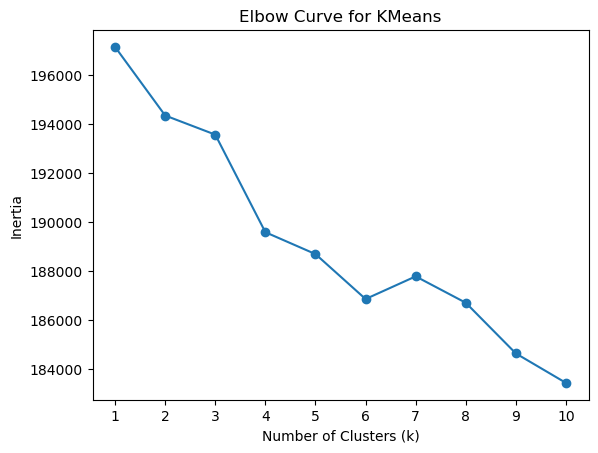

In [13]:
#elbow curve to determine the number of clusters

from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Define a range of cluster numbers to try
num_clusters_range = range(1, 11)  # You can adjust the range as needed

# Initialize a list to store the inertia values
inertia_values = []

# Fit KMeans for each value of k and calculate inertia
for k in num_clusters_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(np.asarray(tfidf_matrix))
    inertia_values.append(kmeans.inertia_)

# Plot the elbow curve
plt.plot(num_clusters_range, inertia_values, marker='o')
plt.title('Elbow Curve for KMeans')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.xticks(num_clusters_range)
plt.show()


In [15]:
from sklearn.cluster import KMeans

# Define the number of clusters
num_clusters = 3

# Create an instance of KMeans clustering
kmeans = KMeans(n_clusters=num_clusters, random_state=62)

# Fit the KMeans model to your TF-IDF matrix
kmeans.fit(np.asarray(tfidf_matrix))

# Get cluster labels for each document
cluster_labels = kmeans.labels_

# Print cluster assignments for the first 100 documents (for illustration)
# for i, label in enumerate(cluster_labels[:100]):  
#    print(f"Document {i+1} belongs to cluster {label}")


/home/taj/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


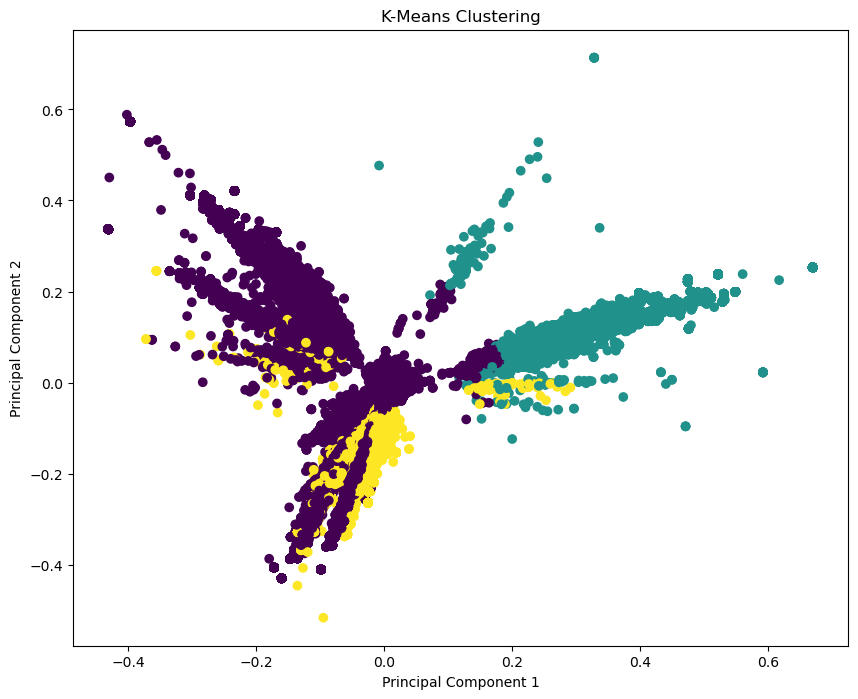

In [17]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Reduce dimensionality using PCA
pca = PCA(n_components=2)
reduced_data = pca.fit_transform(np.asarray(tfidf_matrix))

# Create a scatter plot of the clusters
plt.figure(figsize=(10, 8))
plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=cluster_labels, cmap='viridis')
plt.title('K-Means Clustering')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()


In [18]:
from sklearn.cluster import KMeans

# set number of clusters
n_clusters = 3

# create KMeans clustering object
kmeans = KMeans(n_clusters=n_clusters, random_state=49)

# fit KMeans clustering model to the tfidf_matrix
kmeans.fit(np.asarray(tfidf_matrix))

# get cluster labels for each row in the tfidf_matrix
df1['cluster_labels'] = kmeans.labels_

# print number of rows in each cluster
unique, counts = np.unique(cluster_labels, return_counts=True)
print(dict(zip(unique, counts)))


/home/taj/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


{0: 175312, 1: 15289, 2: 21170}


In [19]:
# Get the centroid vectors for each cluster
centroids = kmeans.cluster_centers_

# Get the indices of the most important features for each cluster
important_indices = centroids.argsort()[:, ::-1]

# Get the most important words for each cluster
num_words = 10
cluster_labels = {}
for i in range(num_clusters):
    label = f"Cluster {i+1}: "
    for j in range(num_words):
        label += feature_names[important_indices[i][j]] + ", "
    cluster_labels[i] = label[:-2]

# Print the cluster labels
for i, label in cluster_labels.items():
    print(label)


Cluster 1: fix, disable, test, revert, move, update, io, android, enable, make
Cluster 2: remove, unused, flag, code, usage, unnecessary, dependency, revert, reference, io
Cluster 3: add, test, metric, support, flag, revert, io, feature, cro, check


In [21]:
df1=df1.drop(['msg_clean','summary_tokenized','no_swds','lemmatized_no_swds'],axis=1)
df1

,commit,bug_id,subject,churn,filtered_no_swds,clean_lemma,meaningful_lemm_str,cluster_labels
0,4bf96c30121ed23f8025e0a2ee6c68831fd0786f,778047,Assign policies to preloaded HSTS entries,80050,"[assign, policies, entries]","[assign, policy, entry]",assign policy entry,0
1,825da604d1333757aaf6988200909104ab9d0c25,877148,Use the filter list in perf tests,61814,"[use, filter, list, tests]","[use, filter, list, test]",use filter list test,0
2,0737c281d4a556c1c3a257e2392dea88cd4cca8e,1095874,Update the tf native cch,31150,"[update, native]","[update, native]",update native,0
3,defd7e6d6055bfcf3f29ea626dbf92cfa7c8cef8,1095874,Revert Update the tf native cch,31150,"[revert, update, native]","[revert, update, native]",revert update native,0
4,062c11b0a8ead71685311fbabbe7098cd79bb3b8,923083,Add expiresafter for all obsolete histograms,10358,"[add, obsolete, histograms]","[add, obsolete, histogram]",add obsolete histogram,2
...,...,...,...,...,...,...,...,...
211766,d875e0004e6ad9ff20c43ca02d95268987deaf81,1066495,iOS CBCM Add support for CloudPolicyOverridesP...,1,"[ios, add, support]","[io, add, support]",io add support,2
211767,6e2b1b13d3eb502f3da1d91ccb45fa345a7f0cb4,568674,Address leaks in Linux accessibility tree tests,1,"[address, leaks, linux, accessibility, tree, t...","[address, leak, linux, accessibility, tree, test]",address leak linux accessibility tree test,0
211768,54f84e49d02df28da50987ecf5f1a7230ef3063d,958997,Dark Add flag enabled by default for Q,1,"[dark, add, flag, enabled, default, q]","[dark, add, flag, enabled, default, q]",dark add flag enabled default q,2
211769,146fc8cfb7e37f1b8a0dd07e06e10fc9ecf0841c,939943,Removed unused renderframeid from mojomPushMes...,1,"[removed, unused]","[removed, unused]",removed unused,0


In [22]:
import pandas as pd
import nltk
import numpy as np
from nltk import word_tokenize, pos_tag
from nltk.corpus import stopwords

# Download NLTK data (if not already downloaded)
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('stopwords')

# Assuming you have a DataFrame 'df1' with a 'subject' column

# Define a function to extract adjectives from a text
def extract_adjectives(text):
    # Tokenize the text
    words = word_tokenize(text)
    
    # Get part-of-speech tags for each word
    tags = pos_tag(words)
    
    # Filter for adjectives
    adjectives = [word for word, tag in tags if tag in ['JJ', 'JJR', 'JJS']]
    
    return ' '.join(adjectives) if adjectives else np.nan

# Apply the function to the 'subject' column and create a new 'adjective' column
df1['adjective'] = df1['subject'].apply(extract_adjectives)

# Display the DataFrame with the 'adjective' column
print(df1[['subject', 'adjective']])



[nltk_data] Downloading package punkt to /home/taj/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/taj/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package stopwords to /home/taj/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


                                                  subject  adjective
0               Assign policies to preloaded HSTS entries  preloaded
1                      Use the  filter list in perf tests        NaN
2                                Update the tf native cch     native
3                         Revert Update the tf native cch  tf native
4            Add expiresafter for all obsolete histograms   obsolete
...                                                   ...        ...
211766  iOS CBCM Add support for CloudPolicyOverridesP...        NaN
211767    Address leaks in Linux accessibility tree tests        NaN
211768             Dark Add flag enabled by default for Q        NaN
211769  Removed unused renderframeid from mojomPushMes...     unused
211770  Creates a utility service for text language de...       text

[211771 rows x 2 columns]


In [23]:
df1=df1.drop(['filtered_no_swds','clean_lemma','meaningful_lemm_str'],axis=1)

In [25]:
df1.head(20)

,commit,bug_id,subject,churn,cluster_labels,adjective
0,4bf96c30121ed23f8025e0a2ee6c68831fd0786f,778047,Assign policies to preloaded HSTS entries,80050,0,preloaded
1,825da604d1333757aaf6988200909104ab9d0c25,877148,Use the filter list in perf tests,61814,0,NaN
2,0737c281d4a556c1c3a257e2392dea88cd4cca8e,1095874,Update the tf native cch,31150,0,native
3,defd7e6d6055bfcf3f29ea626dbf92cfa7c8cef8,1095874,Revert Update the tf native cch,31150,0,tf native
4,062c11b0a8ead71685311fbabbe7098cd79bb3b8,923083,Add expiresafter for all obsolete histograms,10358,2,obsolete
5,7d8c106e11f7506dec000e710d2daa393e4e513e,843361,Remove unused file from urlformattertopdomains,9185,1,unused
6,b8b65994c45bc0b28a6cb6b4ace8e25e6b349697,1134751,Apply GPU BQ export to all builders,7876,0,NaN
7,3da46d55a65137622d50159bb69314a968da6ebc,765321,Update WebGL json test timing results,7843,0,NaN
8,57b79efc499f90d8a930452415bf663eff9134cf,746981,Change group format for policydefinitions in p...,6881,0,NaN
9,163641576c99ccaff013d589044f2c31bfdae6cd,810203,subresourcefilter Add matching perftest,6845,2,perftest


In [26]:
import pandas as pd
import nltk
import numpy as np
from nltk import word_tokenize, pos_tag
from nltk.corpus import stopwords

# Download NLTK data (if not already downloaded)
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('stopwords')

# Assuming you have a DataFrame 'df1' with a 'subject' column

# Define a function to extract verbs from a text
def extract_verbs(text):
    # Tokenize the text
    words = word_tokenize(text)
    
    # Get part-of-speech tags for each word
    tags = pos_tag(words)
    
    # Filter for verbs (base form, past tense, gerund/present participle)
    verbs = [word for word, tag in tags if tag in ['VB', 'VBD', 'VBG']]
    
    return ' '.join(verbs) if verbs else np.nan

# Apply the function to the 'subject' column and create a new 'verb' column
df1['verb'] = df1['subject'].apply(extract_verbs)

# Display the DataFrame with the 'verb' column
print(df1[['subject', 'verb']])

[nltk_data] Downloading package punkt to /home/taj/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/taj/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package stopwords to /home/taj/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


                                                  subject    verb
0               Assign policies to preloaded HSTS entries     NaN
1                      Use the  filter list in perf tests     Use
2                                Update the tf native cch  Update
3                         Revert Update the tf native cch     NaN
4            Add expiresafter for all obsolete histograms     NaN
...                                                   ...     ...
211766  iOS CBCM Add support for CloudPolicyOverridesP...     NaN
211767    Address leaks in Linux accessibility tree tests     NaN
211768             Dark Add flag enabled by default for Q     NaN
211769  Removed unused renderframeid from mojomPushMes...     NaN
211770  Creates a utility service for text language de...     NaN

[211771 rows x 2 columns]


In [27]:
df1.head(30)

,commit,bug_id,subject,churn,cluster_labels,adjective,verb
0,4bf96c30121ed23f8025e0a2ee6c68831fd0786f,778047,Assign policies to preloaded HSTS entries,80050,0,preloaded,NaN
1,825da604d1333757aaf6988200909104ab9d0c25,877148,Use the filter list in perf tests,61814,0,NaN,Use
2,0737c281d4a556c1c3a257e2392dea88cd4cca8e,1095874,Update the tf native cch,31150,0,native,Update
3,defd7e6d6055bfcf3f29ea626dbf92cfa7c8cef8,1095874,Revert Update the tf native cch,31150,0,tf native,NaN
4,062c11b0a8ead71685311fbabbe7098cd79bb3b8,923083,Add expiresafter for all obsolete histograms,10358,2,obsolete,NaN
5,7d8c106e11f7506dec000e710d2daa393e4e513e,843361,Remove unused file from urlformattertopdomains,9185,1,unused,Remove
6,b8b65994c45bc0b28a6cb6b4ace8e25e6b349697,1134751,Apply GPU BQ export to all builders,7876,0,NaN,NaN
7,3da46d55a65137622d50159bb69314a968da6ebc,765321,Update WebGL json test timing results,7843,0,NaN,NaN
8,57b79efc499f90d8a930452415bf663eff9134cf,746981,Change group format for policydefinitions in p...,6881,0,NaN,NaN
9,163641576c99ccaff013d589044f2c31bfdae6cd,810203,subresourcefilter Add matching perftest,6845,2,perftest,matching


In [28]:
df1['verb'].notna().sum()

82592

In [29]:
valid_rows = df1[(df1['adjective'].notna()) & (df1['verb'].notna())]
valid_rows.head(50)

,commit,bug_id,subject,churn,cluster_labels,adjective,verb
2,0737c281d4a556c1c3a257e2392dea88cd4cca8e,1095874,Update the tf native cch,31150,0,native,Update
5,7d8c106e11f7506dec000e710d2daa393e4e513e,843361,Remove unused file from urlformattertopdomains,9185,1,unused,Remove
9,163641576c99ccaff013d589044f2c31bfdae6cd,810203,subresourcefilter Add matching perftest,6845,2,perftest,matching
13,fca8a27c78678f4c80ddd46ae8f5e38d49975440,923083,Set expiresafterM for histograms reported as u...,5853,0,unused,reported
20,b80879124a42b04c7ec4e556b2f344c08f09c856,1087019,Remove tailing white space in benchmarkstoshar...,3892,1,white,tailing
46,ce92577b8b416e1a5566333a846488ce79dc0fd0,906654,Update the timing shard maps for win perf bots,2096,0,win,Update
79,8635a4cbd4da51b1f0b396ff7ff0ca83bf596616,893183,omnibox Add suggested synonyms to Pedal concep...,1565,2,synonyms,suggested Pedal
109,3d10ae1ba5003cf88e21152f8590658567f97ee3,1069975,Remove all the superfluous builders from mbcon...,1311,1,superfluous,Remove
135,cc7a18ebb6183743d739e7889b395ccd13a584b5,1102874,Refactor servicesnetworktests to build if Cano...,1125,0,private,build
161,0f7567000d66fce61264efb436078a6d4f54d028,1030096,Give all obsolete histograms a default expiry ...,978,0,obsolete,Give


In [30]:
# Sort 'valid_rows' by the 'churn' column in descending order
valid_rows_dsc= valid_rows.sort_values(by='churn', ascending=False)

# Display the sorted DataFrame
valid_rows_dsc.head(50)

,commit,bug_id,subject,churn,cluster_labels,adjective,verb
2,0737c281d4a556c1c3a257e2392dea88cd4cca8e,1095874,Update the tf native cch,31150,0,native,Update
5,7d8c106e11f7506dec000e710d2daa393e4e513e,843361,Remove unused file from urlformattertopdomains,9185,1,unused,Remove
9,163641576c99ccaff013d589044f2c31bfdae6cd,810203,subresourcefilter Add matching perftest,6845,2,perftest,matching
13,fca8a27c78678f4c80ddd46ae8f5e38d49975440,923083,Set expiresafterM for histograms reported as u...,5853,0,unused,reported
20,b80879124a42b04c7ec4e556b2f344c08f09c856,1087019,Remove tailing white space in benchmarkstoshar...,3892,1,white,tailing
46,ce92577b8b416e1a5566333a846488ce79dc0fd0,906654,Update the timing shard maps for win perf bots,2096,0,win,Update
79,8635a4cbd4da51b1f0b396ff7ff0ca83bf596616,893183,omnibox Add suggested synonyms to Pedal concep...,1565,2,synonyms,suggested Pedal
109,3d10ae1ba5003cf88e21152f8590658567f97ee3,1069975,Remove all the superfluous builders from mbcon...,1311,1,superfluous,Remove
135,cc7a18ebb6183743d739e7889b395ccd13a584b5,1102874,Refactor servicesnetworktests to build if Cano...,1125,0,private,build
161,0f7567000d66fce61264efb436078a6d4f54d028,1030096,Give all obsolete histograms a default expiry ...,978,0,obsolete,Give


In [31]:
csv_file_path = 'valid_rows_ch.csv'

valid_rows_dsc.to_csv(csv_file_path, index=False) 

print(f'DataFrame saved to {csv_file_path}')

DataFrame saved to valid_rows_ch.csv
